In [3]:
import pandas as pd
import numpy as np

In [4]:
columns_to_load = ['stock', 'date']
df = pd.read_csv('C:/Users/eyasu/Desktop/Kifiya/Week-1/raw_analyst_ratings.csv/raw_analyst_ratings.csv', usecols=columns_to_load)

In [5]:
print(df.head())

                        date stock
0  2020-06-05 10:30:54-04:00     A
1  2020-06-03 10:45:20-04:00     A
2  2020-05-26 04:30:07-04:00     A
3  2020-05-22 12:45:06-04:00     A
4  2020-05-22 11:38:59-04:00     A


In [6]:
from datetime import datetime
from dateutil import parser

def parse_date_with_default(date_string):
    if isinstance(date_string, datetime):
        date_string = date_string.strftime('%Y-%m-%d %H:%M:%S')
    try:
        parsed_date = parser.parse(date_string)
        return parsed_date.date()
    except ValueError:
        raise ValueError("Invalid date format: " + date_string)

df['date'] = df['date'].apply(parse_date_with_default)

In [7]:
start_end_dates = df.groupby('stock')['date'].agg(['min', 'max']).reset_index()
start_end_dates.columns = ['stock', 'start_date', 'end_date']
print(start_end_dates.head(50))

   stock  start_date    end_date
0      A  2009-04-29  2020-06-05
1     AA  2009-08-10  2020-06-09
2    AAC  2010-03-25  2019-10-25
3   AADR  2013-03-05  2013-09-06
4    AAL  2011-05-16  2020-06-10
5   AAMC  2014-02-26  2020-05-11
6   AAME  2010-04-28  2020-05-11
7    AAN  2009-08-10  2020-06-10
8   AAOI  2013-09-26  2020-05-11
9   AAON  2009-08-10  2020-05-15
10   AAP  2009-08-13  2020-06-10
11  AAPL  2020-03-09  2020-06-10
12   AAU  2009-12-04  2018-10-11
13   AAV  2009-08-12  2019-08-02
14  AAVL  2014-07-21  2016-05-06
15  AAWW  2009-12-12  2020-06-08
16  AAXJ  2011-09-14  2017-08-14
17    AB  2009-08-07  2020-05-12
18  ABAC  2014-08-21  2019-01-15
19  ABAX  2014-02-28  2018-08-01
20   ABB  2009-11-27  2020-06-03
21  ABBV  2013-01-02  2020-06-10
22   ABC  2009-08-10  2020-06-05
23  ABCB  2020-03-12  2020-05-22
24  ABCD  2011-05-24  2018-11-01
25  ABCO  2009-11-25  2017-11-15
26  ABCW  2009-12-02  2016-01-29
27  ABDC  2014-05-08  2019-11-05
28  ABEV  2014-01-07  2020-06-08
29   ABG  

In [8]:
import yfinance as yf
import pandas as pd

# Get the first 150 stock tickers from the start_end_dates DataFrame
stock_tickers = start_end_dates['stock'].head(150)

stock_data_list = []

# Iterate over each stock ticker
for stock in stock_tickers:
    # Get the corresponding start date and end date for the stock
    stock_dates = start_end_dates.loc[start_end_dates['stock'] == stock, ['start_date', 'end_date']].values[0]
    start_date = stock_dates[0]
    end_date = stock_dates[1]
    
    # Download the stock data using yfinance
    stock_data = yf.download(stock, start=start_date, end=end_date)
    
    # Add the 'stock' column to the stock_data DataFrame
    stock_data['stock'] = stock
    
    # Append the stock data to the list
    stock_data_list.append(stock_data)

# Concatenate all the stock data into a single DataFrame
combined_stock_data = pd.concat(stock_data_list)

# Print the combined stock data
print(combined_stock_data)
  


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

1 Failed download:
['AAC']: Exception('%ticker%: No timezone found, symbol may be delisted')
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

1 Failed download:
['AAMC']: Exception("%ticker%: Data doesn't exist for startDate = 1393390800, endDate = 1589169600")
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

1 Failed download:
['AAN']: Exception("%ticker%: Data doesn't exist for startDate = 1249876800, endDate = 1591761600")
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*****************

                 Open       High        Low      Close  Adj Close     Volume  \
Date                                                                           
2009-04-29  12.310443  13.011445  12.238913  12.896996  11.591172  5516508.0   
2009-04-30  12.947067  13.547926  12.947067  13.061516  11.739036  4977998.0   
2009-05-01  13.025751  13.590844  13.004292  13.454936  12.092623  4039241.0   
2009-05-04  13.454936  13.891273  13.412017  13.891273  12.484778  3885042.0   
2009-05-05  13.848355  13.876967  13.283262  13.397711  12.041190  4895656.0   
...               ...        ...        ...        ...        ...        ...   
2020-06-02  51.950001  52.750000  51.240002  52.290001  52.290001   507800.0   
2020-06-03  52.330002  52.889999  50.970001  51.040001  51.040001   487400.0   
2020-06-04  50.740002  52.130001  49.259998  49.570000  49.570000   401800.0   
2020-06-05  50.250000  51.220001  48.270000  50.660000  50.660000   522900.0   
2020-06-08  50.750000  52.380001  49.740


C:\Users\eyasu\AppData\Local\Temp\ipykernel_4352\2894478182.py:26: FutureWarning: The behavior of array concatenation with empty entries is deprecated. In a future version, this will no longer exclude empty items when determining the result dtype. To retain the old behavior, exclude the empty entries before the concat operation.
  combined_stock_data = pd.concat(stock_data_list)


In [9]:
import pandas as pd
import talib
import yfinance as yf

# Assuming 'combined_stock_data' and 'start_end_dates' are already defined as pandas DataFrames

# Get the stock tickers from the combined_stock_data DataFrame
stock_tickers = combined_stock_data['stock'].unique()

# Iterate over each stock ticker
for stock in stock_tickers:
    # Get the corresponding start date and end date for the stock from the start_end_dates DataFrame
    stock_dates = start_end_dates.loc[start_end_dates['stock'] == stock, ['start_date', 'end_date']].values[0]
    start_date = stock_dates[0]
    end_date = stock_dates[1]
    
    # Fetch the historical stock data using yfinance
    stock_data = yf.download(stock, start=start_date, end=end_date)
    
    # Calculate moving averages
    stock_data['SMA_50'] = talib.SMA(stock_data['Close'], timeperiod=50)
    stock_data['SMA_200'] = talib.SMA(stock_data['Close'], timeperiod=200)
    
    # Calculate RSI (Relative Strength Index)
    stock_data['RSI'] = talib.RSI(stock_data['Close'], timeperiod=14)
    
    # Calculate MACD (Moving Average Convergence Divergence)
    macd, signal, hist = talib.MACD(stock_data['Close'])
    stock_data['MACD_Line'] = macd
    stock_data['MACD_Signal'] = signal
    stock_data['MACD_Histogram'] = hist
    
    # Print the resulting DataFrame
    print(f"Stock: {stock}")
    print(stock_data.head())
    print()

[*********************100%%**********************]  1 of 1 completed


Stock: A
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-04-29  12.310443  13.011445  12.238913  12.896996  11.591171  5516508   
2009-04-30  12.947067  13.547926  12.947067  13.061516  11.739038  4977998   
2009-05-01  13.025751  13.590844  13.004292  13.454936  12.092621  4039241   
2009-05-04  13.454936  13.891273  13.412017  13.891273  12.484781  3885042   
2009-05-05  13.848355  13.876967  13.283262  13.397711  12.041191  4895656   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-04-29     NaN      NaN  NaN        NaN          NaN             NaN  
2009-04-30     NaN      NaN  NaN        NaN          NaN             NaN  
2009-05-01     NaN      NaN  NaN        NaN          NaN             NaN  
2009-05-04     NaN      NaN  NaN        NaN          NaN             

[*********************100%%**********************]  1 of 1 completed


Stock: AA
                 Open       High        Low      Close  Adj Close    Volume  \
Date                                                                          
2009-08-10  30.950640  31.383181  30.205709  30.494070  27.451963  12441906   
2009-08-11  30.301830  30.782431  29.845261  30.542130  27.495226  13131169   
2009-08-12  30.085560  31.551390  29.917351  31.142879  28.036047  14552643   
2009-08-13  31.983931  33.041248  31.527361  32.945129  29.658504  15589263   
2009-08-14  33.161400  33.353642  31.503330  31.887810  28.706661  14639409   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-10     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-11     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-12     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-13     NaN      NaN  NaN        NaN          NaN     

[*********************100%%**********************]  1 of 1 completed


Stock: AADR
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2013-03-05  33.310001  33.310001  33.310001  33.310001  30.201912     300   
2013-03-06  33.290001  33.290001  33.220001  33.220001  30.120308     300   
2013-03-07  33.410000  33.410000  32.970001  33.130001  30.038713    1500   
2013-03-08  33.009998  33.250000  33.009998  33.250000  30.147499    1300   
2013-03-11  33.330002  33.360001  32.959999  33.060001  29.975237    1800   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2013-03-05     NaN      NaN  NaN        NaN          NaN             NaN  
2013-03-06     NaN      NaN  NaN        NaN          NaN             NaN  
2013-03-07     NaN      NaN  NaN        NaN          NaN             NaN  
2013-03-08     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: AAL
             Open   High    Low  Close  Adj Close    Volume  SMA_50  SMA_200  \
Date                                                                           
2011-05-16   9.55   9.98   9.53   9.94   9.370850   6887400     NaN      NaN   
2011-05-17   9.86  10.05   9.78   9.80   9.238865   5156200     NaN      NaN   
2011-05-18   9.76   9.77   9.41   9.67   9.116310   5936200     NaN      NaN   
2011-05-19   9.78  10.35   9.64  10.32   9.729091  13517000     NaN      NaN   
2011-05-20  10.25  10.32  10.11  10.17   9.587680   6661100     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2011-05-16  NaN        NaN          NaN             NaN  
2011-05-17  NaN        NaN          NaN             NaN  
2011-05-18  NaN        NaN          NaN             NaN  
2011-05-19  NaN        NaN          NaN             NaN  
2011-05-20  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AAME
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2010-04-28  1.65  1.84  1.65   1.82   1.631030   14900     NaN      NaN  NaN   
2010-04-29  1.90  1.91  1.85   1.87   1.675839    4900     NaN      NaN  NaN   
2010-04-30  1.78  1.88  1.76   1.79   1.604145    7300     NaN      NaN  NaN   
2010-05-03  1.76  1.82  1.76   1.82   1.631030     400     NaN      NaN  NaN   
2010-05-04  1.77  1.81  1.65   1.70   1.523490   16500     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2010-04-28        NaN          NaN             NaN  
2010-04-29        NaN          NaN             NaN  
2010-04-30        NaN          NaN             NaN  
2010-05-03        NaN          NaN             NaN  
2010-05-04        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AAOI
             Open   High    Low  Close  Adj Close  Volume  SMA_50  SMA_200  \
Date                                                                         
2013-09-26  10.00  10.09   9.37   9.96       9.96  946000     NaN      NaN   
2013-09-27  10.44  10.44  10.00  10.10      10.10  253300     NaN      NaN   
2013-09-30  10.00  10.18   9.71  10.00      10.00   84900     NaN      NaN   
2013-10-01   9.95  10.02   9.92  10.00      10.00   74500     NaN      NaN   
2013-10-02   9.99  10.00   9.89   9.97       9.97   94000     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2013-09-26  NaN        NaN          NaN             NaN  
2013-09-27  NaN        NaN          NaN             NaN  
2013-09-30  NaN        NaN          NaN             NaN  
2013-10-01  NaN        NaN          NaN             NaN  
2013-10-02  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AAON
                Open      High       Low     Close  Adj Close   Volume  \
Date                                                                     
2009-08-10  4.069136  4.069136  3.972346  4.015802   3.518067   218194   
2009-08-11  3.982222  4.114568  3.897284  3.924938   3.438466   265275   
2009-08-12  4.227160  4.387160  4.108642  4.339753   3.801867  2423419   
2009-08-13  4.373333  4.373333  4.266667  4.331852   3.794945   755831   
2009-08-14  4.304198  4.333827  4.189630  4.288395   3.756875   559913   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-10     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-11     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-12     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-13     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-14     NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: AAP
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-08-13  43.119999  43.560001  41.540001  43.270000  38.602768  5816600   
2009-08-14  43.810001  43.849998  42.919998  43.150002  38.495724  2274200   
2009-08-17  42.369999  43.500000  42.189999  43.070000  38.424335  1646700   
2009-08-18  43.169998  43.770000  42.880001  43.099998  38.451118  1674400   
2009-08-19  42.799999  43.820000  42.779999  43.720001  39.004223  1927300   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-13     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-14     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-17     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-18     NaN      NaN  NaN        NaN          NaN           

[*********************100%%**********************]  1 of 1 completed


Stock: AAPL
                 Open       High        Low      Close  Adj Close     Volume  \
Date                                                                           
2020-03-09  65.937500  69.522499  65.750000  66.542503  64.898895  286744800   
2020-03-10  69.285004  71.610001  67.342499  71.334999  69.572998  285290000   
2020-03-11  69.347504  70.305000  67.964996  68.857498  67.156685  255598800   
2020-03-12  63.985001  67.500000  62.000000  62.057499  60.524658  418474000   
2020-03-13  66.222504  69.980003  63.237499  69.492500  67.776016  370732000   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2020-03-09     NaN      NaN  NaN        NaN          NaN             NaN  
2020-03-10     NaN      NaN  NaN        NaN          NaN             NaN  
2020-03-11     NaN      NaN  NaN        NaN          NaN             NaN  
2020-03-12     NaN      NaN  NaN        NaN         

[*********************100%%**********************]  1 of 1 completed


Stock: AAU
            Open  High   Low   Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                            
2009-12-04  1.11  1.12  1.03  1.0800     1.0800  963500     NaN      NaN  NaN   
2009-12-07  1.06  1.12  0.99  1.0880     1.0880  474452     NaN      NaN  NaN   
2009-12-08  1.10  1.10  1.00  1.0264     1.0264  170224     NaN      NaN  NaN   
2009-12-09  1.06  1.20  1.04  1.2000     1.2000  330364     NaN      NaN  NaN   
2009-12-10  1.15  1.15  1.08  1.1000     1.1000  312162     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2009-12-04        NaN          NaN             NaN  
2009-12-07        NaN          NaN             NaN  
2009-12-08        NaN          NaN             NaN  
2009-12-09        NaN          NaN             NaN  
2009-12-10        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AAXJ
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2011-09-14  52.580002  53.130001  51.720001  52.759998  41.650261   253500   
2011-09-15  53.029999  53.369999  52.650002  53.220001  42.013390   219900   
2011-09-16  53.580002  53.810001  53.139999  53.700001  42.392311  1315700   
2011-09-19  51.910000  52.279999  51.509998  52.070000  41.105549   167300   
2011-09-20  52.230000  52.660000  51.770000  51.790001  40.884502   247200   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2011-09-14     NaN      NaN  NaN        NaN          NaN             NaN  
2011-09-15     NaN      NaN  NaN        NaN          NaN             NaN  
2011-09-16     NaN      NaN  NaN        NaN          NaN             NaN  
2011-09-19     NaN      NaN  NaN        NaN          NaN          

[*********************100%%**********************]  1 of 1 completed


Stock: AB
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2009-08-07  21.150000  21.719999  20.270000  21.420000   6.774148  948900   
2009-08-10  21.309999  21.400000  20.809999  21.129999   6.682431  397300   
2009-08-11  20.940001  20.940001  20.340000  20.680000   6.540119  395000   
2009-08-12  20.680000  21.410000  20.590000  21.139999   6.685595  596700   
2009-08-13  21.639999  21.920000  21.139999  21.850000   6.910137  484200   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-07     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-10     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-11     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-12     NaN      NaN  NaN        NaN          NaN             NaN  


[*********************100%%**********************]  1 of 1 completed


Stock: ABAX
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2014-02-28  37.990002  38.410000  37.325001  37.950001  36.415554  293636   
2014-03-03  37.650002  38.110001  37.470001  37.700001  36.175655  108083   
2014-03-04  38.150002  39.230000  38.150002  38.689999  37.125626  249200   
2014-03-05  38.590000  38.959999  38.389999  38.880001  37.307949  146662   
2014-03-06  38.860001  39.180000  38.615002  39.009998  37.432686  125951   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2014-02-28     NaN      NaN  NaN        NaN          NaN             NaN  
2014-03-03     NaN      NaN  NaN        NaN          NaN             NaN  
2014-03-04     NaN      NaN  NaN        NaN          NaN             NaN  
2014-03-05     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: ABBV
                 Open       High        Low      Close  Adj Close    Volume  \
Date                                                                          
2013-01-02  34.919998  35.400002  34.099998  35.119999  22.002174  13767900   
2013-01-03  35.000000  35.000000  34.160000  34.830002  21.820498  16739300   
2013-01-04  34.619999  34.889999  34.250000  34.389999  21.544842  21372100   
2013-01-07  34.150002  35.450001  34.150002  34.459999  21.588697  17897100   
2013-01-08  34.290001  34.639999  33.360001  33.709999  21.118832  17863300   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2013-01-02     NaN      NaN  NaN        NaN          NaN             NaN  
2013-01-03     NaN      NaN  NaN        NaN          NaN             NaN  
2013-01-04     NaN      NaN  NaN        NaN          NaN             NaN  
2013-01-07     NaN      NaN  NaN        NaN          NaN   

[*********************100%%**********************]  1 of 1 completed


Stock: ABCB
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2020-03-12  24.000000  25.910000  23.160000  24.090000  22.507450   802900   
2020-03-13  25.850000  26.540001  23.010000  25.690001  24.002338  1127800   
2020-03-16  21.700001  22.809999  21.450001  21.830000  20.395914   984100   
2020-03-17  22.340000  24.610001  21.260000  24.330000  22.731678   840900   
2020-03-18  22.820000  23.370001  19.650000  20.340000  19.003796   948800   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2020-03-12     NaN      NaN  NaN        NaN          NaN             NaN  
2020-03-13     NaN      NaN  NaN        NaN          NaN             NaN  
2020-03-16     NaN      NaN  NaN        NaN          NaN             NaN  
2020-03-17     NaN      NaN  NaN        NaN          NaN          

[*********************100%%**********************]  1 of 1 completed


Stock: ABCD
            Open    High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  \
Date                                                                        
2011-05-24  2.90  2.9300  2.85   2.90       2.90   67350     NaN      NaN   
2011-05-25  2.95  3.1999  2.95   3.16       3.16   51591     NaN      NaN   
2011-05-26  3.14  3.2900  3.14   3.26       3.26   60855     NaN      NaN   
2011-05-27  3.29  3.2900  3.21   3.25       3.25   17567     NaN      NaN   
2011-05-31  3.28  3.3700  3.26   3.32       3.32   43142     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2011-05-24  NaN        NaN          NaN             NaN  
2011-05-25  NaN        NaN          NaN             NaN  
2011-05-26  NaN        NaN          NaN             NaN  
2011-05-27  NaN        NaN          NaN             NaN  
2011-05-31  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ABCO
                Open      High       Low     Close  Adj Close  Volume  SMA_50  \
Date                                                                            
2012-06-18  0.936363  0.936363  0.936363  0.936363   0.936363      27     NaN   
2012-06-19  0.927272  0.927272  0.909090  0.927272   0.927272     904     NaN   
2012-06-20  0.918181  0.927272  0.918181  0.918181   0.918181    2282     NaN   
2012-06-21  0.927272  0.927272  0.927272  0.927272   0.927272     440     NaN   
2012-06-25  0.918181  0.918181  0.918181  0.918181   0.918181    1267     NaN   

            SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                              
2012-06-18      NaN  NaN        NaN          NaN             NaN  
2012-06-19      NaN  NaN        NaN          NaN             NaN  
2012-06-20      NaN  NaN        NaN          NaN             NaN  
2012-06-21      NaN  NaN        NaN          NaN             NaN  
2012-06-25      Na

[*********************100%%**********************]  1 of 1 completed


Stock: ABEV
            Open  High   Low  Close  Adj Close    Volume  SMA_50  SMA_200  \
Date                                                                        
2014-01-07  7.28  7.34  7.20   7.25   4.937700  19490500     NaN      NaN   
2014-01-08  7.24  7.32  7.21   7.25   4.937700   7226100     NaN      NaN   
2014-01-09  7.22  7.23  7.06   7.08   4.821920  16323000     NaN      NaN   
2014-01-10  7.11  7.32  7.09   7.30   4.971754  13637500     NaN      NaN   
2014-01-13  7.29  7.32  7.21   7.24   4.930889  10418300     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2014-01-07  NaN        NaN          NaN             NaN  
2014-01-08  NaN        NaN          NaN             NaN  
2014-01-09  NaN        NaN          NaN             NaN  
2014-01-10  NaN        NaN          NaN             NaN  
2014-01-13  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ABG
             Open   High    Low  Close  Adj Close  Volume  SMA_50  SMA_200  \
Date                                                                         
2010-09-01  12.18  12.92  12.06  12.91      12.91  135800     NaN      NaN   
2010-09-02  12.88  13.27  12.86  13.13      13.13  129500     NaN      NaN   
2010-09-03  13.38  13.60  13.24  13.60      13.60  147200     NaN      NaN   
2010-09-07  13.54  13.56  13.02  13.08      13.08  140500     NaN      NaN   
2010-09-08  13.17  13.30  12.88  13.04      13.04   69500     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2010-09-01  NaN        NaN          NaN             NaN  
2010-09-02  NaN        NaN          NaN             NaN  
2010-09-03  NaN        NaN          NaN             NaN  
2010-09-07  NaN        NaN          NaN             NaN  
2010-09-08  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ABIO
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2019-05-20  9.13  9.38  8.21   8.27       8.27  141600     NaN      NaN  NaN   
2019-05-21  8.24  8.34  7.70   7.95       7.95  129800     NaN      NaN  NaN   
2019-05-22  7.83  7.95  7.17   7.17       7.17   90600     NaN      NaN  NaN   
2019-05-23  7.07  7.32  6.78   7.01       7.01   99000     NaN      NaN  NaN   
2019-05-24  6.98  7.15  6.78   6.97       6.97   65200     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2019-05-20        NaN          NaN             NaN  
2019-05-21        NaN          NaN             NaN  
2019-05-22        NaN          NaN             NaN  
2019-05-23        NaN          NaN             NaN  
2019-05-24        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ABM
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2017-09-07  40.680000  40.869999  37.119999  40.040001  35.022133  1119900   
2017-09-08  39.340000  40.490002  39.200001  40.209999  35.170830   500900   
2017-09-11  41.750000  41.750000  40.009998  40.970001  35.835602   553300   
2017-09-12  41.029999  41.180000  40.340000  40.529999  35.450722   448500   
2017-09-13  40.230000  40.400002  39.750000  40.009998  34.995884   390300   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2017-09-07     NaN      NaN  NaN        NaN          NaN             NaN  
2017-09-08     NaN      NaN  NaN        NaN          NaN             NaN  
2017-09-11     NaN      NaN  NaN        NaN          NaN             NaN  
2017-09-12     NaN      NaN  NaN        NaN          NaN           

[*********************100%%**********************]  1 of 1 completed


Stock: ABMD
                  Open        High         Low       Close   Adj Close  \
Date                                                                     
2019-10-02  168.630005  169.070007  163.220001  163.389999  163.389999   
2019-10-03  162.899994  167.039993  159.399994  167.029999  167.029999   
2019-10-04  168.570007  170.980499  167.979996  169.250000  169.250000   
2019-10-07  167.020004  169.664993  164.304993  164.429993  164.429993   
2019-10-08  163.500000  164.375000  158.449997  159.490005  159.490005   

            Volume  SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  \
Date                                                               
2019-10-02  684929     NaN      NaN  NaN        NaN          NaN   
2019-10-03  761276     NaN      NaN  NaN        NaN          NaN   
2019-10-04  473266     NaN      NaN  NaN        NaN          NaN   
2019-10-07  524905     NaN      NaN  NaN        NaN          NaN   
2019-10-08  811785     NaN      NaN  NaN        NaN          

[*********************100%%**********************]  1 of 1 completed


Stock: ABR
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2009-10-23  2.49  2.50  2.35   2.44   0.834657  126000     NaN      NaN  NaN   
2009-10-26  2.41  2.43  2.25   2.28   0.779925  193900     NaN      NaN  NaN   
2009-10-27  2.26  2.33  1.92   2.02   0.690986  209400     NaN      NaN  NaN   
2009-10-28  2.00  2.12  1.82   1.84   0.629413  167600     NaN      NaN  NaN   
2009-10-29  1.82  2.17  1.82   2.12   0.725194  204600     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2009-10-23        NaN          NaN             NaN  
2009-10-26        NaN          NaN             NaN  
2009-10-27        NaN          NaN             NaN  
2009-10-28        NaN          NaN             NaN  
2009-10-29        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ACAD
            Open  High   Low  Close  Adj Close    Volume  SMA_50  SMA_200  \
Date                                                                        
2009-07-27  4.14  5.24  4.10   4.40       4.40  13080000     NaN      NaN   
2009-07-28  4.59  4.63  3.97   4.38       4.38   3389700     NaN      NaN   
2009-07-29  4.24  4.84  4.20   4.39       4.39   2744200     NaN      NaN   
2009-07-30  4.53  4.70  4.26   4.50       4.50   1820900     NaN      NaN   
2009-07-31  4.51  4.51  3.83   4.07       4.07   1475600     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2009-07-27  NaN        NaN          NaN             NaN  
2009-07-28  NaN        NaN          NaN             NaN  
2009-07-29  NaN        NaN          NaN             NaN  
2009-07-30  NaN        NaN          NaN             NaN  
2009-07-31  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ACCO
             Open   High    Low  Close  Adj Close   Volume  SMA_50  SMA_200  \
Date                                                                          
2012-04-13  11.75  11.77  11.44  11.53   9.082721   786200     NaN      NaN   
2012-04-16  11.60  11.98  11.42  11.78   9.279655   725500     NaN      NaN   
2012-04-17  11.61  11.72  11.38  11.38   8.964560  1815100     NaN      NaN   
2012-04-18  11.33  11.48  10.97  11.32   8.917293  1551400     NaN      NaN   
2012-04-19  11.30  11.36  10.76  10.99   8.657336  2229500     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2012-04-13  NaN        NaN          NaN             NaN  
2012-04-16  NaN        NaN          NaN             NaN  
2012-04-17  NaN        NaN          NaN             NaN  
2012-04-18  NaN        NaN          NaN             NaN  
2012-04-19  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ACET
                  Open        High         Low       Close   Adj Close  \
Date                                                                     
2018-01-26  130.339996  143.500000  113.470001  118.160004  118.160004   
2018-01-29  120.470001  120.470001  110.809998  113.610001  113.610001   
2018-01-30  113.959999  115.787003  106.959999  110.180000  110.180000   
2018-01-31  109.970001  115.919998  109.059998  113.540001  113.540001   
2018-02-01  113.540001  121.806999  112.161003  117.250000  117.250000   

            Volume  SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  \
Date                                                               
2018-01-26  339571     NaN      NaN  NaN        NaN          NaN   
2018-01-29   41343     NaN      NaN  NaN        NaN          NaN   
2018-01-30   21786     NaN      NaN  NaN        NaN          NaN   
2018-01-31   25786     NaN      NaN  NaN        NaN          NaN   
2018-02-01   11814     NaN      NaN  NaN        NaN          

[*********************100%%**********************]  1 of 1 completed


Stock: ACFC
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2010-04-06  19.897959  20.306122  17.295918  20.306122  20.306122    5146   
2010-04-07  20.408163  20.663265  19.643368  20.596428  20.596428   13980   
2010-04-08  20.918367  20.918367  20.408163  20.918367  20.918367    1365   
2010-04-09  21.683674  21.683674  20.969387  21.428572  21.428572    6133   
2010-04-12  20.306122  21.326530  19.897959  21.326530  21.326530    3390   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2010-04-06     NaN      NaN  NaN        NaN          NaN             NaN  
2010-04-07     NaN      NaN  NaN        NaN          NaN             NaN  
2010-04-08     NaN      NaN  NaN        NaN          NaN             NaN  
2010-04-09     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: ACFN
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2009-11-09  8.10  8.33  7.73   8.06   4.446565  117400     NaN      NaN  NaN   
2009-11-10  8.00  8.20  7.63   7.65   4.220375   87300     NaN      NaN  NaN   
2009-11-11  7.80  8.10  7.76   7.77   4.286577  102200     NaN      NaN  NaN   
2009-11-12  7.87  8.04  7.58   7.89   4.352779  116800     NaN      NaN  NaN   
2009-11-13  7.99  8.05  6.86   7.25   3.999702  330300     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2009-11-09        NaN          NaN             NaN  
2009-11-10        NaN          NaN             NaN  
2009-11-11        NaN          NaN             NaN  
2009-11-12        NaN          NaN             NaN  
2009-11-13        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ACGL
                Open      High       Low     Close  Adj Close   Volume  \
Date                                                                     
2009-11-06  7.491111  7.652222  7.491111  7.645556   7.645556  3996000   
2009-11-09  7.637778  7.747778  7.603333  7.747778   7.747778  3357000   
2009-11-10  7.704444  7.766667  7.704444  7.721111   7.721111  2358000   
2009-11-11  7.773333  7.815556  7.723333  7.800000   7.800000  3471300   
2009-11-12  7.807778  7.813333  7.751111  7.768889   7.768889  6414300   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-11-06     NaN      NaN  NaN        NaN          NaN             NaN  
2009-11-09     NaN      NaN  NaN        NaN          NaN             NaN  
2009-11-10     NaN      NaN  NaN        NaN          NaN             NaN  
2009-11-11     NaN      NaN  NaN        NaN          NaN             NaN  
2009-11-12     NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: ACHC
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2011-12-05  7.90  8.00  7.20   7.89       7.89   55500     NaN      NaN  NaN   
2011-12-06  7.80  8.74  5.43   8.02       8.02   43700     NaN      NaN  NaN   
2011-12-07  8.00  8.47  7.98   8.47       8.47   16600     NaN      NaN  NaN   
2011-12-08  8.48  8.48  8.00   8.25       8.25   24800     NaN      NaN  NaN   
2011-12-09  8.07  8.07  7.82   8.00       8.00   15900     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2011-12-05        NaN          NaN             NaN  
2011-12-06        NaN          NaN             NaN  
2011-12-07        NaN          NaN             NaN  
2011-12-08        NaN          NaN             NaN  
2011-12-09        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ACIW
                Open      High       Low     Close  Adj Close   Volume  \
Date                                                                     
2009-09-14  4.736667  4.990000  4.666667  4.950000   4.950000   626700   
2009-09-15  4.933333  5.216667  4.873333  5.140000   5.140000   777600   
2009-09-16  5.123333  5.210000  5.083333  5.170000   5.170000   302100   
2009-09-17  5.146667  5.243333  5.106667  5.186667   5.186667   312000   
2009-09-18  5.190000  5.316667  5.106667  5.283333   5.283333  1052400   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-09-14     NaN      NaN  NaN        NaN          NaN             NaN  
2009-09-15     NaN      NaN  NaN        NaN          NaN             NaN  
2009-09-16     NaN      NaN  NaN        NaN          NaN             NaN  
2009-09-17     NaN      NaN  NaN        NaN          NaN             NaN  
2009-09-18     NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: ACLS
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2009-10-13  5.72  6.76  5.68   6.52       6.52  979325     NaN      NaN  NaN   
2009-10-14  7.00  7.12  6.08   6.36       6.36  732500     NaN      NaN  NaN   
2009-10-15  6.64  6.64  5.60   6.24       6.24  576725     NaN      NaN  NaN   
2009-10-16  6.12  6.16  5.68   5.92       5.92  331825     NaN      NaN  NaN   
2009-10-19  5.88  5.88  5.24   5.32       5.32  481525     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2009-10-13        NaN          NaN             NaN  
2009-10-14        NaN          NaN             NaN  
2009-10-15        NaN          NaN             NaN  
2009-10-16        NaN          NaN             NaN  
2009-10-19        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ACM
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-08-07  29.750000  31.590000  28.850000  31.400000  30.724424  1849400   
2009-08-10  31.139999  31.150000  30.230000  30.459999  29.804646  1072000   
2009-08-11  30.290001  30.549999  29.780001  30.290001  29.638306   529000   
2009-08-12  29.940001  30.680000  29.610001  30.049999  29.403467   509300   
2009-08-13  30.020000  30.049999  29.110001  29.570000  28.933796   931800   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-07     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-10     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-11     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-12     NaN      NaN  NaN        NaN          NaN           

[*********************100%%**********************]  1 of 1 completed


Stock: ACN
                 Open       High        Low      Close  Adj Close    Volume  \
Date                                                                          
2009-10-01  37.040001  37.500000  36.389999  36.529999  27.438387   6463200   
2009-10-02  37.110001  38.240002  36.900002  37.500000  28.166977  11315600   
2009-10-05  37.689999  38.240002  37.400002  37.990002  28.535036   6793200   
2009-10-06  37.709999  38.439999  37.700001  38.330002  28.790407   6850300   
2009-10-07  38.070000  38.590000  38.009998  38.410000  28.850489   4686400   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-10-01     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-02     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-05     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-06     NaN      NaN  NaN        NaN          NaN    

[*********************100%%**********************]  1 of 1 completed


Stock: ACNB
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2013-05-09  16.930000  16.950001  16.500000  16.530001  11.398339    2700   
2013-05-10  16.500000  16.530001  16.500000  16.520000  11.391442     800   
2013-05-13  16.940001  16.940001  16.940001  16.940001  11.681053     300   
2013-05-14  16.709999  16.820000  16.700001  16.799999  11.584518    2800   
2013-05-15  16.730000  16.780001  16.500000  16.520000  11.391442    1600   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2013-05-09     NaN      NaN  NaN        NaN          NaN             NaN  
2013-05-10     NaN      NaN  NaN        NaN          NaN             NaN  
2013-05-13     NaN      NaN  NaN        NaN          NaN             NaN  
2013-05-14     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: ACOR
                   Open         High          Low        Close    Adj Close  \
Date                                                                          
2009-10-09  2421.595215  2458.795166  1930.796143  2102.395752  2102.395752   
2009-10-12  2141.995605  2229.595459  2047.195923  2067.595947  2067.595947   
2009-10-13  2068.795898  2069.995850  1862.396240  2008.796021  2008.796021   
2009-10-14  2008.796021  2008.796021  2008.796021  2008.796021  2008.796021   
2009-10-15  3013.194092  3119.993652  2911.194092  2957.994141  2957.994141   

            Volume  SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  \
Date                                                               
2009-10-09  121321     NaN      NaN  NaN        NaN          NaN   
2009-10-12   42996     NaN      NaN  NaN        NaN          NaN   
2009-10-13   40206     NaN      NaN  NaN        NaN          NaN   
2009-10-14       0     NaN      NaN  NaN        NaN          NaN   
2009-10-15  109661     NaN

[*********************100%%**********************]  1 of 1 completed


Stock: ACP
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2011-01-27  18.590302  18.636778  18.553122  18.590302   3.963945  360941   
2011-01-28  18.618189  18.766911  18.618189  18.683254   3.983764   16891   
2011-01-31  18.766911  18.897041  18.766911  18.776205   4.003584    7961   
2011-02-01  18.776205  18.776205  18.599598  18.683254   3.983764   10973   
2011-02-02  18.636778  18.655369  18.590302  18.636778   3.973856   13018   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2011-01-27     NaN      NaN  NaN        NaN          NaN             NaN  
2011-01-28     NaN      NaN  NaN        NaN          NaN             NaN  
2011-01-31     NaN      NaN  NaN        NaN          NaN             NaN  
2011-02-01     NaN      NaN  NaN        NaN          NaN             NaN  

[*********************100%%**********************]  1 of 1 completed


Stock: ACRE
                 Open       High        Low  Close  Adj Close  Volume  SMA_50  \
Date                                                                            
2012-04-27  18.000000  18.030001  17.799999  17.82   5.921300  558900     NaN   
2012-04-30  17.799999  18.049999  17.760000  17.98   5.974464  123800     NaN   
2012-05-01  17.980000  18.059999  17.950001  18.00   5.981110   91100     NaN   
2012-05-02  18.000000  18.070000  17.809999  17.84   5.927947  139700     NaN   
2012-05-03  17.930000  17.990000  17.600000  17.75   5.898039  169000     NaN   

            SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                              
2012-04-27      NaN  NaN        NaN          NaN             NaN  
2012-04-30      NaN  NaN        NaN          NaN             NaN  
2012-05-01      NaN  NaN        NaN          NaN             NaN  
2012-05-02      NaN  NaN        NaN          NaN             NaN  
2012-05-03      Na

[*********************100%%**********************]  1 of 1 completed


Stock: ACST
                   Open         High          Low        Close    Adj Close  \
Date                                                                          
2013-10-02  1224.000000  1224.000000  1108.800049  1195.199951  1195.199951   
2013-10-03  1161.599976  1224.000000  1147.199951  1147.199951  1147.199951   
2013-10-04  1171.199951  1171.199951  1152.000000  1152.000000  1152.000000   
2013-10-07  1166.400024  1166.400024  1137.599976  1142.400024  1142.400024   
2013-10-08  1152.000000  1152.000000  1080.000000  1089.599976  1089.599976   

            Volume  SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  \
Date                                                               
2013-10-02     111     NaN      NaN  NaN        NaN          NaN   
2013-10-03      51     NaN      NaN  NaN        NaN          NaN   
2013-10-04      21     NaN      NaN  NaN        NaN          NaN   
2013-10-07      38     NaN      NaN  NaN        NaN          NaN   
2013-10-08      90     NaN

[*********************100%%**********************]  1 of 1 completed


Stock: ACTA
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2014-09-15  16.240000  17.400000  16.010000  17.250000  17.250000  128434   
2014-09-16  17.389999  18.080000  17.110001  17.139999  17.139999  114542   
2014-09-17  17.500000  17.500000  17.030001  17.219999  17.219999   86990   
2014-09-18  17.879999  17.879999  17.270000  17.480000  17.480000   66529   
2014-09-19  16.530001  17.540001  15.620000  15.990000  15.990000  473922   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2014-09-15     NaN      NaN  NaN        NaN          NaN             NaN  
2014-09-16     NaN      NaN  NaN        NaN          NaN             NaN  
2014-09-17     NaN      NaN  NaN        NaN          NaN             NaN  
2014-09-18     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: ACTG
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2009-11-09  8.37  8.53  8.26   8.42   7.606596  158600     NaN      NaN  NaN   
2009-11-10  8.36  8.51  8.13   8.19   7.398814  179700     NaN      NaN  NaN   
2009-11-11  8.25  8.28  8.10   8.15   7.362678   69900     NaN      NaN  NaN   
2009-11-12  8.13  8.23  7.80   7.93   7.163932  214900     NaN      NaN  NaN   
2009-11-13  7.94  8.25  7.77   8.19   7.398814  588000     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2009-11-09        NaN          NaN             NaN  
2009-11-10        NaN          NaN             NaN  
2009-11-11        NaN          NaN             NaN  
2009-11-12        NaN          NaN             NaN  
2009-11-13        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ACU
             Open   High    Low  Close  Adj Close  Volume  SMA_50  SMA_200  \
Date                                                                         
2010-04-12  13.04  13.04  10.74  11.36   8.443730   20000     NaN      NaN   
2010-04-13  11.31  11.40  10.78  10.80   8.027488    7900     NaN      NaN   
2010-04-14  10.91  11.16  10.69  11.04   8.205874   17000     NaN      NaN   
2010-04-15  11.17  11.41  10.99  11.36   8.443730    9600     NaN      NaN   
2010-04-16  11.44  11.55  11.15  11.48   8.532928   12000     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2010-04-12  NaN        NaN          NaN             NaN  
2010-04-13  NaN        NaN          NaN             NaN  
2010-04-14  NaN        NaN          NaN             NaN  
2010-04-15  NaN        NaN          NaN             NaN  
2010-04-16  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ACUR
             Open       High    Low      Close  Adj Close  Volume  SMA_50  \
Date                                                                        
2010-02-23  24.40  25.750000  24.25  25.700001  25.700001    4053     NaN   
2010-02-24  24.65  26.049999  24.65  25.900000  25.900000    1650     NaN   
2010-02-25  25.75  26.299999  25.35  26.150000  26.150000    1778     NaN   
2010-02-26  26.15  26.150000  24.40  24.500000  24.500000    1862     NaN   
2010-03-01  24.75  25.799999  23.10  24.700001  24.700001    5435     NaN   

            SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                              
2010-02-23      NaN  NaN        NaN          NaN             NaN  
2010-02-24      NaN  NaN        NaN          NaN             NaN  
2010-02-25      NaN  NaN        NaN          NaN             NaN  
2010-02-26      NaN  NaN        NaN          NaN             NaN  
2010-03-01      NaN  NaN        NaN          N

[*********************100%%**********************]  1 of 1 completed


Stock: ACWI
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2012-07-20  43.910000  43.919998  43.680000  43.700001  34.507133  779900   
2012-07-23  42.770000  43.099998  42.590000  43.009998  33.962292  928700   
2012-07-24  43.020000  43.040001  42.360001  42.630001  33.662239  120000   
2012-07-25  42.820000  42.950001  42.500000  42.709999  33.725399  546600   
2012-07-26  43.509998  43.759998  43.400002  43.660000  34.475544  195600   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2012-07-20     NaN      NaN  NaN        NaN          NaN             NaN  
2012-07-23     NaN      NaN  NaN        NaN          NaN             NaN  
2012-07-24     NaN      NaN  NaN        NaN          NaN             NaN  
2012-07-25     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: ACWV
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2011-10-20  49.990002  52.000000  49.840000  52.000000  39.498875    4700   
2011-10-21  50.740002  50.770000  50.689999  50.689999  38.503815    3000   
2011-10-24  50.689999  50.689999  50.689999  50.689999  38.503815       0   
2011-10-25  50.689999  50.689999  50.689999  50.689999  38.503815       0   
2011-10-26  51.220001  51.290001  51.060001  51.060001  38.784855     700   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2011-10-20     NaN      NaN  NaN        NaN          NaN             NaN  
2011-10-21     NaN      NaN  NaN        NaN          NaN             NaN  
2011-10-24     NaN      NaN  NaN        NaN          NaN             NaN  
2011-10-25     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: ACWX
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2012-08-22  38.599998  38.919998  38.529999  38.869999  28.902365    87700   
2012-08-23  38.730000  38.730000  38.419998  38.509998  28.634691  1590700   
2012-08-24  38.240002  38.639999  38.200001  38.470001  28.604940    83000   
2012-08-27  38.509998  38.599998  38.349998  38.380001  28.538025   906100   
2012-08-28  38.349998  38.439999  38.250000  38.320000  28.493408   211800   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2012-08-22     NaN      NaN  NaN        NaN          NaN             NaN  
2012-08-23     NaN      NaN  NaN        NaN          NaN             NaN  
2012-08-24     NaN      NaN  NaN        NaN          NaN             NaN  
2012-08-27     NaN      NaN  NaN        NaN          NaN          

[*********************100%%**********************]  1 of 1 completed


Stock: ADBE
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-08-17  31.719999  31.900000  31.120001  31.209999  31.209999  5500600   
2009-08-18  31.280001  31.920000  31.100000  31.719999  31.719999  4925700   
2009-08-19  31.450001  31.879999  31.170000  31.719999  31.719999  5001200   
2009-08-20  31.830000  32.189999  31.480000  32.099998  32.099998  4676000   
2009-08-21  32.439999  32.930000  32.000000  32.840000  32.840000  5108600   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-17     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-18     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-19     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-20     NaN      NaN  NaN        NaN          NaN          

[*********************100%%**********************]  1 of 1 completed


Stock: ADC
                 Open       High    Low      Close  Adj Close  Volume  SMA_50  \
Date                                                                            
2009-09-02  20.010000  20.600000  19.66  19.889999   9.191369   28000     NaN   
2009-09-03  20.080000  20.090000  19.60  19.940001   9.214477   20100     NaN   
2009-09-04  19.080000  20.200001  19.07  20.040001   9.260686   30200     NaN   
2009-09-08  20.340000  21.040001  20.23  20.820000   9.621135   28100     NaN   
2009-09-09  20.940001  21.170000  20.51  20.940001   9.676582   33400     NaN   

            SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                              
2009-09-02      NaN  NaN        NaN          NaN             NaN  
2009-09-03      NaN  NaN        NaN          NaN             NaN  
2009-09-04      NaN  NaN        NaN          NaN             NaN  
2009-09-08      NaN  NaN        NaN          NaN             NaN  
2009-09-09      NaN

[*********************100%%**********************]  1 of 1 completed


Stock: ADI
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-08-12  27.150000  27.549999  27.070000  27.200001  19.086800  3295300   
2009-08-13  27.969999  28.000000  27.320000  27.809999  19.514849  4374100   
2009-08-14  27.680000  27.700001  27.020000  27.389999  19.220127  4344000   
2009-08-17  27.110001  27.150000  26.559999  26.760000  18.778046  4428500   
2009-08-18  26.820000  27.299999  26.760000  27.219999  19.100832  4816200   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-12     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-13     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-14     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-17     NaN      NaN  NaN        NaN          NaN           

[*********************100%%**********************]  1 of 1 completed


Stock: ADM
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-08-12  28.650000  28.650000  27.709999  27.980000  19.197666  8928600   
2009-08-13  28.160000  28.500000  27.969999  28.190001  19.341753  6895100   
2009-08-14  28.219999  28.389999  27.590000  27.870001  19.122194  4690500   
2009-08-17  27.440001  27.670000  27.030001  27.049999  18.559570  5043700   
2009-08-18  27.059999  27.610001  27.059999  27.450001  18.932011  4239300   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-12     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-13     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-14     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-17     NaN      NaN  NaN        NaN          NaN           

[*********************100%%**********************]  1 of 1 completed


Stock: ADMA
             Open   High    Low  Close  Adj Close  Volume  SMA_50  SMA_200  \
Date                                                                         
2014-12-03  13.25  14.00   9.55  10.61      10.61   83200     NaN      NaN   
2014-12-04  10.60  11.50  10.60  10.80      10.80   36300     NaN      NaN   
2014-12-05  10.80  10.80  10.10  10.40      10.40    9400     NaN      NaN   
2014-12-08  10.80  11.39  10.65  10.75      10.75   22700     NaN      NaN   
2014-12-09  10.80  11.15  10.52  10.62      10.62   13400     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2014-12-03  NaN        NaN          NaN             NaN  
2014-12-04  NaN        NaN          NaN             NaN  
2014-12-05  NaN        NaN          NaN             NaN  
2014-12-08  NaN        NaN          NaN             NaN  
2014-12-09  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ADP
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-08-13  33.792801  34.064968  33.362598  34.012291  23.778442  4455312   
2009-08-14  33.924496  34.012291  33.397717  33.784019  23.618856  5208419   
2009-08-17  33.520634  33.590870  33.011414  33.028973  23.091000  4075114   
2009-08-18  33.072872  33.292362  32.853378  33.011414  23.078714  5089735   
2009-08-19  32.809483  33.222126  32.669006  33.072872  23.121685  4345627   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-13     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-14     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-17     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-18     NaN      NaN  NaN        NaN          NaN           

[*********************100%%**********************]  1 of 1 completed


Stock: ADPT
                 Open       High        Low      Close  Adj Close    Volume  \
Date                                                                          
2019-06-27  39.009998  40.619999  36.209999  40.299999  40.299999  11245600   
2019-06-28  42.099998  48.825001  41.250000  48.299999  48.299999   5403800   
2019-07-01  51.000000  51.000000  39.580002  40.099998  40.099998   4300600   
2019-07-02  40.000000  40.400002  37.950001  38.889999  38.889999   1877700   
2019-07-03  39.549999  39.549999  38.599998  39.160000  39.160000   1010600   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2019-06-27     NaN      NaN  NaN        NaN          NaN             NaN  
2019-06-28     NaN      NaN  NaN        NaN          NaN             NaN  
2019-07-01     NaN      NaN  NaN        NaN          NaN             NaN  
2019-07-02     NaN      NaN  NaN        NaN          NaN   

[*********************100%%**********************]  1 of 1 completed


Stock: ADRE
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2012-10-24  39.029999  39.200001  38.959999  38.959999  38.959999   17108   
2012-10-25  39.439999  39.500000  39.171700  39.290001  39.290001   12182   
2012-10-26  39.240002  39.340000  39.040001  39.160000  39.160000   62231   
2012-10-31  38.680000  39.345699  38.540001  38.840000  38.840000   47787   
2012-11-01  39.000000  39.450001  39.000000  39.389999  39.389999   23727   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2012-10-24     NaN      NaN  NaN        NaN          NaN             NaN  
2012-10-25     NaN      NaN  NaN        NaN          NaN             NaN  
2012-10-26     NaN      NaN  NaN        NaN          NaN             NaN  
2012-10-31     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: ADRU
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2012-01-13  18.360001  18.360001  18.360001  18.360001  18.360001    1000   
2012-01-17  18.809999  18.820000  18.733999  18.733999  18.733999   10900   
2012-01-18  18.860001  19.049900  18.860001  19.049900  19.049900    1765   
2012-01-19  19.139999  19.230000  19.120001  19.222000  19.222000     800   
2012-01-20  19.180000  19.204000  19.170000  19.200001  19.200001    1800   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2012-01-13     NaN      NaN  NaN        NaN          NaN             NaN  
2012-01-17     NaN      NaN  NaN        NaN          NaN             NaN  
2012-01-18     NaN      NaN  NaN        NaN          NaN             NaN  
2012-01-19     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: ADSK
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-08-17  24.700001  24.959999  23.799999  23.840000  23.840000  5652500   
2009-08-18  24.100000  24.389999  23.959999  24.360001  24.360001  4797500   
2009-08-19  23.900000  24.270000  23.650000  24.170000  24.170000  4234500   
2009-08-20  24.280001  24.590000  24.170000  24.270000  24.270000  2784800   
2009-08-21  24.580000  24.910000  24.139999  24.510000  24.510000  3852400   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-17     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-18     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-19     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-20     NaN      NaN  NaN        NaN          NaN          

[*********************100%%**********************]  1 of 1 completed


Stock: ADT
             Open    High    Low  Close  Adj Close    Volume  SMA_50  SMA_200  \
Date                                                                            
2018-01-19  12.65  12.970  12.00  12.39  10.121551  68187400     NaN      NaN   
2018-01-22  12.12  12.180  11.12  11.45   9.353654  26132900     NaN      NaN   
2018-01-23  11.47  12.120  11.45  11.91   9.729434   8272100     NaN      NaN   
2018-01-24  11.91  12.144  11.30  11.91   9.729434  10369000     NaN      NaN   
2018-01-25  11.91  11.940  11.60  11.90   9.721263   9448600     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2018-01-19  NaN        NaN          NaN             NaN  
2018-01-22  NaN        NaN          NaN             NaN  
2018-01-23  NaN        NaN          NaN             NaN  
2018-01-24  NaN        NaN          NaN             NaN  
2018-01-25  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ADTN
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-11-18  23.650000  23.719999  23.230000  23.340000  17.704157   733800   
2009-11-19  23.160000  23.230000  22.610001  22.690001  17.211107  1678100   
2009-11-20  22.480000  22.480000  21.520000  21.790001  16.528427  2641400   
2009-11-23  22.090000  22.400000  21.540001  21.730000  16.482910  1317700   
2009-11-24  21.540001  21.750000  21.290001  21.750000  16.498085   741000   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-11-18     NaN      NaN  NaN        NaN          NaN             NaN  
2009-11-19     NaN      NaN  NaN        NaN          NaN             NaN  
2009-11-20     NaN      NaN  NaN        NaN          NaN             NaN  
2009-11-23     NaN      NaN  NaN        NaN          NaN          

[*********************100%%**********************]  1 of 1 completed


Stock: ADX
             Open   High    Low  Close  Adj Close  Volume  SMA_50  SMA_200  \
Date                                                                         
2009-11-13  10.07  10.16  10.03  10.16   4.025455  131200     NaN      NaN   
2009-11-16  10.18  10.29  10.17  10.27   4.069039  152500     NaN      NaN   
2009-11-17  10.26  10.30  10.19  10.28   4.072999   76800     NaN      NaN   
2009-11-18  10.11  10.12   9.91   9.99   4.077081  172900     NaN      NaN   
2009-11-19   9.89   9.91   9.78   9.85   4.019945  122100     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2009-11-13  NaN        NaN          NaN             NaN  
2009-11-16  NaN        NaN          NaN             NaN  
2009-11-17  NaN        NaN          NaN             NaN  
2009-11-18  NaN        NaN          NaN             NaN  
2009-11-19  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: ADXS
             Open     High      Low  Close  Adj Close   Volume  SMA_50  \
Date                                                                     
2020-05-08  15.66  16.5000  14.6300  15.03      15.03  1728710     NaN   
2020-05-11  15.39  15.3997  15.0100  15.15      15.15   125498     NaN   
2020-05-12  15.18  15.3600  14.8300  15.00      15.00   194733     NaN   
2020-05-13  15.00  15.1500  14.8300  15.00      15.00   184381     NaN   
2020-05-14  15.00  15.2000  14.9009  15.00      15.00   125472     NaN   

            SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                              
2020-05-08      NaN  NaN        NaN          NaN             NaN  
2020-05-11      NaN  NaN        NaN          NaN             NaN  
2020-05-12      NaN  NaN        NaN          NaN             NaN  
2020-05-13      NaN  NaN        NaN          NaN             NaN  
2020-05-14      NaN  NaN        NaN          NaN             NaN  


[*********************100%%**********************]  1 of 1 completed


Stock: AE
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2010-06-08  17.000000  17.000000  16.400000  16.400000  11.721895    2300   
2010-06-09  16.889999  16.889999  16.500000  16.500000  11.793370     600   
2010-06-10  16.799999  16.799999  16.549999  16.549999  11.829109    8700   
2010-06-11  16.930000  16.969999  16.549999  16.600000  11.864845    1300   
2010-06-14  17.250000  17.250000  16.730000  17.090000  12.215070    2700   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2010-06-08     NaN      NaN  NaN        NaN          NaN             NaN  
2010-06-09     NaN      NaN  NaN        NaN          NaN             NaN  
2010-06-10     NaN      NaN  NaN        NaN          NaN             NaN  
2010-06-11     NaN      NaN  NaN        NaN          NaN             NaN  


[*********************100%%**********************]  1 of 1 completed


Stock: AEE
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2010-02-18  25.469999  26.250000  25.469999  25.639999  15.108550  3138500   
2010-02-19  25.620001  26.059999  25.350000  25.650000  15.114436  2066000   
2010-02-22  25.799999  25.820000  25.360001  25.410000  14.973018  1396900   
2010-02-23  25.420000  25.469999  25.170000  25.290001  14.902310  1402600   
2010-02-24  25.340000  25.450001  24.889999  25.139999  14.813919  1640200   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2010-02-18     NaN      NaN  NaN        NaN          NaN             NaN  
2010-02-19     NaN      NaN  NaN        NaN          NaN             NaN  
2010-02-22     NaN      NaN  NaN        NaN          NaN             NaN  
2010-02-23     NaN      NaN  NaN        NaN          NaN           

[*********************100%%**********************]  1 of 1 completed


Stock: AEG
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2009-08-17  7.15  7.16  6.99   7.08   4.065756  991600     NaN      NaN  NaN   
2009-08-18  7.15  7.40  7.15   7.39   4.243777  693700     NaN      NaN  NaN   
2009-08-19  7.27  7.48  7.24   7.39   4.243777  831300     NaN      NaN  NaN   
2009-08-20  7.36  7.44  7.33   7.38   4.238033  630800     NaN      NaN  NaN   
2009-08-21  7.57  7.68  7.55   7.66   4.398827  945400     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2009-08-17        NaN          NaN             NaN  
2009-08-18        NaN          NaN             NaN  
2009-08-19        NaN          NaN             NaN  
2009-08-20        NaN          NaN             NaN  
2009-08-21        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AEHR
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2017-01-05  2.35  2.63  2.24   2.30       2.30   64100     NaN      NaN  NaN   
2017-01-06  2.30  2.37  2.30   2.34       2.34   47800     NaN      NaN  NaN   
2017-01-09  2.32  2.45  2.32   2.37       2.37    7700     NaN      NaN  NaN   
2017-01-10  2.35  2.42  2.35   2.37       2.37   18000     NaN      NaN  NaN   
2017-01-11  2.37  2.47  2.37   2.46       2.46   16400     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2017-01-05        NaN          NaN             NaN  
2017-01-06        NaN          NaN             NaN  
2017-01-09        NaN          NaN             NaN  
2017-01-10        NaN          NaN             NaN  
2017-01-11        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AEIS
             Open   High    Low  Close  Adj Close  Volume  SMA_50  SMA_200  \
Date                                                                         
2009-10-21  13.55  14.15  13.36  13.60  13.412112  511600     NaN      NaN   
2009-10-22  13.55  13.83  13.24  13.66  13.471281  254500     NaN      NaN   
2009-10-23  13.56  13.85  13.17  13.23  13.047222  333800     NaN      NaN   
2009-10-26  13.27  13.61  12.73  12.93  12.751369  344700     NaN      NaN   
2009-10-27  12.98  13.16  12.52  12.77  12.593580  349700     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2009-10-21  NaN        NaN          NaN             NaN  
2009-10-22  NaN        NaN          NaN             NaN  
2009-10-23  NaN        NaN          NaN             NaN  
2009-10-26  NaN        NaN          NaN             NaN  
2009-10-27  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AEL
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2009-08-10  7.80  7.98  7.62   7.96   6.900443  313378     NaN      NaN  NaN   
2009-08-11  7.86  7.98  7.31   7.87   6.822423  593041     NaN      NaN  NaN   
2009-08-12  7.92  8.18  7.89   8.05   6.978463  446871     NaN      NaN  NaN   
2009-08-13  8.15  8.18  7.98   8.15   7.065152  288064     NaN      NaN  NaN   
2009-08-14  8.14  8.14  7.80   8.10   7.021808  490929     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2009-08-10        NaN          NaN             NaN  
2009-08-11        NaN          NaN             NaN  
2009-08-12        NaN          NaN             NaN  
2009-08-13        NaN          NaN             NaN  
2009-08-14        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AEM
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-07-27  57.779999  58.560001  56.889999  57.259998  45.441410  1498600   
2009-07-28  55.799999  55.950001  52.450001  53.820000  42.711433  3477100   
2009-07-29  53.299999  53.400002  52.169998  52.340000  41.536903  2607200   
2009-07-30  54.189999  56.349998  54.000000  55.950001  44.401791  3866000   
2009-07-31  55.990002  59.000000  55.740002  58.549999  46.465149  3199900   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-07-27     NaN      NaN  NaN        NaN          NaN             NaN  
2009-07-28     NaN      NaN  NaN        NaN          NaN             NaN  
2009-07-29     NaN      NaN  NaN        NaN          NaN             NaN  
2009-07-30     NaN      NaN  NaN        NaN          NaN           

[*********************100%%**********************]  1 of 1 completed


Stock: AEO
                 Open       High        Low      Close  Adj Close    Volume  \
Date                                                                          
2009-10-08  17.500000  18.379999  17.260000  18.139999  10.951393  14781100   
2009-10-09  18.049999  18.480000  17.879999  18.360001  11.084208   5947600   
2009-10-12  18.870001  18.950001  18.660000  18.790001  11.343809   6219100   
2009-10-13  18.750000  19.129999  18.610001  18.879999  11.398147   7472200   
2009-10-14  19.049999  19.330000  18.799999  19.219999  11.603407   5035200   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-10-08     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-09     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-12     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-13     NaN      NaN  NaN        NaN          NaN    

[*********************100%%**********************]  1 of 1 completed


Stock: AER
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2009-08-13  9.12  9.31  9.03   9.06       9.06  104600     NaN      NaN  NaN   
2009-08-14  9.03  9.16  8.85   8.90       8.90  203700     NaN      NaN  NaN   
2009-08-17  8.58  8.70  8.22   8.26       8.26  225400     NaN      NaN  NaN   
2009-08-18  8.41  8.55  8.26   8.34       8.34  188000     NaN      NaN  NaN   
2009-08-19  8.31  8.69  8.17   8.48       8.48  148700     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2009-08-13        NaN          NaN             NaN  
2009-08-14        NaN          NaN             NaN  
2009-08-17        NaN          NaN             NaN  
2009-08-18        NaN          NaN             NaN  
2009-08-19        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AES
             Open   High    Low  Close  Adj Close    Volume  SMA_50  SMA_200  \
Date                                                                           
2009-08-10  13.83  14.10  13.52  13.98   9.779333  11061600     NaN      NaN   
2009-08-11  13.84  13.91  13.41  13.43   9.394596   7822600     NaN      NaN   
2009-08-12  13.34  14.01  13.34  13.88   9.709380   6899900     NaN      NaN   
2009-08-13  13.98  14.05  13.67  13.92   9.737362   6979800     NaN      NaN   
2009-08-14  13.88  14.03  13.59  13.79   9.646423   4288700     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2009-08-10  NaN        NaN          NaN             NaN  
2009-08-11  NaN        NaN          NaN             NaN  
2009-08-12  NaN        NaN          NaN             NaN  
2009-08-13  NaN        NaN          NaN             NaN  
2009-08-14  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AET
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2009-10-13  26.379999  26.480000  25.350000  25.540001  23.143711  9325151   
2009-10-14  25.920000  26.240000  25.650000  26.030001  23.587734  6824851   
2009-10-15  26.080000  26.080000  25.410000  25.719999  23.306818  7396678   
2009-10-16  25.700001  25.860001  25.190001  25.219999  22.853737  5803977   
2009-10-19  25.230000  25.570000  24.940001  25.250000  22.880909  6799656   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-10-13     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-14     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-15     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-16     NaN      NaN  NaN        NaN          NaN           

[*********************100%%**********************]  1 of 1 completed


Stock: AEZS
               Open     High      Low    Close  Adj Close  Volume  SMA_50  \
Date                                                                        
2009-09-16  69600.0  85800.0  68400.0  82200.0    82200.0     117     NaN   
2009-09-17  79200.0  83400.0  73200.0  76800.0    76800.0      24     NaN   
2009-09-18  78000.0  78000.0  72600.0  73800.0    73800.0       8     NaN   
2009-09-21  81000.0  88800.0  79800.0  82800.0    82800.0      61     NaN   
2009-09-22  82200.0  84000.0  76800.0  80400.0    80400.0      17     NaN   

            SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                              
2009-09-16      NaN  NaN        NaN          NaN             NaN  
2009-09-17      NaN  NaN        NaN          NaN             NaN  
2009-09-18      NaN  NaN        NaN          NaN             NaN  
2009-09-21      NaN  NaN        NaN          NaN             NaN  
2009-09-22      NaN  NaN        NaN          N

[*********************100%%**********************]  1 of 1 completed


Stock: AFAM
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2010-01-26  38.000000  38.049999  35.400002  36.990002  33.577641  424253   
2010-01-27  37.160000  38.049999  36.970001  37.799999  34.312912  121829   
2010-01-28  37.810001  37.849998  36.721001  37.169998  33.741032   79489   
2010-01-29  37.410000  37.869999  36.250000  36.360001  33.005756   82044   
2010-02-01  36.270000  36.270000  35.520000  36.029999  32.706196  141750   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2010-01-26     NaN      NaN  NaN        NaN          NaN             NaN  
2010-01-27     NaN      NaN  NaN        NaN          NaN             NaN  
2010-01-28     NaN      NaN  NaN        NaN          NaN             NaN  
2010-01-29     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: AFB
             Open   High    Low  Close  Adj Close  Volume  SMA_50  SMA_200  \
Date                                                                         
2010-10-13  14.63  14.67  14.49  14.50   7.226567   78000     NaN      NaN   
2010-10-14  14.47  14.55  14.40  14.41   7.181716   61600     NaN      NaN   
2010-10-15  14.43  14.43  14.27  14.30   7.126894   85800     NaN      NaN   
2010-10-18  14.26  14.30  14.14  14.22   7.087018   99100     NaN      NaN   
2010-10-19  14.15  14.26  14.15  14.24   7.096988   47700     NaN      NaN   

            RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                     
2010-10-13  NaN        NaN          NaN             NaN  
2010-10-14  NaN        NaN          NaN             NaN  
2010-10-15  NaN        NaN          NaN             NaN  
2010-10-18  NaN        NaN          NaN             NaN  
2010-10-19  NaN        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AFCB
               Open     High      Low    Close  Adj Close  Volume  SMA_50  \
Date                                                                        
2012-04-18  15.2000  15.5000  14.9000  14.9900  14.201533    9000     NaN   
2012-04-19  14.9500  15.0900  14.3100  14.3800  13.623624    5925     NaN   
2012-04-20  14.2500  14.3900  14.1500  14.3900  13.633095     758     NaN   
2012-04-23  14.5000  14.5001  14.5000  14.5001  13.737405    1600     NaN   
2012-04-24  14.5001  14.5001  14.5001  14.5001  13.737405       0     NaN   

            SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                              
2012-04-18      NaN  NaN        NaN          NaN             NaN  
2012-04-19      NaN  NaN        NaN          NaN             NaN  
2012-04-20      NaN  NaN        NaN          NaN             NaN  
2012-04-23      NaN  NaN        NaN          NaN             NaN  
2012-04-24      NaN  NaN        NaN          N

[*********************100%%**********************]  1 of 1 completed


Stock: AFG
                 Open       High    Low      Close  Adj Close  Volume  SMA_50  \
Date                                                                            
2009-08-10  25.059999  25.280001  24.59  24.820000  11.217080  544100     NaN   
2009-08-11  24.750000  24.830000  24.50  24.680000  11.153809  658300     NaN   
2009-08-12  24.680000  25.410000  24.68  25.120001  11.352660  441500     NaN   
2009-08-13  25.129999  25.480000  24.83  25.150000  11.366217  399700     NaN   
2009-08-14  24.990000  25.080000  24.60  24.770000  11.194483  343000     NaN   

            SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                              
2009-08-10      NaN  NaN        NaN          NaN             NaN  
2009-08-11      NaN  NaN        NaN          NaN             NaN  
2009-08-12      NaN  NaN        NaN          NaN             NaN  
2009-08-13      NaN  NaN        NaN          NaN             NaN  
2009-08-14      NaN

[*********************100%%**********************]  1 of 1 completed


Stock: AFK
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2009-09-08  28.500000  28.530001  27.709999  28.430000  18.419661    9000   
2009-09-09  28.209999  28.549999  28.080000  28.120001  18.218815   11700   
2009-09-10  28.120001  28.389999  28.059999  28.389999  18.393744    6200   
2009-09-11  28.520000  28.520000  28.250000  28.370001  18.380785    5600   
2009-09-14  28.080000  28.209999  28.000000  28.040001  18.166981    7000   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-09-08     NaN      NaN  NaN        NaN          NaN             NaN  
2009-09-09     NaN      NaN  NaN        NaN          NaN             NaN  
2009-09-10     NaN      NaN  NaN        NaN          NaN             NaN  
2009-09-11     NaN      NaN  NaN        NaN          NaN             NaN  

[*********************100%%**********************]  1 of 1 completed


Stock: AFL
                 Open       High        Low      Close  Adj Close    Volume  \
Date                                                                          
2009-08-17  20.570000  20.584999  19.805000  19.840000  13.877332   9113800   
2009-08-18  19.900000  20.309999  19.754999  20.219999  14.143122   5263800   
2009-08-19  19.955000  20.504999  19.705000  20.290001  14.192080   5665000   
2009-08-20  20.320000  20.865000  19.910000  20.065001  14.034701  11854800   
2009-08-21  20.280001  21.100000  20.150000  20.934999  14.643238  11727600   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-17     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-18     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-19     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-20     NaN      NaN  NaN        NaN          NaN    

[*********************100%%**********************]  1 of 1 completed


Stock: AFMD
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2014-09-12  69.500000  70.000000  56.299999  57.000000  57.000000  357620   
2014-09-15  60.000000  64.000000  58.500000  64.000000  64.000000   47890   
2014-09-16  64.000000  64.900002  59.099998  62.200001  62.200001   16330   
2014-09-17  61.700001  63.200001  60.200001  62.700001  62.700001   14530   
2014-09-18  61.200001  62.700001  60.000000  61.200001  61.200001   14870   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2014-09-12     NaN      NaN  NaN        NaN          NaN             NaN  
2014-09-15     NaN      NaN  NaN        NaN          NaN             NaN  
2014-09-16     NaN      NaN  NaN        NaN          NaN             NaN  
2014-09-17     NaN      NaN  NaN        NaN          NaN             NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: AFSI
                Open      High       Low     Close  Adj Close  Volume  SMA_50  \
Date                                                                            
2010-01-11  5.119834  5.144628  5.008264  5.041322   4.162799  250179     NaN   
2010-01-12  5.008264  5.041322  4.979338  5.020661   4.145738  283902     NaN   
2010-01-13  5.033057  5.082644  5.004132  5.066115   4.183270  223774     NaN   
2010-01-14  5.078512  5.123966  5.057851  5.099173   4.210568  235374     NaN   
2010-01-15  5.103305  5.115702  4.966942  5.086776   4.200331  421474     NaN   

            SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                              
2010-01-11      NaN  NaN        NaN          NaN             NaN  
2010-01-12      NaN  NaN        NaN          NaN             NaN  
2010-01-13      NaN  NaN        NaN          NaN             NaN  
2010-01-14      NaN  NaN        NaN          NaN             NaN  
2010-01-15      Na

[*********************100%%**********************]  1 of 1 completed


Stock: AFT
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2012-08-06  18.840000  18.889999  18.610001  18.610001   7.362772  118700   
2012-08-07  18.750000  18.910000  18.719999  18.740000   7.414201   95300   
2012-08-08  18.820000  18.879999  18.780001  18.809999   7.441902   61800   
2012-08-09  18.799999  18.889999  18.650000  18.680000   7.390473  122300   
2012-08-10  18.770000  18.889999  18.639999  18.730000   7.410246  112800   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2012-08-06     NaN      NaN  NaN        NaN          NaN             NaN  
2012-08-07     NaN      NaN  NaN        NaN          NaN             NaN  
2012-08-08     NaN      NaN  NaN        NaN          NaN             NaN  
2012-08-09     NaN      NaN  NaN        NaN          NaN             NaN  

[*********************100%%**********************]  1 of 1 completed


Stock: AG
            Open  High   Low  Close  Adj Close  Volume  SMA_50  SMA_200  RSI  \
Date                                                                           
2009-08-07  2.28  2.28  2.23   2.23   2.211163   14200     NaN      NaN  NaN   
2009-08-10  2.19  2.19  2.12   2.12   2.102092   48600     NaN      NaN  NaN   
2009-08-11  2.12  2.23  2.00   2.12   2.102092   54200     NaN      NaN  NaN   
2009-08-12  2.07  2.10  2.00   2.07   2.052514   71800     NaN      NaN  NaN   
2009-08-13  2.10  2.20  2.05   2.16   2.141754  106300     NaN      NaN  NaN   

            MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                
2009-08-07        NaN          NaN             NaN  
2009-08-10        NaN          NaN             NaN  
2009-08-11        NaN          NaN             NaN  
2009-08-12        NaN          NaN             NaN  
2009-08-13        NaN          NaN             NaN  



[*********************100%%**********************]  1 of 1 completed


Stock: AGA
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2009-10-26  37.150002  38.480000  37.150002  38.480000  38.480000     700   
2009-10-27  38.500000  40.060001  38.369999  39.750000  39.750000    1600   
2009-10-28  40.049999  40.500000  40.049999  40.500000  40.500000     800   
2009-10-29  39.720001  39.720001  38.419998  38.480000  38.480000    3500   
2009-10-30  39.000000  39.200001  39.000000  39.200001  39.200001     400   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-10-26     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-27     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-28     NaN      NaN  NaN        NaN          NaN             NaN  
2009-10-29     NaN      NaN  NaN        NaN          NaN             NaN  

[*********************100%%**********************]  1 of 1 completed


Stock: AGCO
             Open       High        Low      Close  Adj Close   Volume  \
Date                                                                     
2009-08-10  33.34  33.419998  32.599998  32.860001  26.883657  1213100   
2009-08-11  32.84  32.840000  31.969999  32.040001  26.212790   873400   
2009-08-12  31.76  32.410000  31.650000  31.920000  26.114607  1676400   
2009-08-13  31.92  32.209999  31.000000  31.480000  25.754641  2075900   
2009-08-14  31.59  31.730000  30.170000  30.660000  25.083780  2152000   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-10     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-11     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-12     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-13     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-14     NaN 

[*********************100%%**********************]  1 of 1 completed


Stock: AGD
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2009-08-12  17.620001  18.000000  17.520000  18.000000   4.656602   39950   
2009-08-13  18.000000  18.420000  17.980000  18.299999   4.734211   35450   
2009-08-14  18.459999  18.500000  17.860001  18.299999   4.734211   55300   
2009-08-17  18.100000  18.120001  17.600000  17.760000   4.594517   71450   
2009-08-18  17.799999  18.660000  17.760000  18.660000   4.827345   59000   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-08-12     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-13     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-14     NaN      NaN  NaN        NaN          NaN             NaN  
2009-08-17     NaN      NaN  NaN        NaN          NaN             NaN  

[*********************100%%**********************]  1 of 1 completed


Stock: AGEN
                  Open        High         Low       Close   Adj Close  \
Date                                                                     
2009-08-07  260.255157  270.853790  255.544647  259.077515  259.077515   
2009-08-10  264.965668  269.676147  254.367020  254.367020  254.367020   
2009-08-11  256.722290  259.077515  235.525024  243.768402  243.768402   
2009-08-12  256.722290  256.722290  244.946030  248.478897  248.478897   
2009-08-13  246.123657  276.741913  241.413147  268.498535  268.498535   

            Volume  SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  \
Date                                                               
2009-08-07   17184     NaN      NaN  NaN        NaN          NaN   
2009-08-10   13673     NaN      NaN  NaN        NaN          NaN   
2009-08-11   21264     NaN      NaN  NaN        NaN          NaN   
2009-08-12   13499     NaN      NaN  NaN        NaN          NaN   
2009-08-13   21617     NaN      NaN  NaN        NaN          

[*********************100%%**********************]  1 of 1 completed


Stock: AGF
                 Open       High        Low      Close  Adj Close  Volume  \
Date                                                                        
2012-02-09  18.549999  18.840000  18.549999  18.809999  18.809999    3200   
2012-02-10  18.520000  20.490000  18.520000  20.459999  20.459999  237076   
2012-02-13  19.620001  19.760000  19.150999  19.340000  19.340000    7770   
2012-02-14  19.049999  19.389999  19.049999  19.299999  19.299999   24570   
2012-02-15  19.170000  19.440001  19.111000  19.139999  19.139999   14366   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2012-02-09     NaN      NaN  NaN        NaN          NaN             NaN  
2012-02-10     NaN      NaN  NaN        NaN          NaN             NaN  
2012-02-13     NaN      NaN  NaN        NaN          NaN             NaN  
2012-02-14     NaN      NaN  NaN        NaN          NaN             NaN  

[*********************100%%**********************]  1 of 1 completed


Stock: AGG
                  Open        High         Low       Close  Adj Close  Volume  \
Date                                                                            
2009-12-16  104.510002  104.720001  104.500000  104.580002  71.534714  519000   
2009-12-17  104.800003  104.849998  104.620003  104.750000  71.650963  481700   
2009-12-18  104.820000  105.000000  104.739998  104.750000  71.650963  525900   
2009-12-21  104.669998  104.699997  104.290001  104.309998  71.350014  628500   
2009-12-22  104.129997  104.169998  103.879997  104.010002  71.144821  609400   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2009-12-16     NaN      NaN  NaN        NaN          NaN             NaN  
2009-12-17     NaN      NaN  NaN        NaN          NaN             NaN  
2009-12-18     NaN      NaN  NaN        NaN          NaN             NaN  
2009-12-21     NaN      NaN  NaN        NaN   

[*********************100%%**********************]  1 of 1 completed

Stock: AGIO
                 Open       High        Low      Close  Adj Close   Volume  \
Date                                                                         
2013-07-24  29.000000  32.000000  27.160000  31.280001  31.280001  6203200   
2013-07-25  31.040001  31.469999  27.760000  27.780001  27.780001   592600   
2013-07-26  27.750000  29.450001  27.750000  28.530001  28.530001   313700   
2013-07-29  28.490000  30.790001  28.020000  28.639999  28.639999   149400   
2013-07-30  28.549999  29.860001  28.120001  29.100000  29.100000    77300   

            SMA_50  SMA_200  RSI  MACD_Line  MACD_Signal  MACD_Histogram  
Date                                                                      
2013-07-24     NaN      NaN  NaN        NaN          NaN             NaN  
2013-07-25     NaN      NaN  NaN        NaN          NaN             NaN  
2013-07-26     NaN      NaN  NaN        NaN          NaN             NaN  
2013-07-29     NaN      NaN  NaN        NaN          NaN          

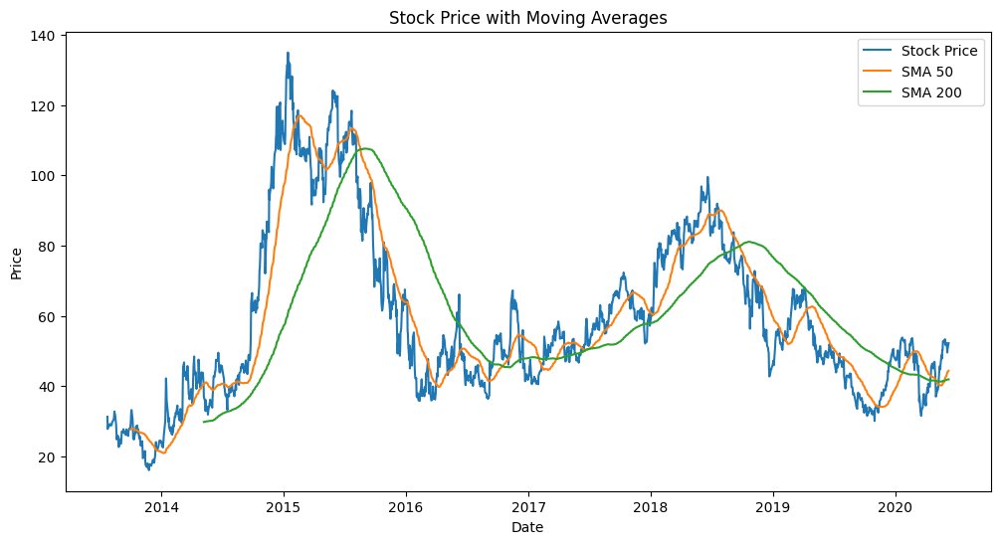

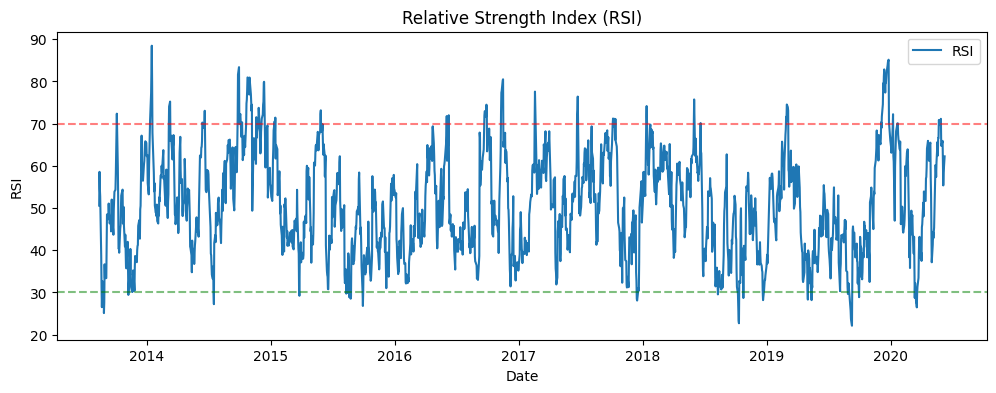

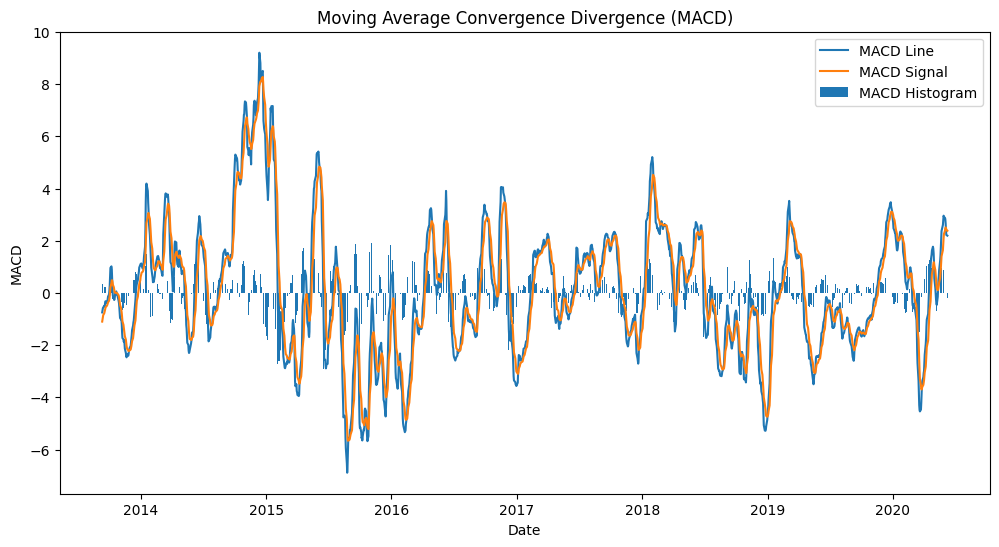

In [10]:
import matplotlib.pyplot as plt

# Assuming you have the stock_data DataFrame with the calculated indicators

# Plotting the stock price and moving averages
plt.figure(figsize=(12, 6))
plt.plot(stock_data['Close'], label='Stock Price')
plt.plot(stock_data['SMA_50'], label='SMA 50')
plt.plot(stock_data['SMA_200'], label='SMA 200')
plt.title('Stock Price with Moving Averages')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.show()

# Plotting the Relative Strength Index (RSI)
plt.figure(figsize=(12, 4))
plt.plot(stock_data['RSI'], label='RSI')
plt.axhline(y=70, color='r', linestyle='--', alpha=0.5)  # Overbought threshold
plt.axhline(y=30, color='g', linestyle='--', alpha=0.5)  # Oversold threshold
plt.title('Relative Strength Index (RSI)')
plt.xlabel('Date')
plt.ylabel('RSI')
plt.legend()
plt.show()

# Plotting the MACD
plt.figure(figsize=(12, 6))
plt.plot(stock_data['MACD_Line'], label='MACD Line')
plt.plot(stock_data['MACD_Signal'], label='MACD Signal')
plt.bar(stock_data.index, stock_data['MACD_Histogram'], label='MACD Histogram')
plt.title('Moving Average Convergence Divergence (MACD)')
plt.xlabel('Date')
plt.ylabel('MACD')
plt.legend()
plt.show()

[*********************100%%**********************]  1 of 1 completed


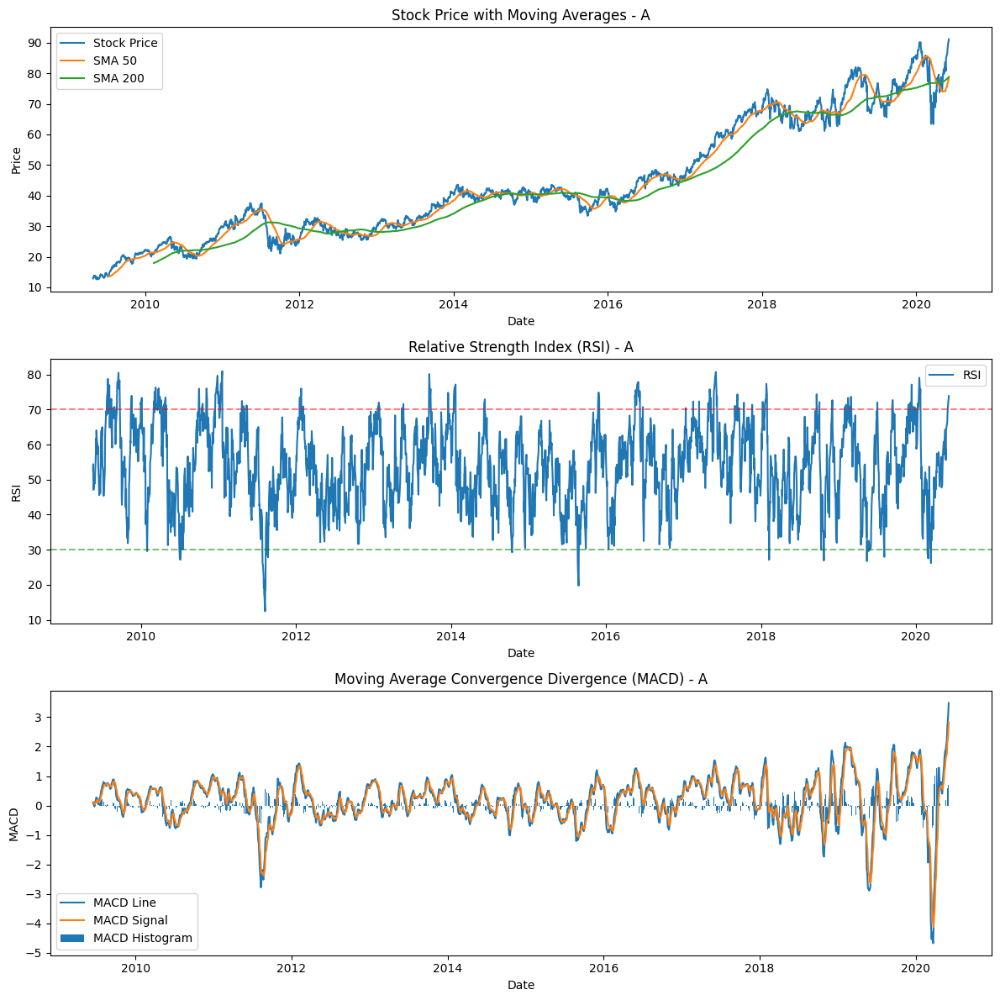

[*********************100%%**********************]  1 of 1 completed


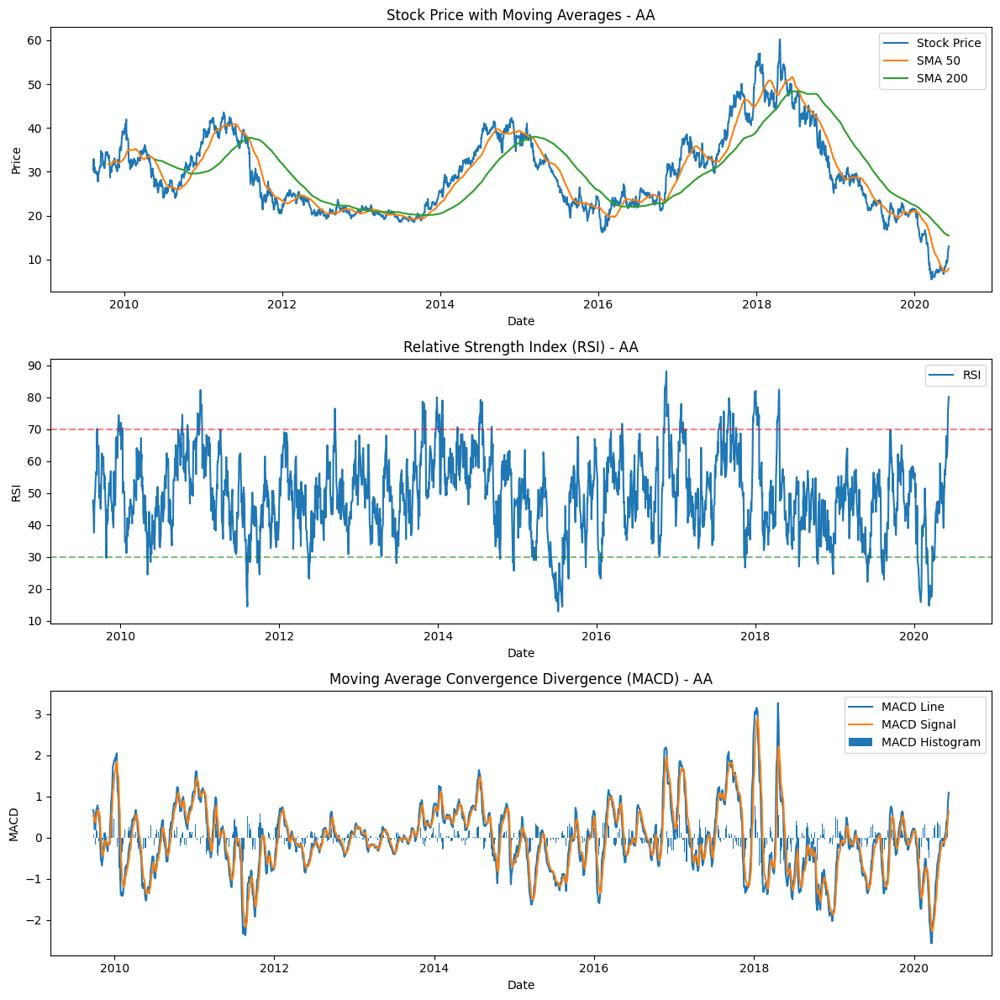

[*********************100%%**********************]  1 of 1 completed


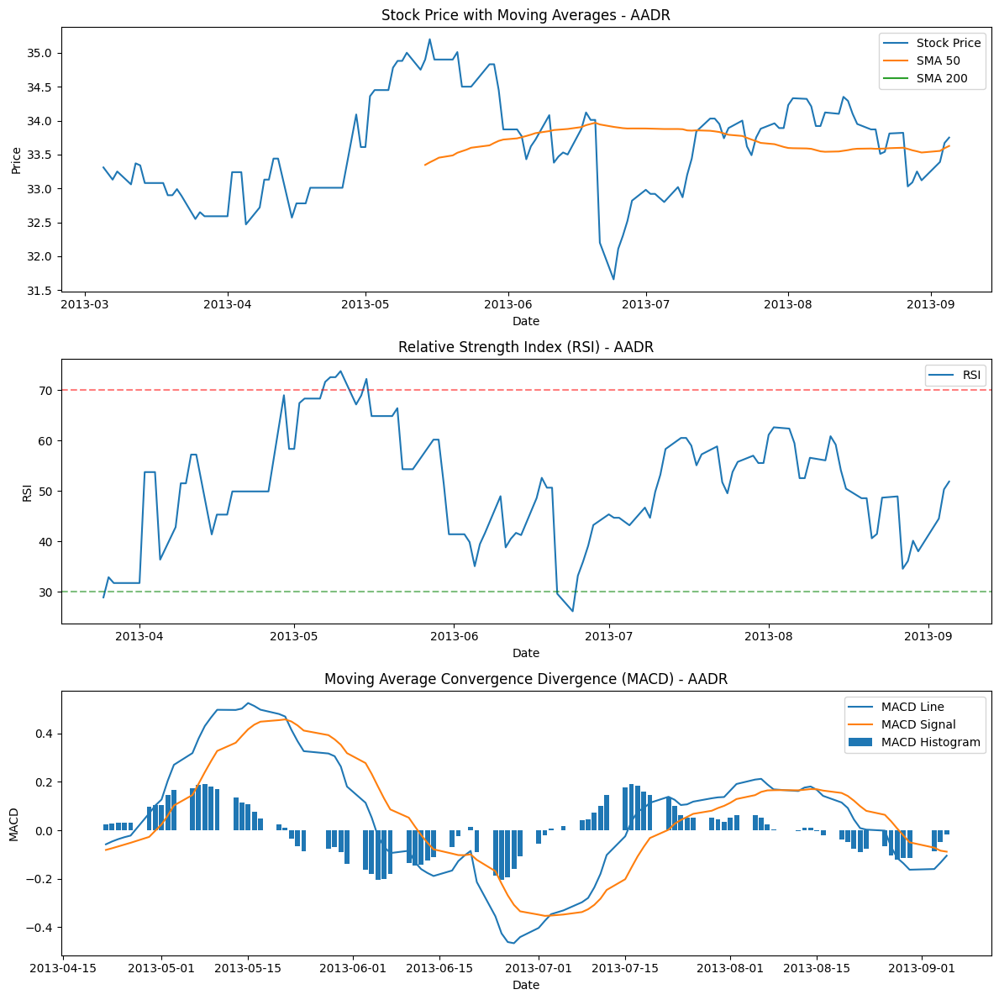

[*********************100%%**********************]  1 of 1 completed


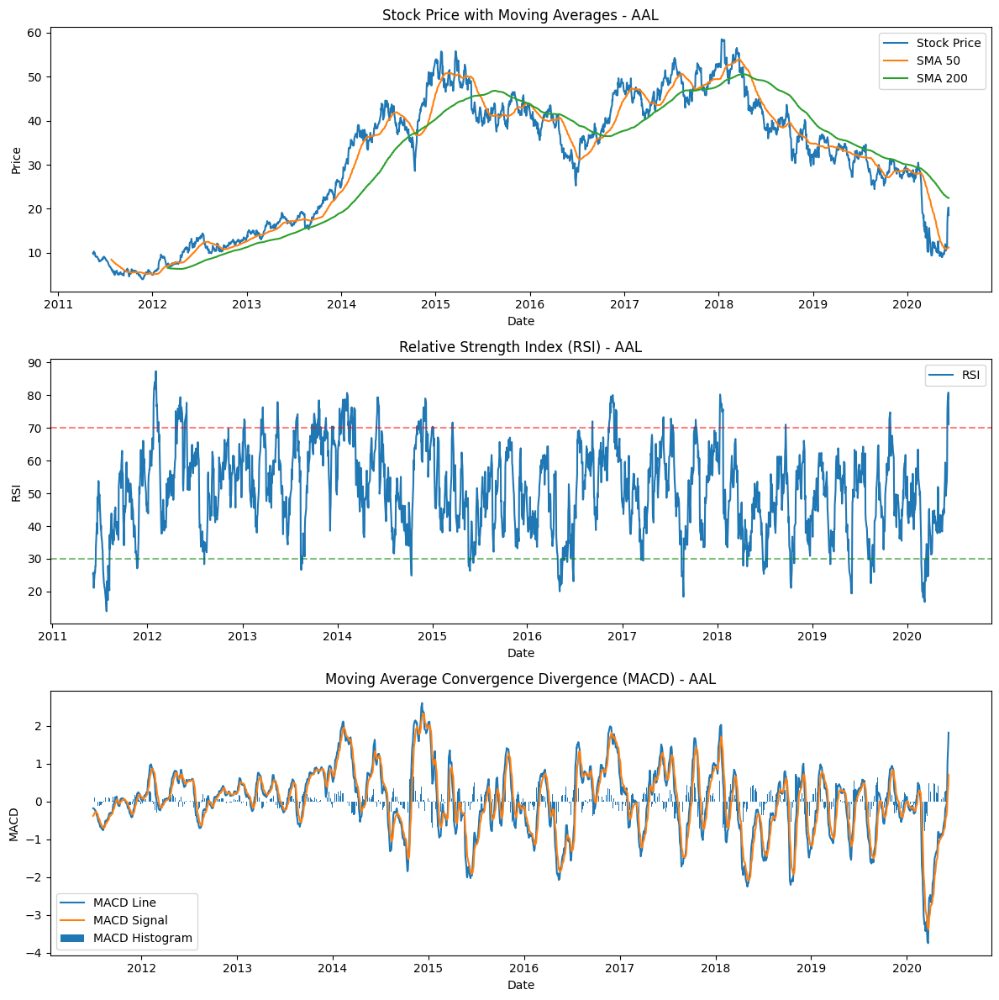

[*********************100%%**********************]  1 of 1 completed


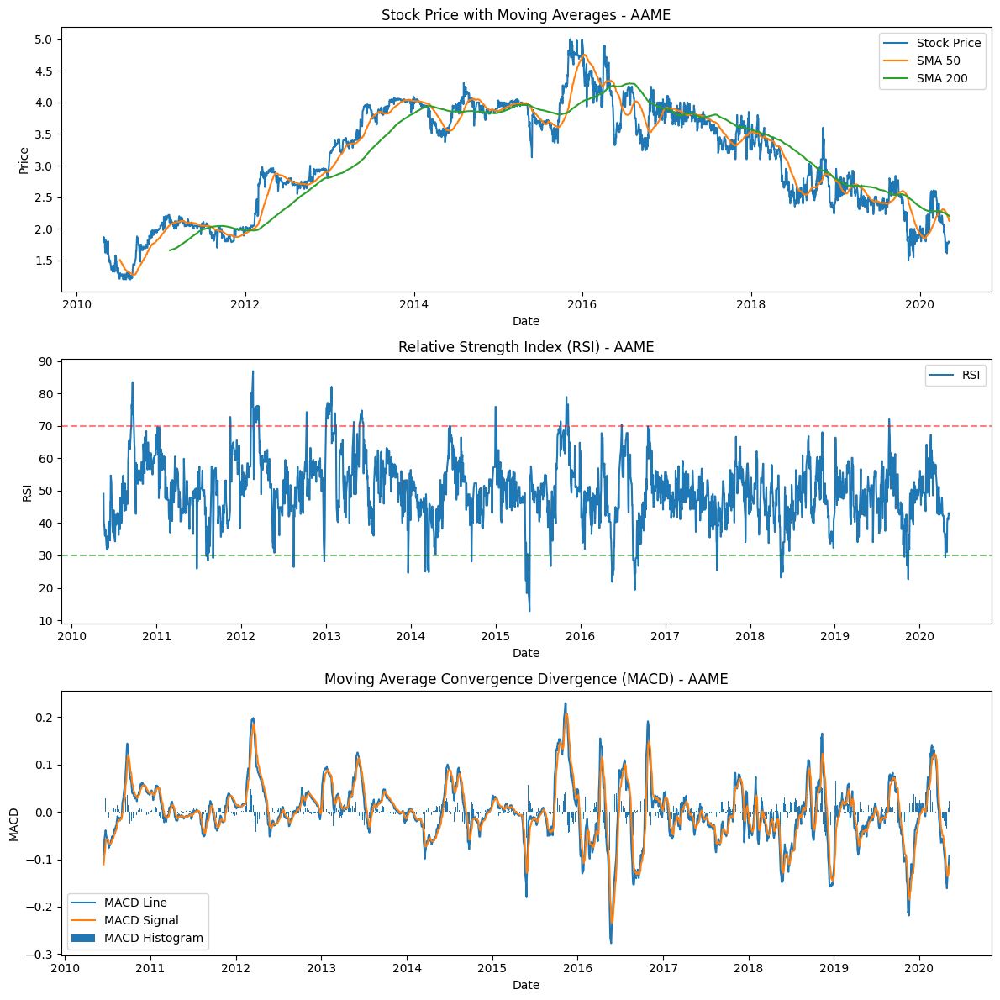

[*********************100%%**********************]  1 of 1 completed


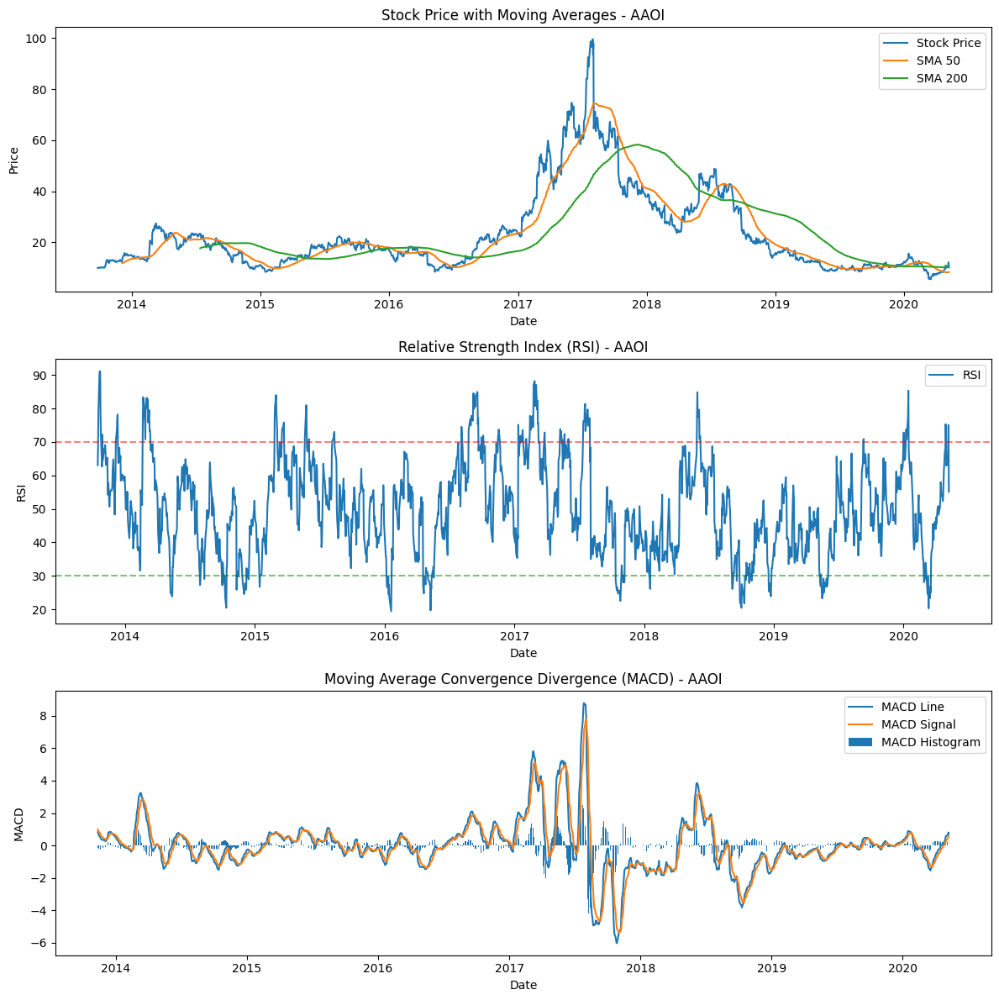

[*********************100%%**********************]  1 of 1 completed


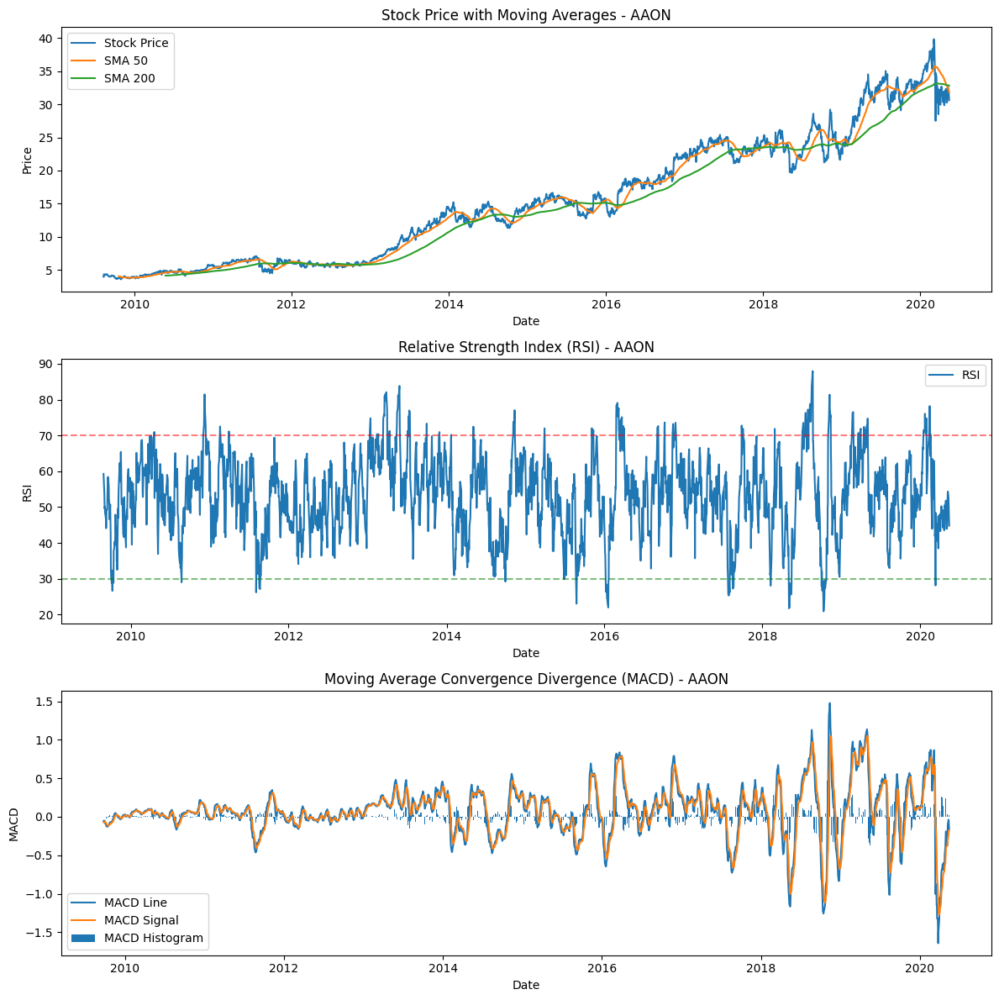

[*********************100%%**********************]  1 of 1 completed


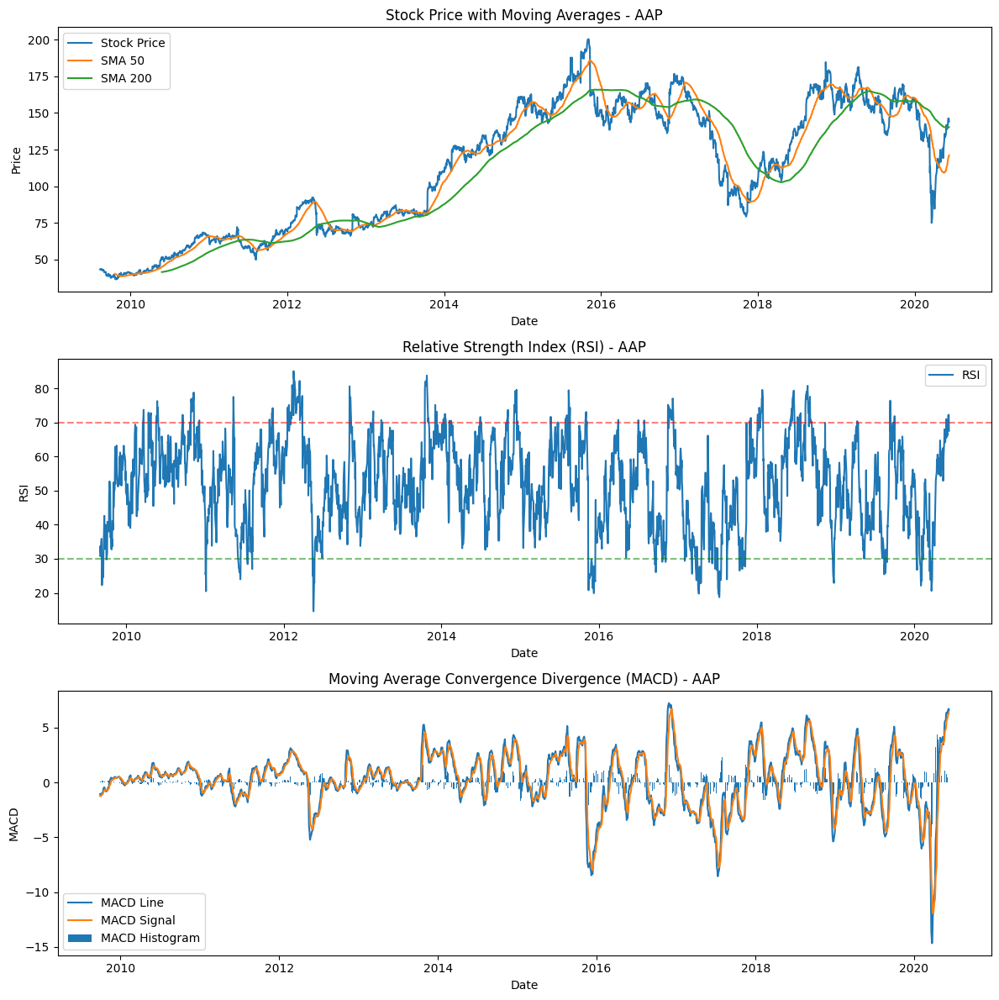

[*********************100%%**********************]  1 of 1 completed


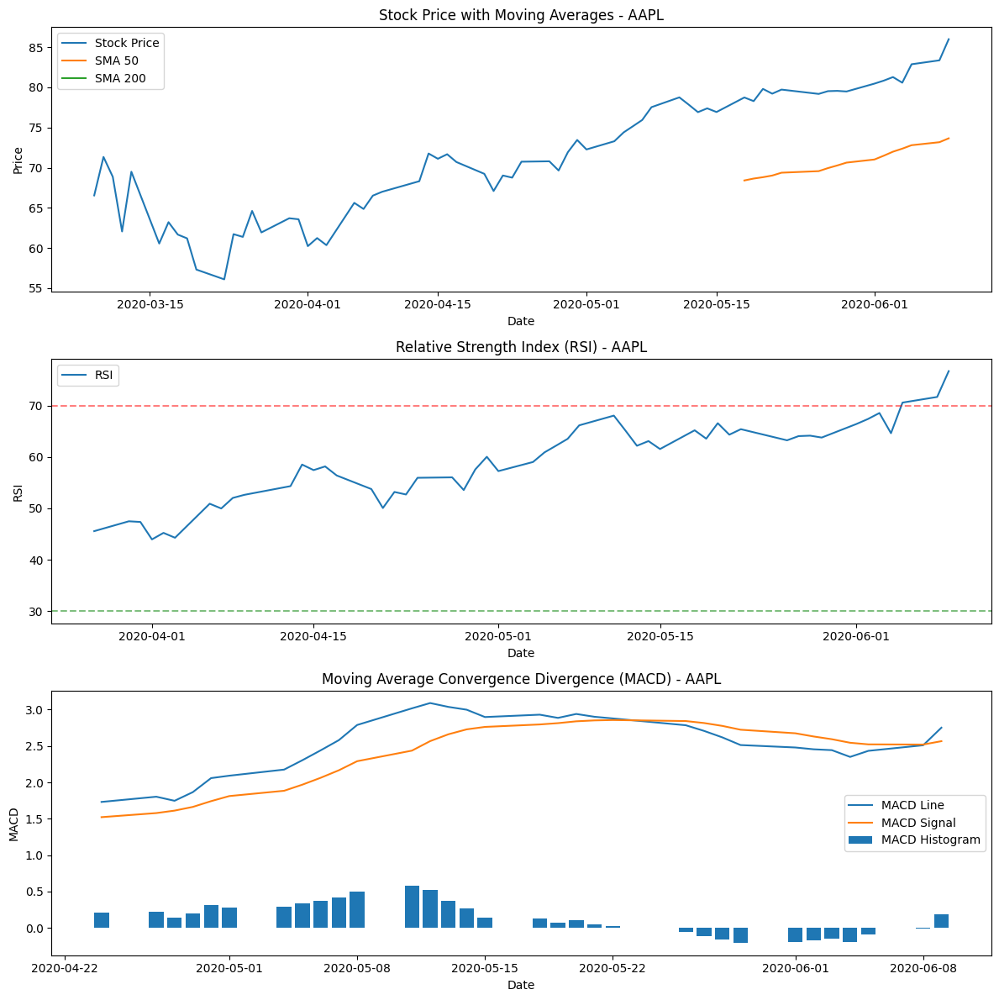

[*********************100%%**********************]  1 of 1 completed


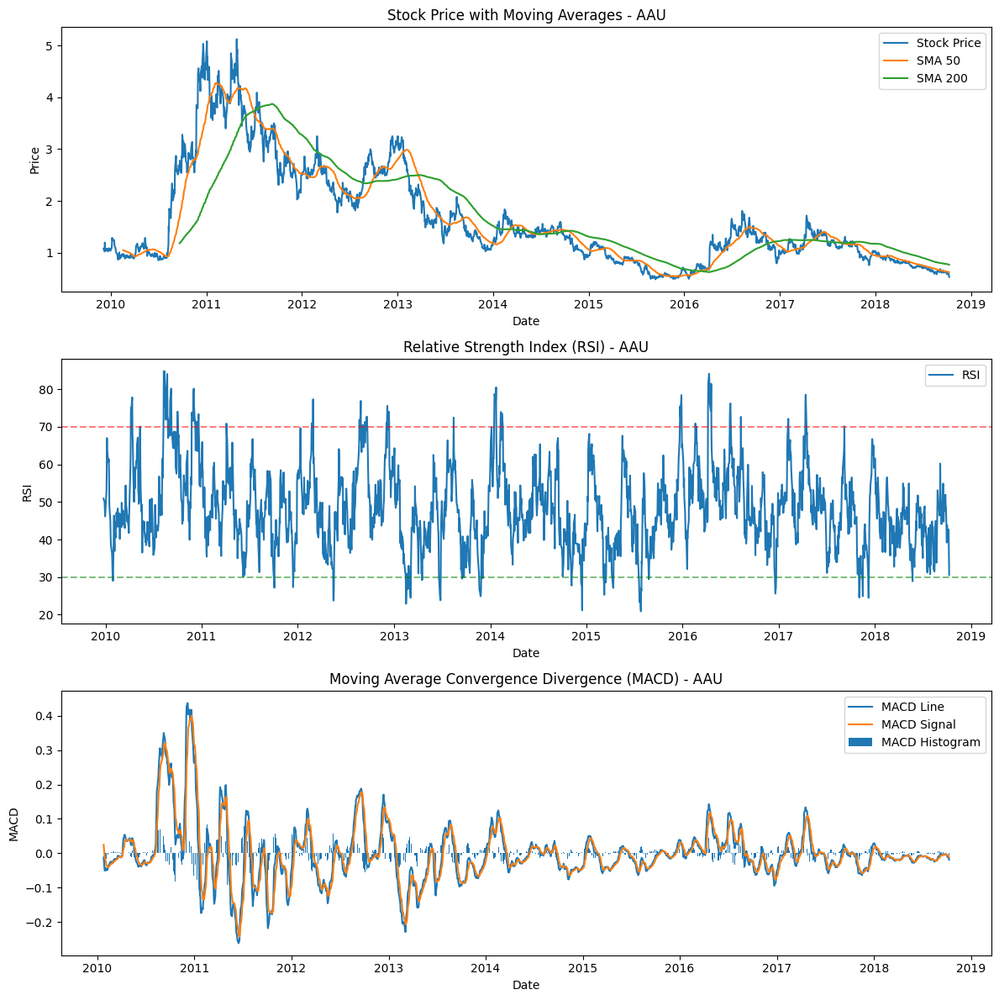

[*********************100%%**********************]  1 of 1 completed


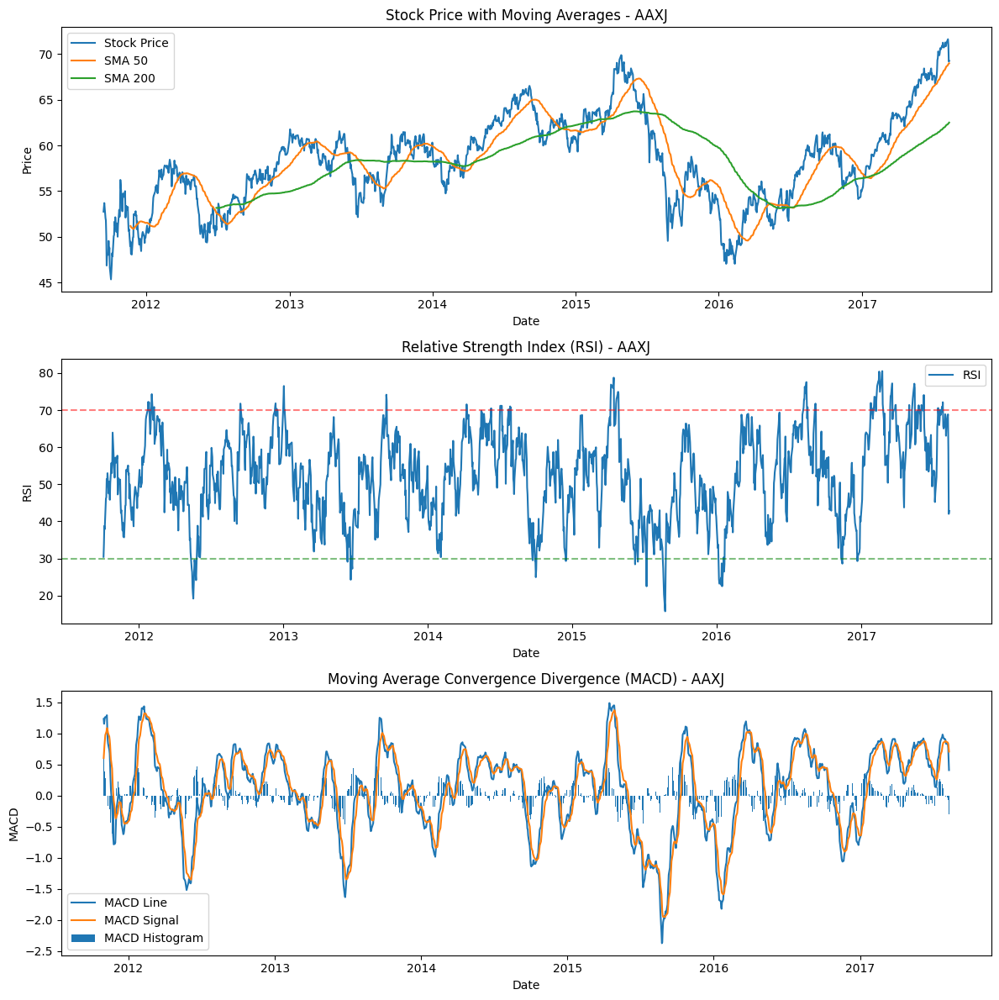

[*********************100%%**********************]  1 of 1 completed


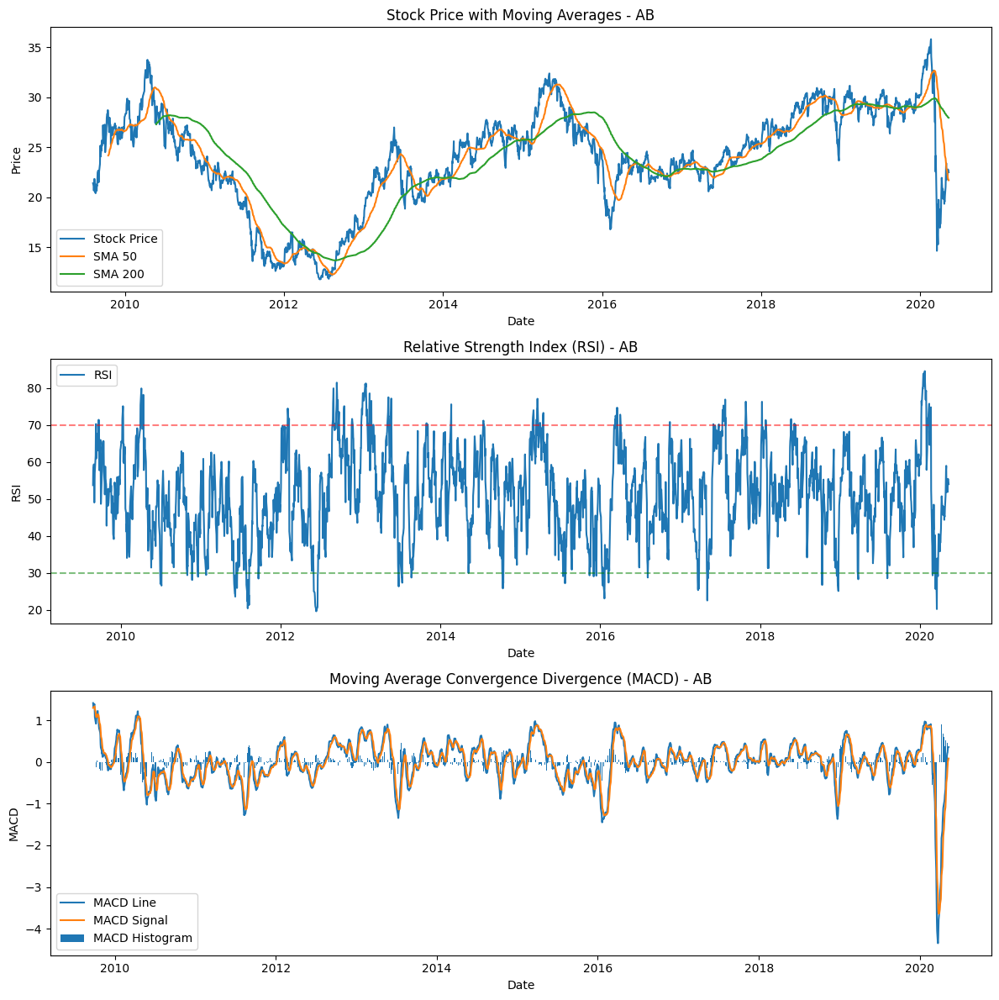

[*********************100%%**********************]  1 of 1 completed


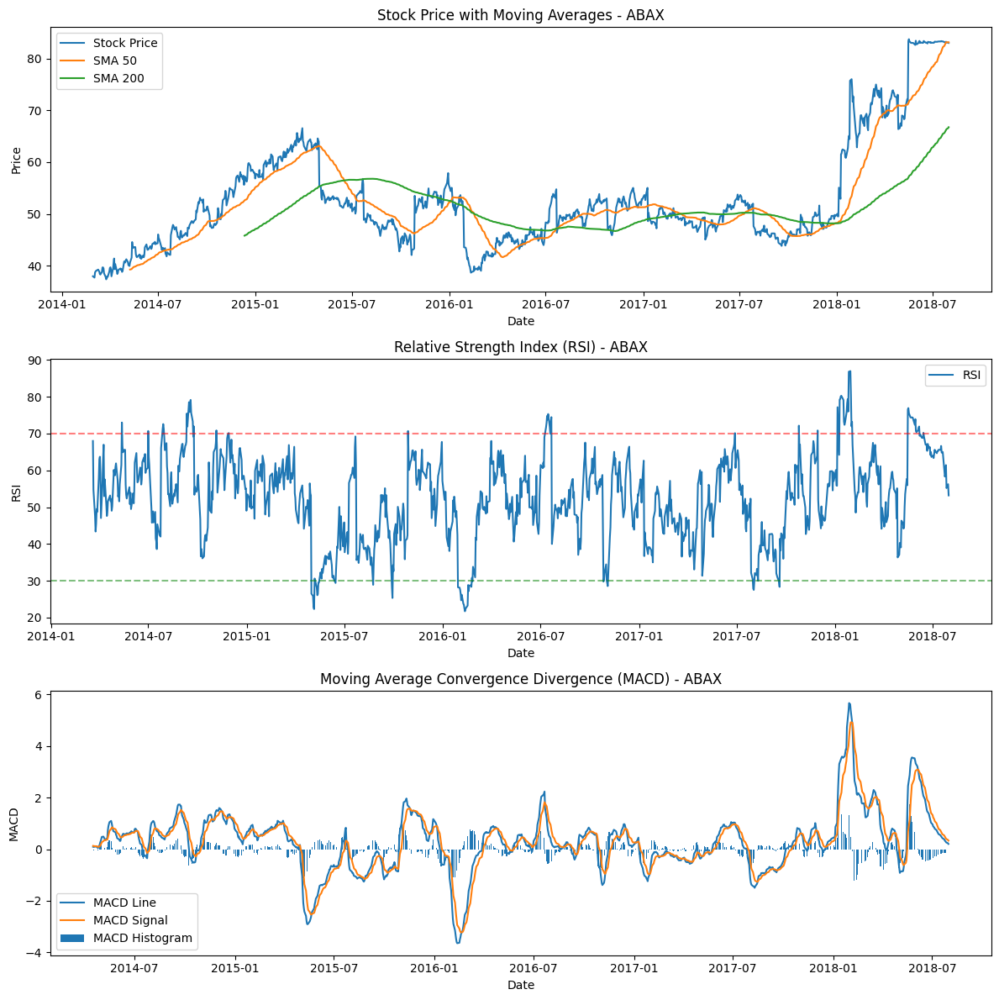

[*********************100%%**********************]  1 of 1 completed


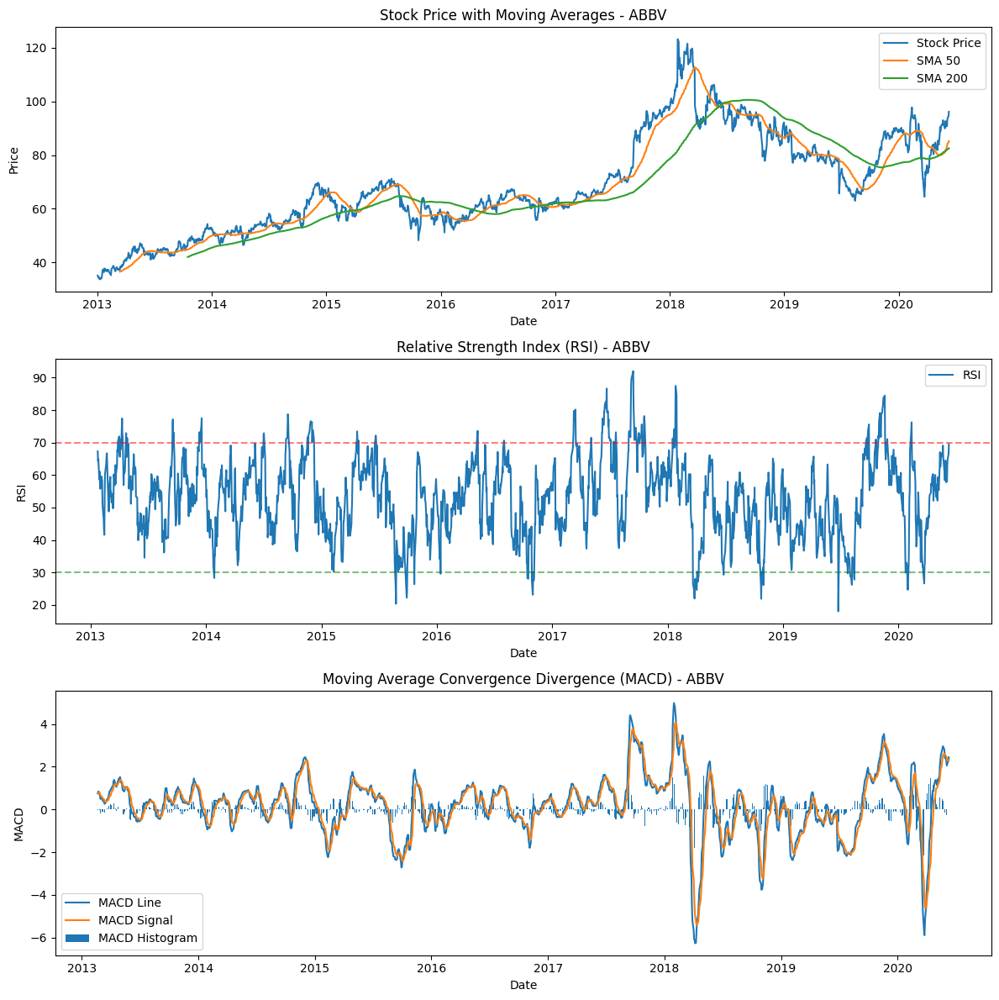

[*********************100%%**********************]  1 of 1 completed


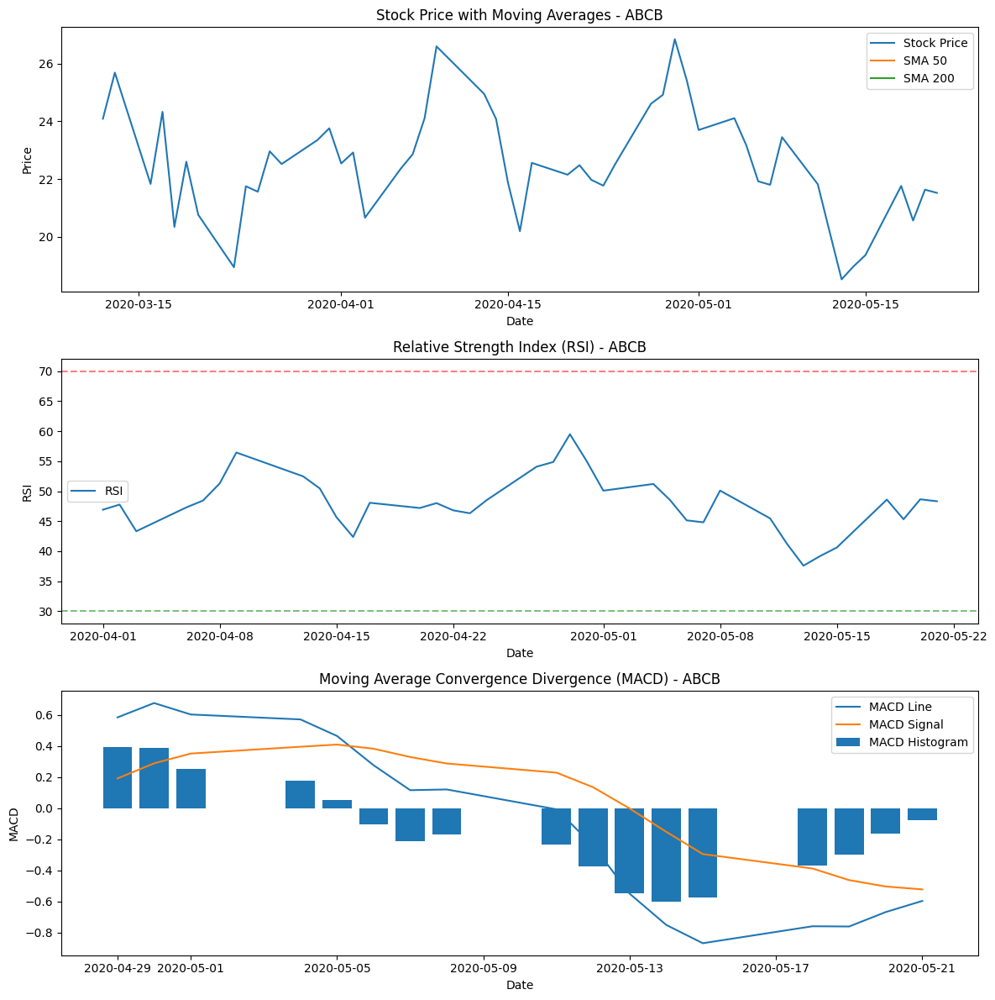

[*********************100%%**********************]  1 of 1 completed


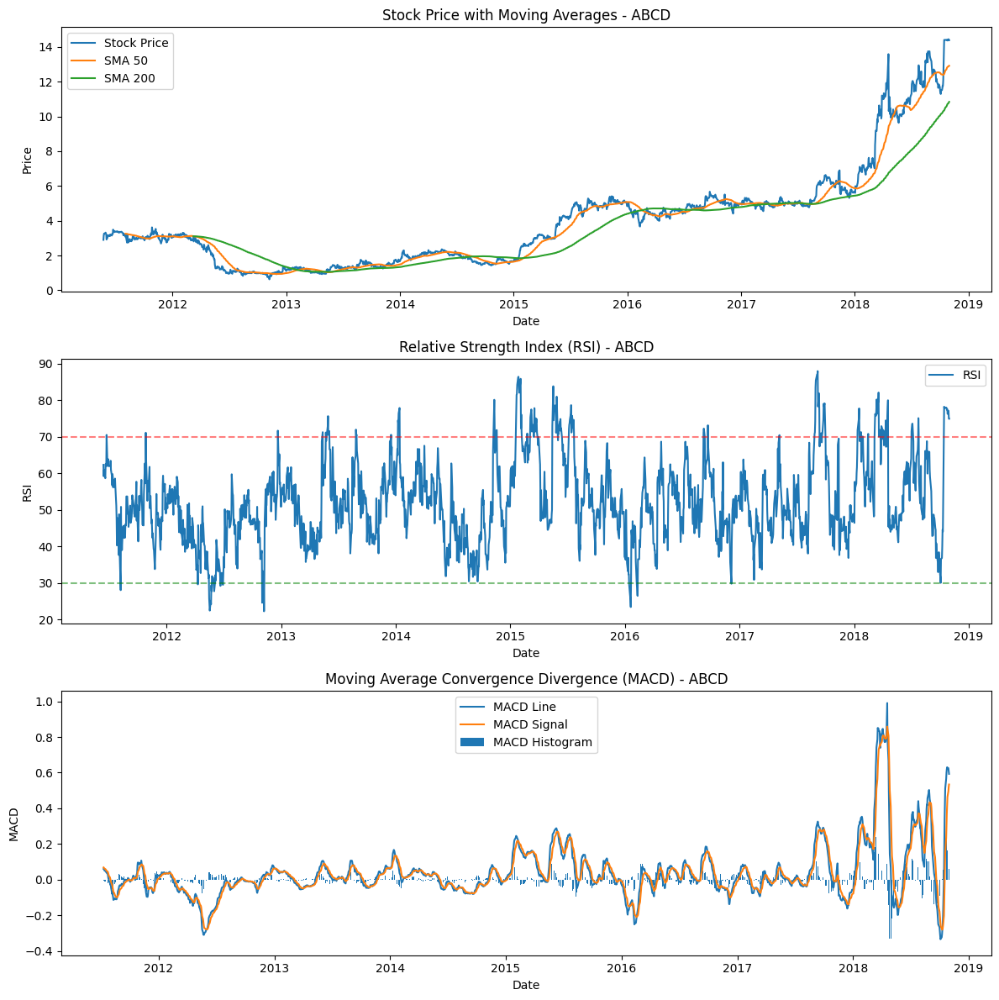

[*********************100%%**********************]  1 of 1 completed


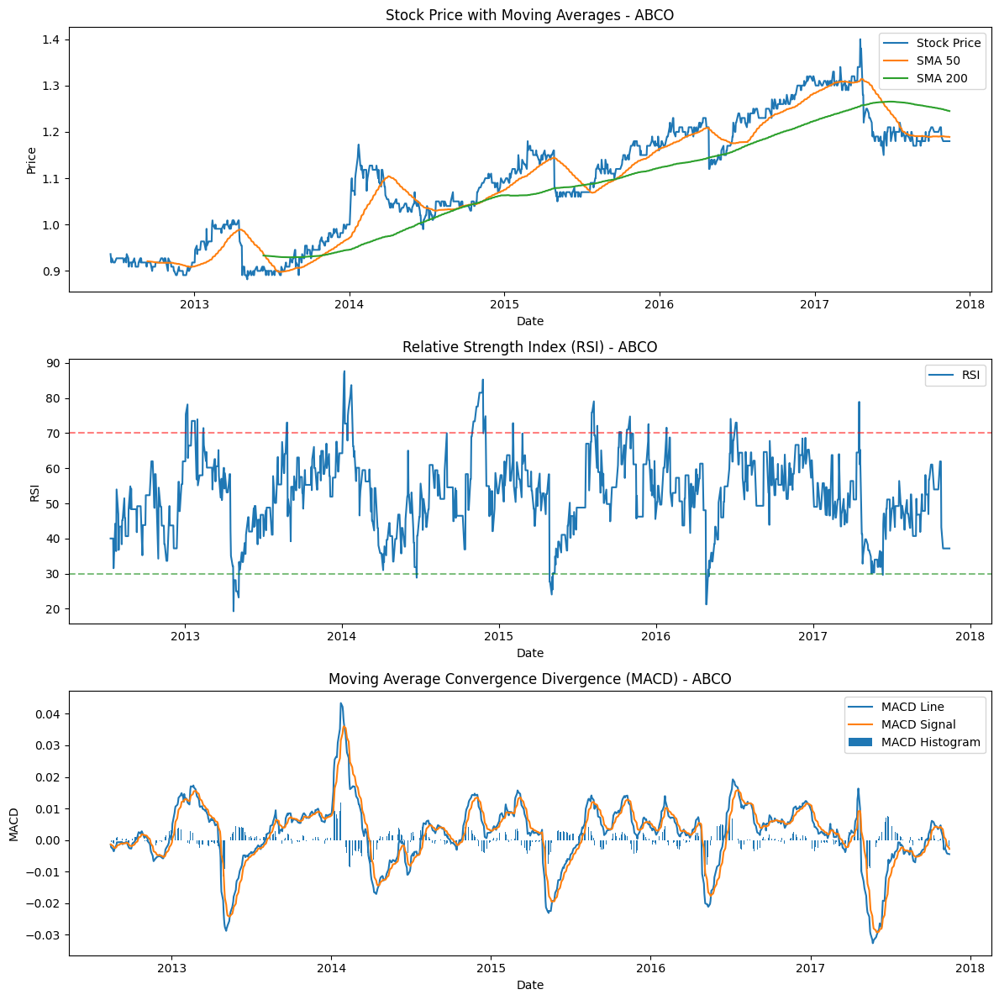

[*********************100%%**********************]  1 of 1 completed


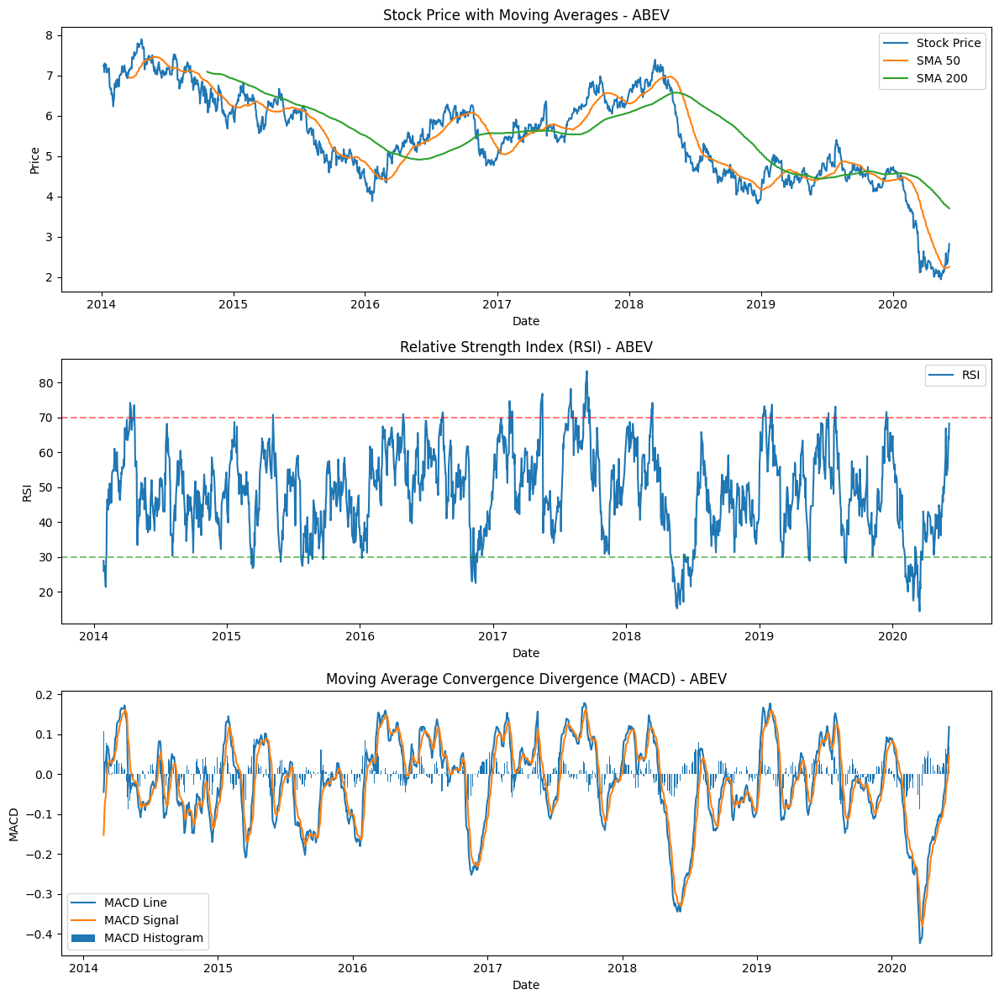

[*********************100%%**********************]  1 of 1 completed


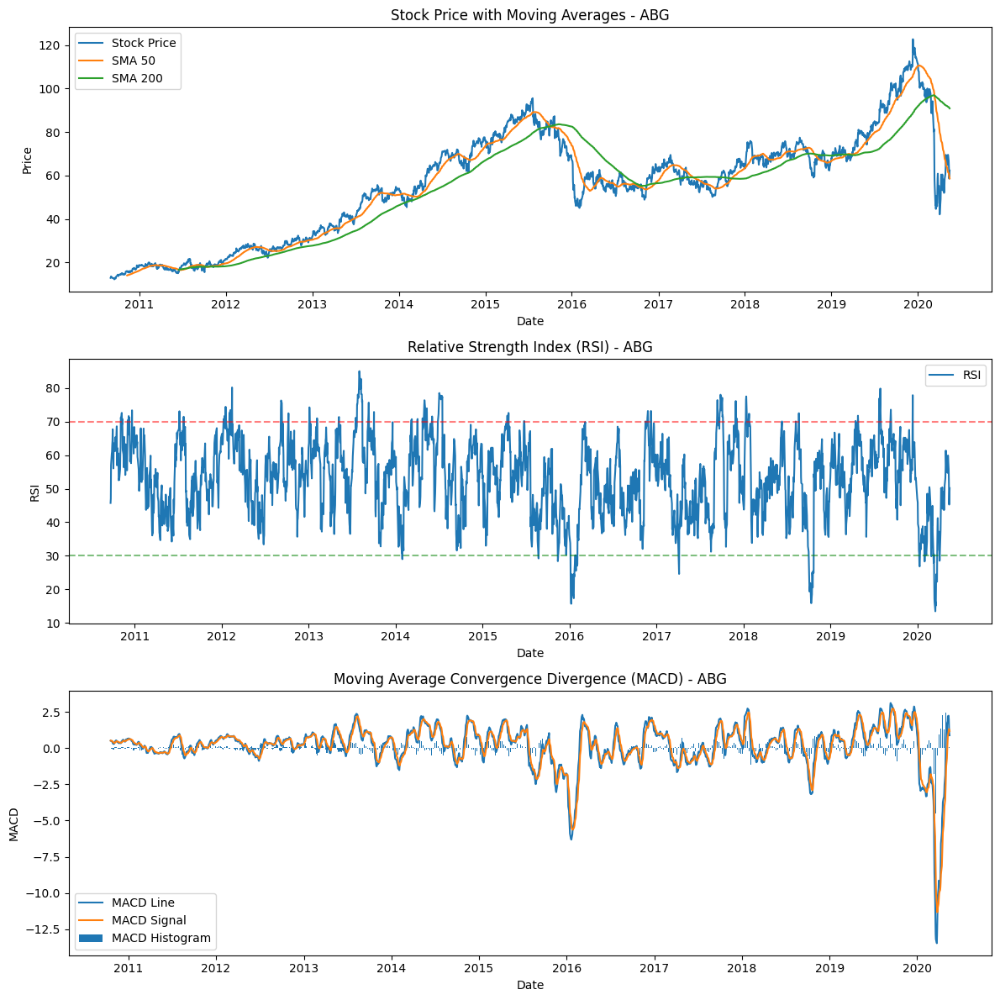

[*********************100%%**********************]  1 of 1 completed


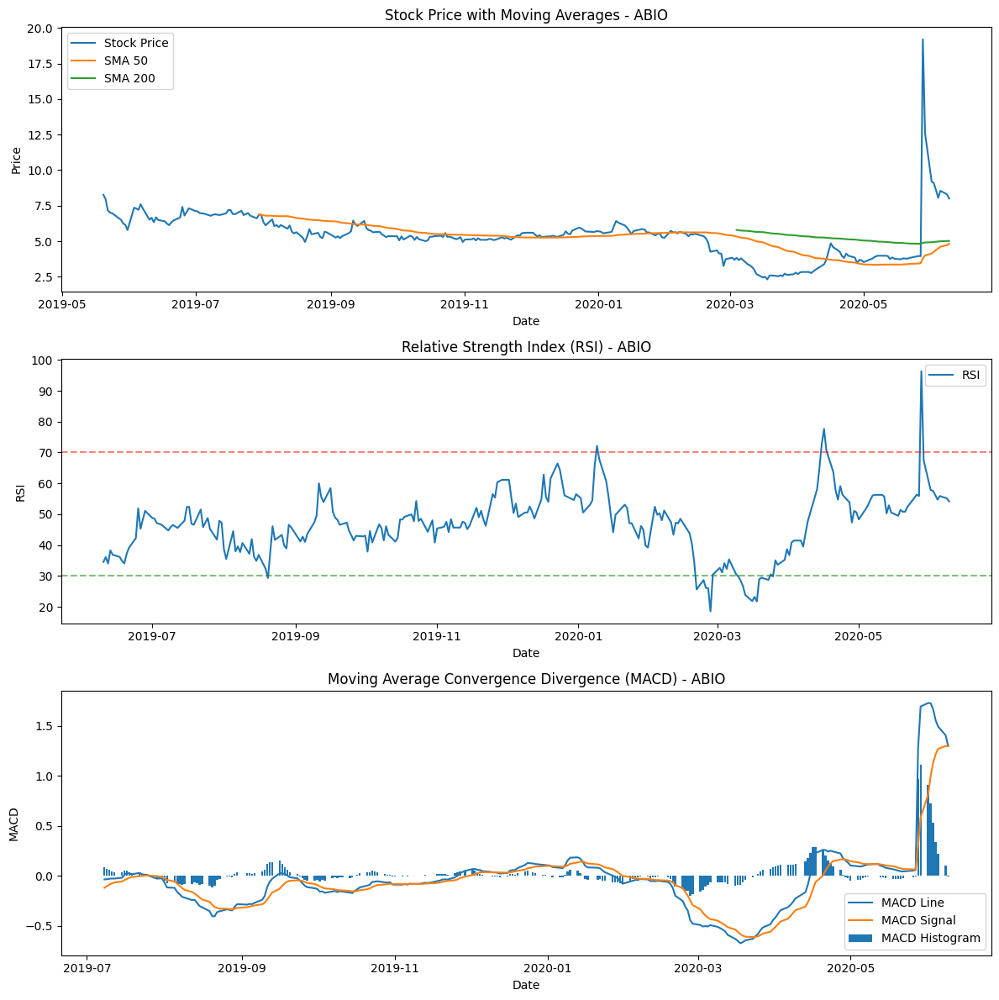

[*********************100%%**********************]  1 of 1 completed


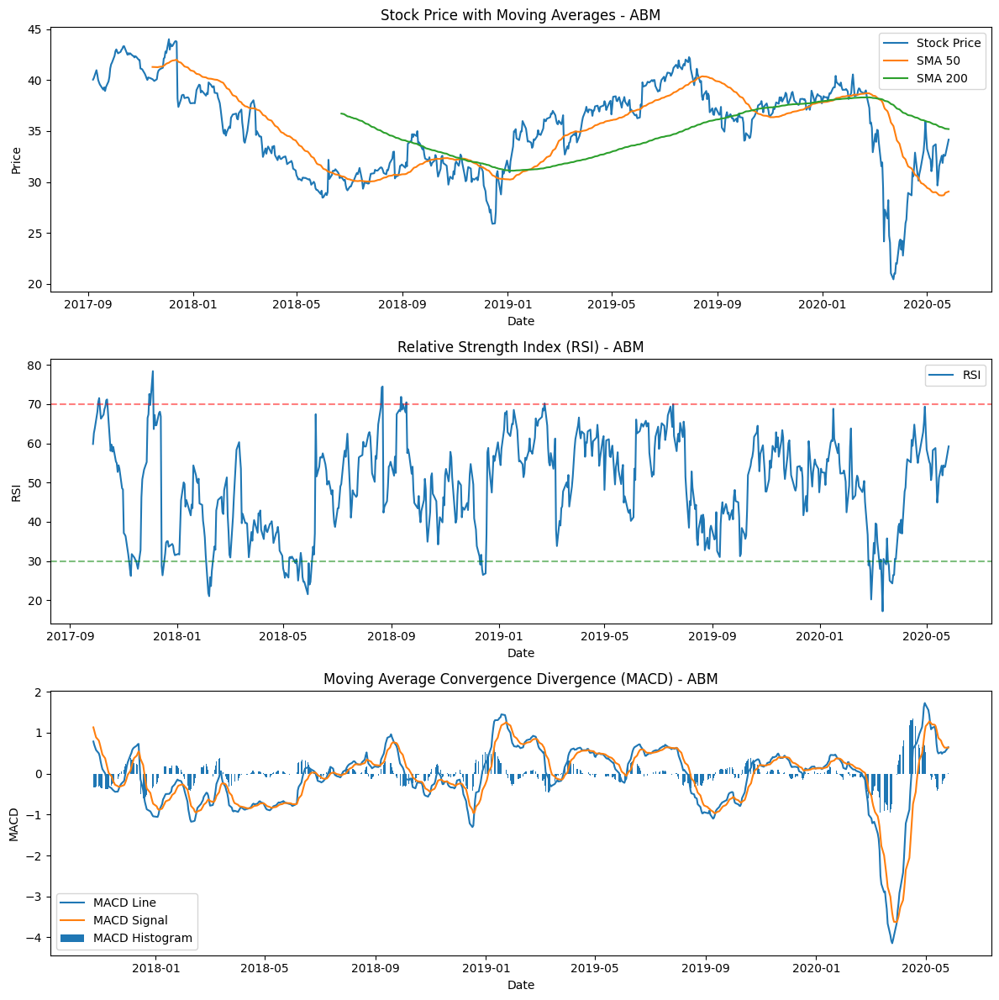

[*********************100%%**********************]  1 of 1 completed


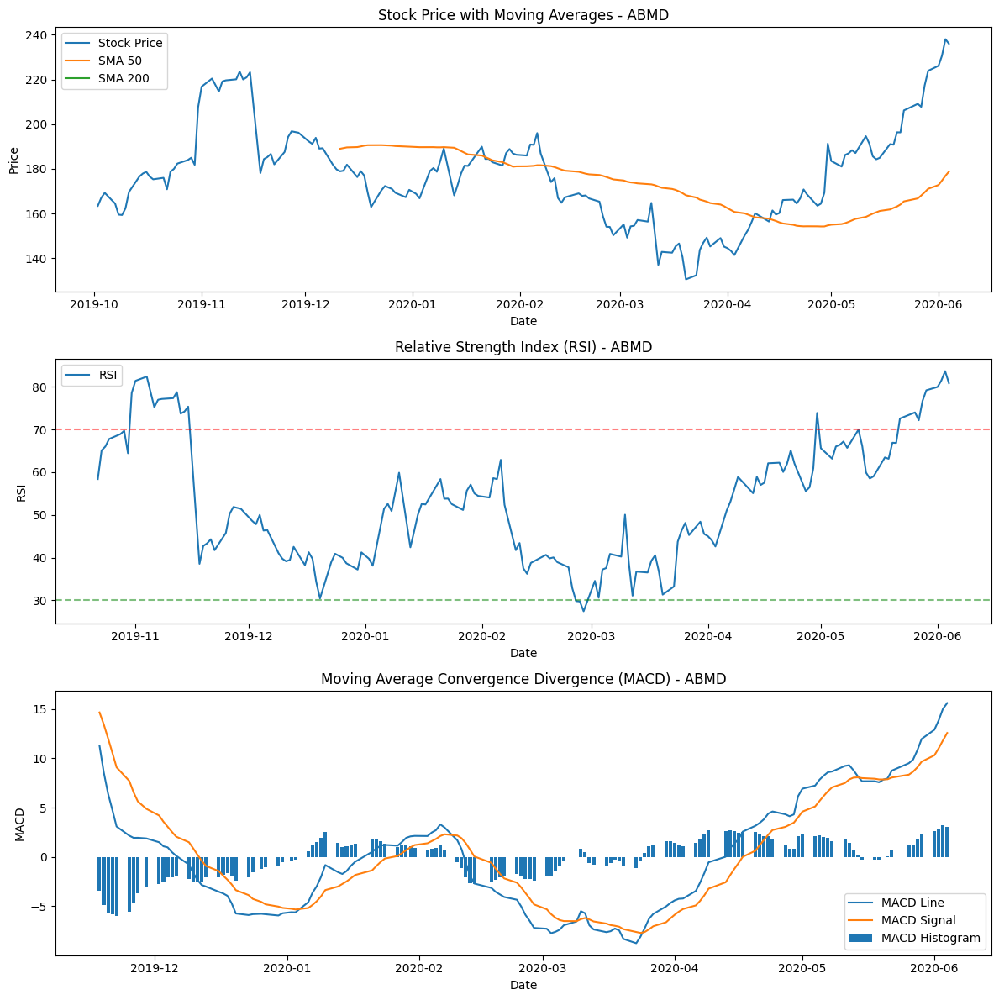

[*********************100%%**********************]  1 of 1 completed


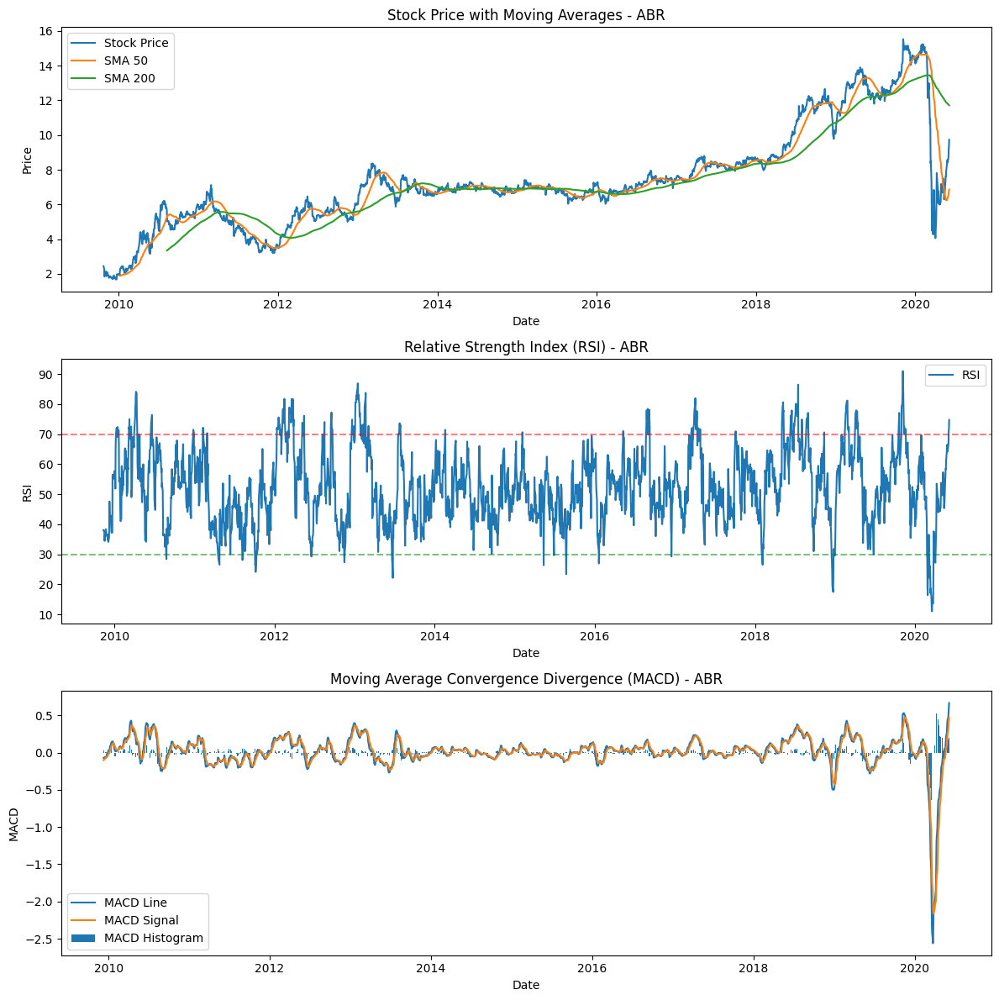

[*********************100%%**********************]  1 of 1 completed


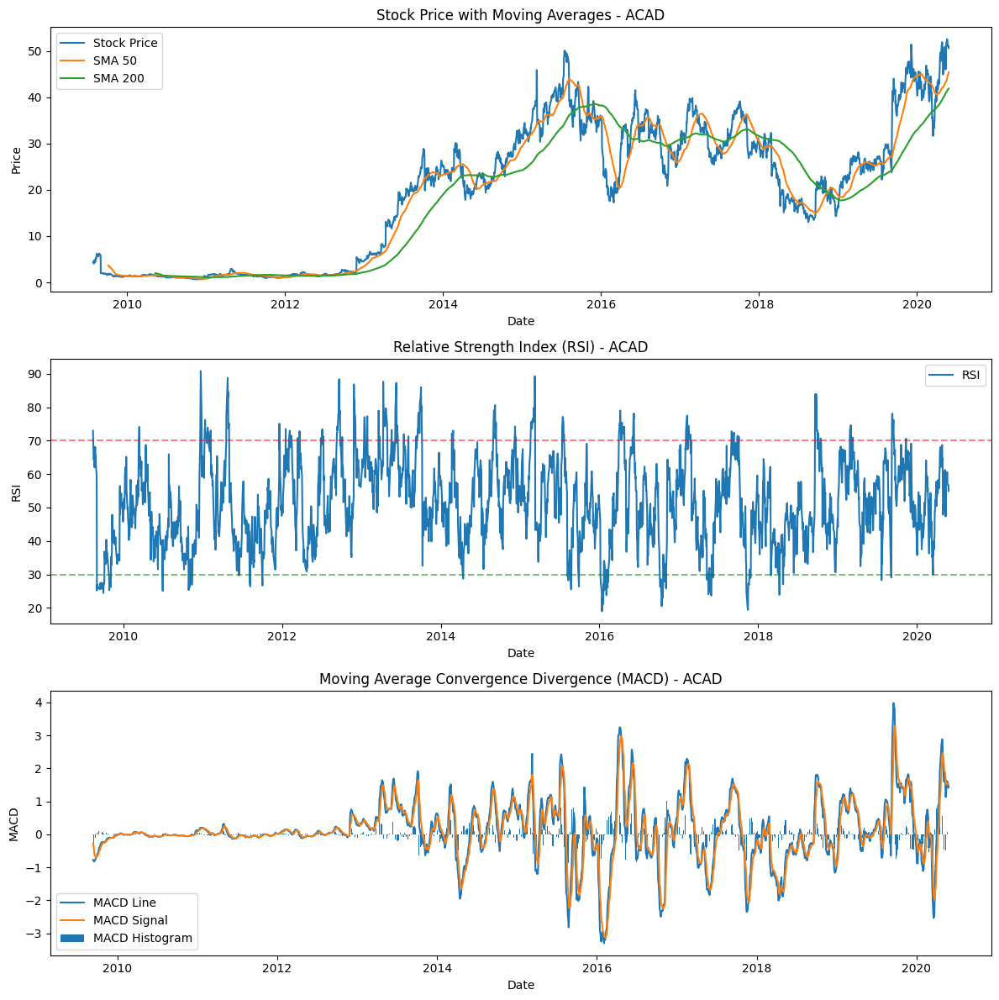

[*********************100%%**********************]  1 of 1 completed


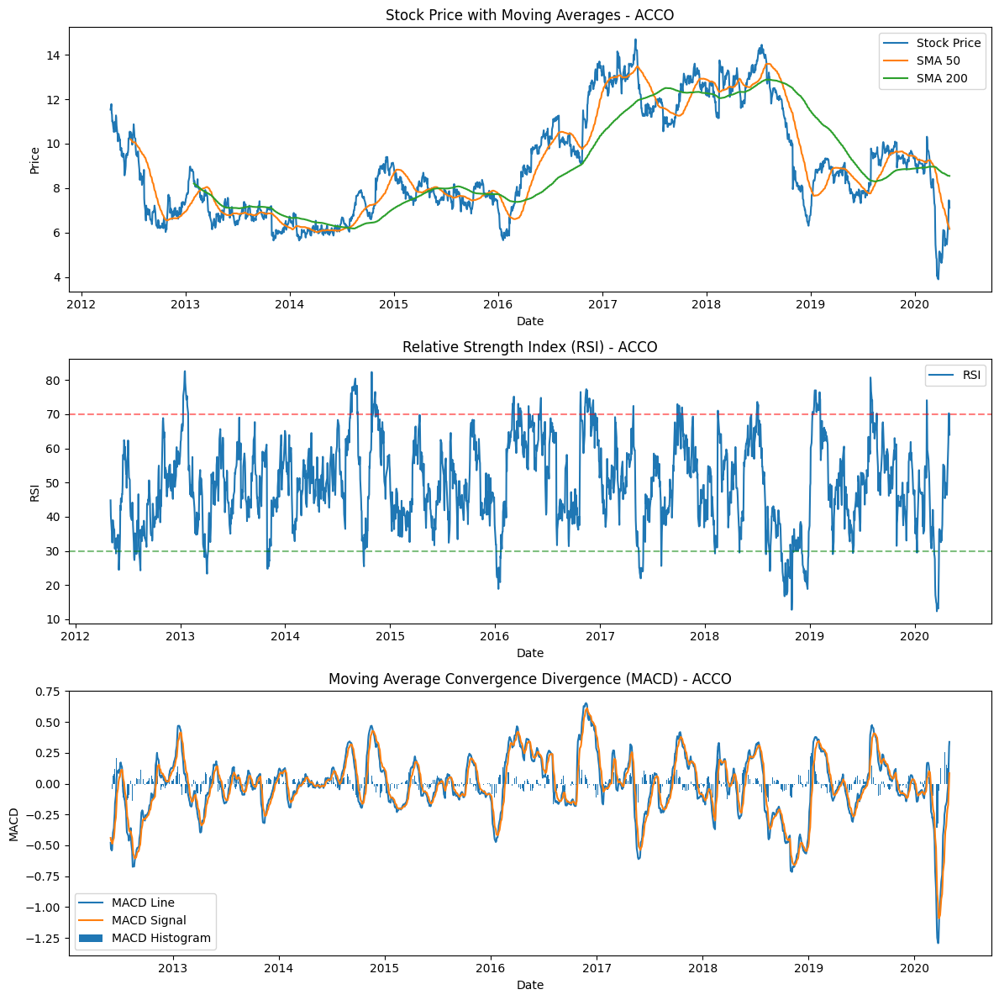

[*********************100%%**********************]  1 of 1 completed


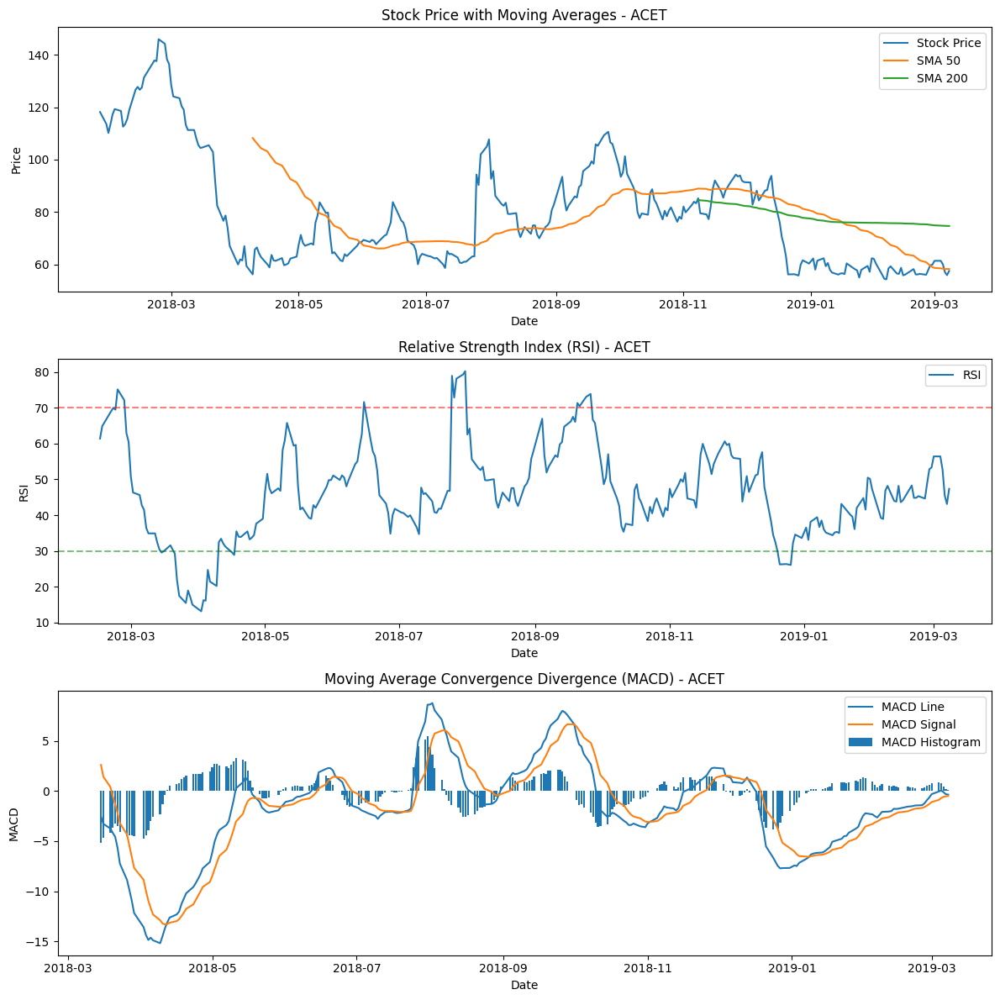

[*********************100%%**********************]  1 of 1 completed


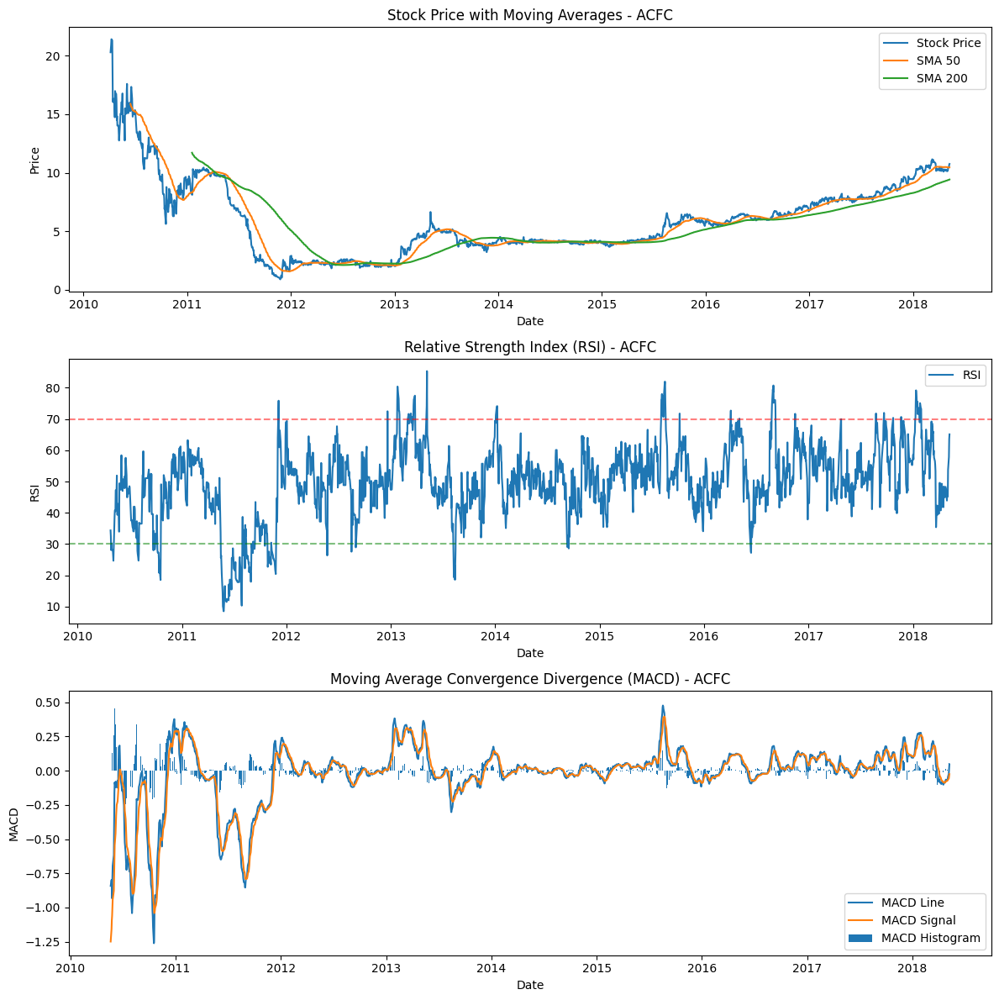

[*********************100%%**********************]  1 of 1 completed


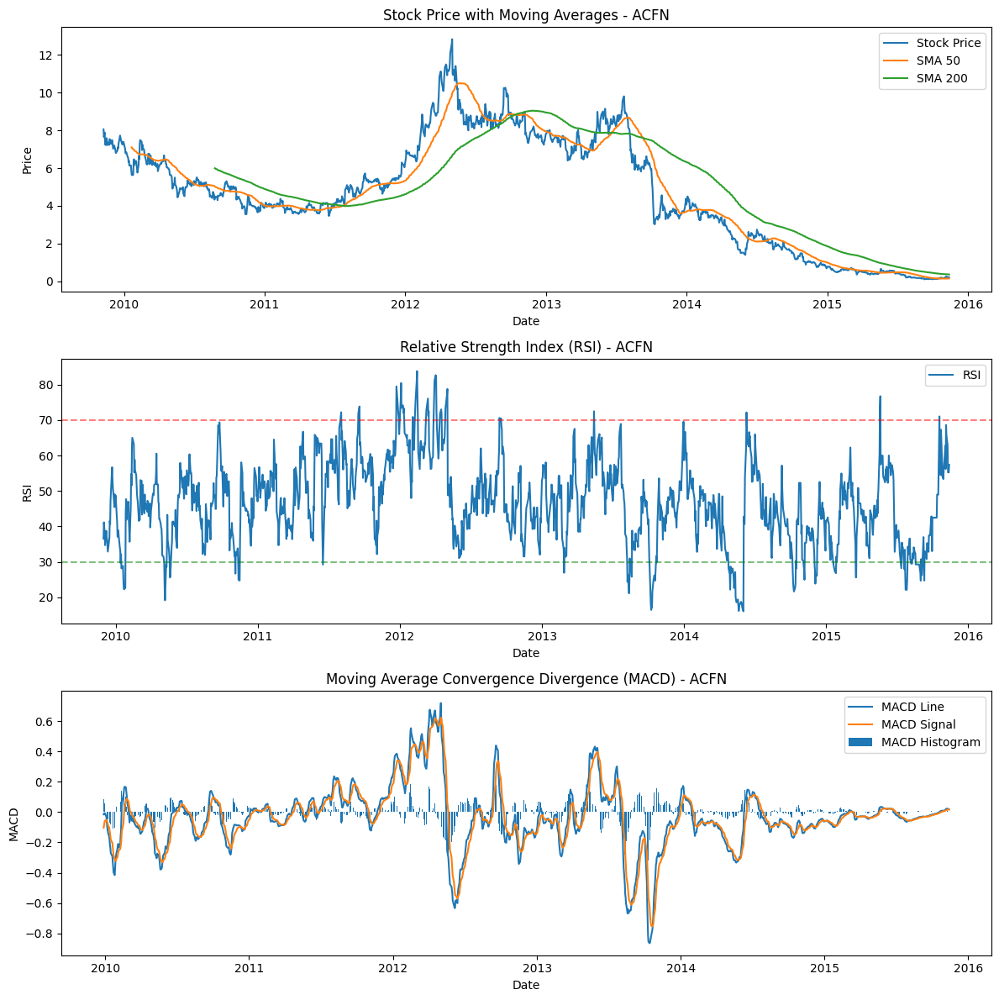

[*********************100%%**********************]  1 of 1 completed


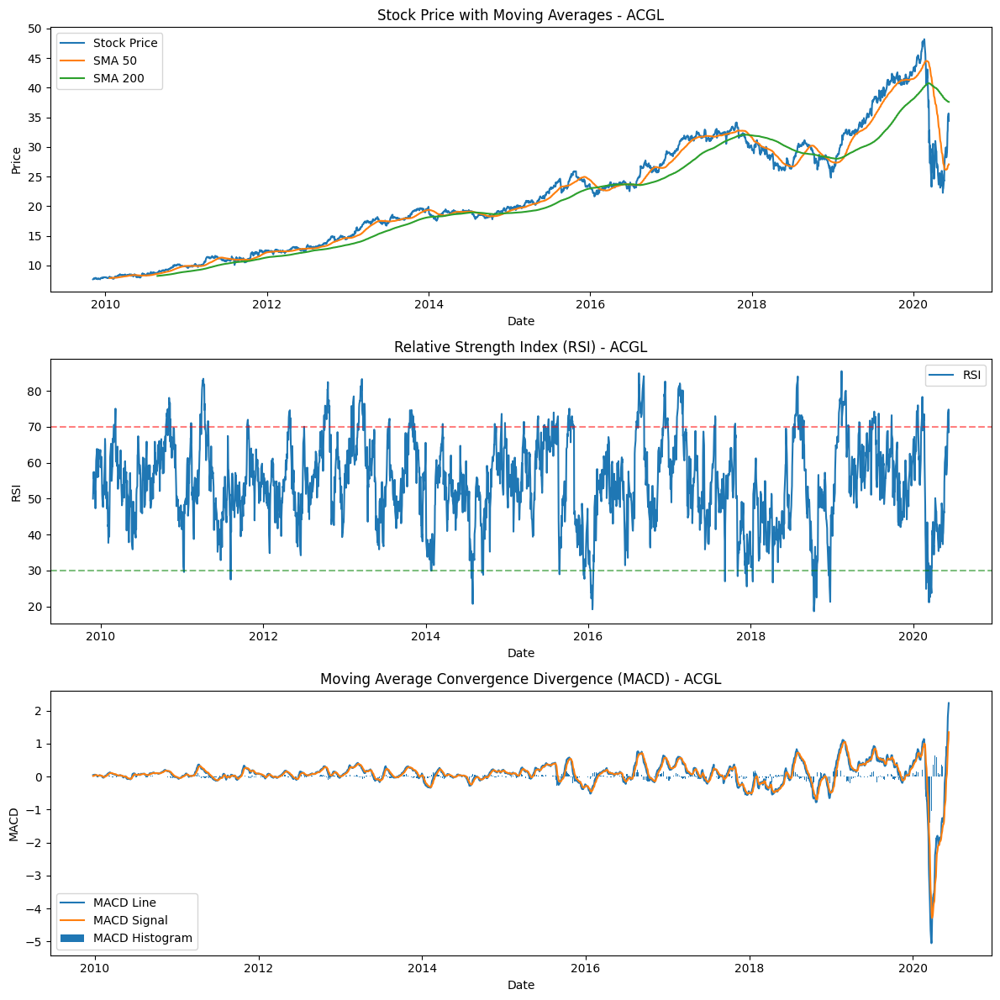

[*********************100%%**********************]  1 of 1 completed


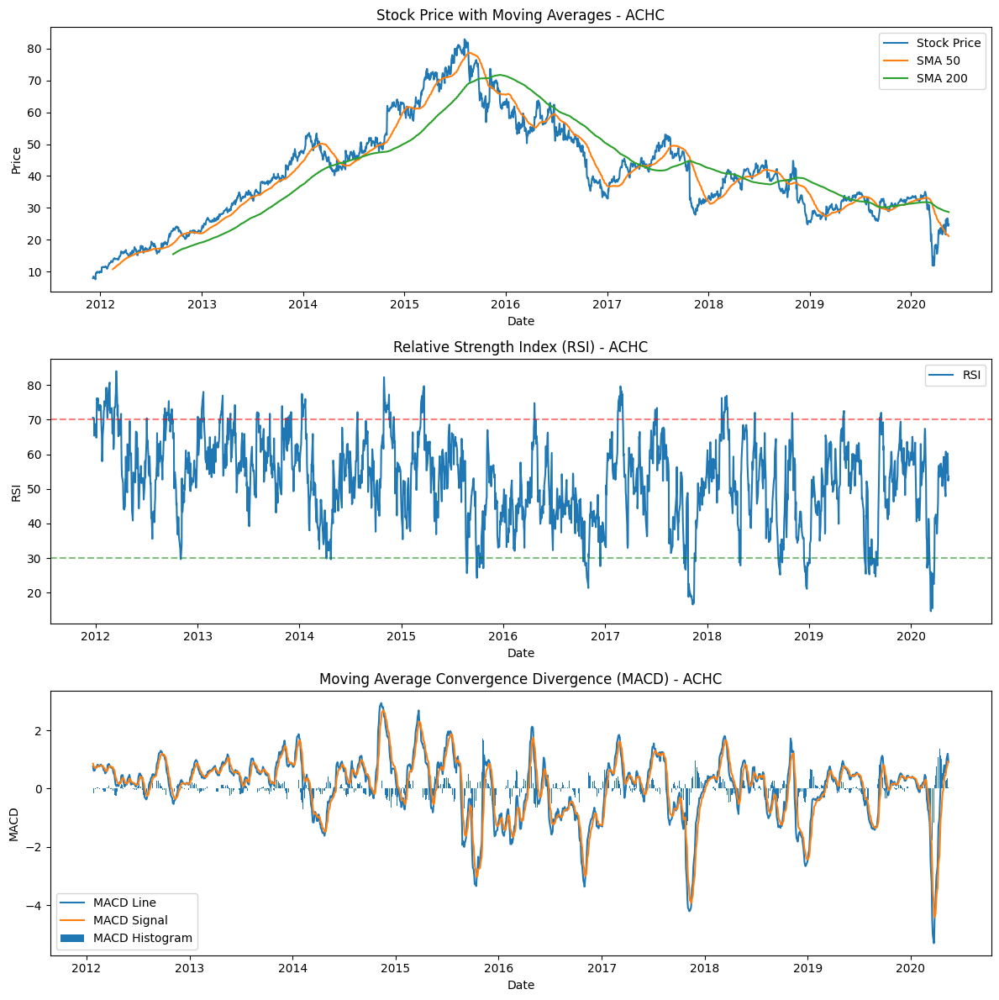

[*********************100%%**********************]  1 of 1 completed


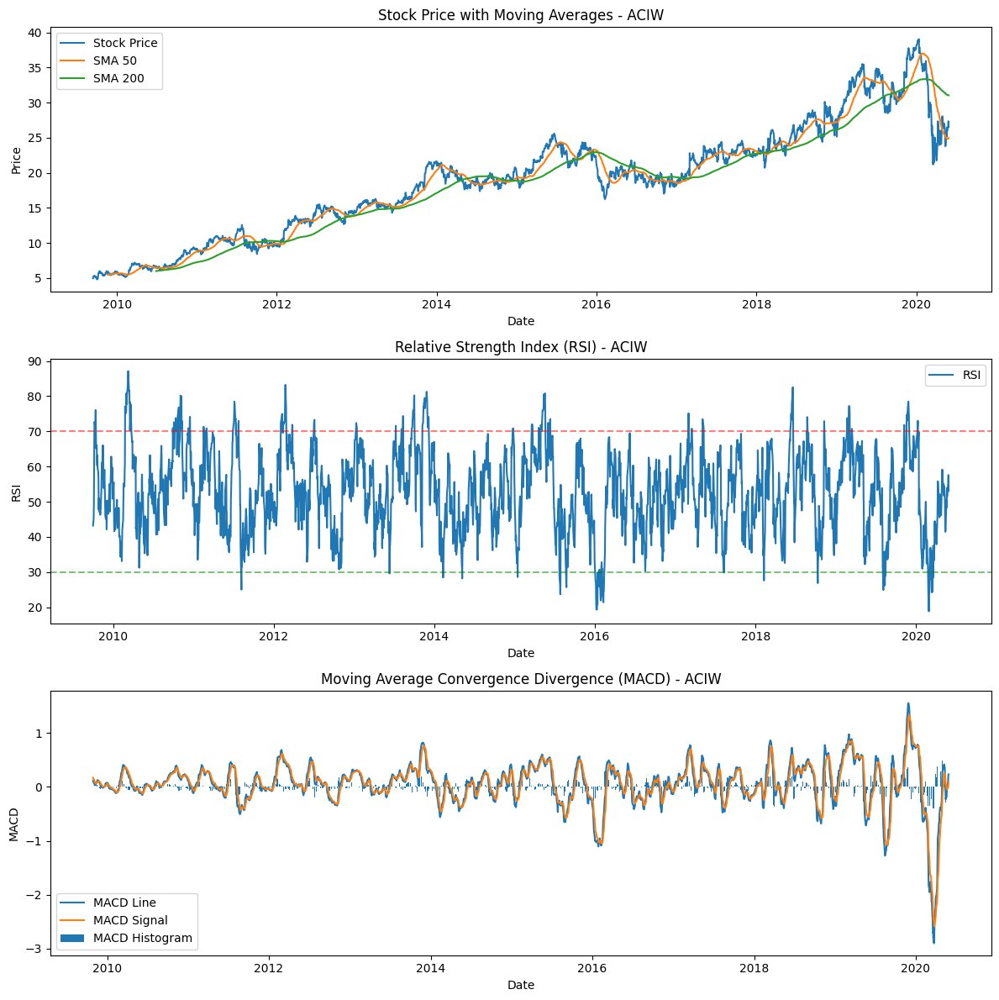

[*********************100%%**********************]  1 of 1 completed


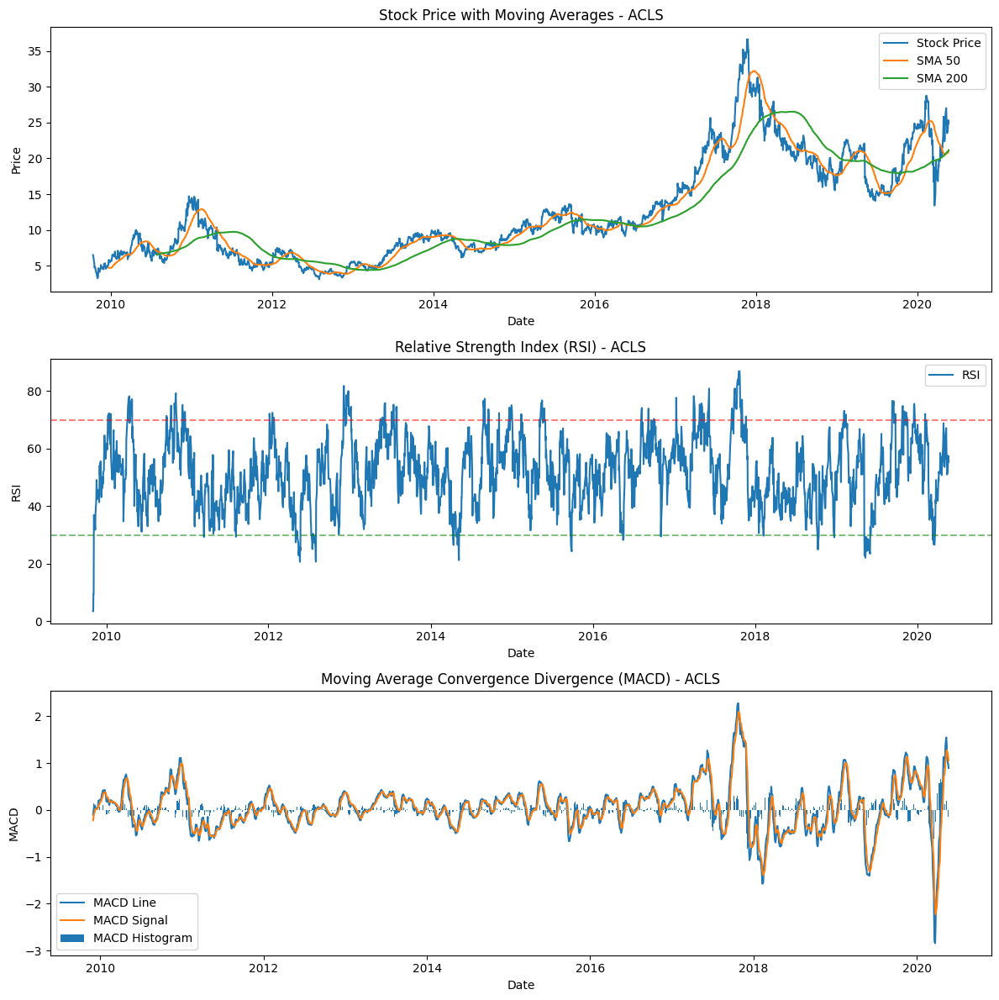

[*********************100%%**********************]  1 of 1 completed


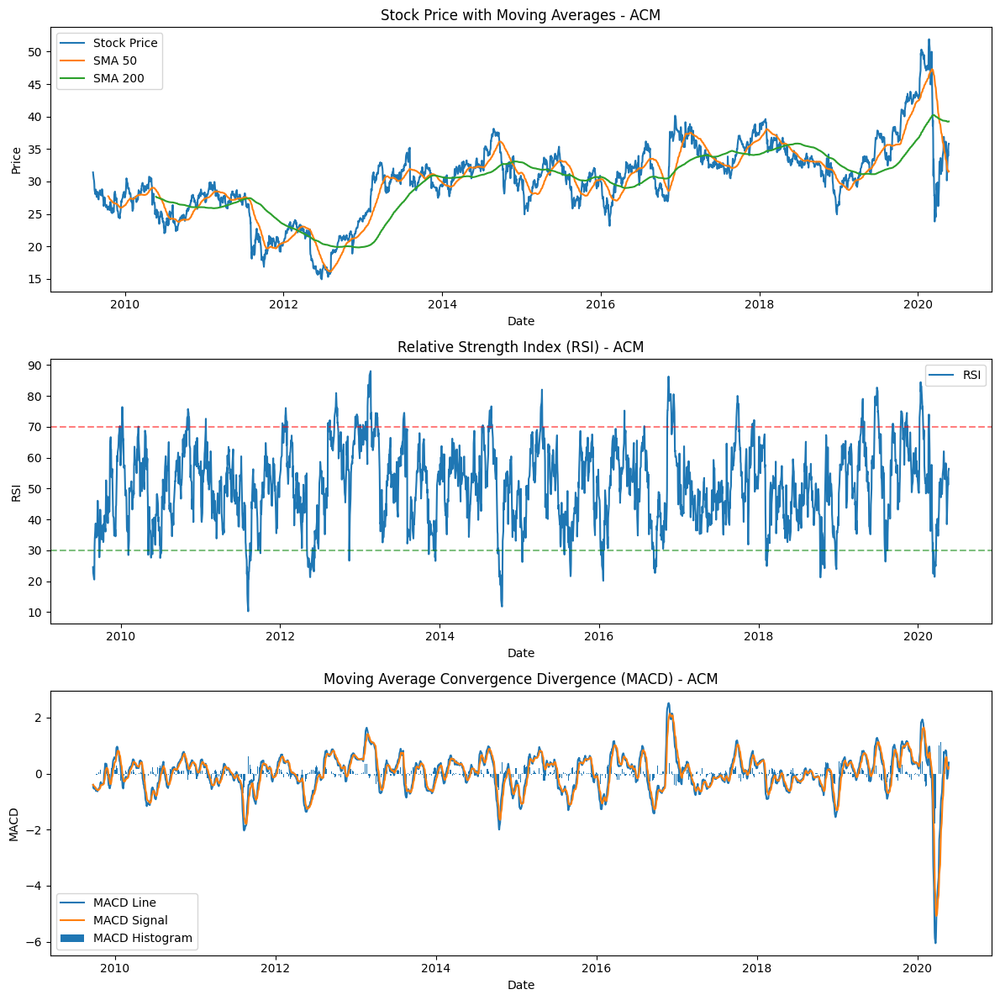

[*********************100%%**********************]  1 of 1 completed


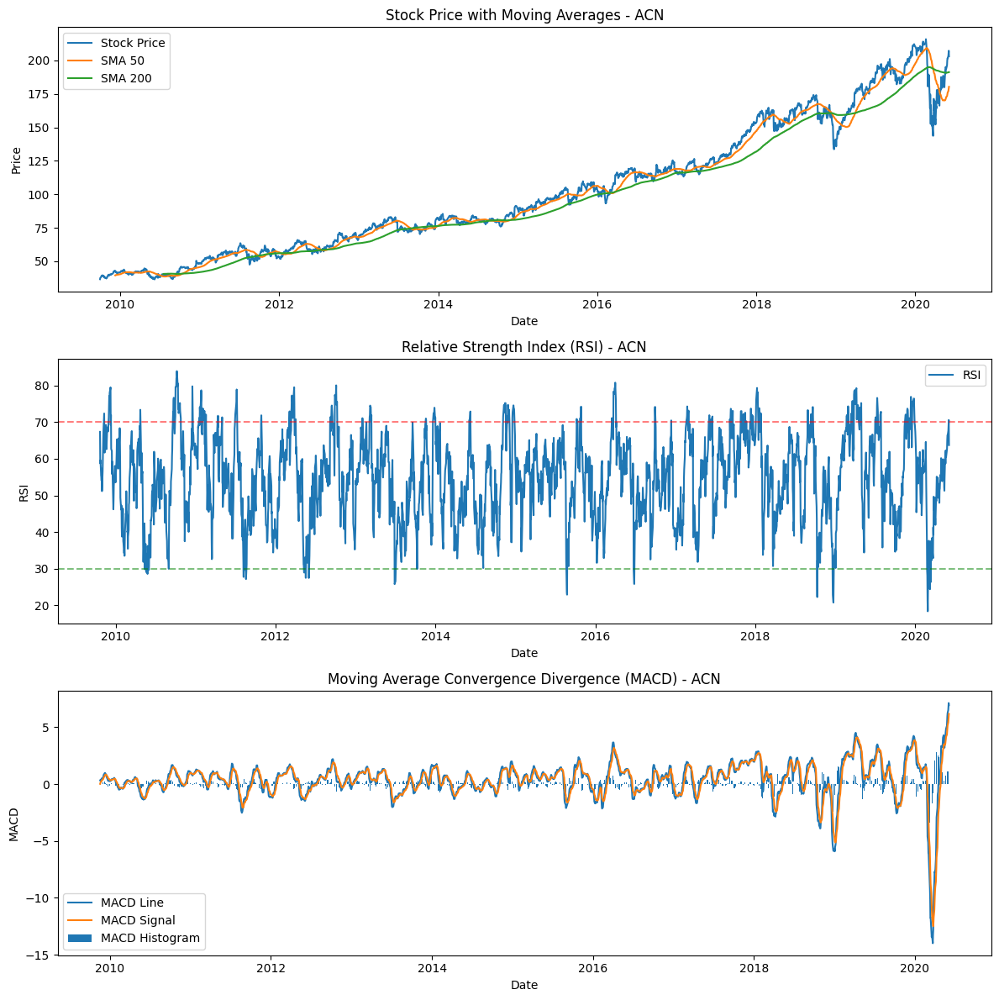

[*********************100%%**********************]  1 of 1 completed


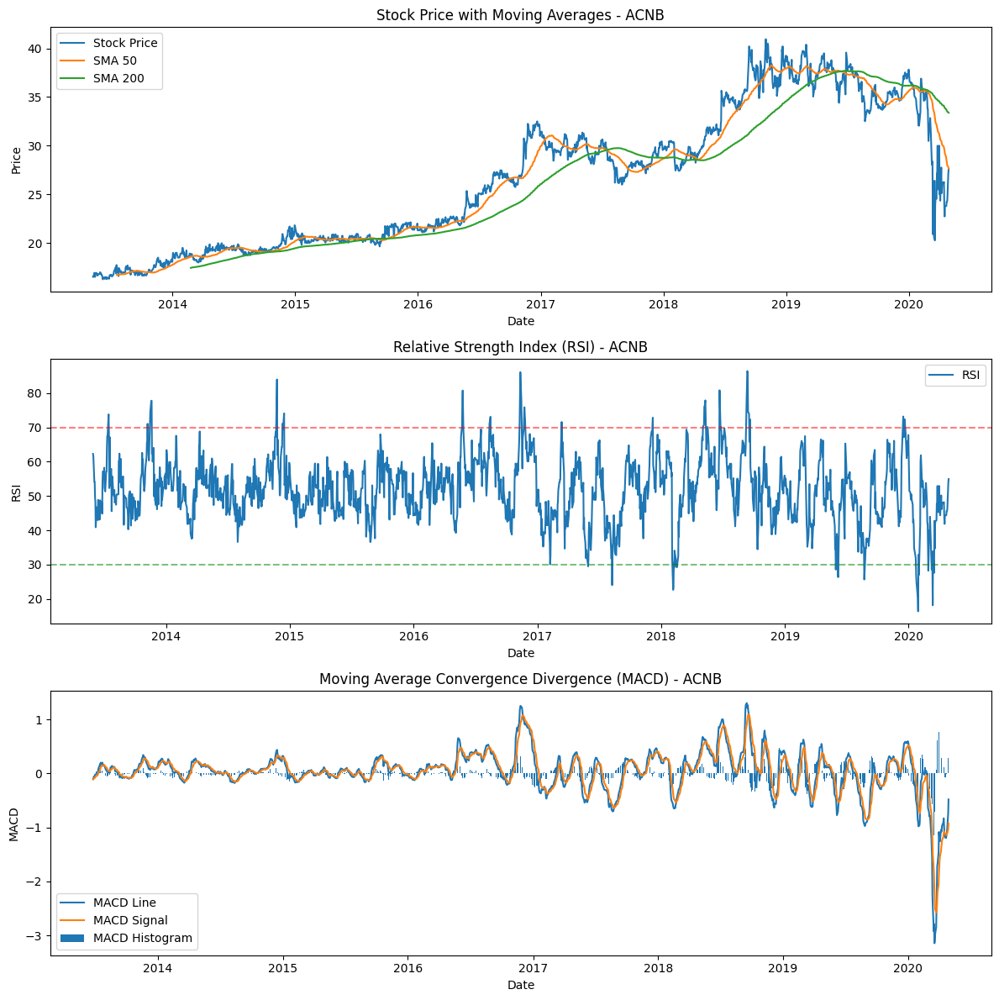

[*********************100%%**********************]  1 of 1 completed


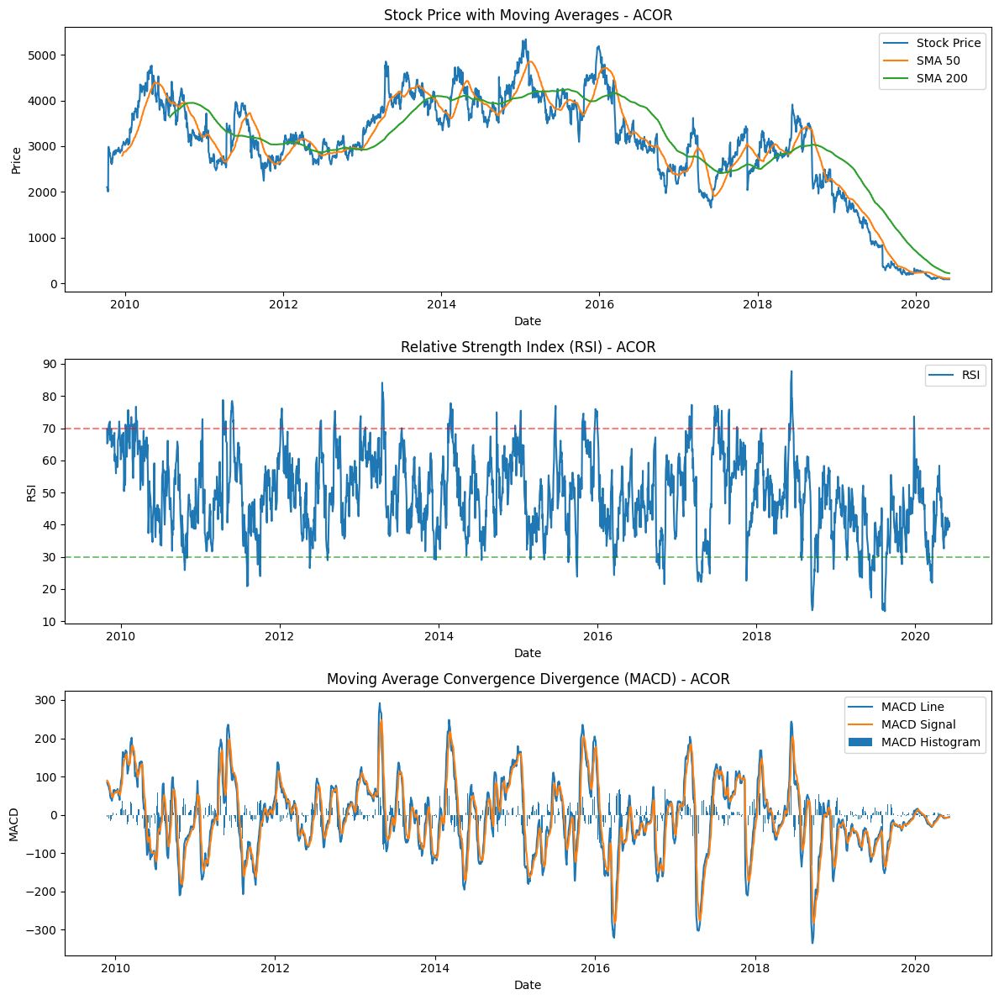

[*********************100%%**********************]  1 of 1 completed


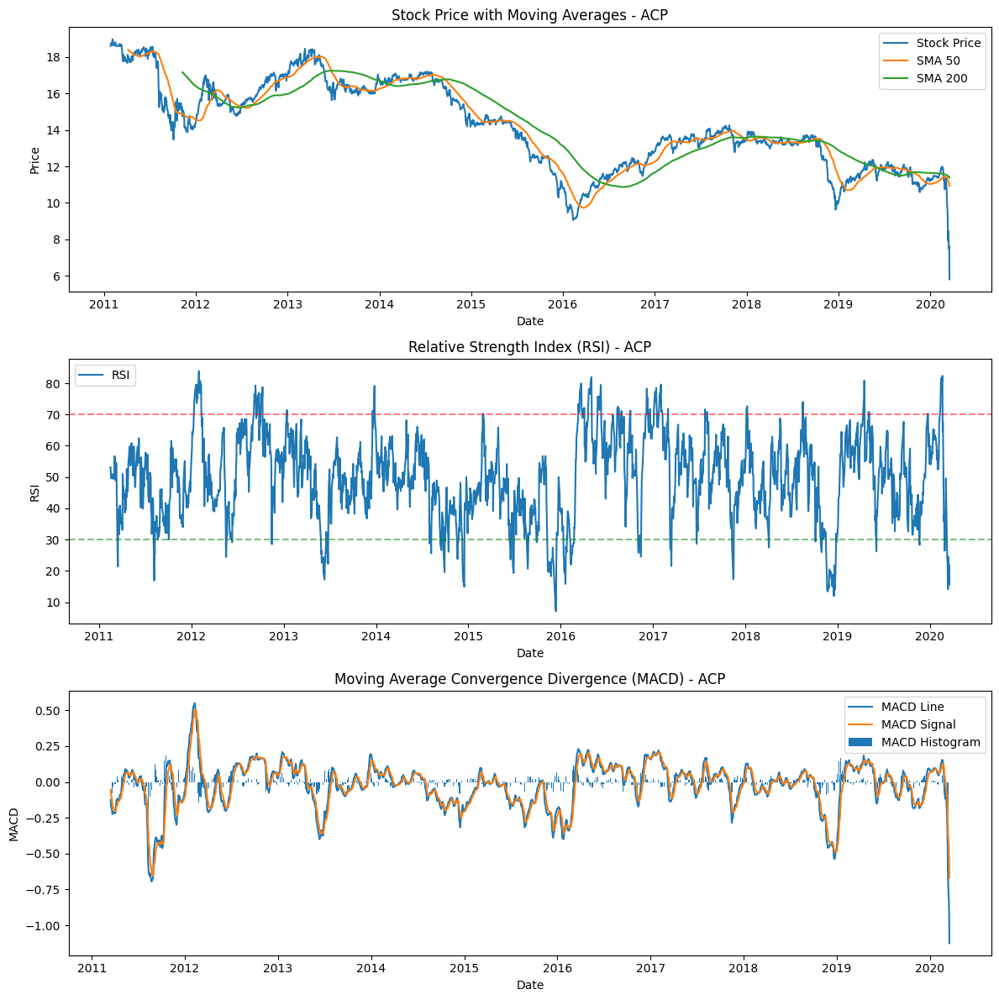

[*********************100%%**********************]  1 of 1 completed


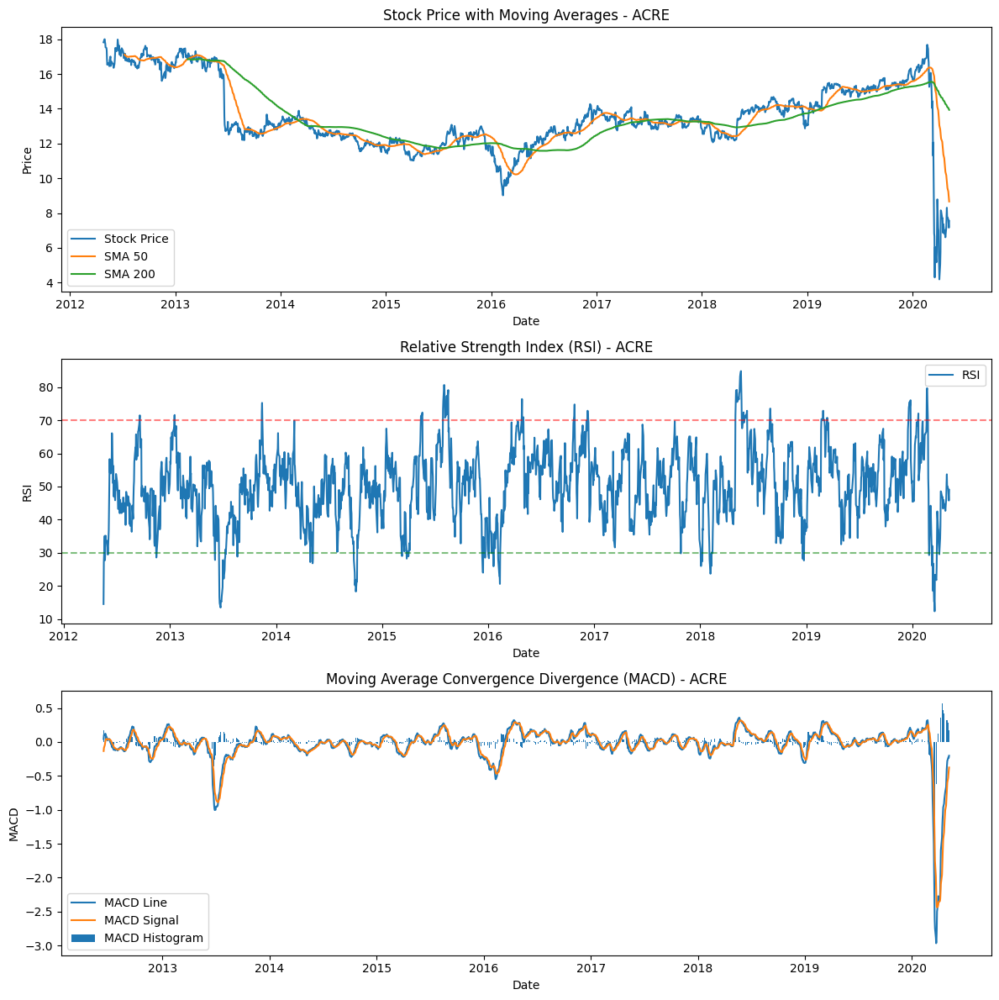

[*********************100%%**********************]  1 of 1 completed


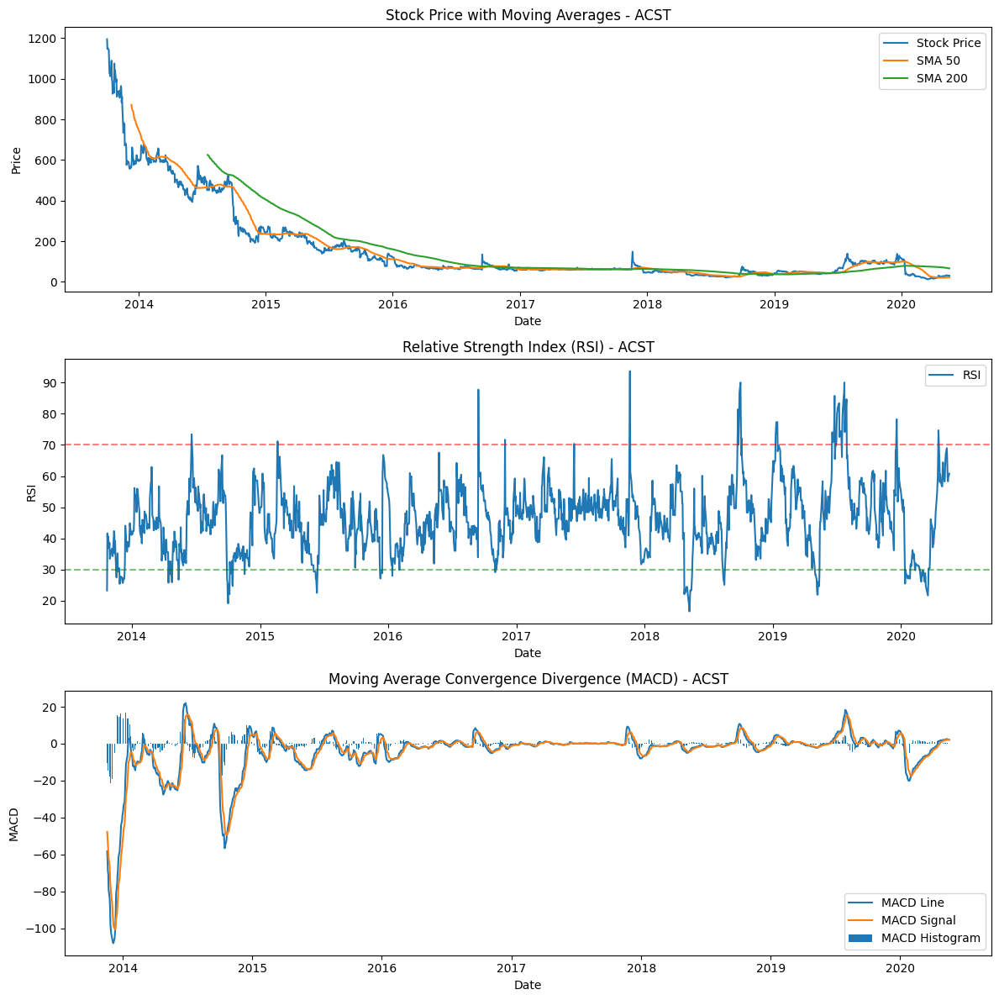

[*********************100%%**********************]  1 of 1 completed


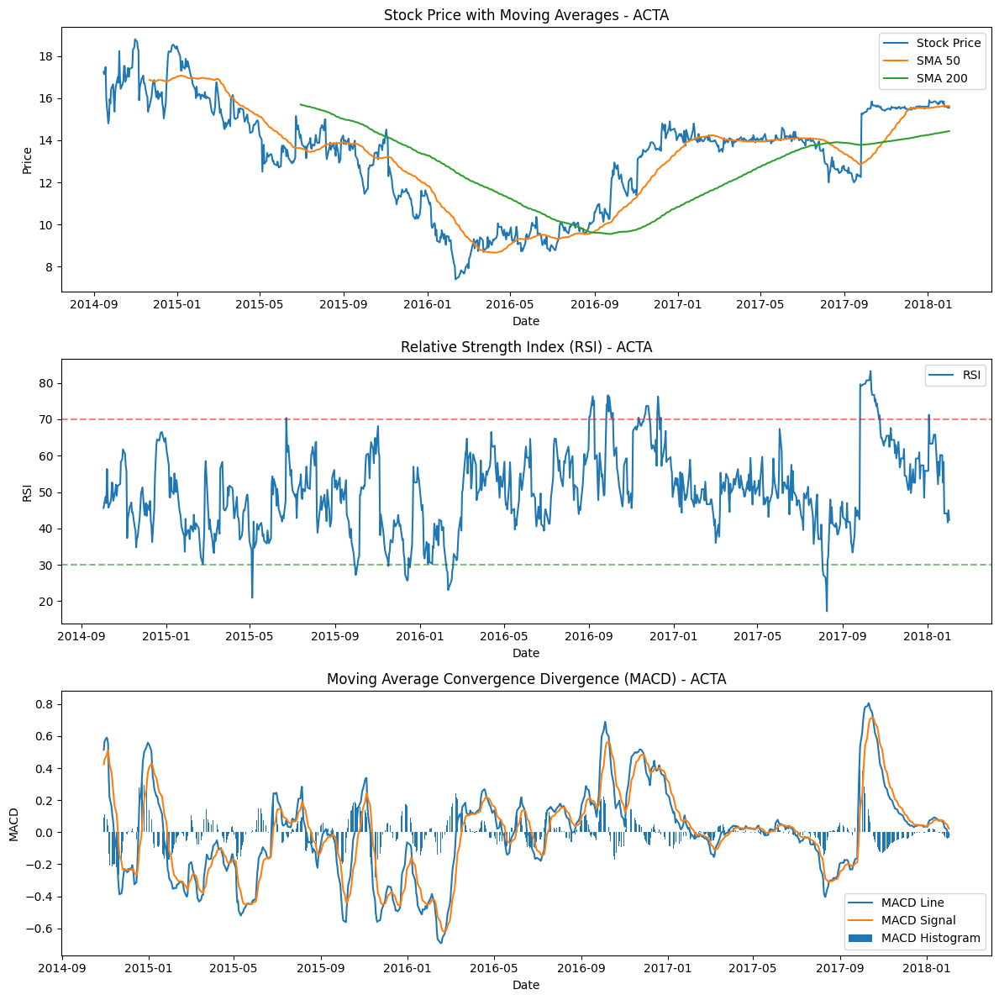

[*********************100%%**********************]  1 of 1 completed


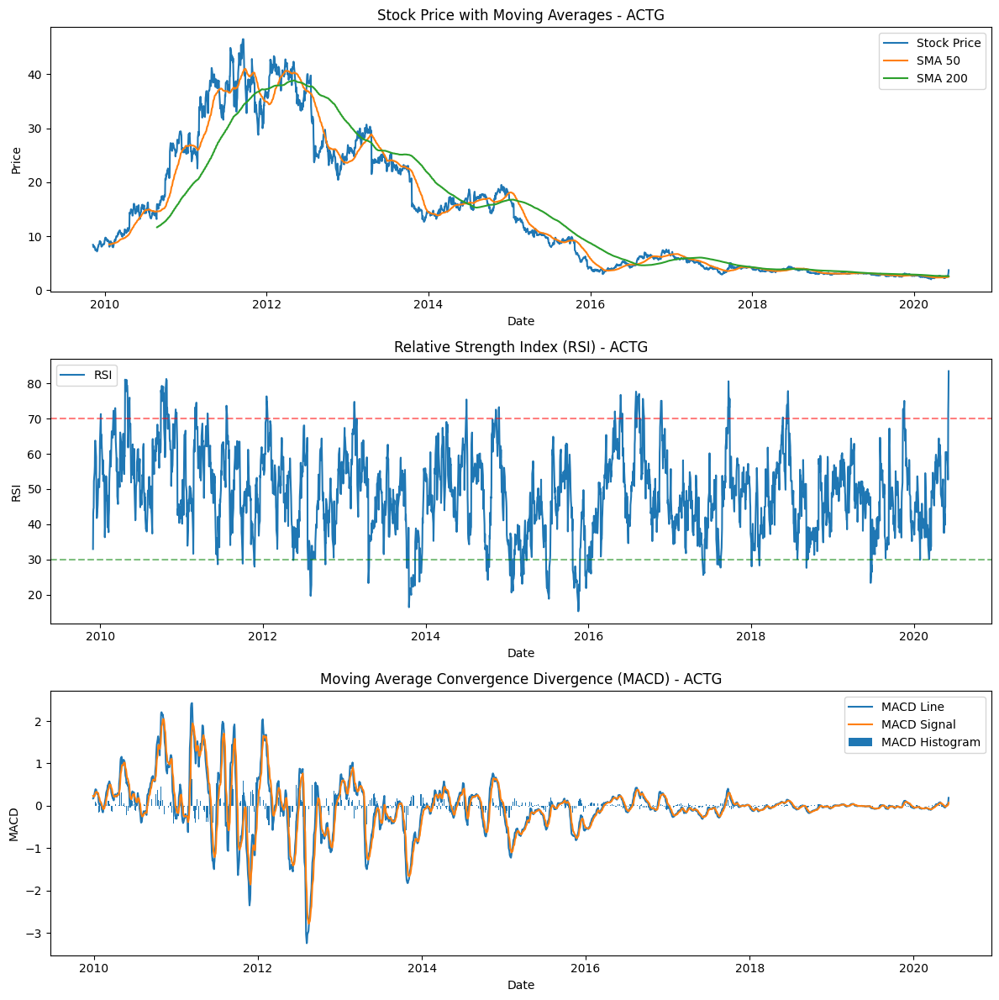

[*********************100%%**********************]  1 of 1 completed


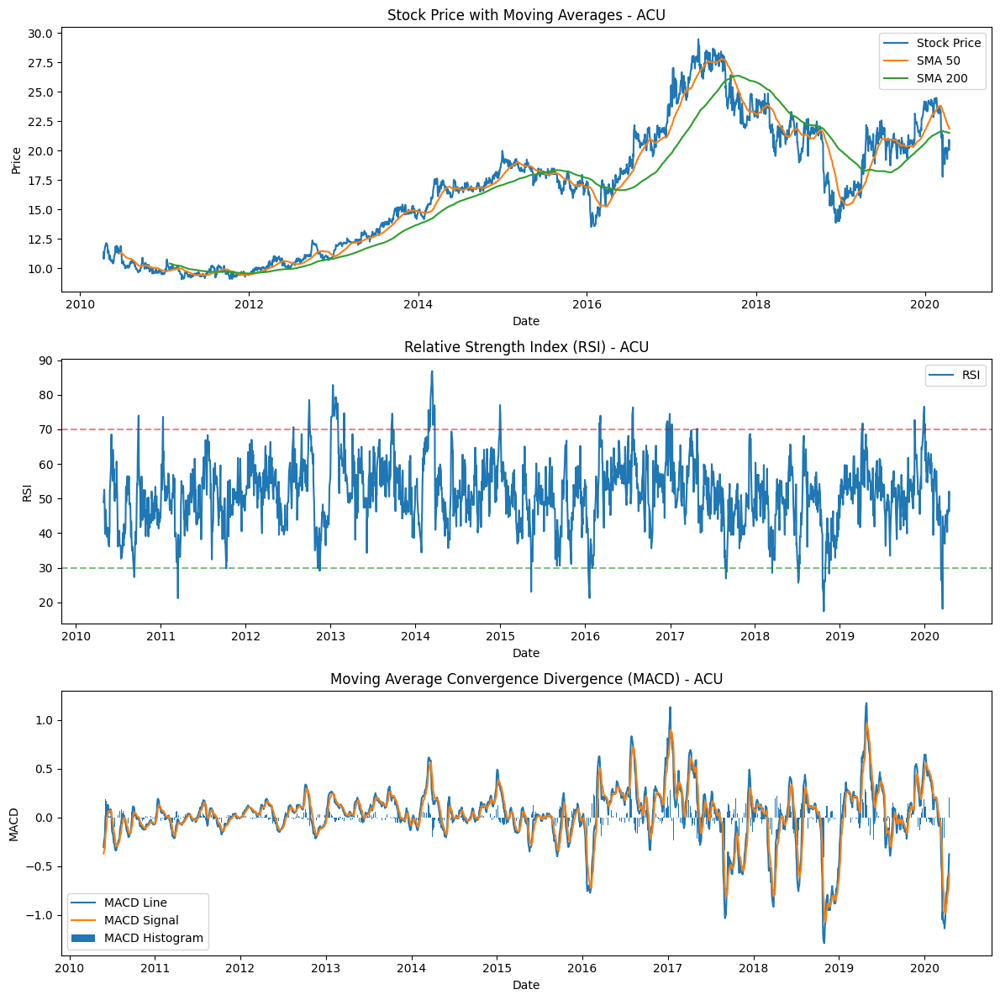

[*********************100%%**********************]  1 of 1 completed


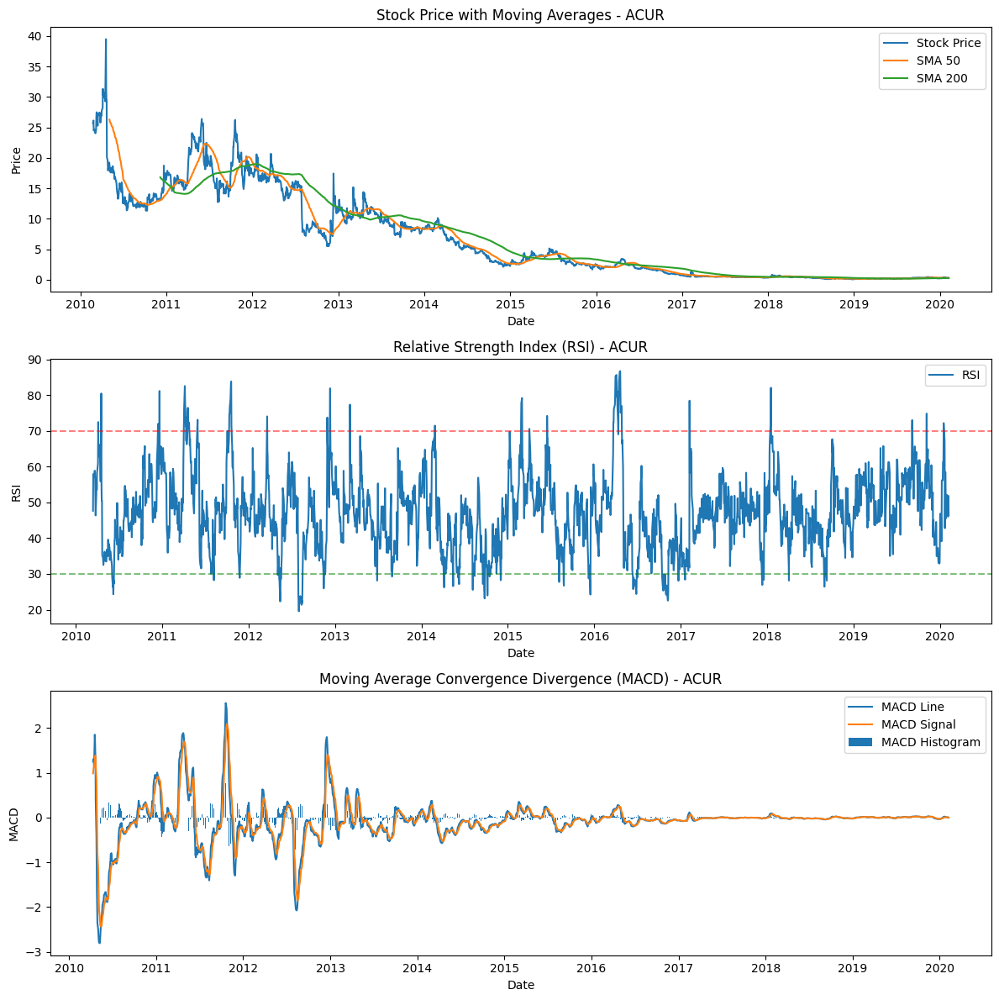

[*********************100%%**********************]  1 of 1 completed


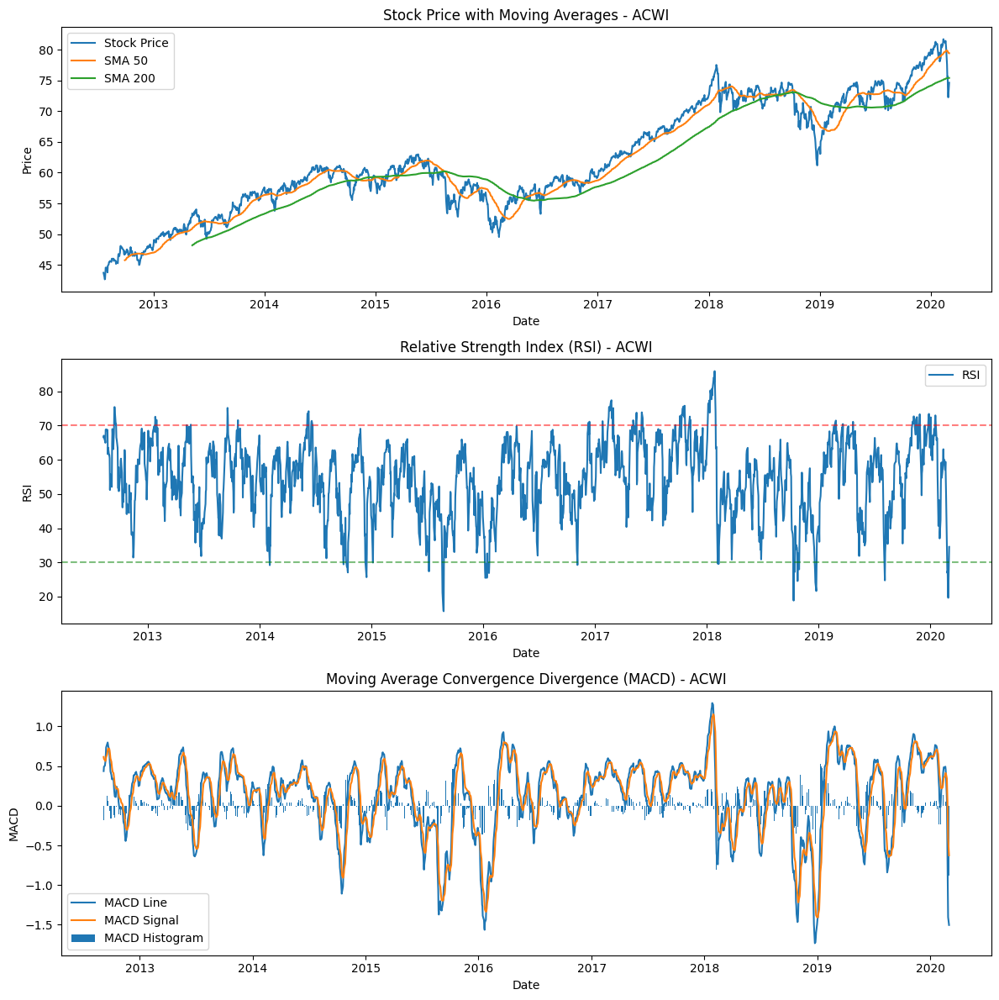

[*********************100%%**********************]  1 of 1 completed


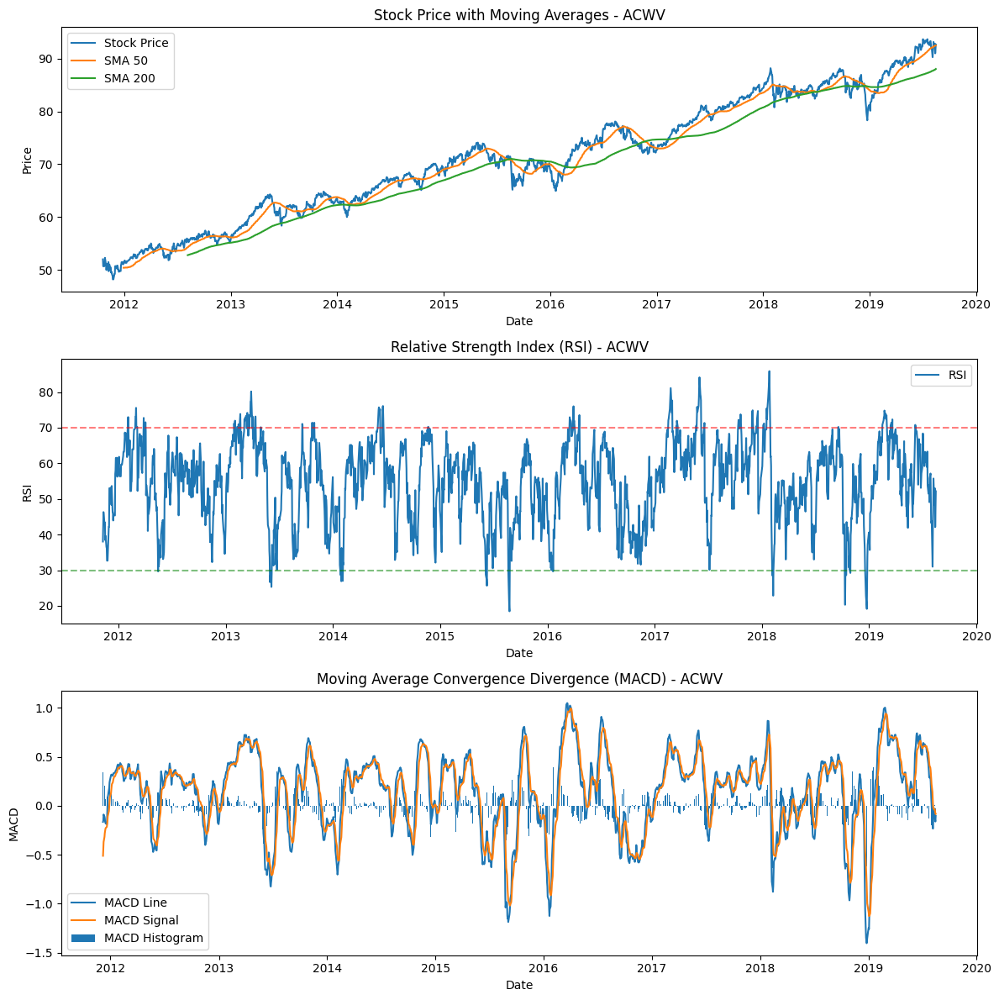

[*********************100%%**********************]  1 of 1 completed


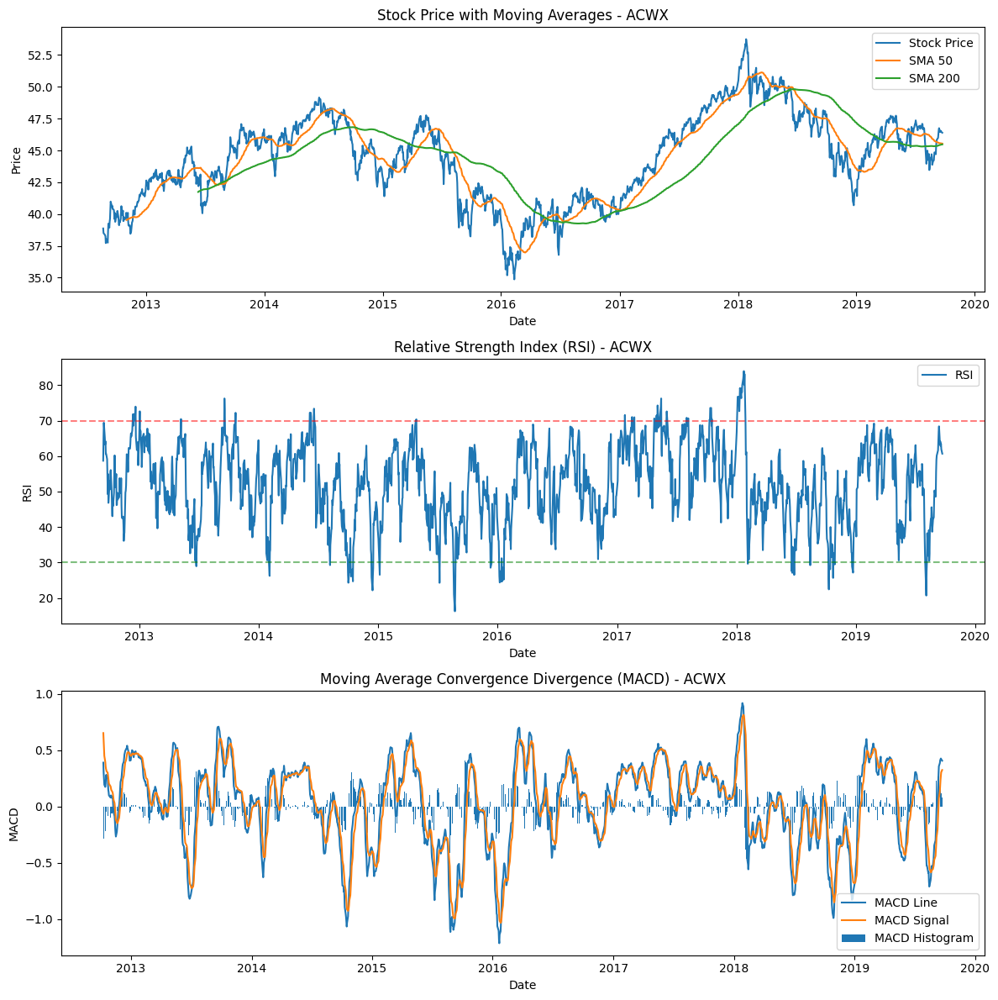

[*********************100%%**********************]  1 of 1 completed


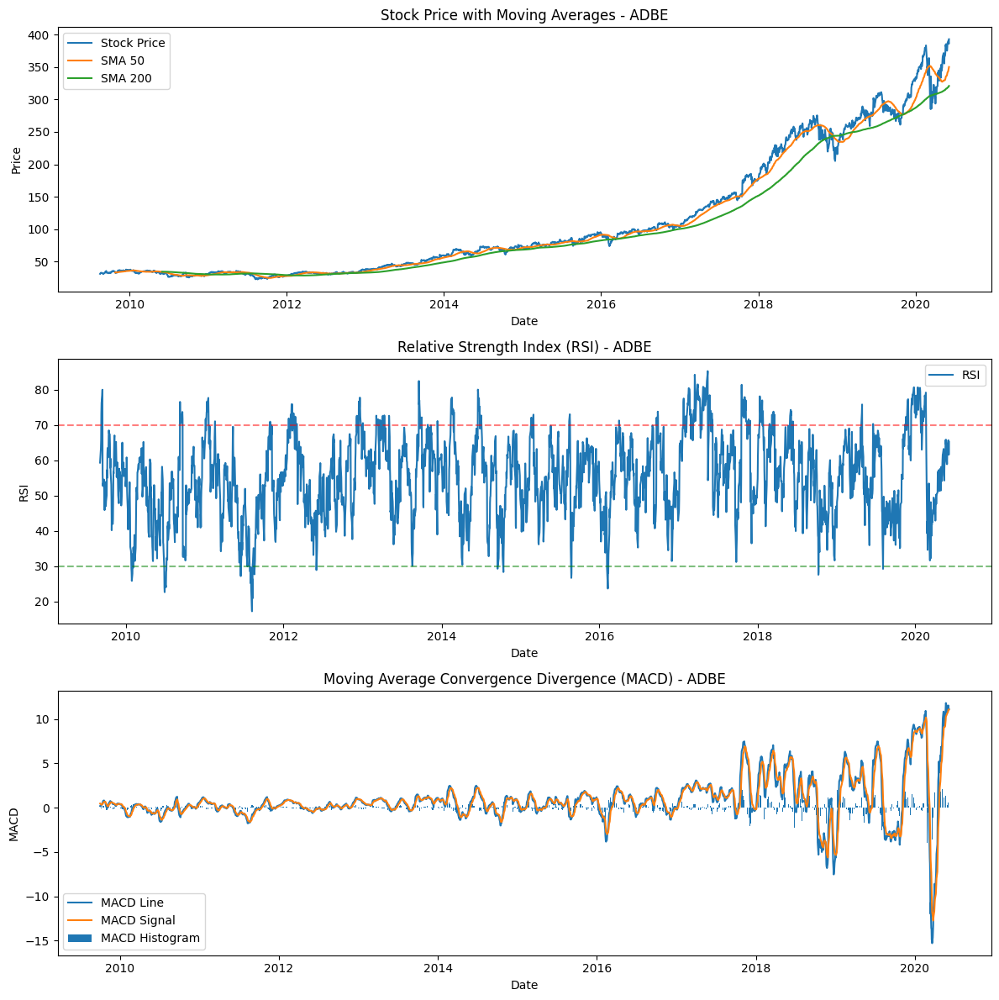

[*********************100%%**********************]  1 of 1 completed


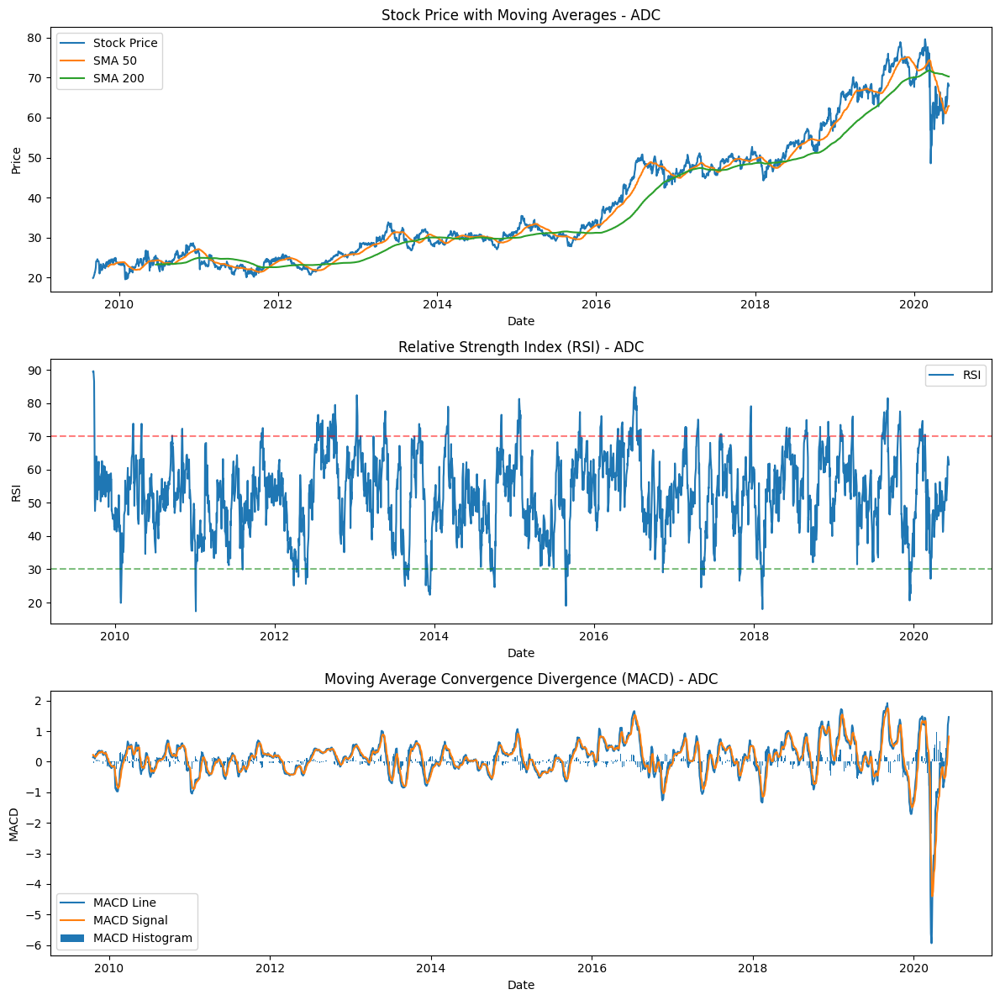

[*********************100%%**********************]  1 of 1 completed


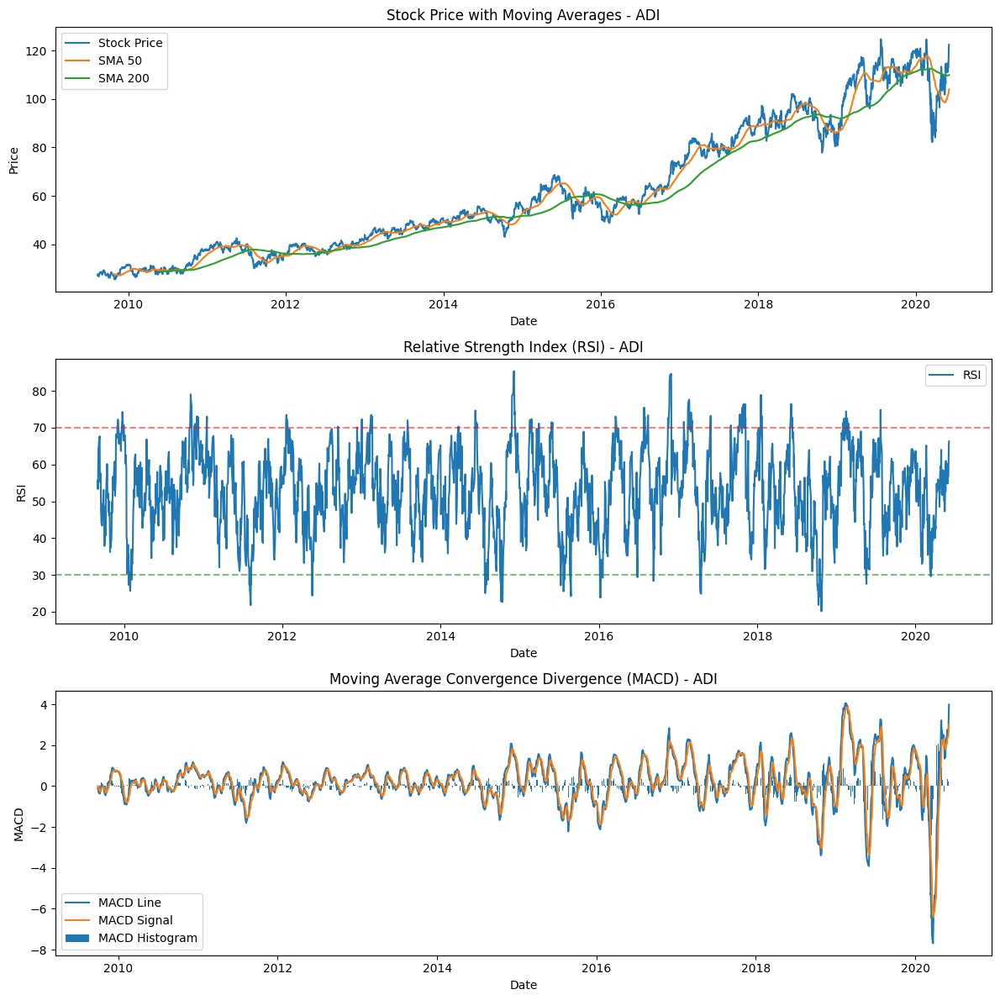

[*********************100%%**********************]  1 of 1 completed


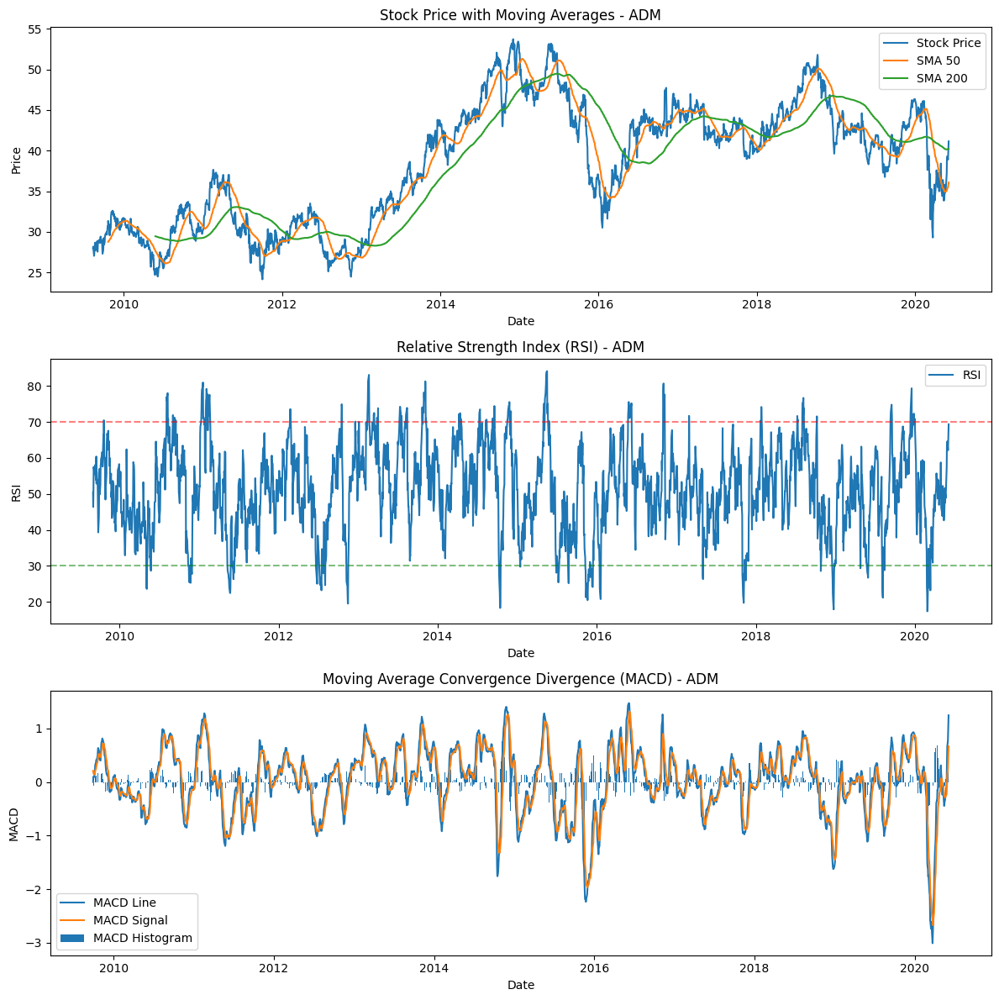

[*********************100%%**********************]  1 of 1 completed


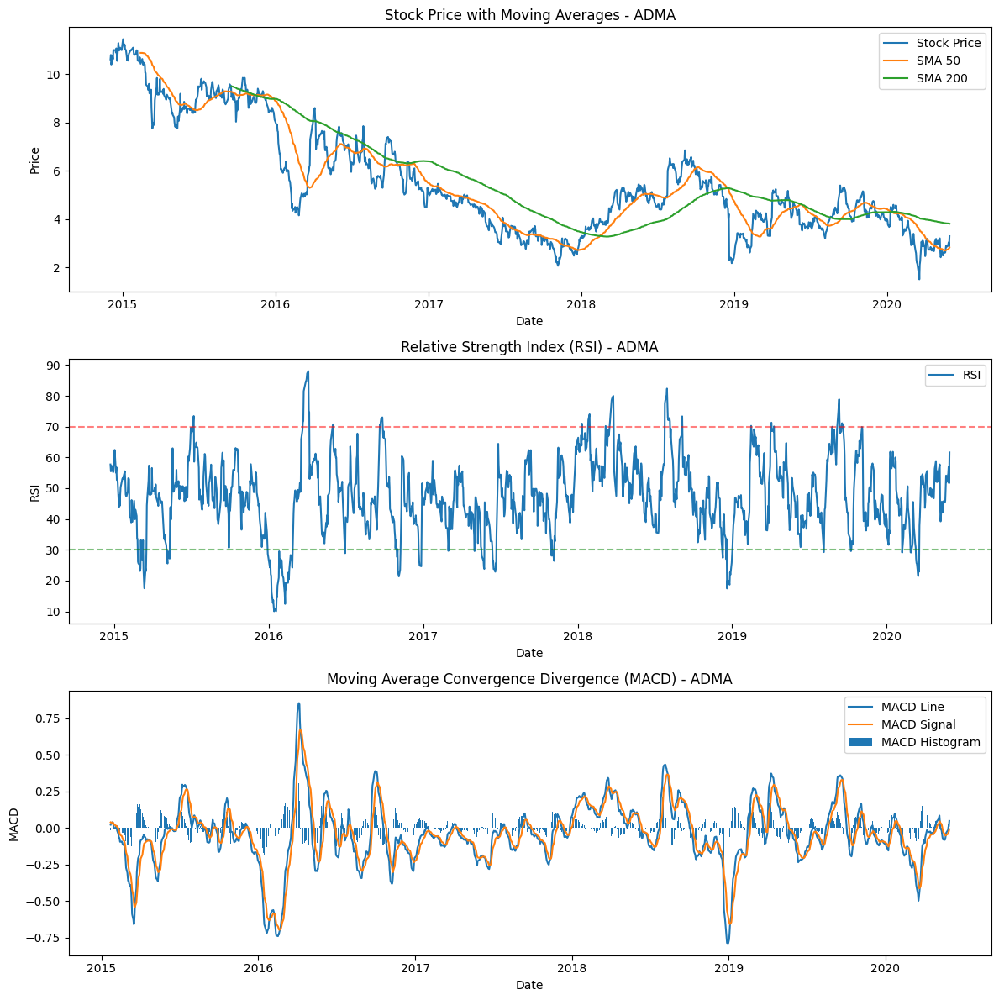

[*********************100%%**********************]  1 of 1 completed


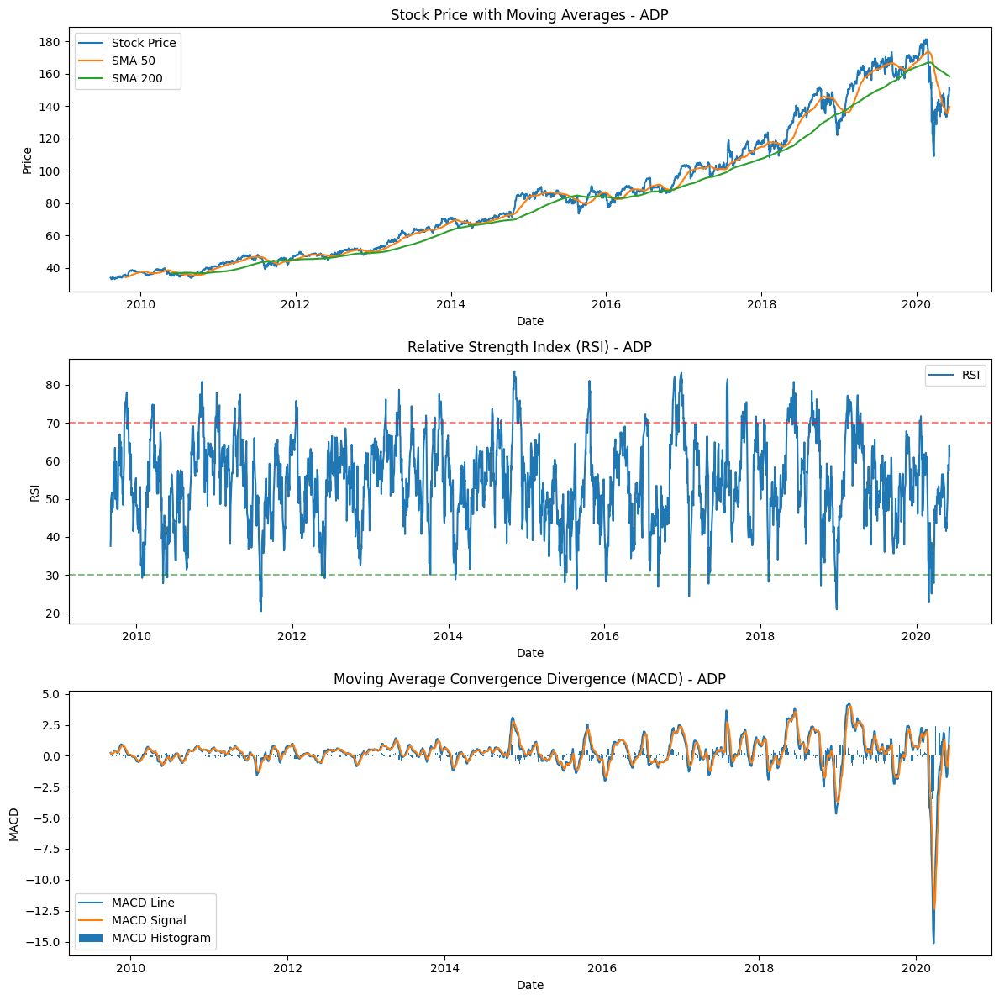

[*********************100%%**********************]  1 of 1 completed


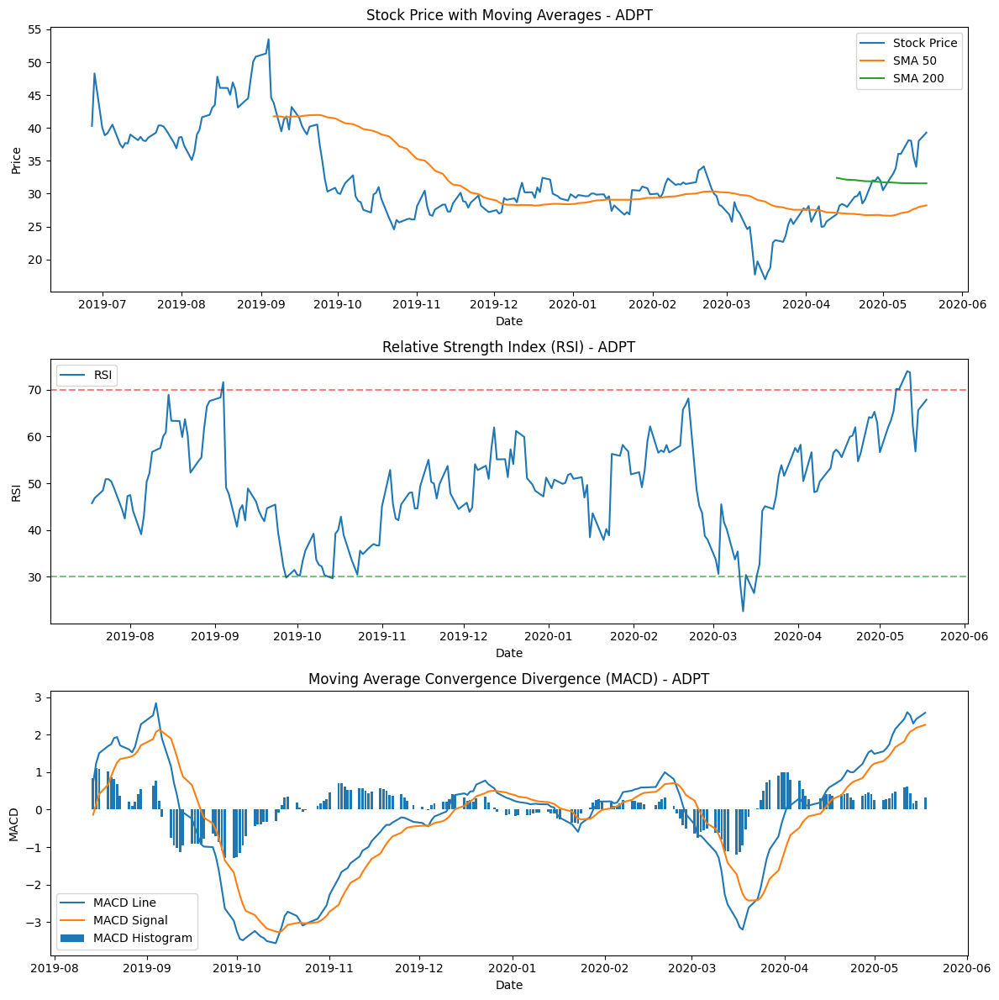

[*********************100%%**********************]  1 of 1 completed


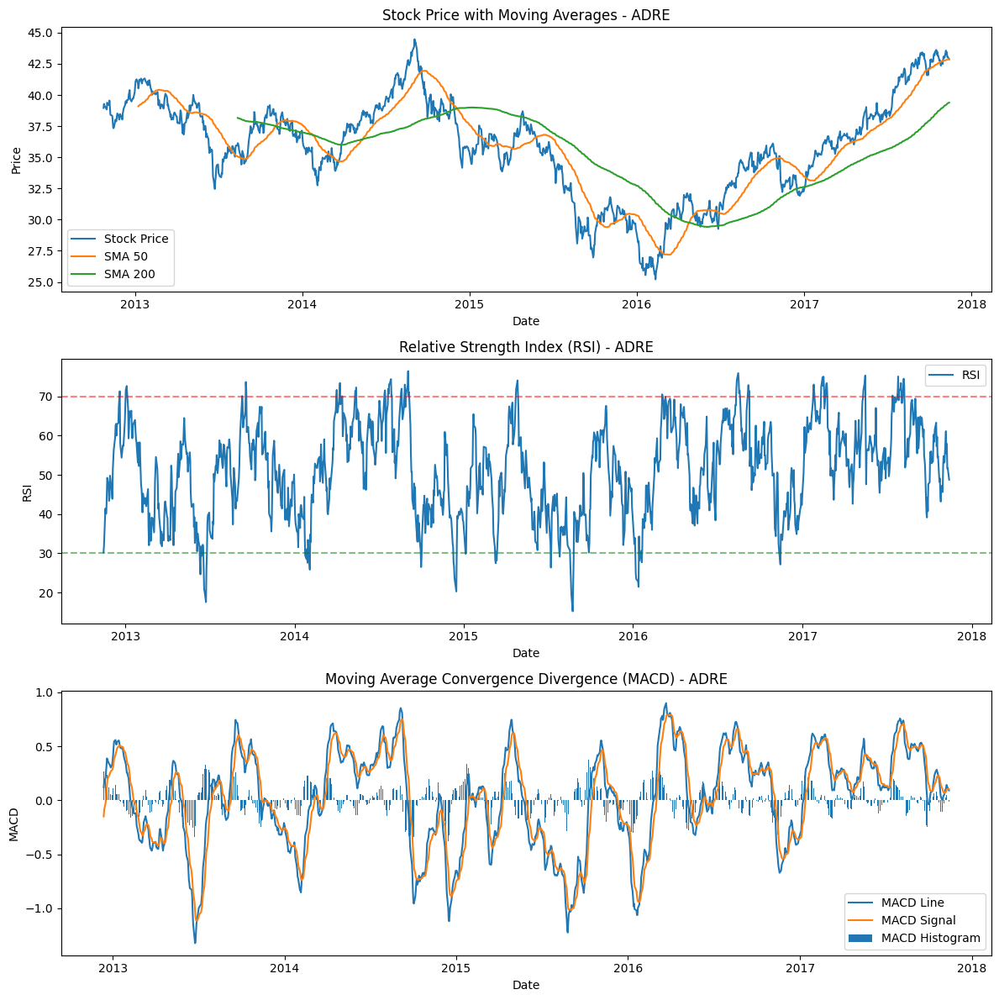

[*********************100%%**********************]  1 of 1 completed


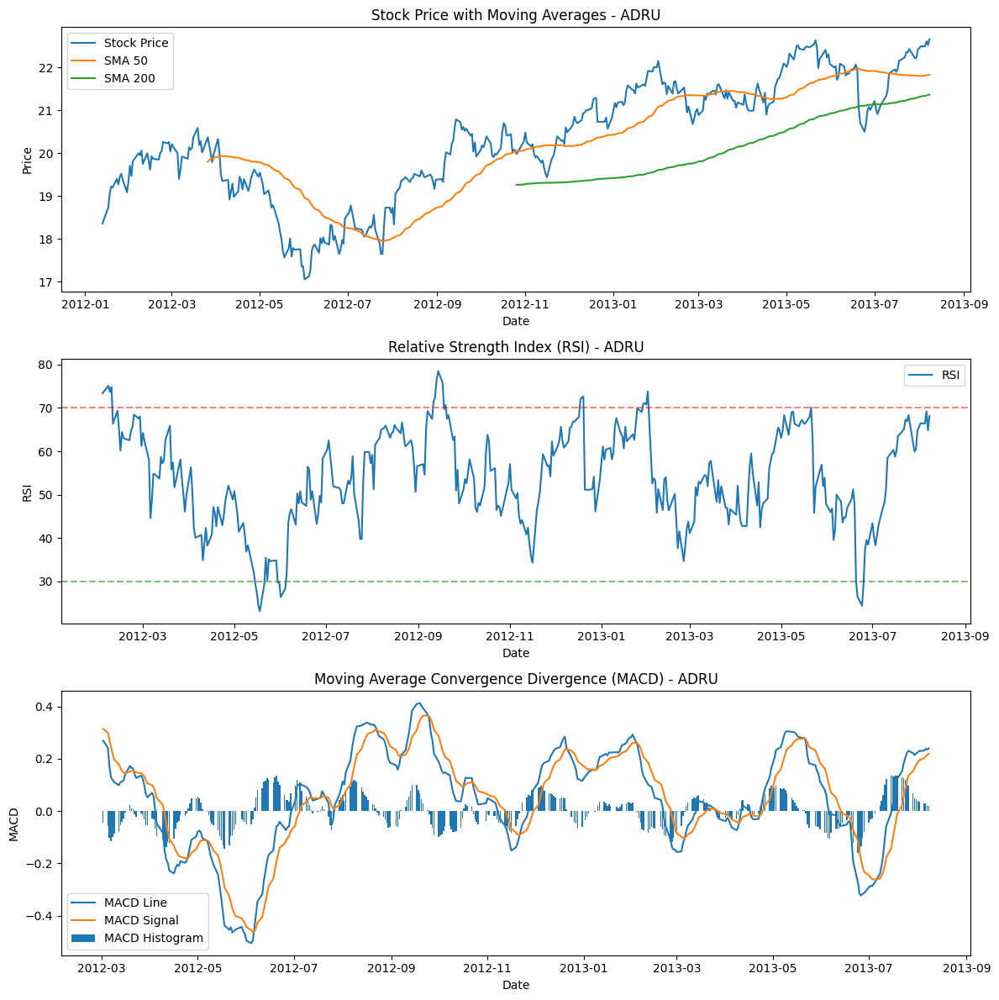

[*********************100%%**********************]  1 of 1 completed


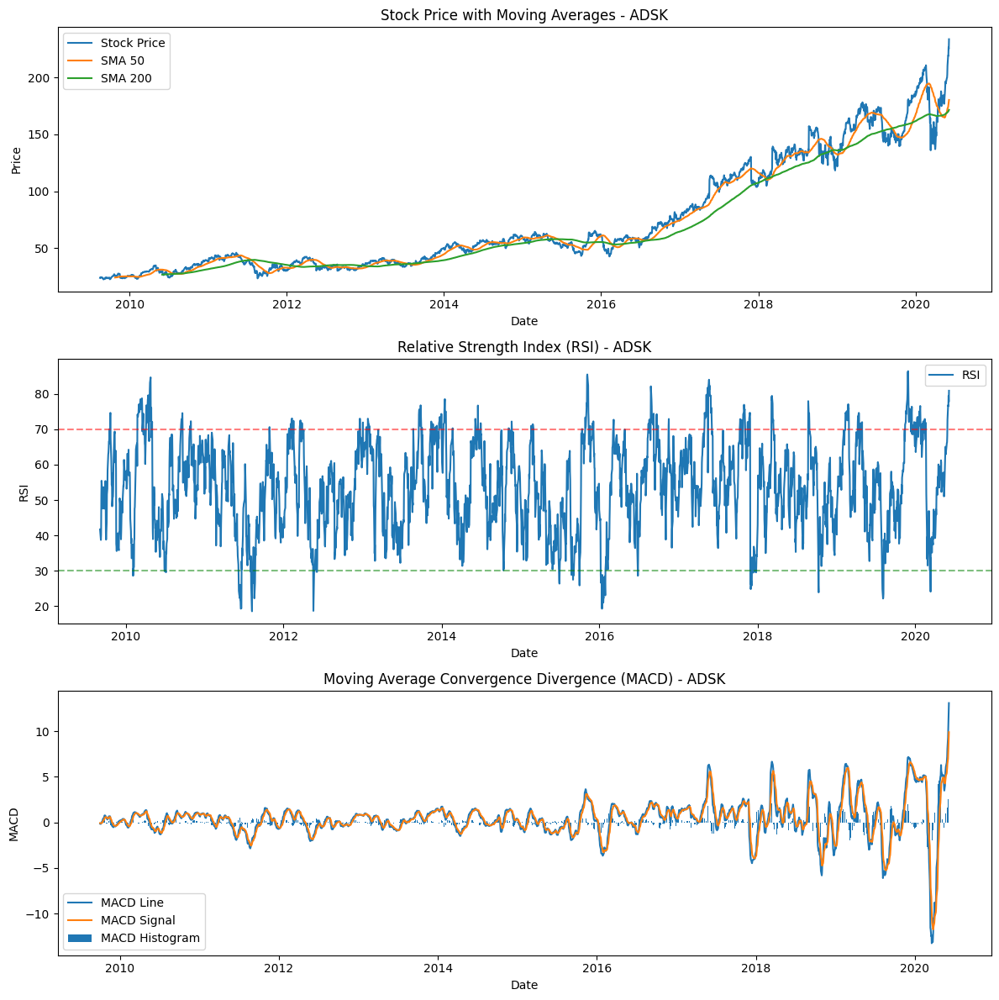

[*********************100%%**********************]  1 of 1 completed


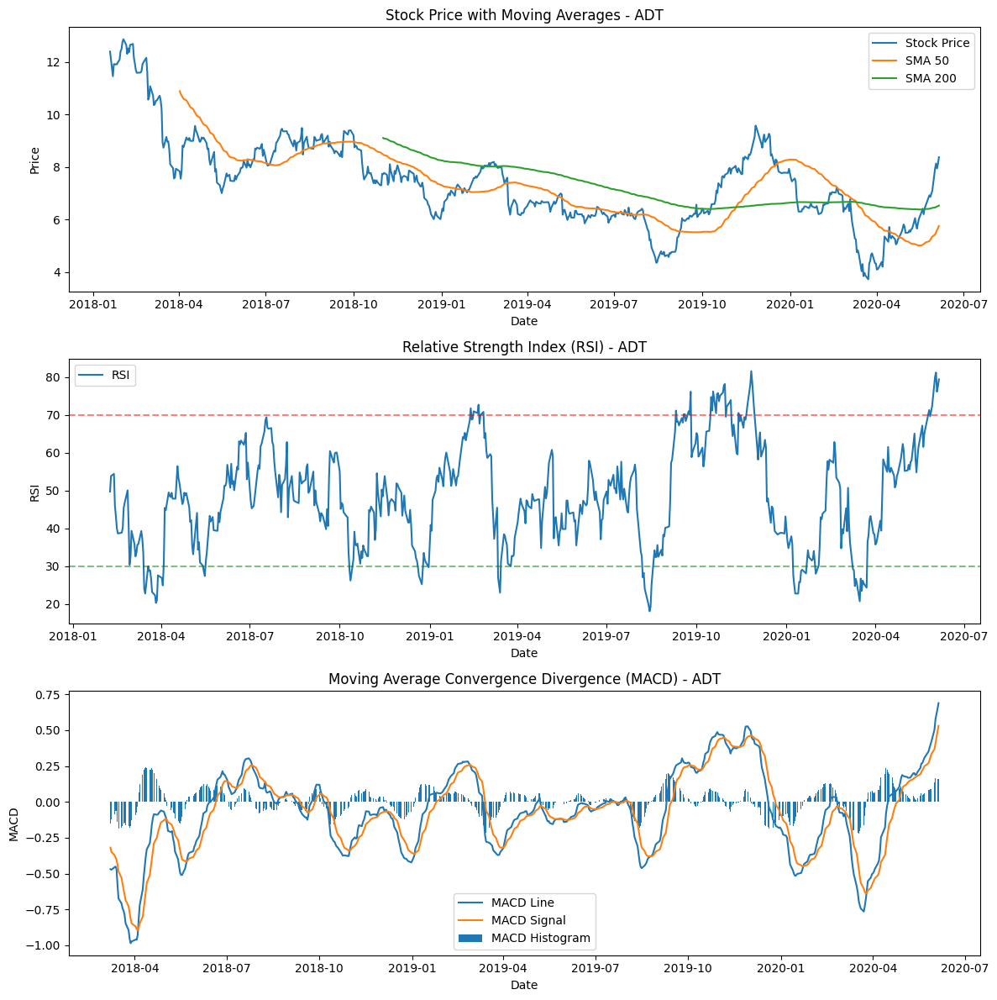

[*********************100%%**********************]  1 of 1 completed


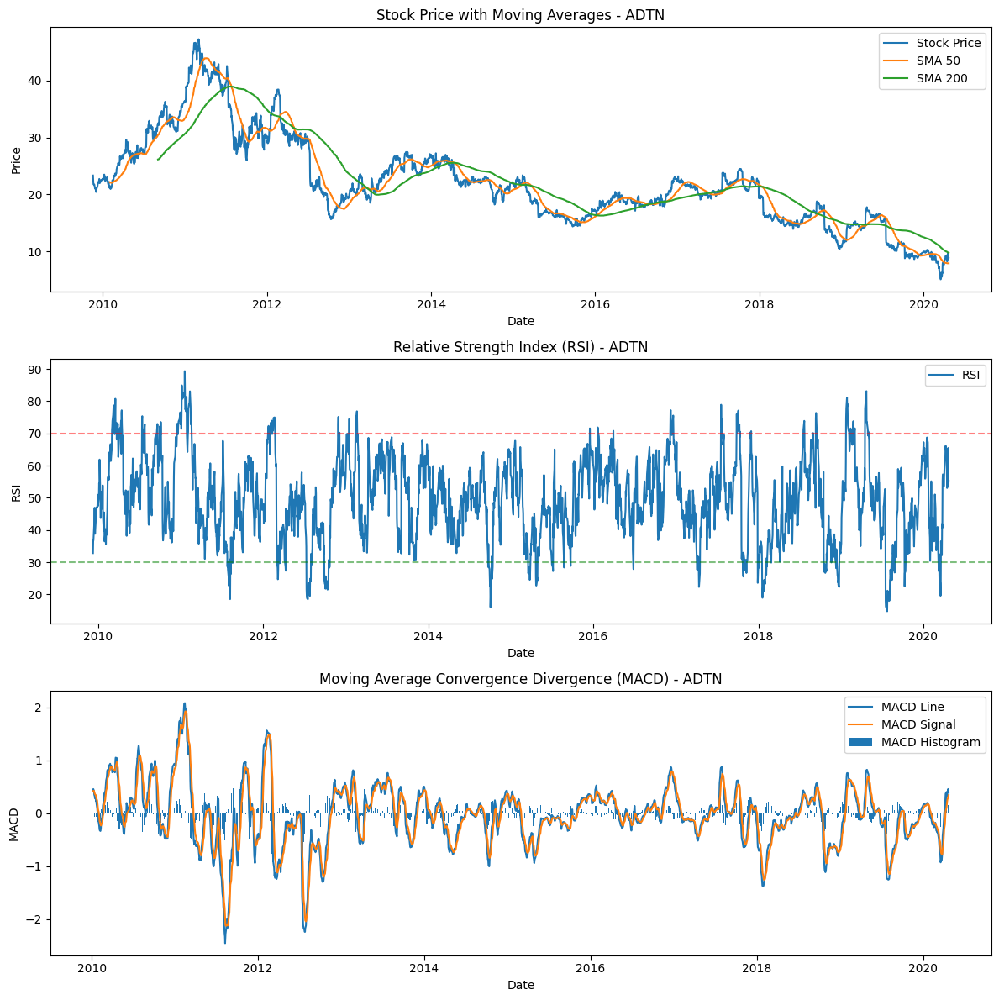

[*********************100%%**********************]  1 of 1 completed


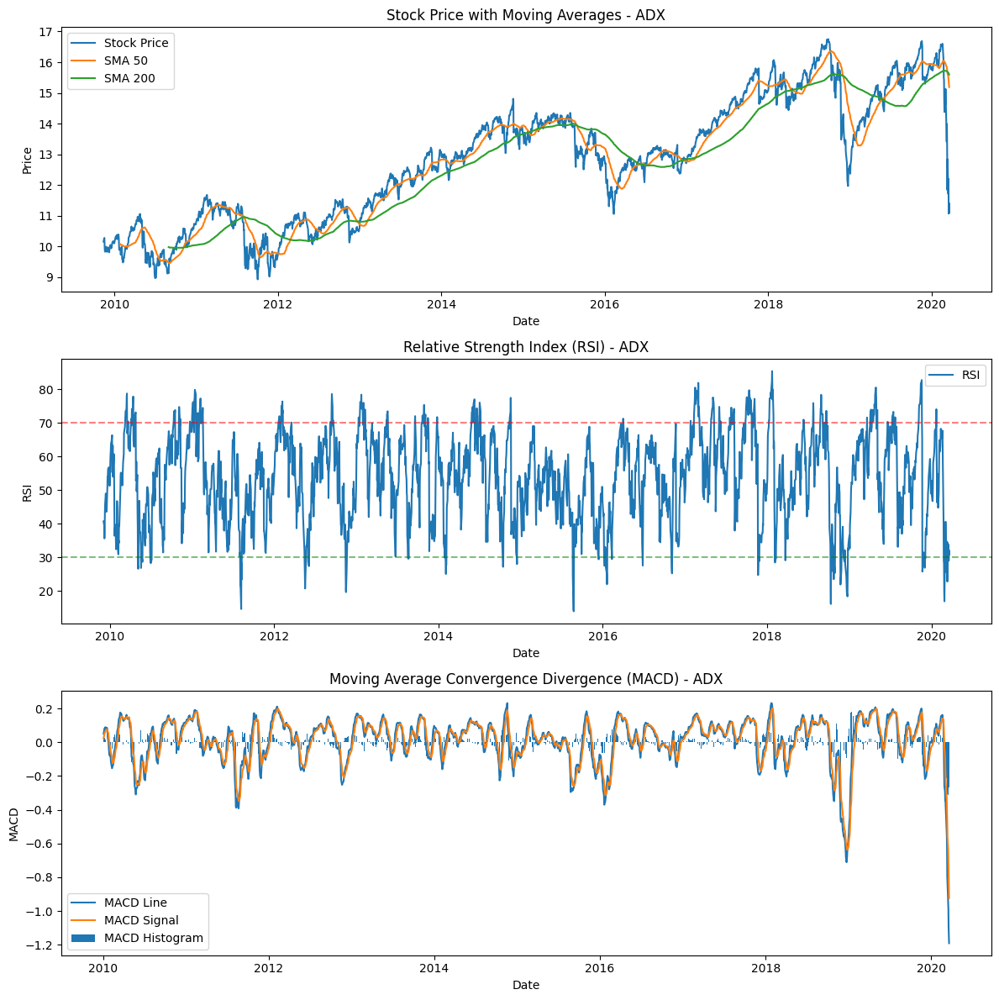

[*********************100%%**********************]  1 of 1 completed


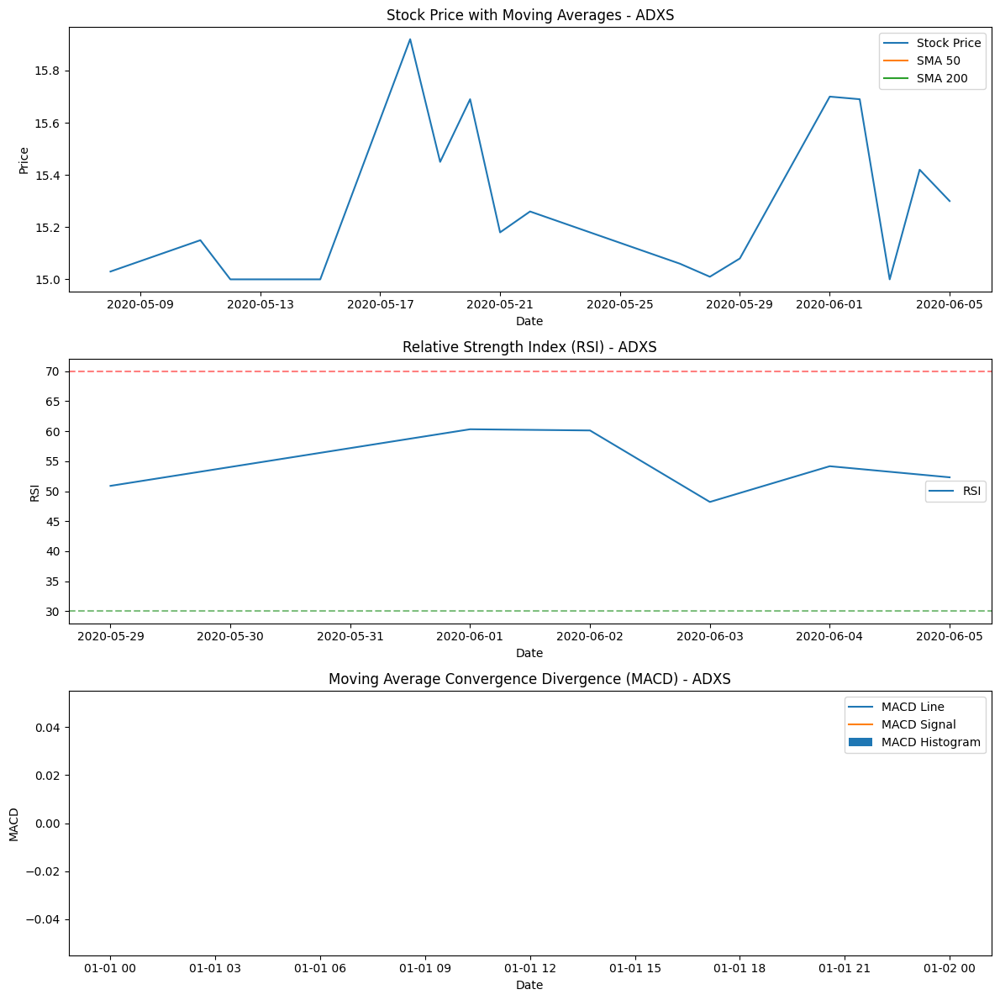

[*********************100%%**********************]  1 of 1 completed


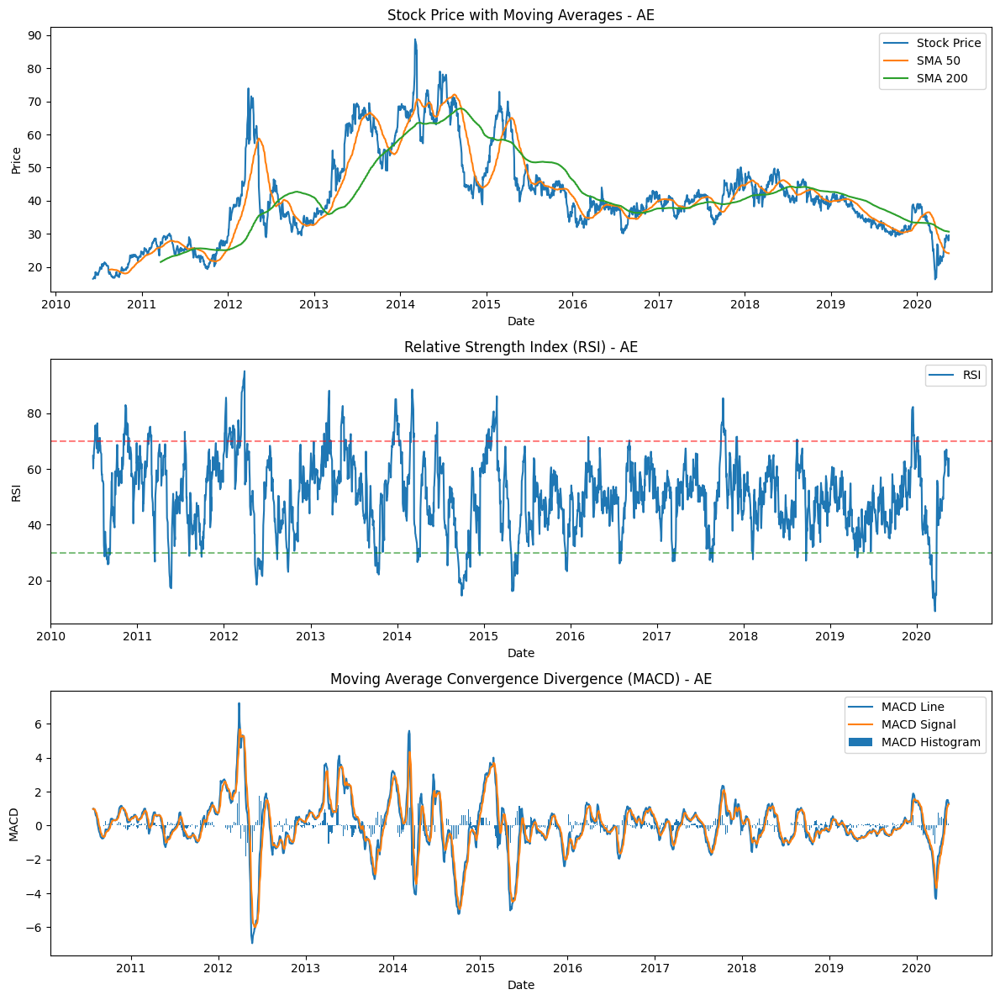

[*********************100%%**********************]  1 of 1 completed


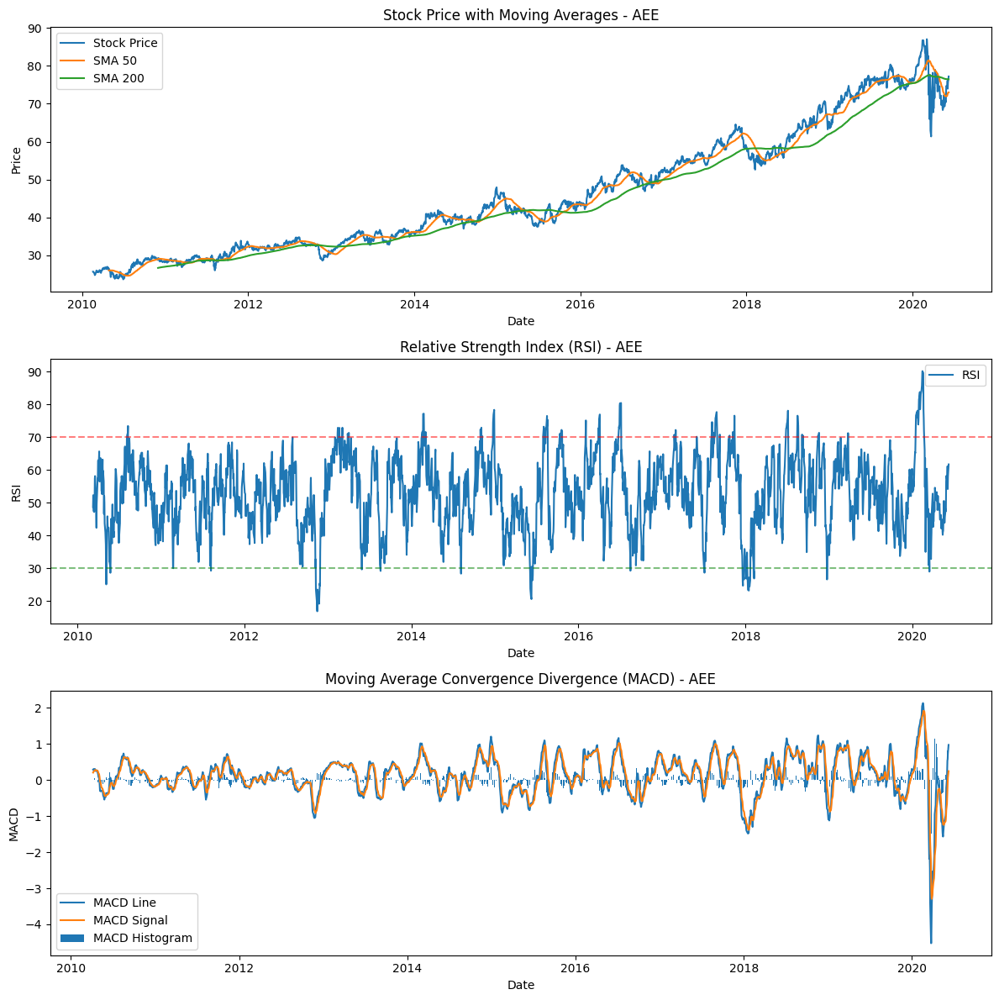

[*********************100%%**********************]  1 of 1 completed


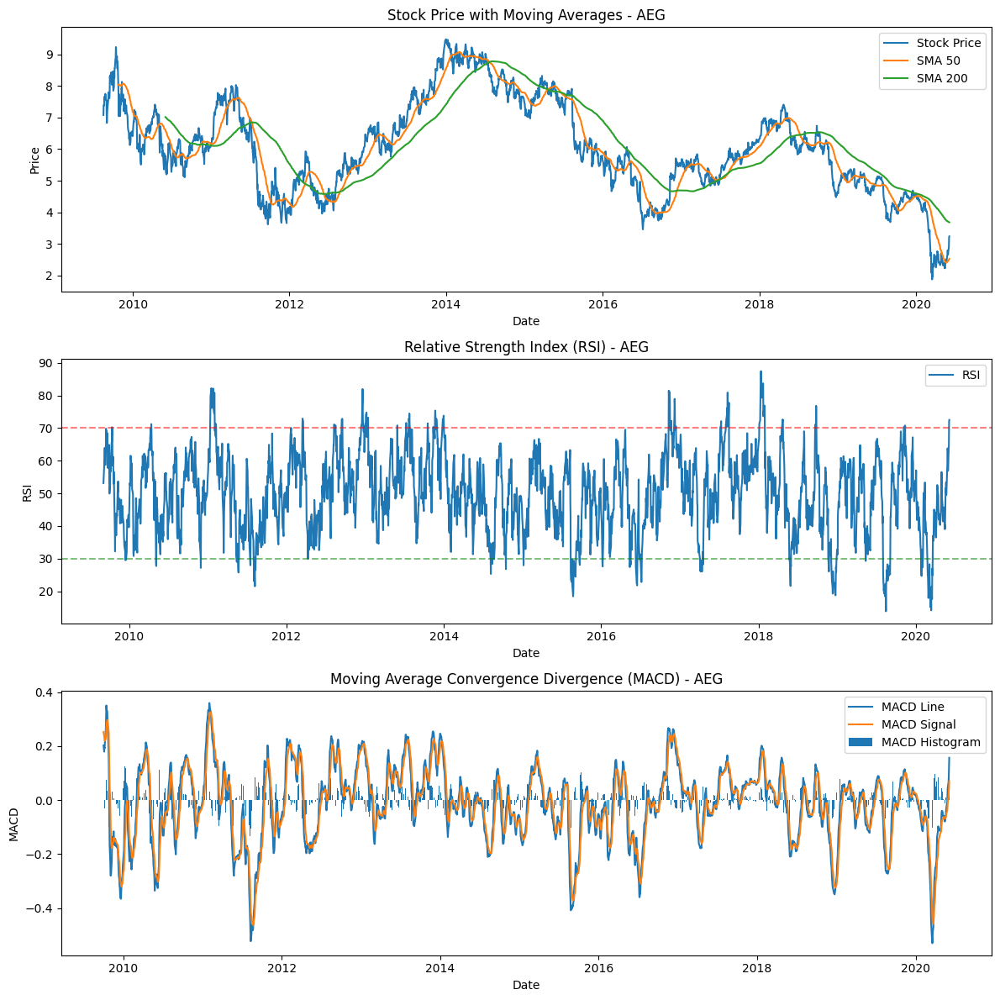

[*********************100%%**********************]  1 of 1 completed


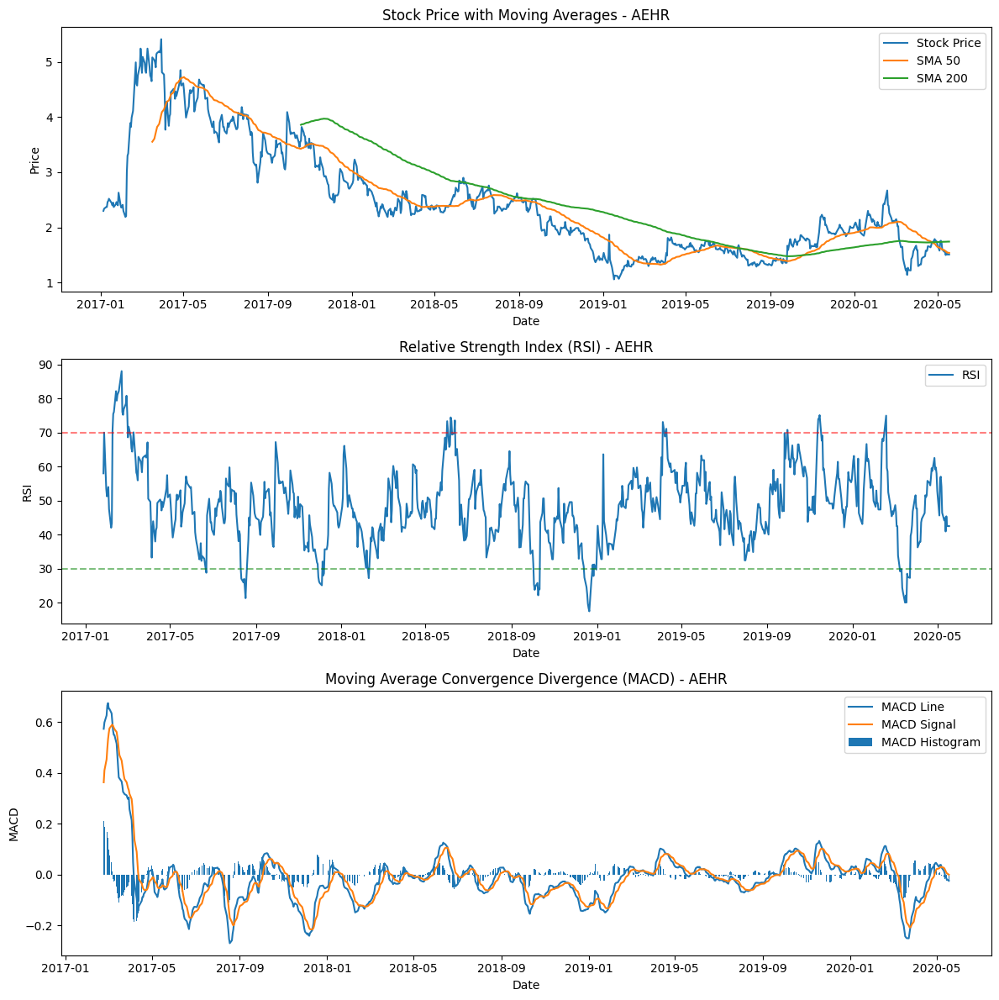

[*********************100%%**********************]  1 of 1 completed


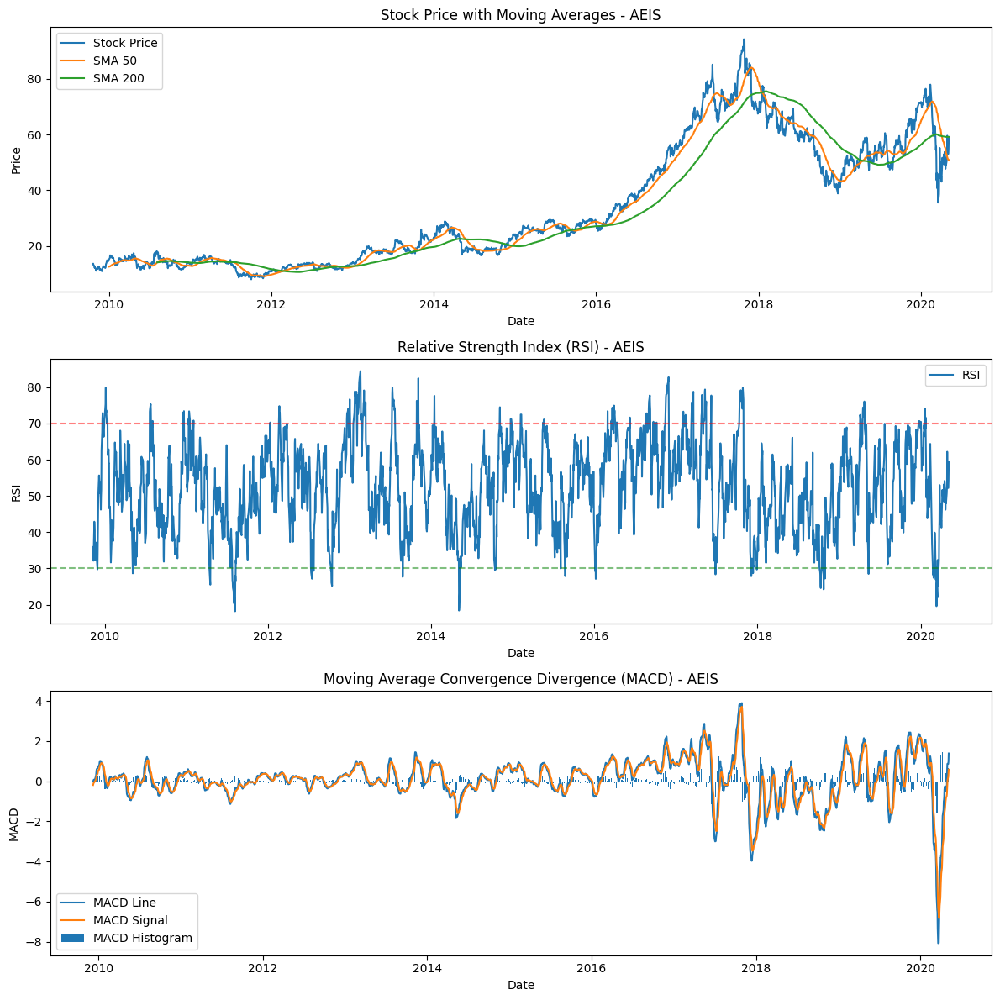

[*********************100%%**********************]  1 of 1 completed


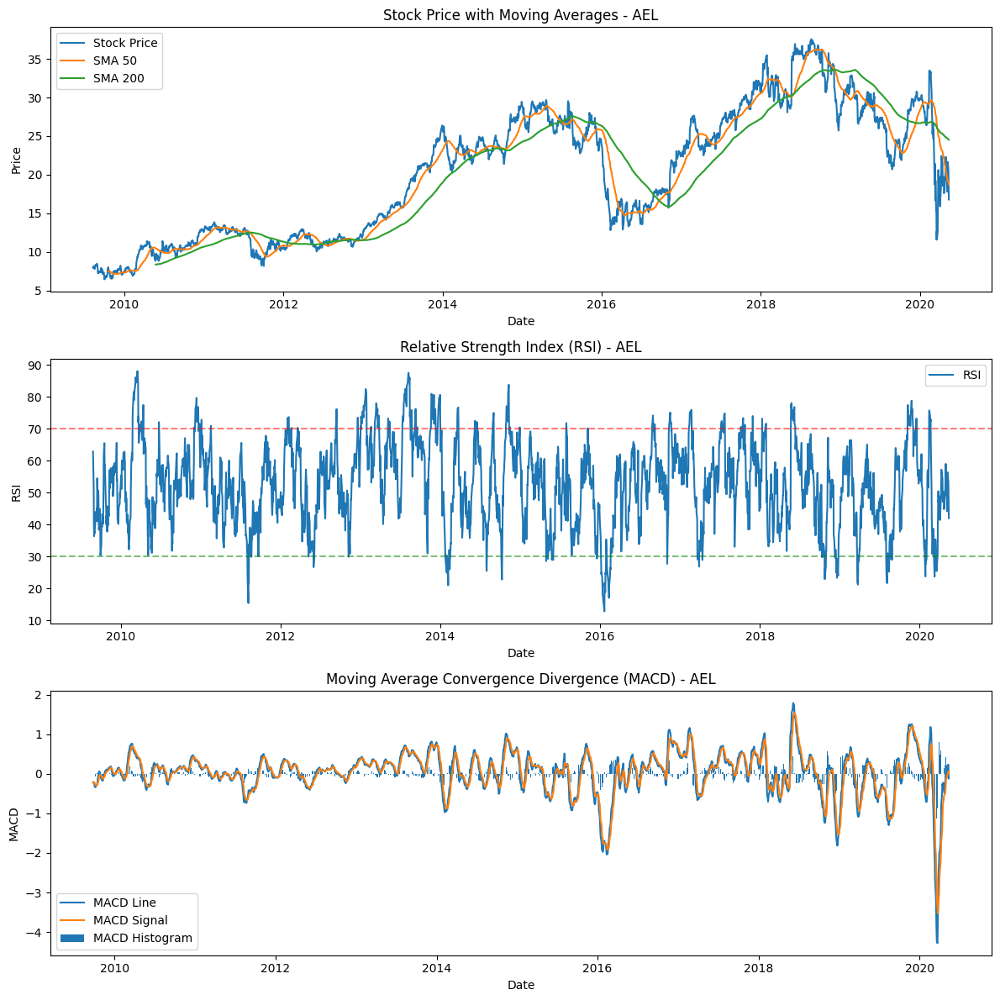

[*********************100%%**********************]  1 of 1 completed


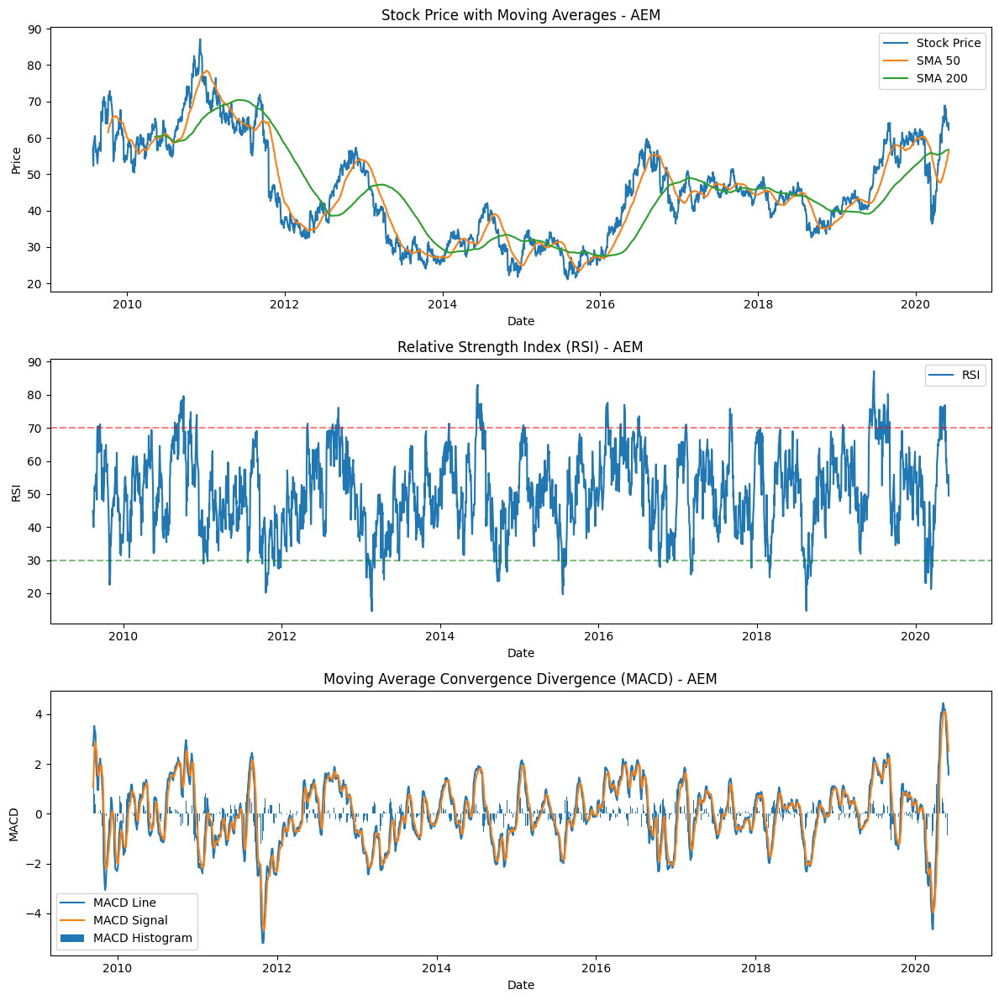

[*********************100%%**********************]  1 of 1 completed


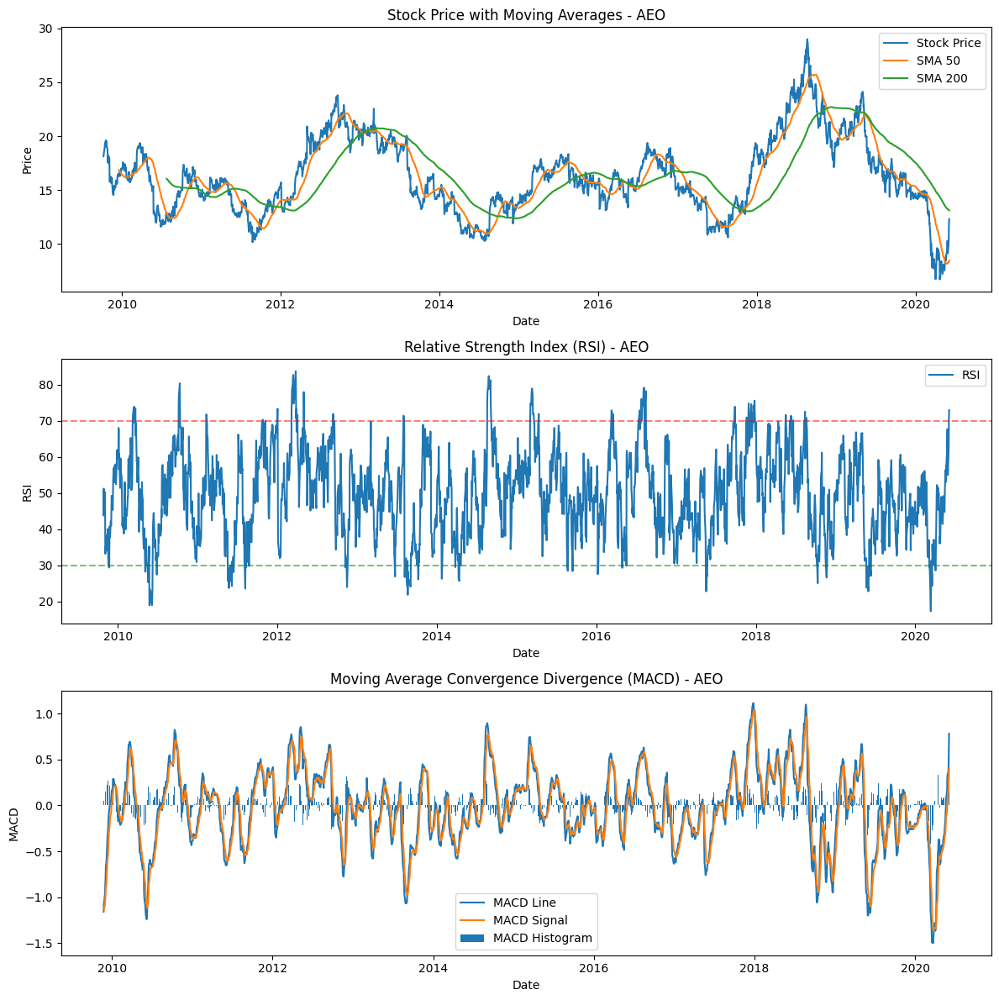

[*********************100%%**********************]  1 of 1 completed


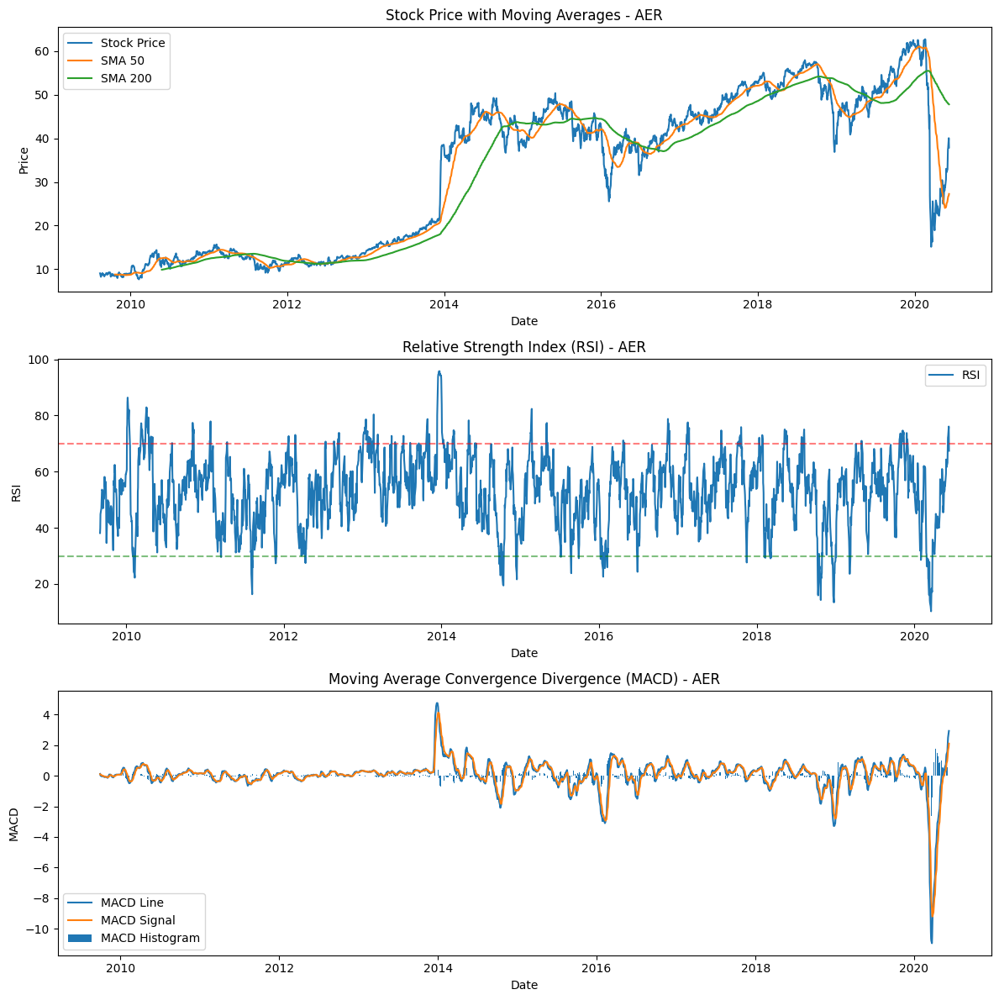

[*********************100%%**********************]  1 of 1 completed


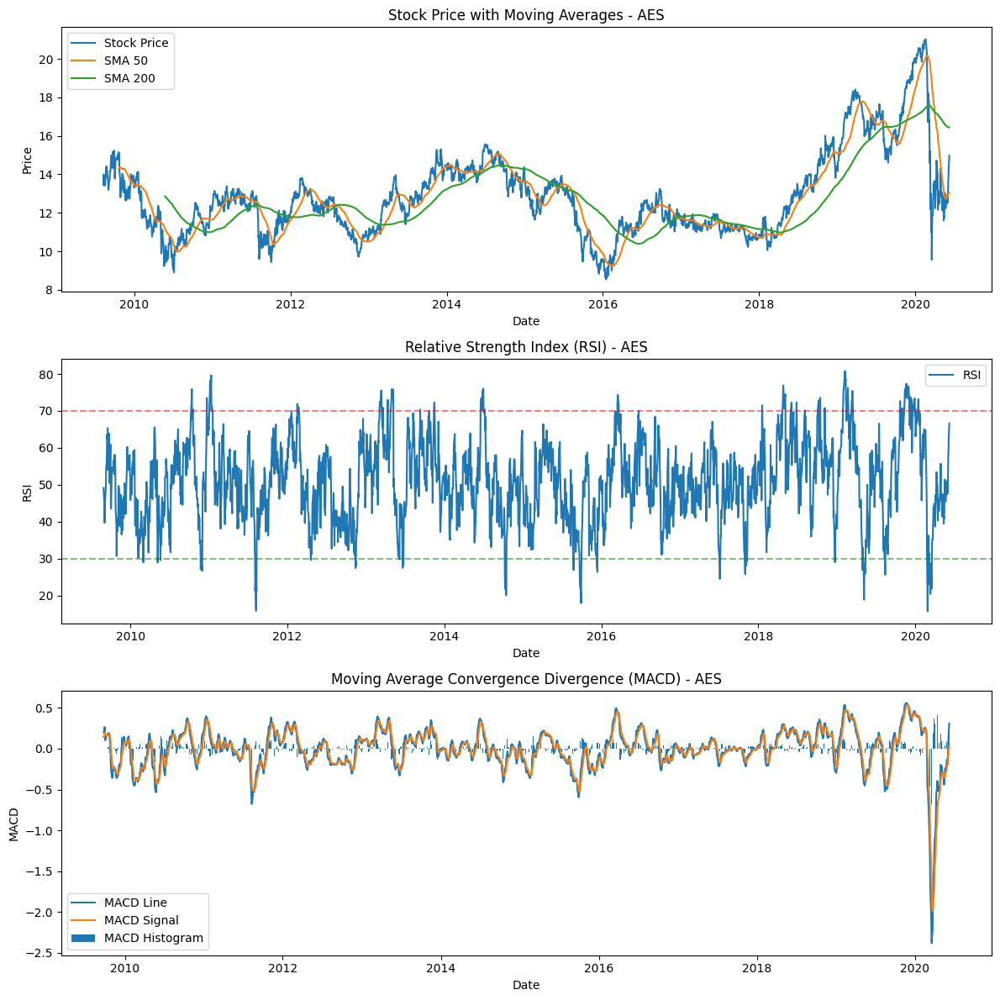

[*********************100%%**********************]  1 of 1 completed


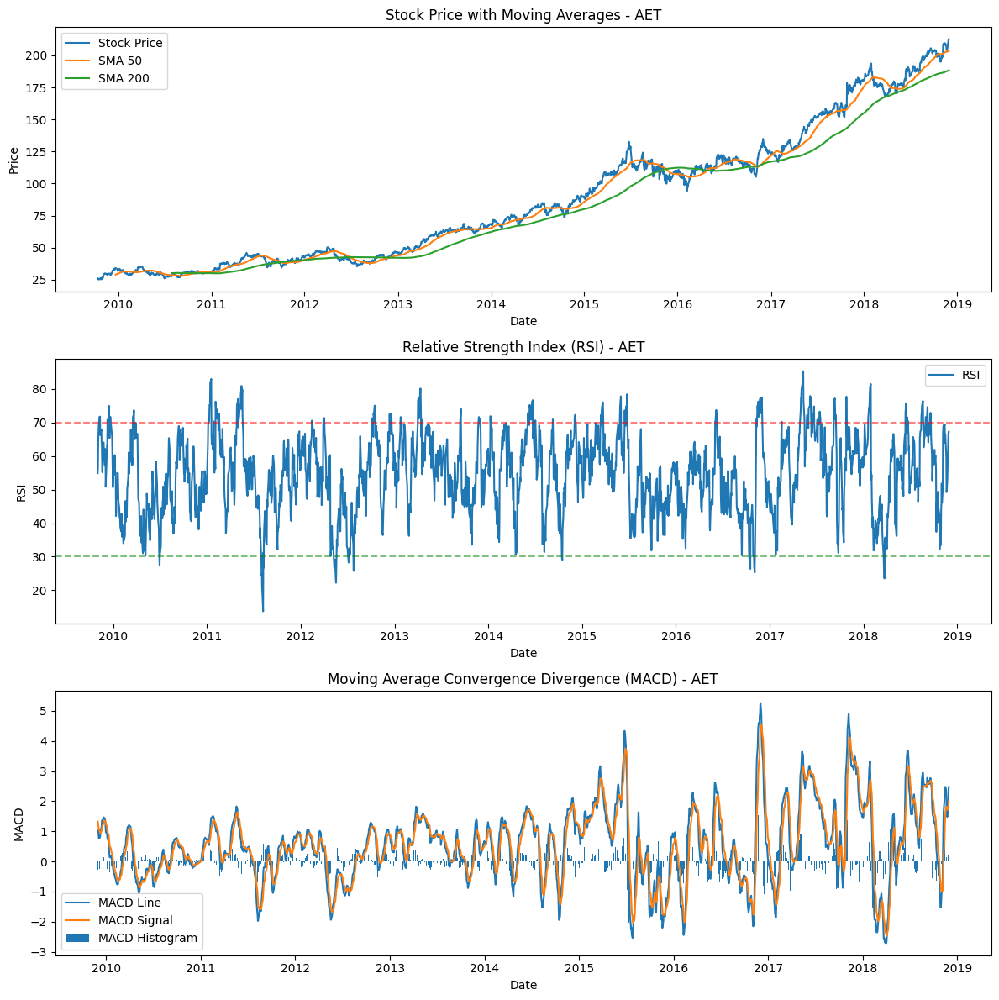

[*********************100%%**********************]  1 of 1 completed

1 Failed download:
['AEZS']: ReadTimeout(ReadTimeoutError("HTTPSConnectionPool(host='query2.finance.yahoo.com', port=443): Read timed out. (read timeout=10)"))


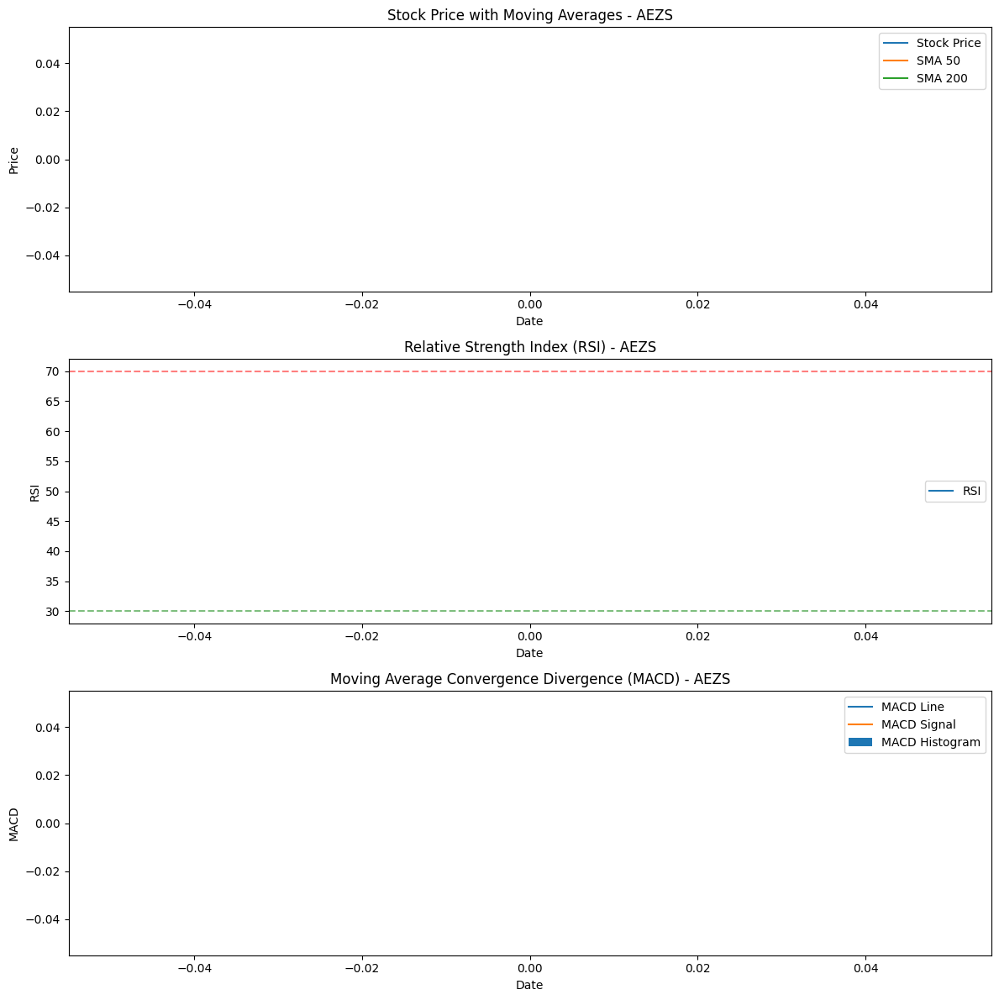

[*********************100%%**********************]  1 of 1 completed


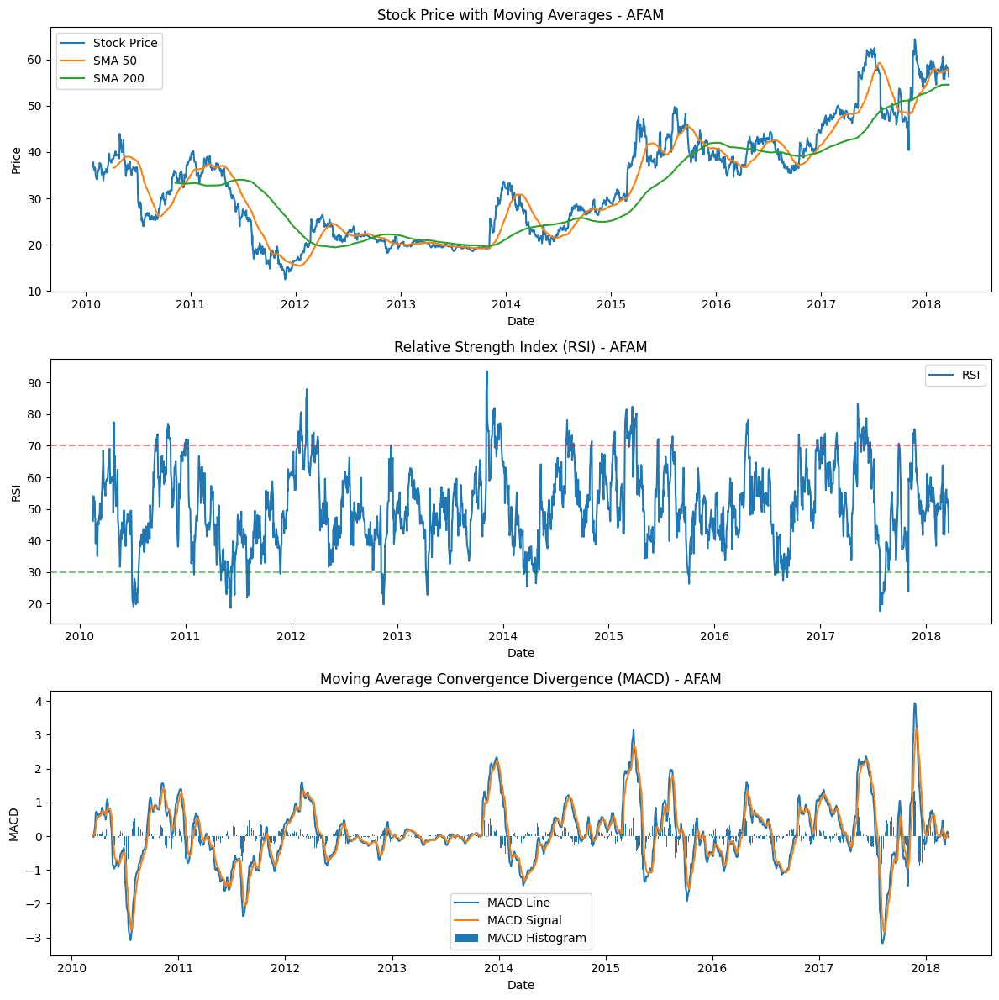

[*********************100%%**********************]  1 of 1 completed


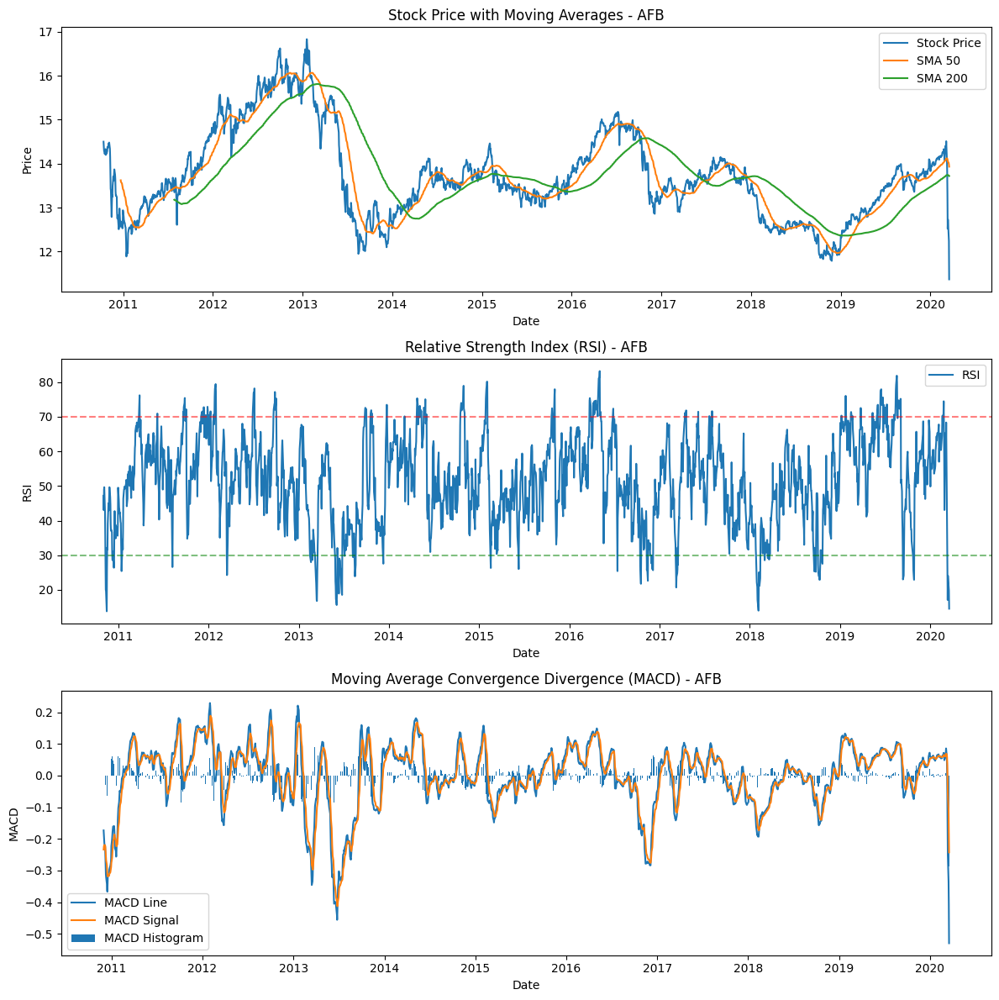

[*********************100%%**********************]  1 of 1 completed


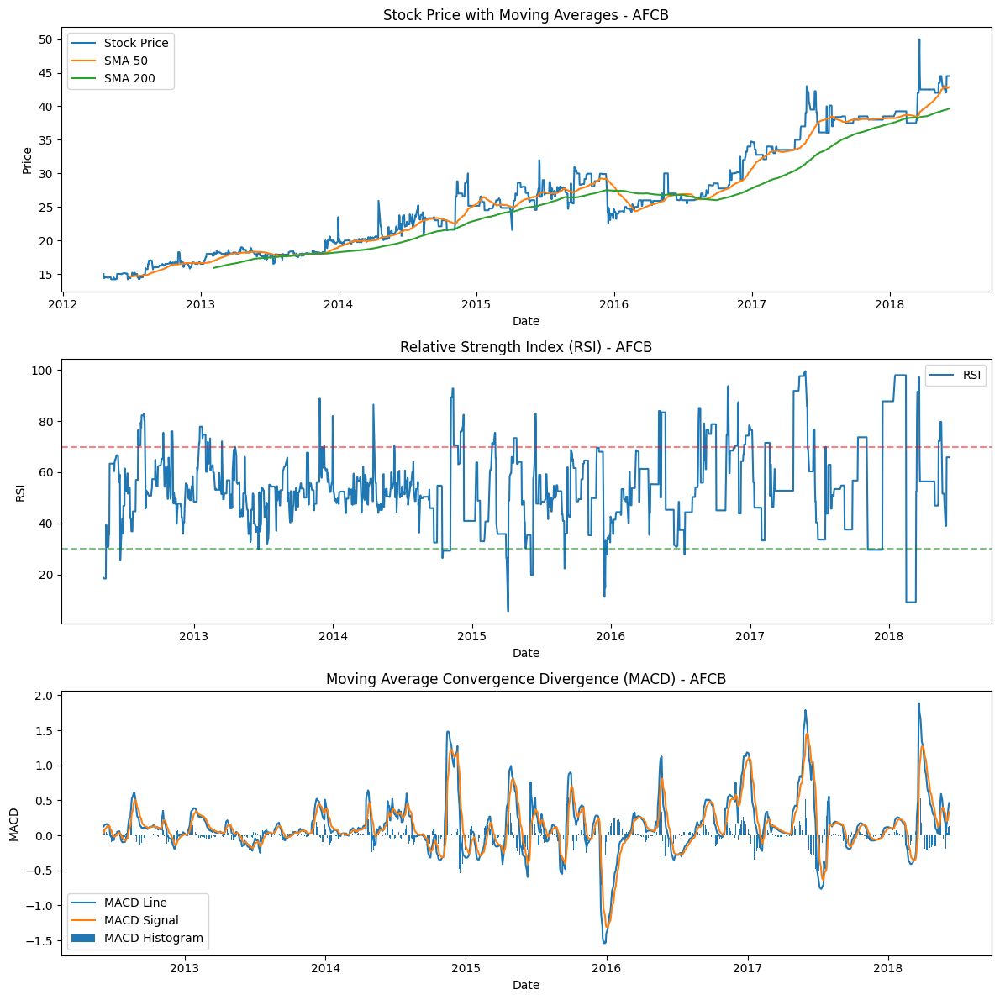

[*********************100%%**********************]  1 of 1 completed


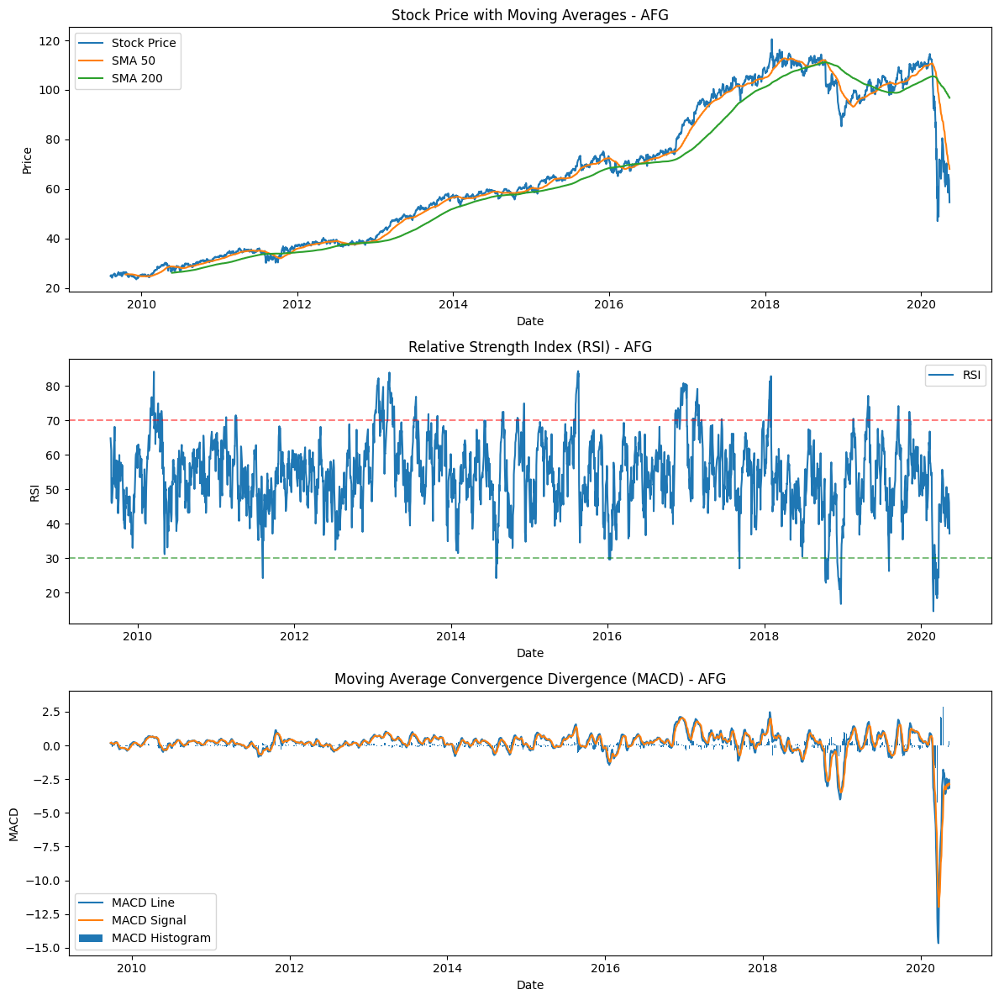

[*********************100%%**********************]  1 of 1 completed


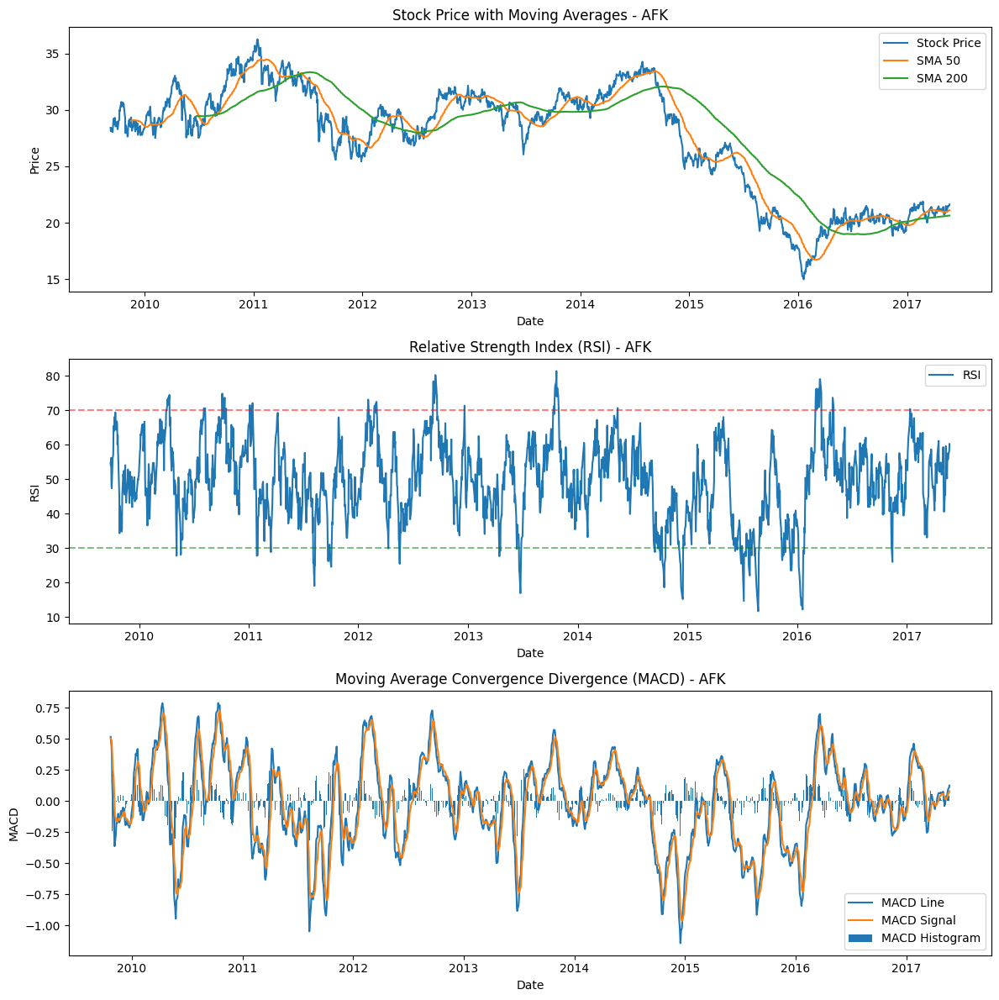

[*********************100%%**********************]  1 of 1 completed


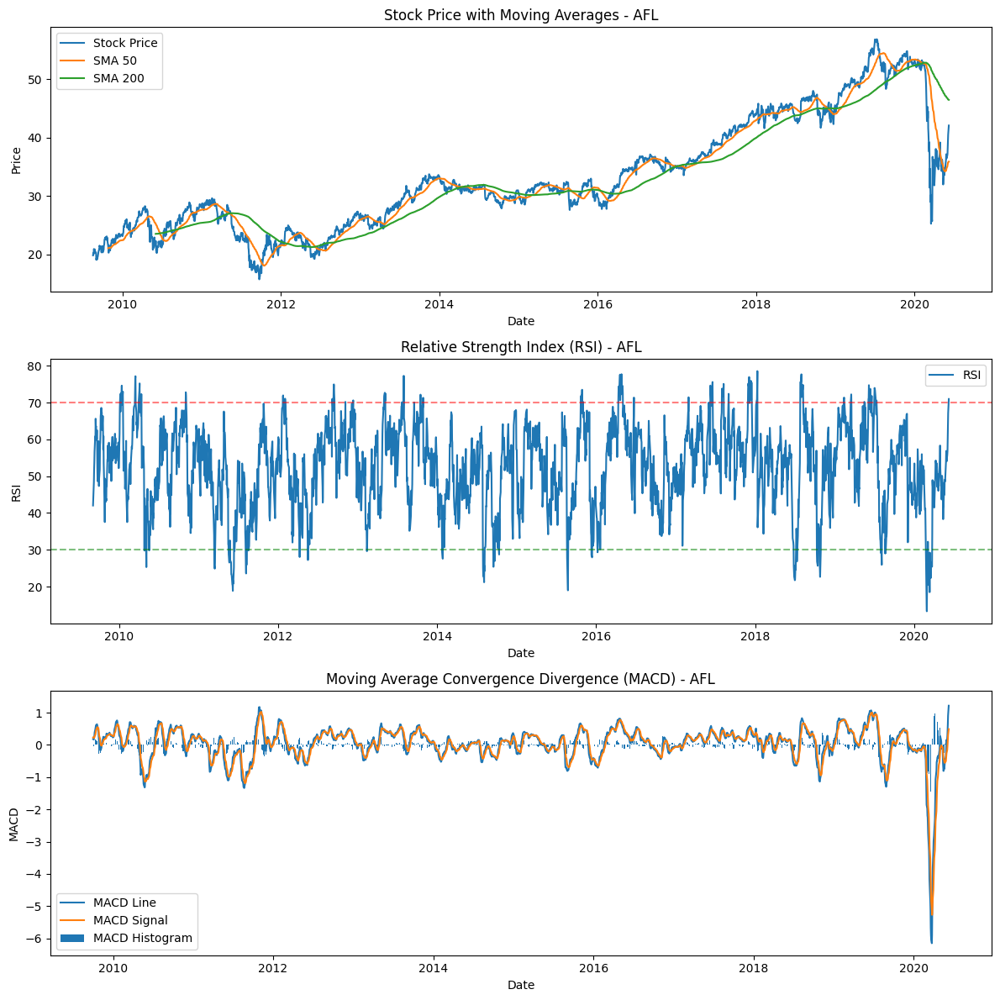

[*********************100%%**********************]  1 of 1 completed


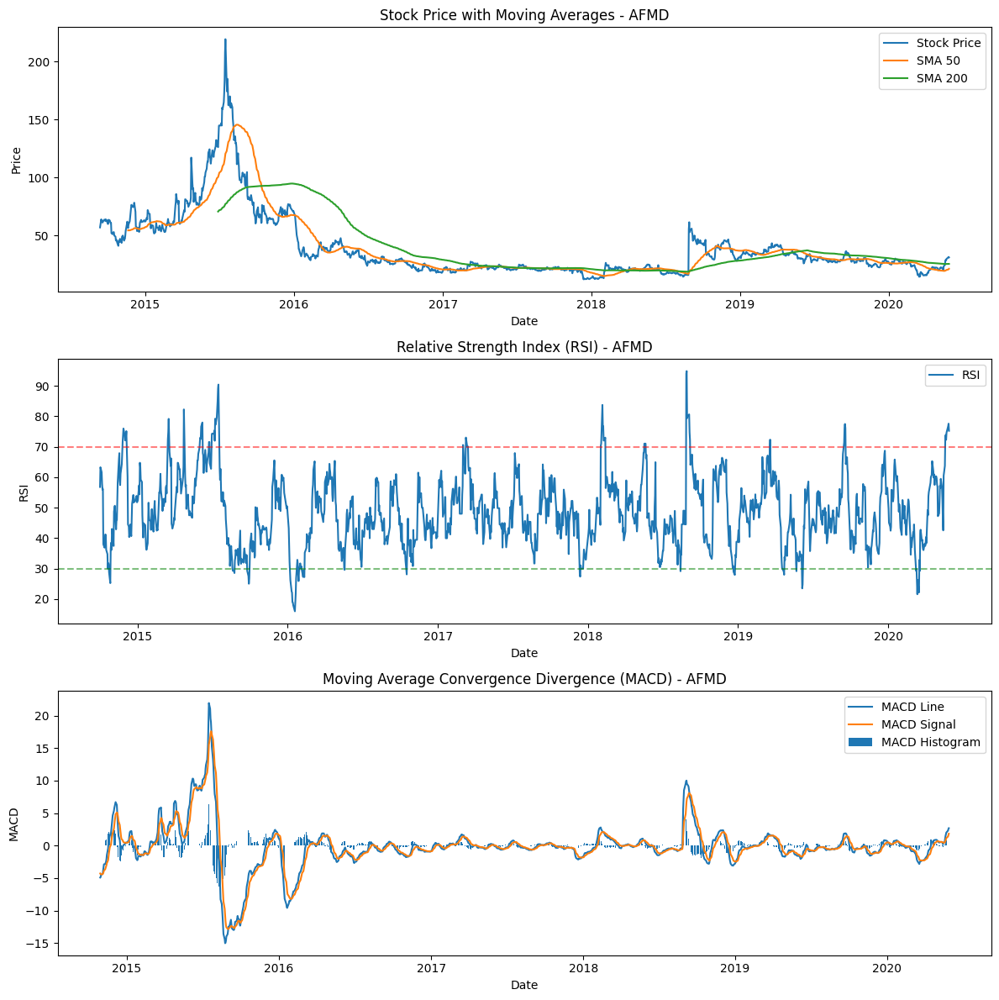

[*********************100%%**********************]  1 of 1 completed


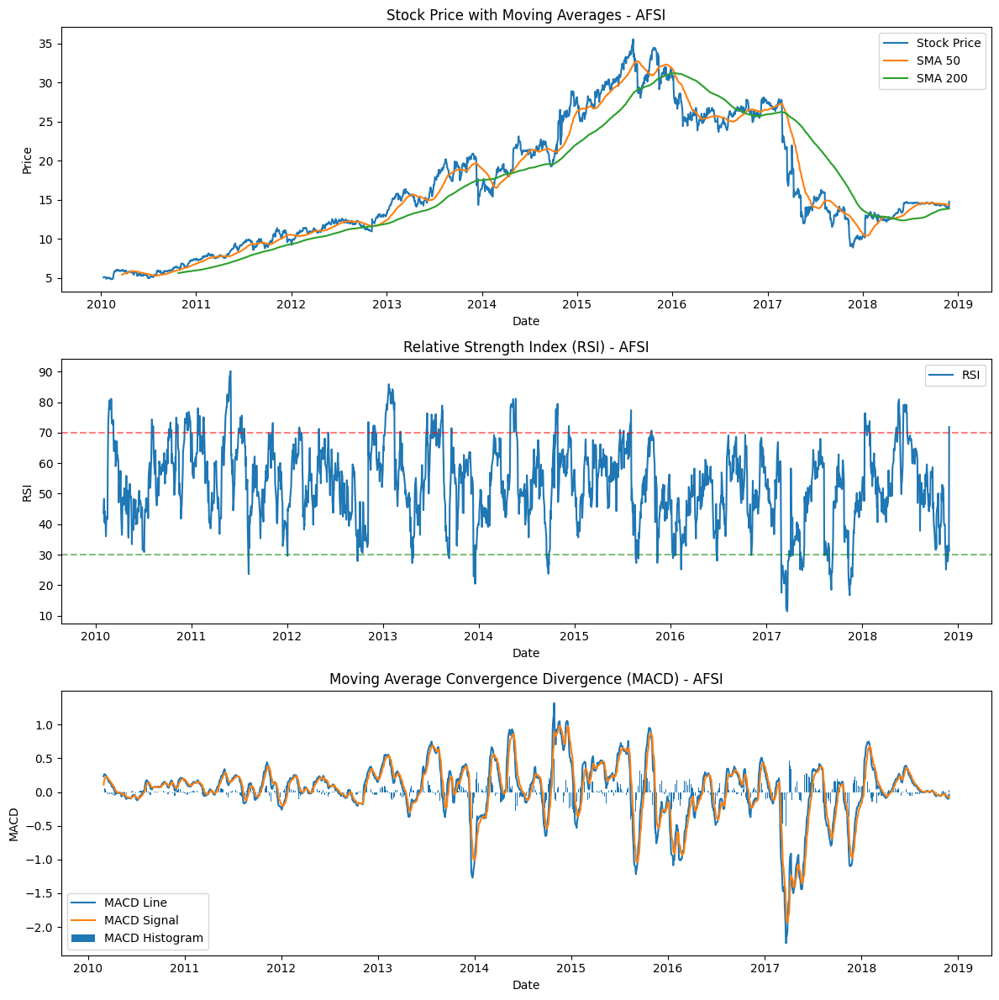

[*********************100%%**********************]  1 of 1 completed


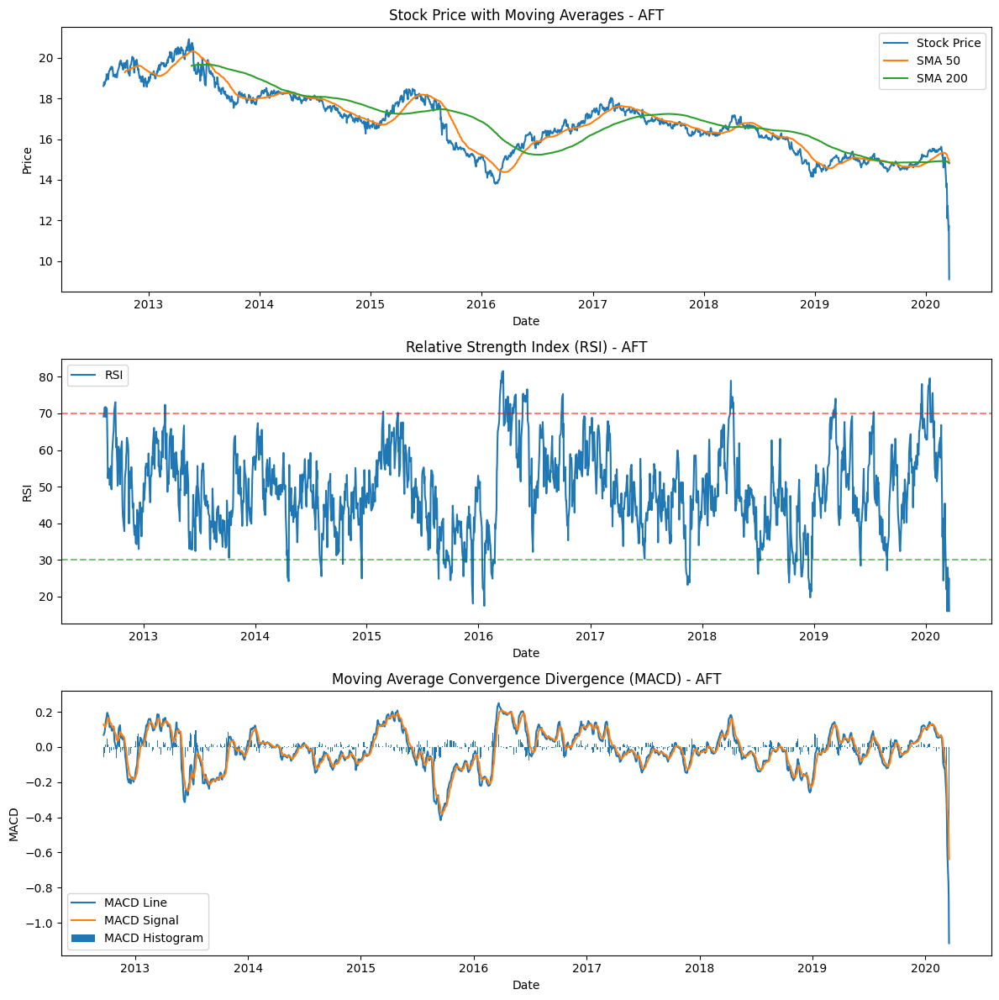

[*********************100%%**********************]  1 of 1 completed


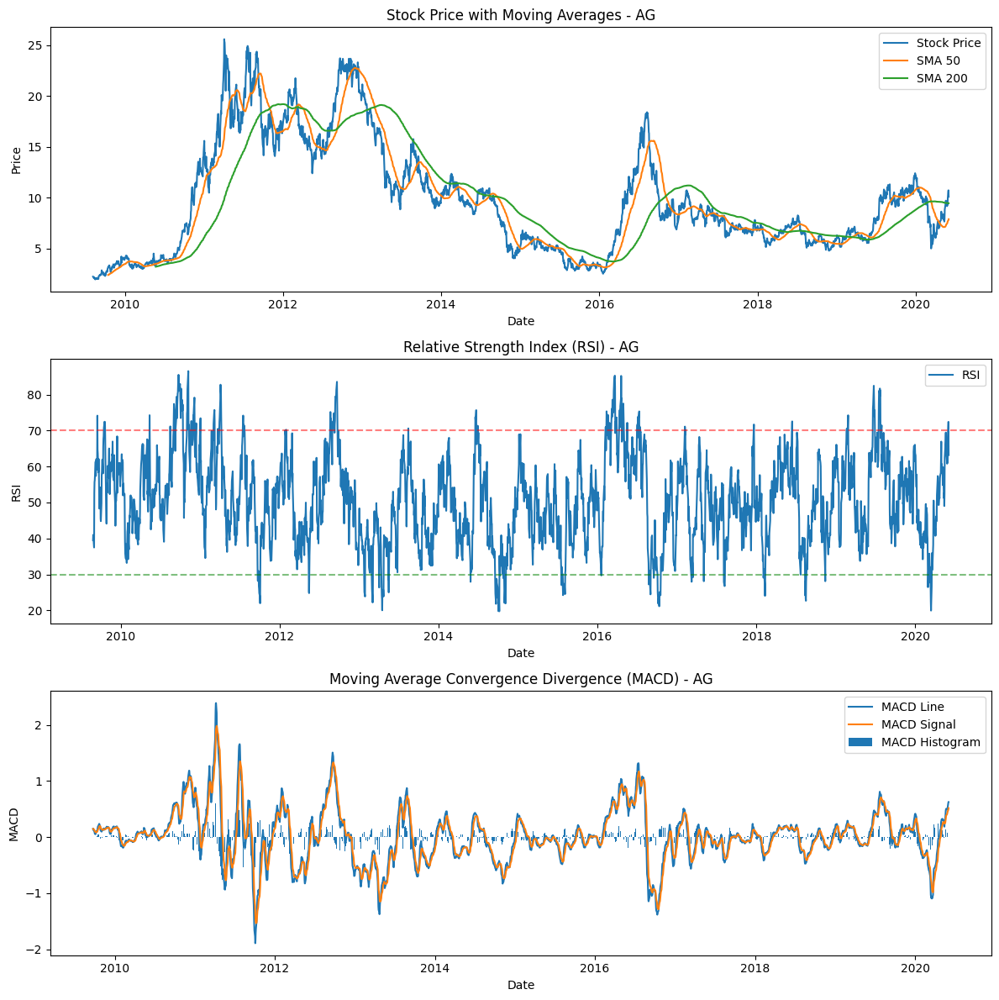

[*********************100%%**********************]  1 of 1 completed


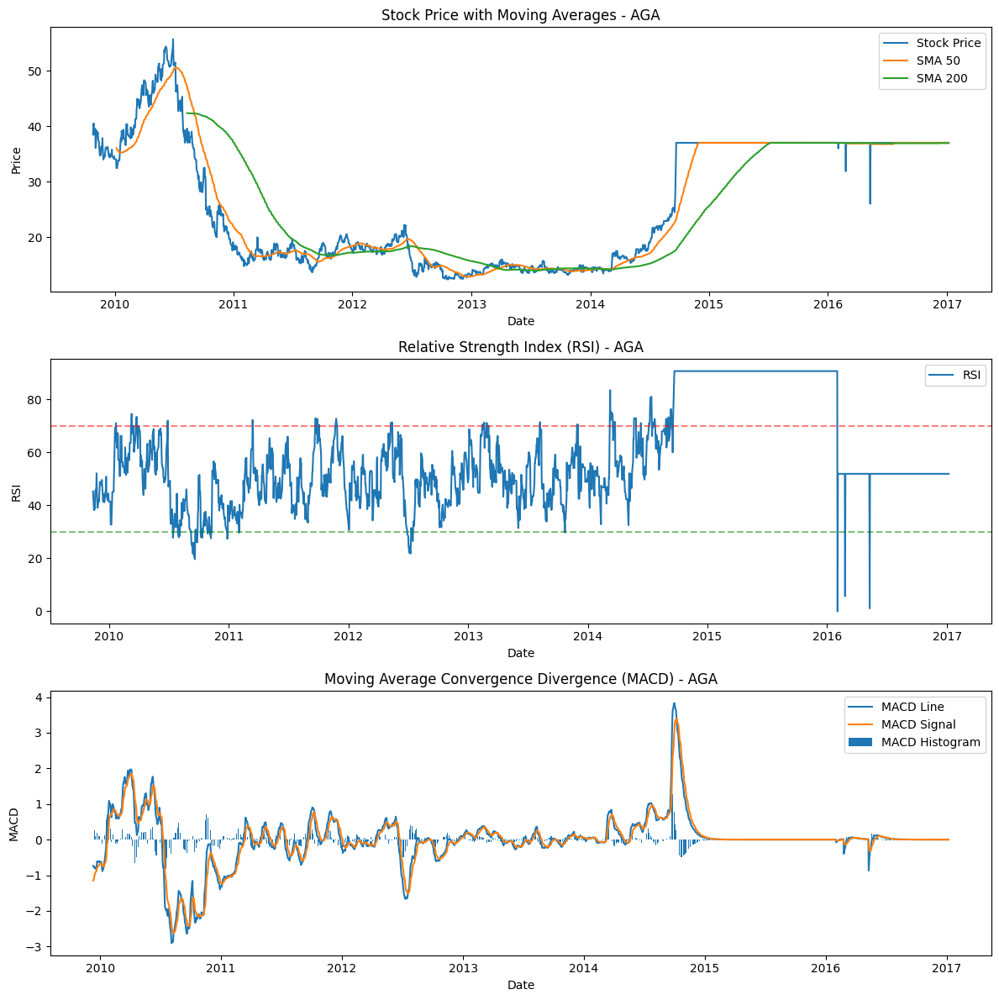

[*********************100%%**********************]  1 of 1 completed


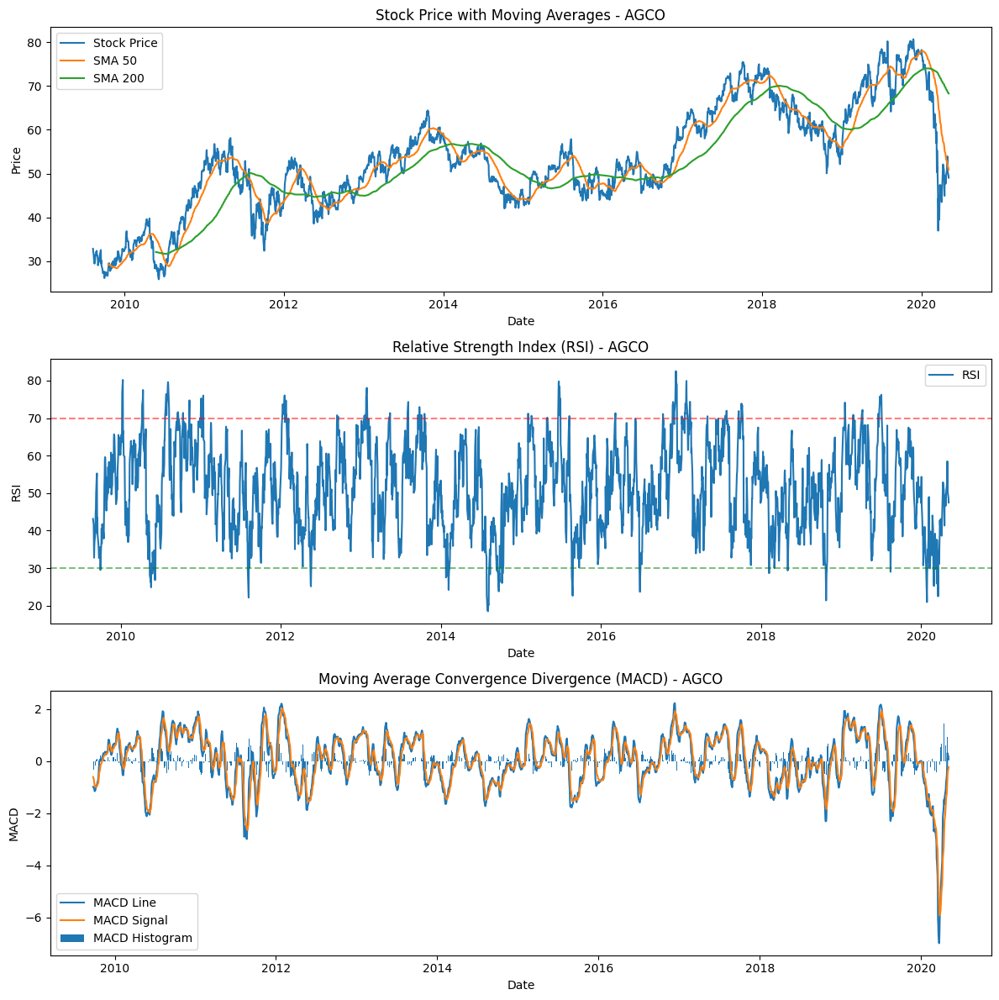

[*********************100%%**********************]  1 of 1 completed


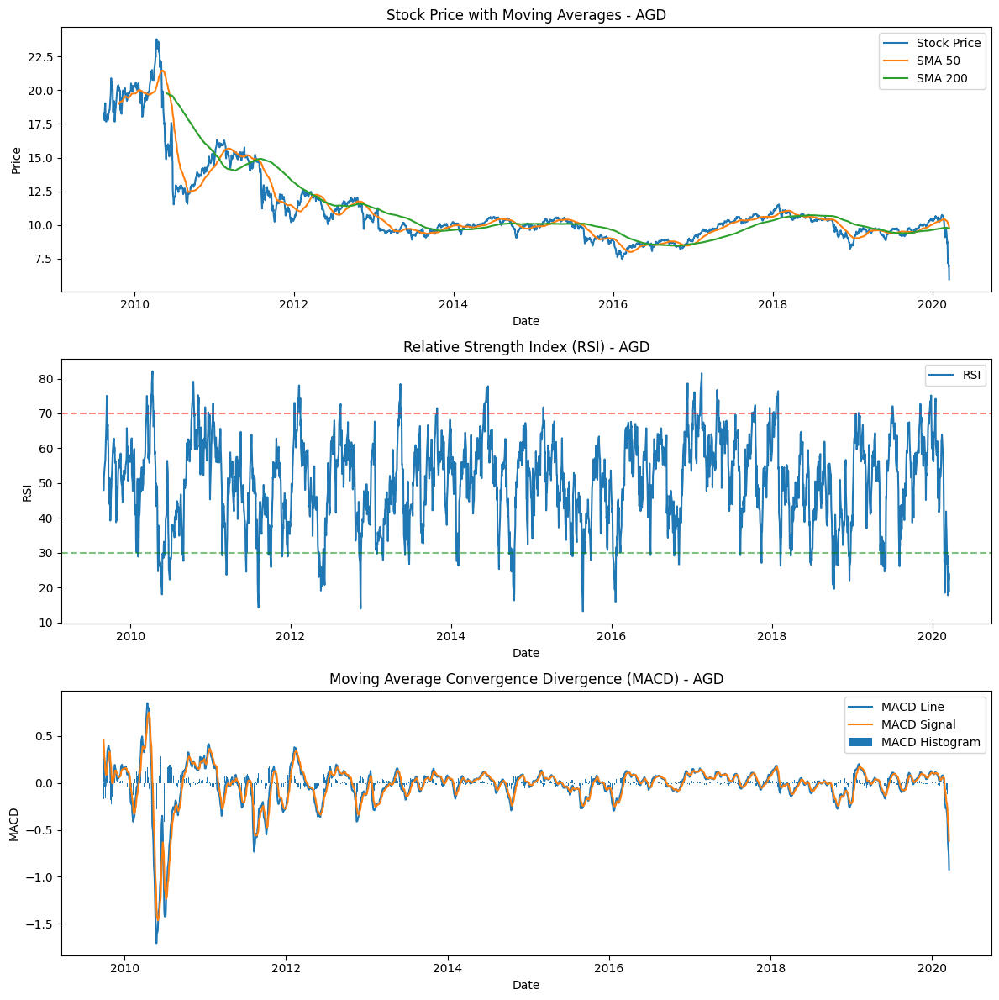

[*********************100%%**********************]  1 of 1 completed


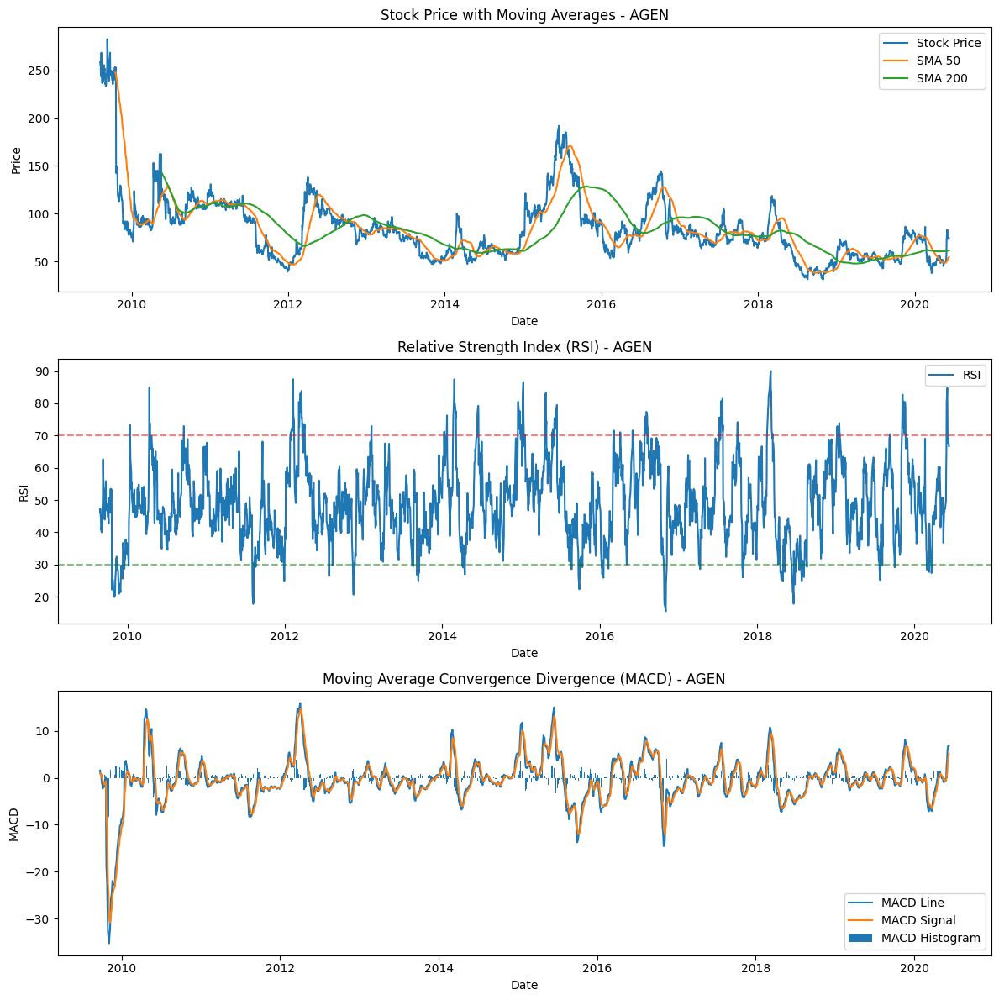

[*********************100%%**********************]  1 of 1 completed


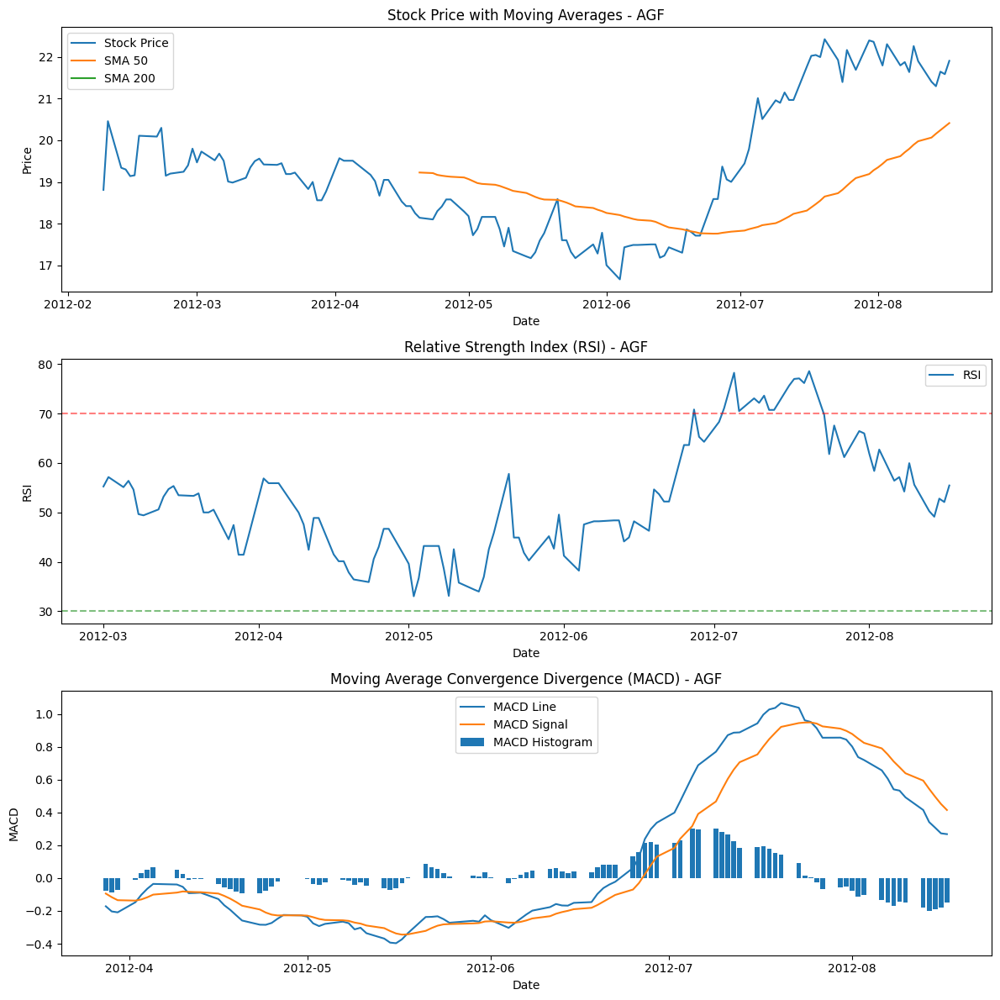

[*********************100%%**********************]  1 of 1 completed


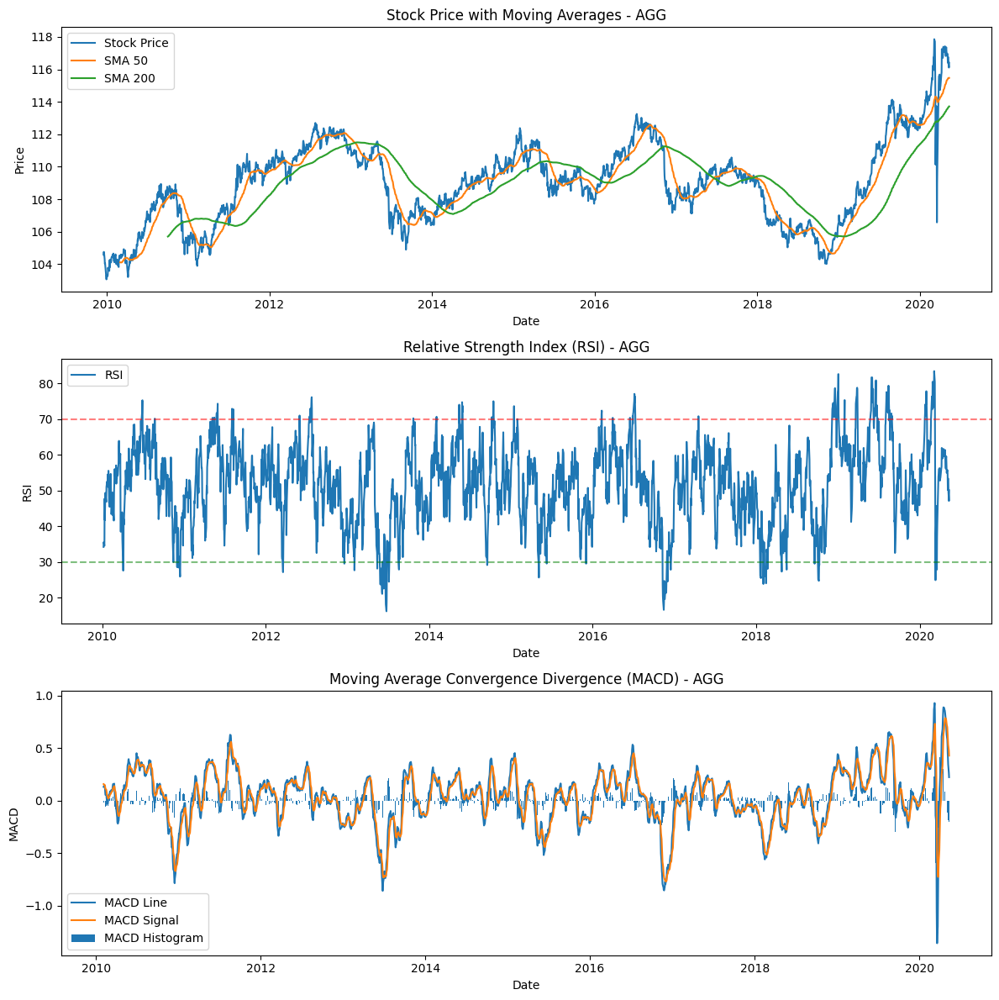

[*********************100%%**********************]  1 of 1 completed


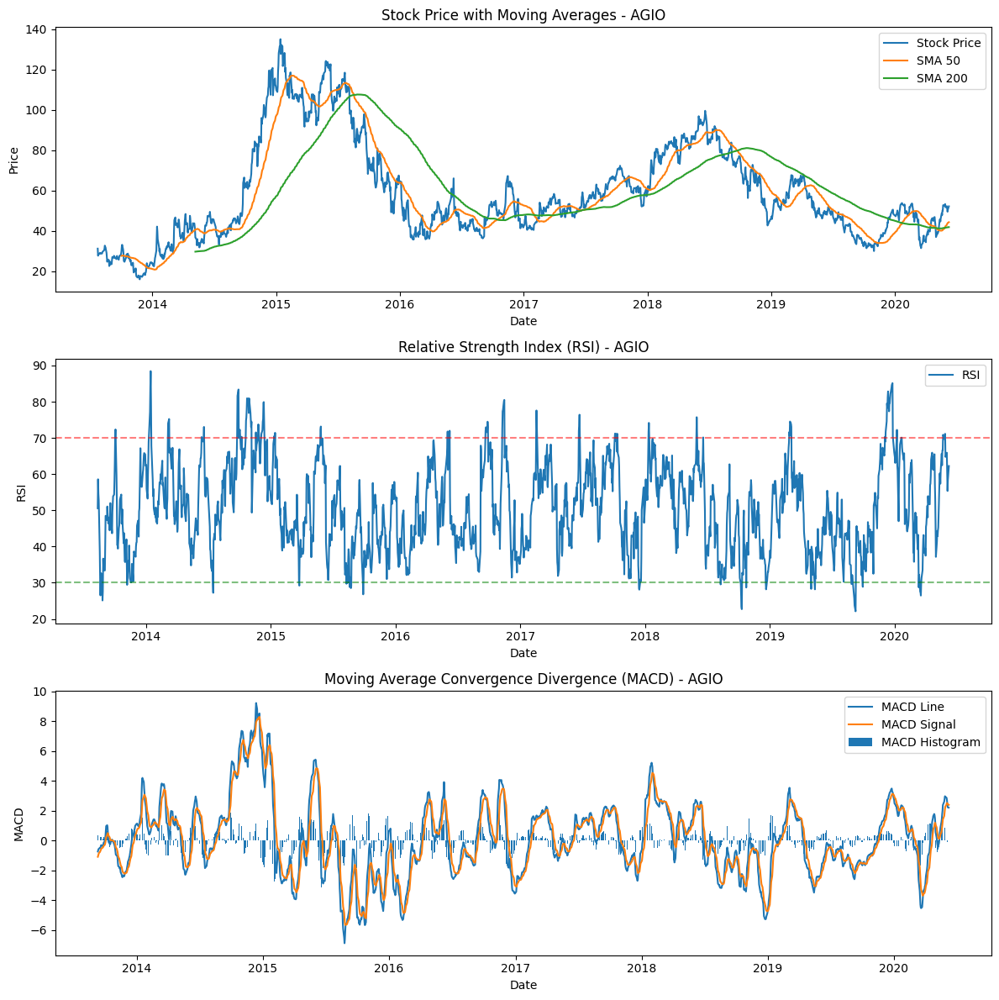

In [11]:

# Get the stock tickers from the combined_stock_data DataFrame
stock_tickers = combined_stock_data['stock'].unique()

# Iterate over each stock ticker
for stock in stock_tickers:
    # Get the corresponding start date and end date for the stock from the start_end_dates DataFrame
    stock_dates = start_end_dates.loc[start_end_dates['stock'] == stock, ['start_date', 'end_date']].values[0]
    start_date = stock_dates[0]
    end_date = stock_dates[1]
    
    # Fetch the historical stock data using yfinance
    stock_data = yf.download(stock, start=start_date, end=end_date)
    
    # Calculate moving averages
    stock_data['SMA_50'] = talib.SMA(stock_data['Close'], timeperiod=50)
    stock_data['SMA_200'] = talib.SMA(stock_data['Close'], timeperiod=200)
    
    # Calculate RSI (Relative Strength Index)
    stock_data['RSI'] = talib.RSI(stock_data['Close'], timeperiod=14)
    
    # Calculate MACD (Moving Average Convergence Divergence)
    macd, signal, hist = talib.MACD(stock_data['Close'])
    stock_data['MACD_Line'] = macd
    stock_data['MACD_Signal'] = signal
    stock_data['MACD_Histogram'] = hist
    
    # Create subplots for each indicator
    fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(12, 12))
    
    # Plotting the stock price and moving averages
    axes[0].plot(stock_data['Close'], label='Stock Price')
    axes[0].plot(stock_data['SMA_50'], label='SMA 50')
    axes[0].plot(stock_data['SMA_200'], label='SMA 200')
    axes[0].set_title(f'Stock Price with Moving Averages - {stock}')
    axes[0].set_xlabel('Date')
    axes[0].set_ylabel('Price')
    axes[0].legend()
    
    # Plotting the Relative Strength Index (RSI)
    axes[1].plot(stock_data['RSI'], label='RSI')
    axes[1].axhline(y=70, color='r', linestyle='--', alpha=0.5)  # Overbought threshold
    axes[1].axhline(y=30, color='g', linestyle='--', alpha=0.5)  # Oversold threshold
    axes[1].set_title(f'Relative Strength Index (RSI) - {stock}')
    axes[1].set_xlabel('Date')
    axes[1].set_ylabel('RSI')
    axes[1].legend()
    
    # Plotting the MACD
    axes[2].plot(stock_data['MACD_Line'], label='MACD Line')
    axes[2].plot(stock_data['MACD_Signal'], label='MACD Signal')
    axes[2].bar(stock_data.index, stock_data['MACD_Histogram'], label='MACD Histogram')
    axes[2].set_title(f'Moving Average Convergence Divergence (MACD) - {stock}')
    axes[2].set_xlabel('Date')
    axes[2].set_ylabel('MACD')
    axes[2].legend()
    
    # Adjust the spacing between subplots
    plt.tight_layout()
    
    # Display the plot for the current stock
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
import yfinance as yf

# Assuming you have a DataFrame called 'start_end_dates' with columns: 'stock', 'start_date', 'end_date'

# Iterate over each row in start_end_dates DataFrame
for index, row in start_end_dates.iterrows():
    stock = row['stock']
    start_date = row['start_date']
    end_date = row['end_date']
    
    # Fetch the historical stock data using yfinance
    stock_data = yf.download(stock, start=start_date, end=end_date)
    
    # Assuming you have a column named 'Metric' representing the financial metric you want to analyze
    financial_data = stock_data[['Metric']]
    
    # Convert the 'Date' column to a datetime object
    financial_data.index = pd.to_datetime(financial_data.index)
    
    # Plot the time series of the financial metric
    plt.figure(figsize=(12, 6))
    plt.plot(financial_data['Metric'], label='Financial Metric')
    plt.title(f'Time Series of Financial Metric - {stock}')
    plt.xlabel('Date')
    plt.ylabel('Metric')
    plt.legend()
    plt.show()
    
    # Perform decomposition to analyze trend, seasonality, and residuals
    decomposition = sm.tsa.seasonal_decompose(financial_data['Metric'], model='additive')
    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid
    
    # Plot the decomposition components
    plt.figure(figsize=(12, 8))
    plt.subplot(411)
    plt.plot(financial_data['Metric'], label='Original')
    plt.legend(loc='best')
    plt.subplot(412)
    plt.plot(trend, label='Trend')
    plt.legend(loc='best')
    plt.subplot(413)
    plt.plot(seasonal, label='Seasonality')
    plt.legend(loc='best')
    plt.subplot(414)
    plt.plot(residual, label='Residuals')
    plt.legend(loc='best')
    plt.tight_layout()
    plt.show()
    
    # Perform autocorrelation analysis
    sm.graphics.tsa.plot_acf(financial_data['Metric'], lags=20)
    plt.title(f'Autocorrelation - {stock}')
    plt.xlabel('Lag')
    plt.ylabel('Autocorrelation')
    plt.show()
    
    # Perform partial autocorrelation analysis
    sm.graphics.tsa.plot_pacf(financial_data['Metric'], lags=20)
    plt.title(f'Partial Autocorrelation - {stock}')
    plt.xlabel('Lag')
    plt.ylabel('Partial Autocorrelation')
    plt.show()
    
    # Fit an ARIMA model
    model = sm.tsa.ARIMA(financial_data['Metric'], order=(1, 0, 1))
    results = model.fit()
    
    # Print the model summary
    print(results.summary())
    
    # Generate forecasts
    forecast_start = financial_data.index[-1] + pd.DateOffset(days=1)
    forecast_end = financial_data.index[-1] + pd.DateOffset(days=30)
    forecast = results.predict(start=forecast_start, end=forecast_end)
    
    # Plot the original data and the forecasted values
    plt.figure(figsize=(12, 6))
    plt.plot(financial_data['Metric'], label='Original')
    plt.plot(forecast, label='Forecast')
    plt.title(f'Original Data and Forecast - {stock}')
    plt.xlabel('Date')
    plt.ylabel('Metric')
    plt.legend()
    plt.show()   

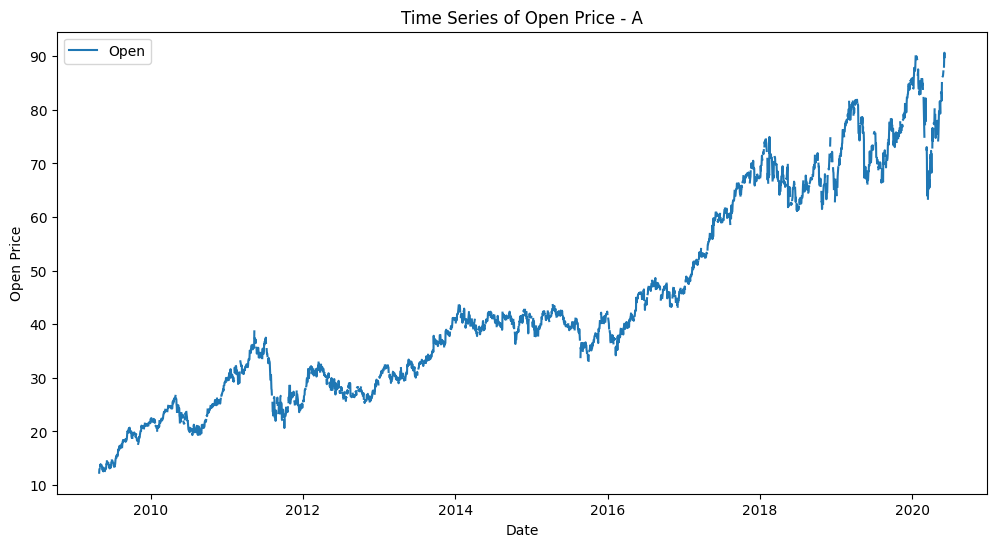

An error occurred for A: This function does not handle missing values


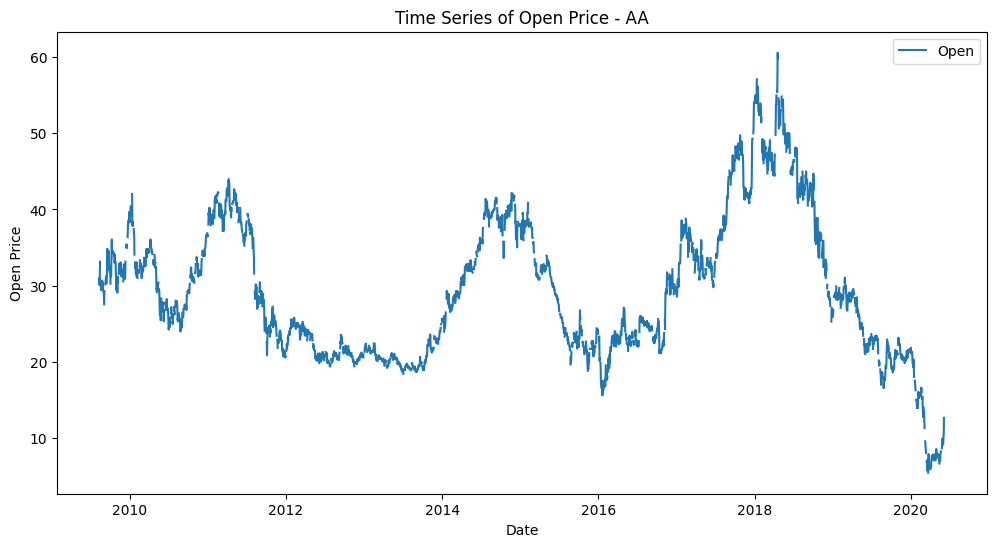

An error occurred for AA: This function does not handle missing values


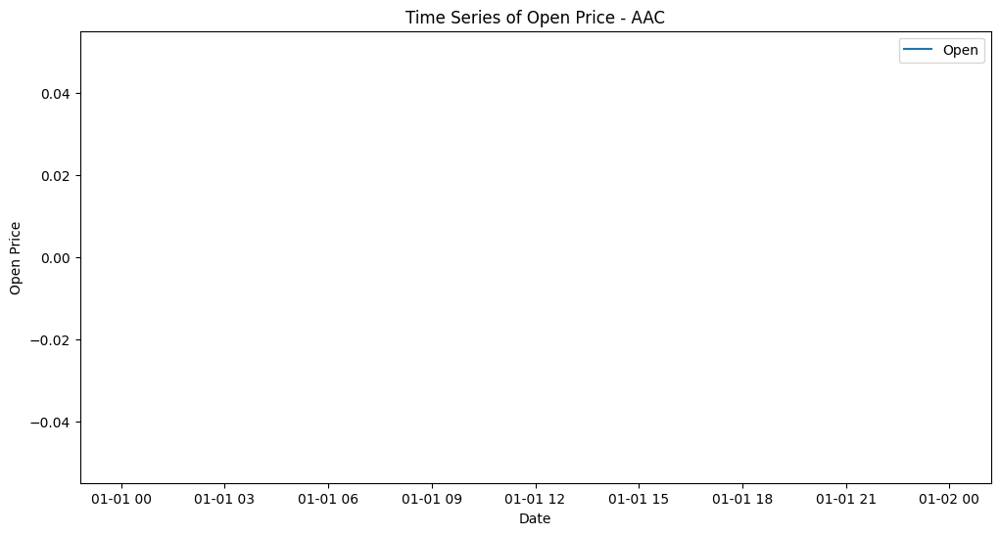

An error occurred for AAC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


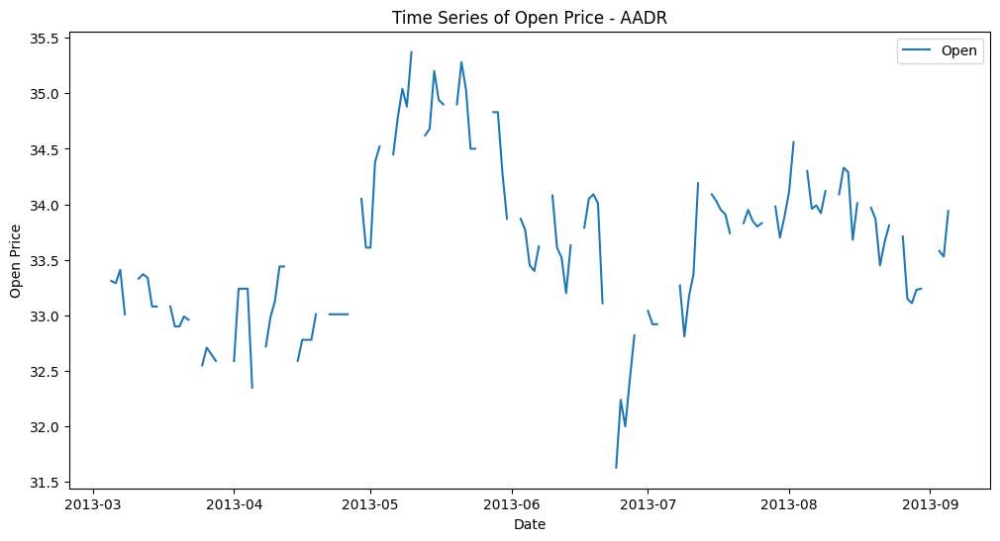

An error occurred for AADR: This function does not handle missing values


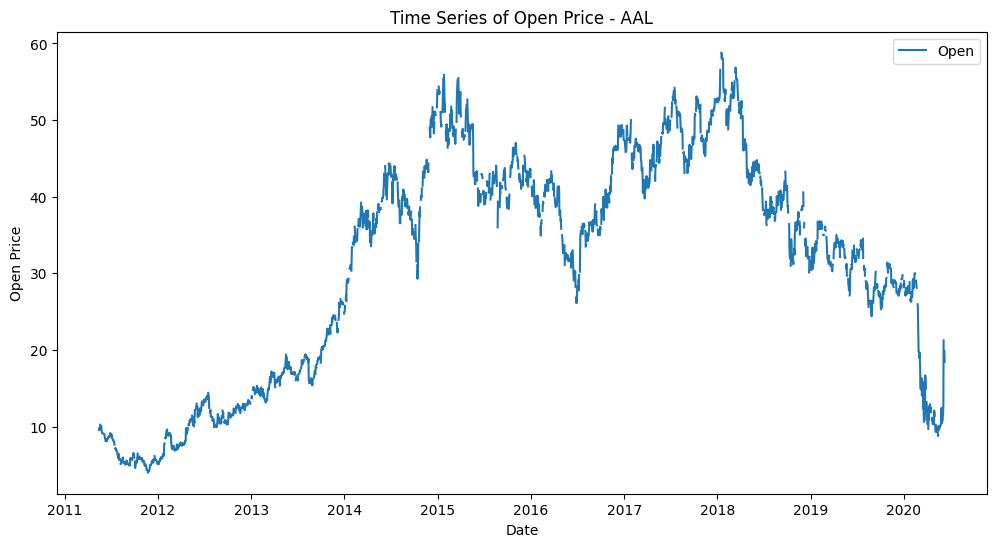

An error occurred for AAL: This function does not handle missing values


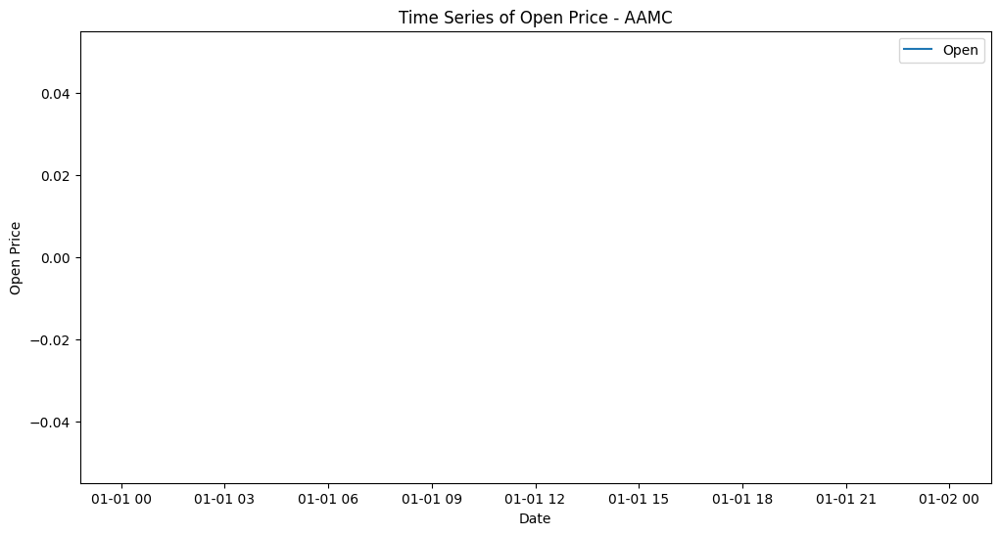

An error occurred for AAMC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


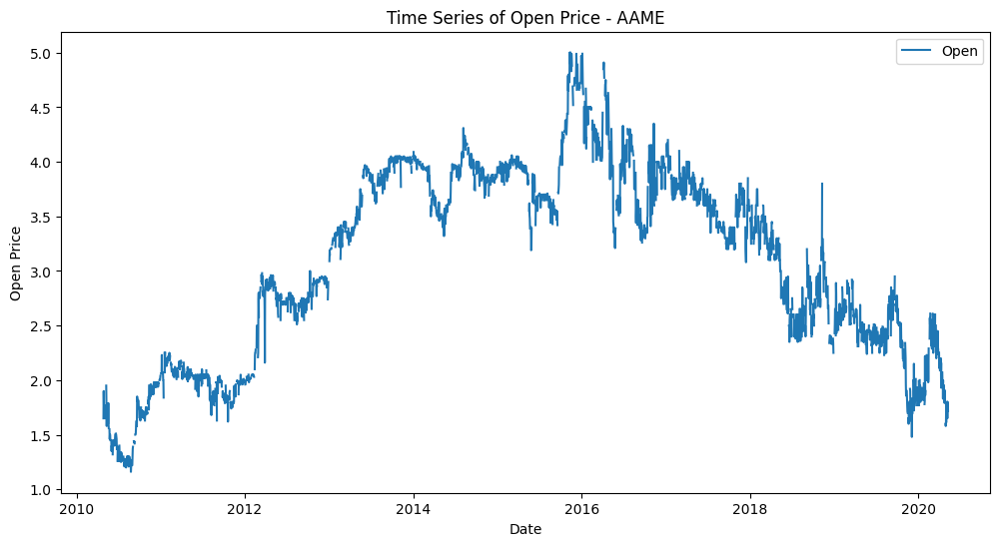

An error occurred for AAME: This function does not handle missing values


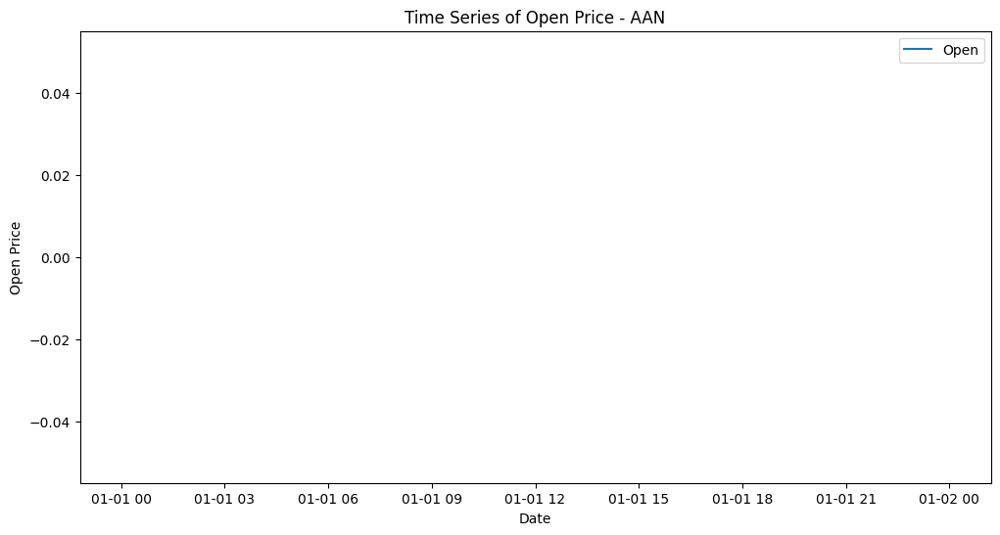

An error occurred for AAN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


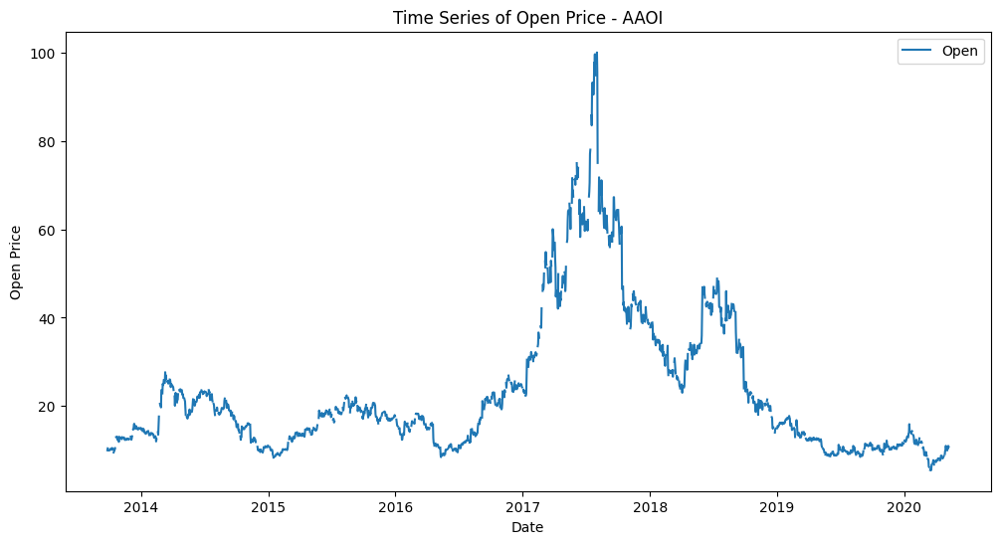

An error occurred for AAOI: This function does not handle missing values


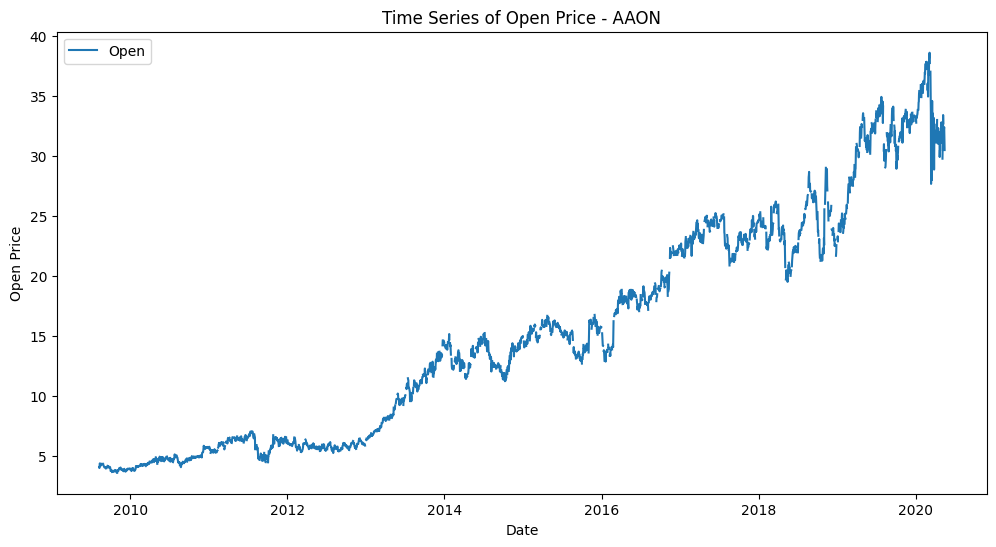

An error occurred for AAON: This function does not handle missing values


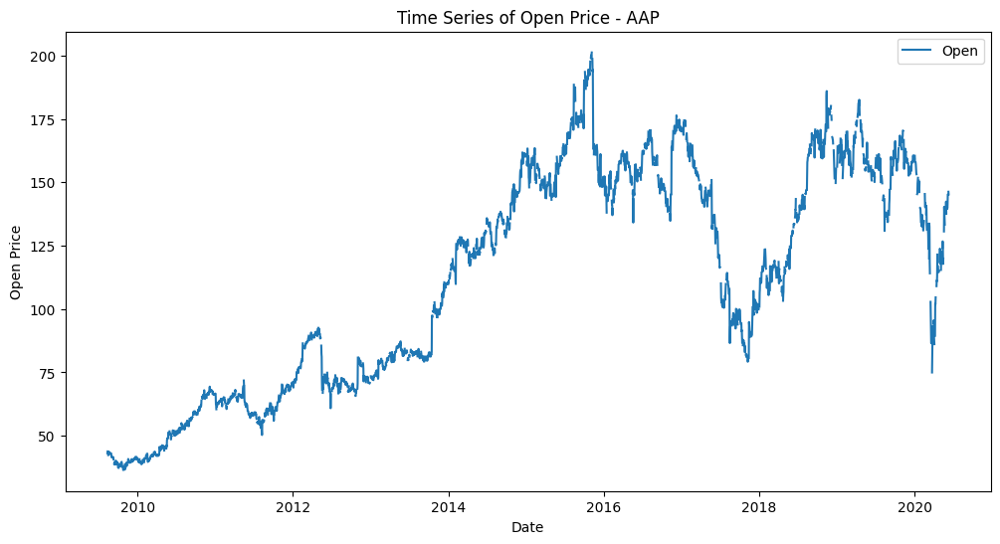

An error occurred for AAP: This function does not handle missing values


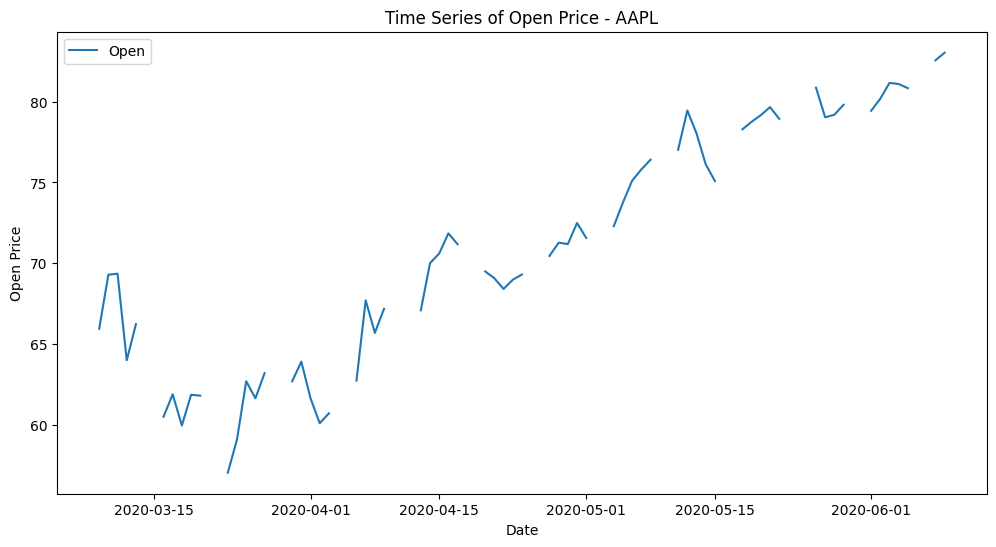

An error occurred for AAPL: This function does not handle missing values


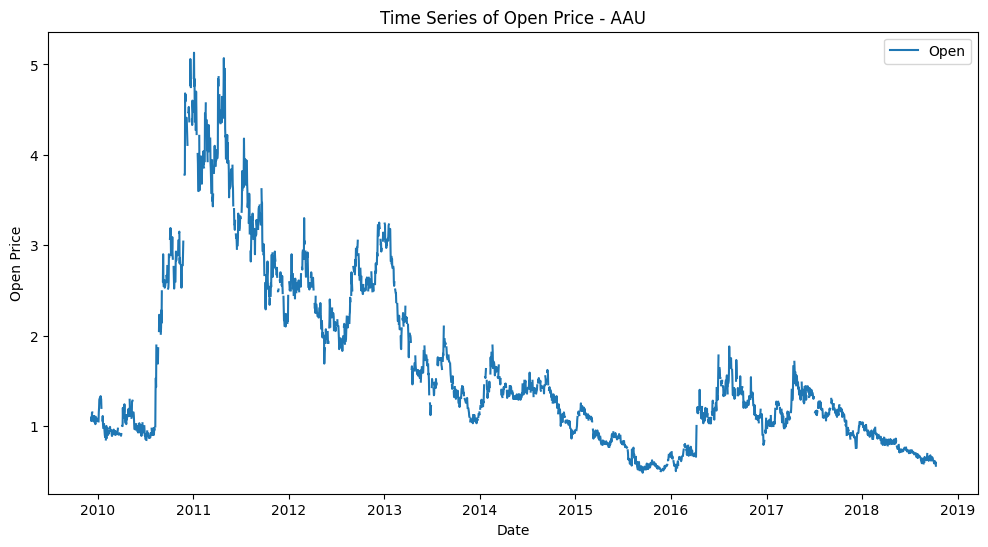

An error occurred for AAU: This function does not handle missing values


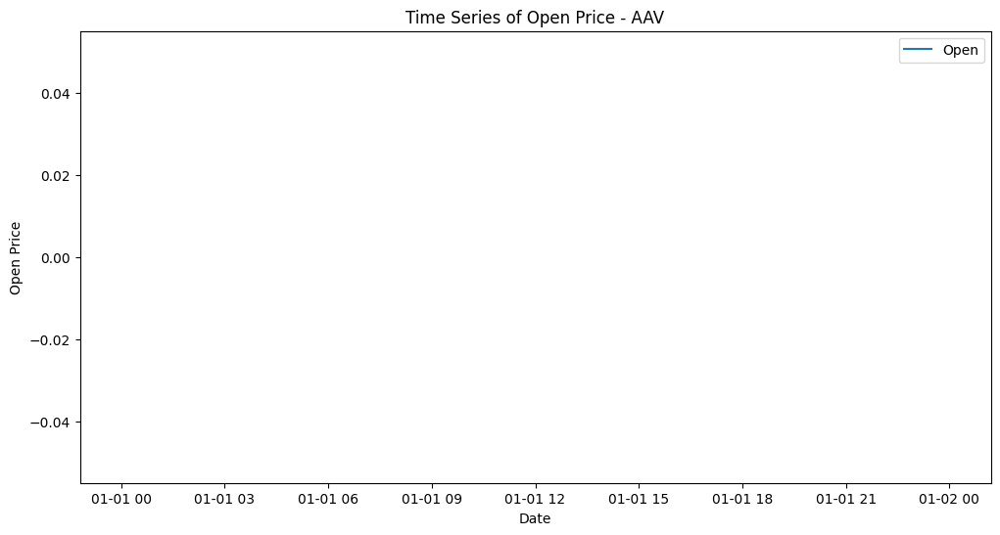

An error occurred for AAV: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


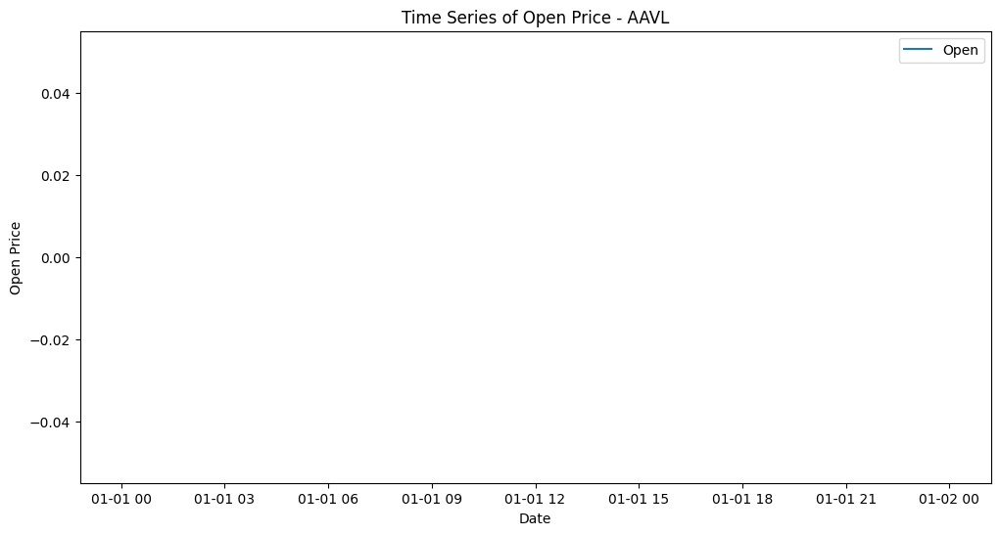

An error occurred for AAVL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


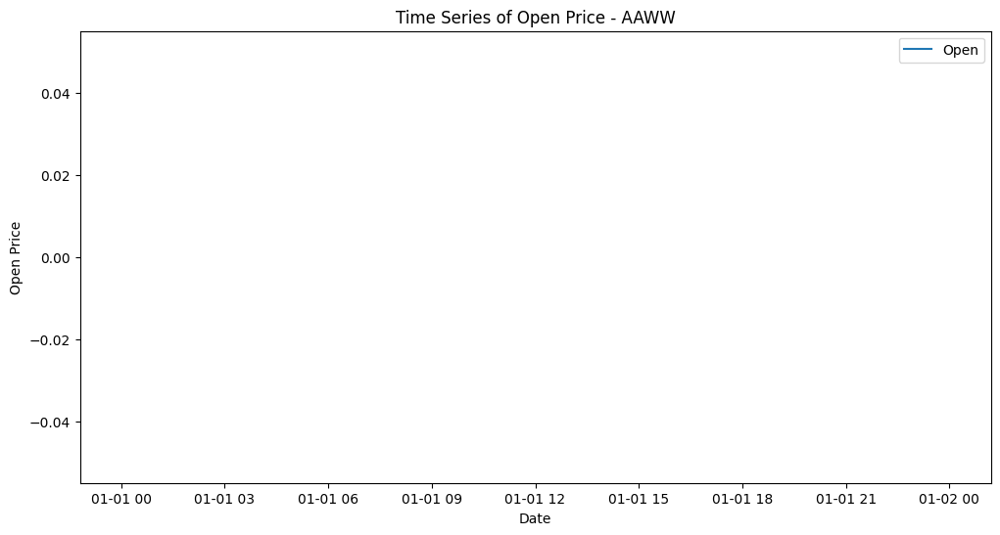

An error occurred for AAWW: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


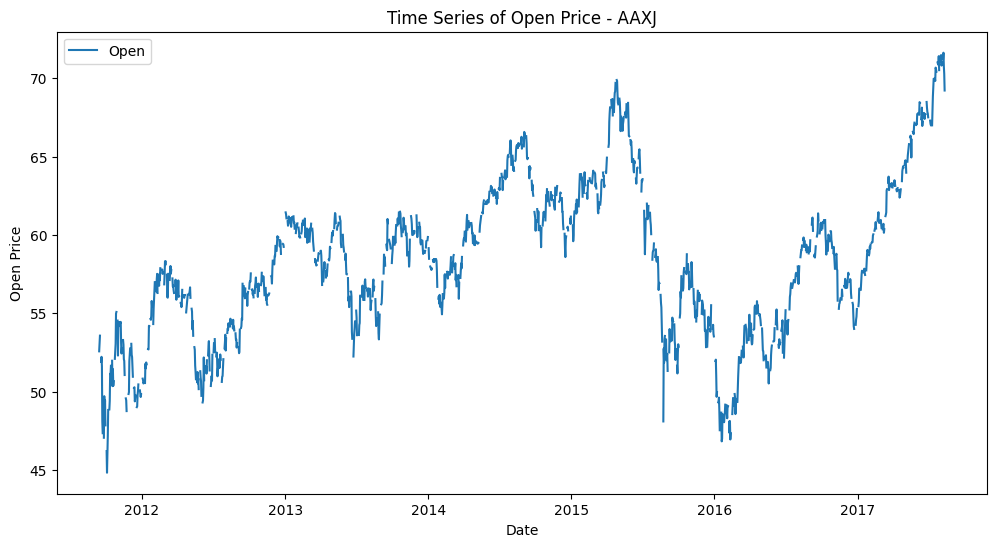

An error occurred for AAXJ: This function does not handle missing values


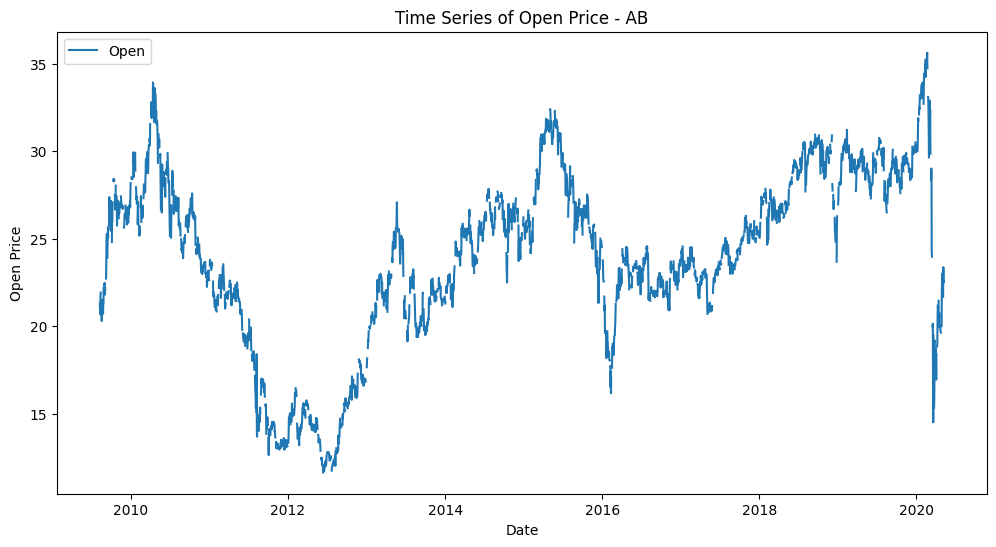

An error occurred for AB: This function does not handle missing values


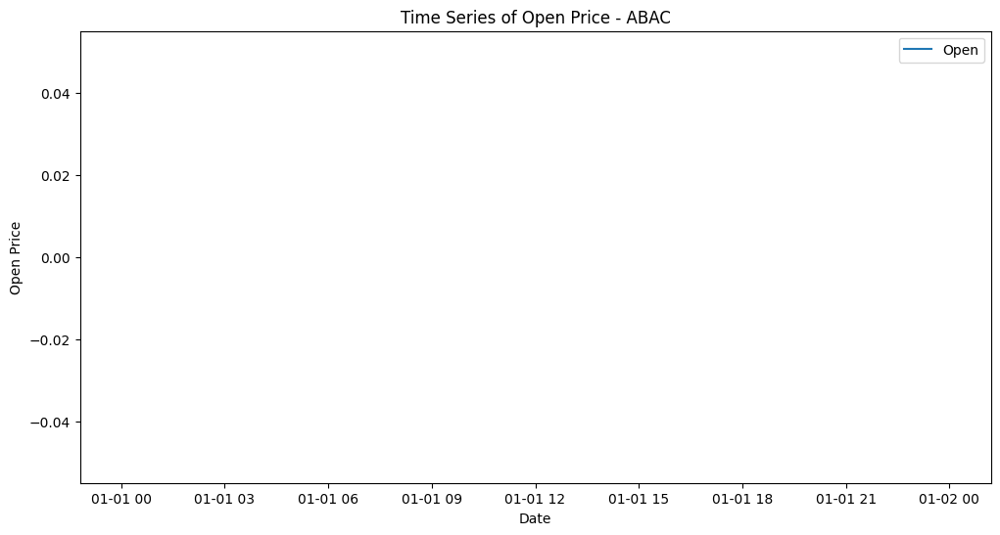

An error occurred for ABAC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


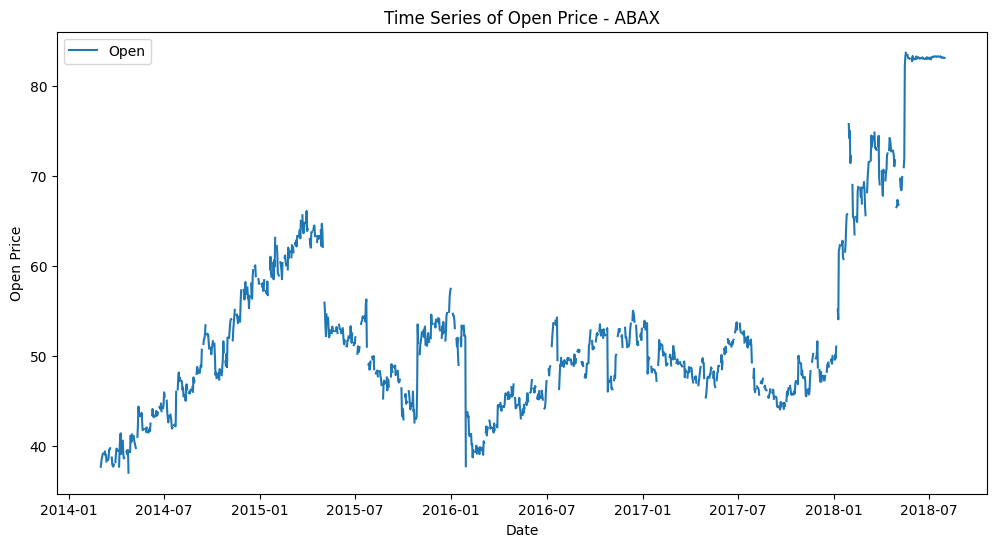

An error occurred for ABAX: This function does not handle missing values


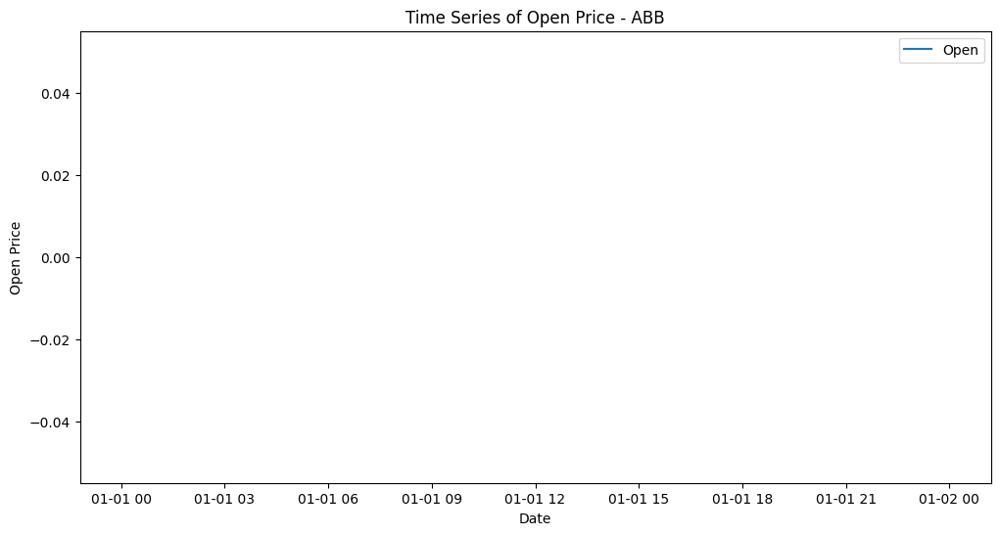

An error occurred for ABB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


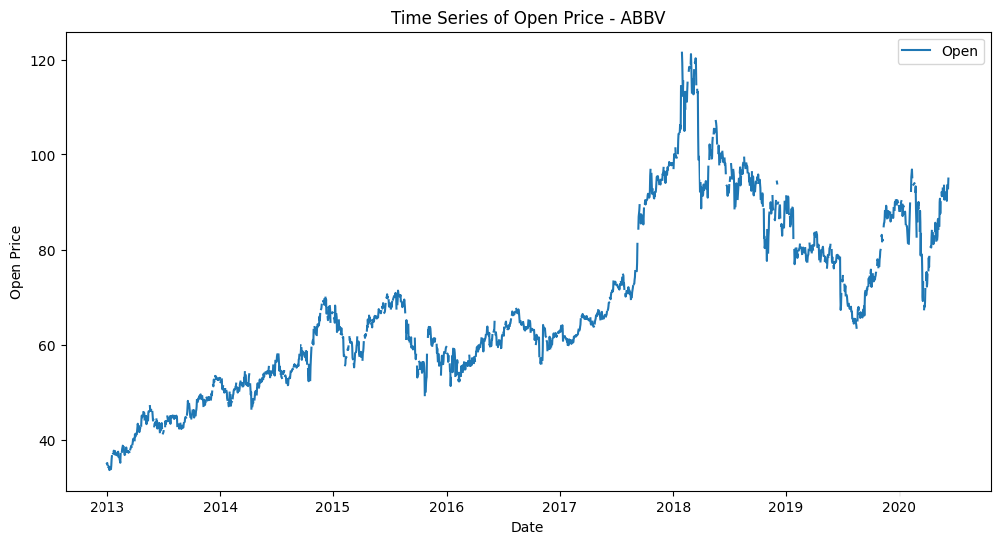

An error occurred for ABBV: This function does not handle missing values


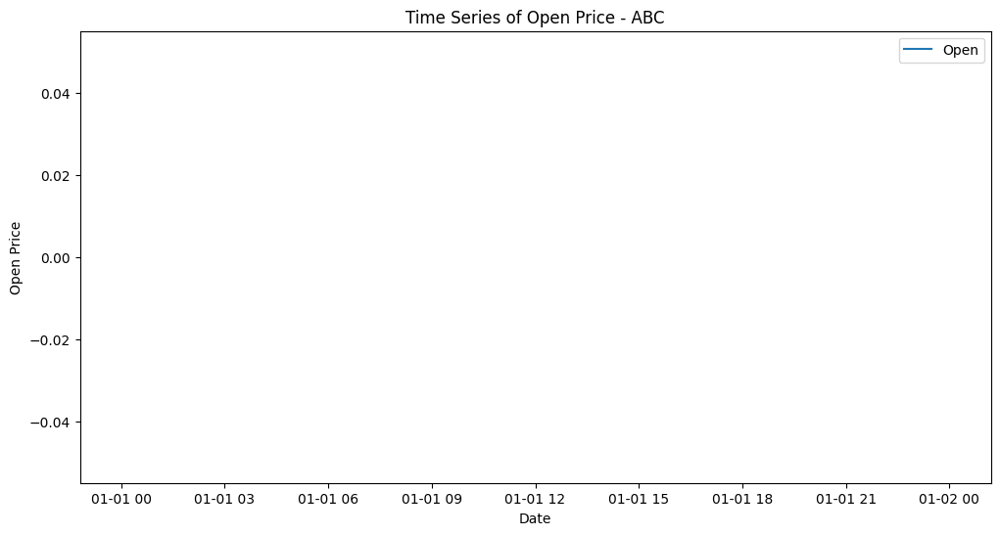

An error occurred for ABC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


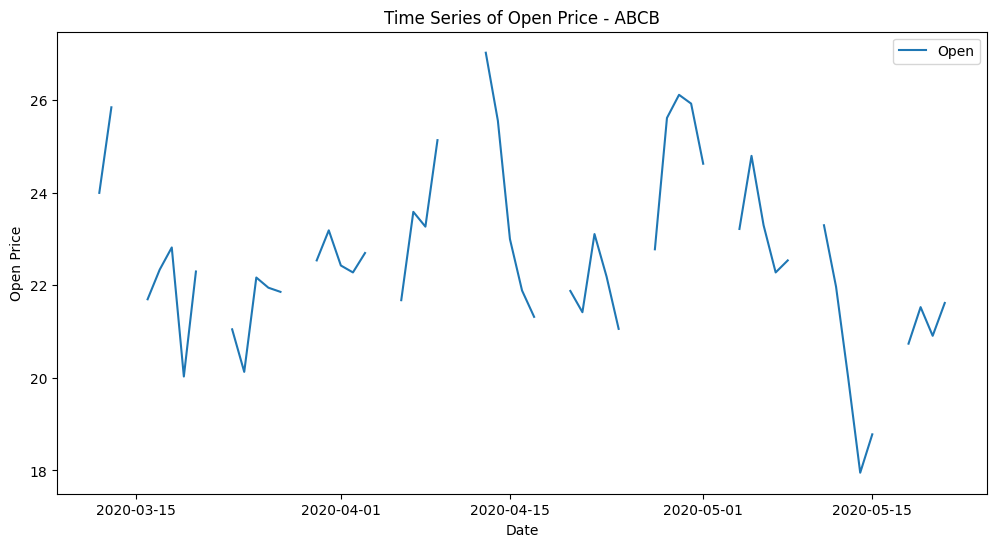

An error occurred for ABCB: This function does not handle missing values


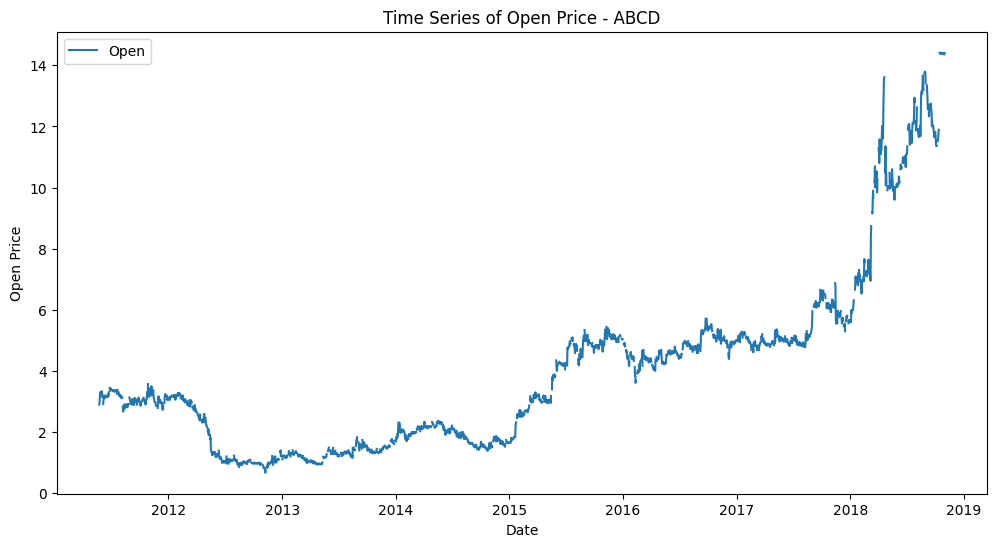

An error occurred for ABCD: This function does not handle missing values


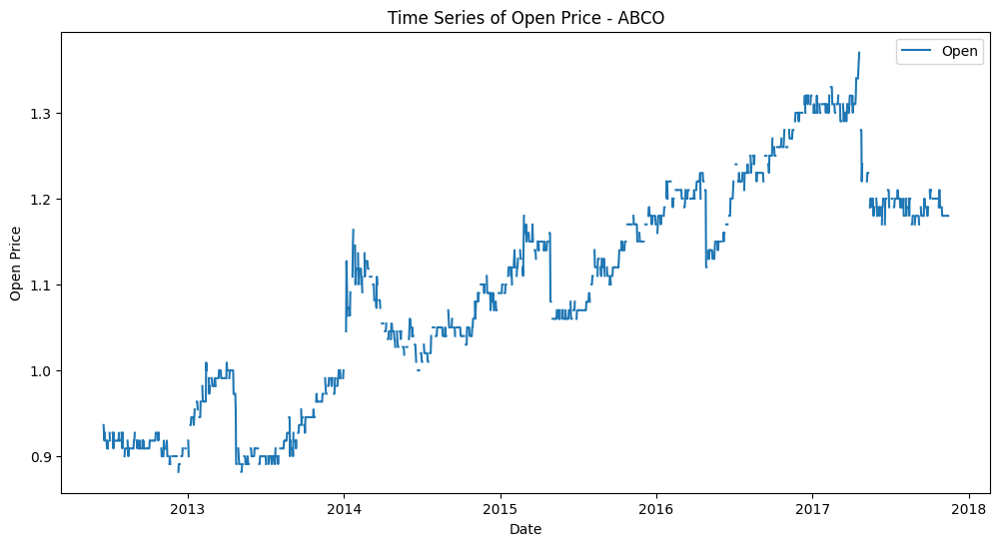

An error occurred for ABCO: This function does not handle missing values


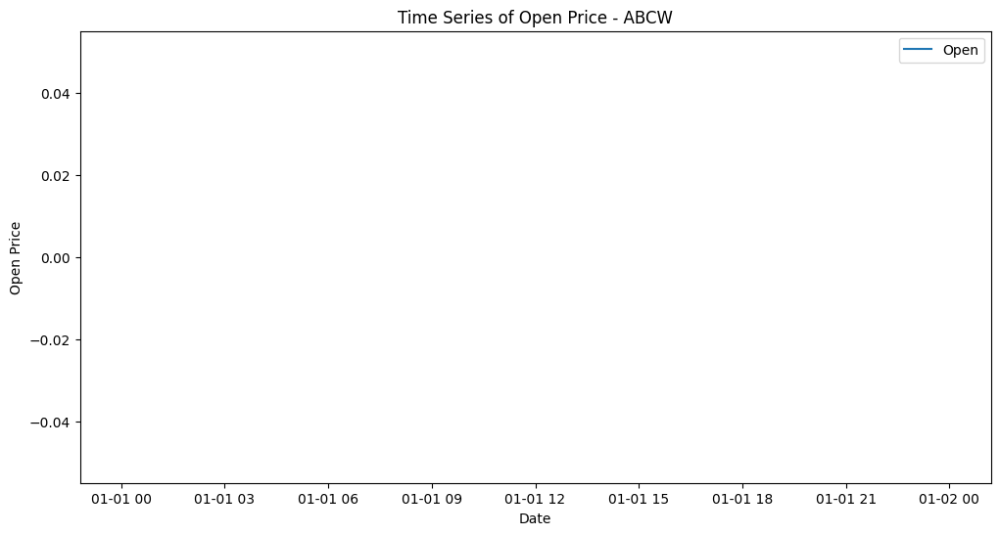

An error occurred for ABCW: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


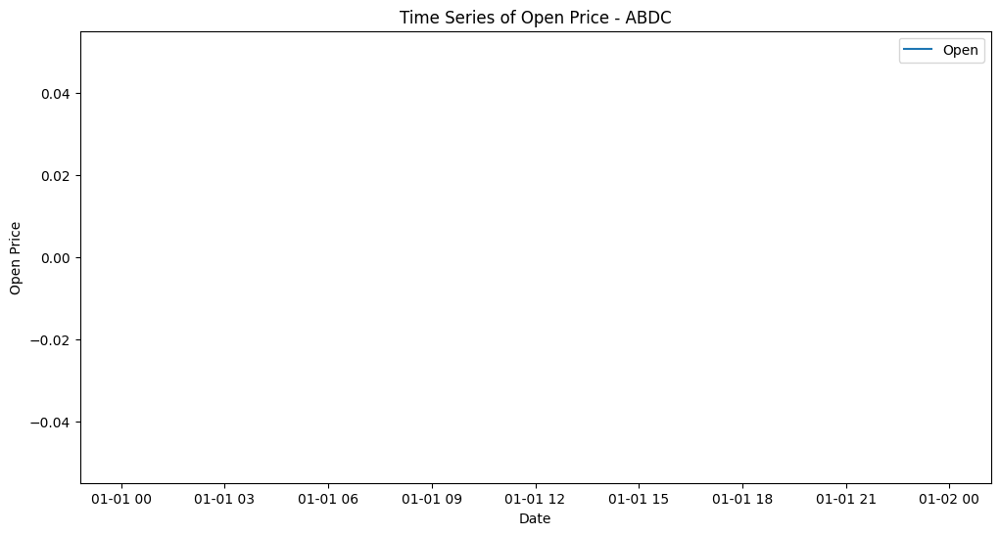

An error occurred for ABDC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


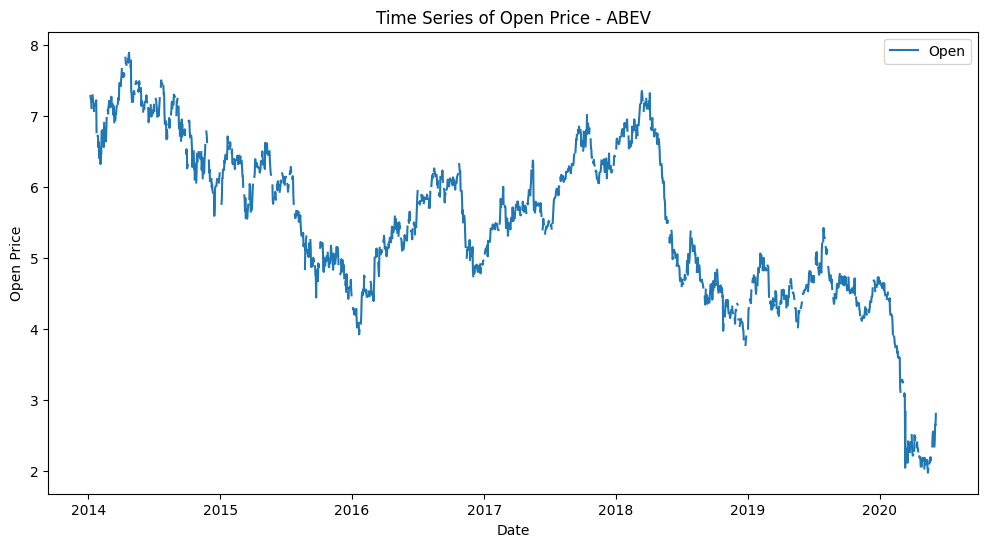

An error occurred for ABEV: This function does not handle missing values


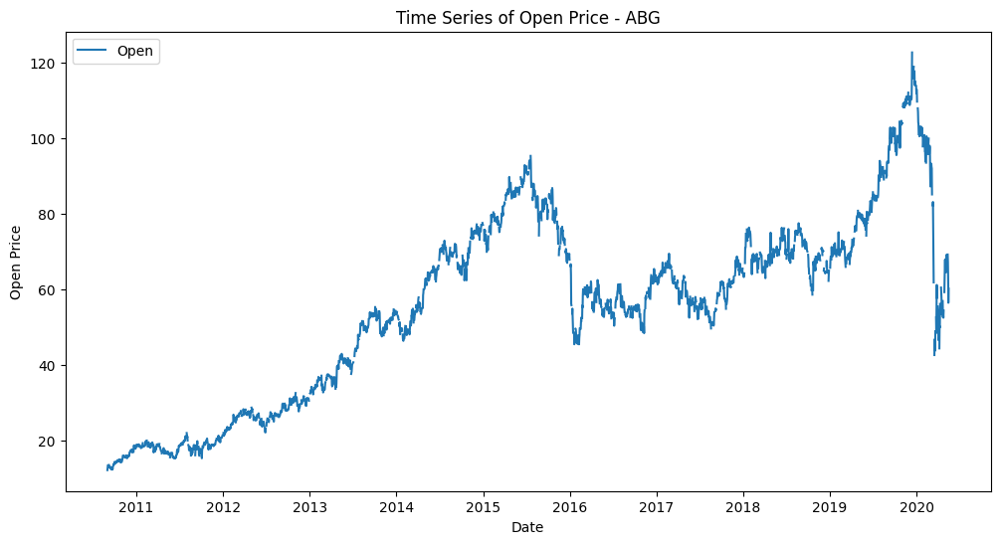

An error occurred for ABG: This function does not handle missing values


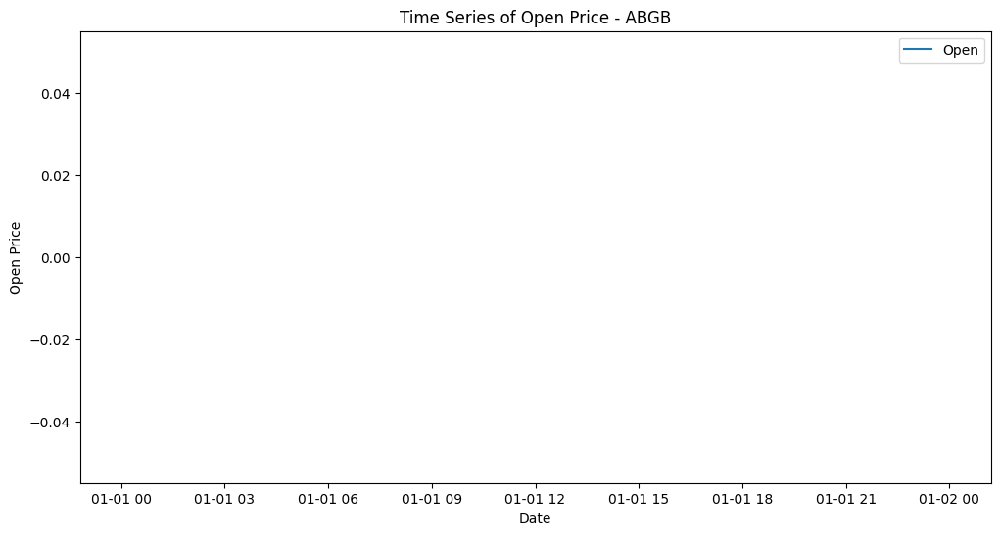

An error occurred for ABGB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


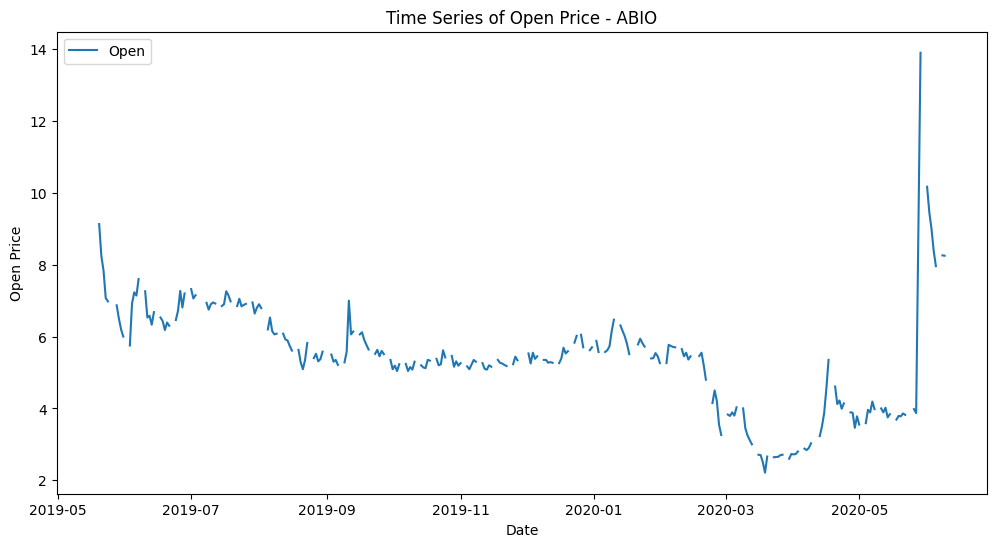

An error occurred for ABIO: This function does not handle missing values


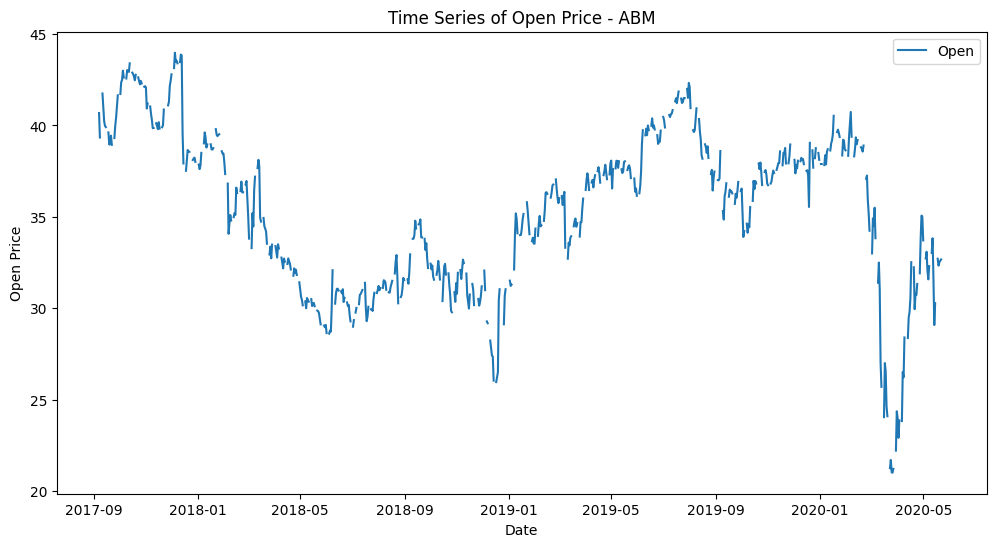

An error occurred for ABM: This function does not handle missing values


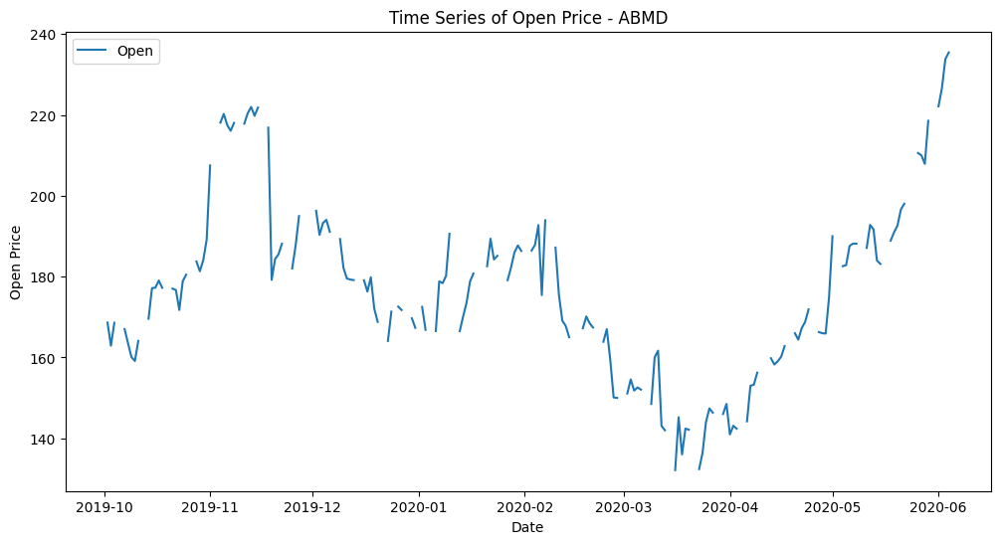

An error occurred for ABMD: This function does not handle missing values


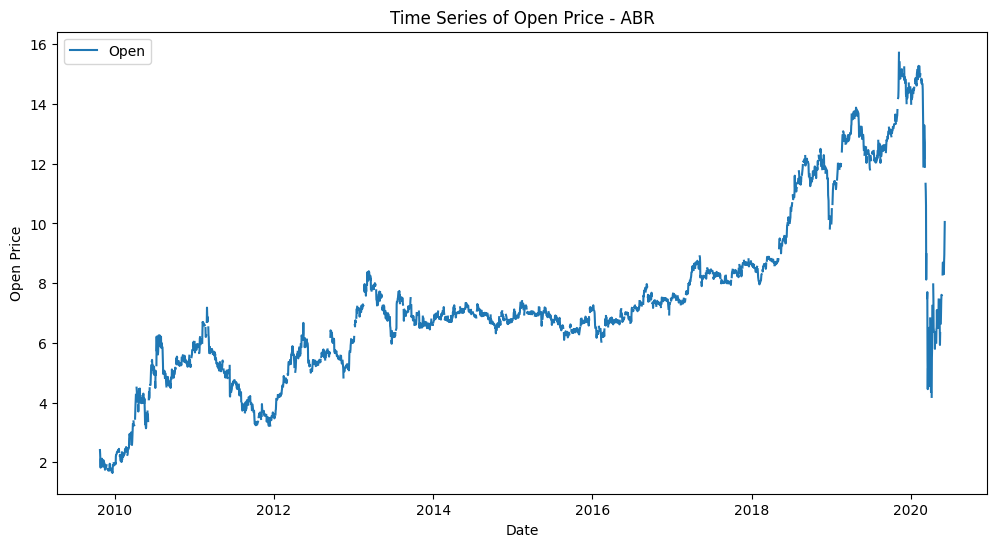

An error occurred for ABR: This function does not handle missing values


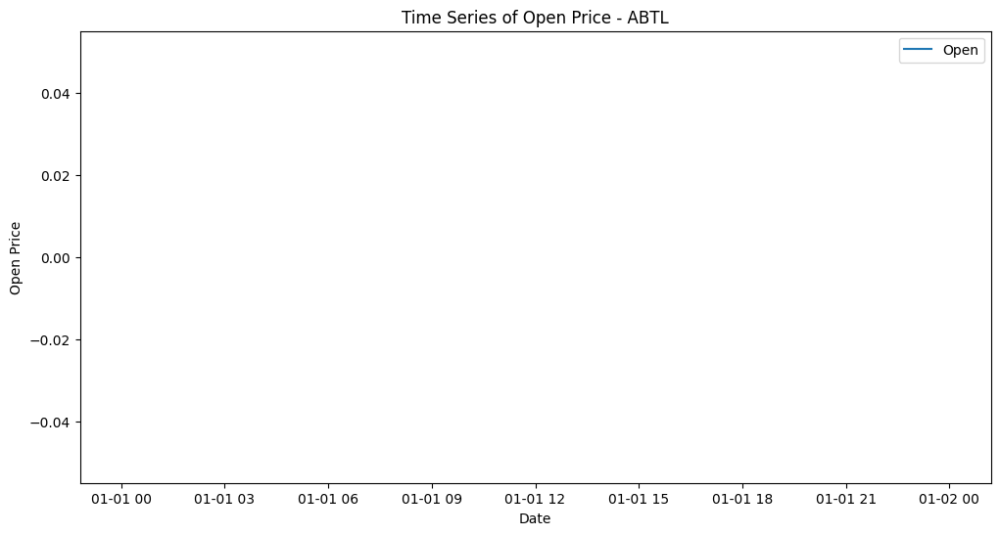

An error occurred for ABTL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


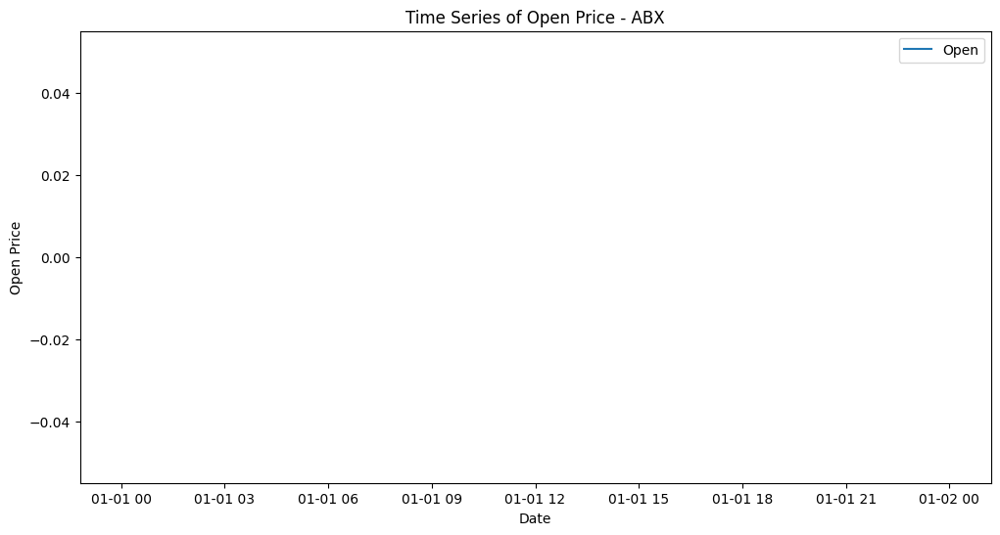

An error occurred for ABX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


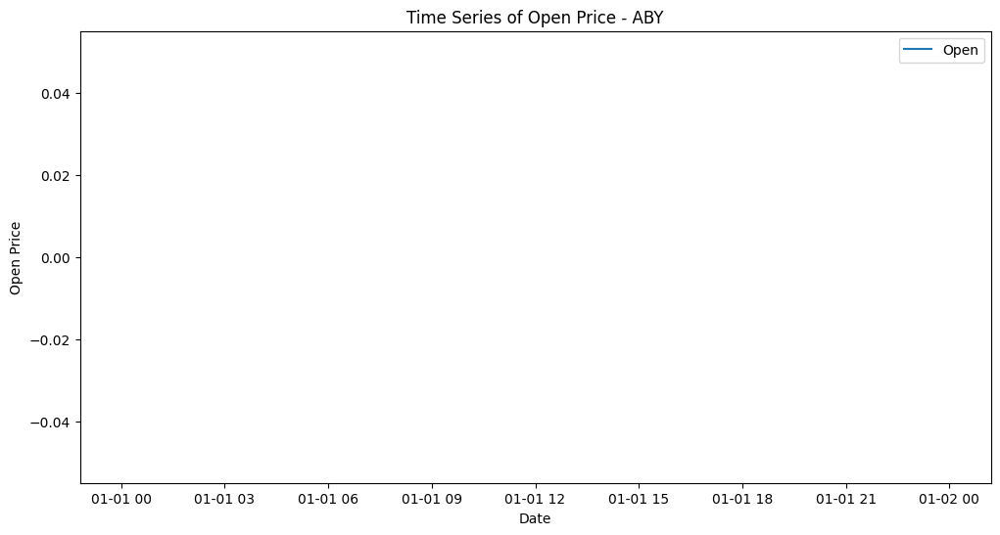

An error occurred for ABY: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


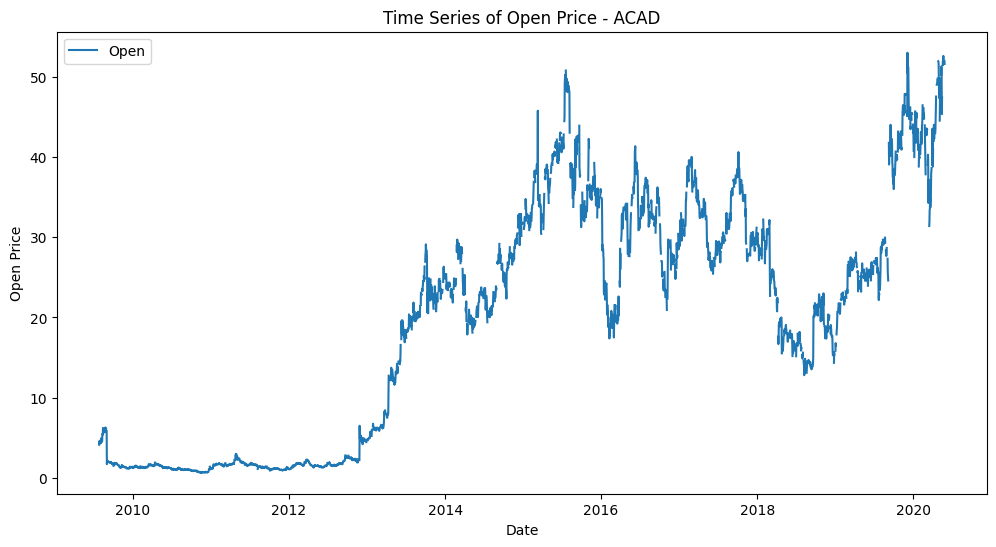

An error occurred for ACAD: This function does not handle missing values


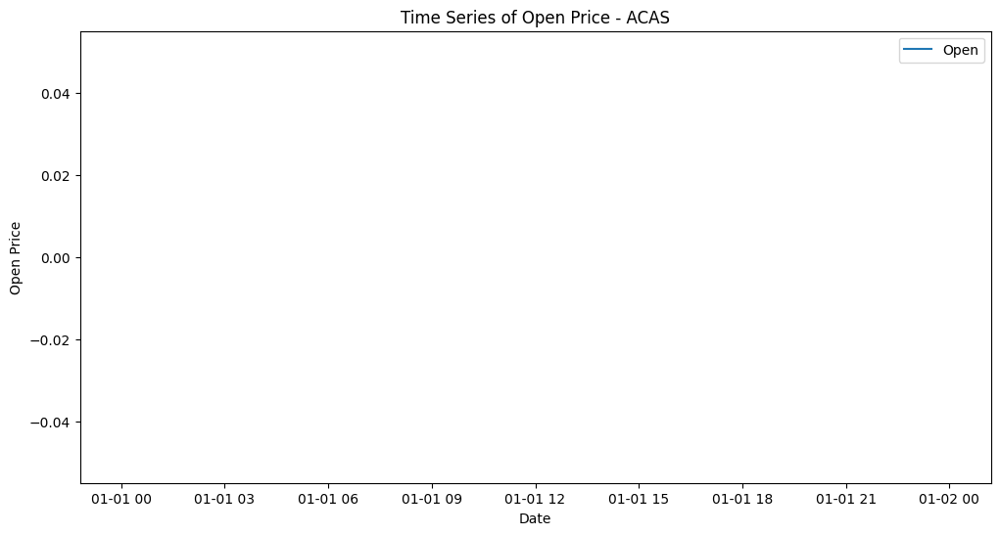

An error occurred for ACAS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


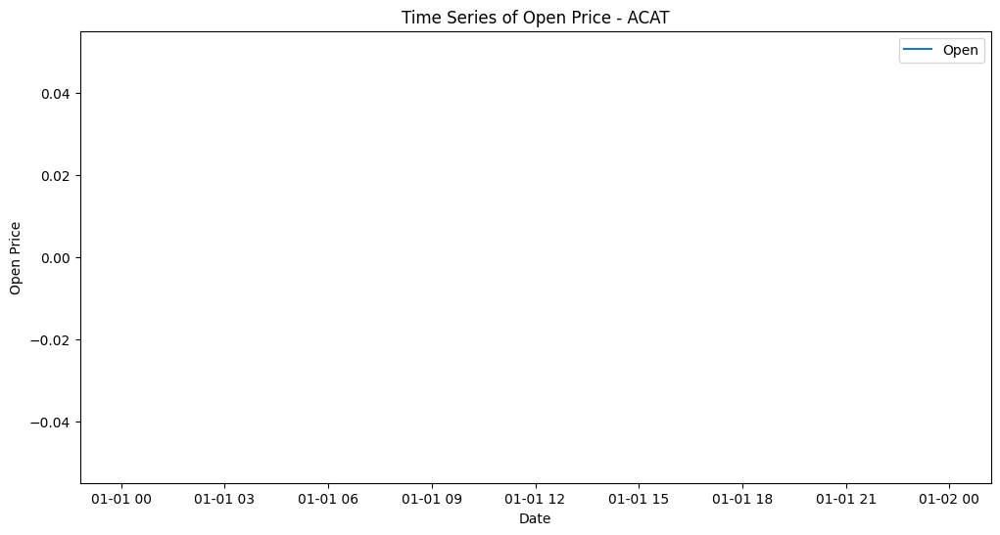

An error occurred for ACAT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


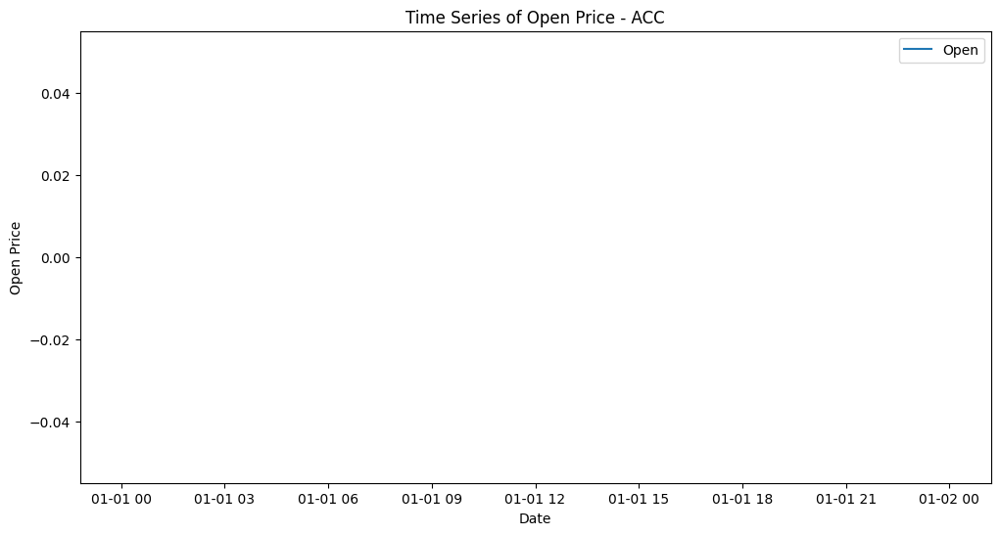

An error occurred for ACC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


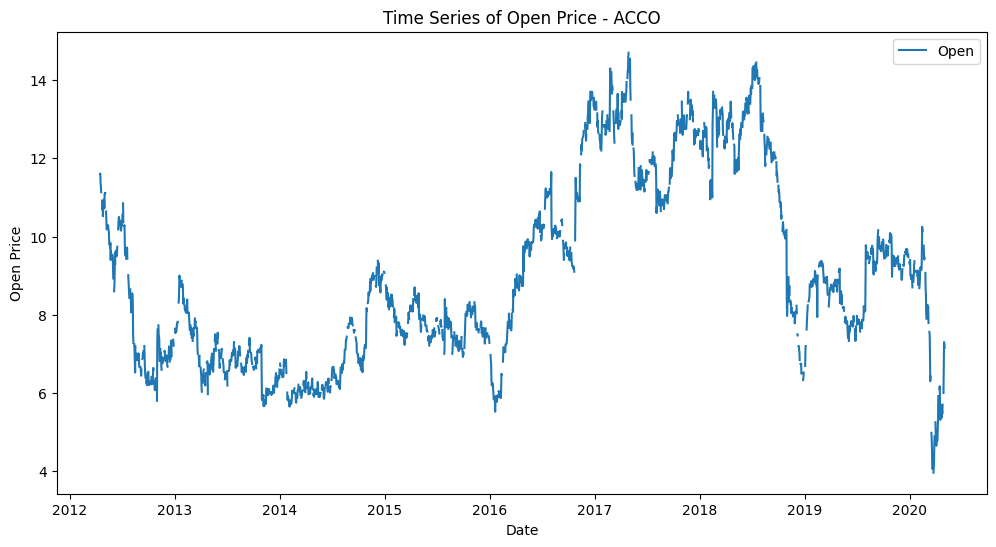

An error occurred for ACCO: This function does not handle missing values


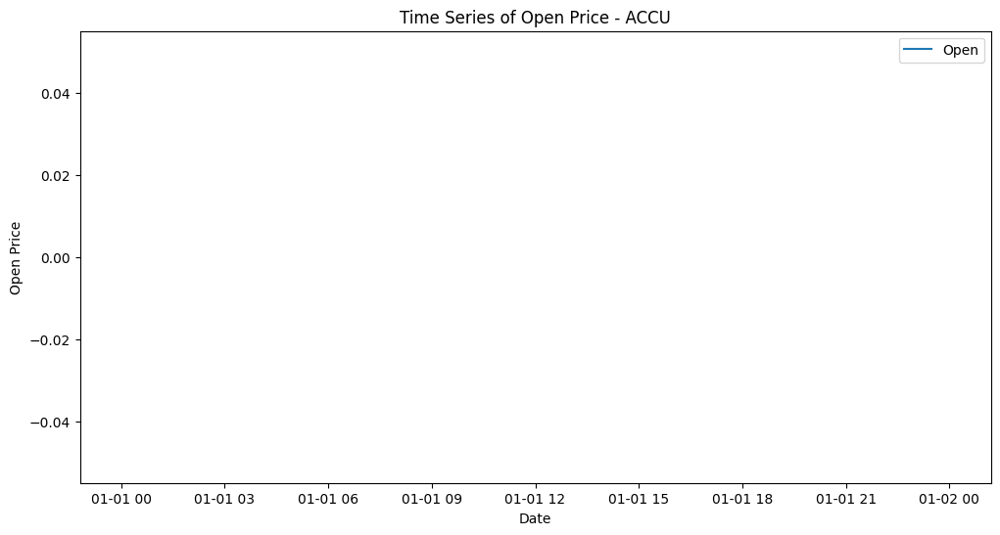

An error occurred for ACCU: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


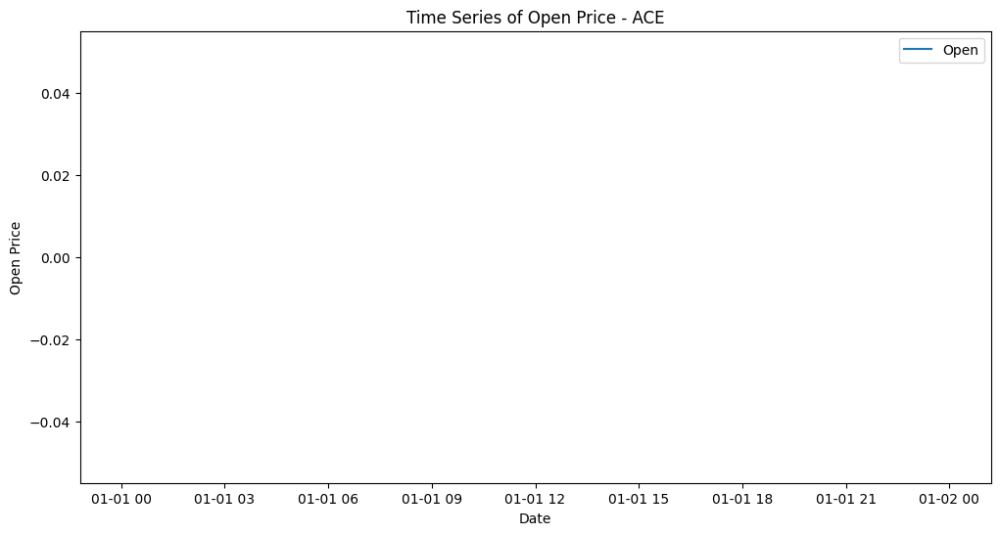

An error occurred for ACE: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


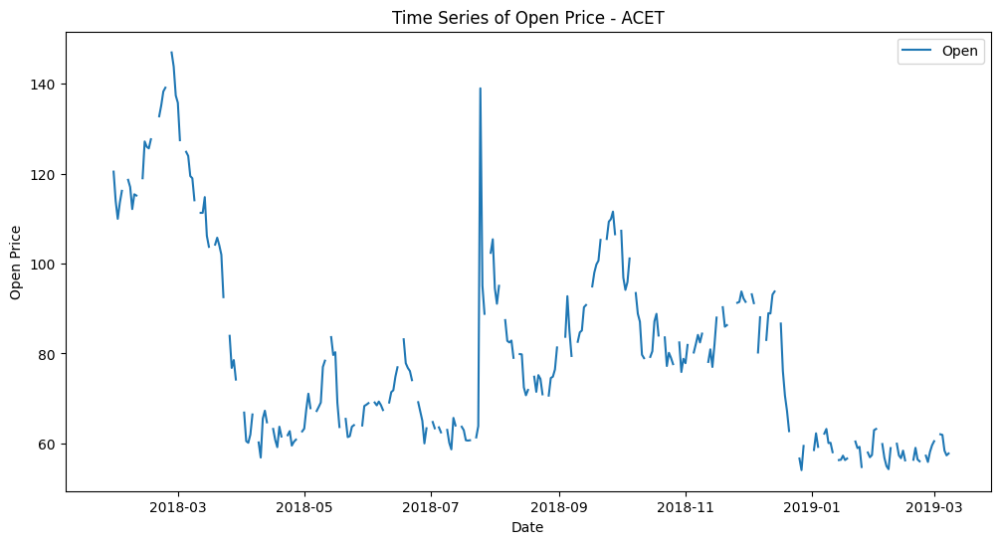

An error occurred for ACET: This function does not handle missing values


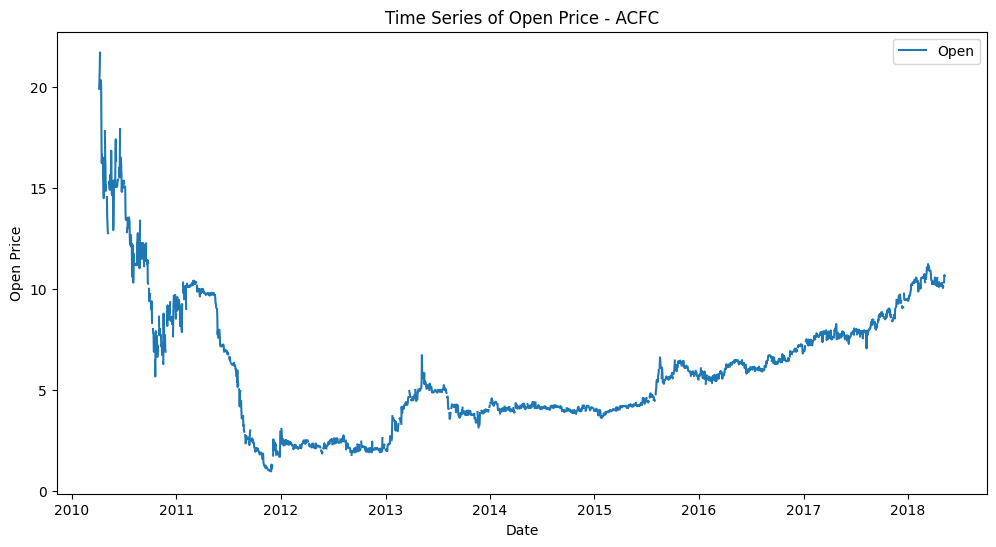

An error occurred for ACFC: This function does not handle missing values


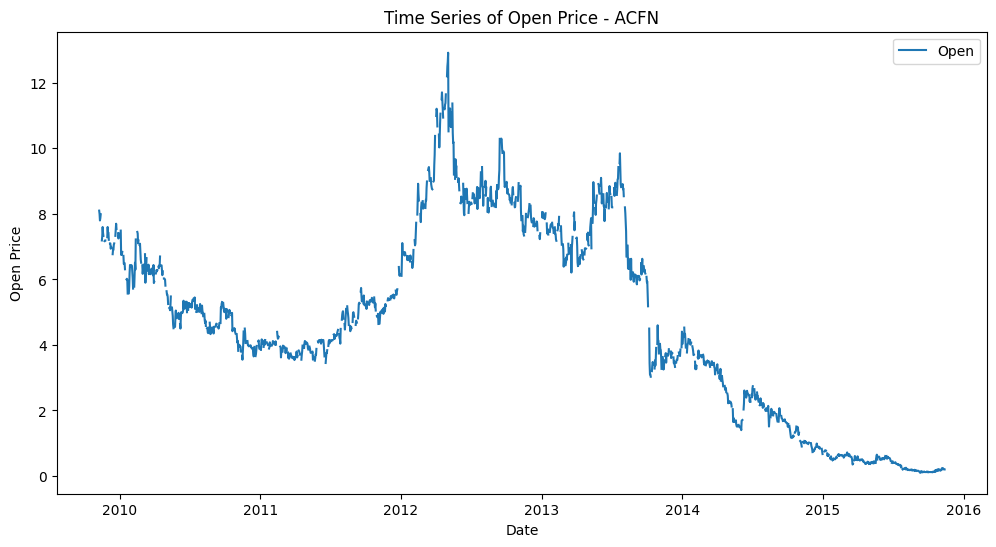

An error occurred for ACFN: This function does not handle missing values


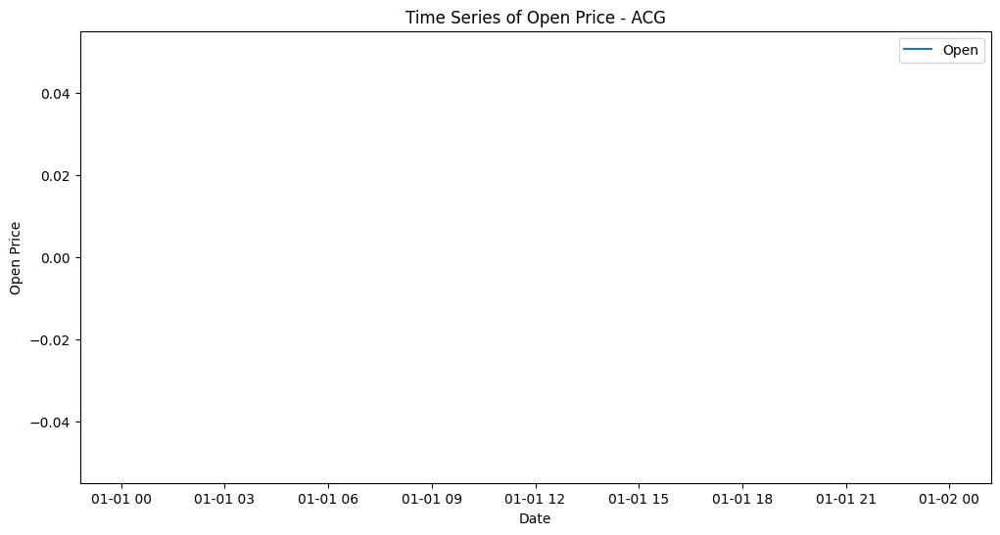

An error occurred for ACG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


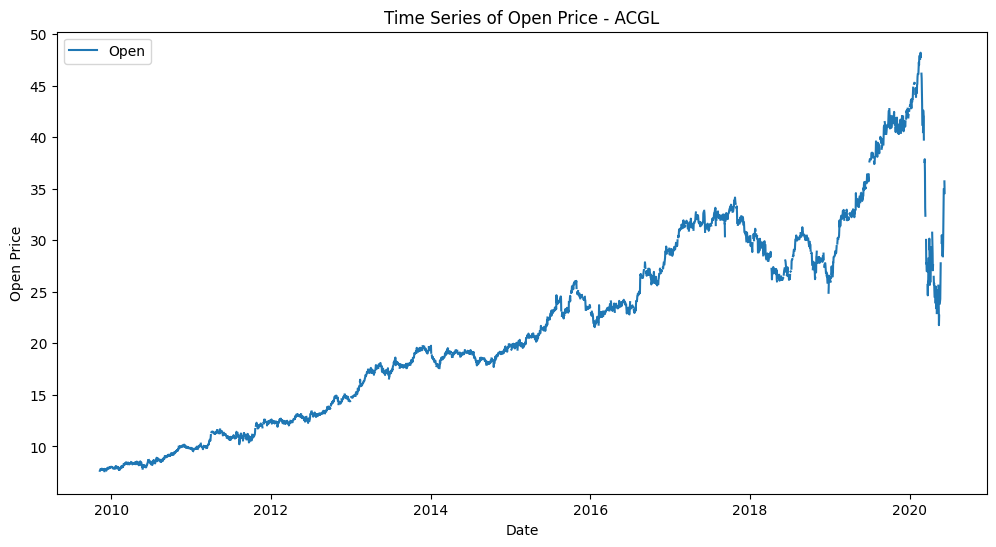

An error occurred for ACGL: This function does not handle missing values


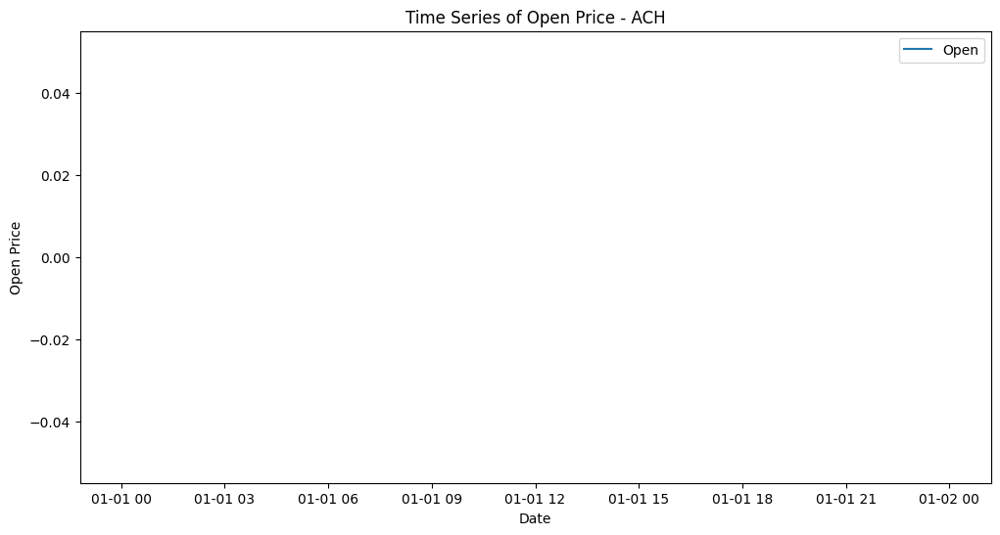

An error occurred for ACH: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


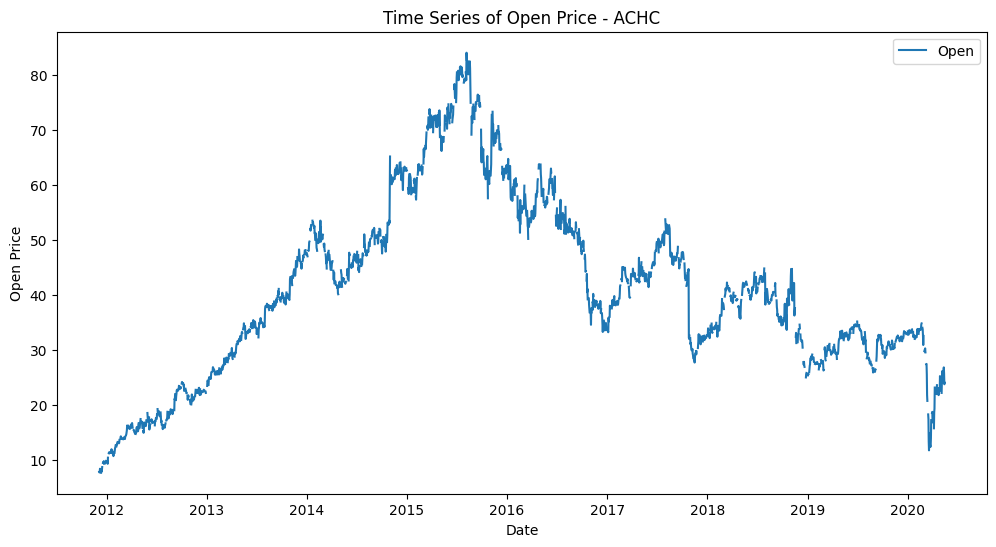

An error occurred for ACHC: This function does not handle missing values


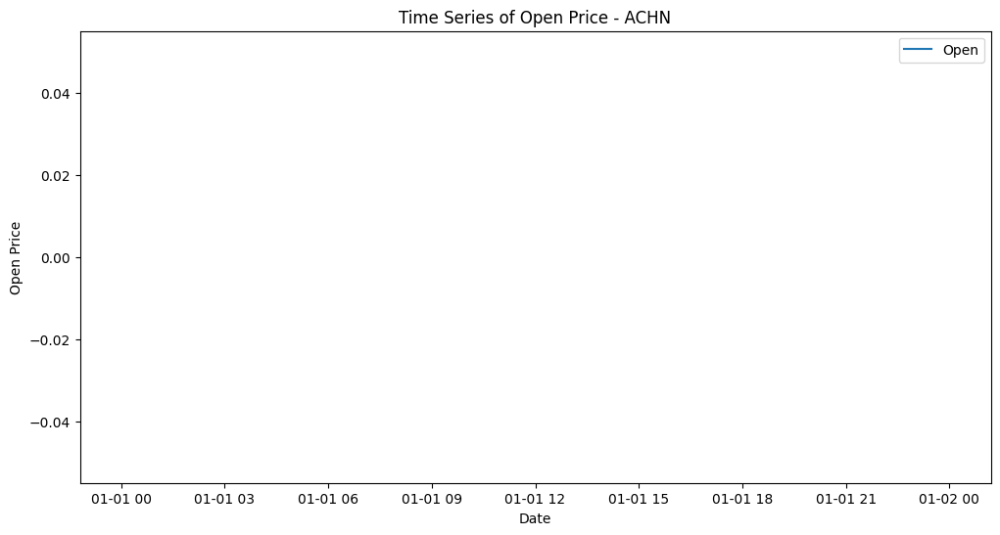

An error occurred for ACHN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


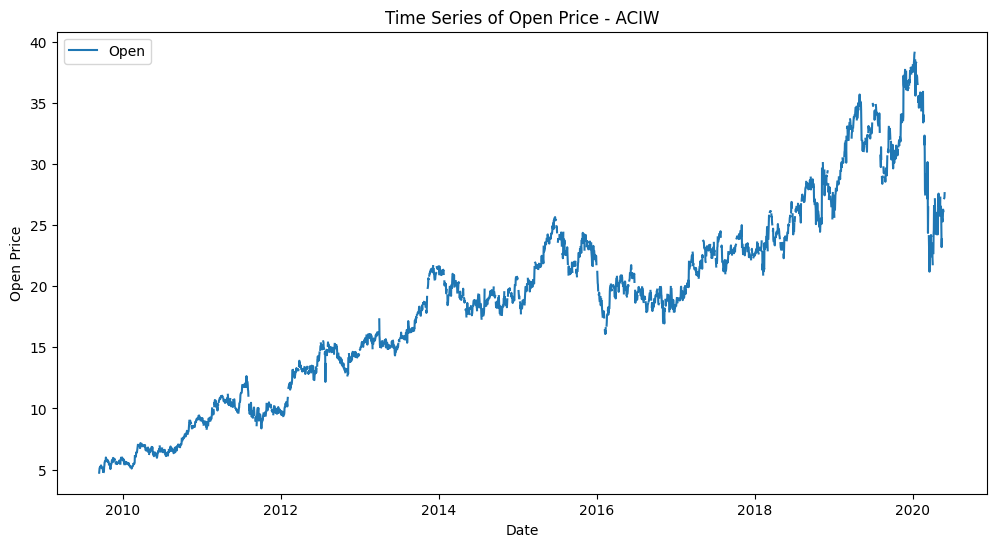

An error occurred for ACIW: This function does not handle missing values


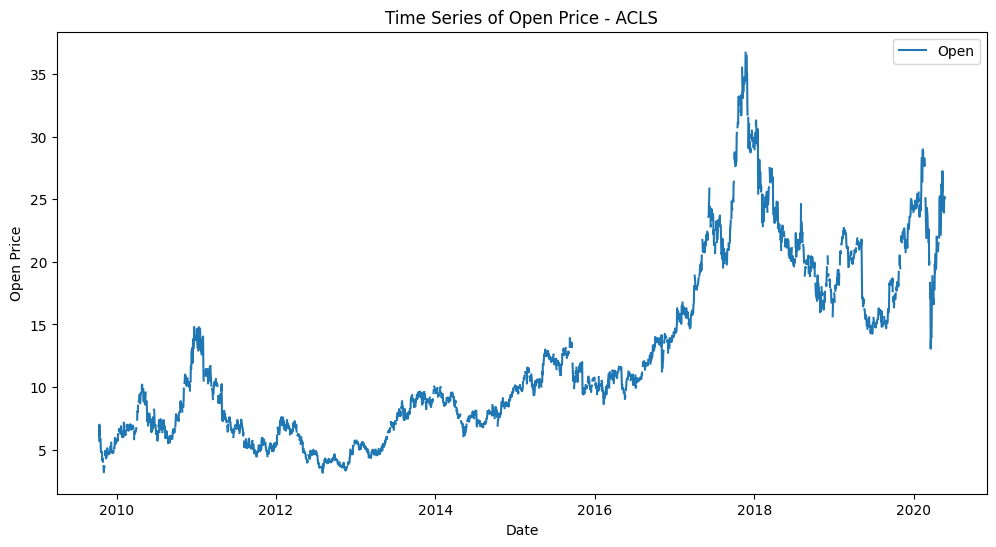

An error occurred for ACLS: This function does not handle missing values


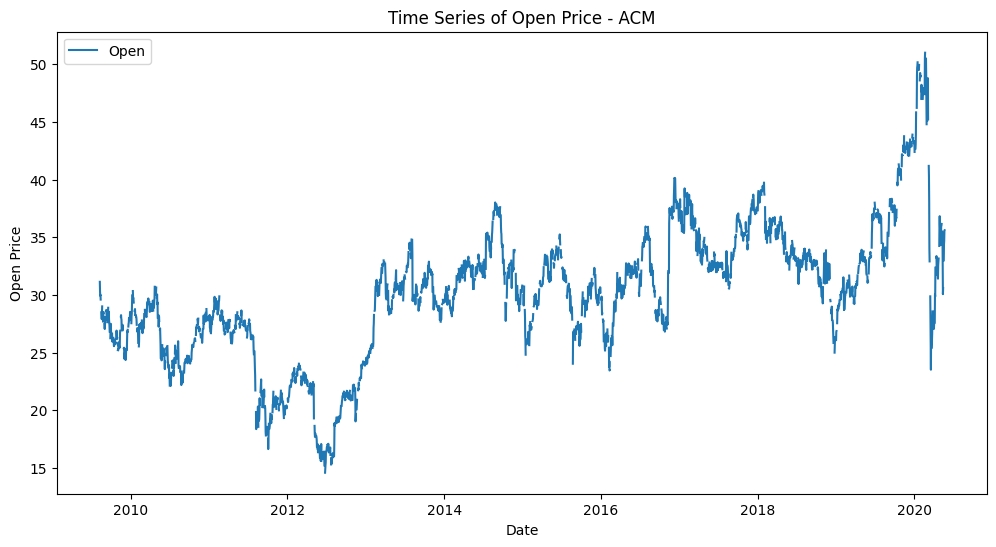

An error occurred for ACM: This function does not handle missing values


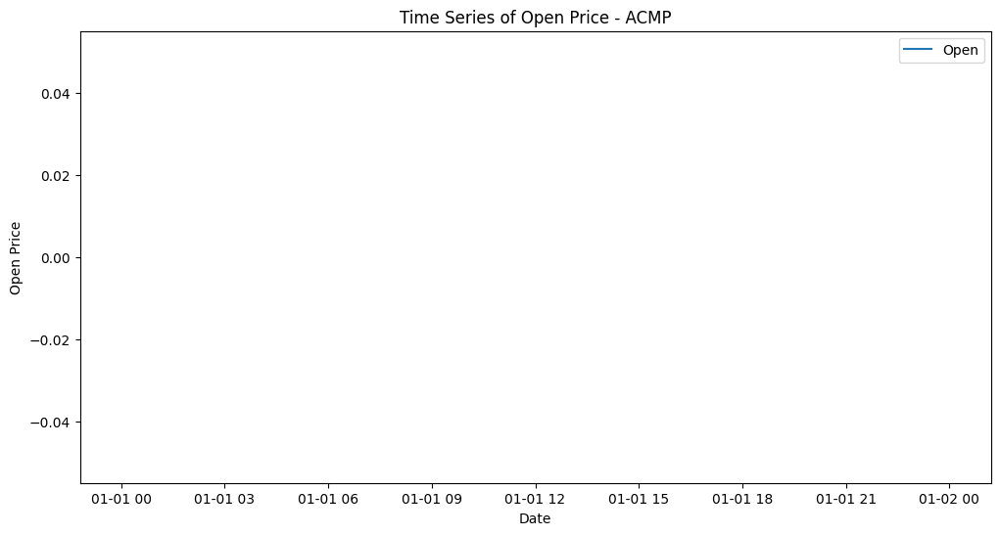

An error occurred for ACMP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


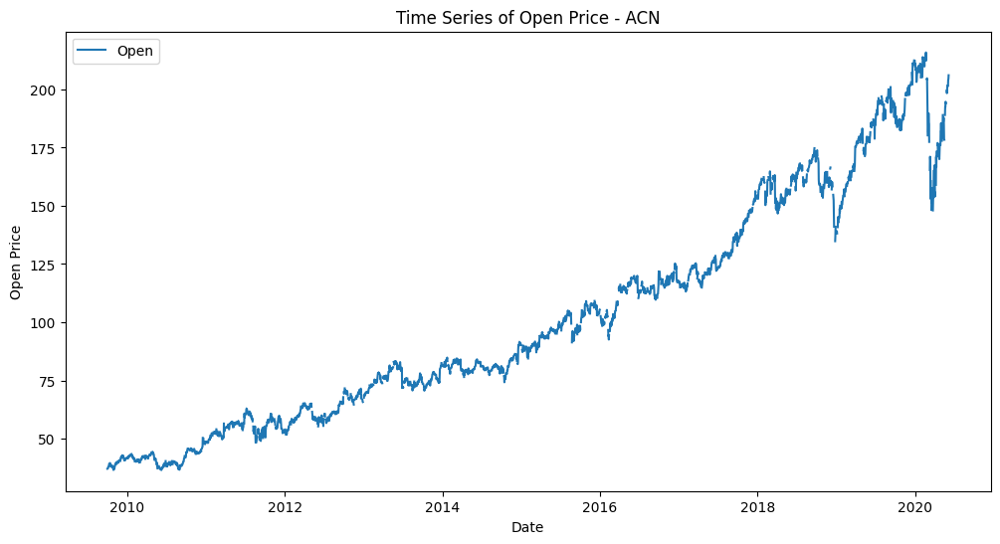

An error occurred for ACN: This function does not handle missing values


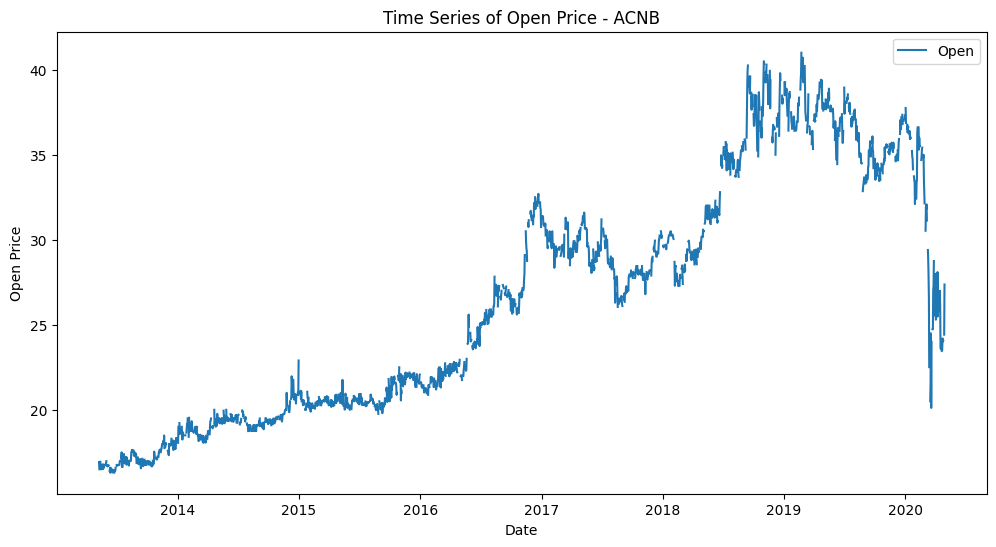

An error occurred for ACNB: This function does not handle missing values


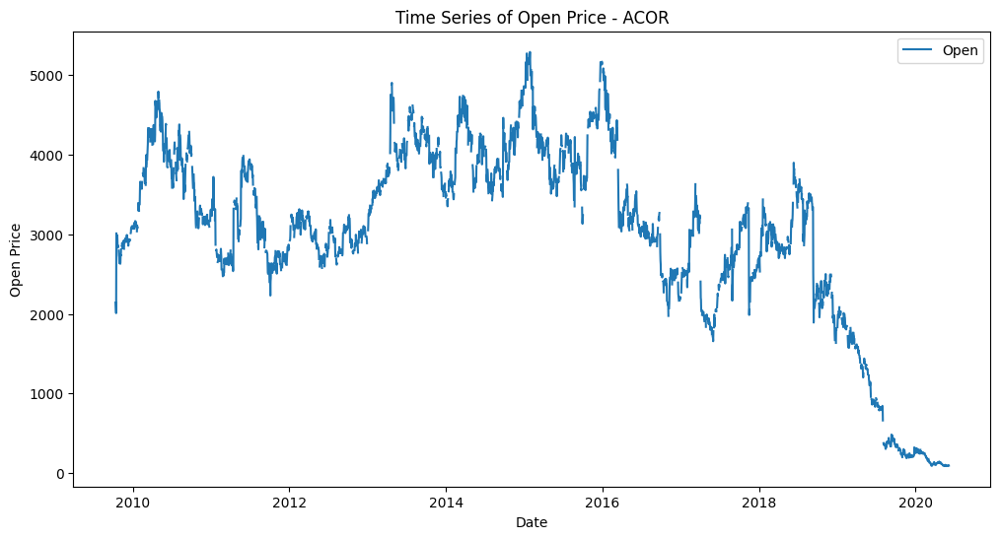

An error occurred for ACOR: This function does not handle missing values


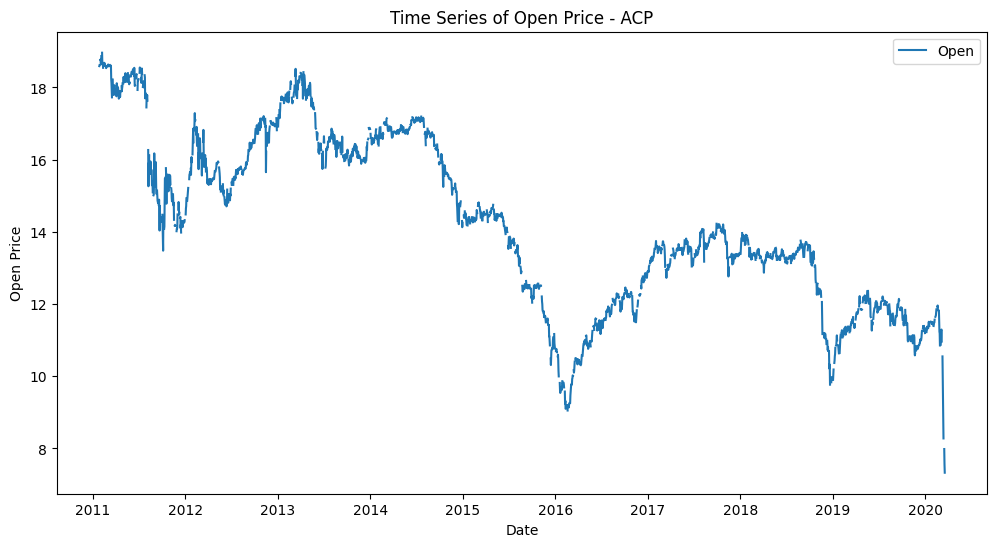

An error occurred for ACP: This function does not handle missing values


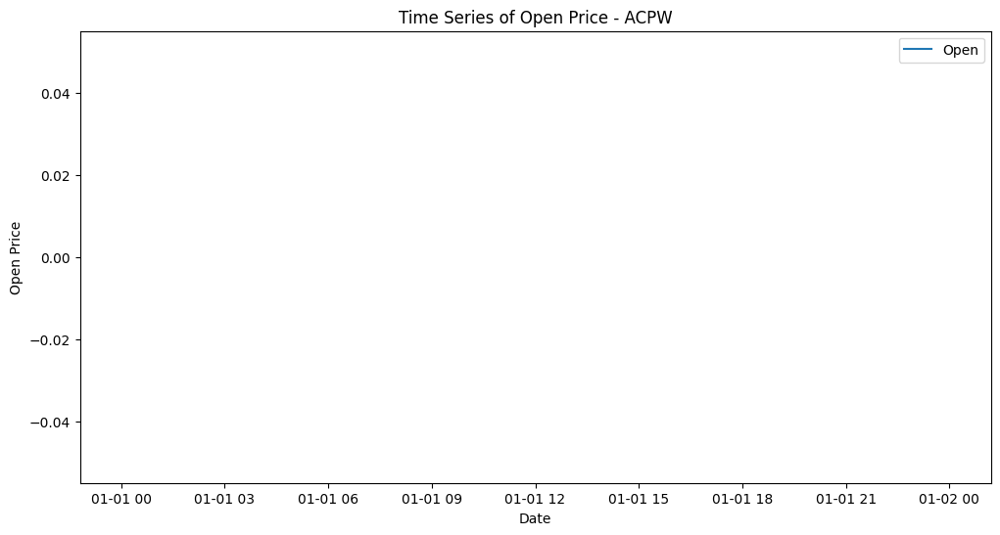

An error occurred for ACPW: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


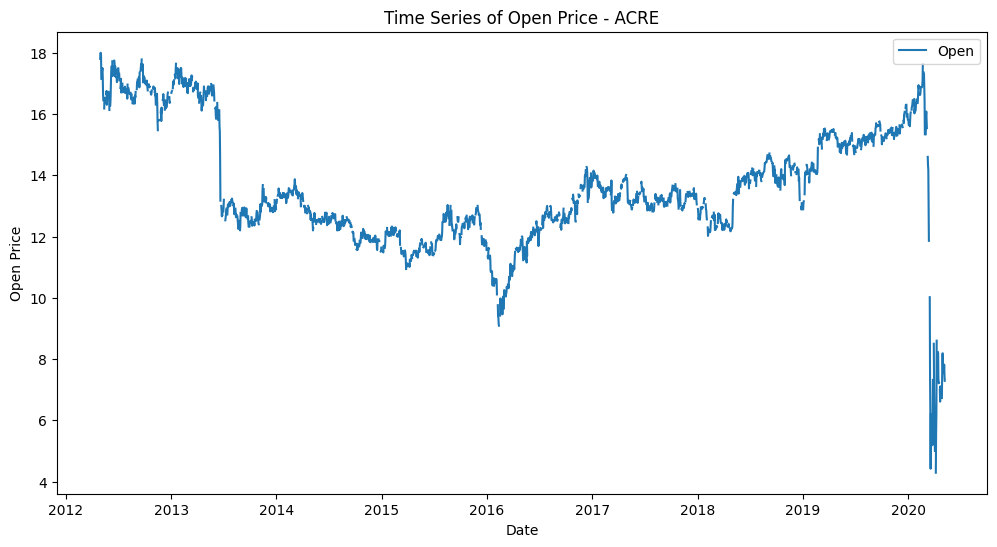

An error occurred for ACRE: This function does not handle missing values


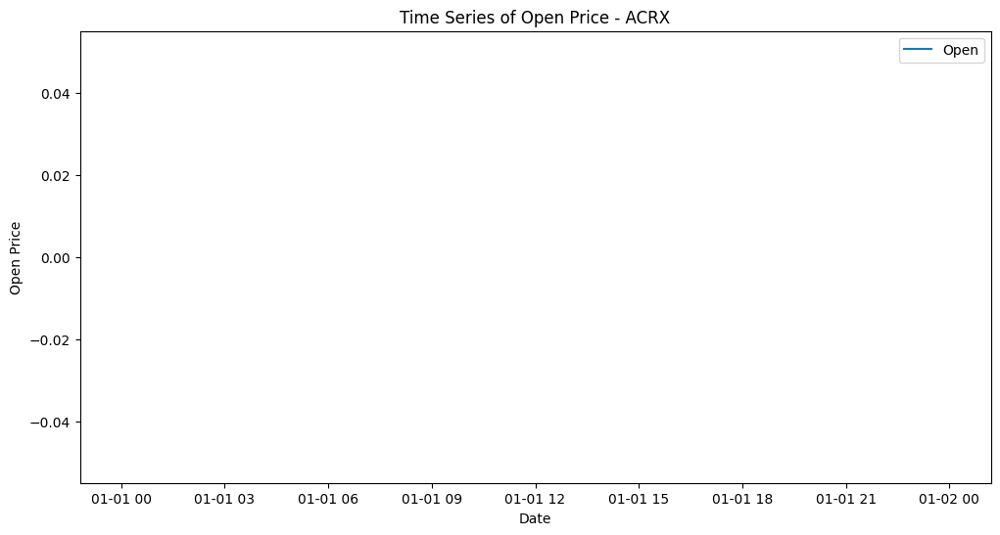

An error occurred for ACRX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


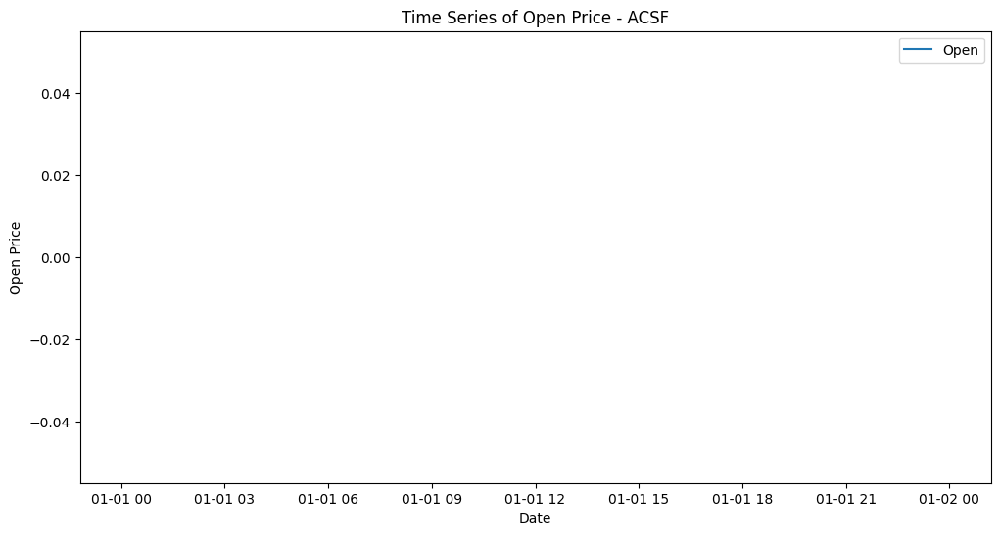

An error occurred for ACSF: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


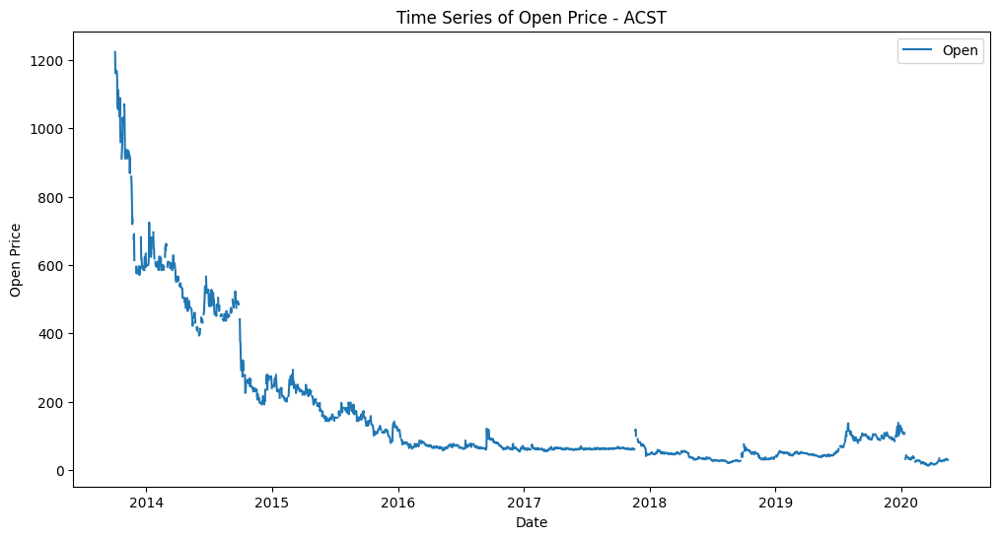

An error occurred for ACST: This function does not handle missing values


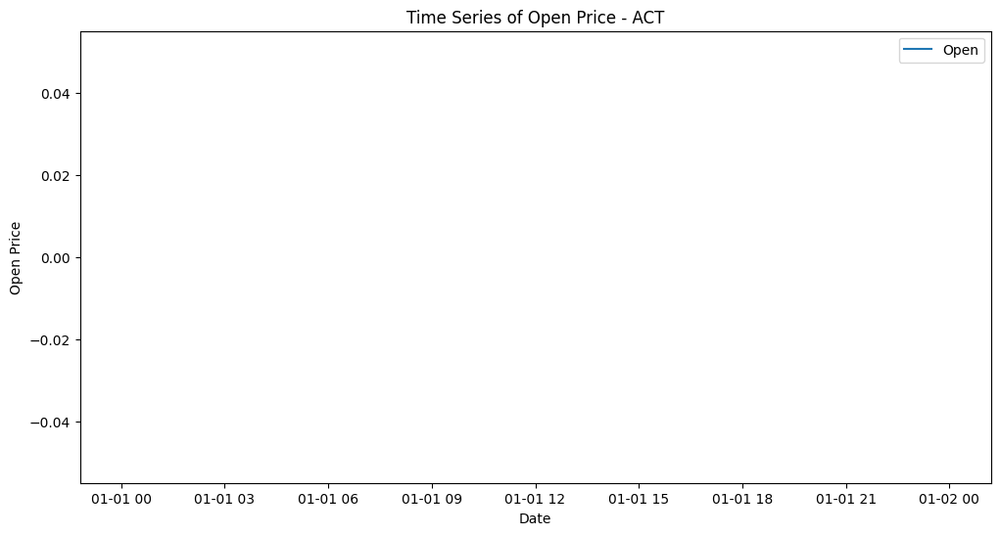

An error occurred for ACT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


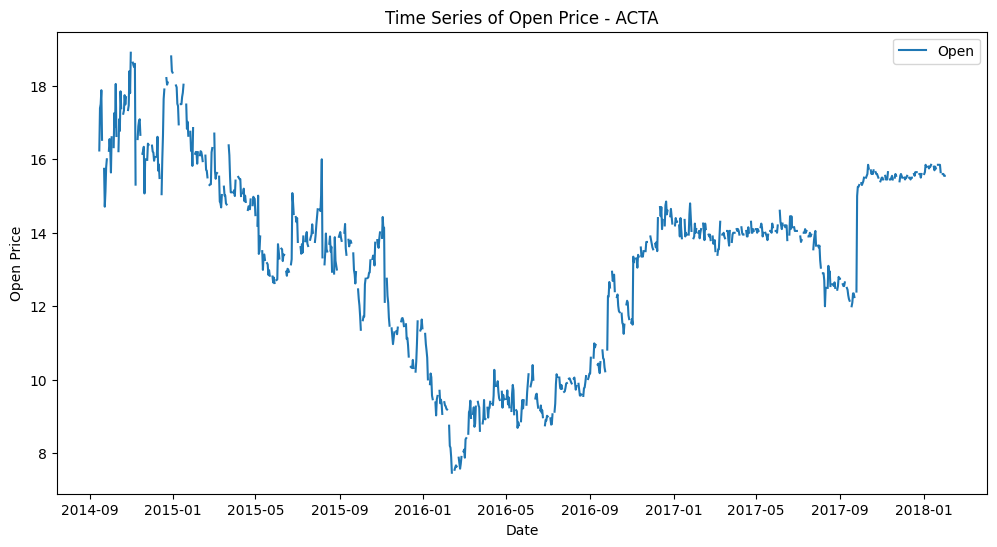

An error occurred for ACTA: This function does not handle missing values


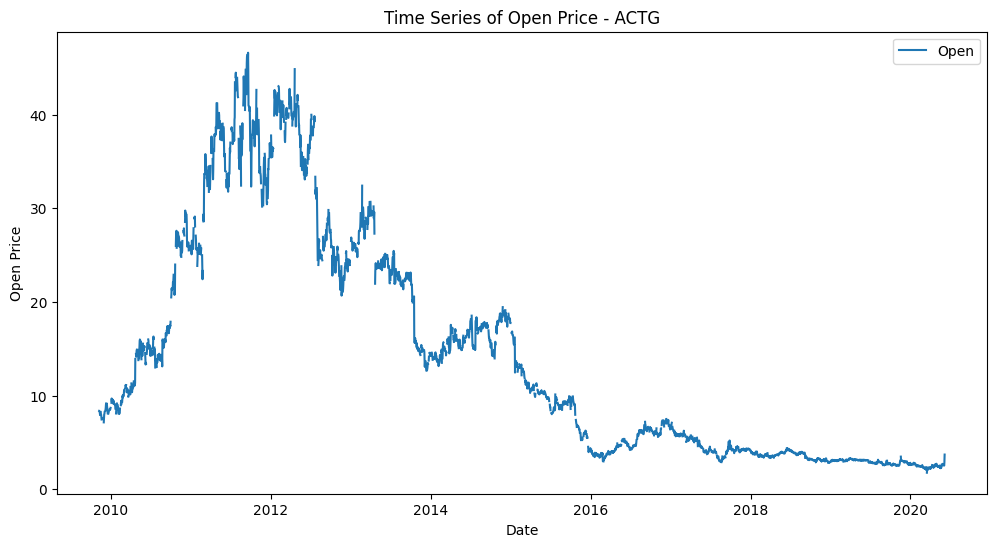

An error occurred for ACTG: This function does not handle missing values


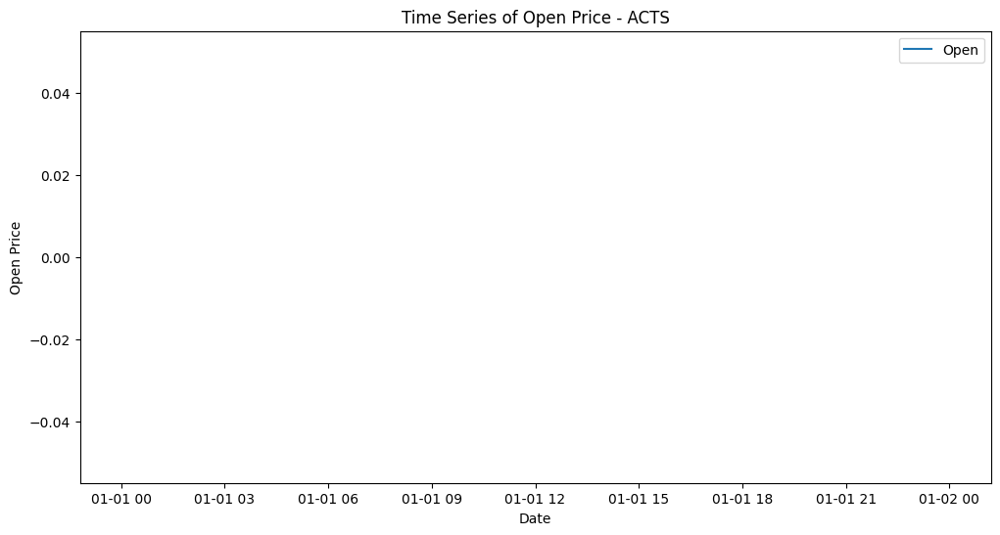

An error occurred for ACTS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


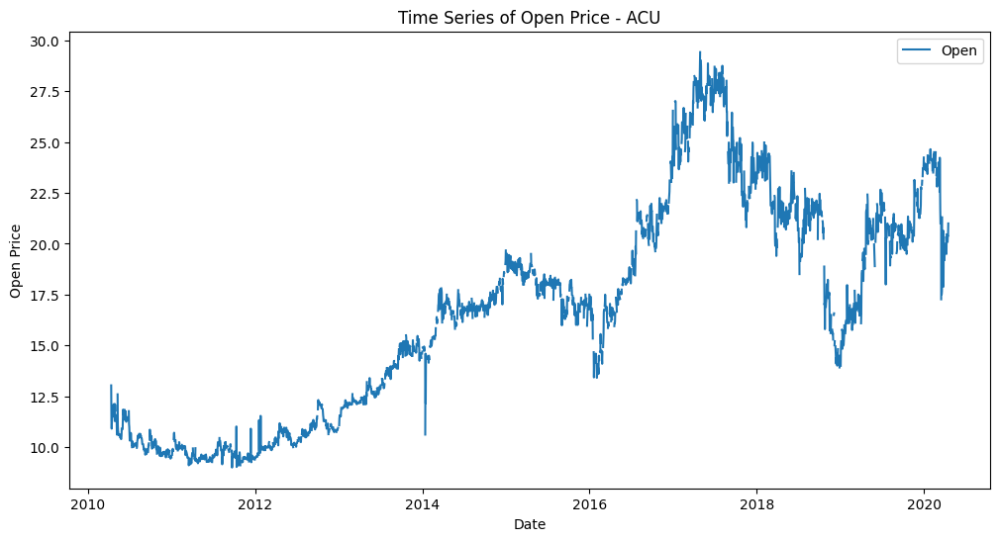

An error occurred for ACU: This function does not handle missing values


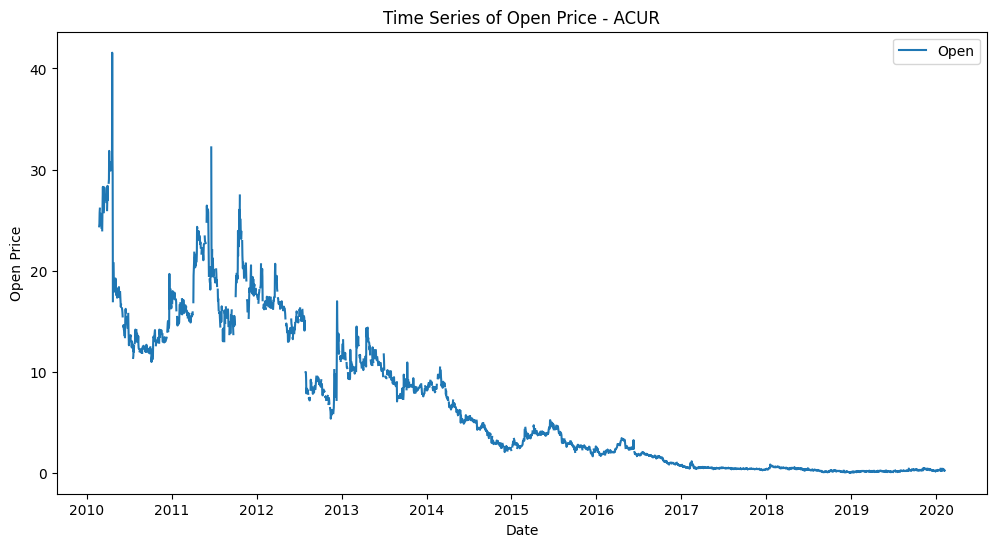

An error occurred for ACUR: This function does not handle missing values


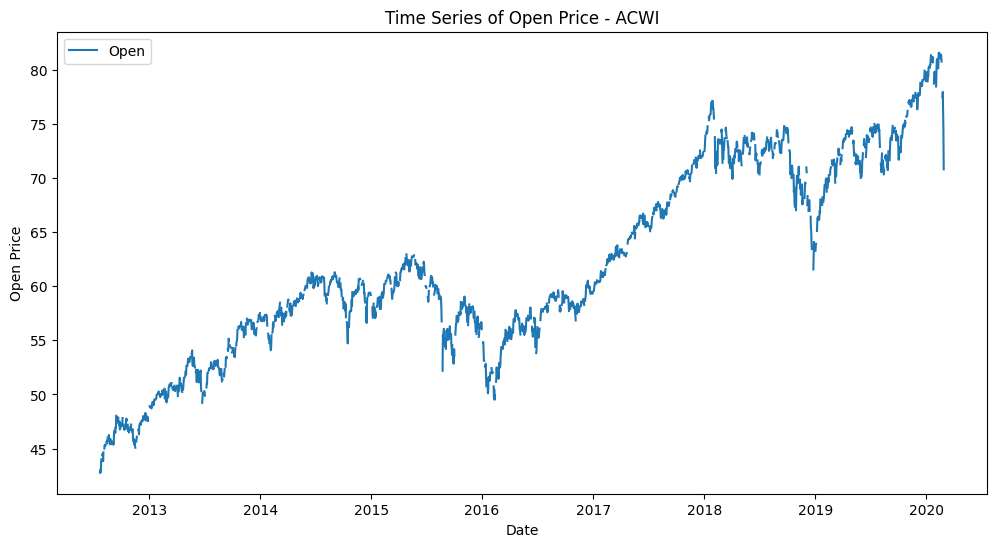

An error occurred for ACWI: This function does not handle missing values


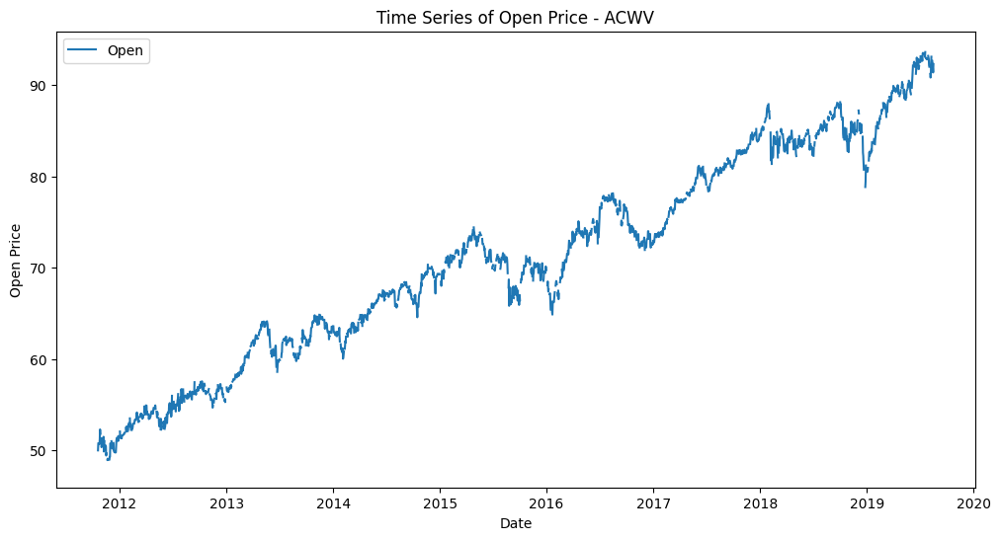

An error occurred for ACWV: This function does not handle missing values


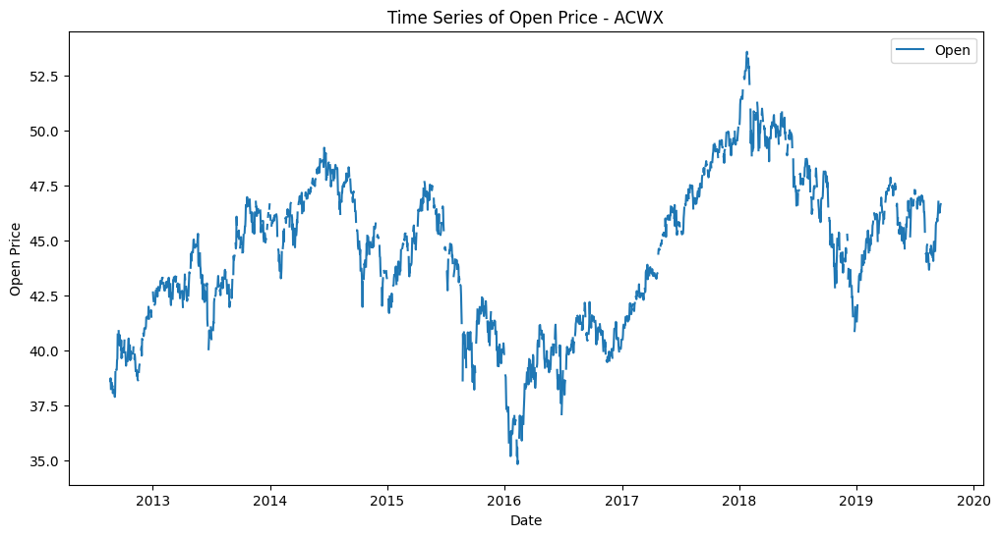

An error occurred for ACWX: This function does not handle missing values


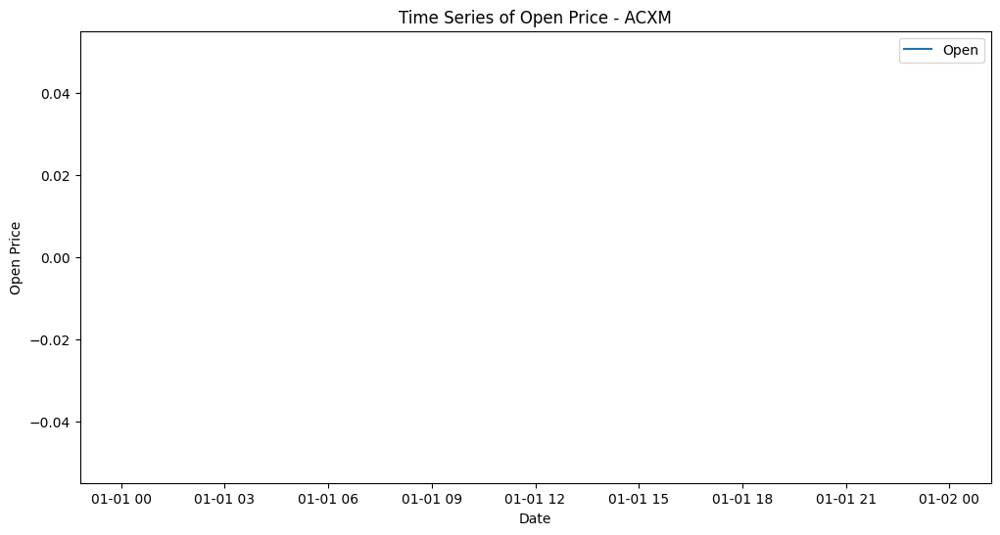

An error occurred for ACXM: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


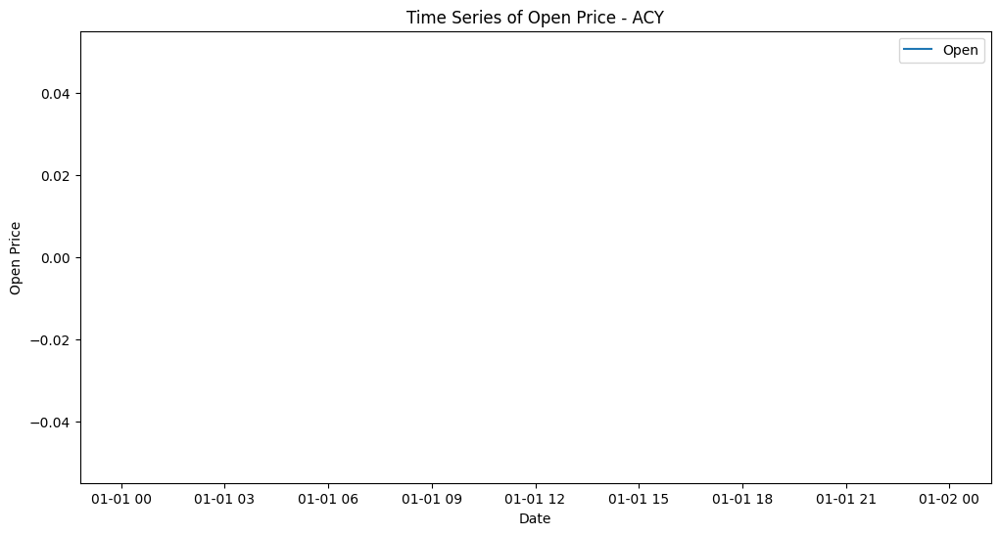

An error occurred for ACY: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


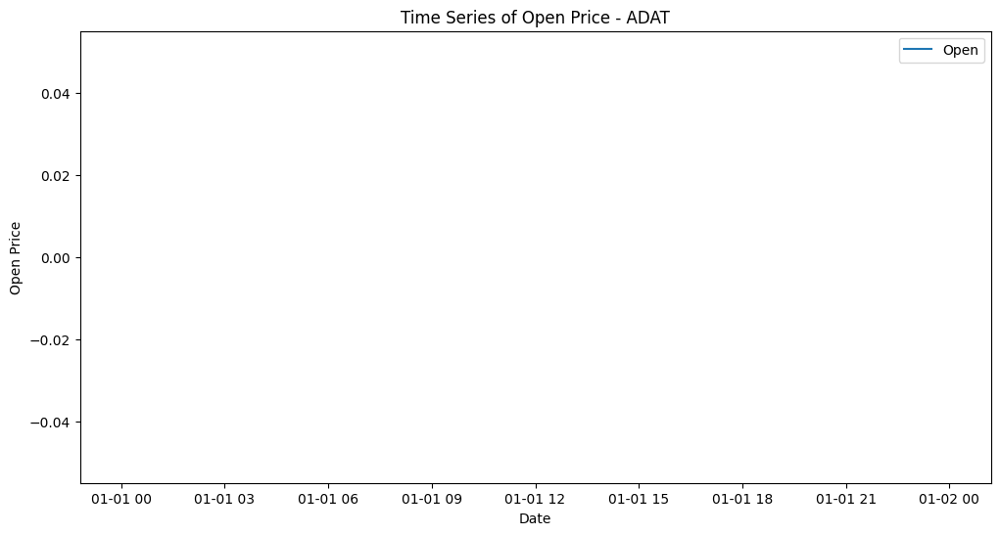

An error occurred for ADAT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


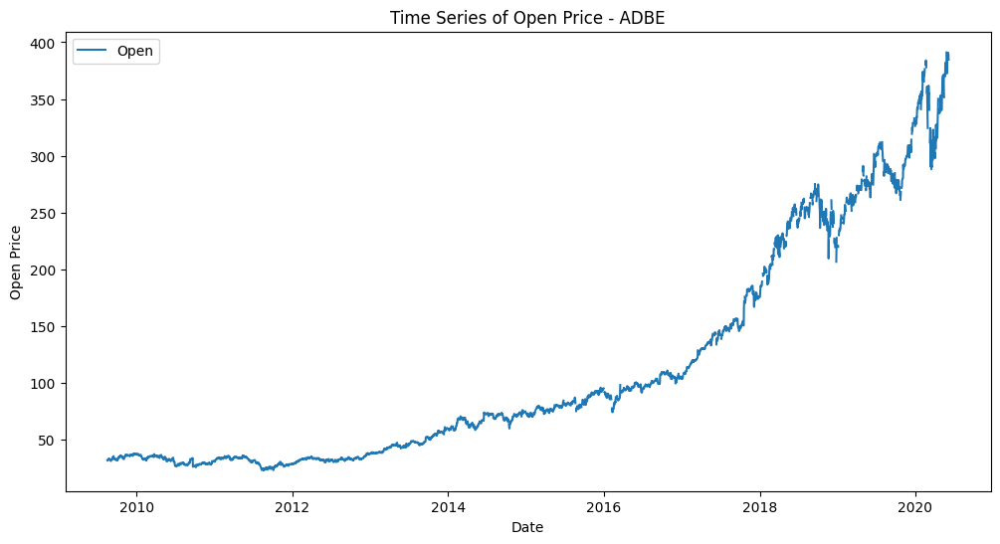

An error occurred for ADBE: This function does not handle missing values


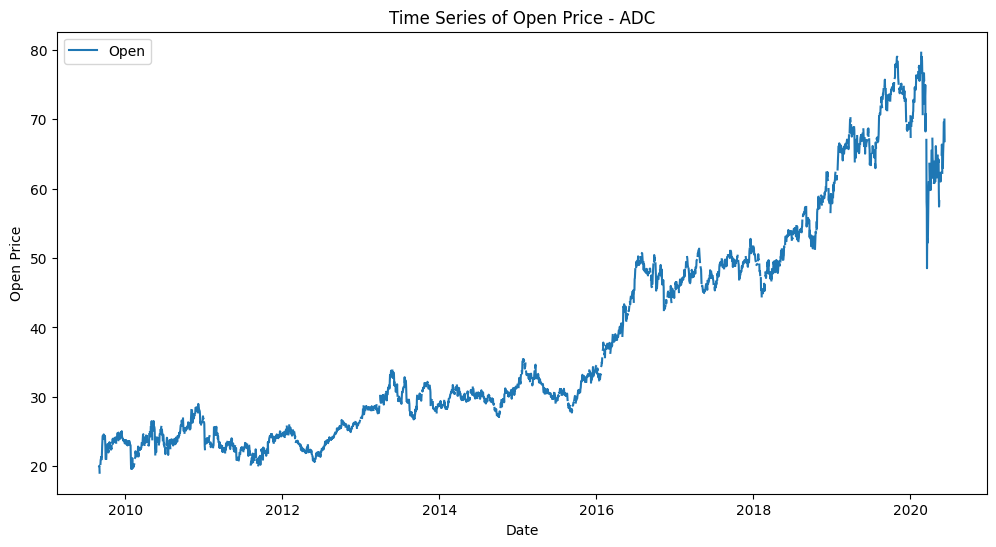

An error occurred for ADC: This function does not handle missing values


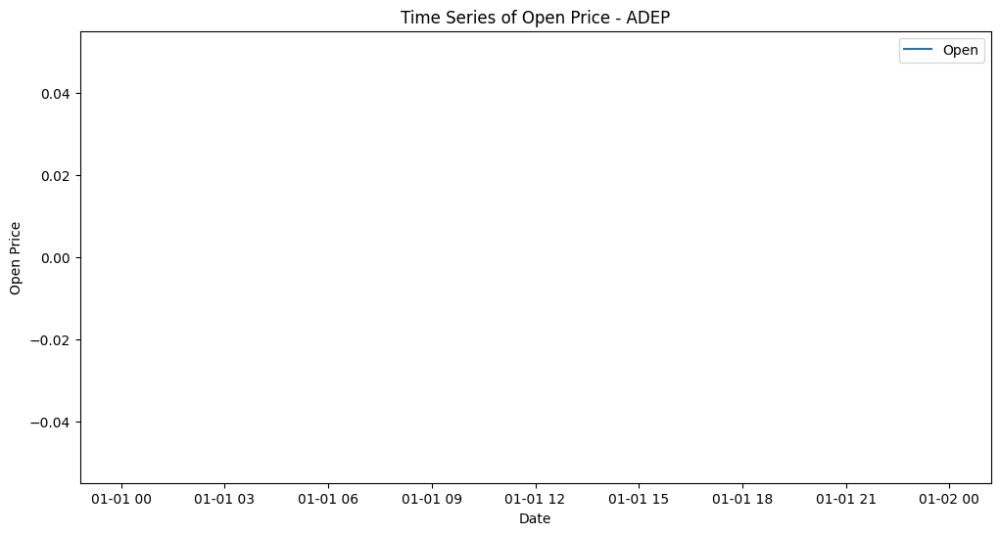

An error occurred for ADEP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


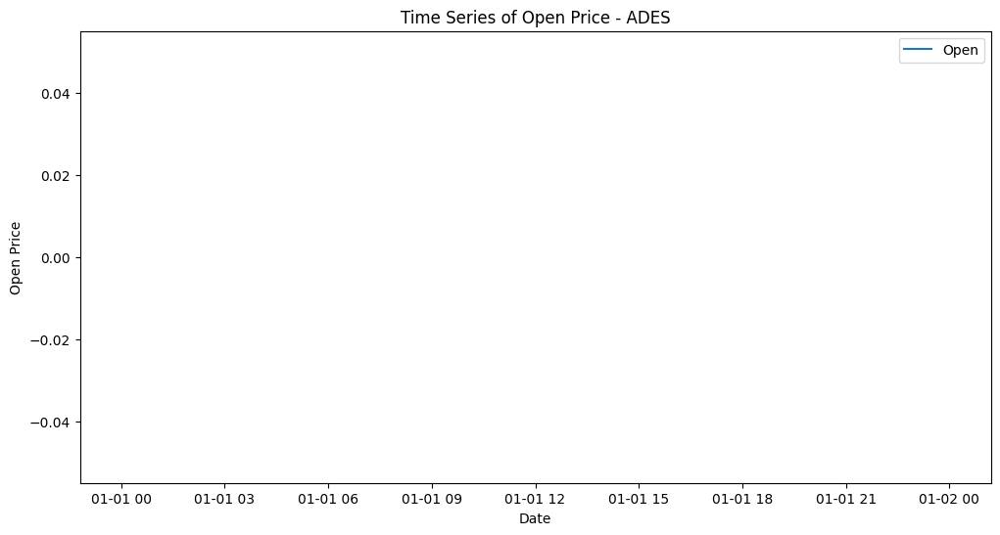

An error occurred for ADES: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


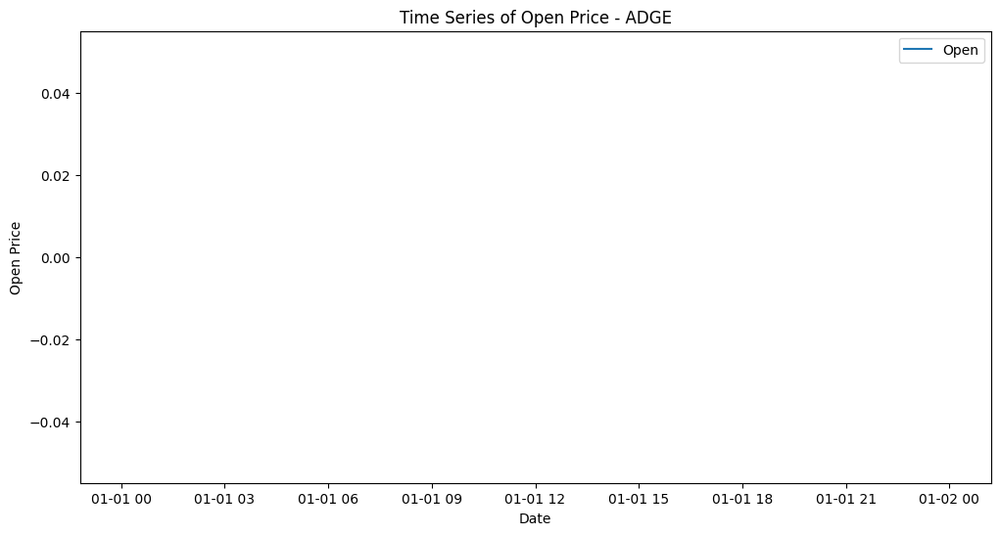

An error occurred for ADGE: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


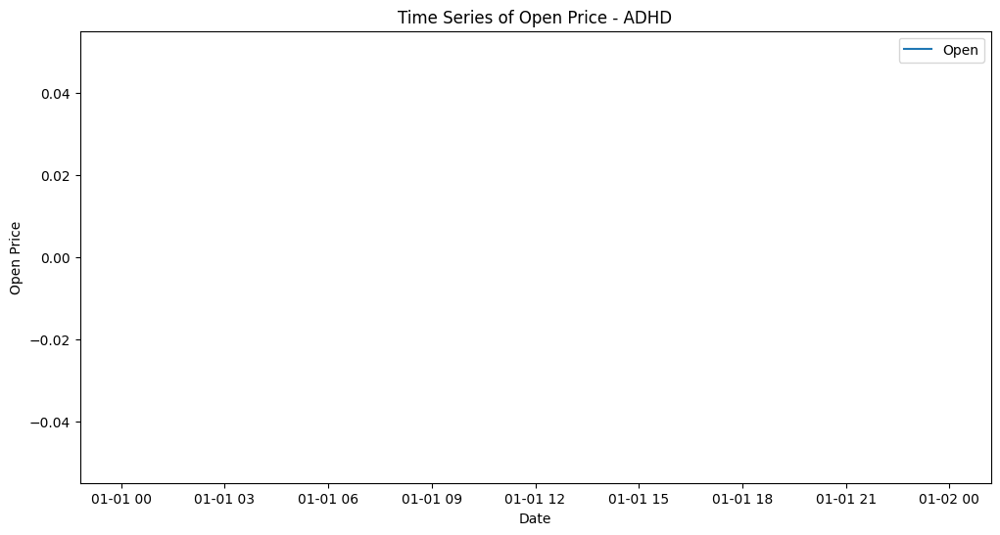

An error occurred for ADHD: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


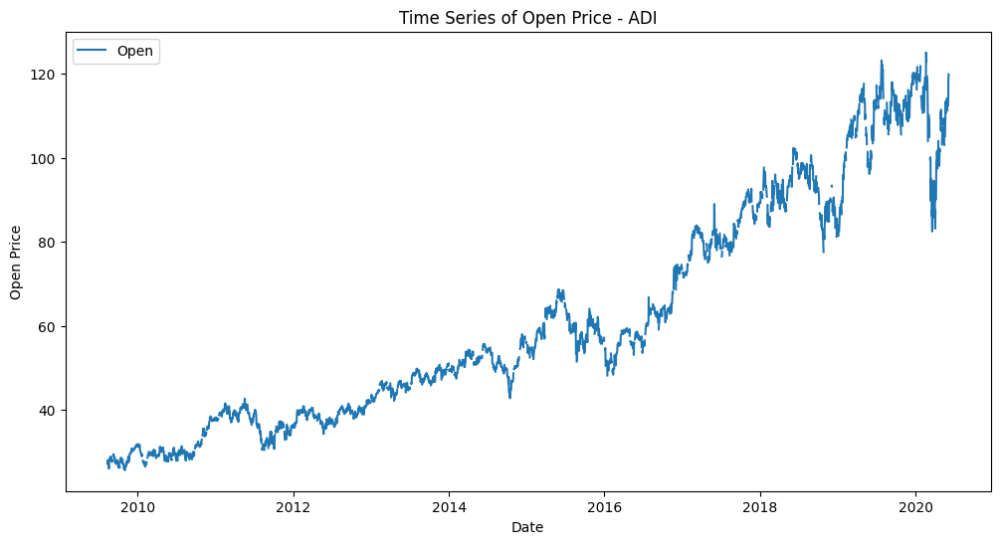

An error occurred for ADI: This function does not handle missing values


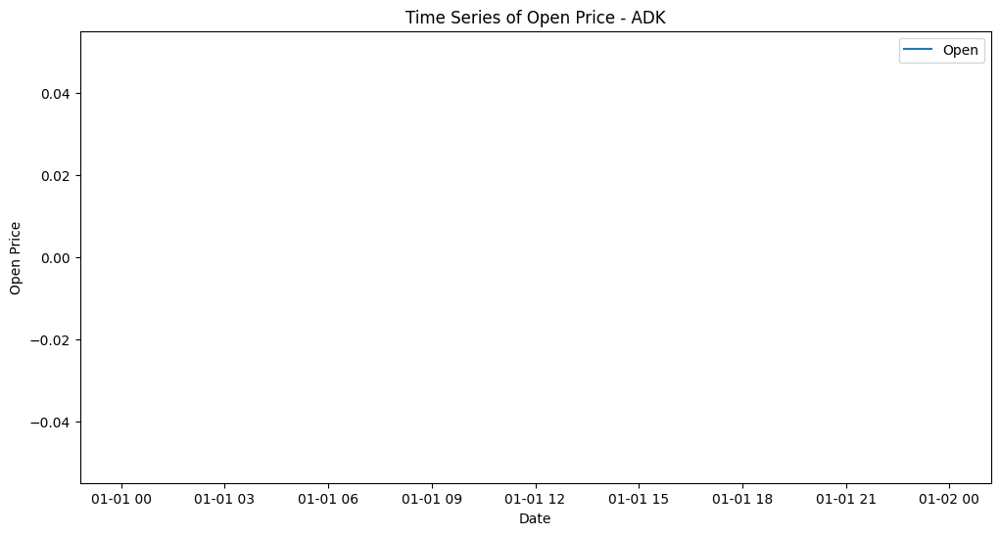

An error occurred for ADK: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


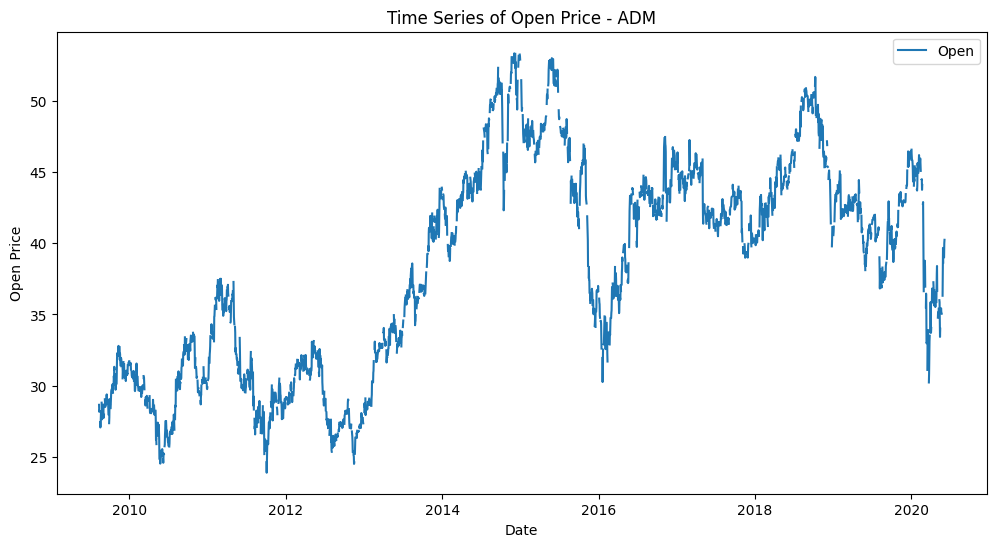

An error occurred for ADM: This function does not handle missing values


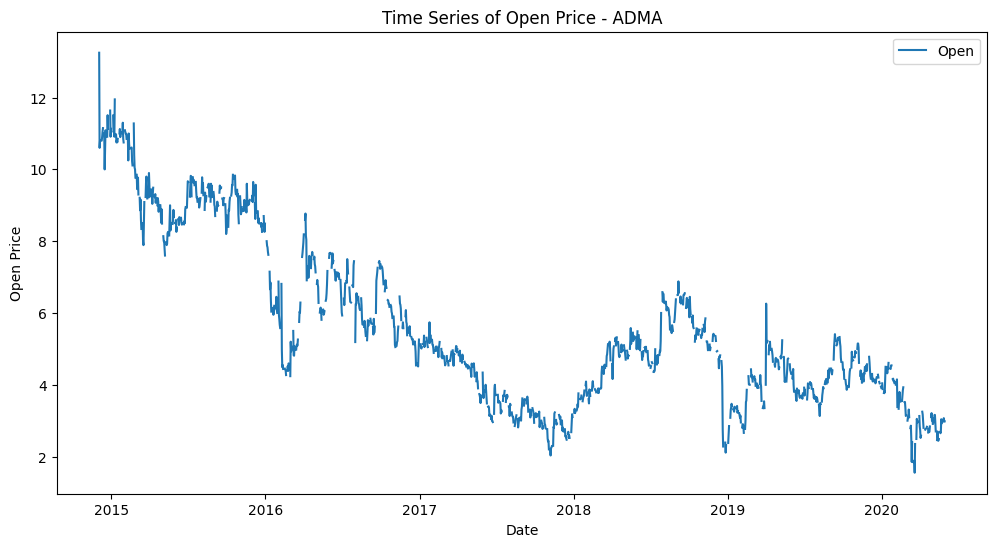

An error occurred for ADMA: This function does not handle missing values


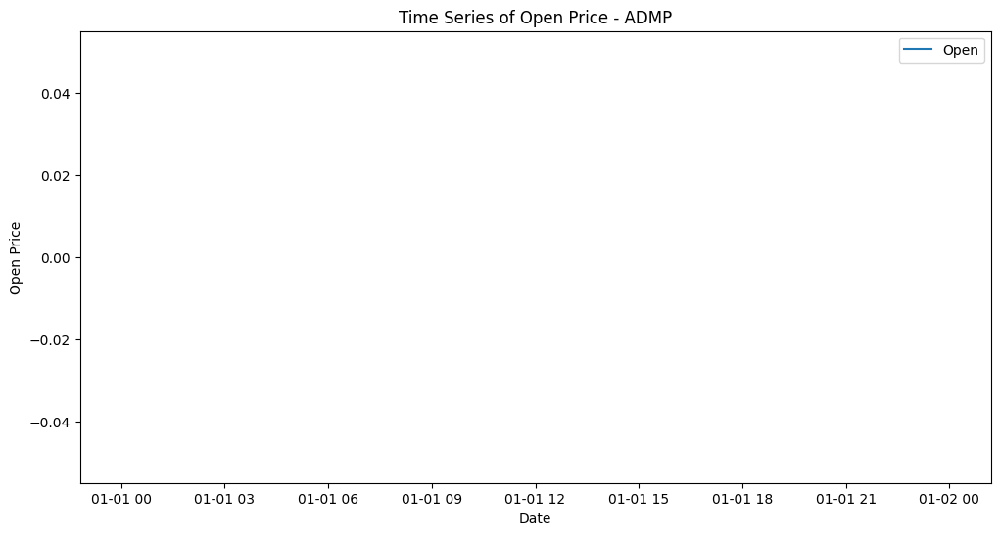

An error occurred for ADMP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


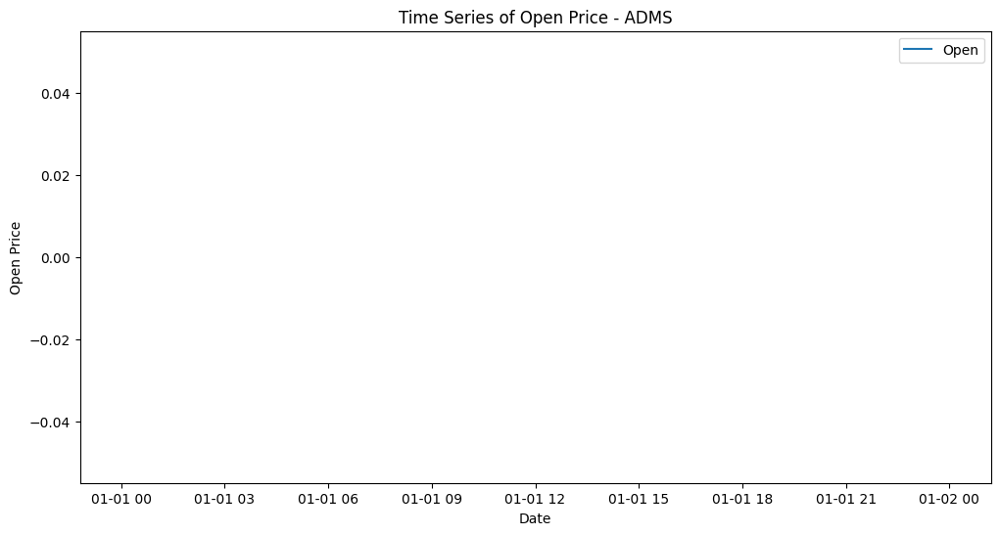

An error occurred for ADMS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


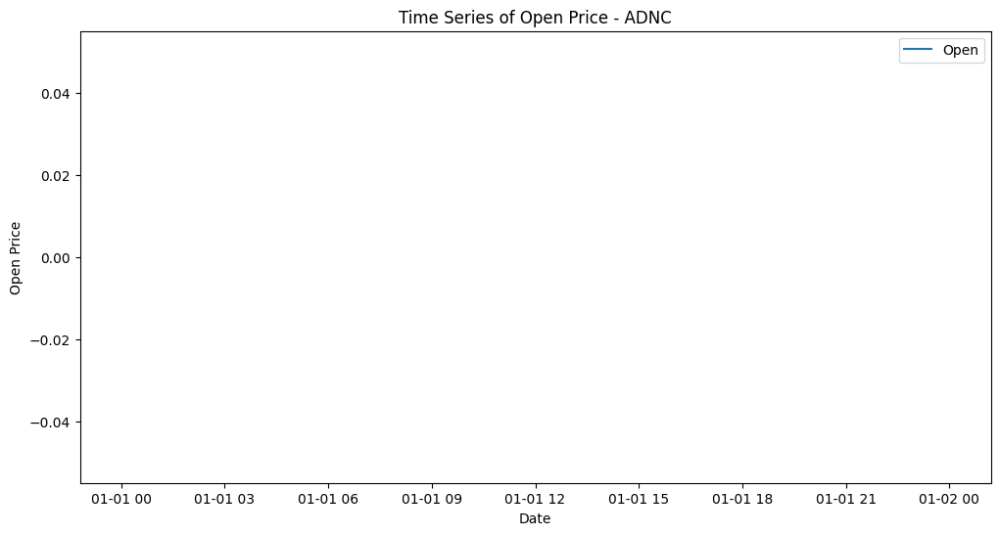

An error occurred for ADNC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


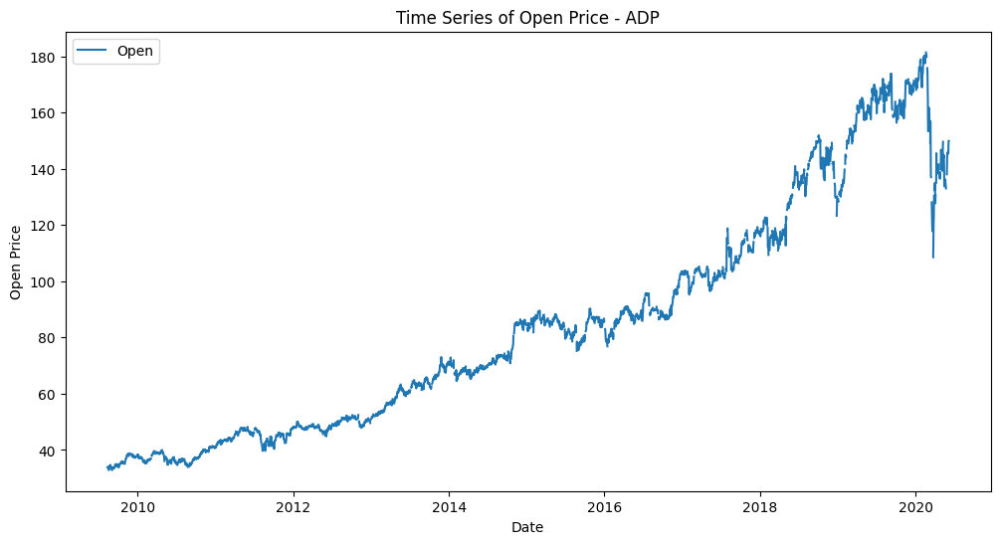

An error occurred for ADP: This function does not handle missing values


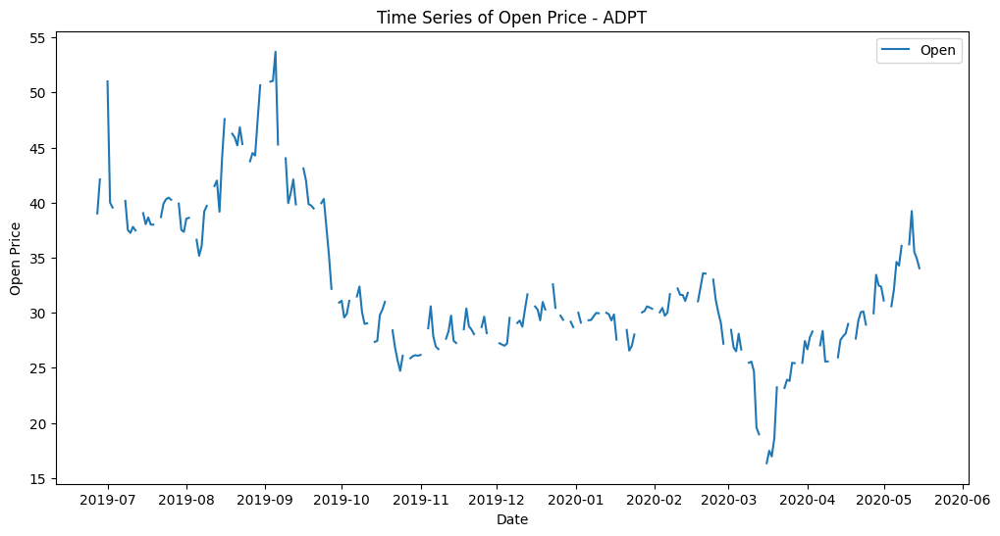

An error occurred for ADPT: This function does not handle missing values


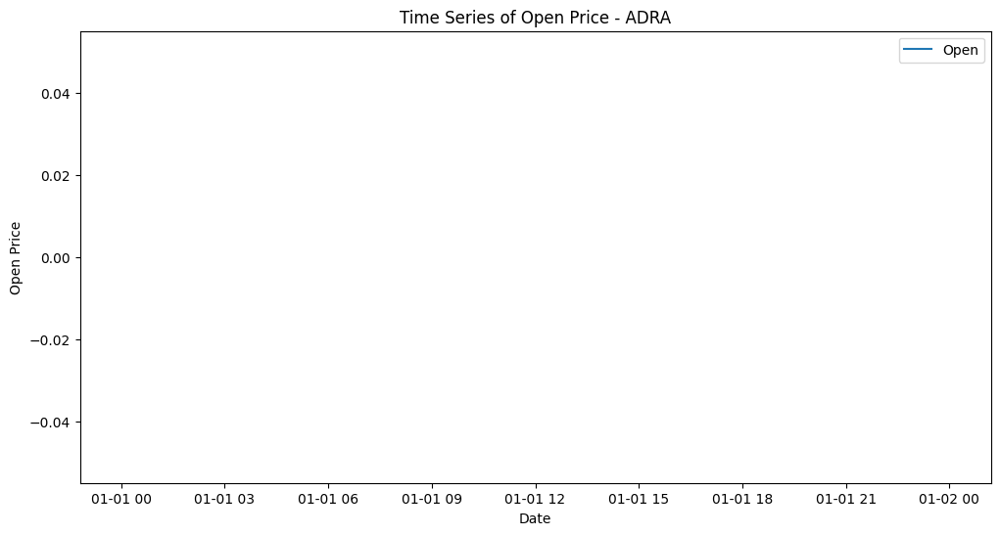

An error occurred for ADRA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


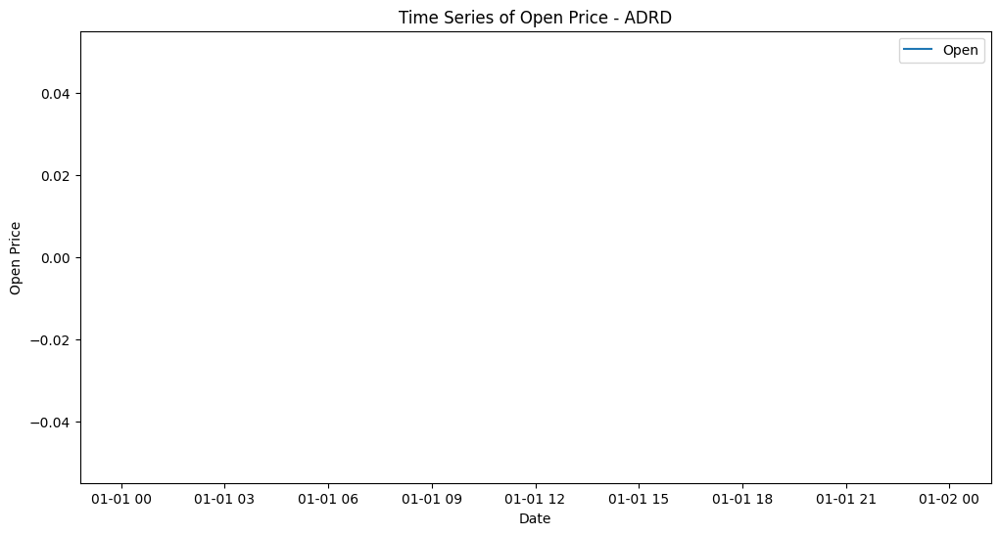

An error occurred for ADRD: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


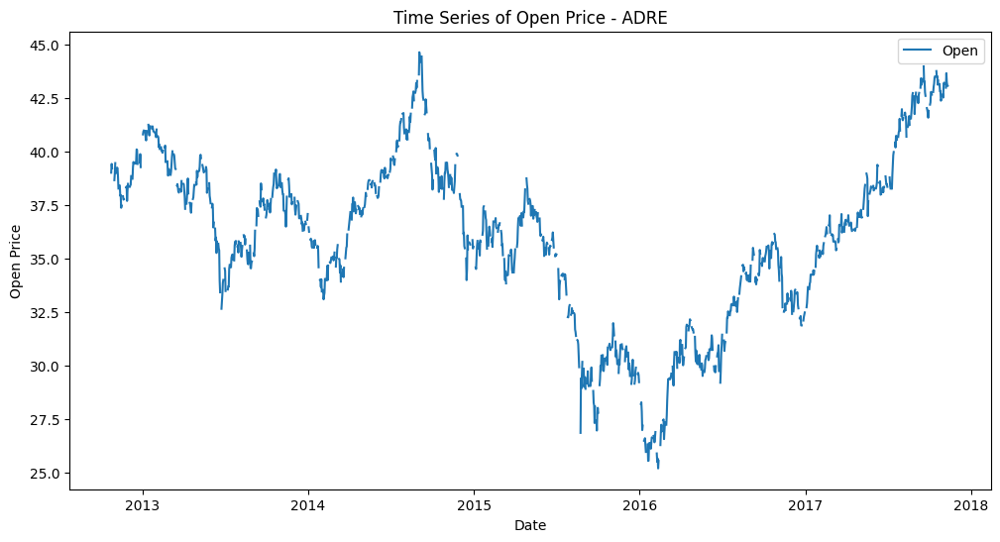

An error occurred for ADRE: This function does not handle missing values


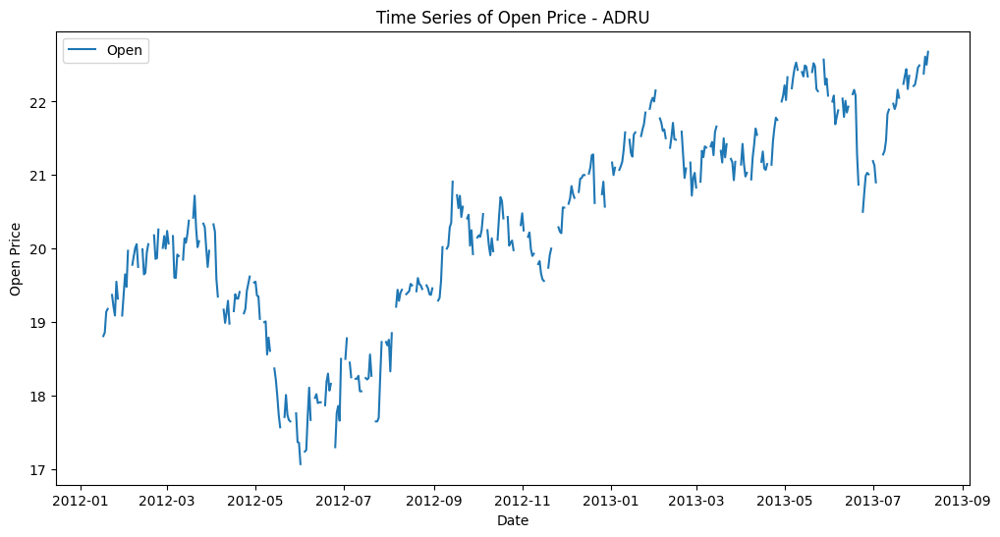

An error occurred for ADRU: This function does not handle missing values


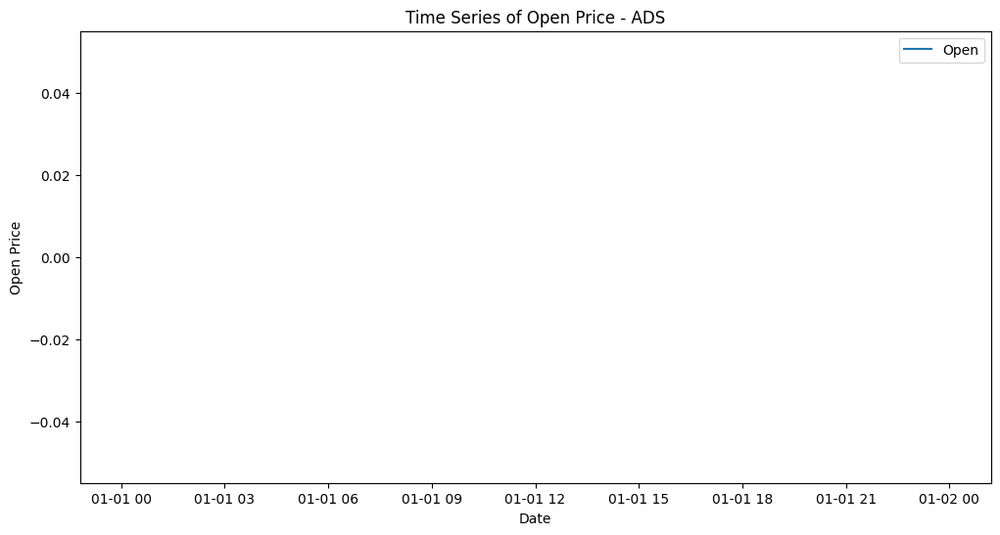

An error occurred for ADS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


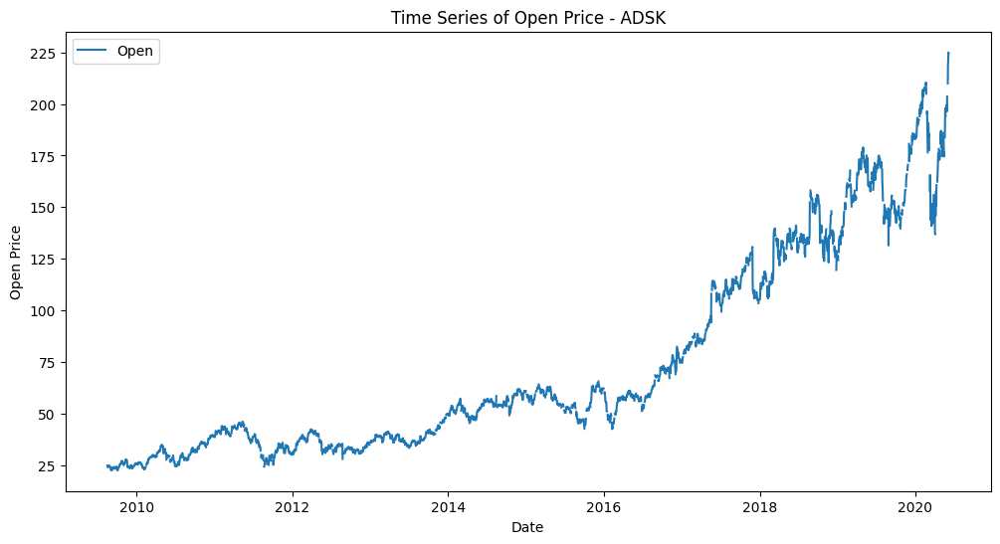

An error occurred for ADSK: This function does not handle missing values


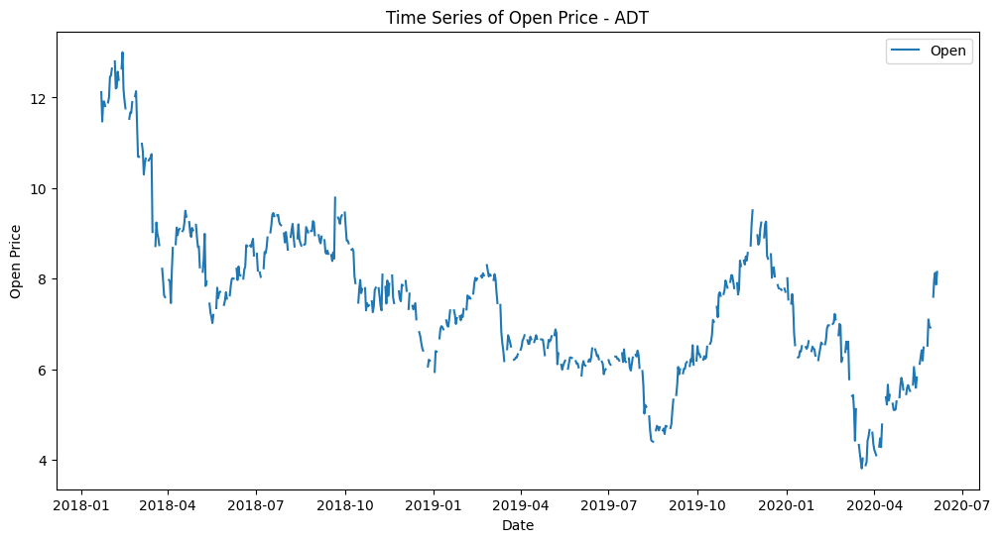

An error occurred for ADT: This function does not handle missing values


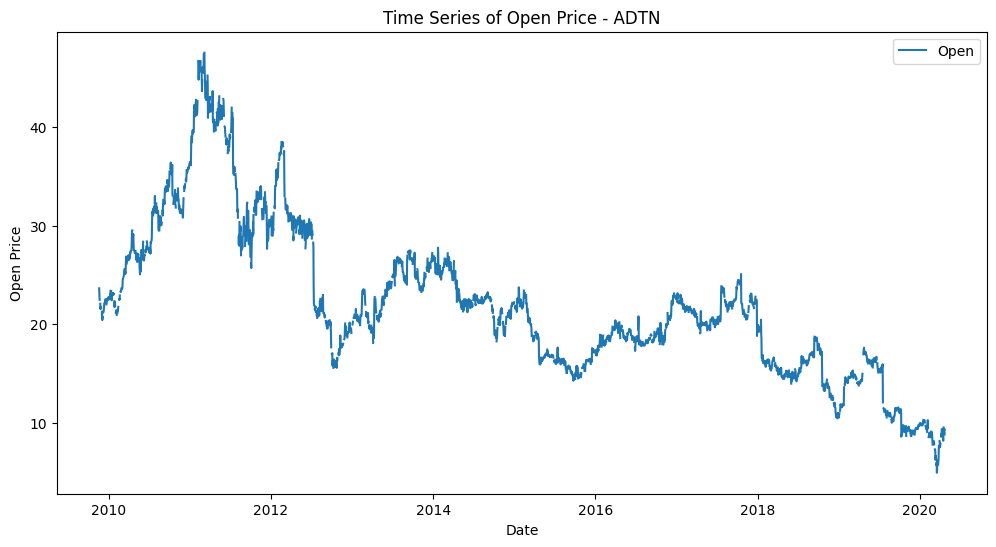

An error occurred for ADTN: This function does not handle missing values


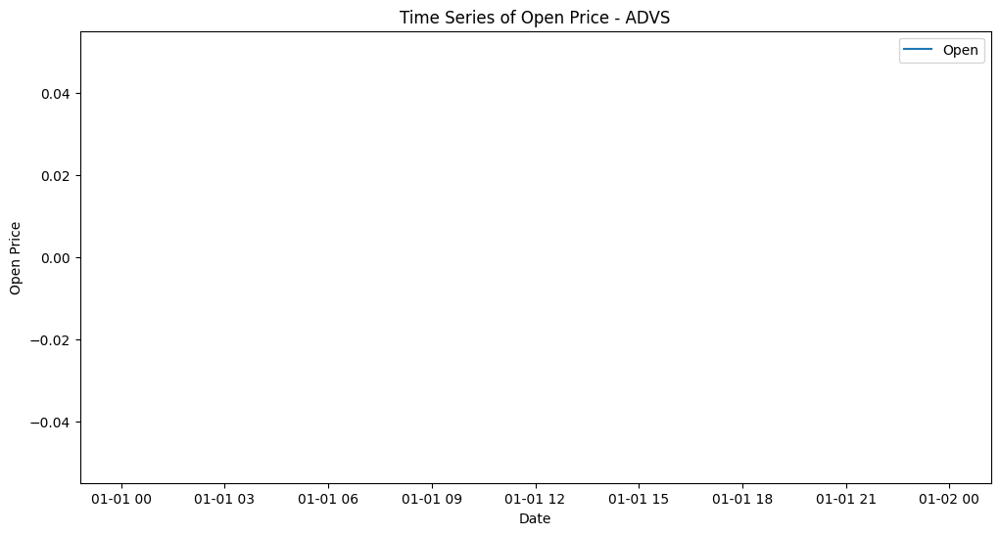

An error occurred for ADVS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


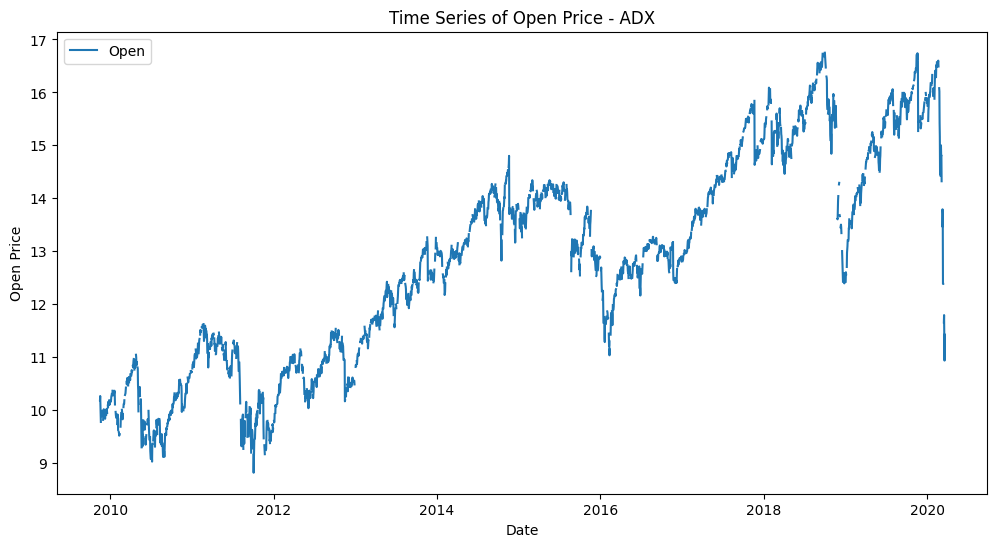

An error occurred for ADX: This function does not handle missing values


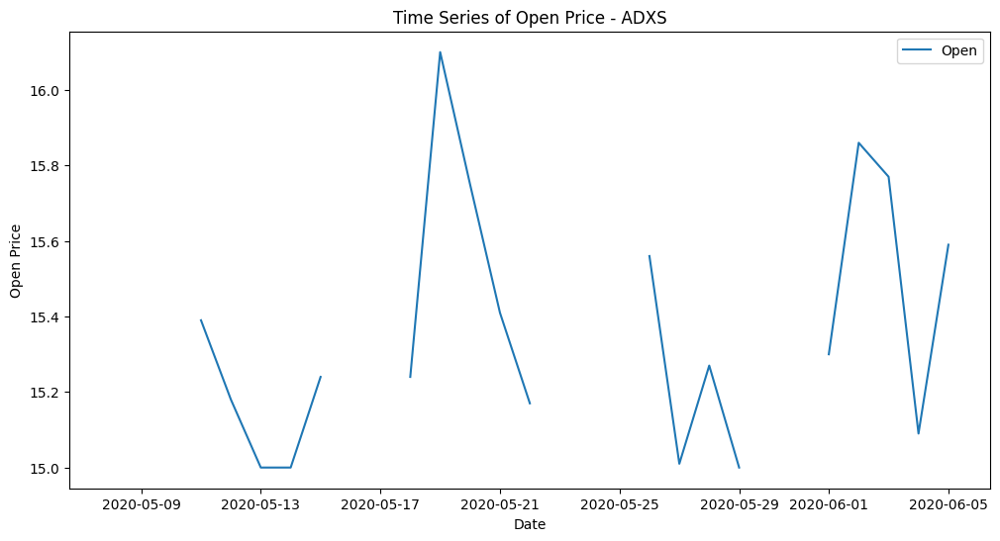

An error occurred for ADXS: This function does not handle missing values


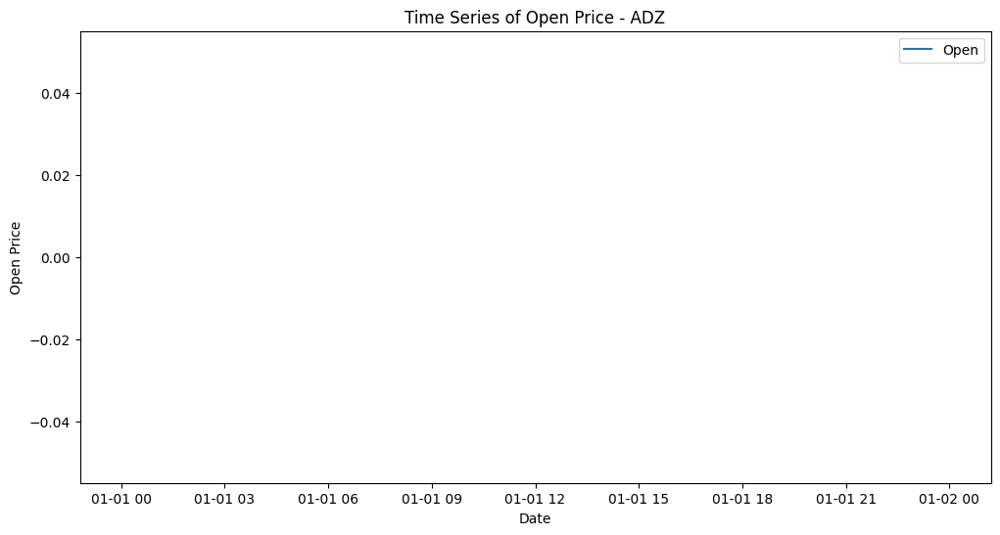

An error occurred for ADZ: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


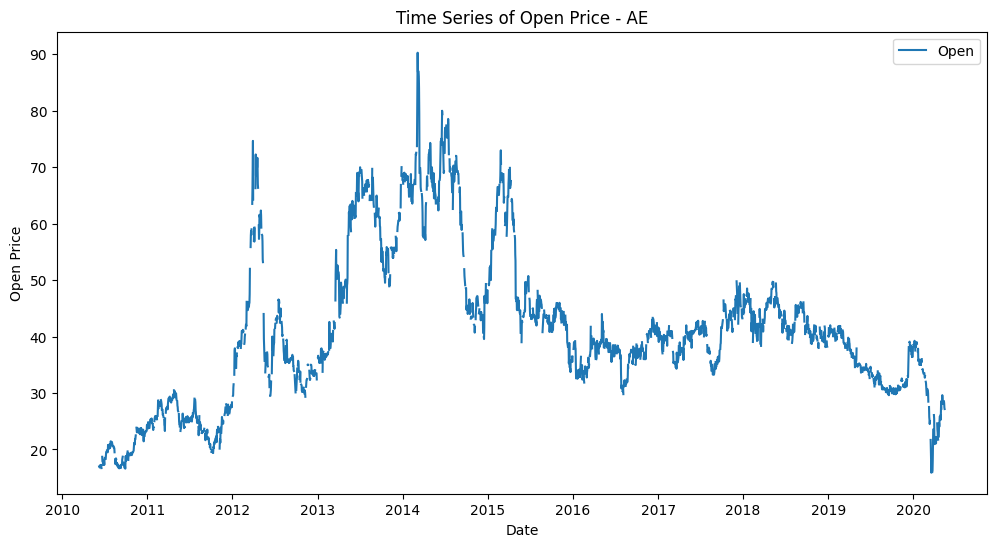

An error occurred for AE: This function does not handle missing values


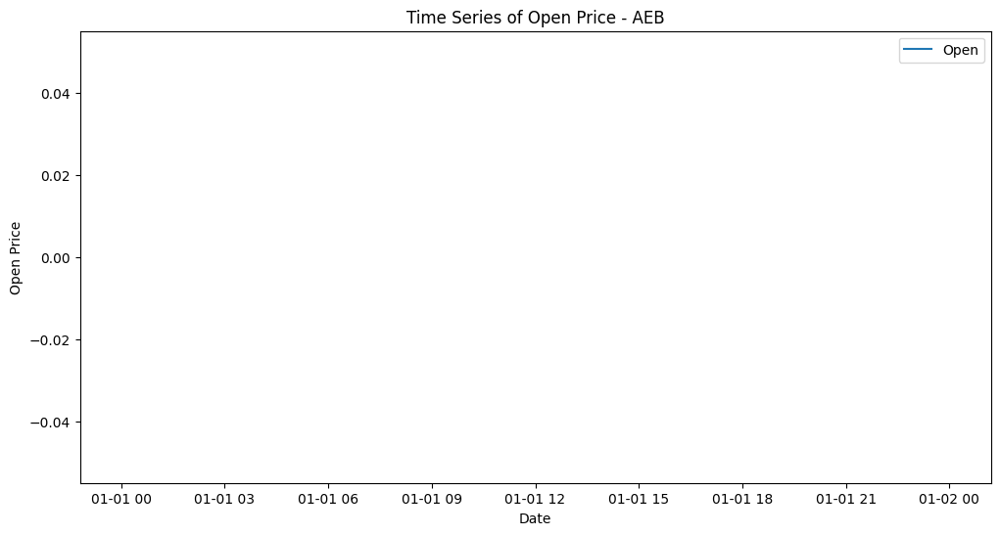

An error occurred for AEB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


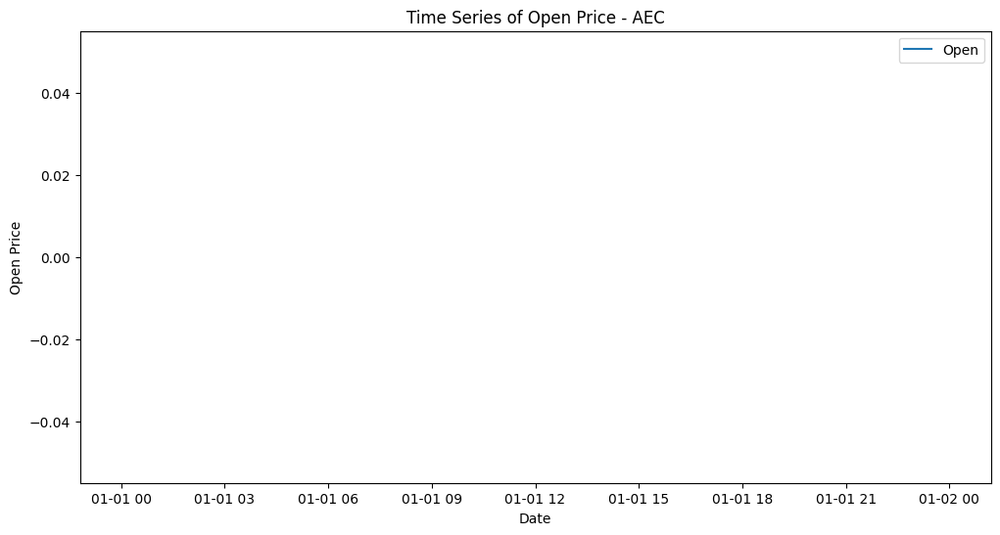

An error occurred for AEC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


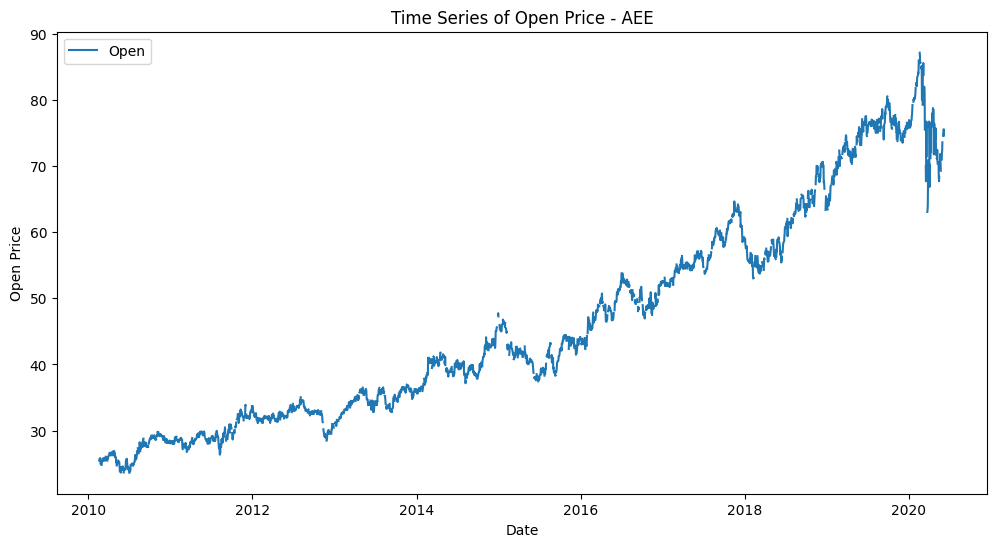

An error occurred for AEE: This function does not handle missing values


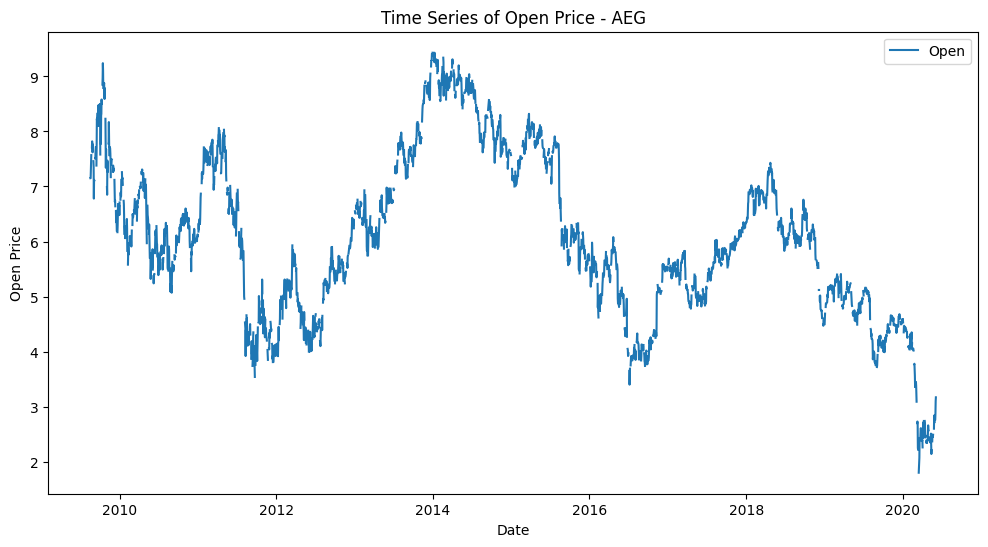

An error occurred for AEG: This function does not handle missing values


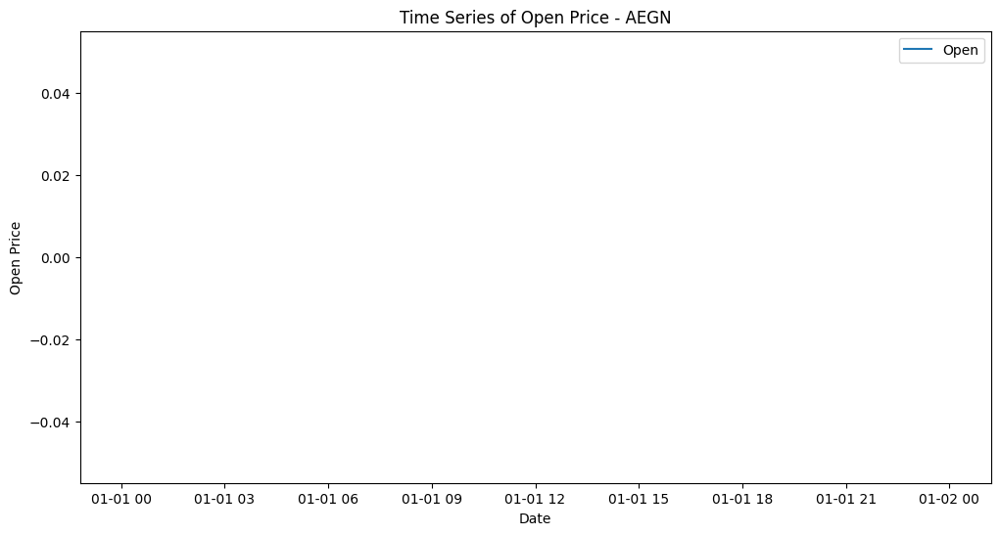

An error occurred for AEGN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


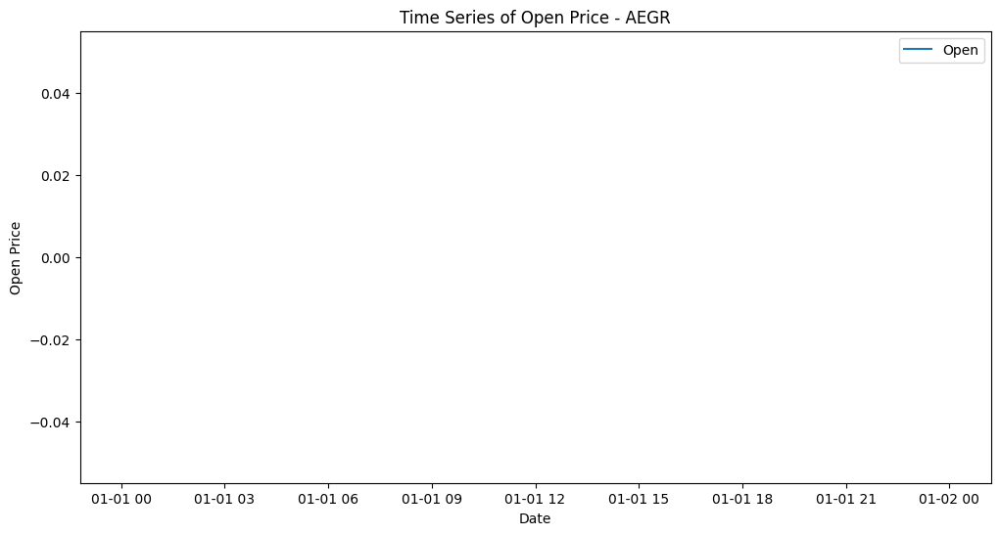

An error occurred for AEGR: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


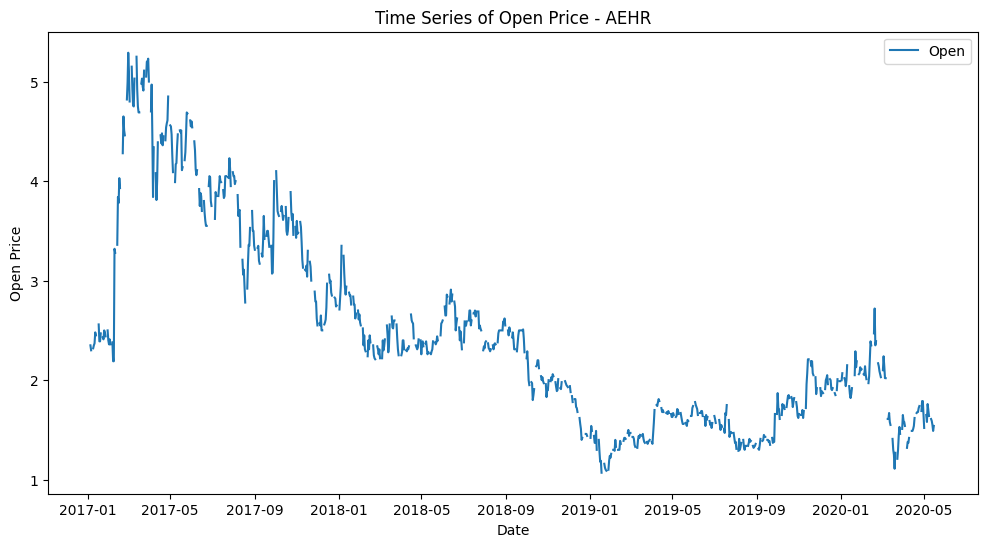

An error occurred for AEHR: This function does not handle missing values


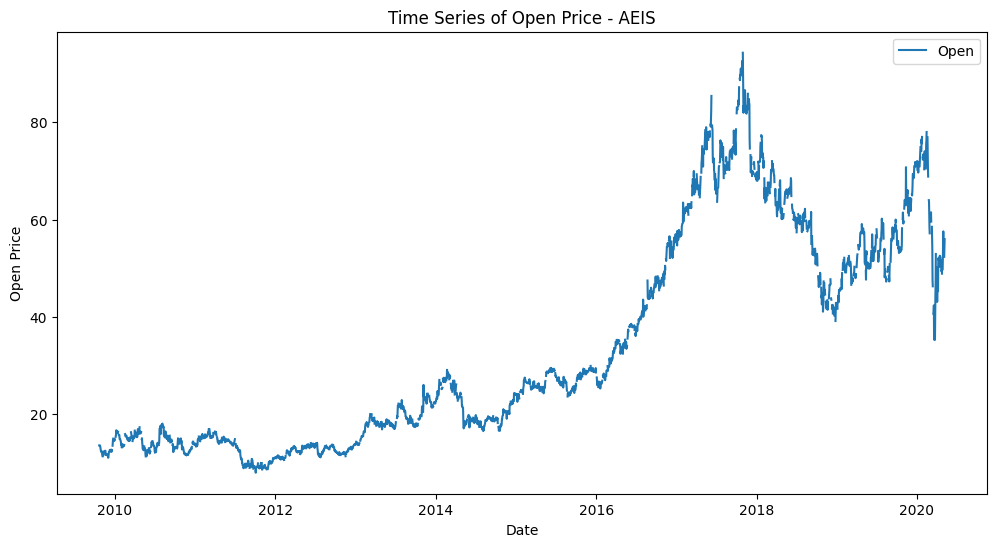

An error occurred for AEIS: This function does not handle missing values


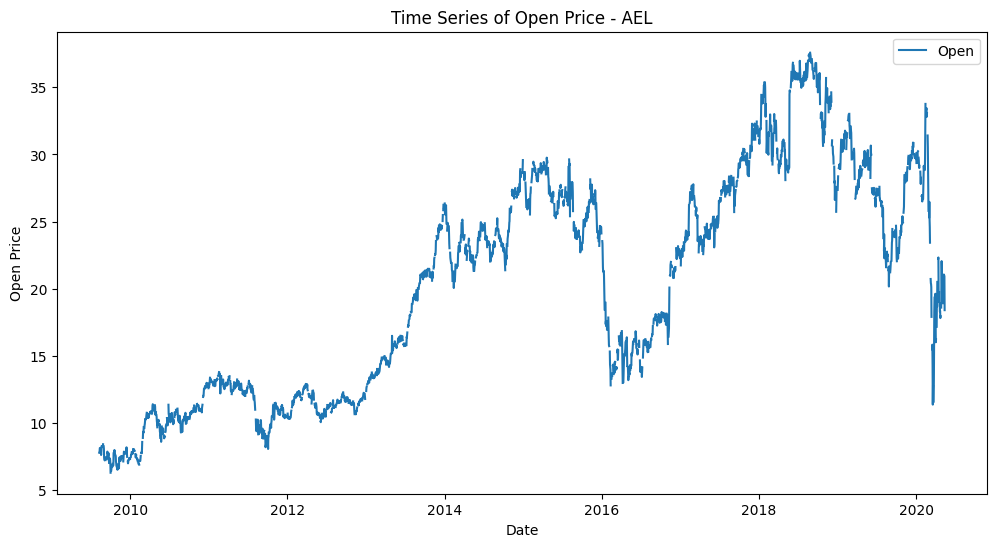

An error occurred for AEL: This function does not handle missing values


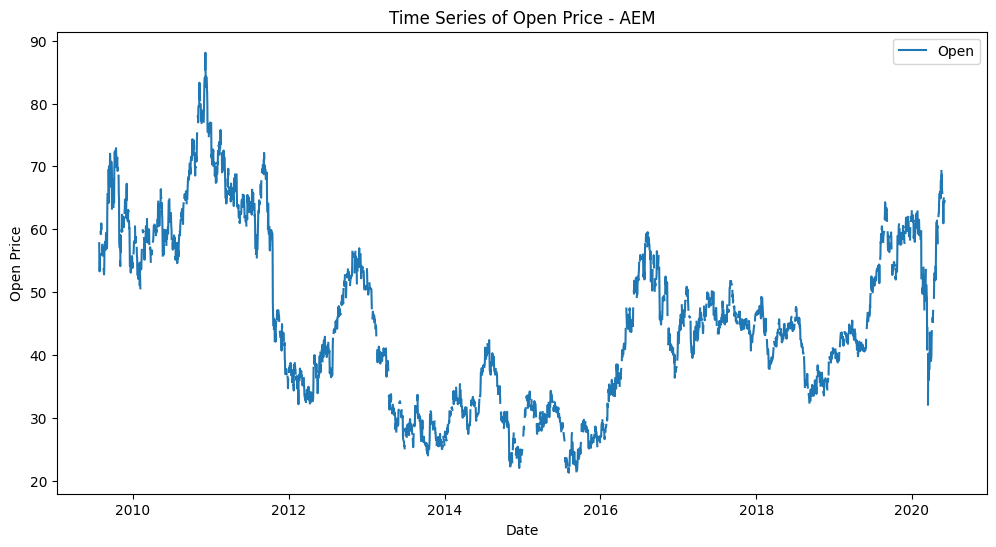

An error occurred for AEM: This function does not handle missing values


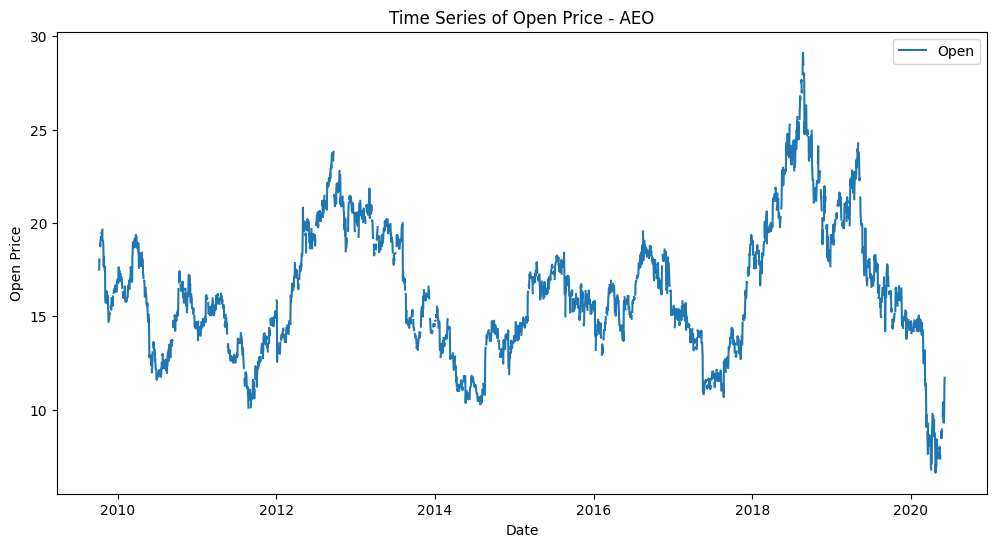

An error occurred for AEO: This function does not handle missing values


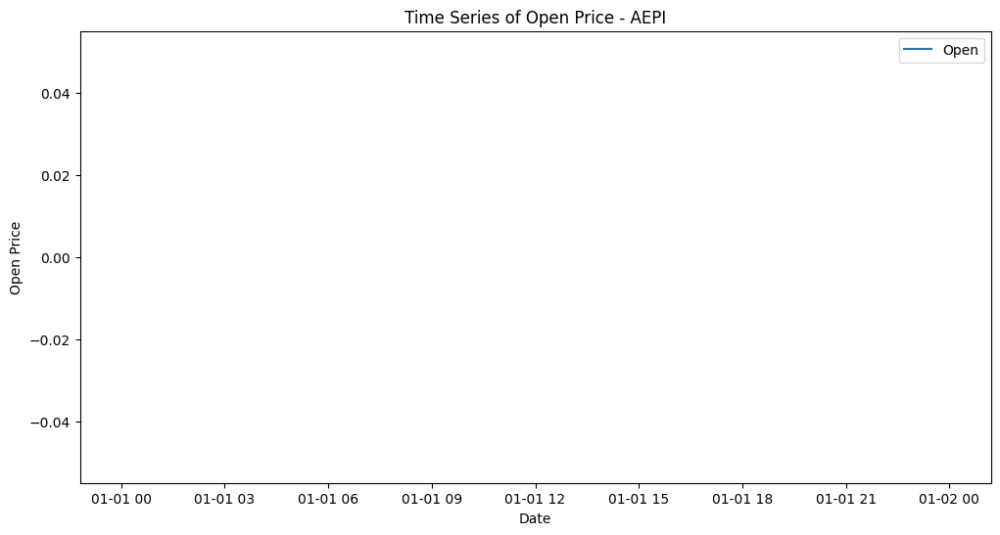

An error occurred for AEPI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


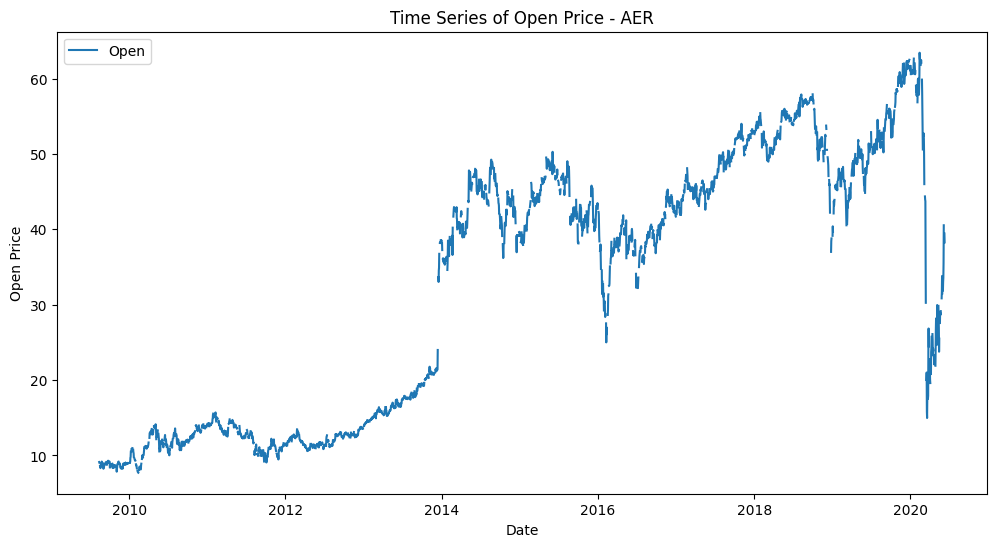

An error occurred for AER: This function does not handle missing values


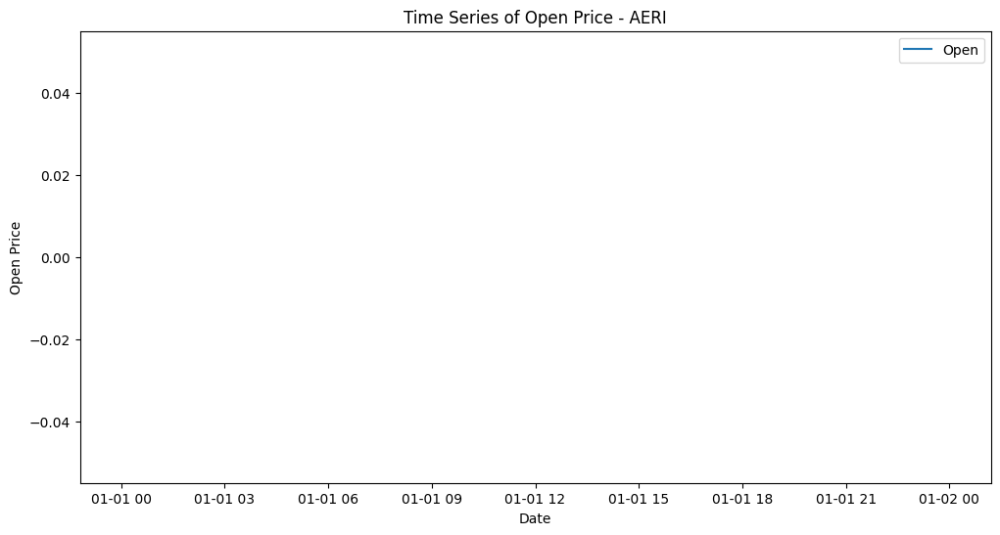

An error occurred for AERI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


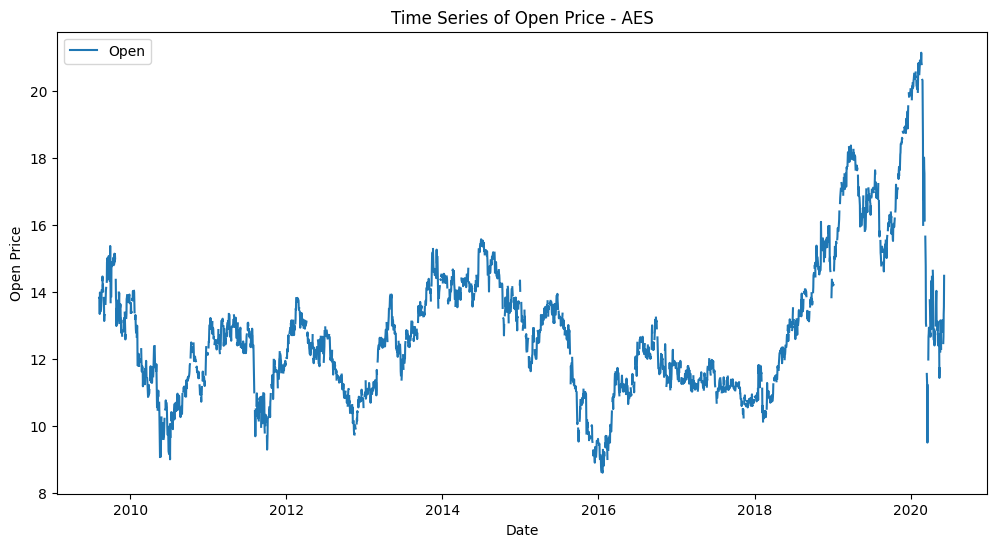

An error occurred for AES: This function does not handle missing values


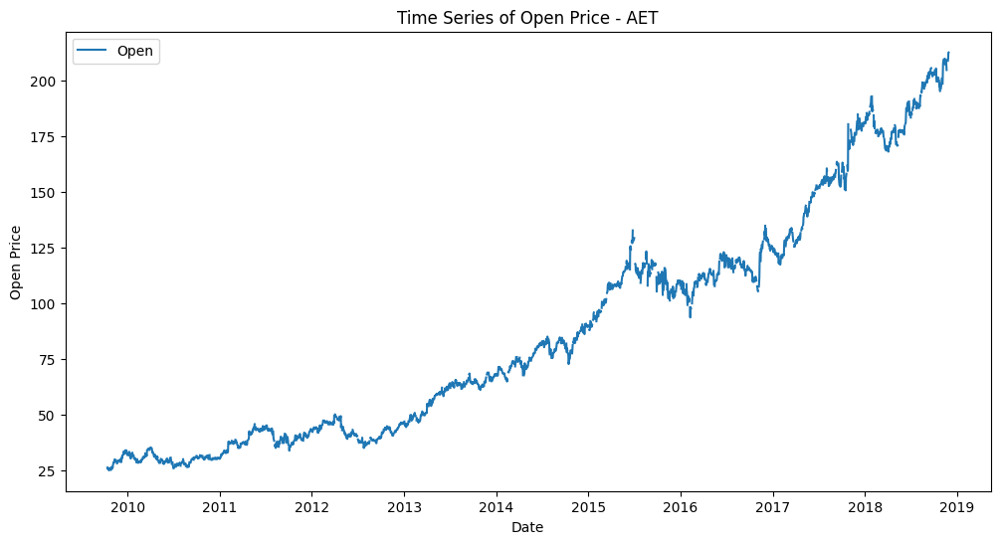

An error occurred for AET: This function does not handle missing values


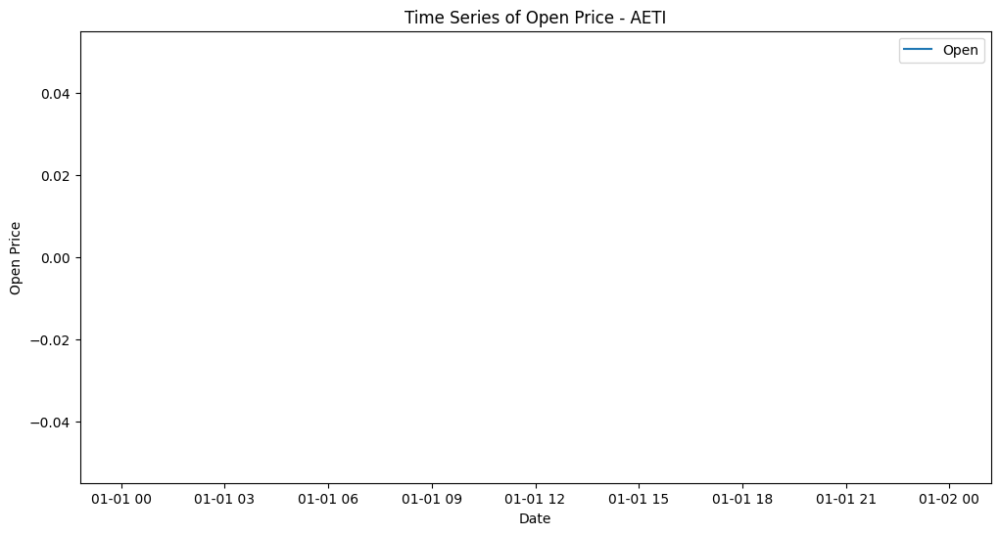

An error occurred for AETI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


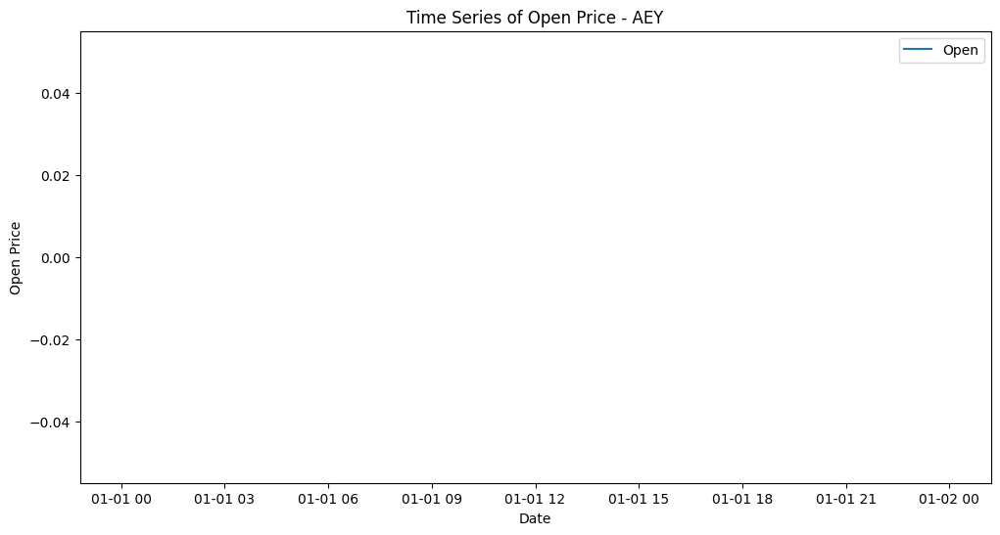

An error occurred for AEY: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


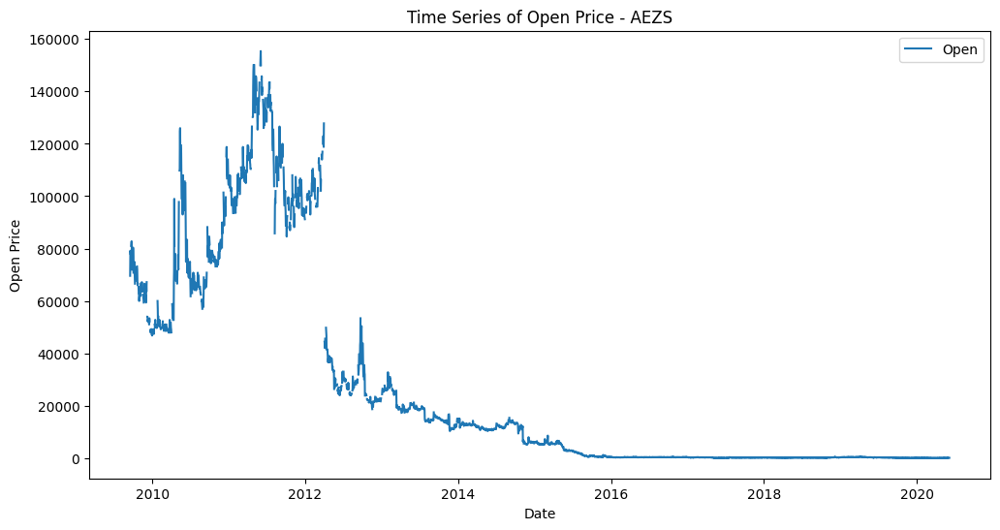

An error occurred for AEZS: This function does not handle missing values


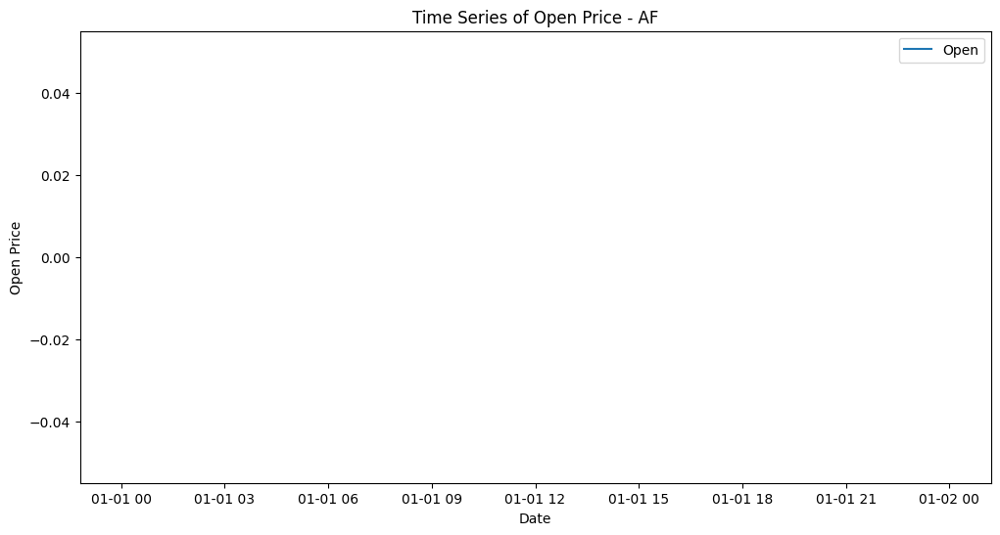

An error occurred for AF: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


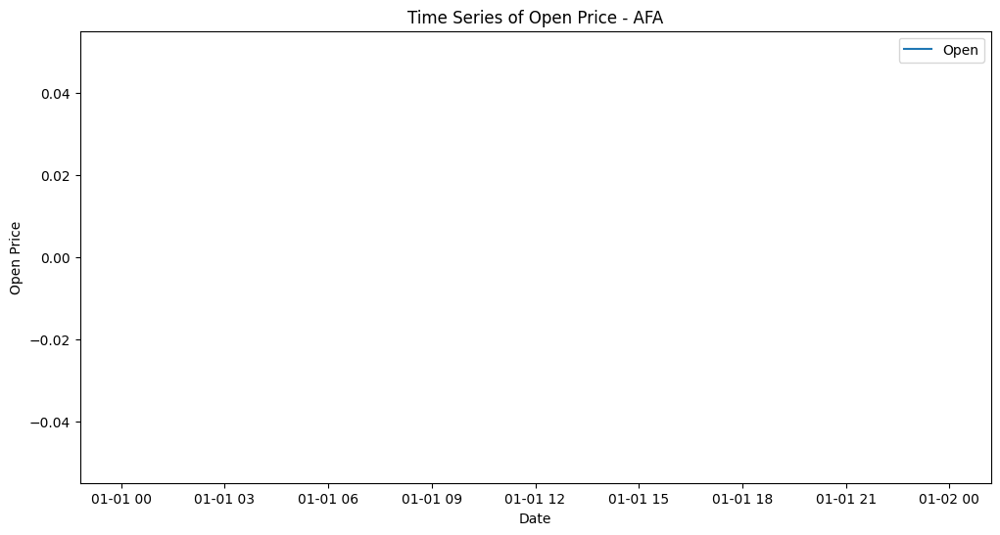

An error occurred for AFA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


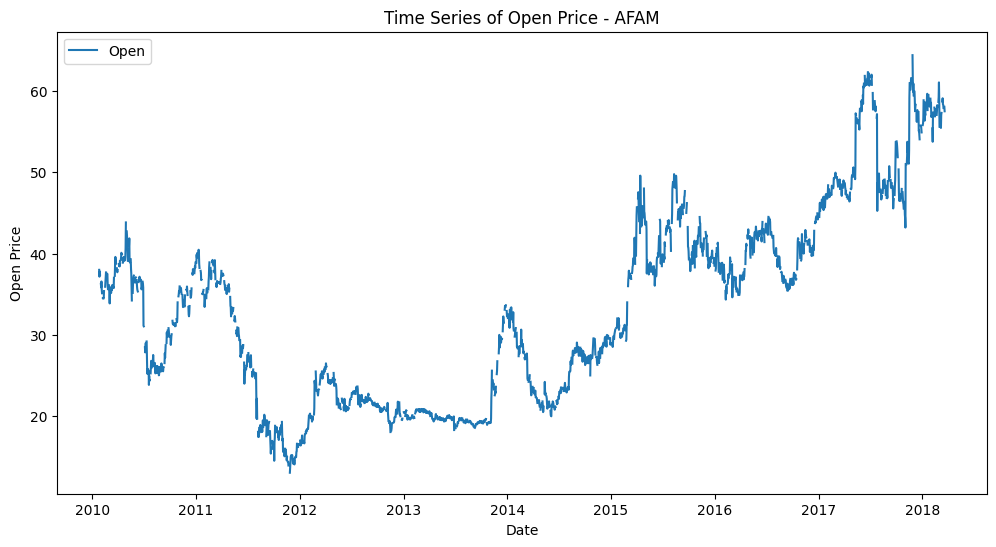

An error occurred for AFAM: This function does not handle missing values


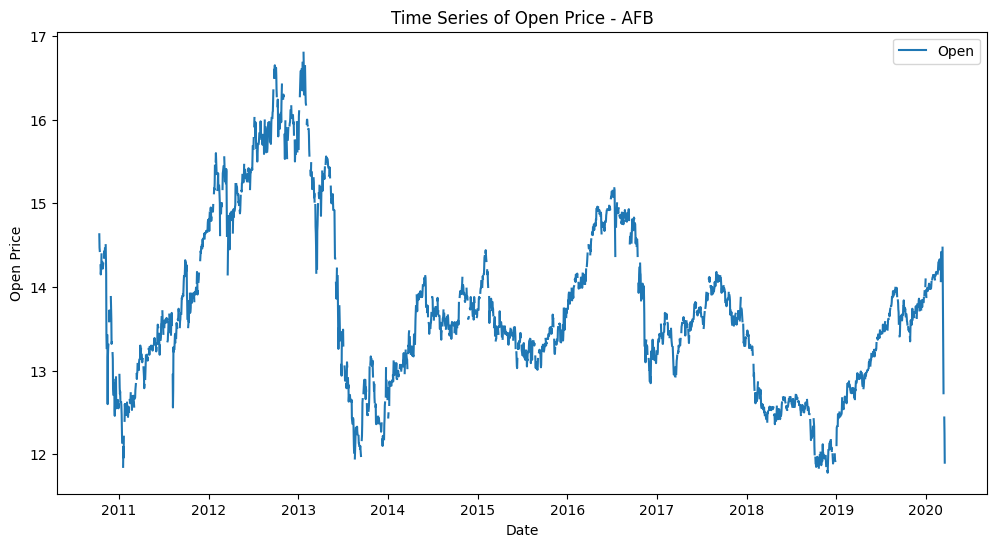

An error occurred for AFB: This function does not handle missing values


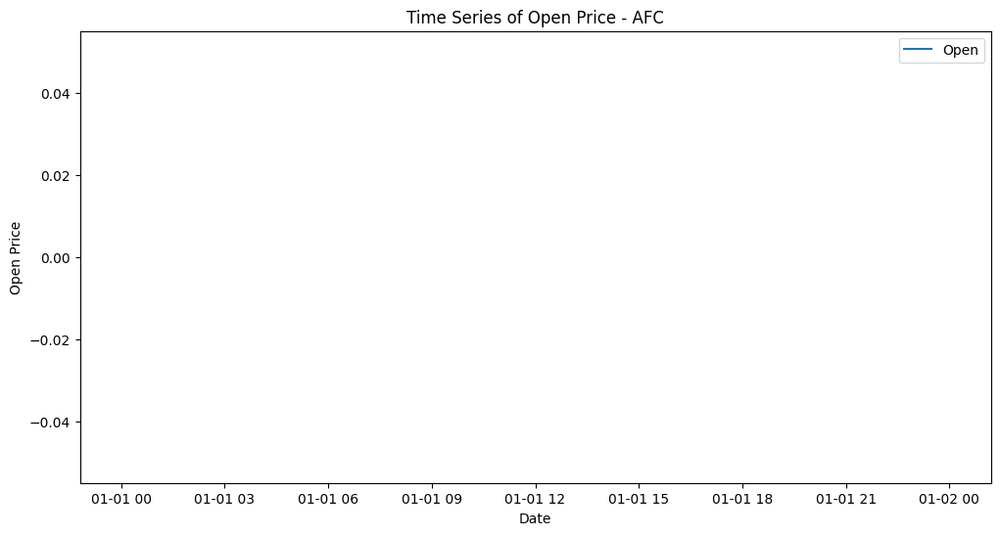

An error occurred for AFC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


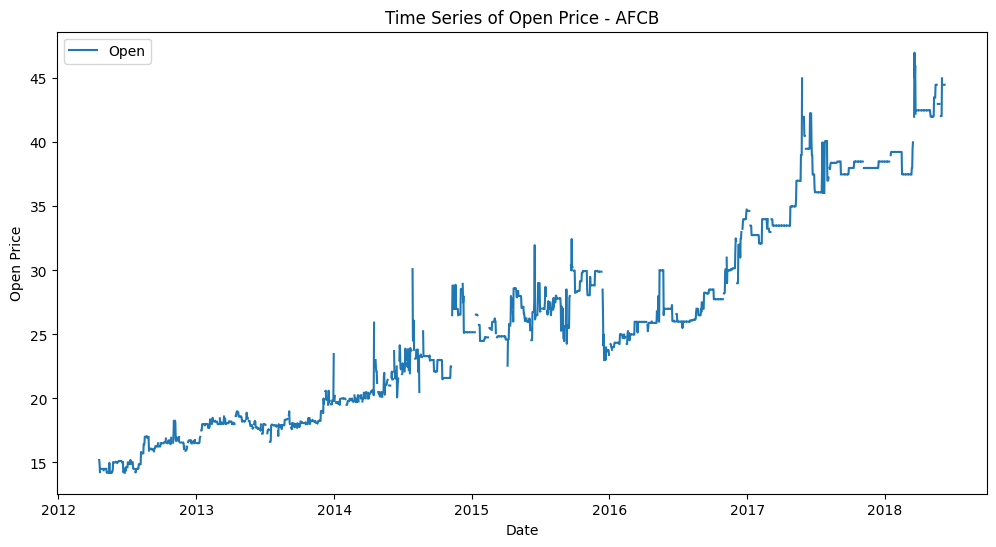

An error occurred for AFCB: This function does not handle missing values


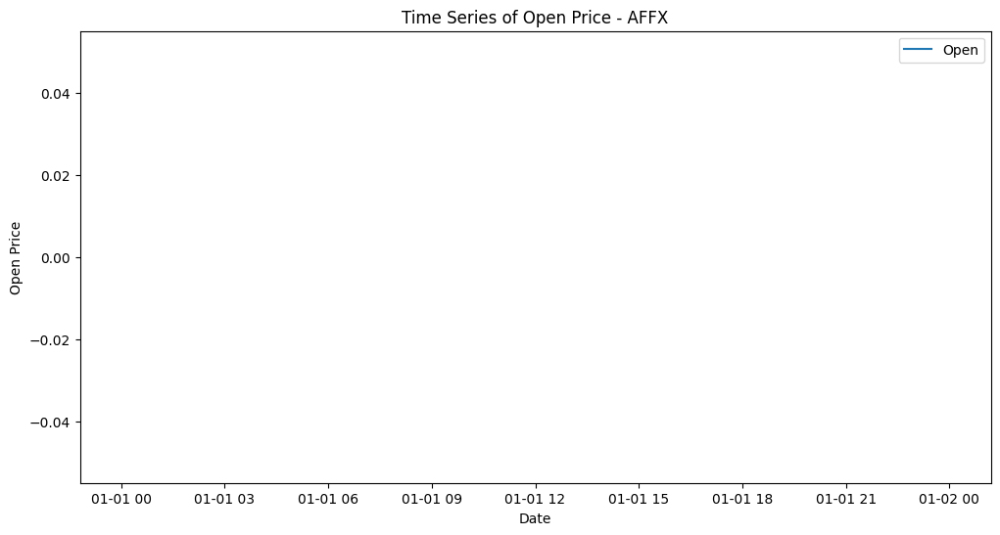

An error occurred for AFFX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


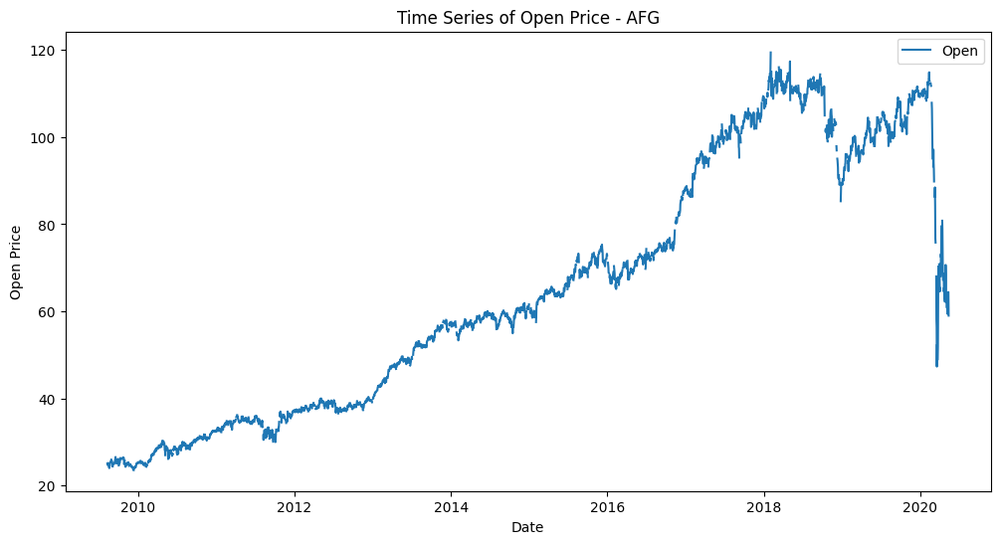

An error occurred for AFG: This function does not handle missing values


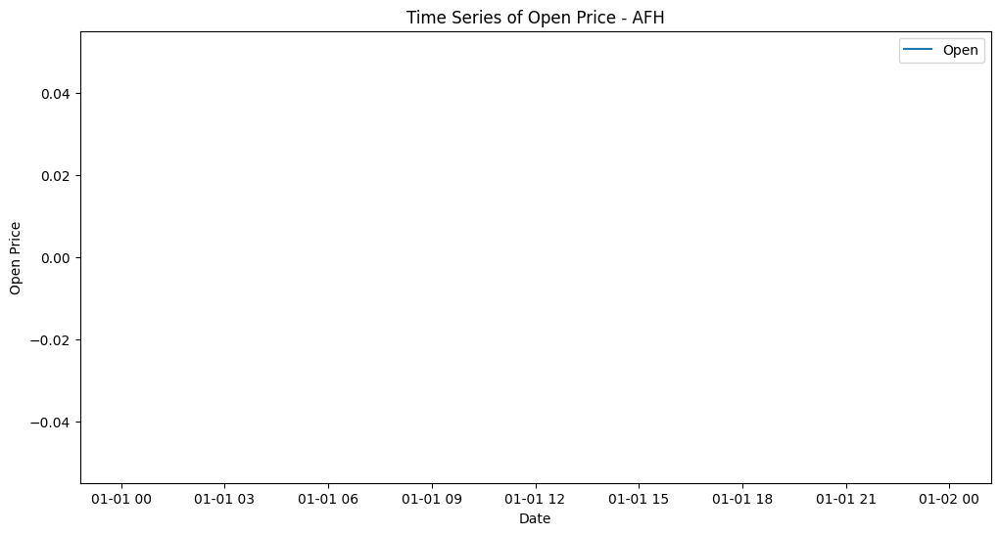

An error occurred for AFH: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


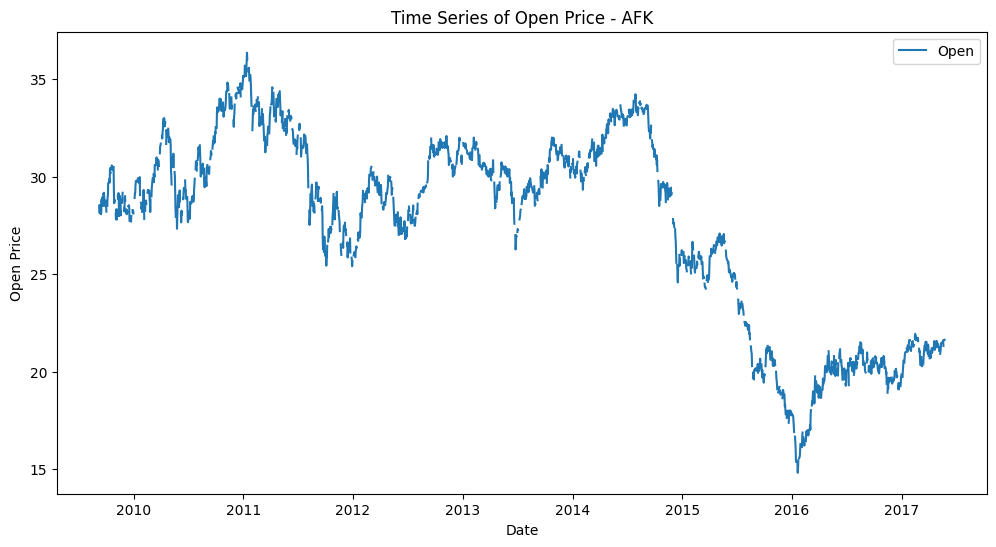

An error occurred for AFK: This function does not handle missing values


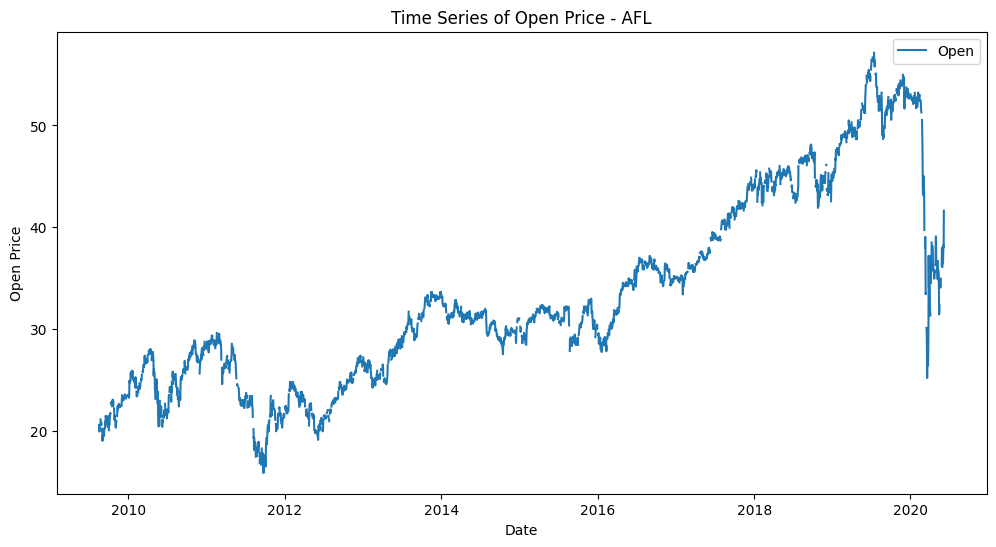

An error occurred for AFL: This function does not handle missing values


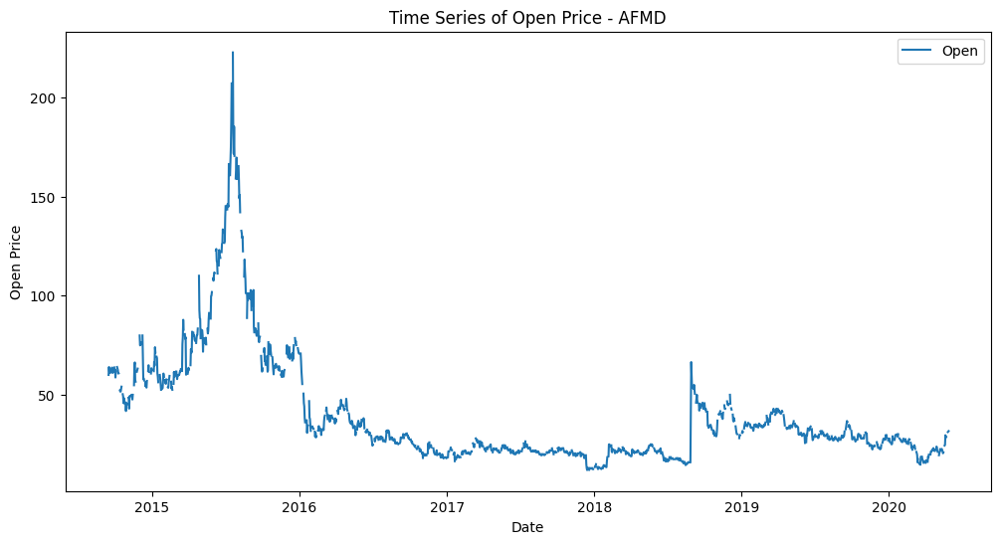

An error occurred for AFMD: This function does not handle missing values


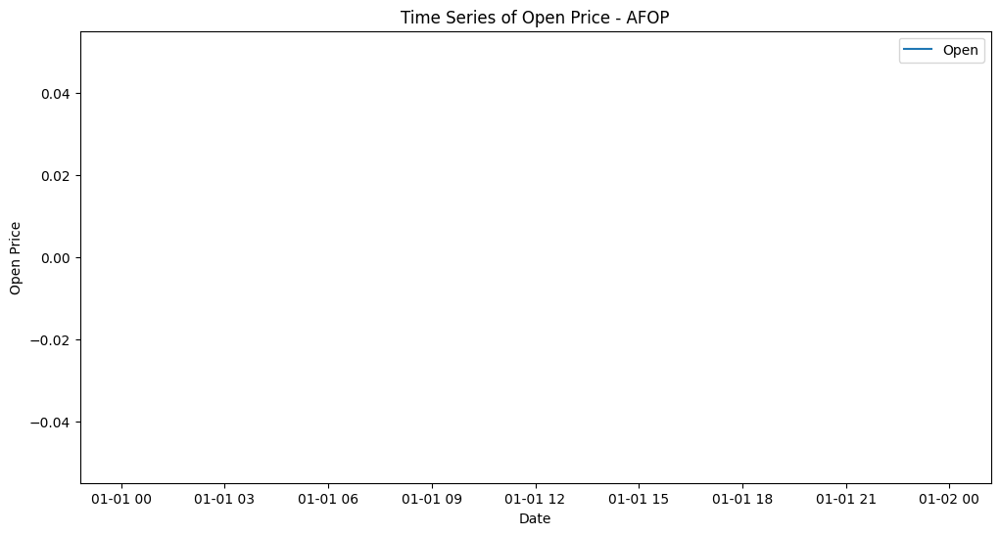

An error occurred for AFOP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


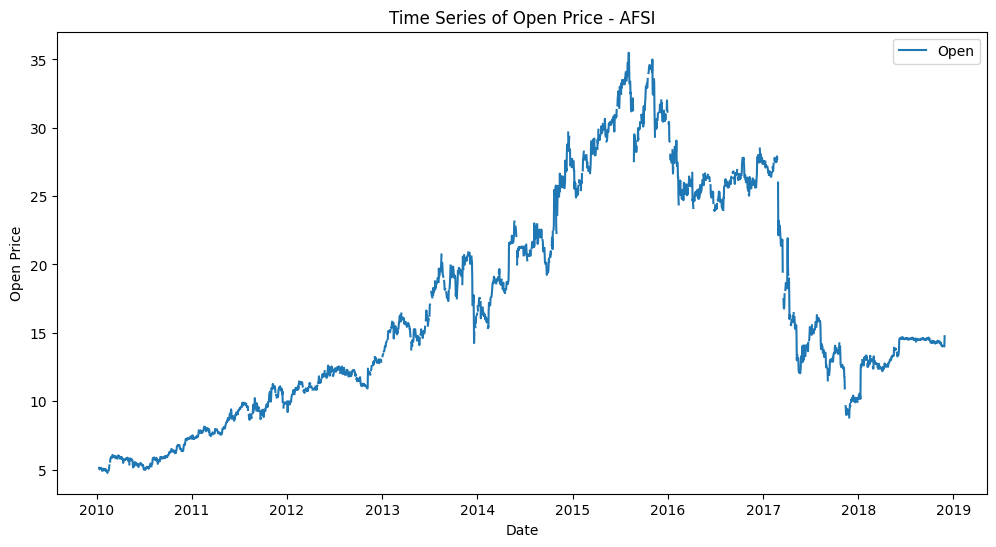

An error occurred for AFSI: This function does not handle missing values


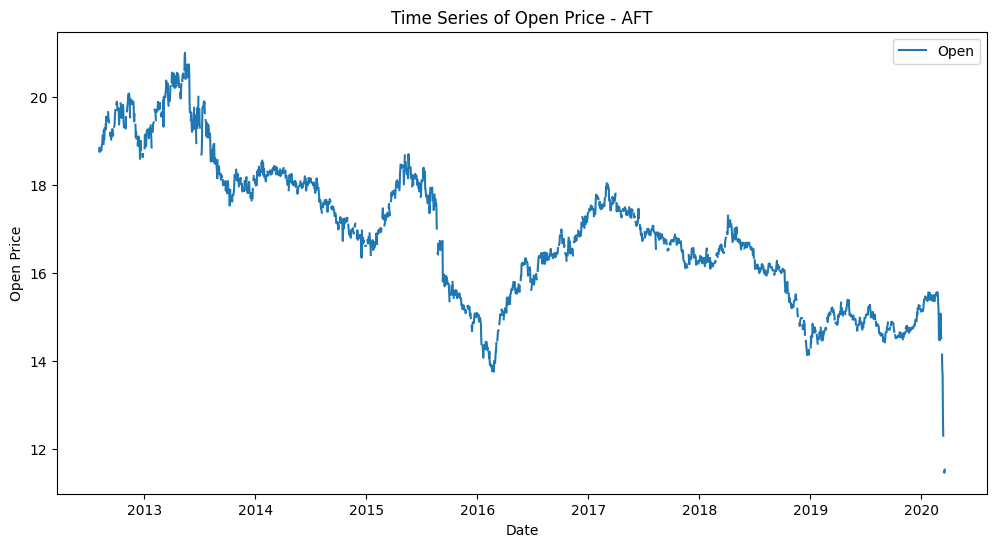

An error occurred for AFT: This function does not handle missing values


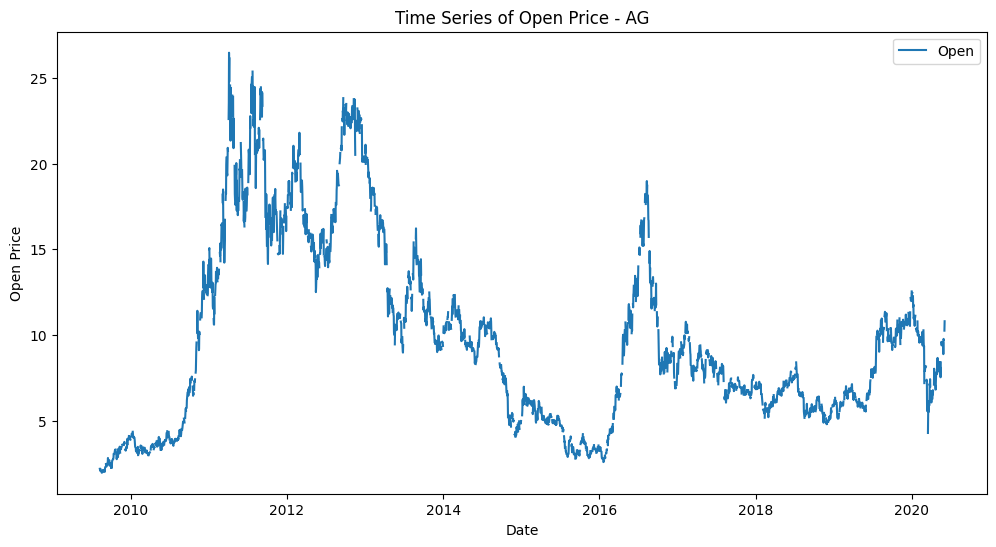

An error occurred for AG: This function does not handle missing values


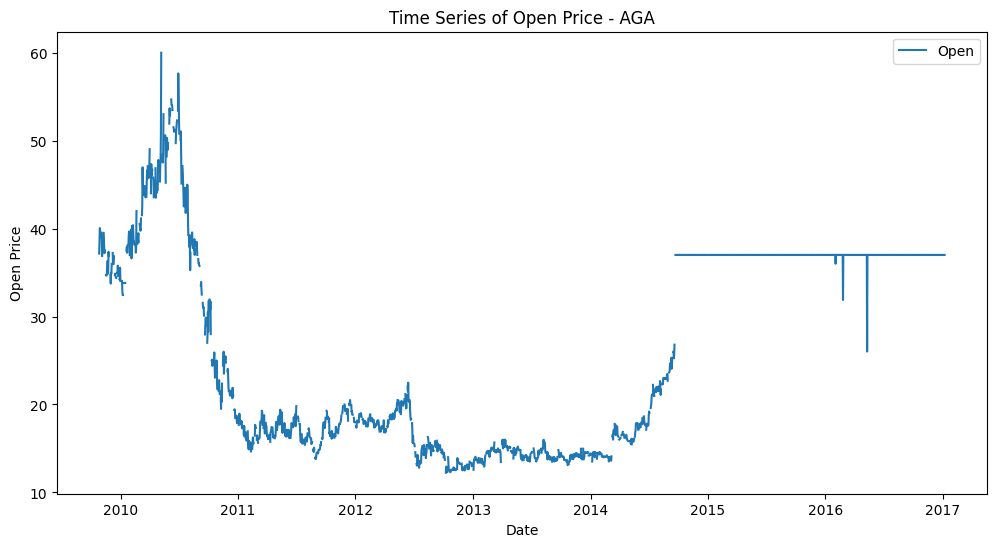

An error occurred for AGA: This function does not handle missing values


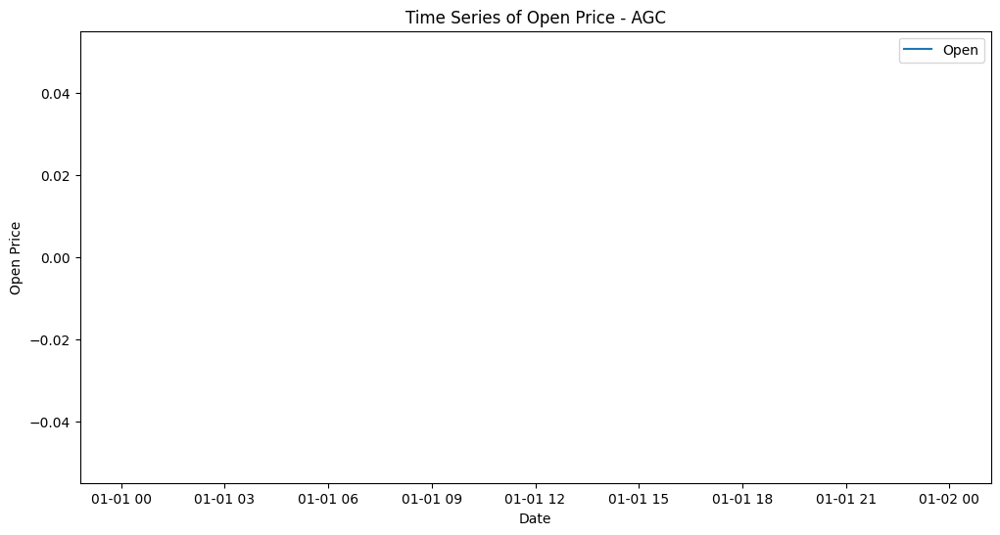

An error occurred for AGC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


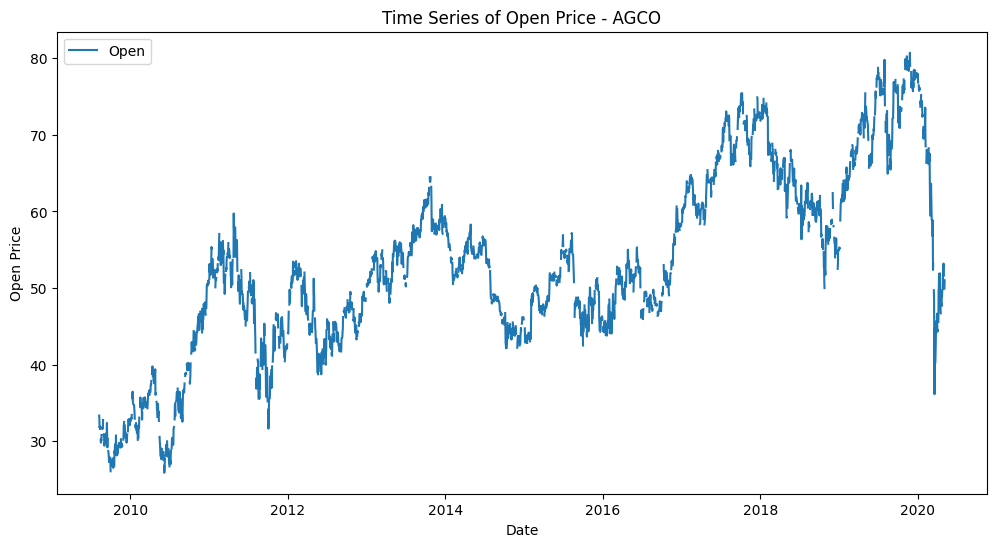

An error occurred for AGCO: This function does not handle missing values


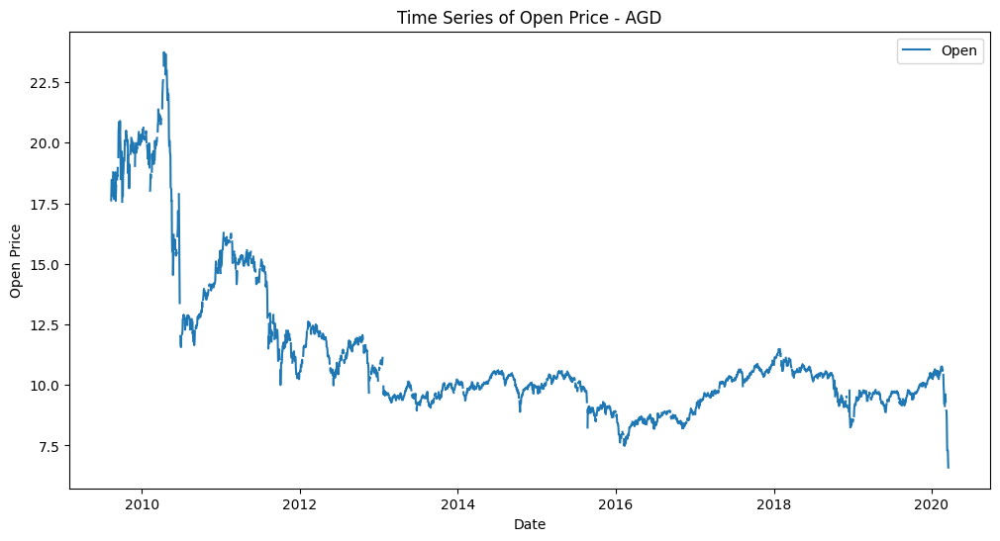

An error occurred for AGD: This function does not handle missing values


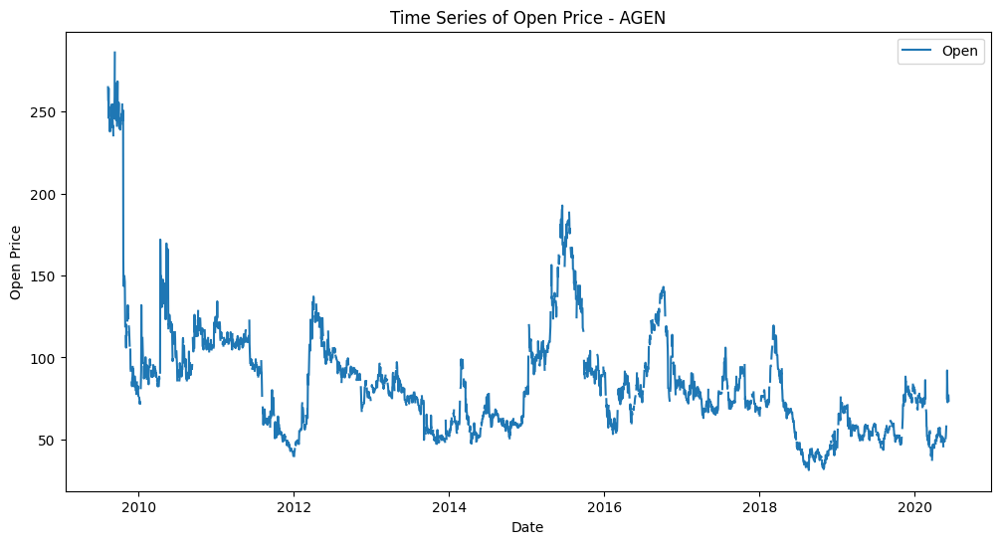

An error occurred for AGEN: This function does not handle missing values


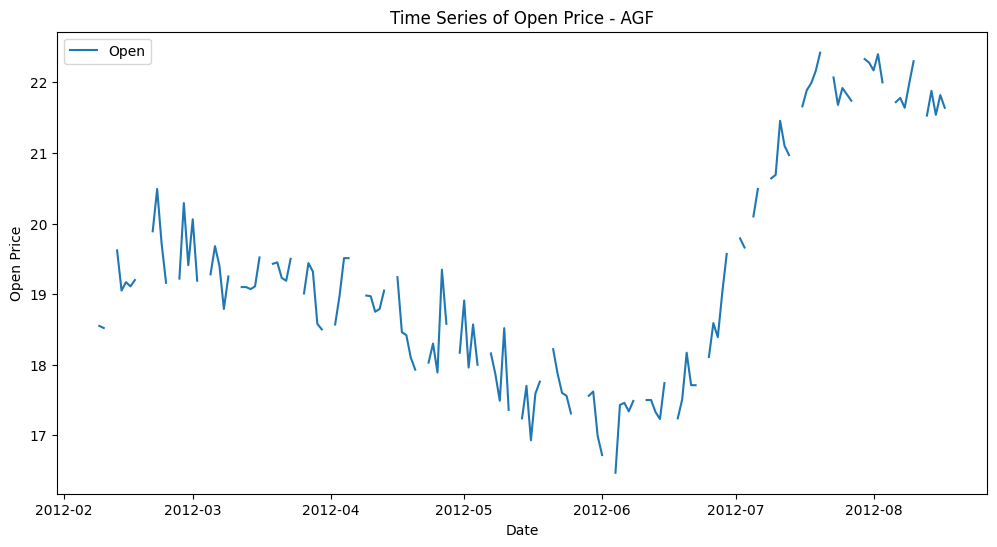

An error occurred for AGF: This function does not handle missing values


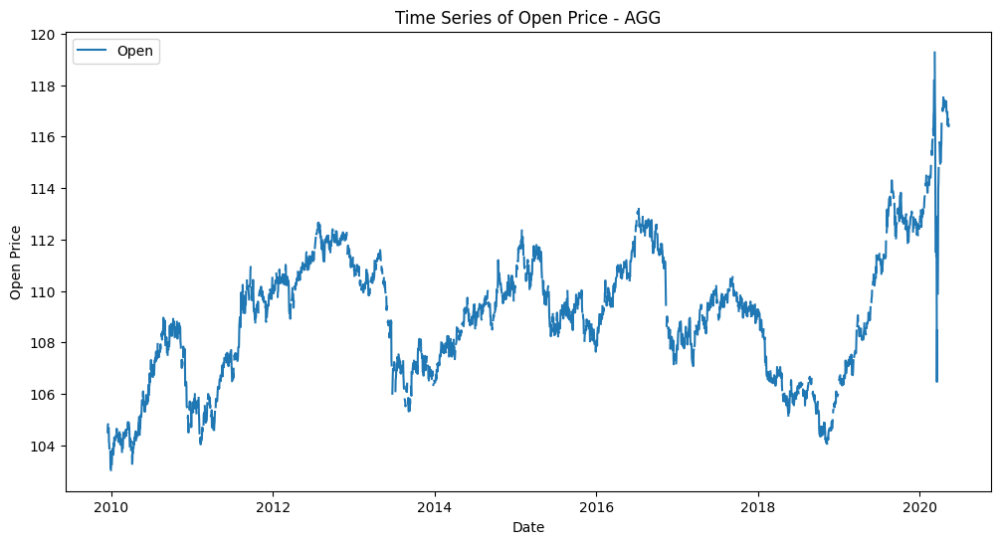

An error occurred for AGG: This function does not handle missing values


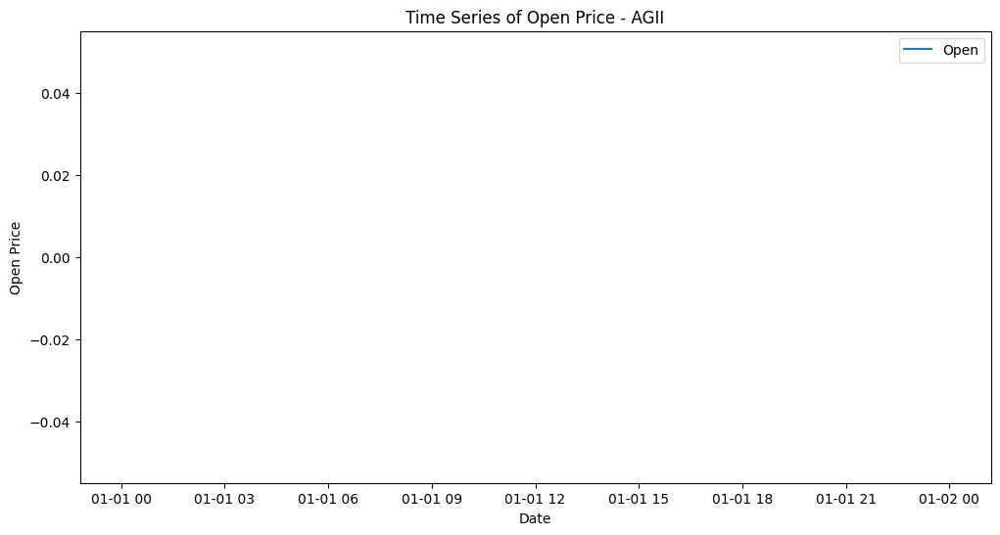

An error occurred for AGII: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


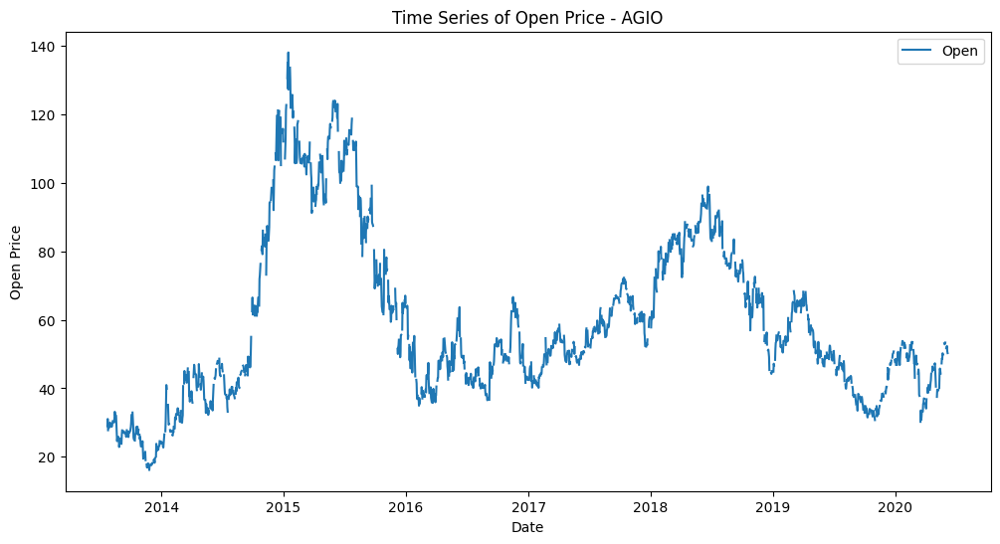

An error occurred for AGIO: This function does not handle missing values


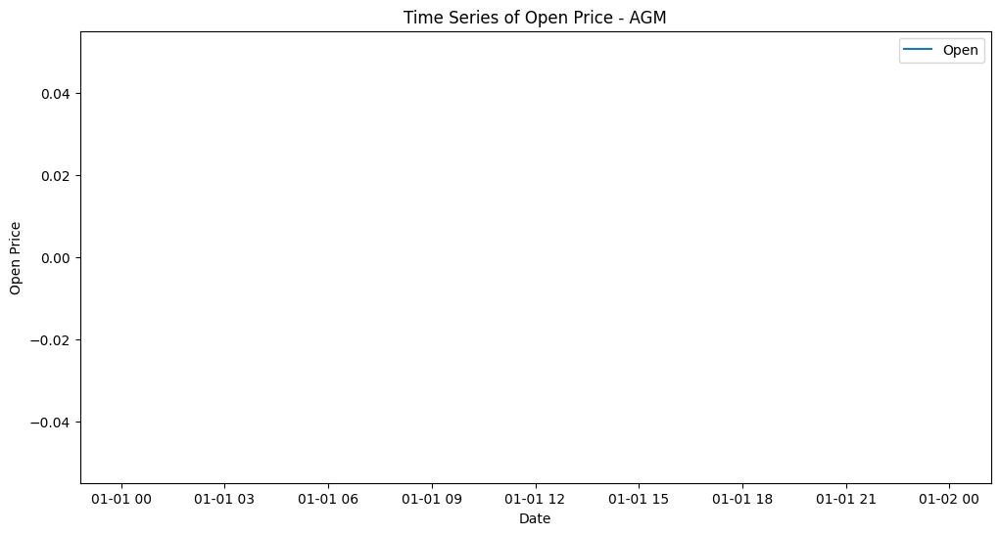

An error occurred for AGM: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


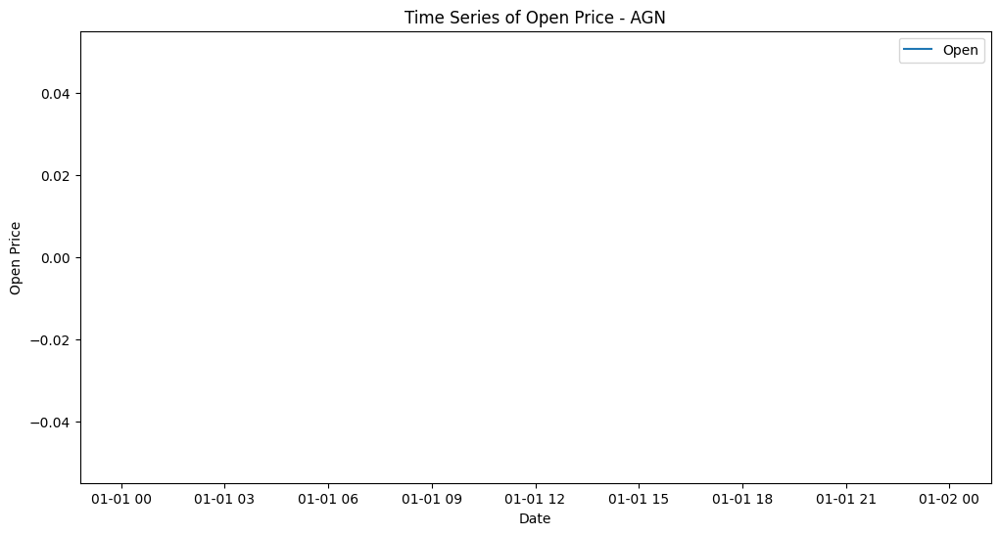

An error occurred for AGN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


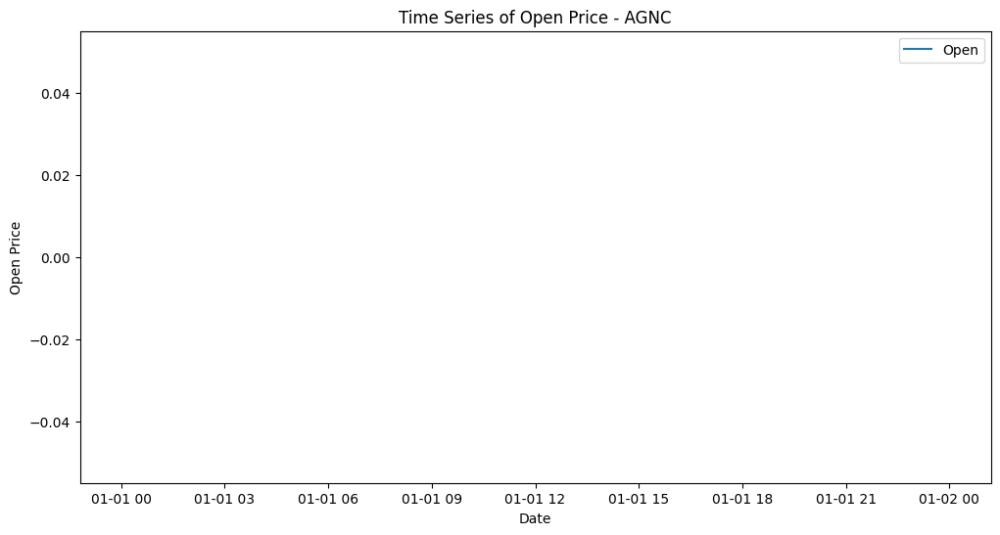

An error occurred for AGNC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


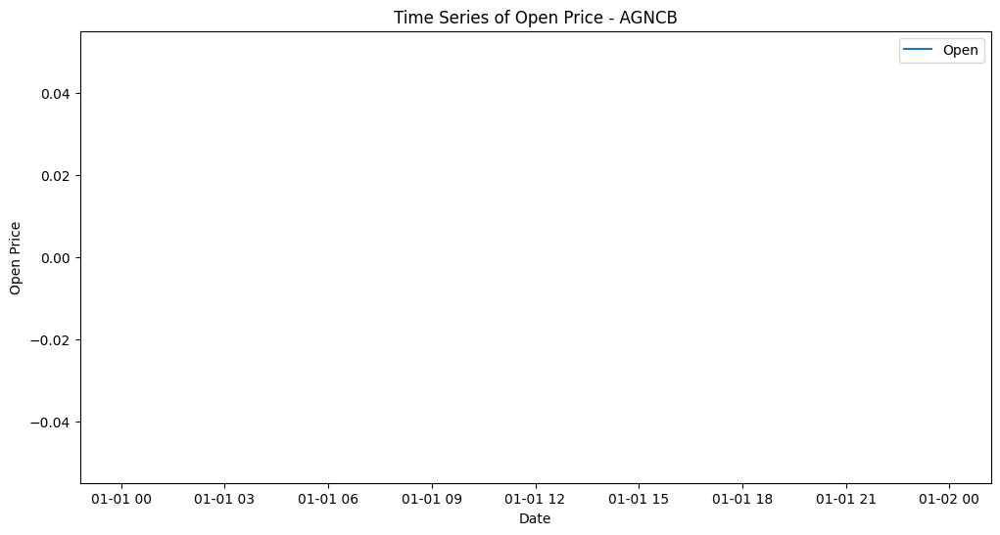

An error occurred for AGNCB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


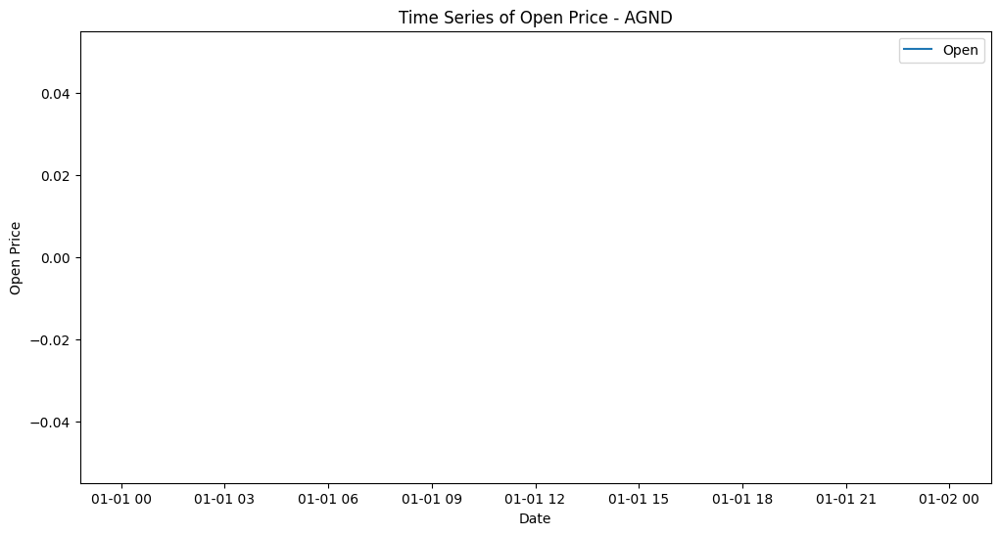

An error occurred for AGND: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


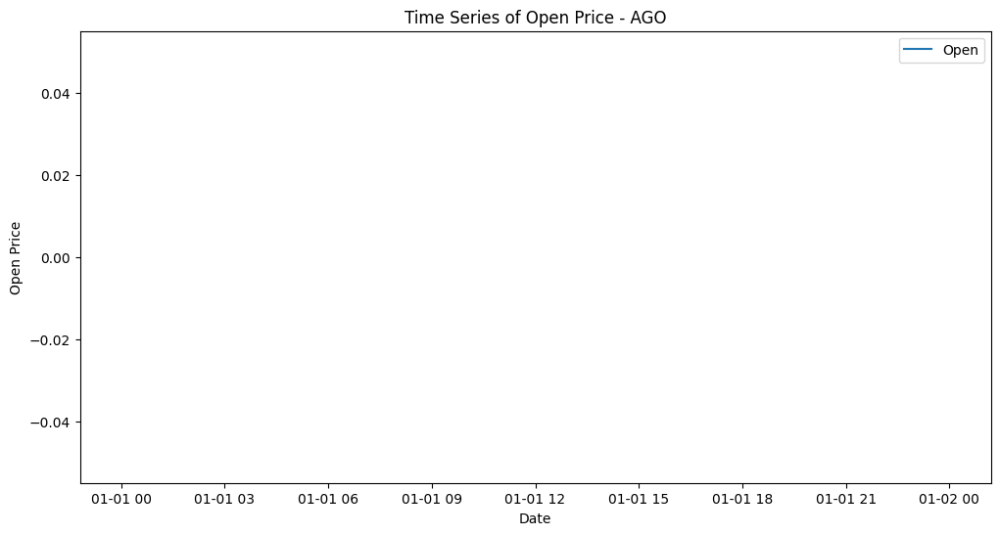

An error occurred for AGO: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


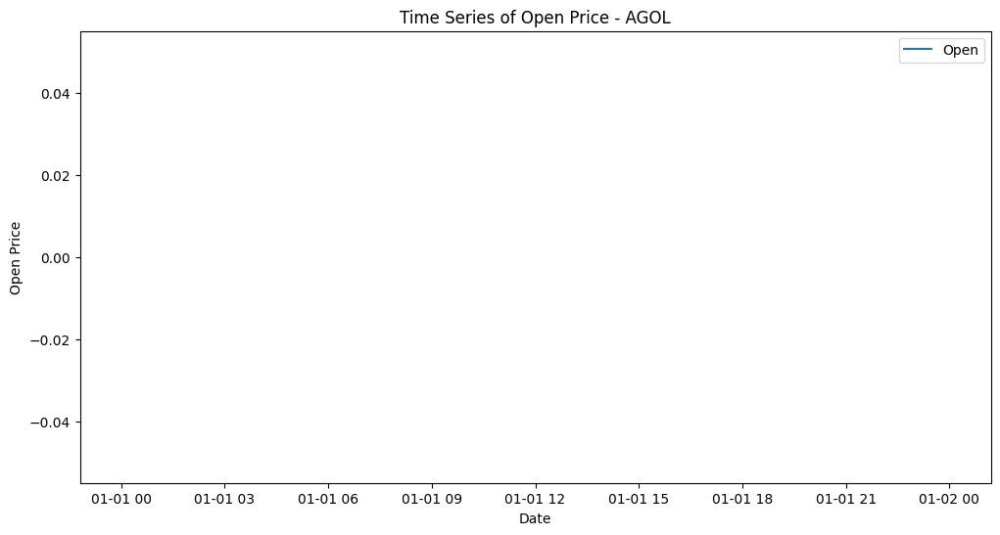

An error occurred for AGOL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


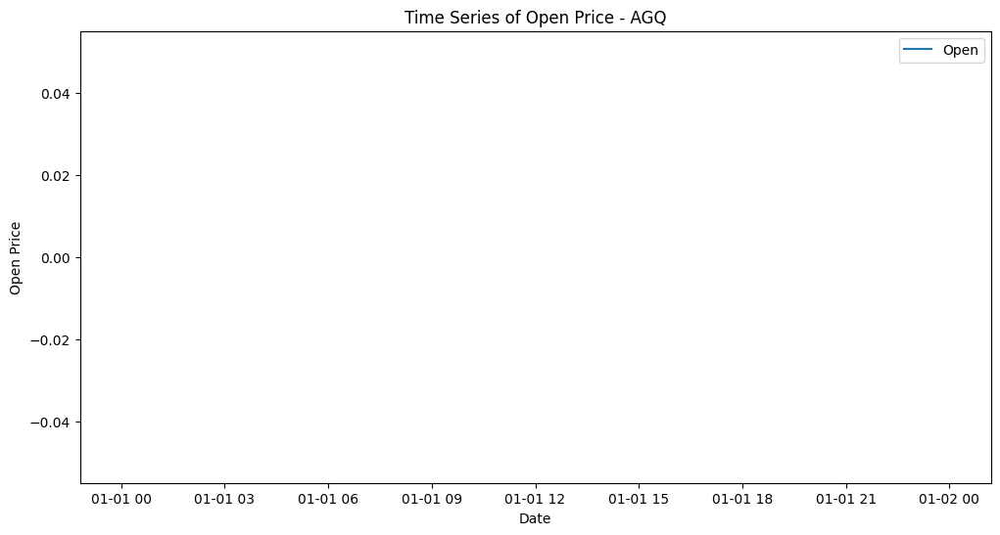

An error occurred for AGQ: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


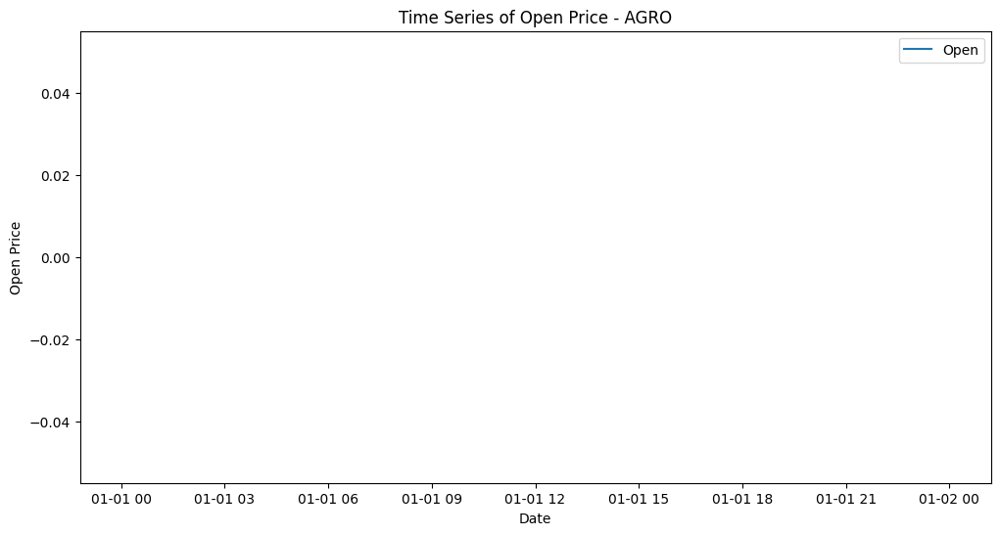

An error occurred for AGRO: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


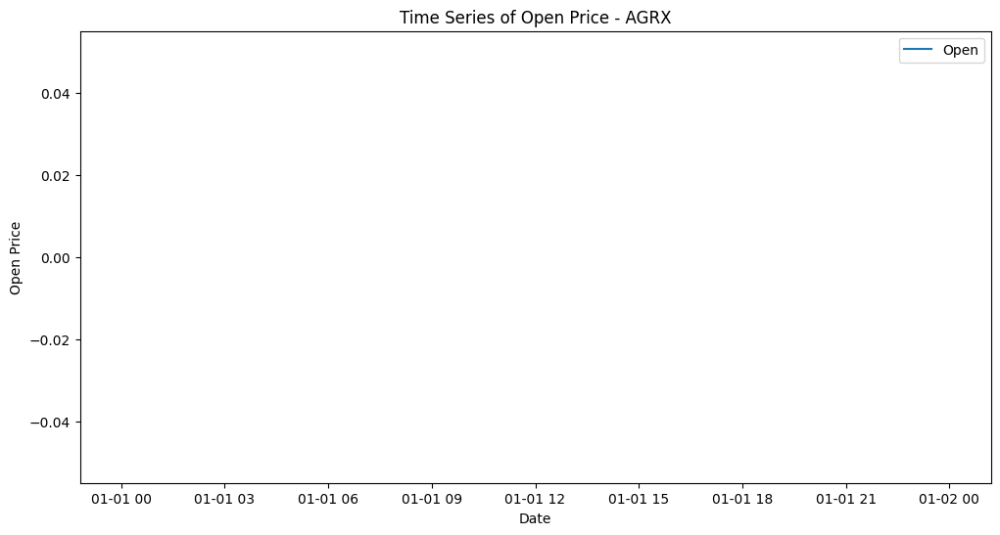

An error occurred for AGRX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


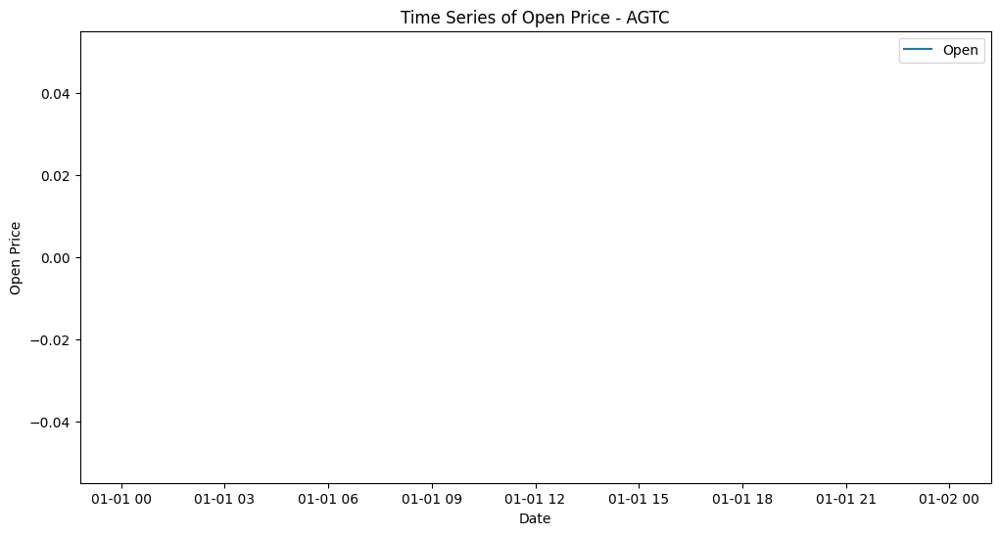

An error occurred for AGTC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


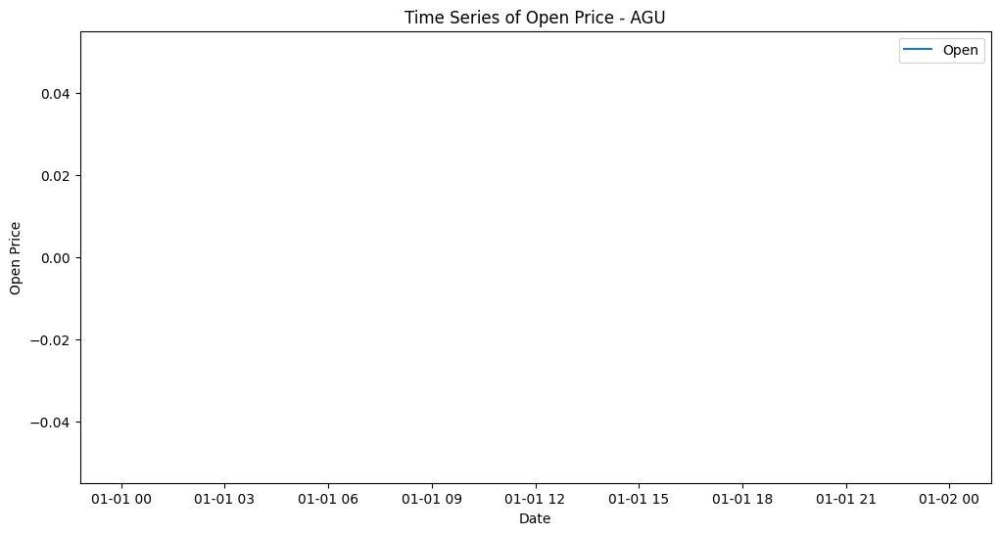

An error occurred for AGU: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


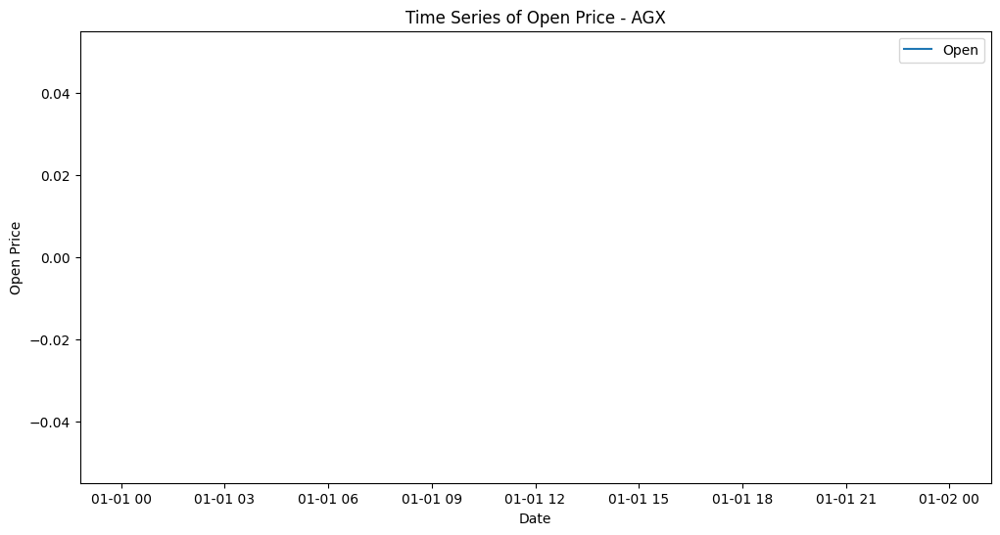

An error occurred for AGX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


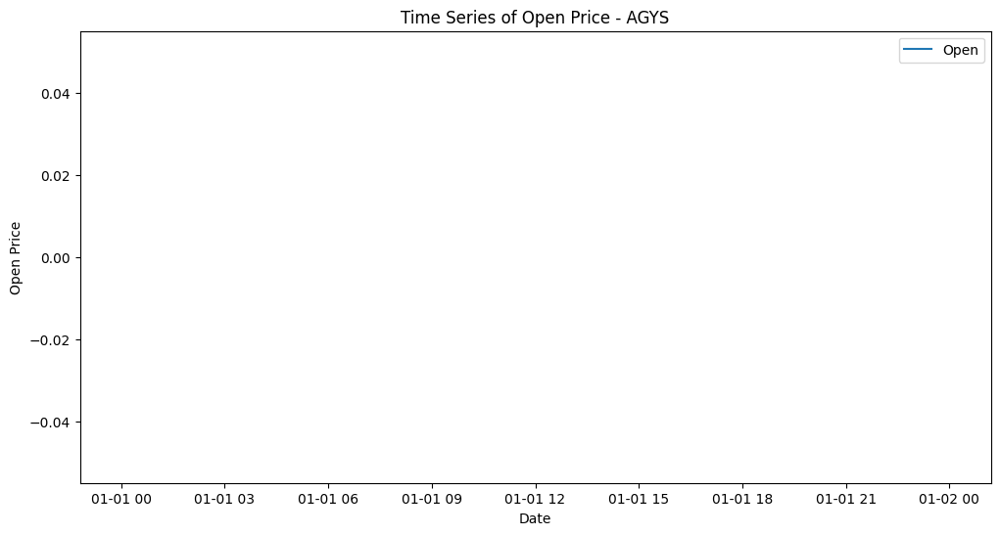

An error occurred for AGYS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


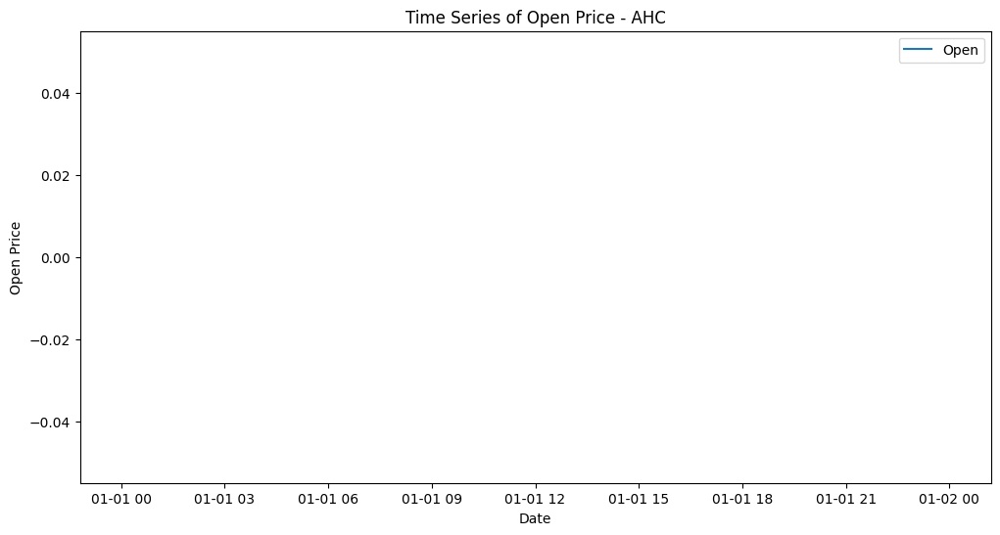

An error occurred for AHC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


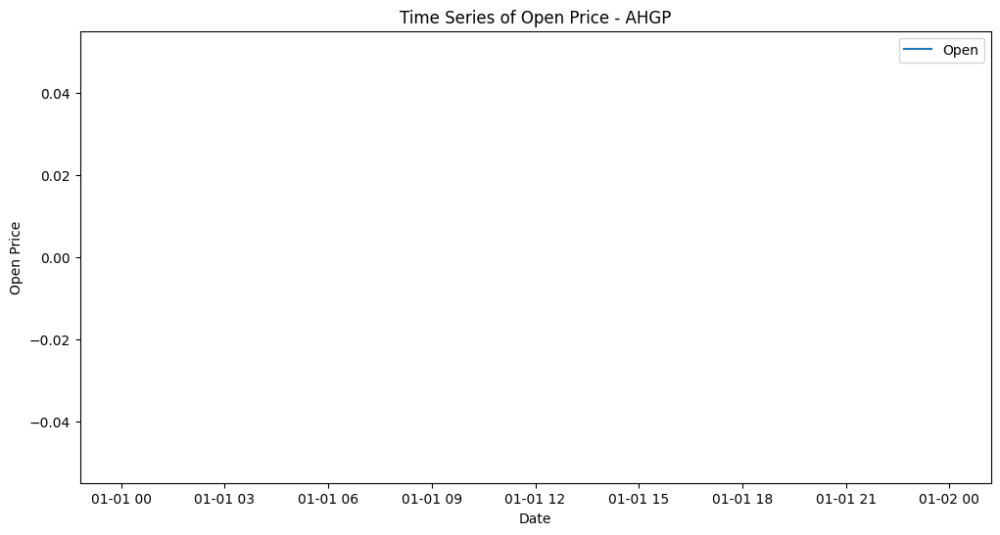

An error occurred for AHGP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


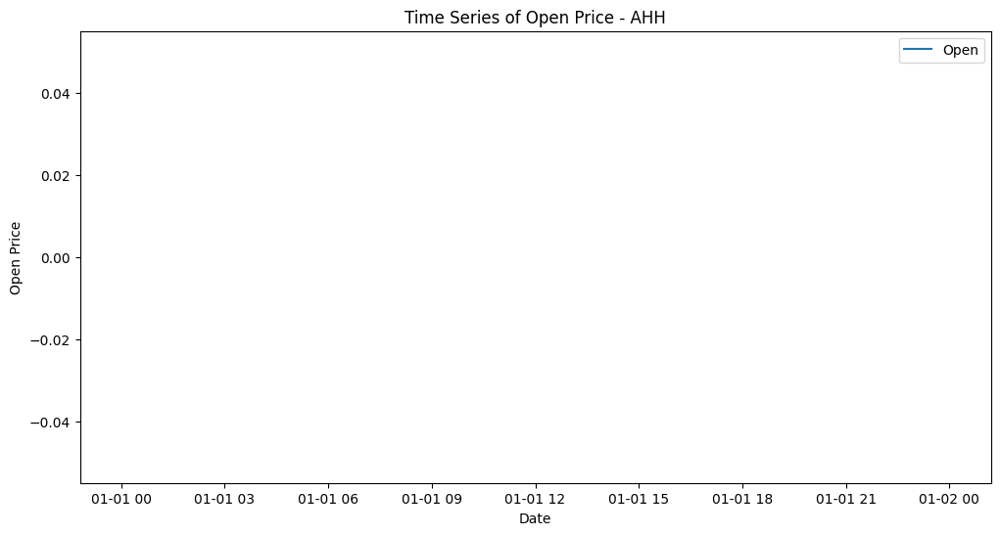

An error occurred for AHH: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


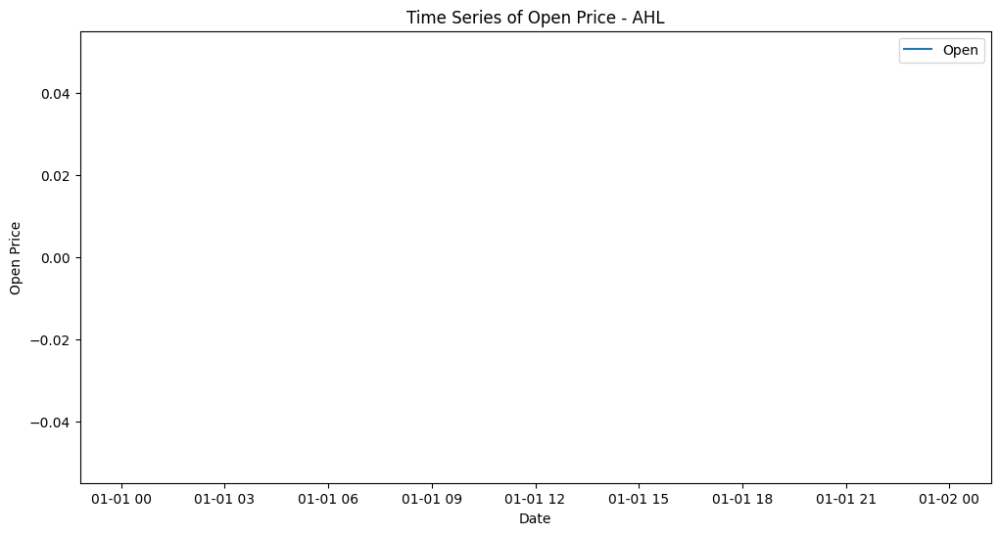

An error occurred for AHL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


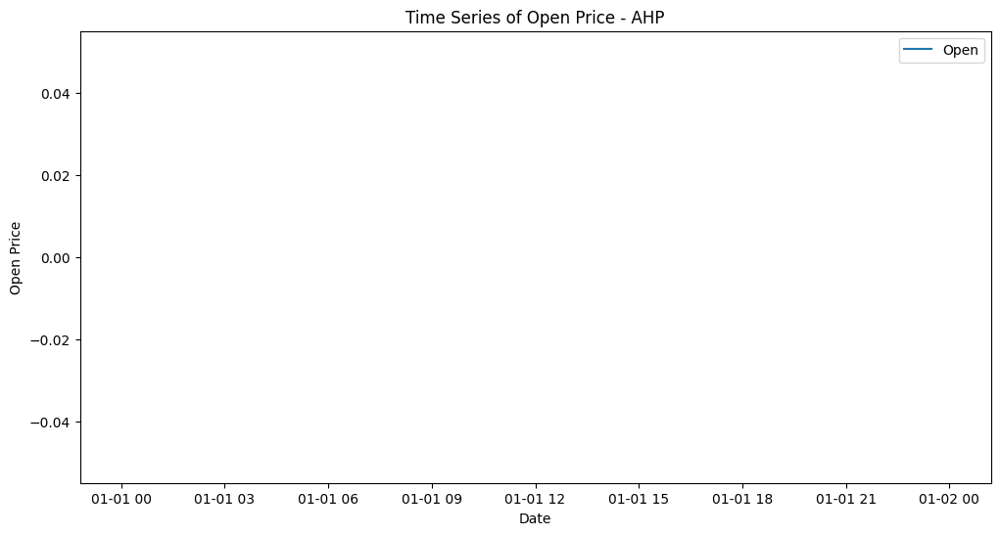

An error occurred for AHP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


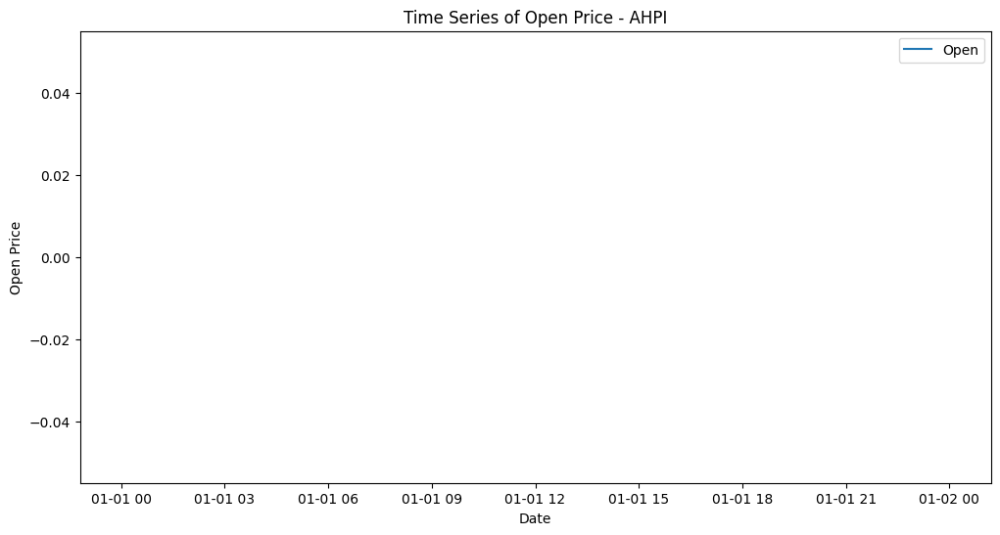

An error occurred for AHPI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


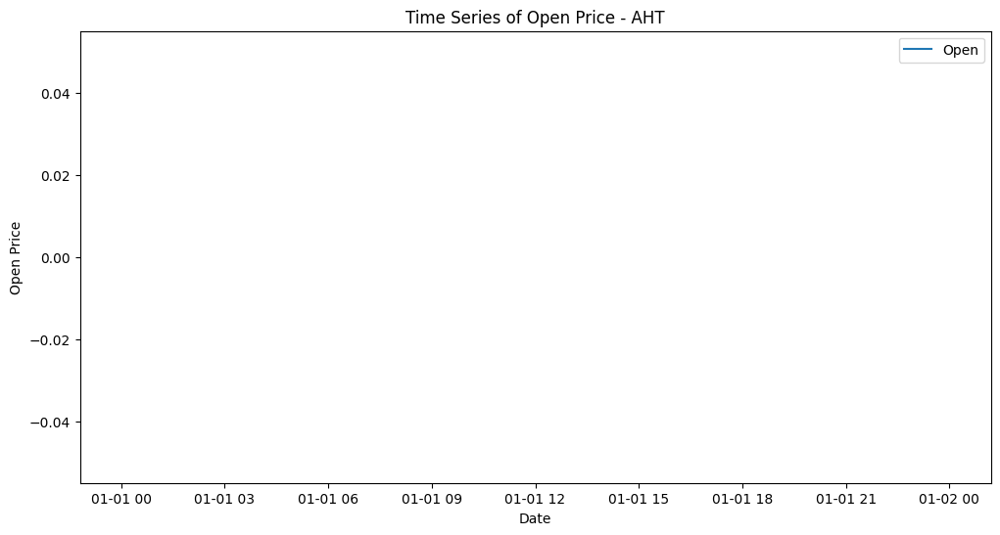

An error occurred for AHT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


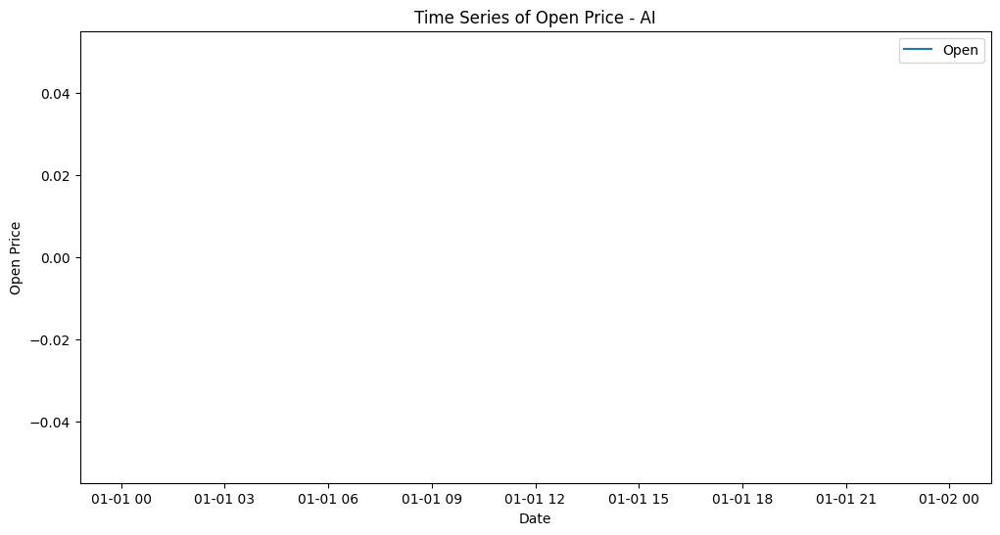

An error occurred for AI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


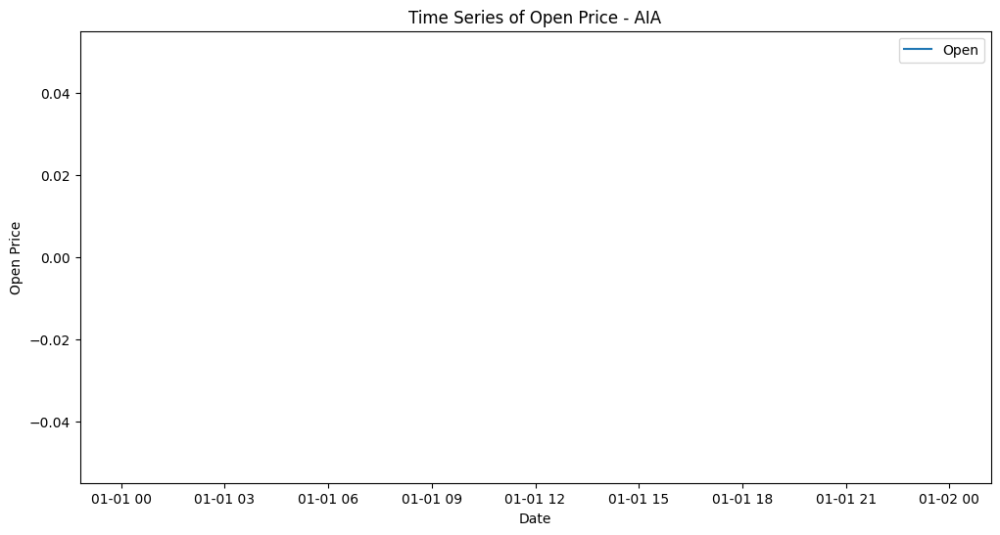

An error occurred for AIA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


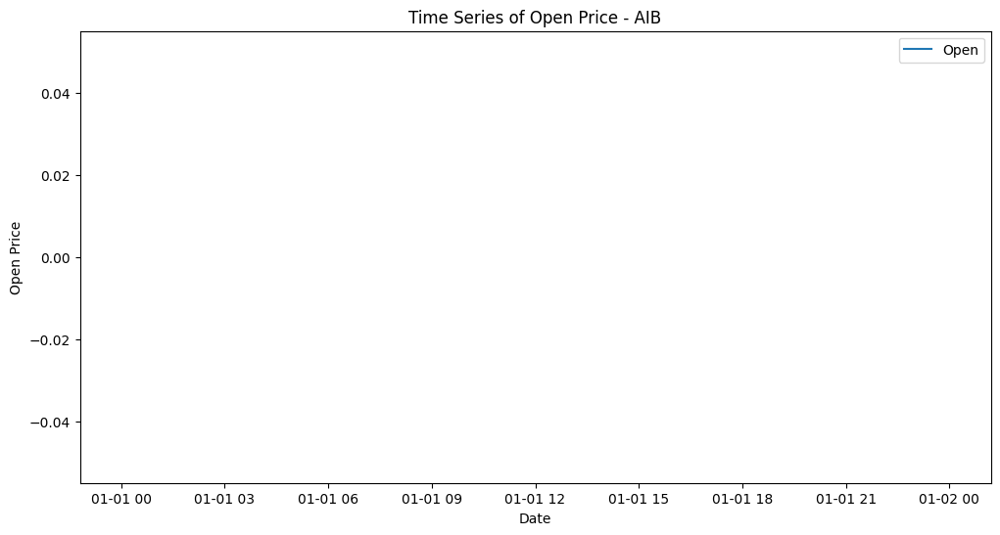

An error occurred for AIB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


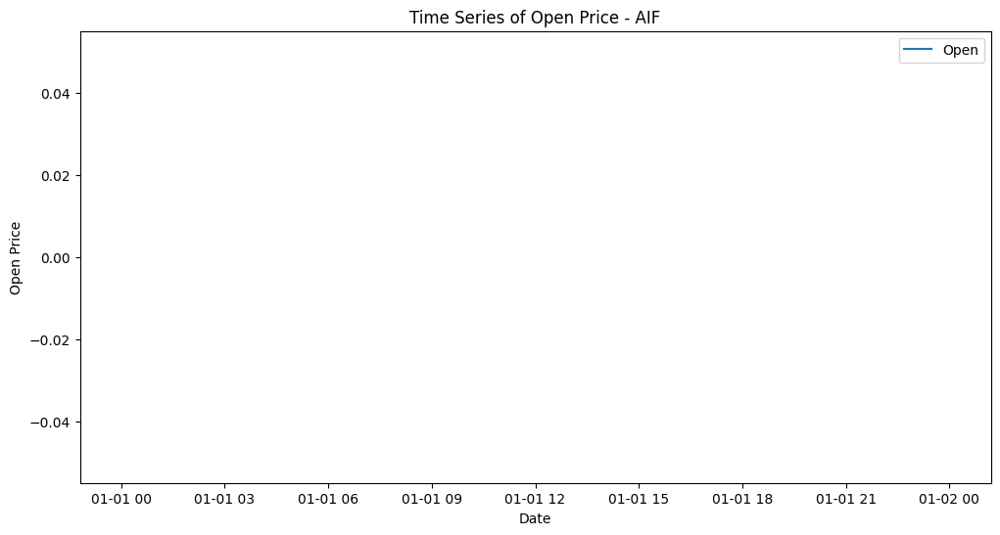

An error occurred for AIF: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


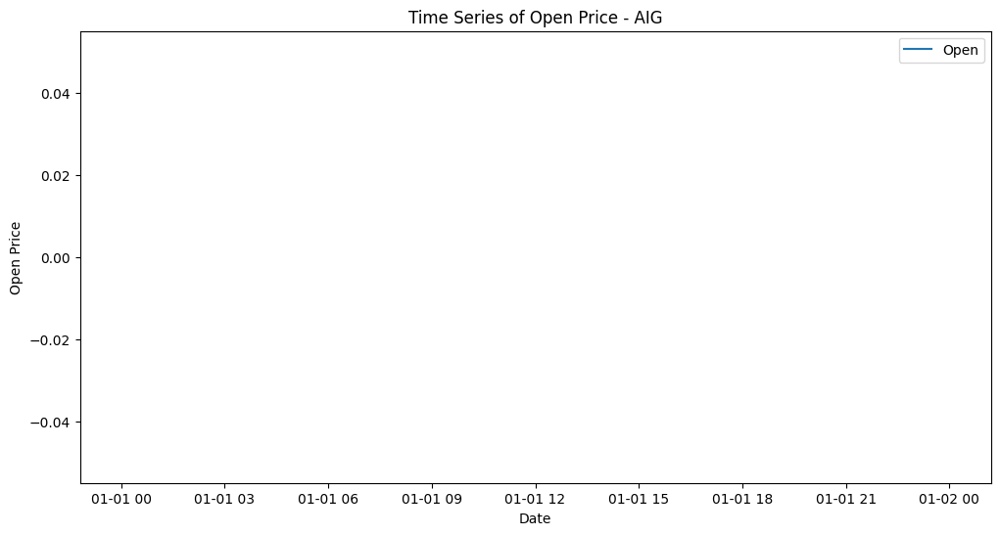

An error occurred for AIG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


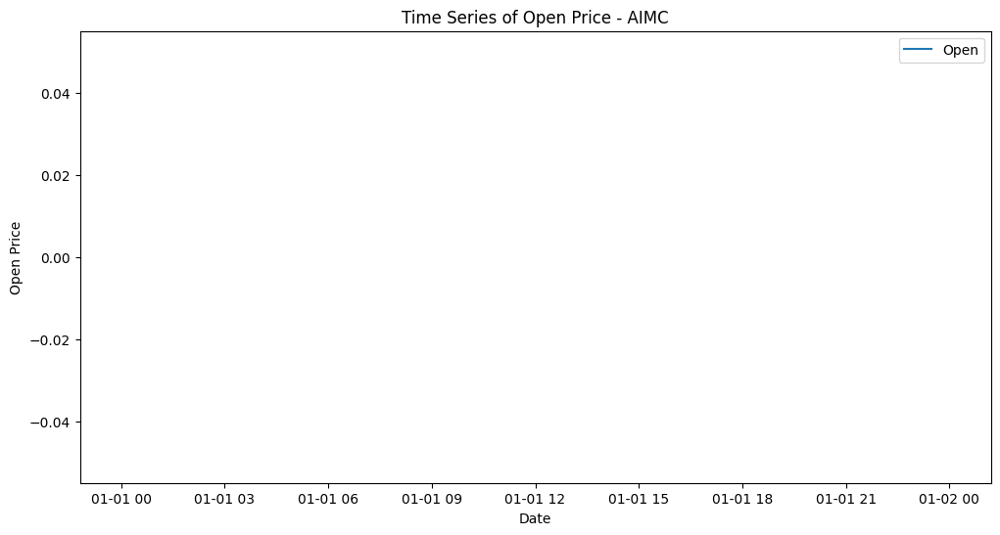

An error occurred for AIMC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


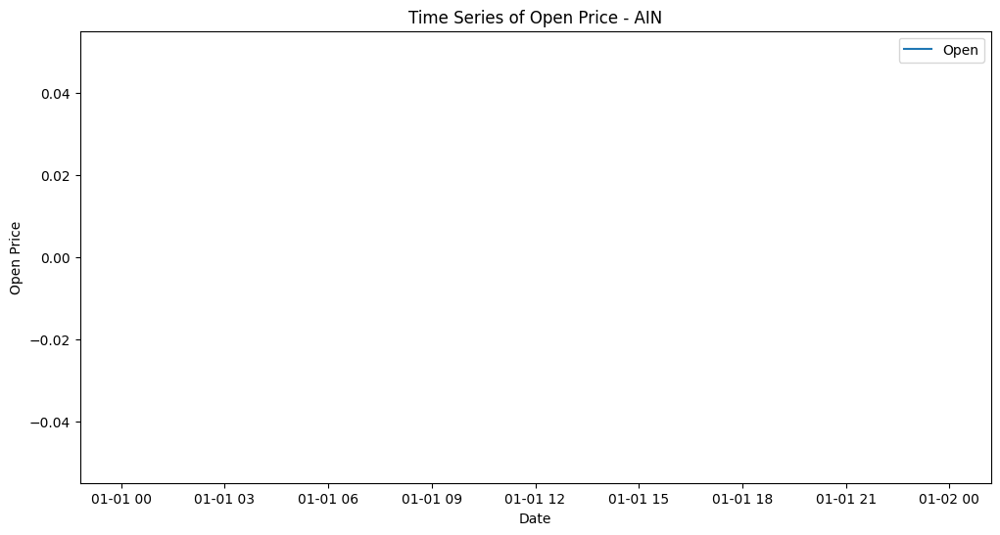

An error occurred for AIN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


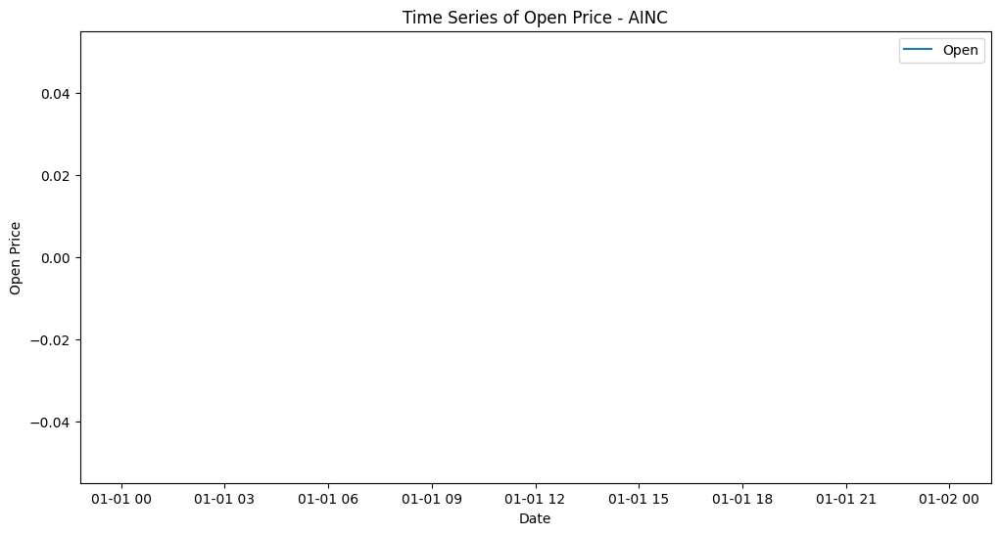

An error occurred for AINC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


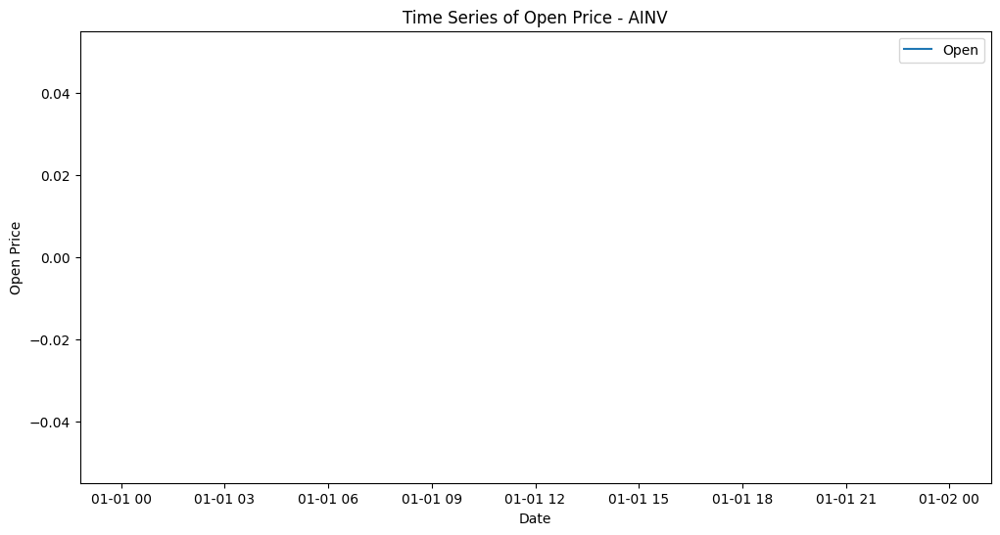

An error occurred for AINV: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


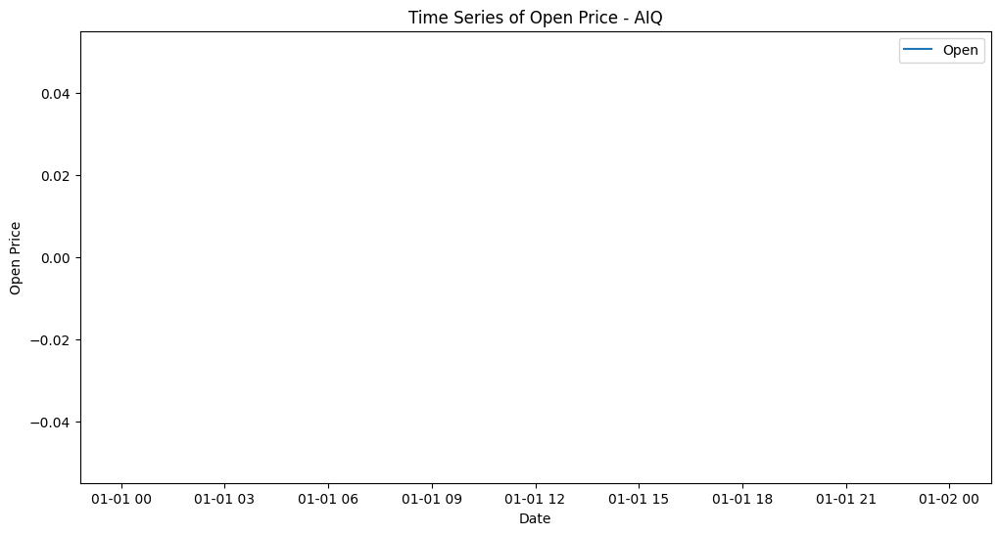

An error occurred for AIQ: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


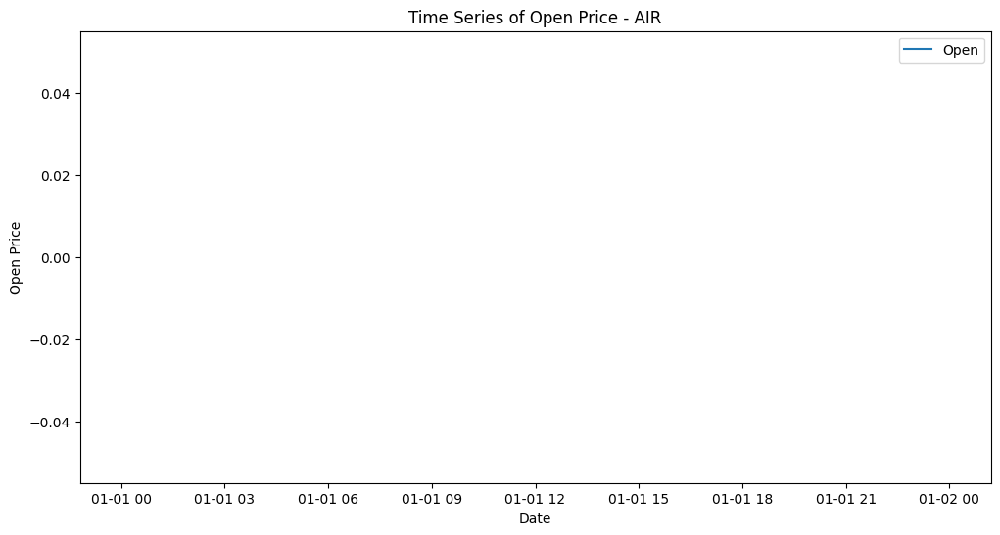

An error occurred for AIR: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


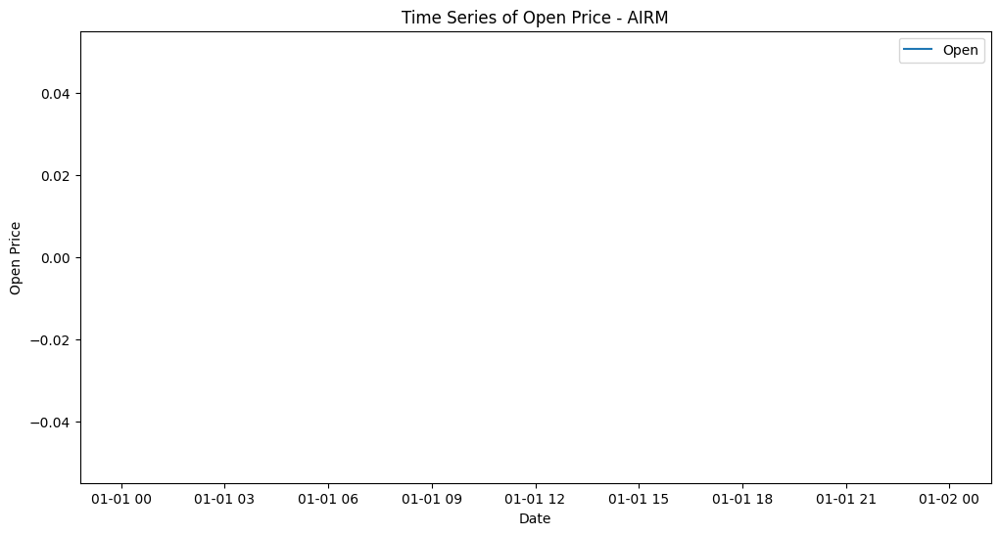

An error occurred for AIRM: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


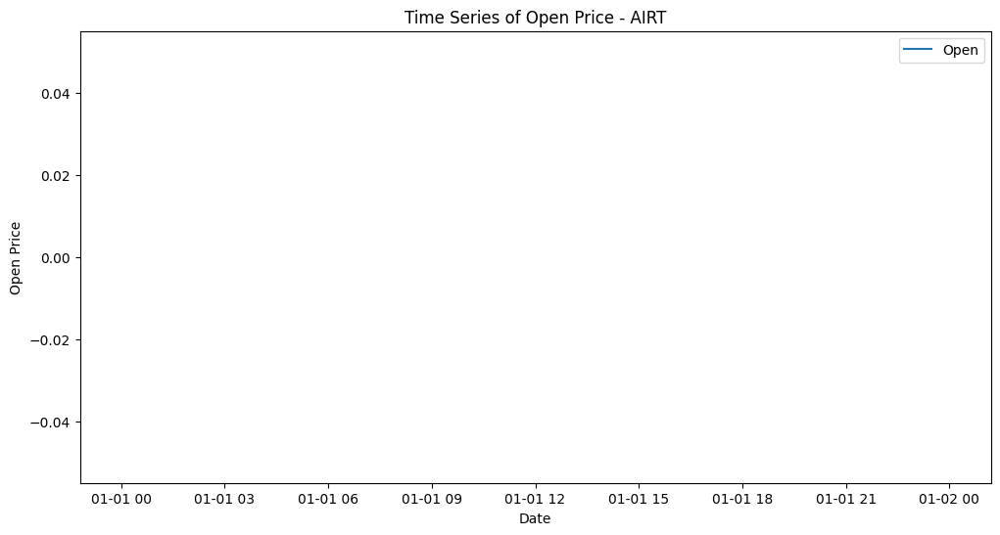

An error occurred for AIRT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


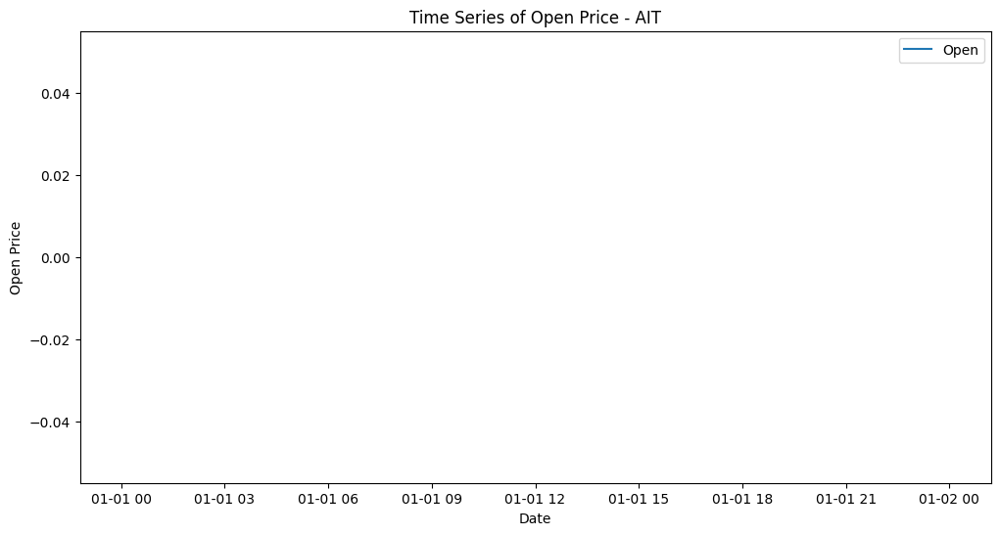

An error occurred for AIT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


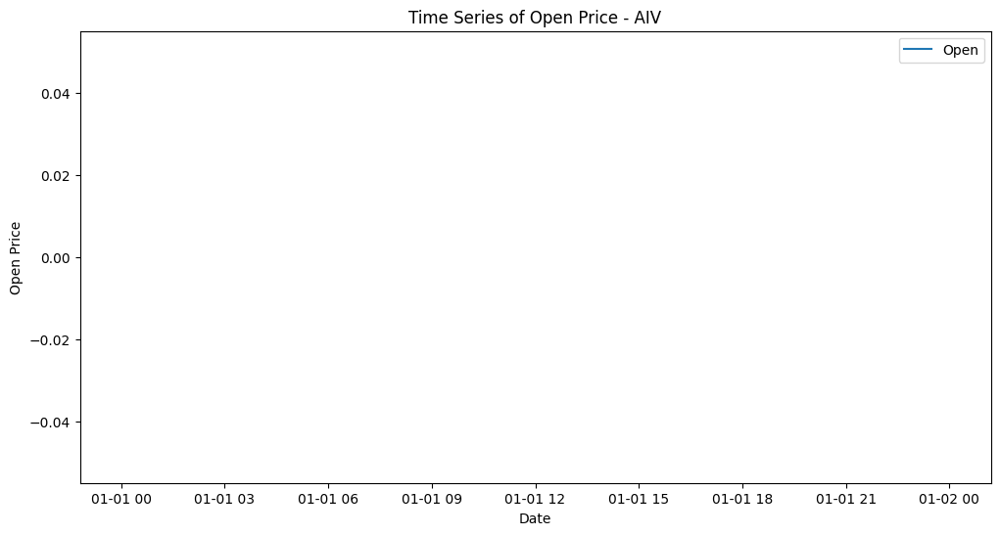

An error occurred for AIV: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


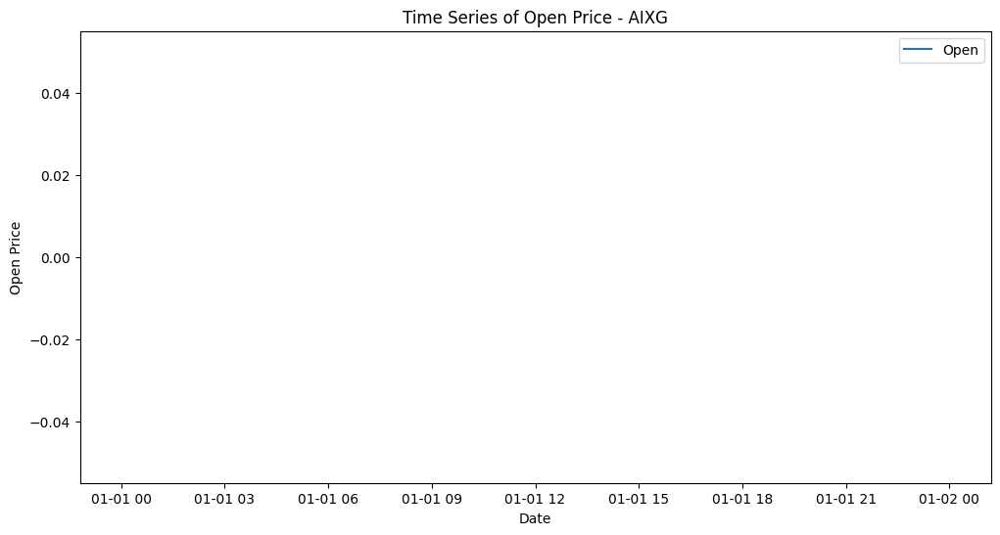

An error occurred for AIXG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


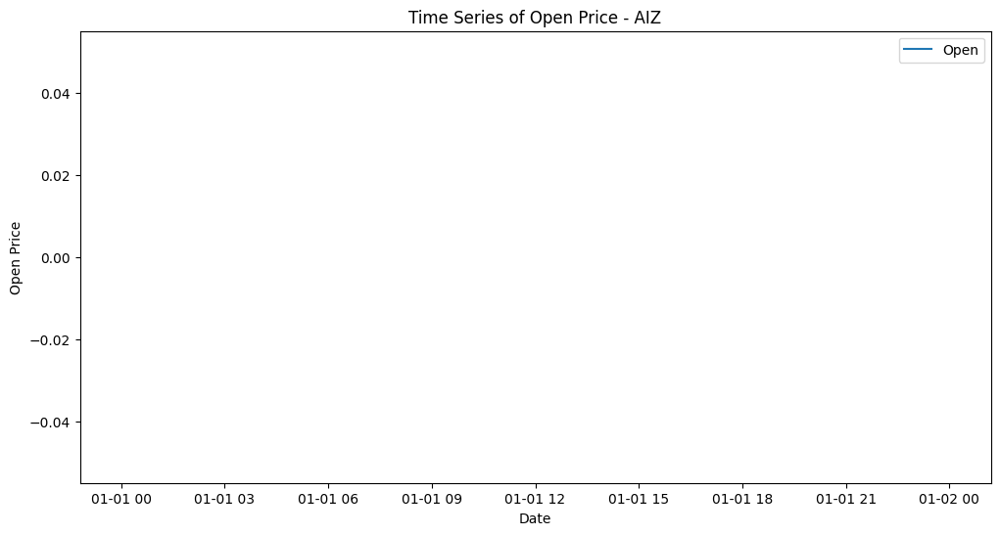

An error occurred for AIZ: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


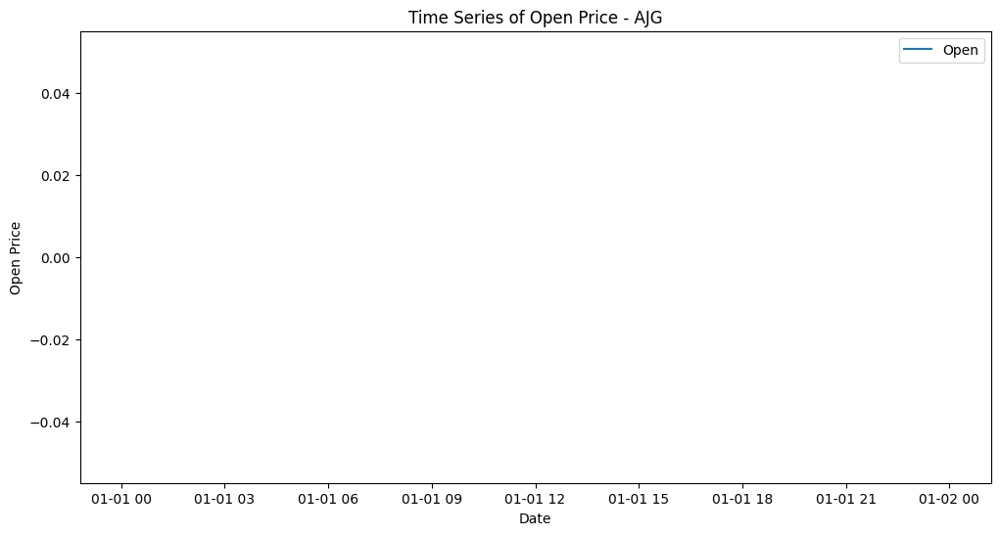

An error occurred for AJG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


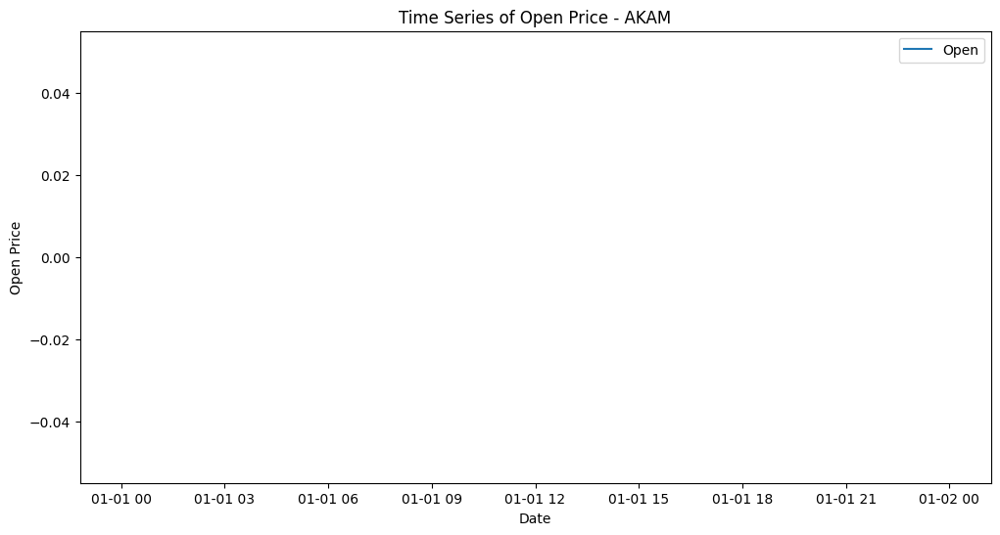

An error occurred for AKAM: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


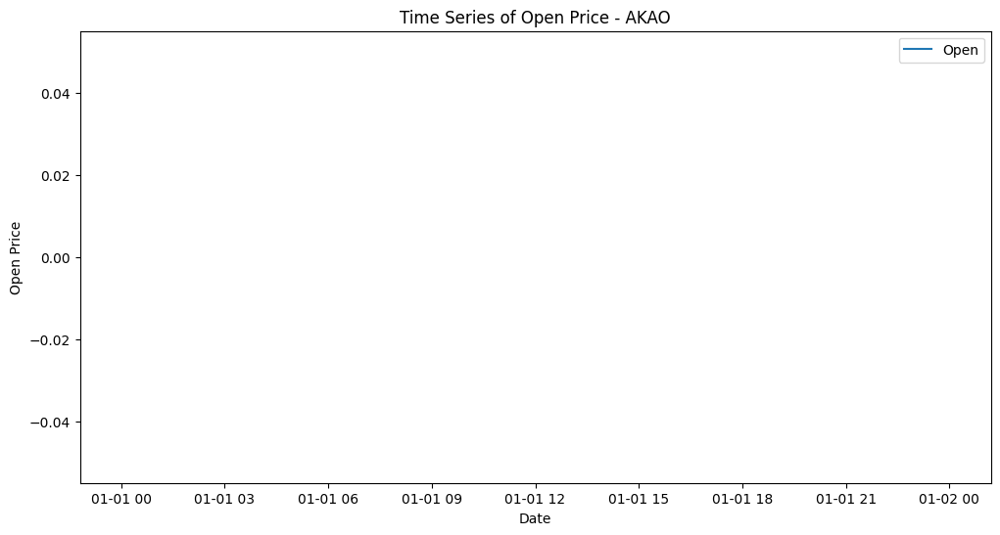

An error occurred for AKAO: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


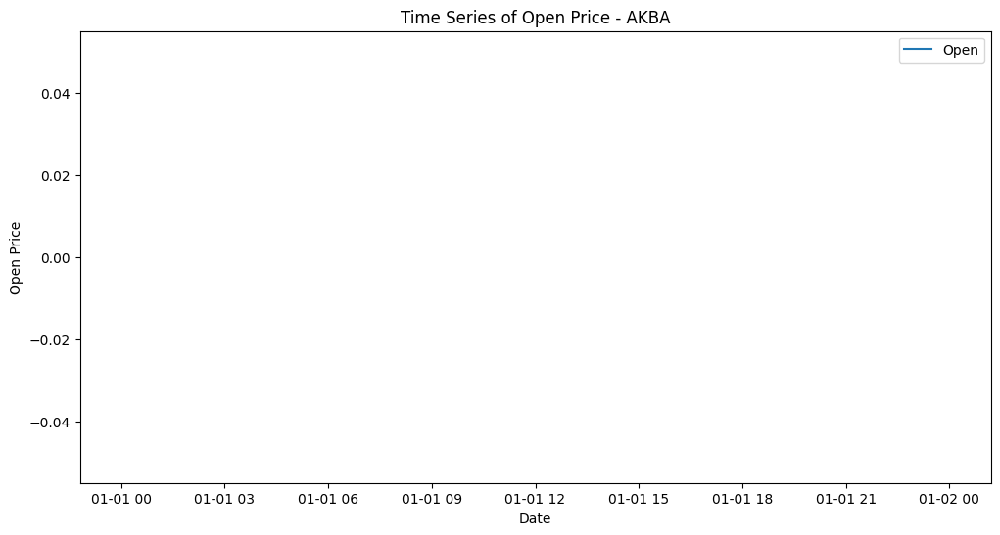

An error occurred for AKBA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


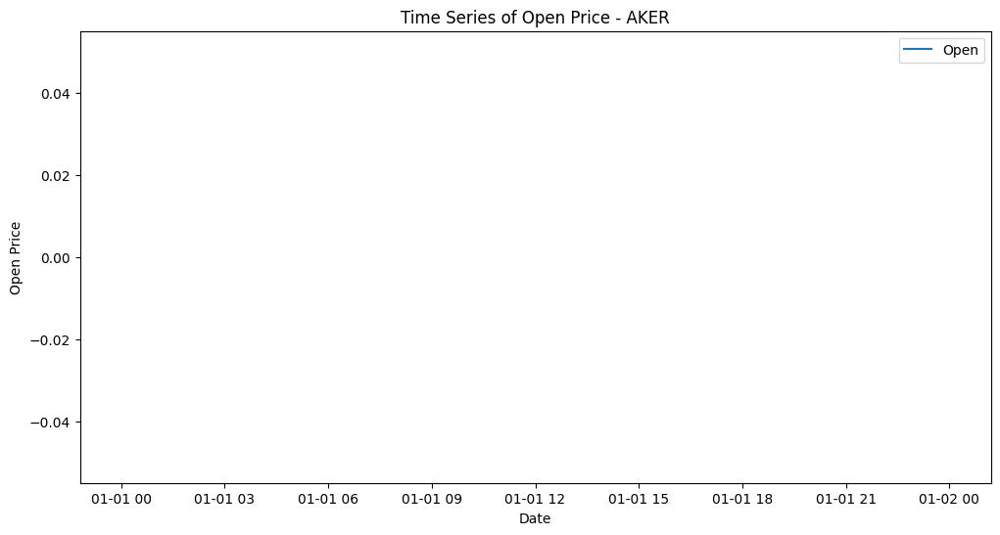

An error occurred for AKER: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


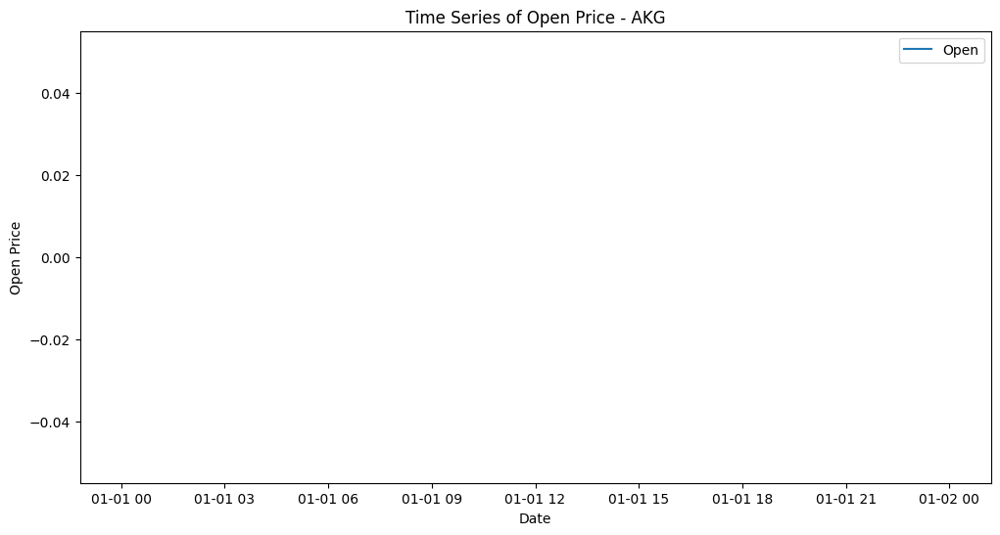

An error occurred for AKG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


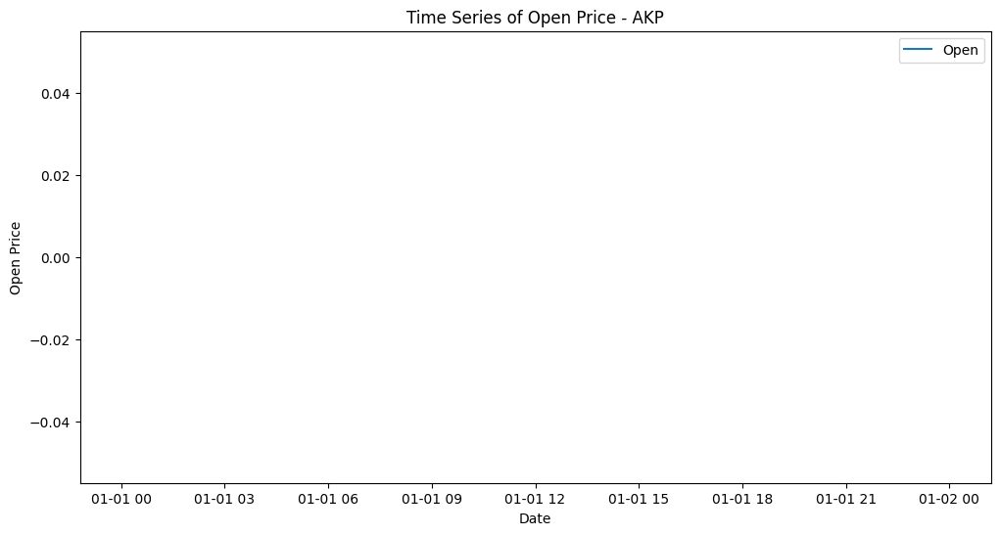

An error occurred for AKP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


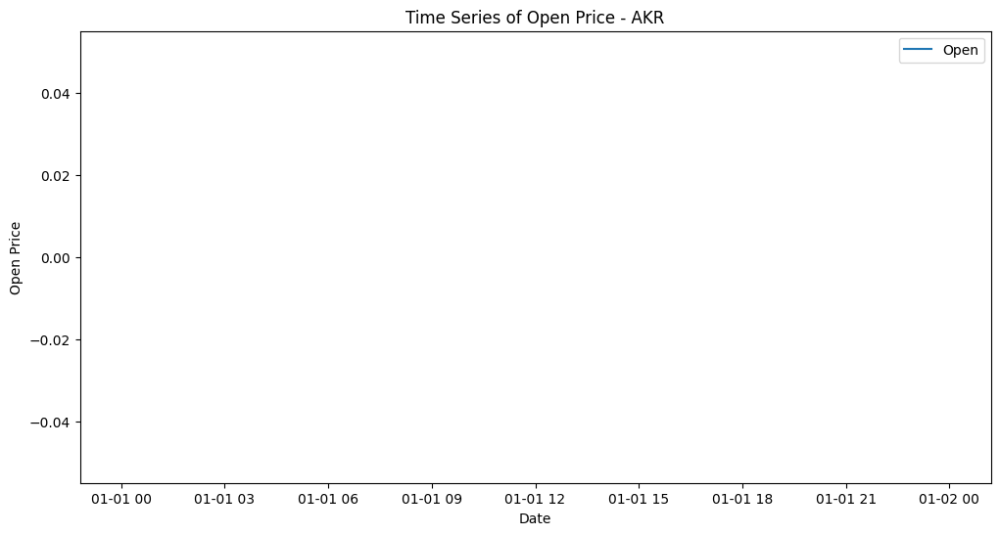

An error occurred for AKR: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


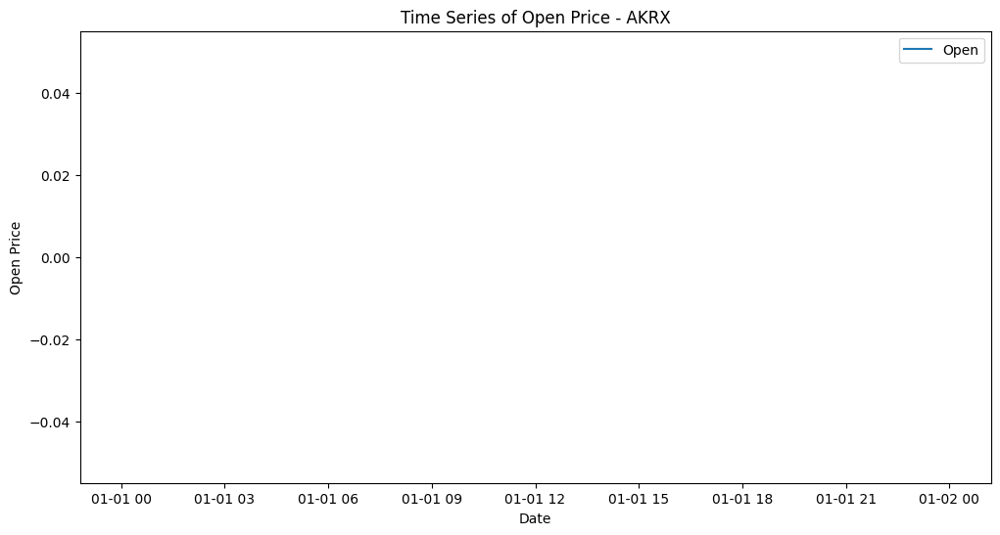

An error occurred for AKRX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


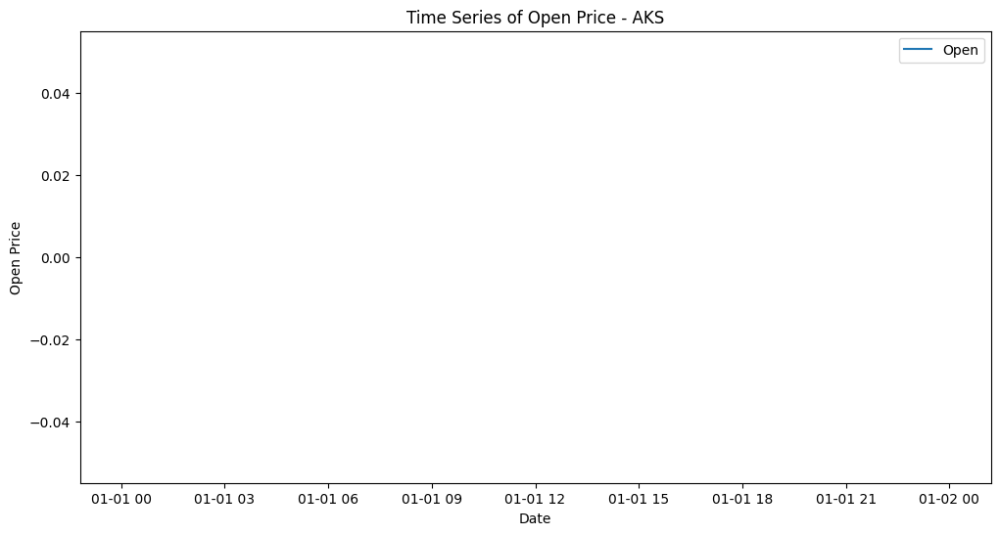

An error occurred for AKS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


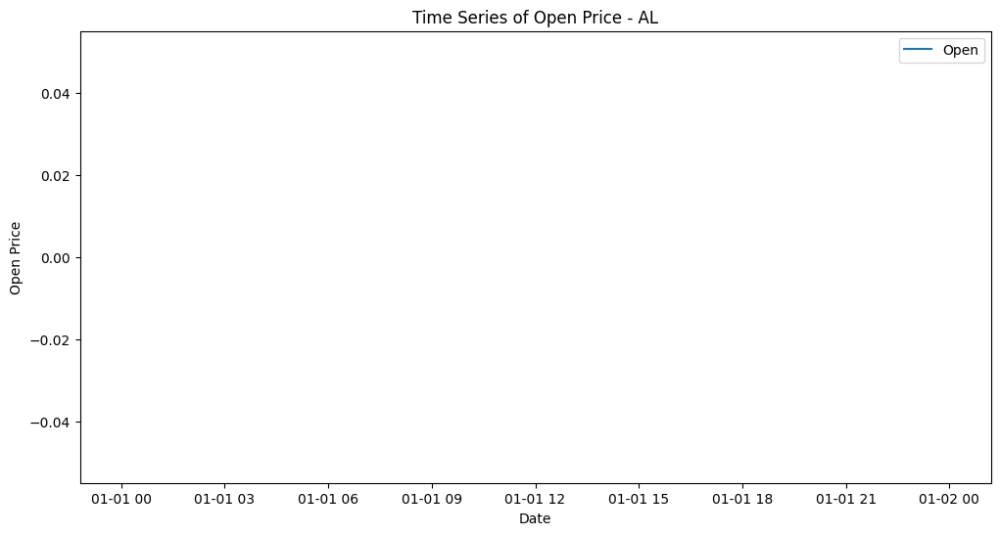

An error occurred for AL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


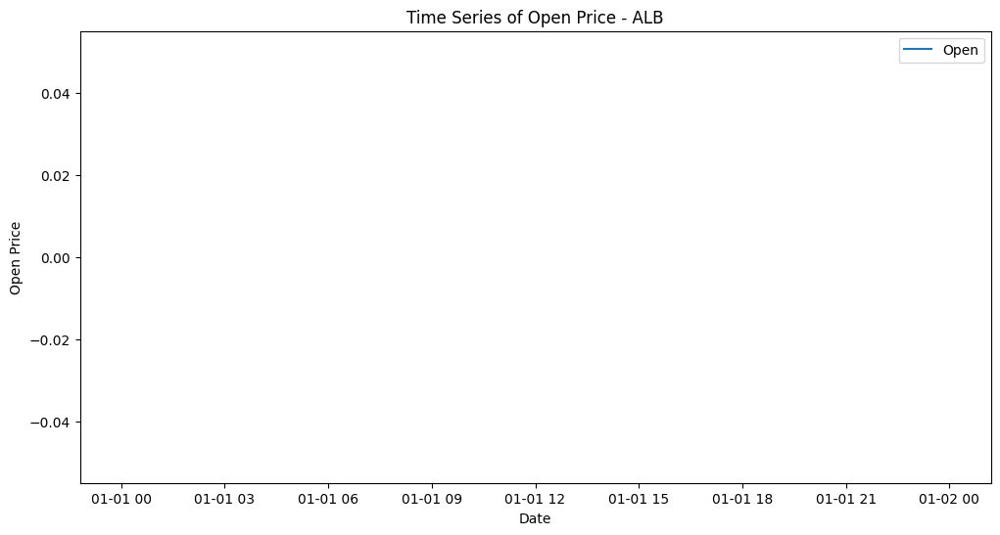

An error occurred for ALB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


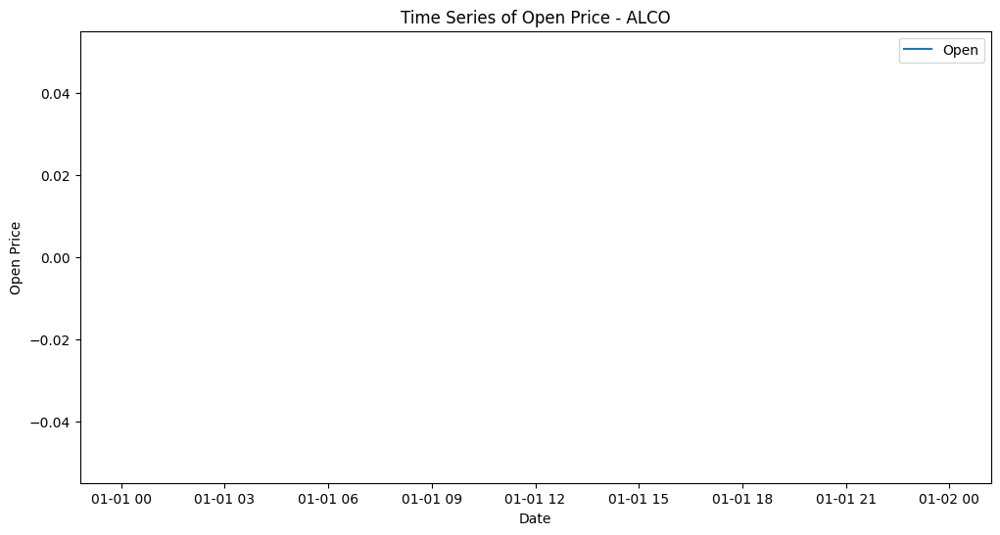

An error occurred for ALCO: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


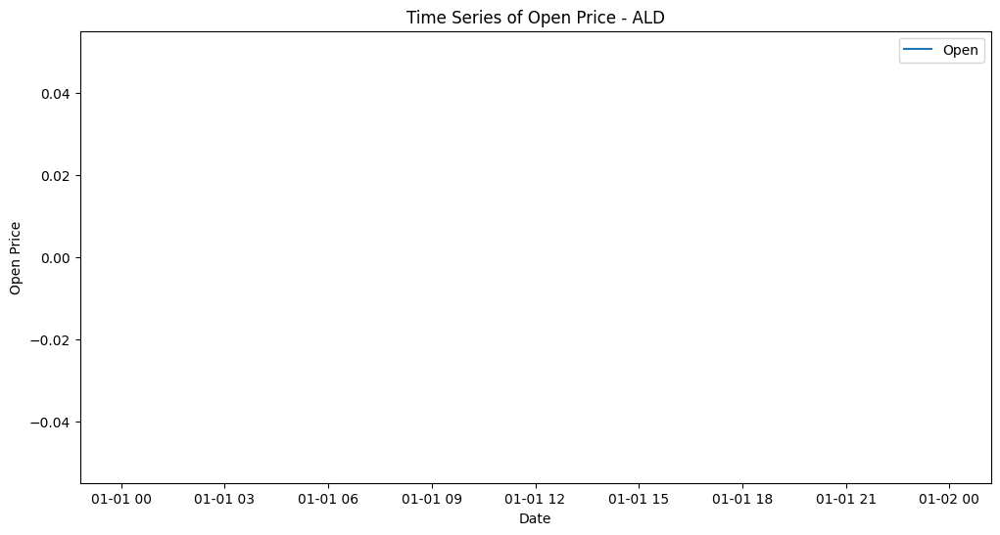

An error occurred for ALD: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


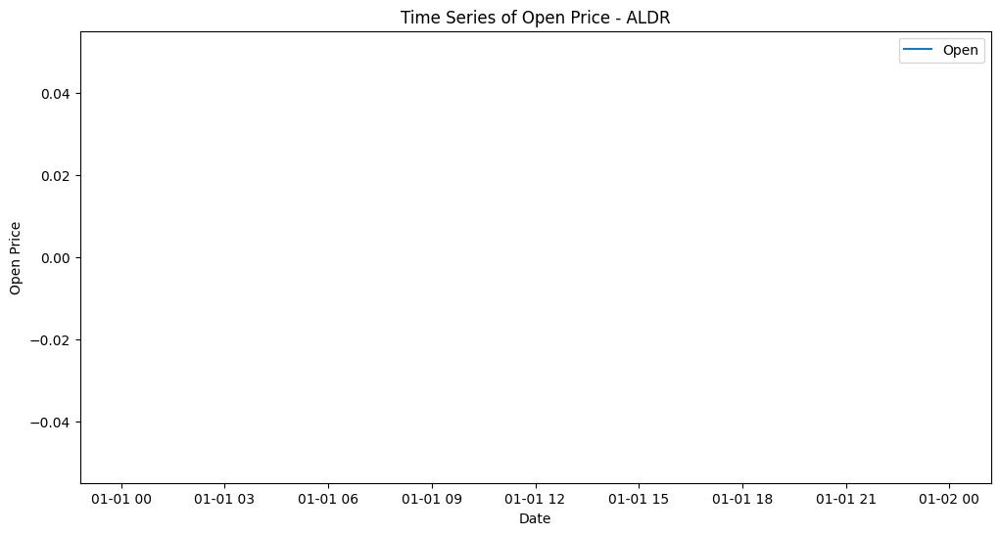

An error occurred for ALDR: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


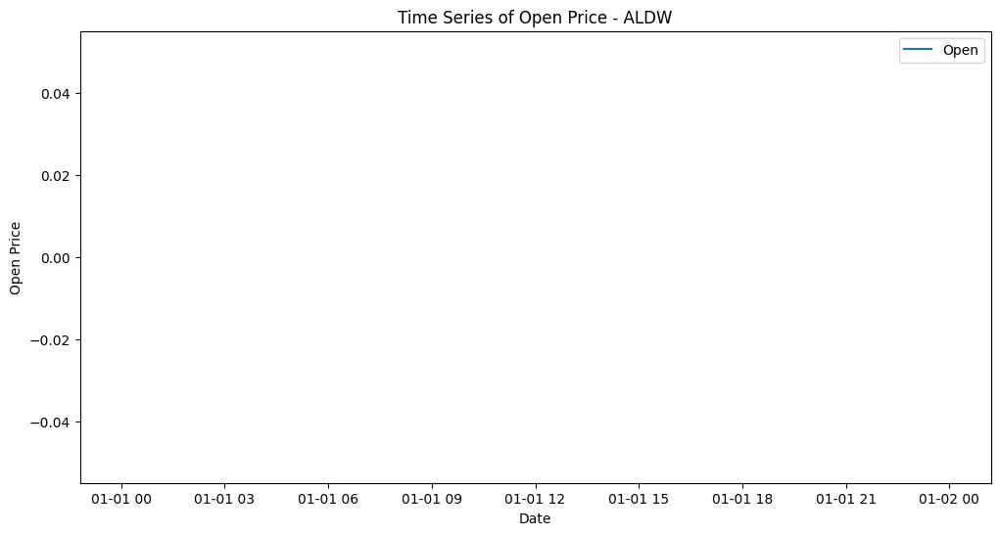

An error occurred for ALDW: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


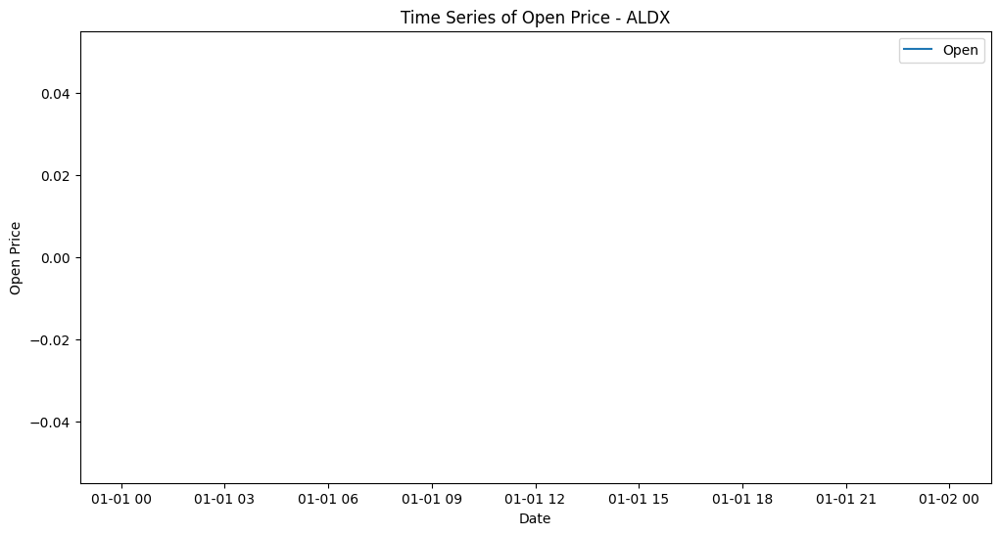

An error occurred for ALDX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


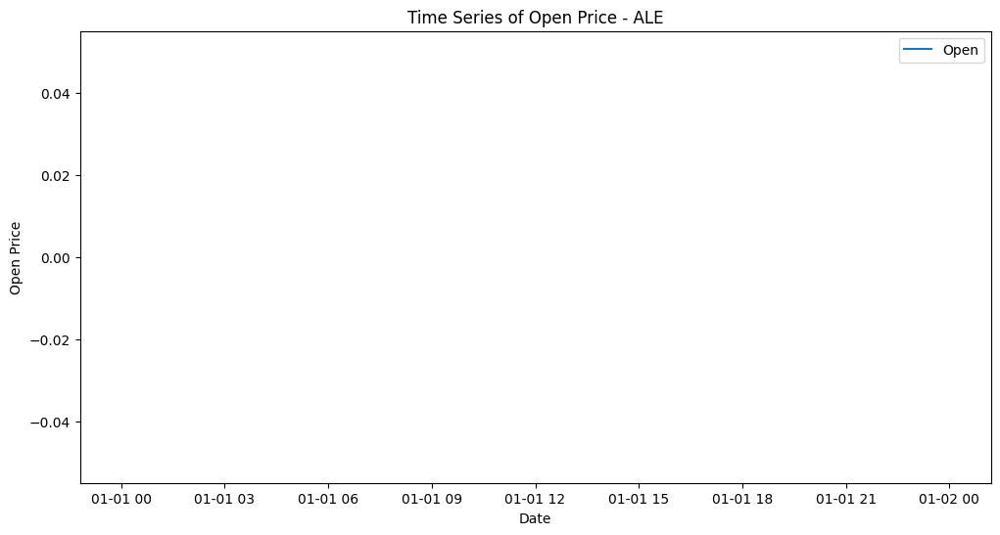

An error occurred for ALE: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


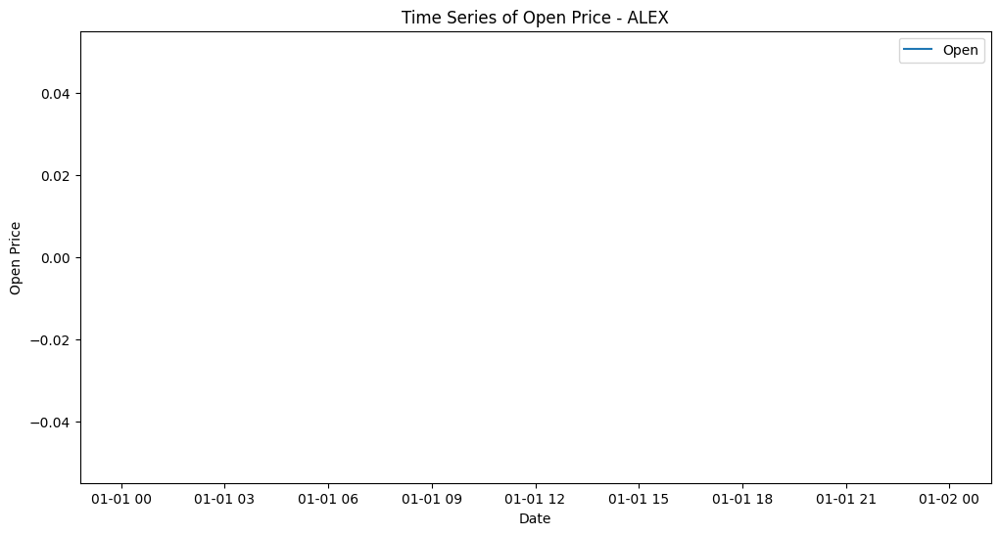

An error occurred for ALEX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


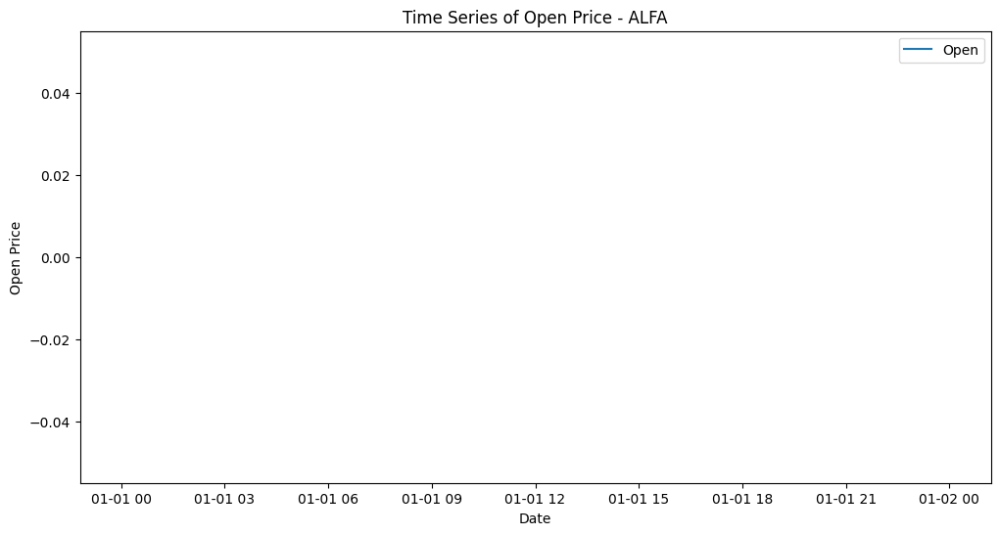

An error occurred for ALFA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


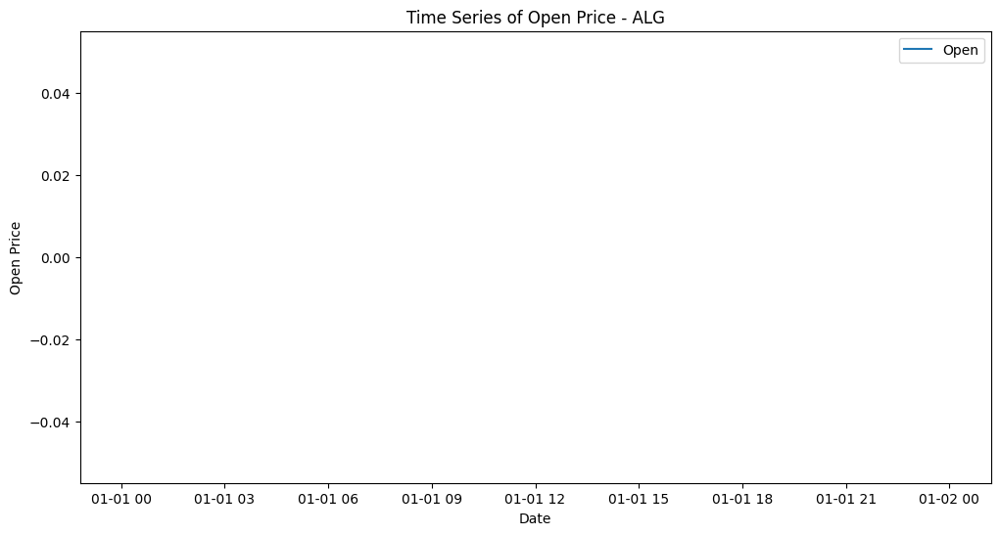

An error occurred for ALG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


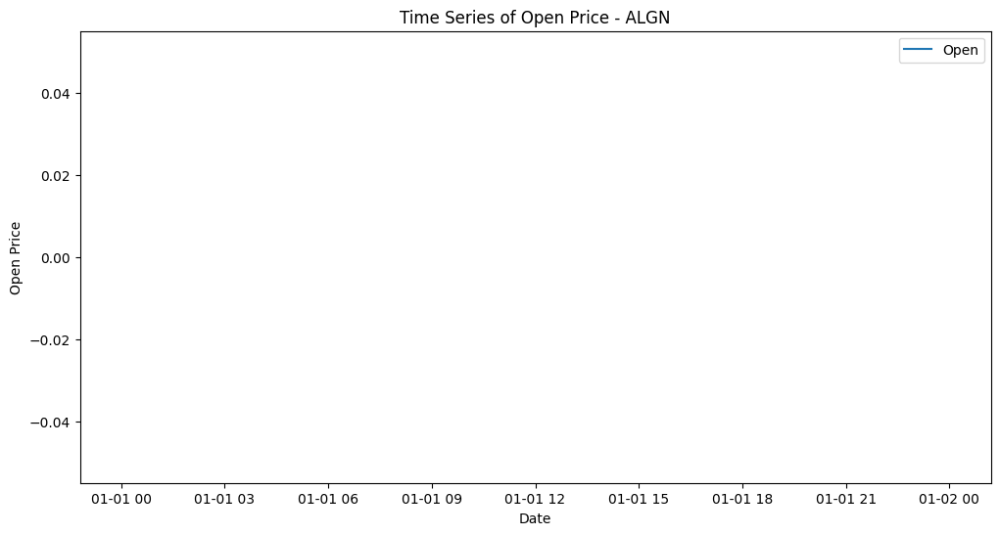

An error occurred for ALGN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


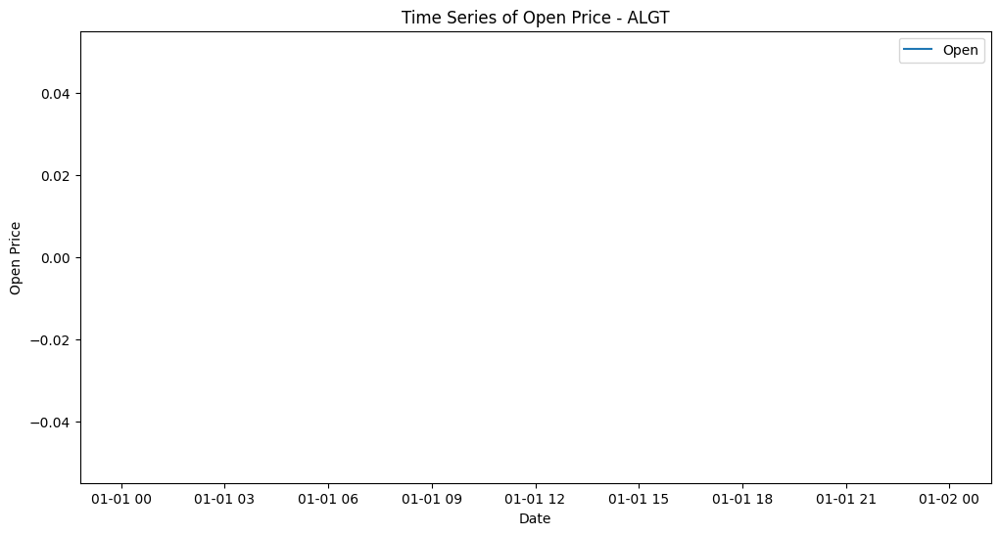

An error occurred for ALGT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


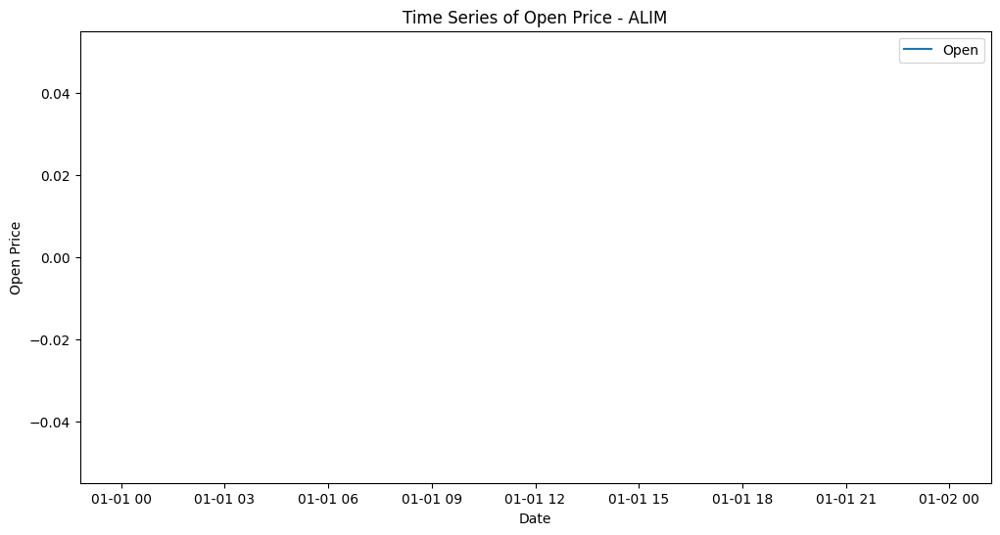

An error occurred for ALIM: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


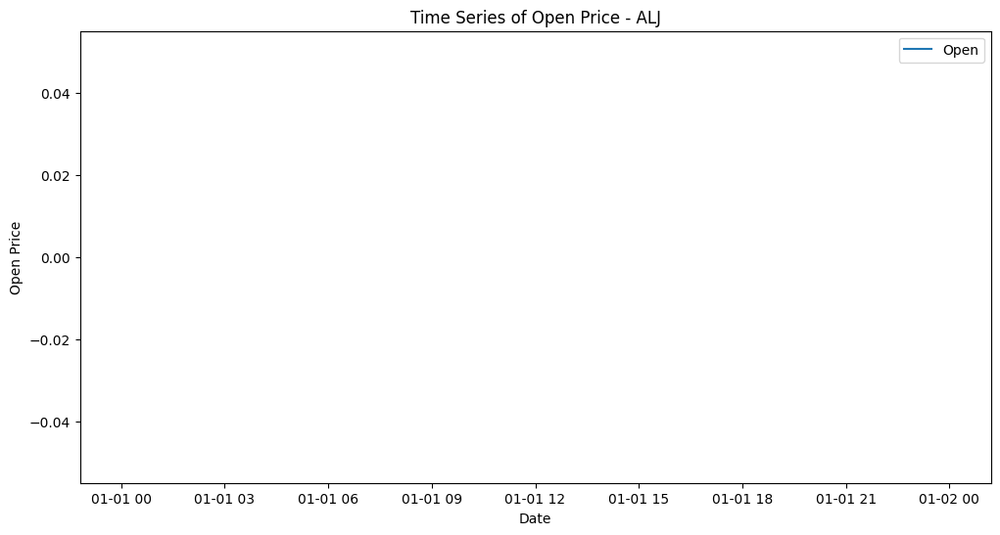

An error occurred for ALJ: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


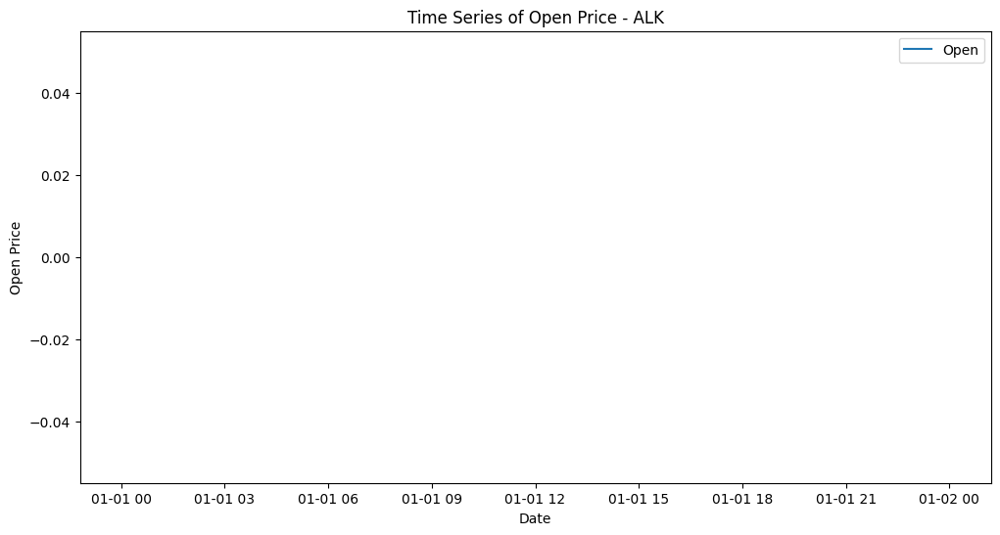

An error occurred for ALK: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


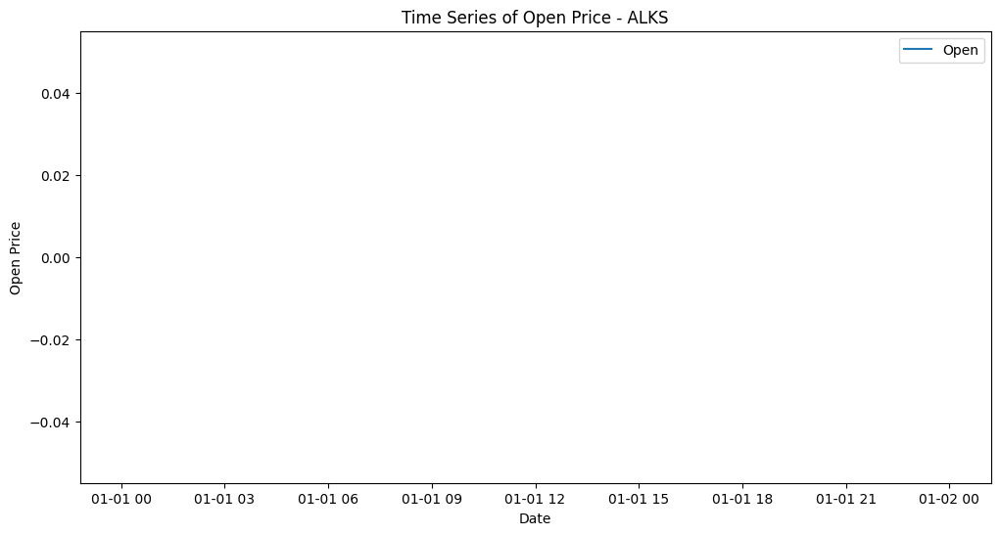

An error occurred for ALKS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


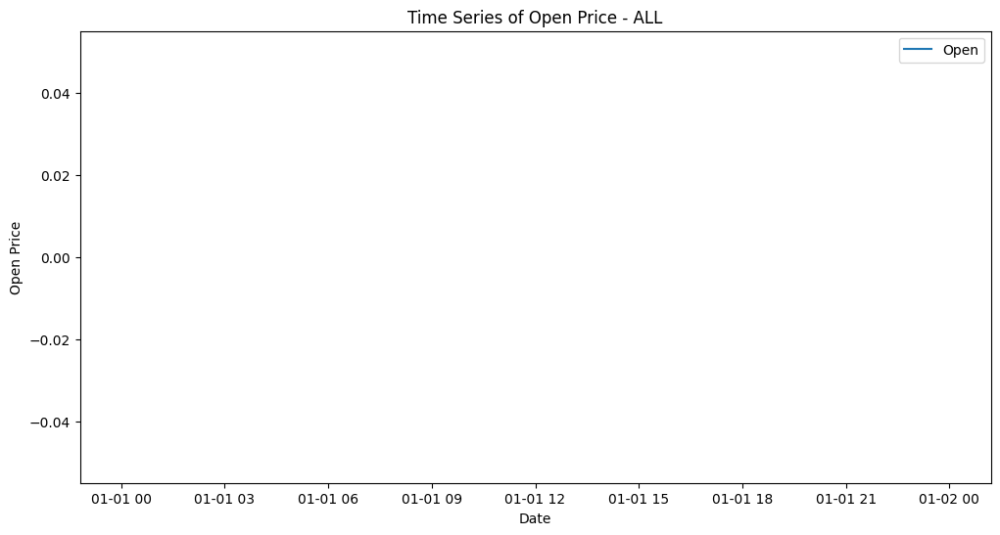

An error occurred for ALL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


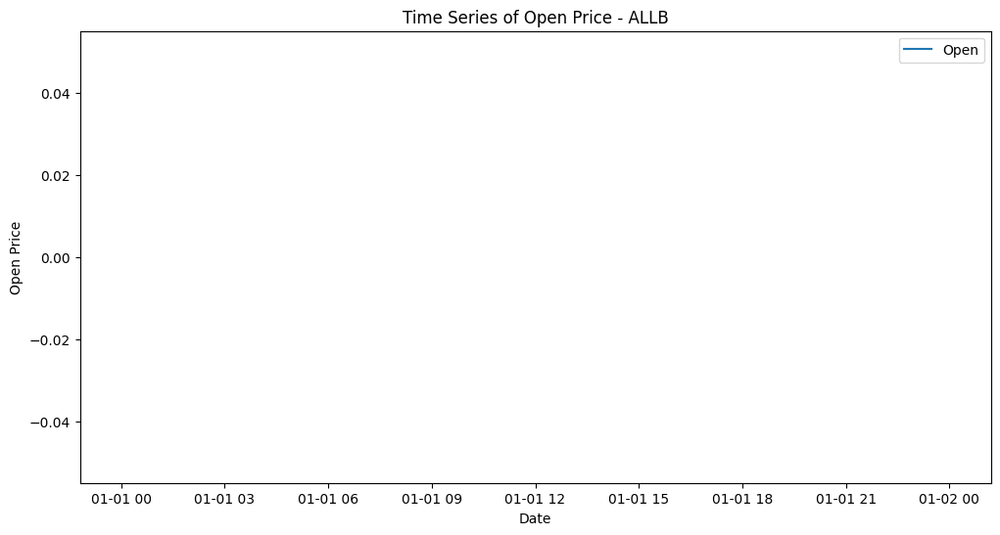

An error occurred for ALLB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


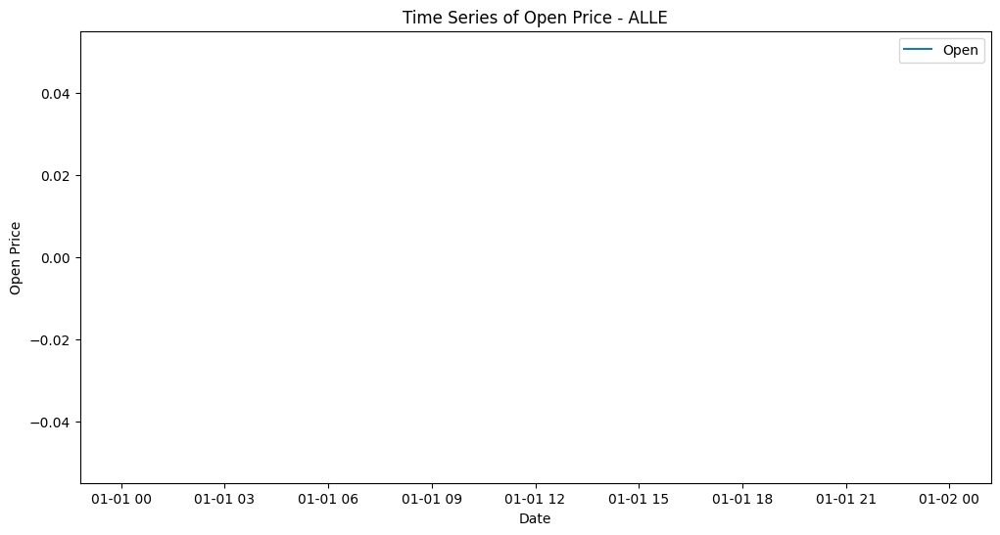

An error occurred for ALLE: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


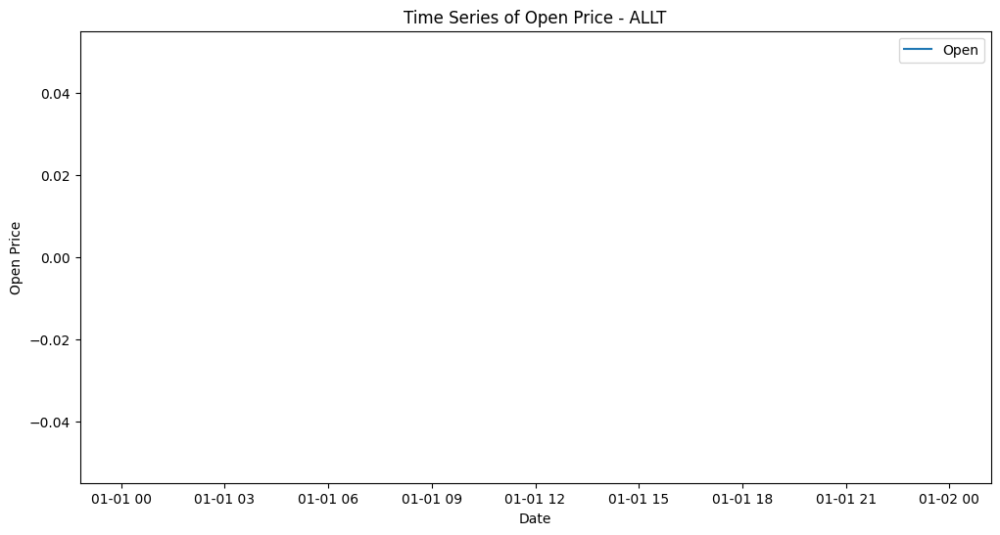

An error occurred for ALLT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


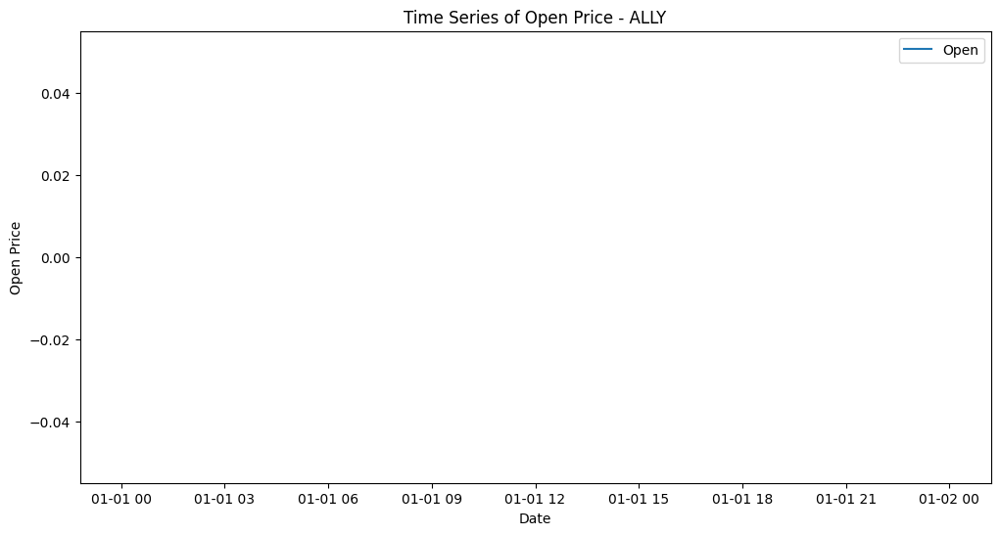

An error occurred for ALLY: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


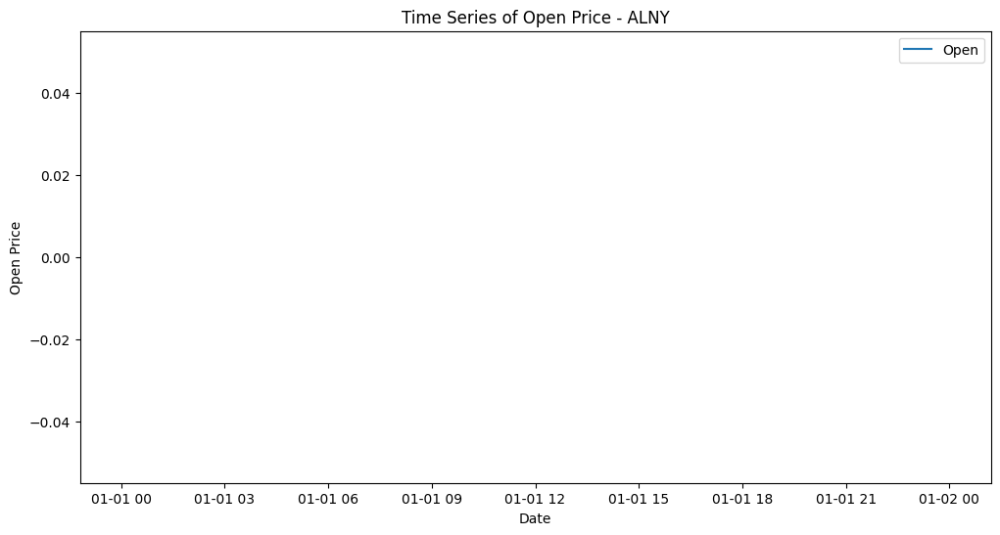

An error occurred for ALNY: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


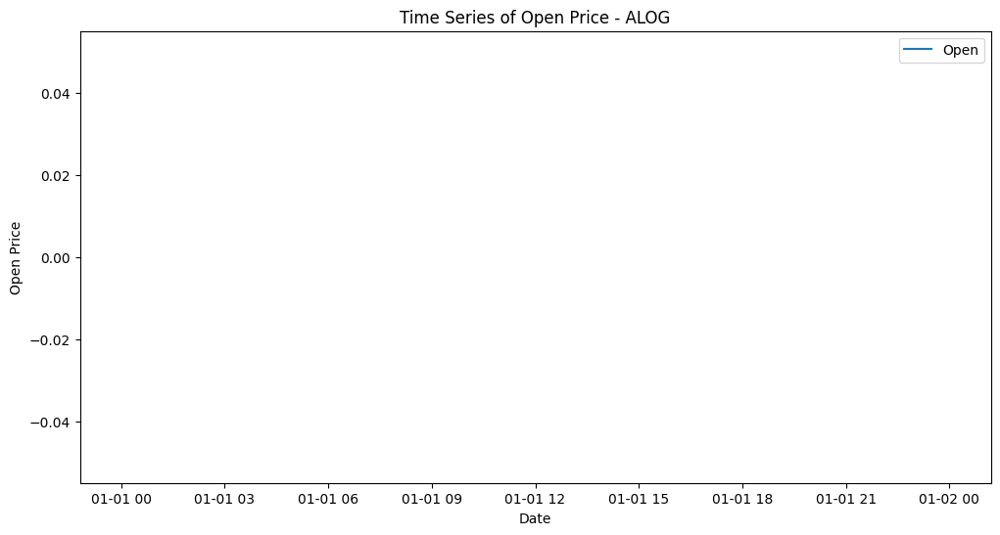

An error occurred for ALOG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


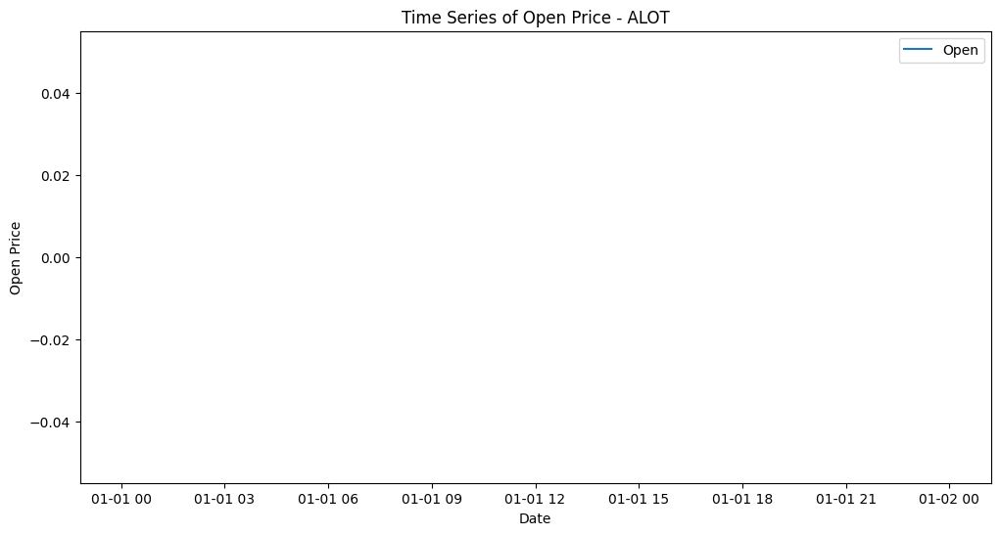

An error occurred for ALOT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


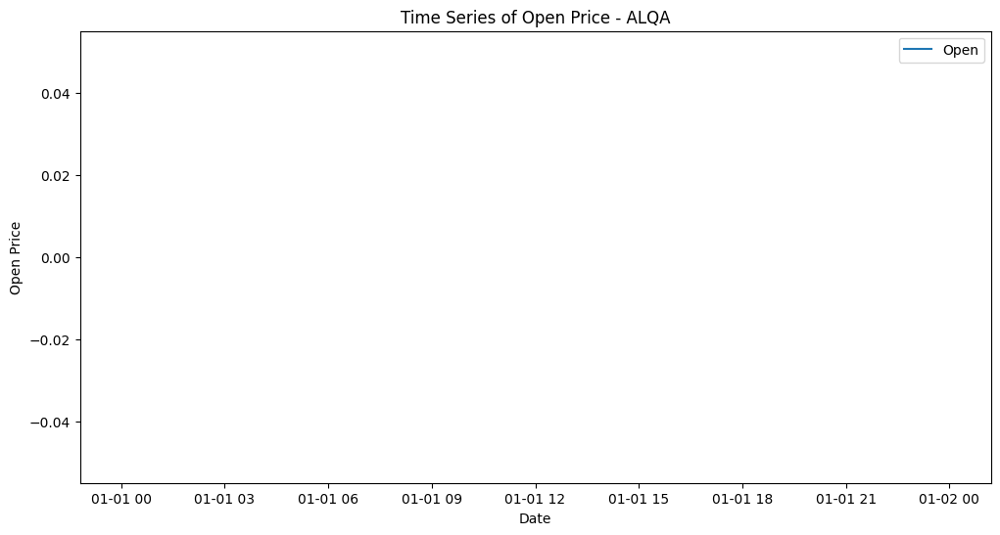

An error occurred for ALQA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


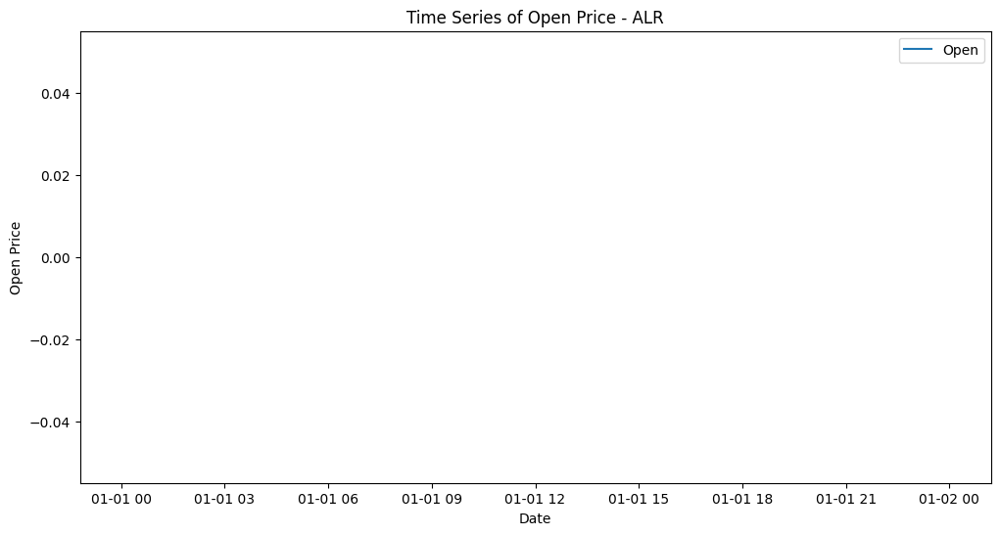

An error occurred for ALR: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


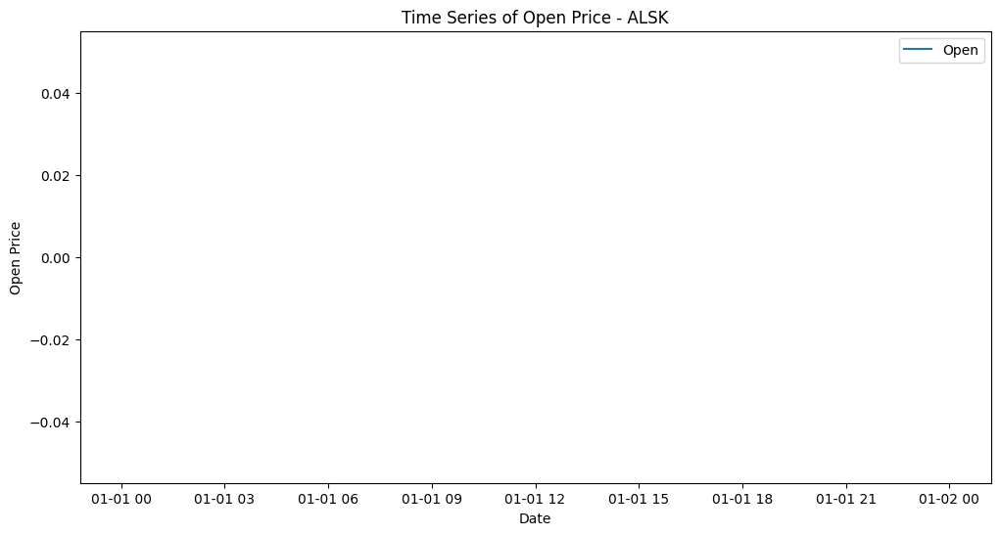

An error occurred for ALSK: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


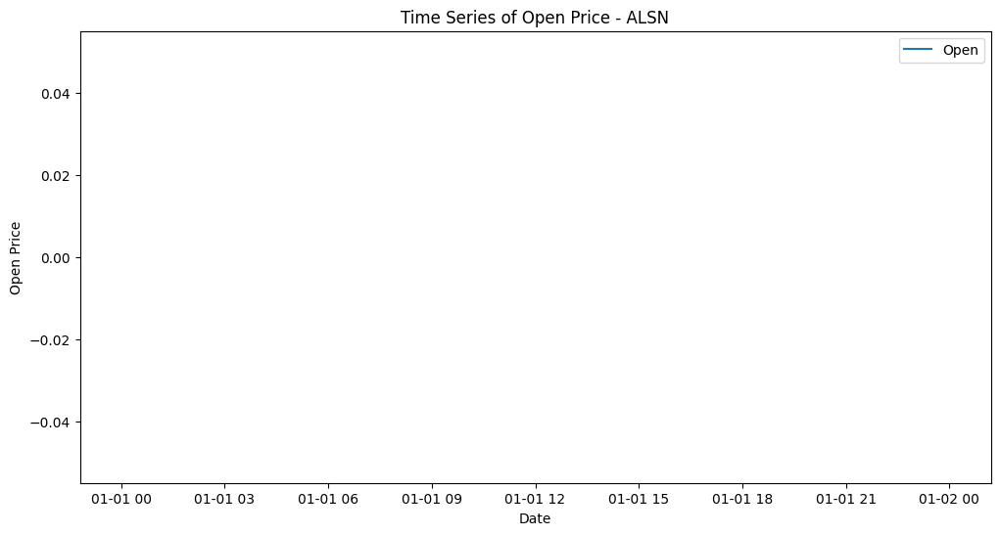

An error occurred for ALSN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


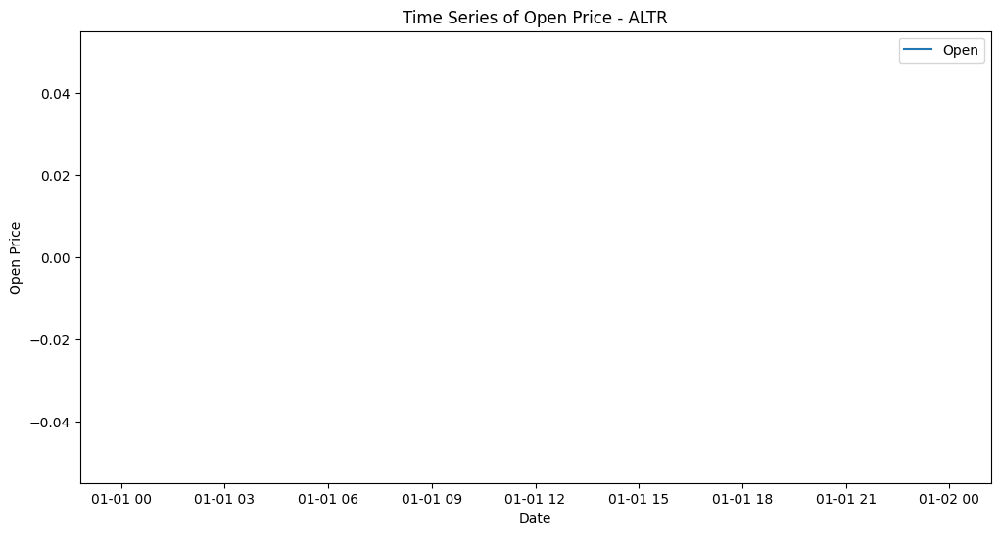

An error occurred for ALTR: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


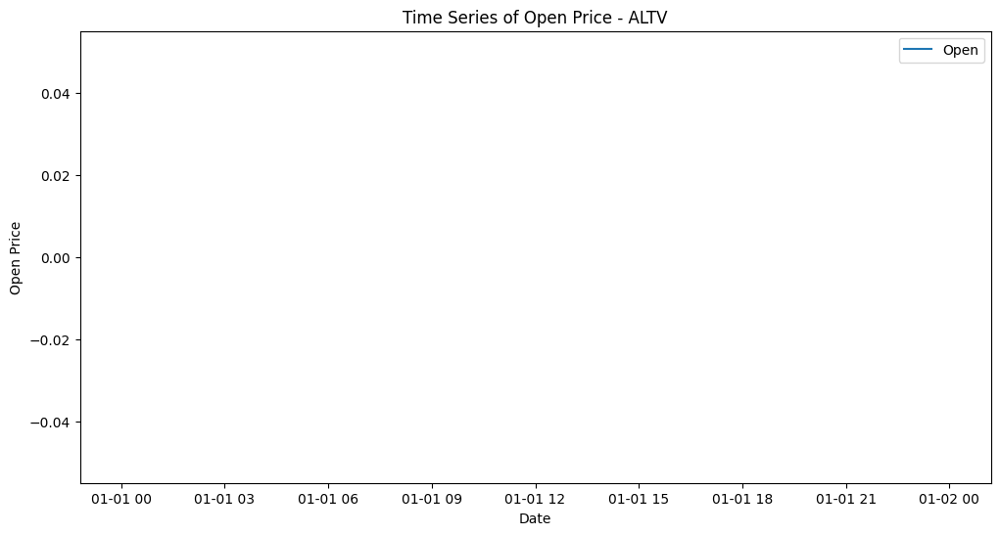

An error occurred for ALTV: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


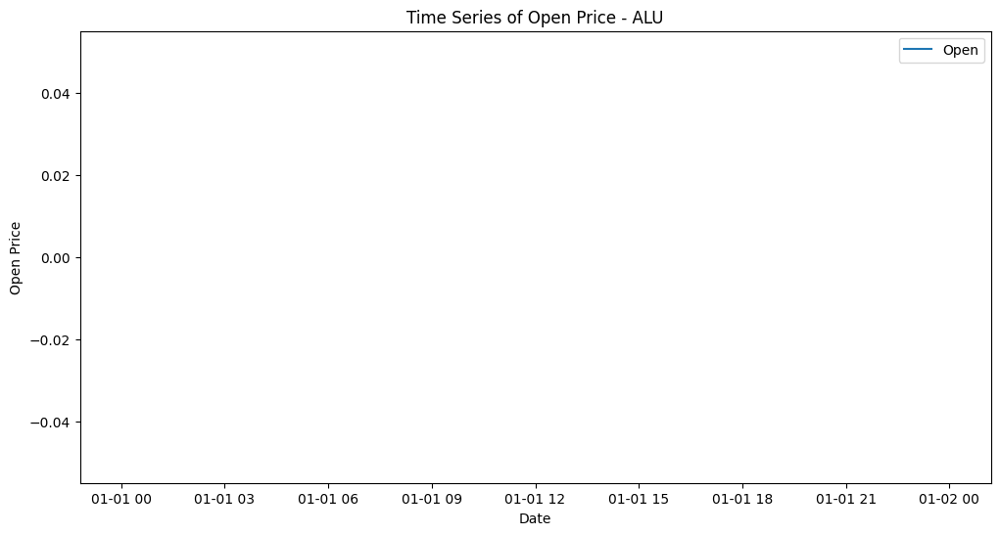

An error occurred for ALU: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


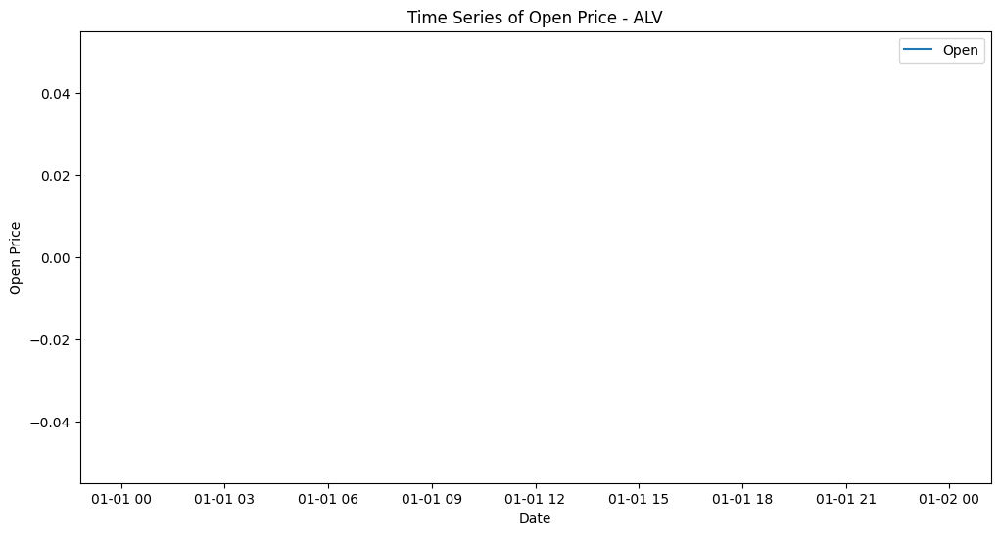

An error occurred for ALV: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


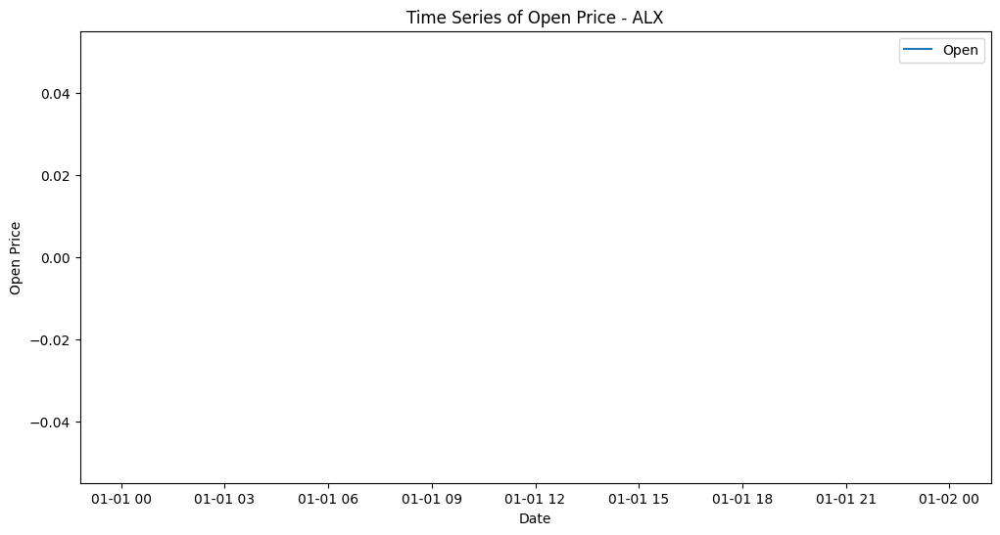

An error occurred for ALX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


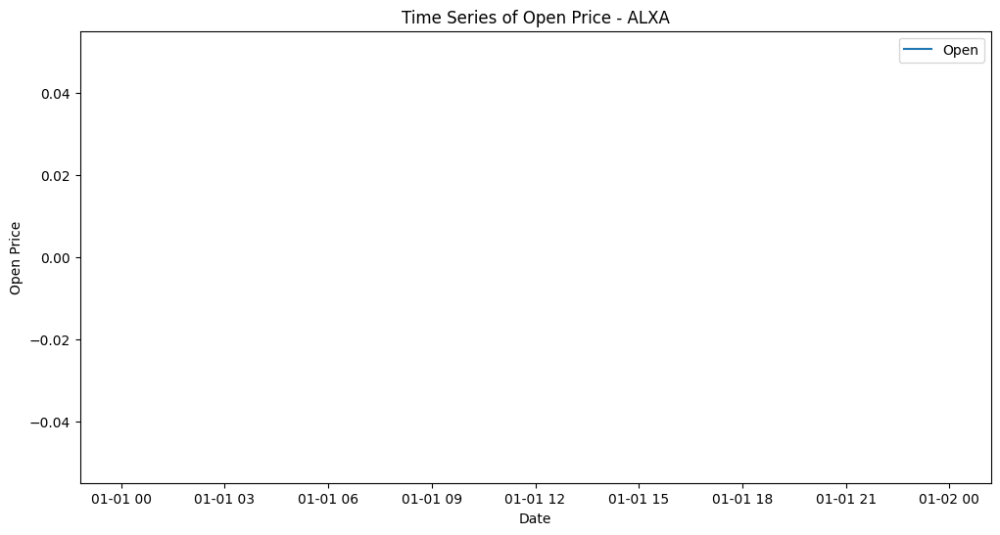

An error occurred for ALXA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


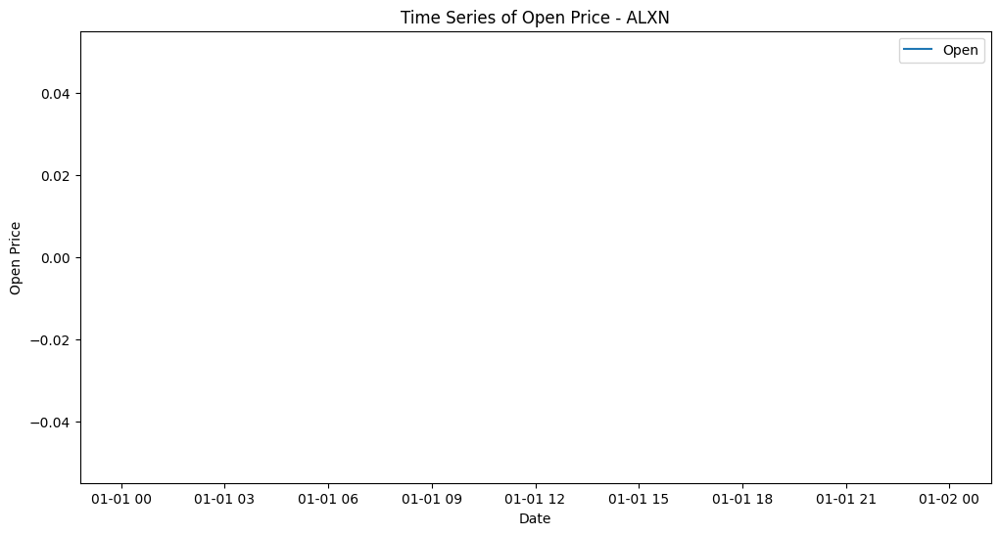

An error occurred for ALXN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


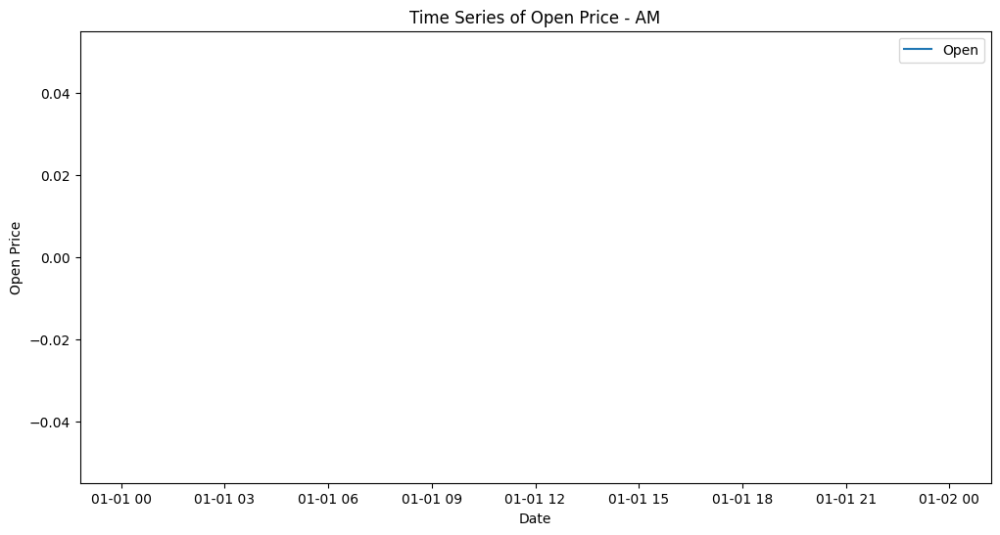

An error occurred for AM: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


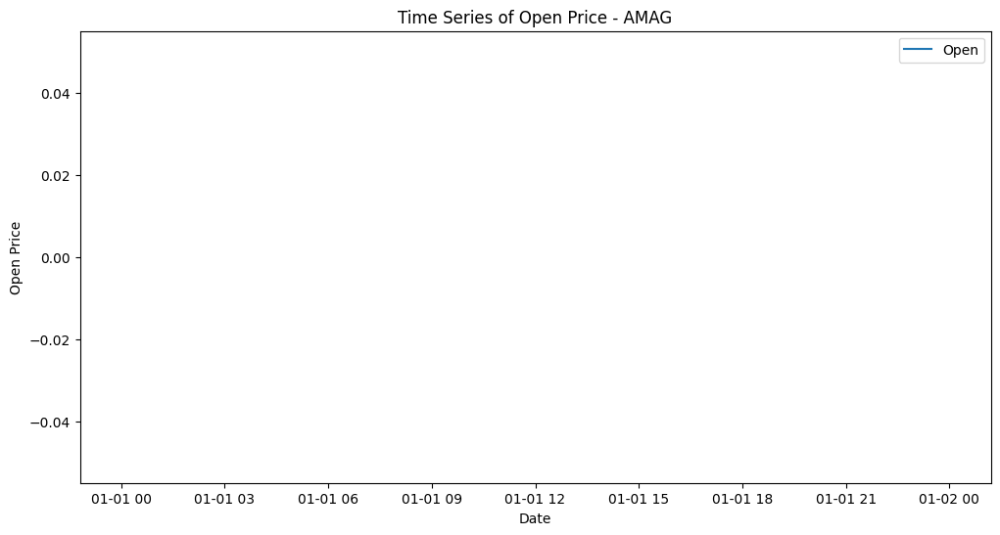

An error occurred for AMAG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


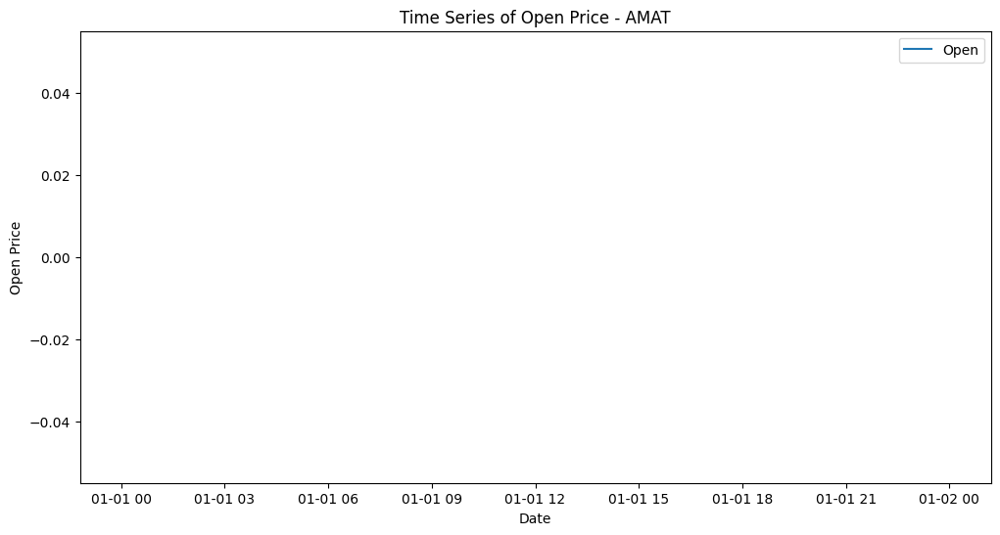

An error occurred for AMAT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


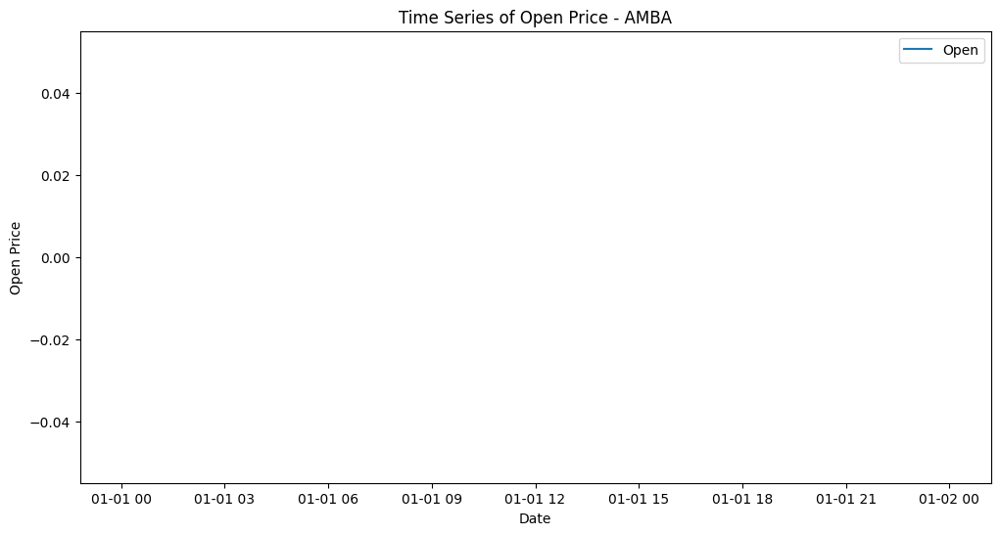

An error occurred for AMBA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


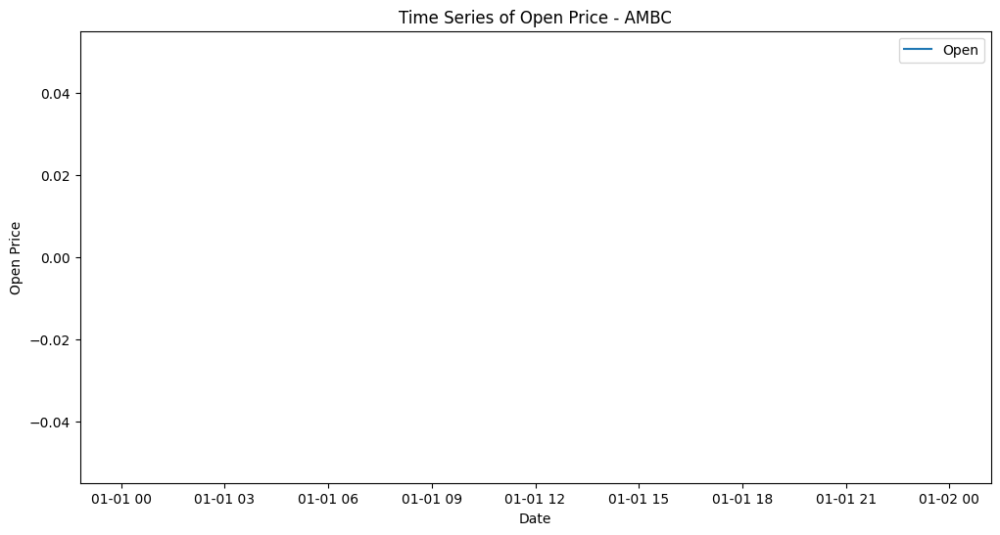

An error occurred for AMBC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


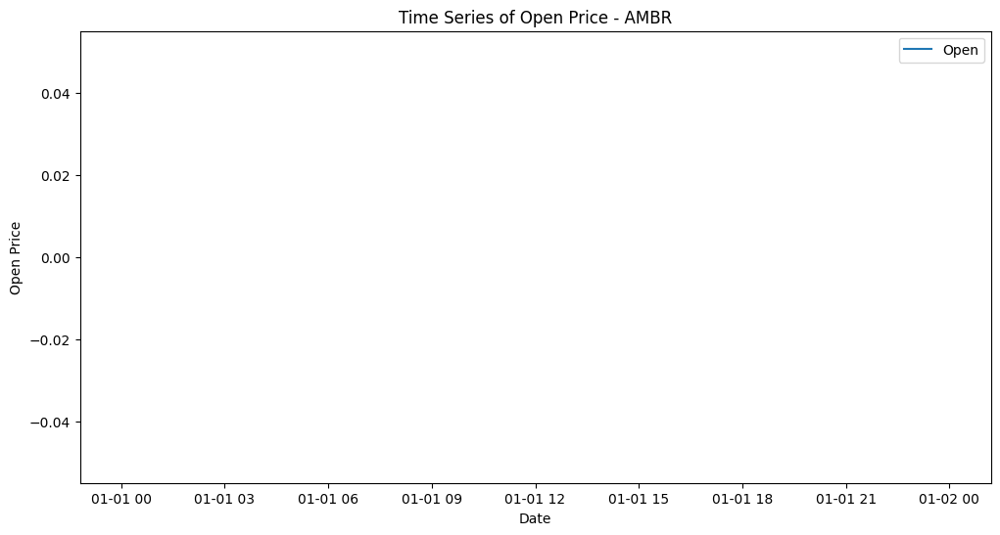

An error occurred for AMBR: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


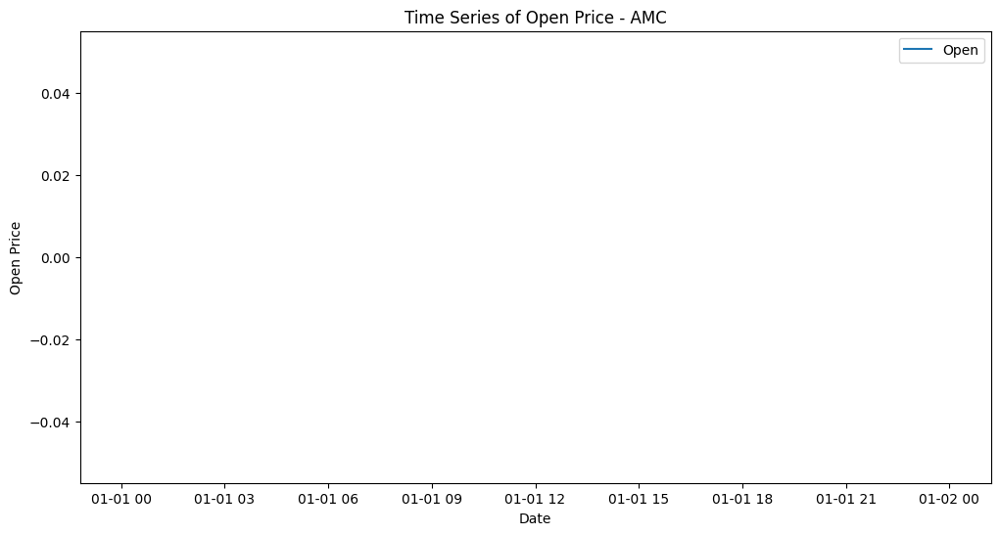

An error occurred for AMC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


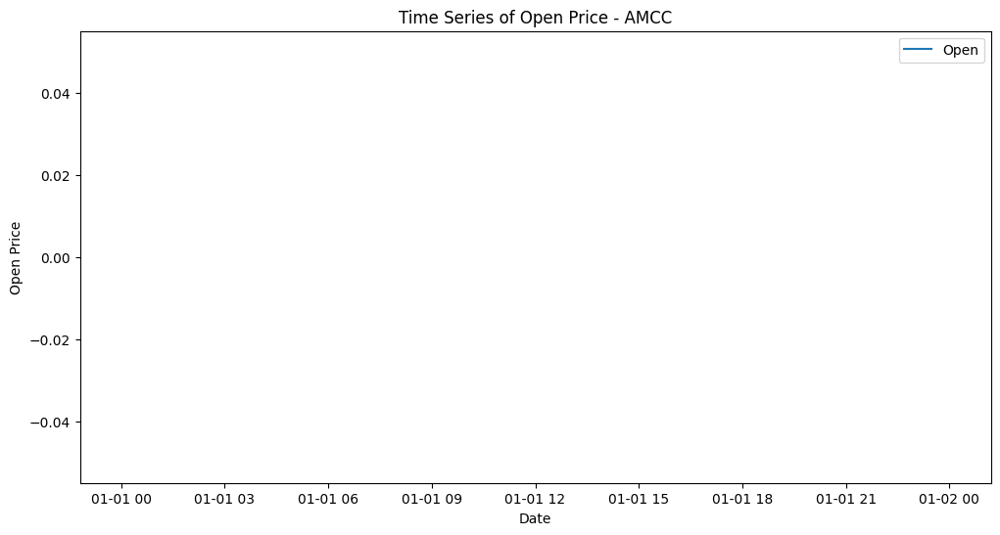

An error occurred for AMCC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


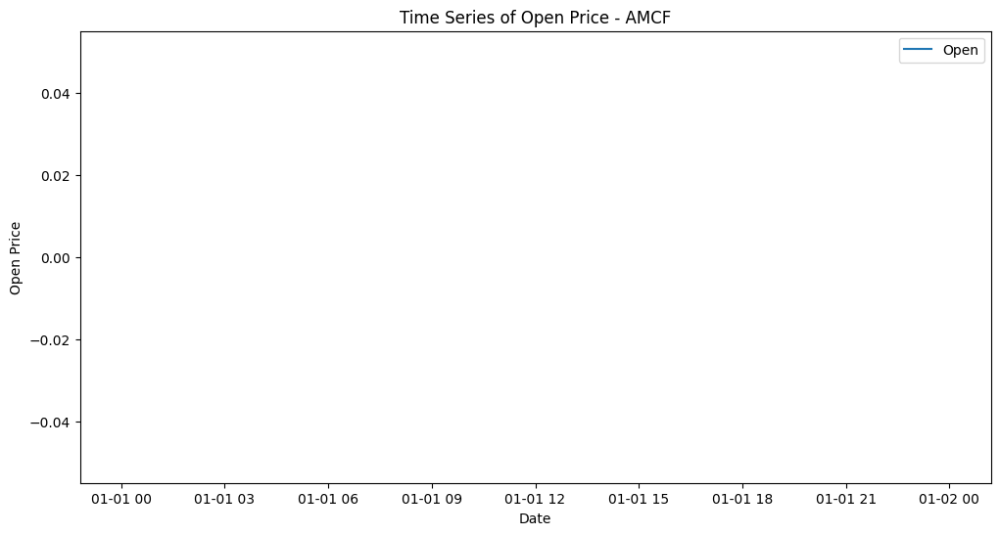

An error occurred for AMCF: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


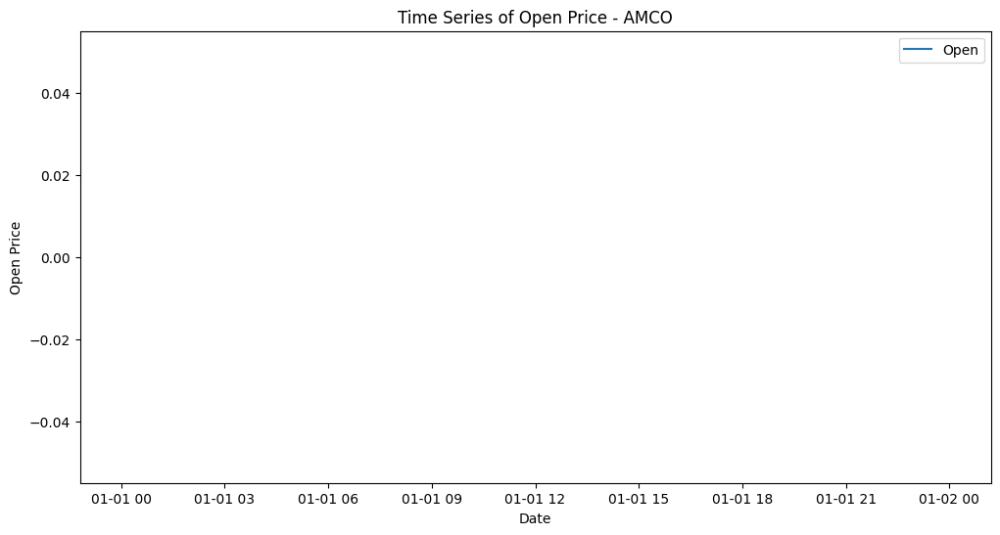

An error occurred for AMCO: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


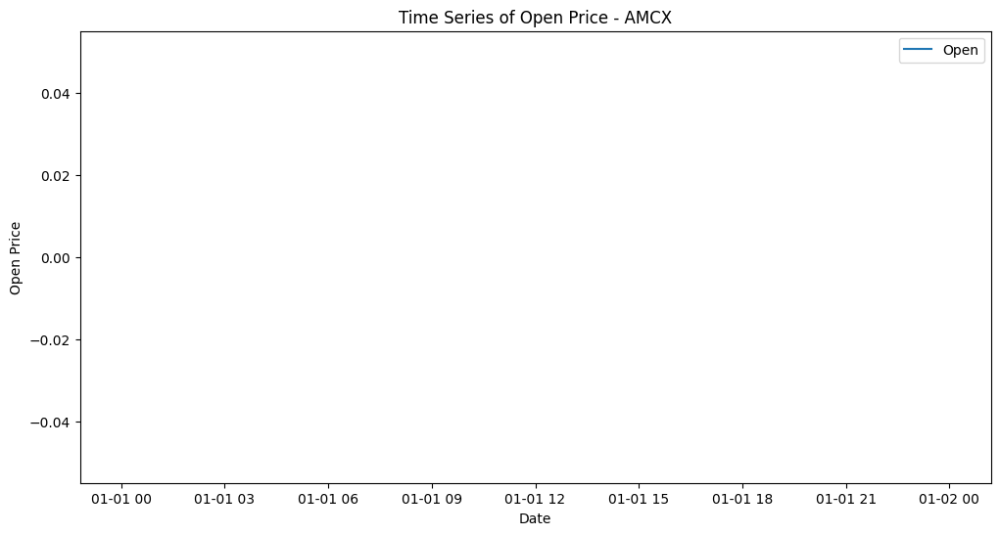

An error occurred for AMCX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


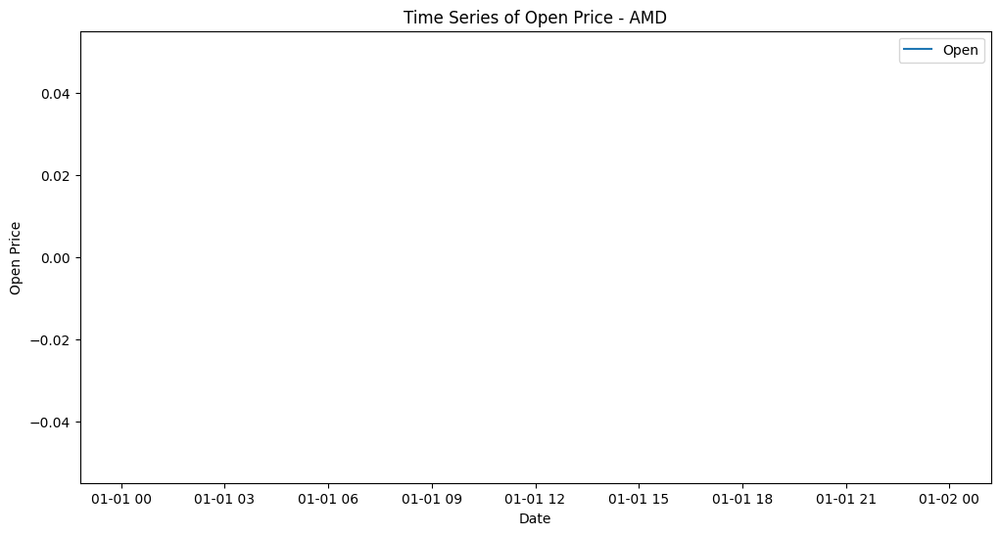

An error occurred for AMD: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


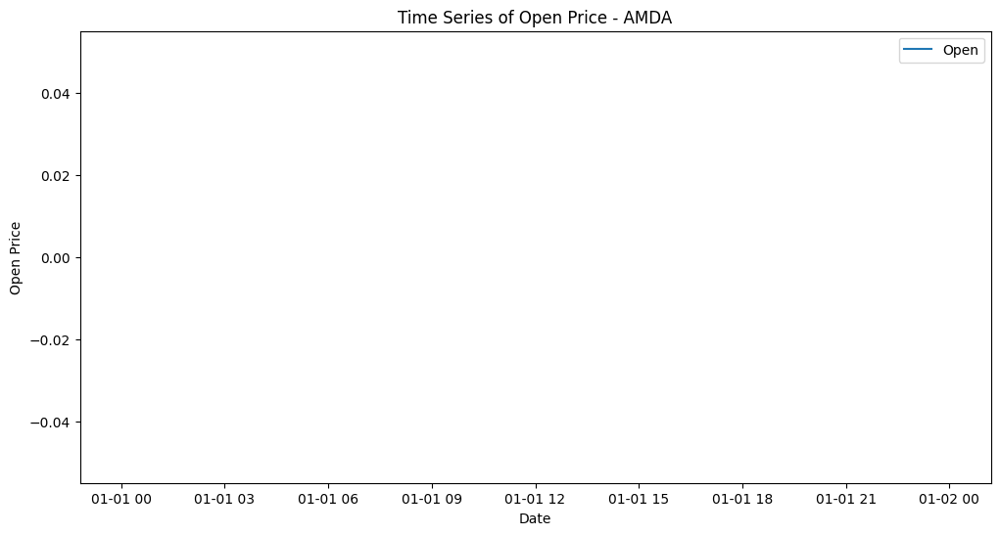

An error occurred for AMDA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


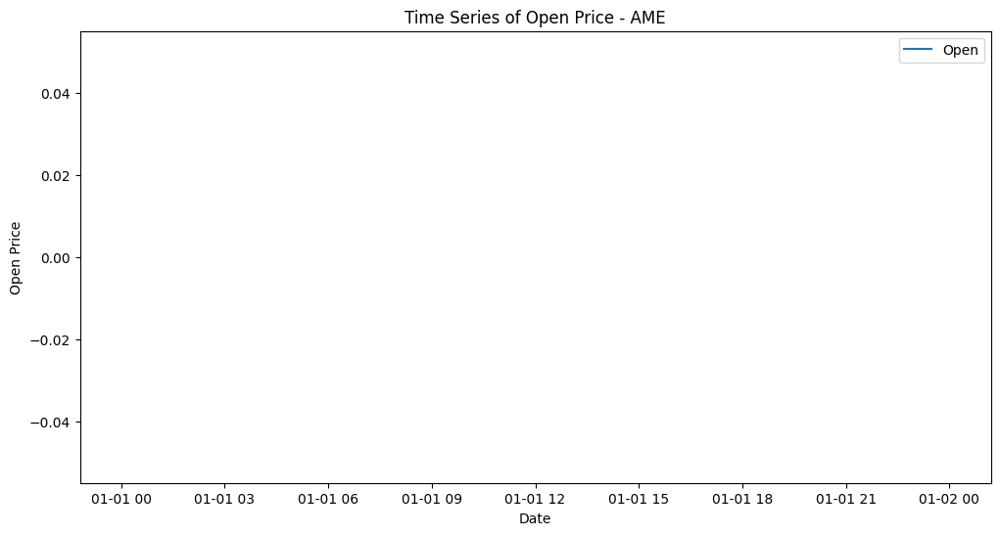

An error occurred for AME: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


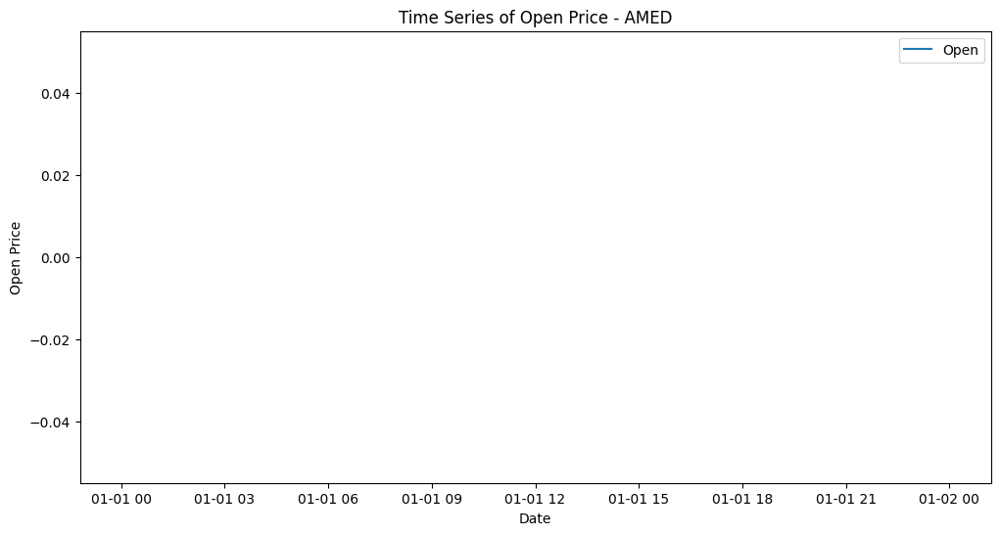

An error occurred for AMED: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


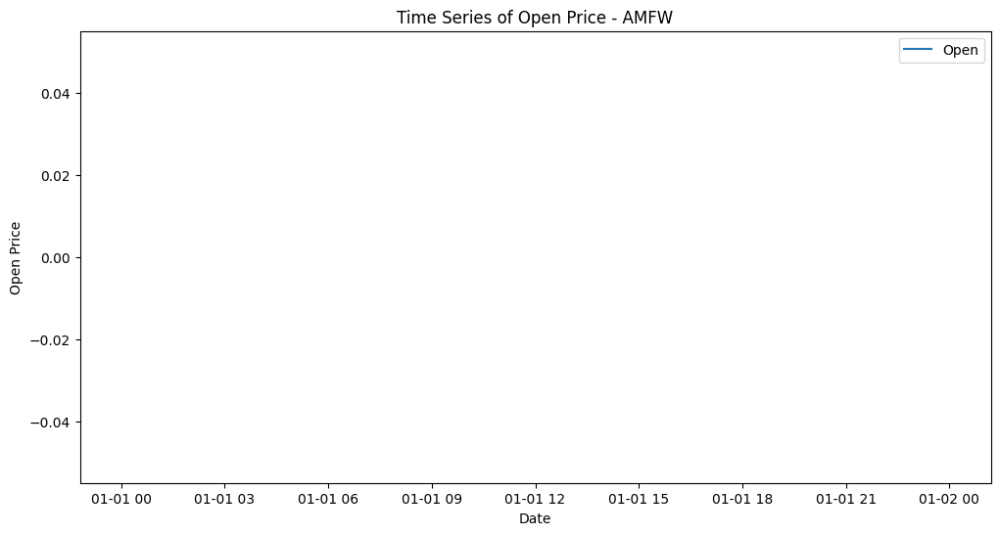

An error occurred for AMFW: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


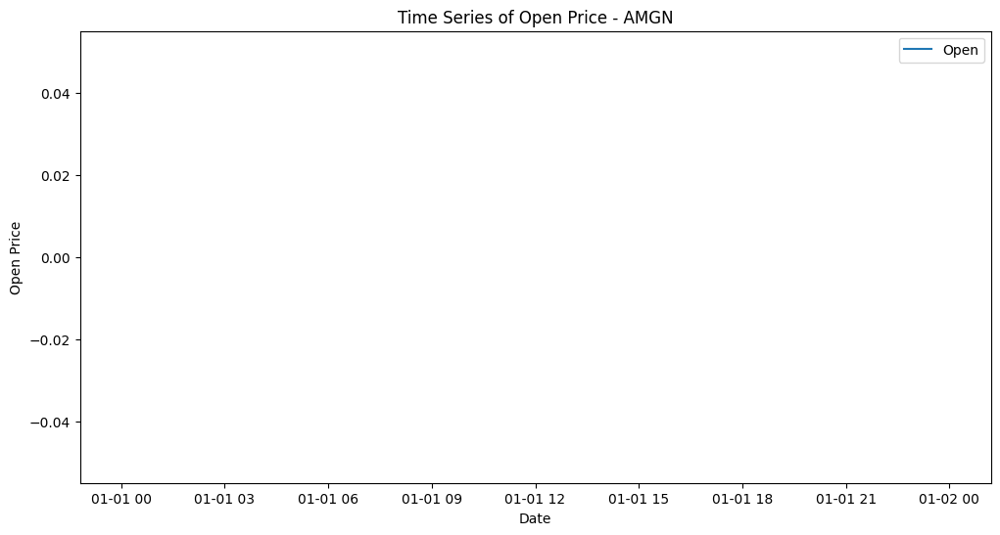

An error occurred for AMGN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


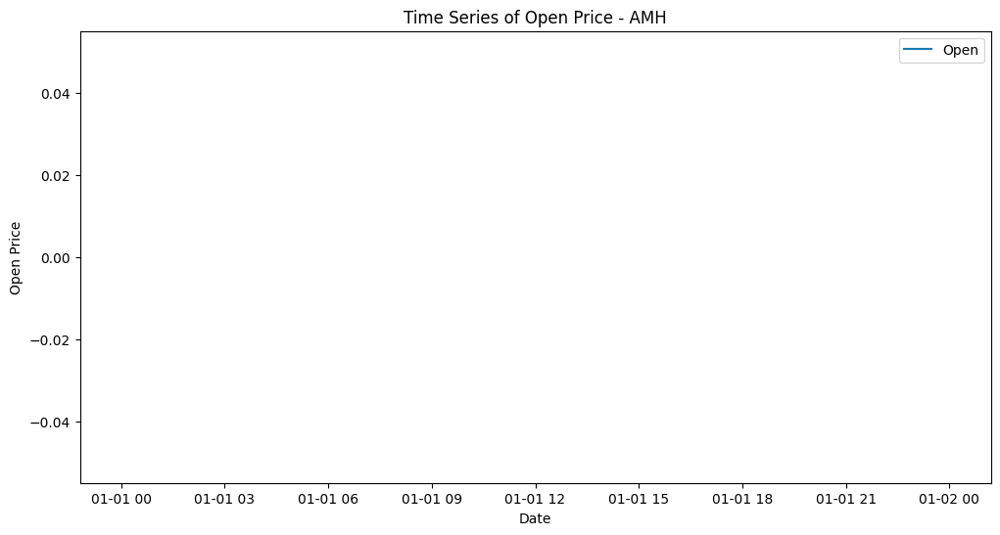

An error occurred for AMH: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


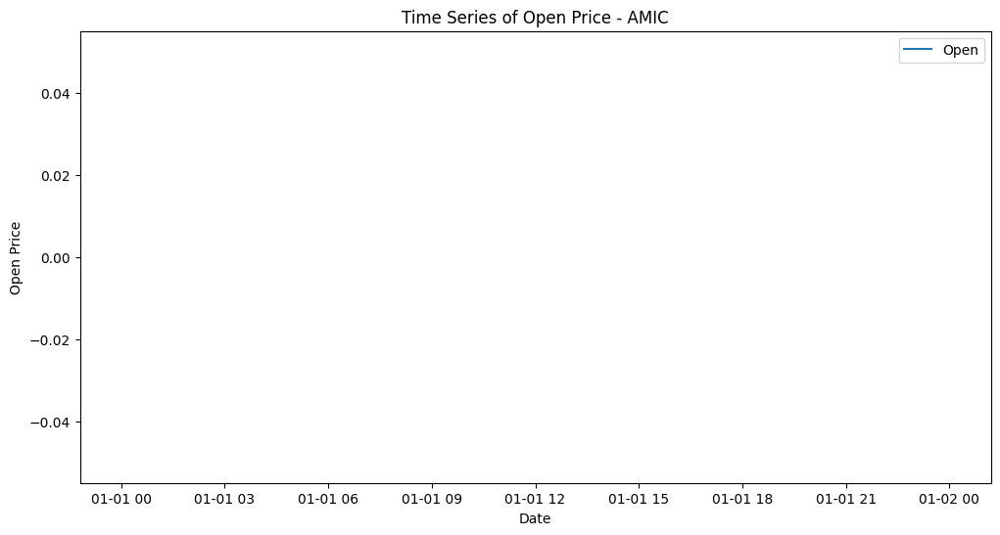

An error occurred for AMIC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


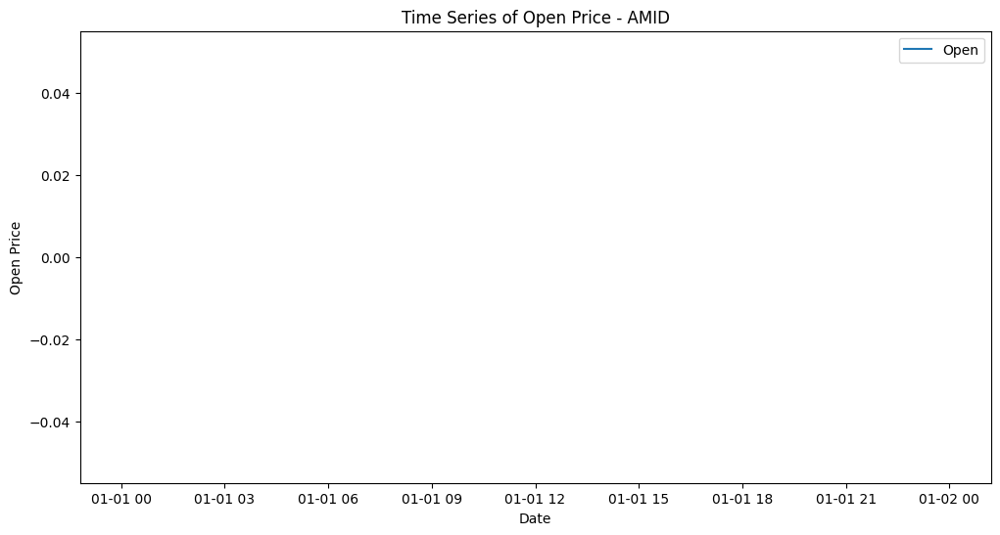

An error occurred for AMID: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


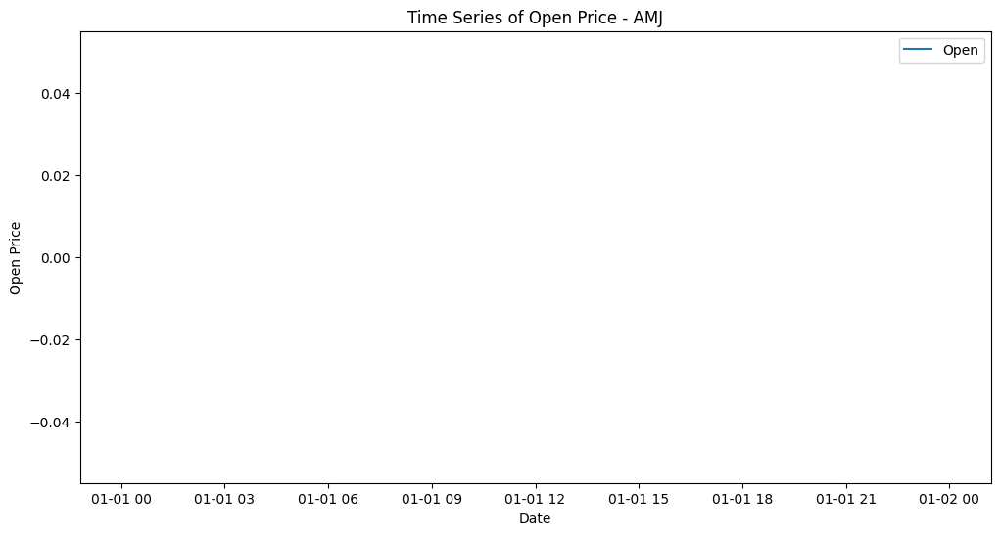

An error occurred for AMJ: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


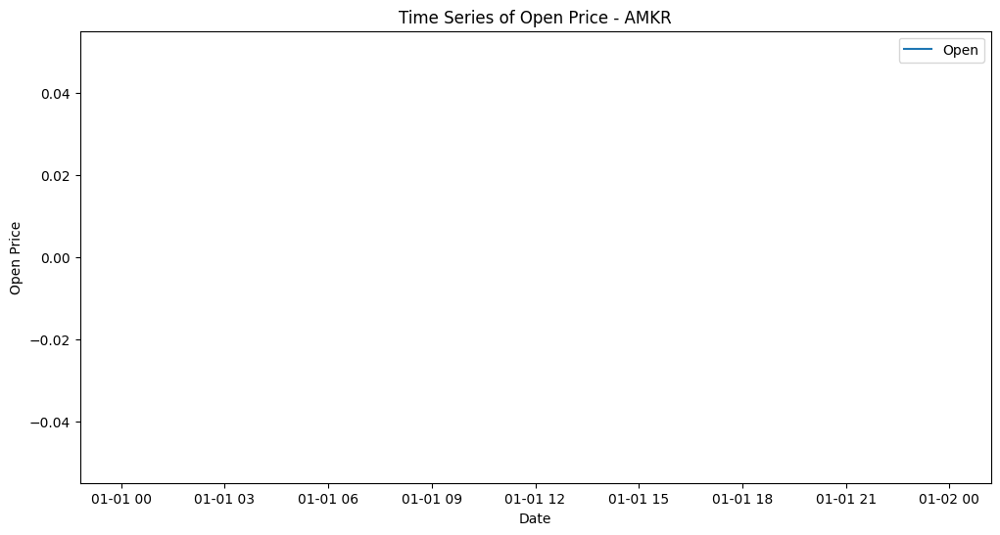

An error occurred for AMKR: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


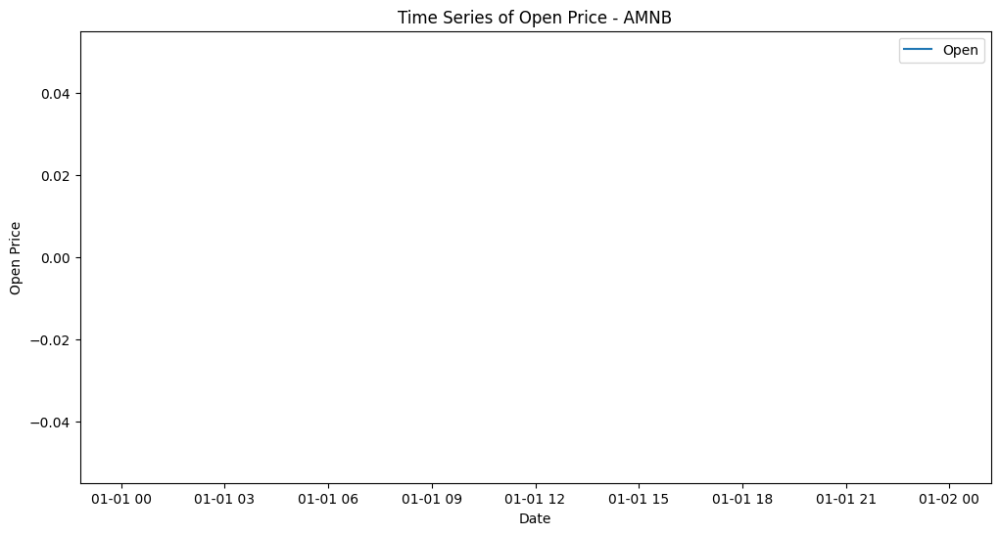

An error occurred for AMNB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


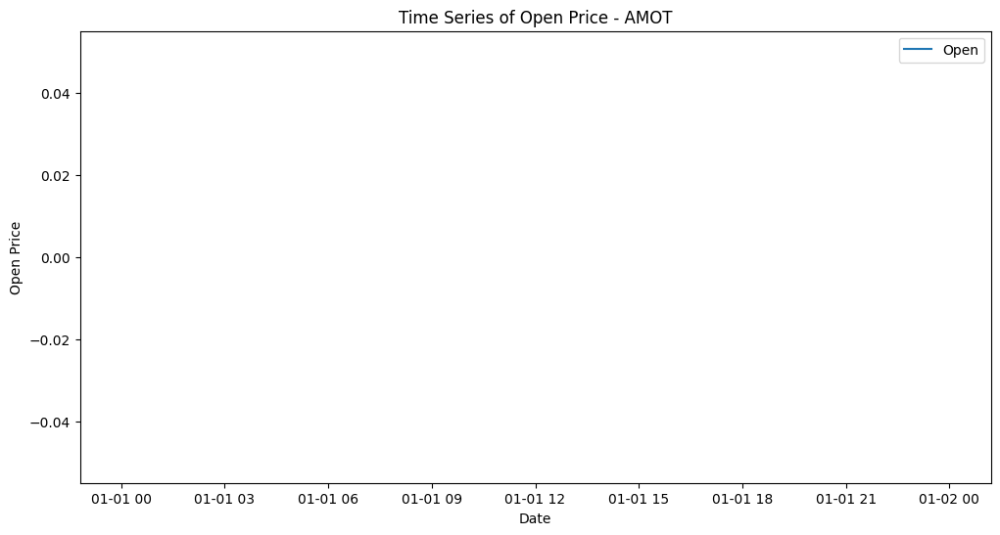

An error occurred for AMOT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


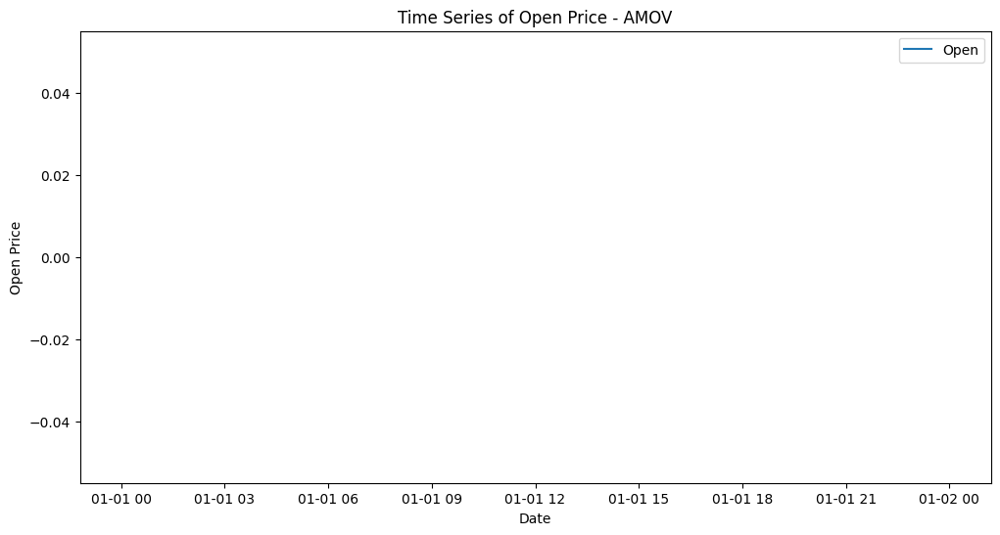

An error occurred for AMOV: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


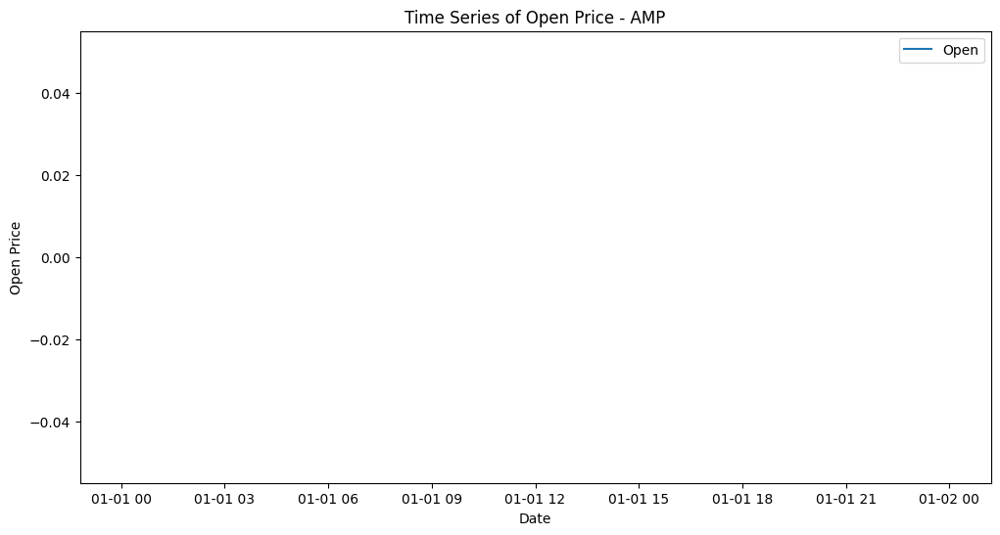

An error occurred for AMP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


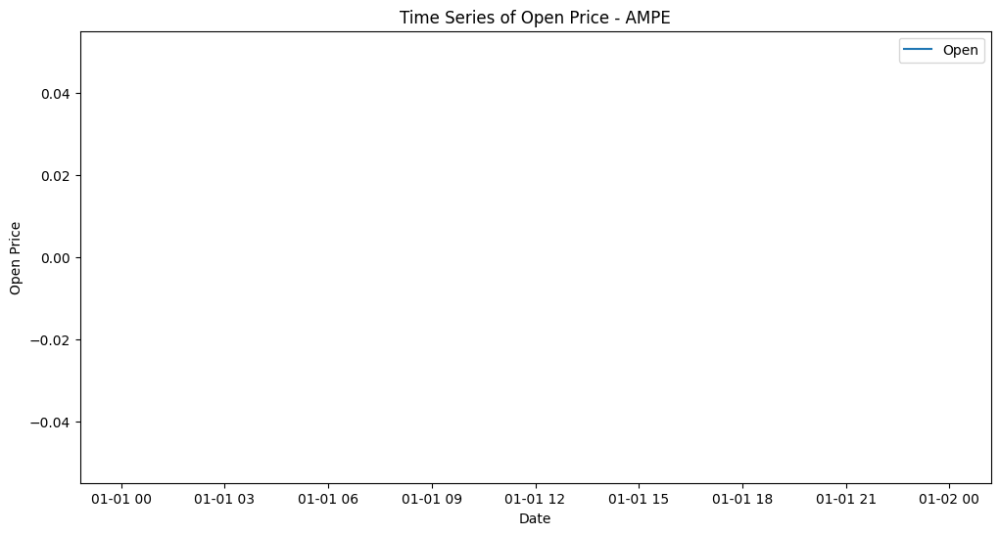

An error occurred for AMPE: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


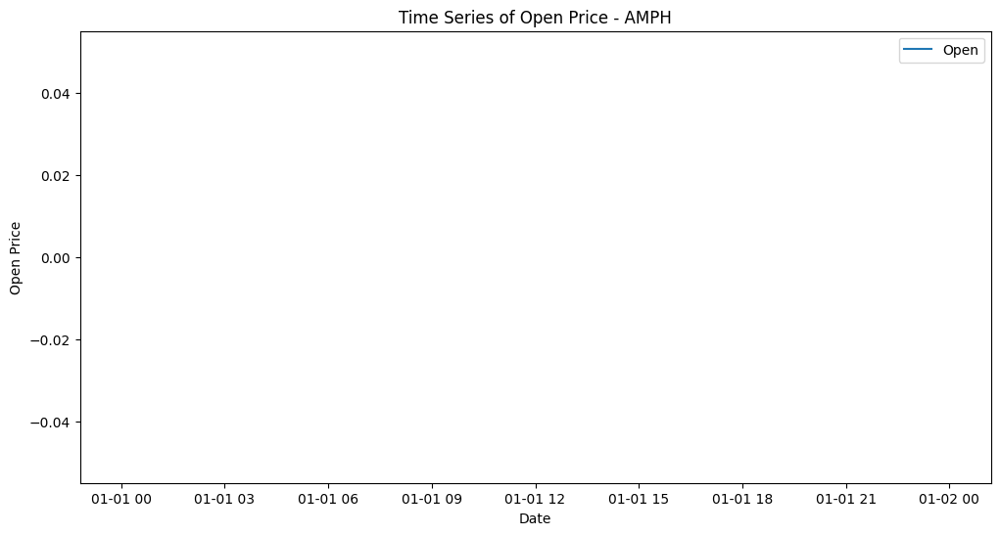

An error occurred for AMPH: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


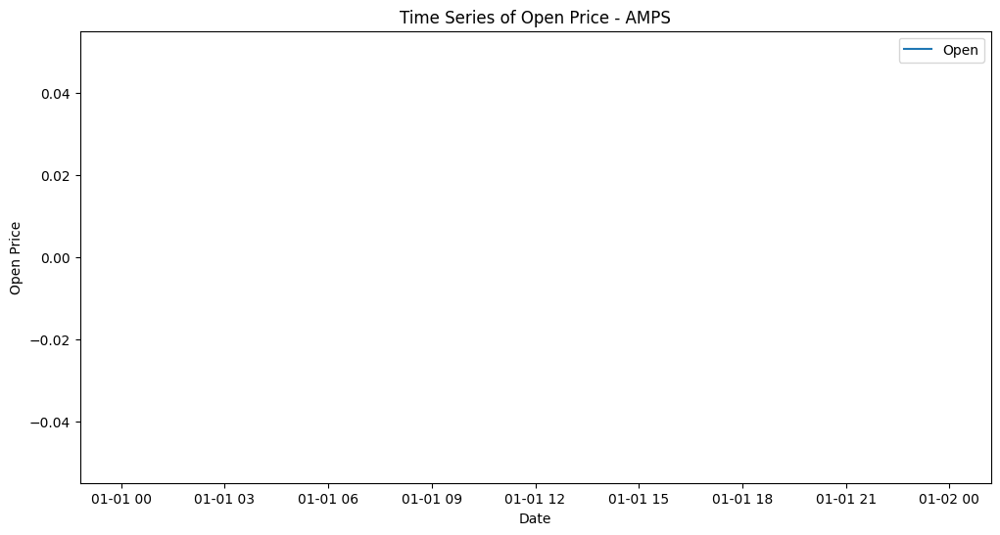

An error occurred for AMPS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


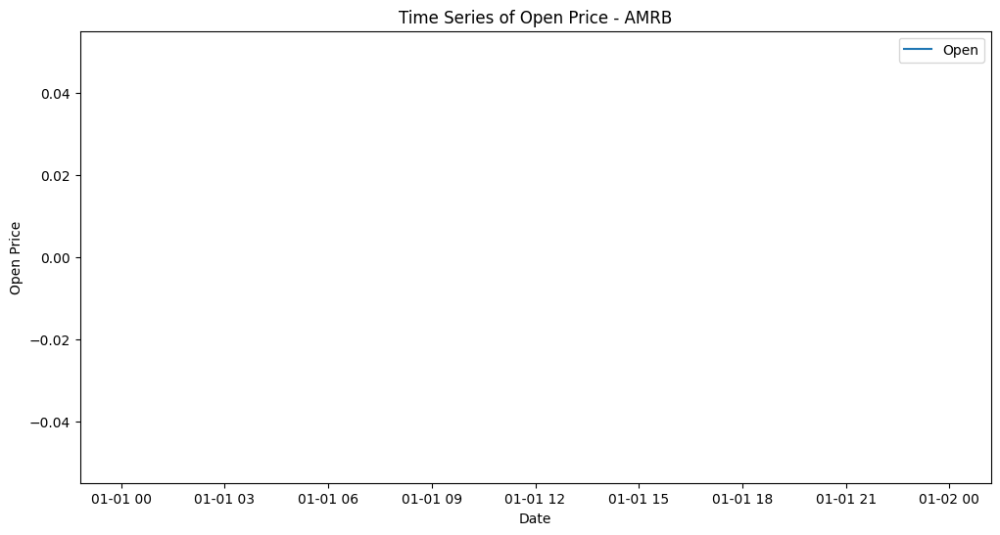

An error occurred for AMRB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


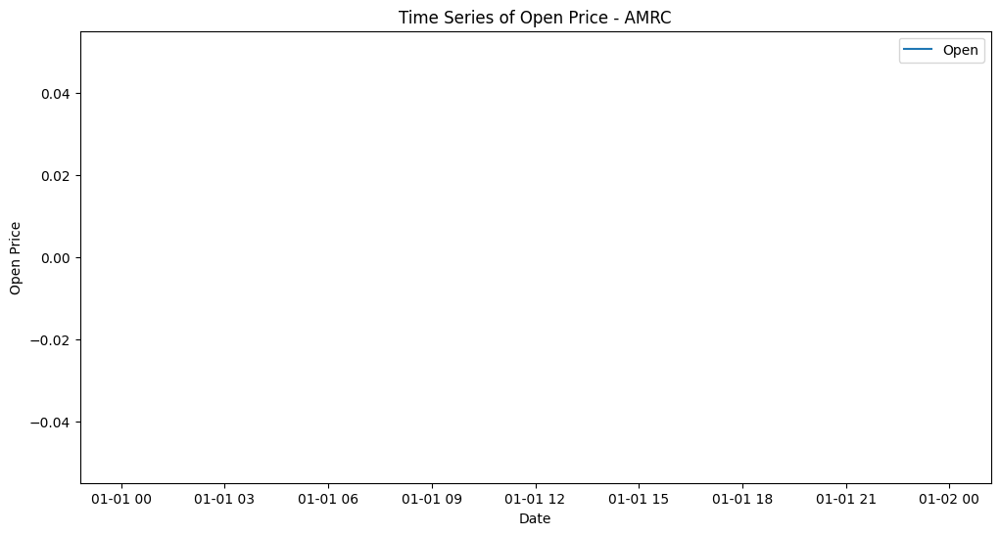

An error occurred for AMRC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


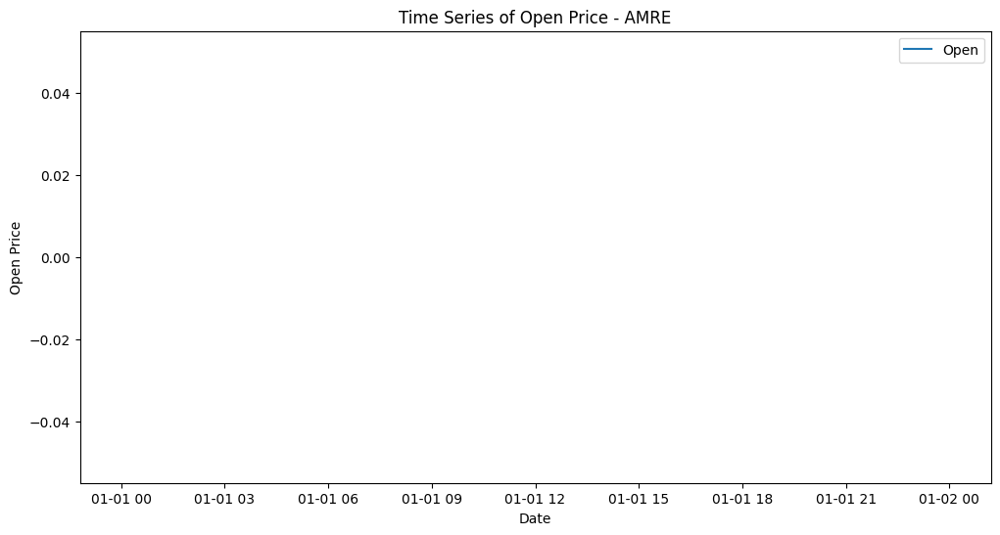

An error occurred for AMRE: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


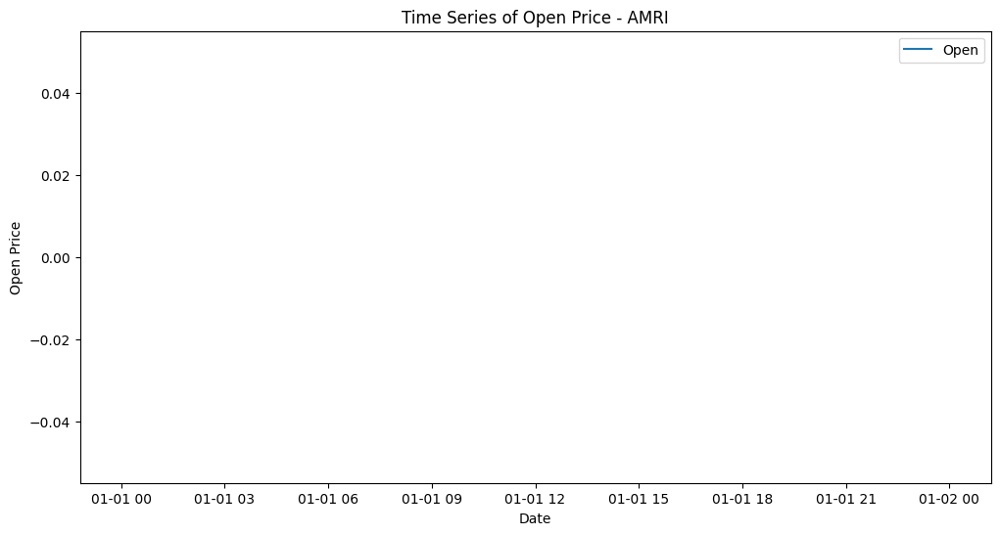

An error occurred for AMRI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


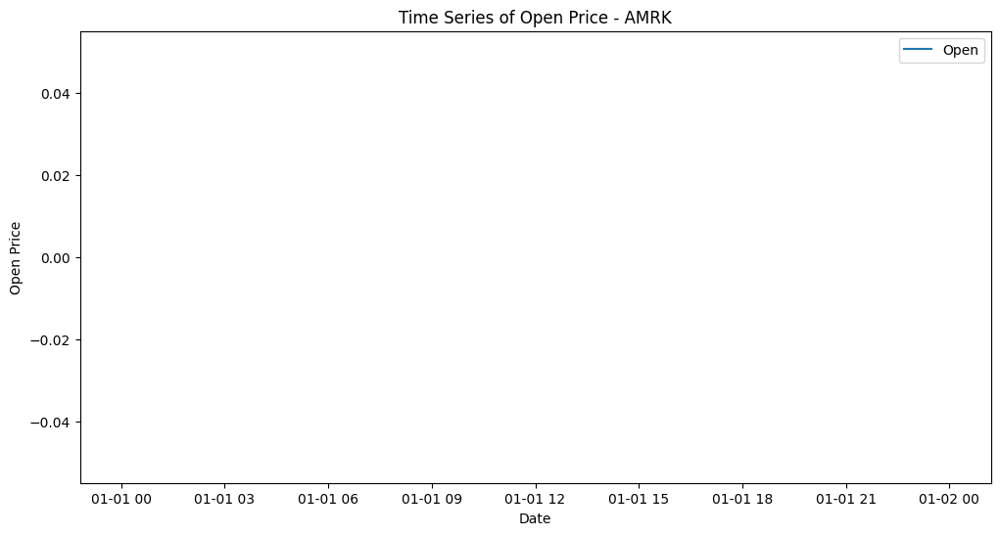

An error occurred for AMRK: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


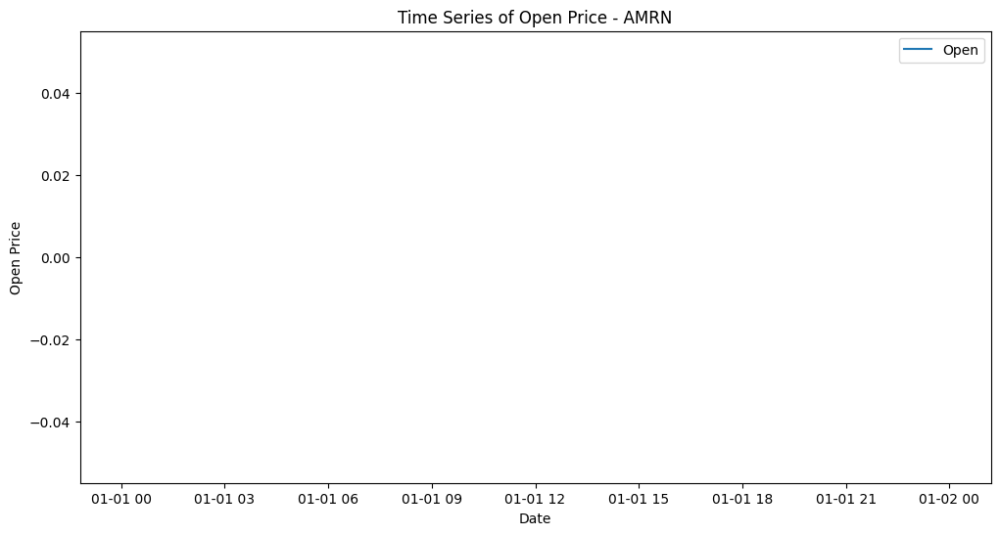

An error occurred for AMRN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


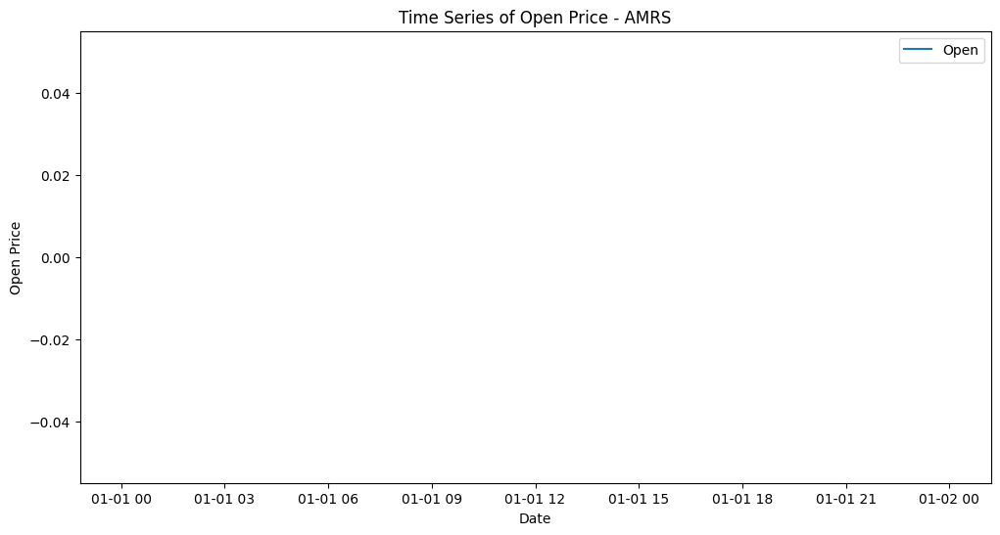

An error occurred for AMRS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


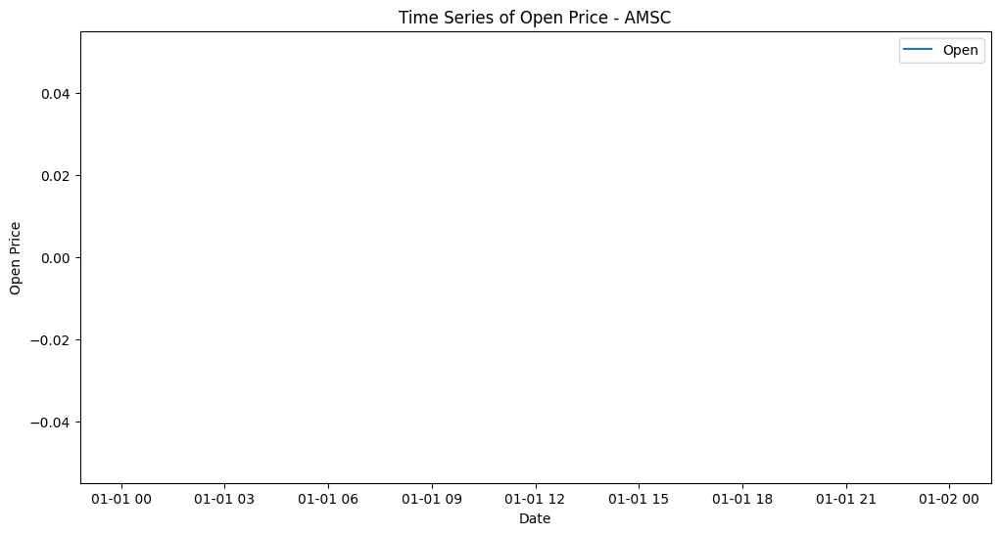

An error occurred for AMSC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


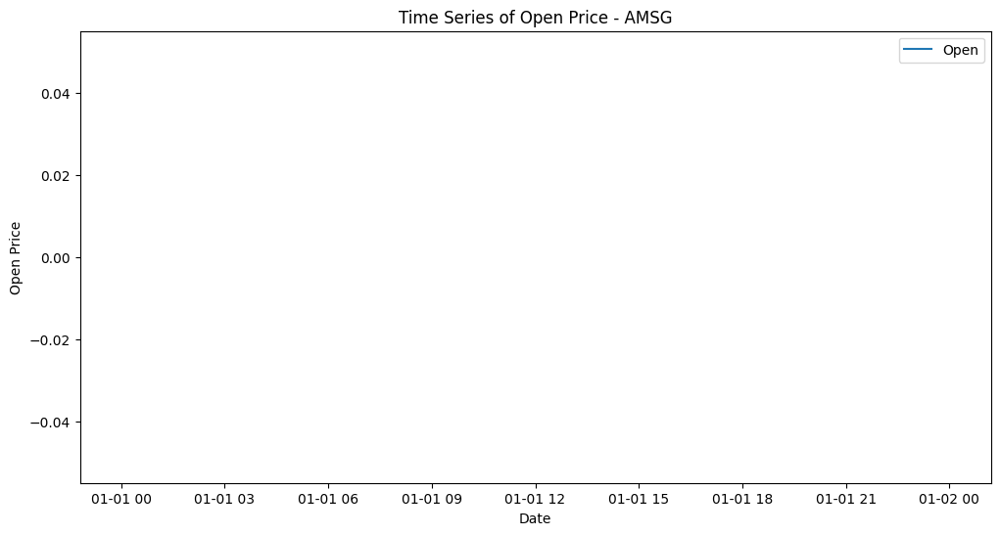

An error occurred for AMSG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


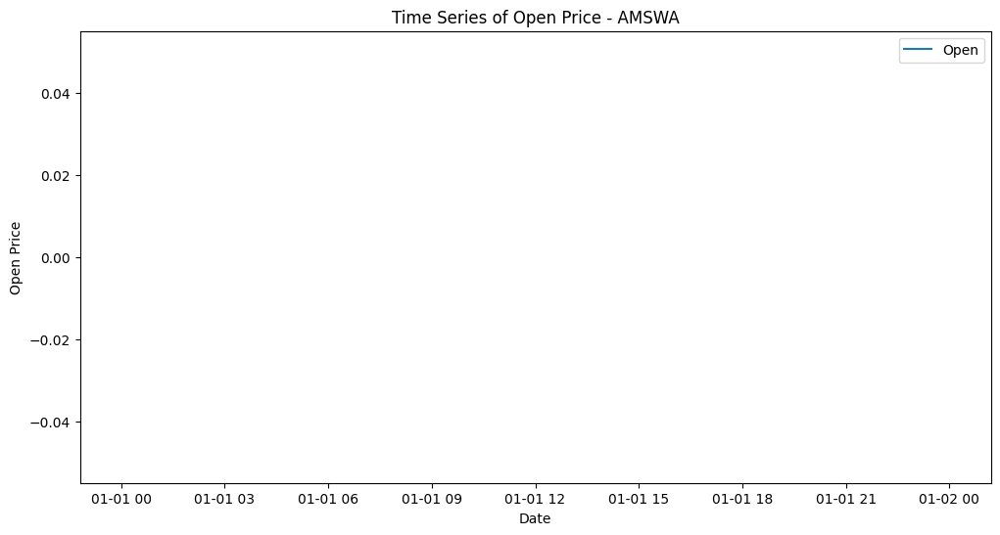

An error occurred for AMSWA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


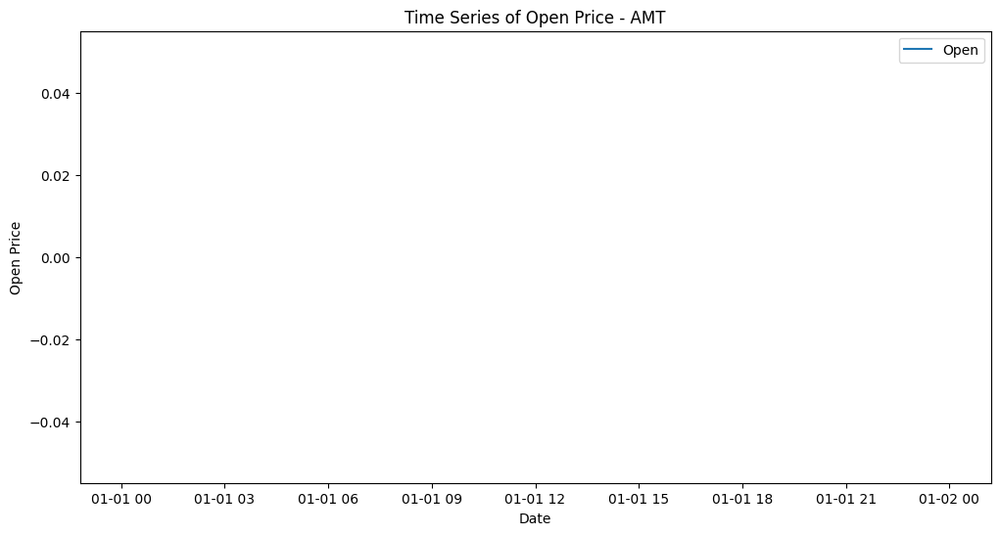

An error occurred for AMT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


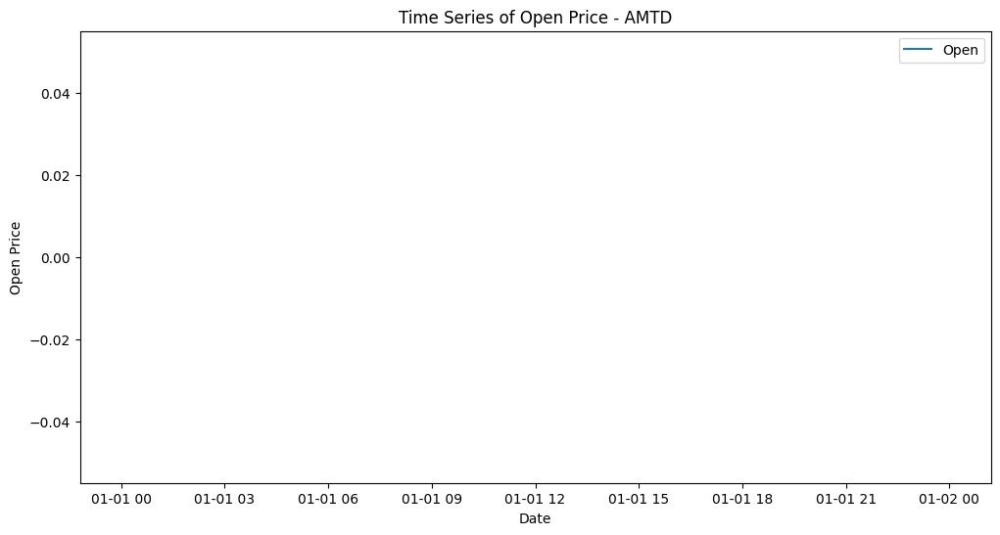

An error occurred for AMTD: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


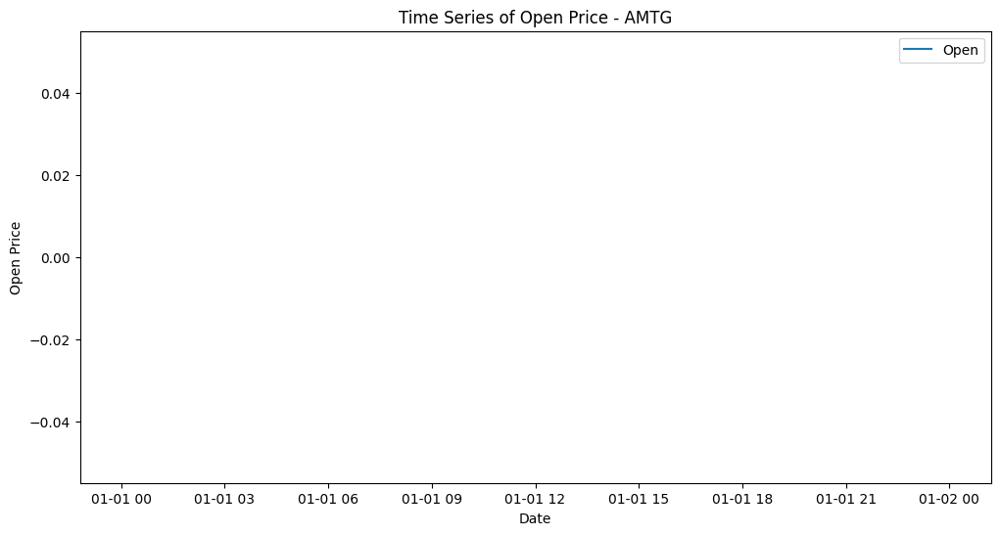

An error occurred for AMTG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


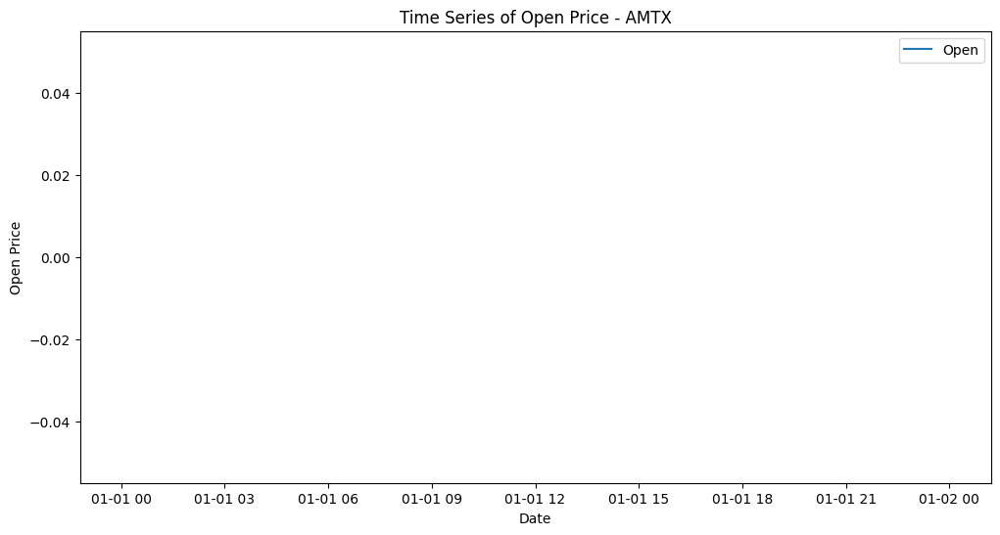

An error occurred for AMTX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


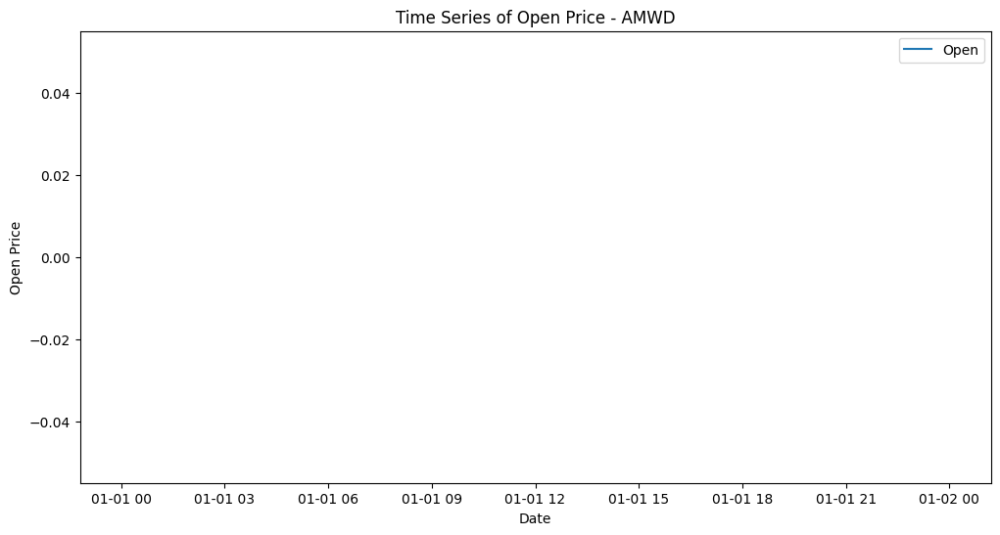

An error occurred for AMWD: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


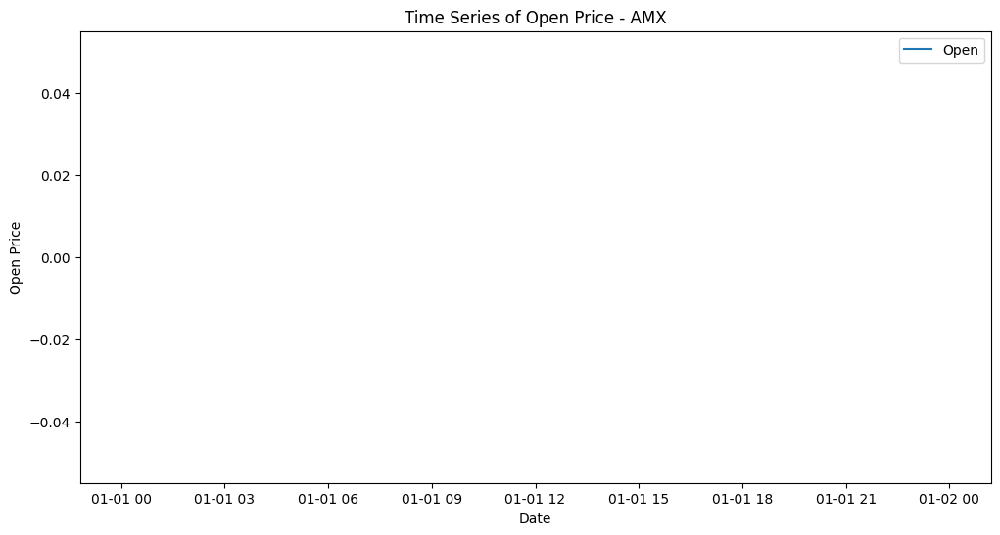

An error occurred for AMX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


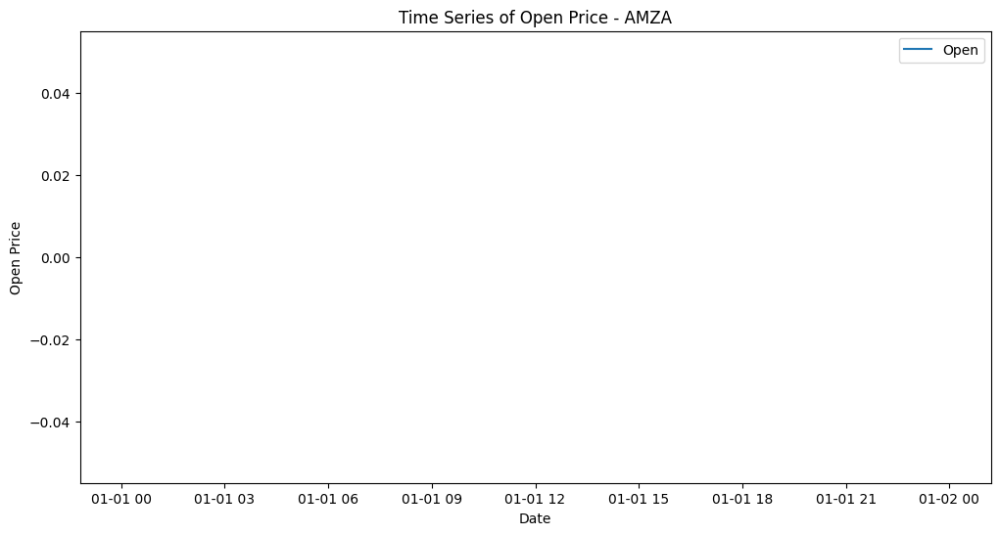

An error occurred for AMZA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


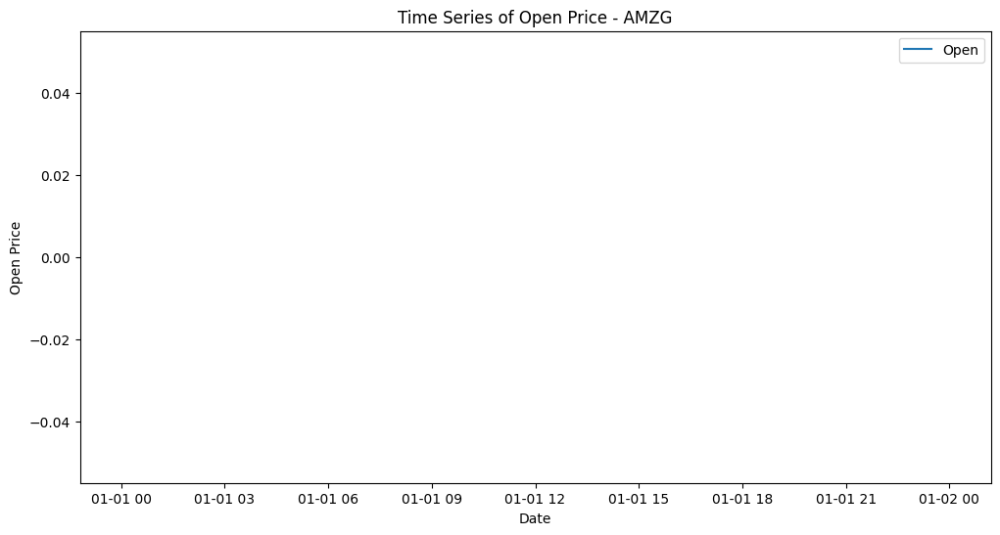

An error occurred for AMZG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


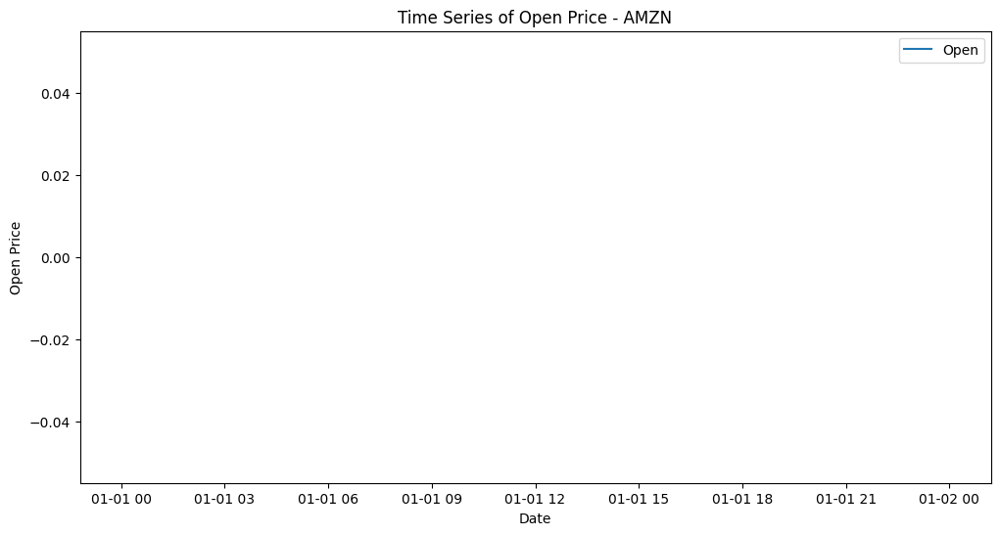

An error occurred for AMZN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


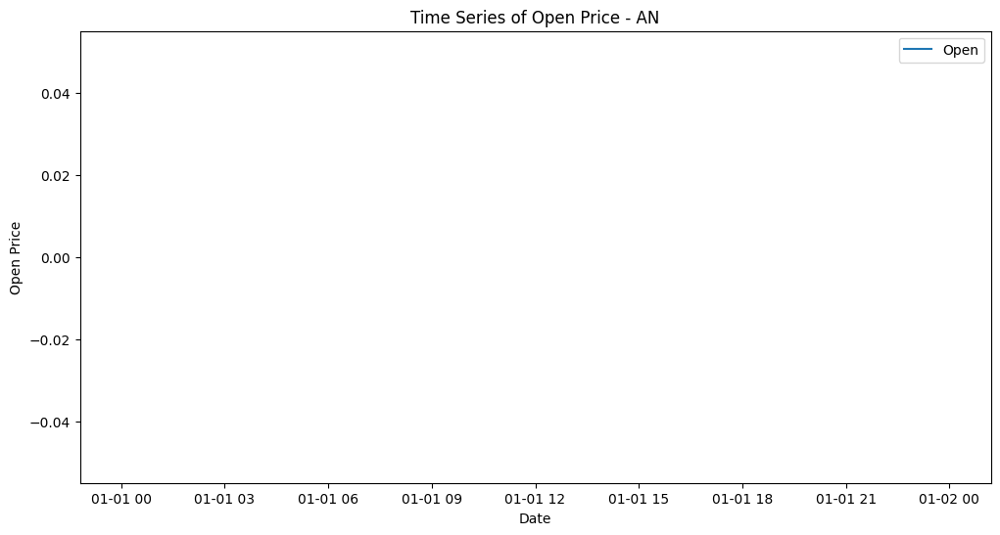

An error occurred for AN: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


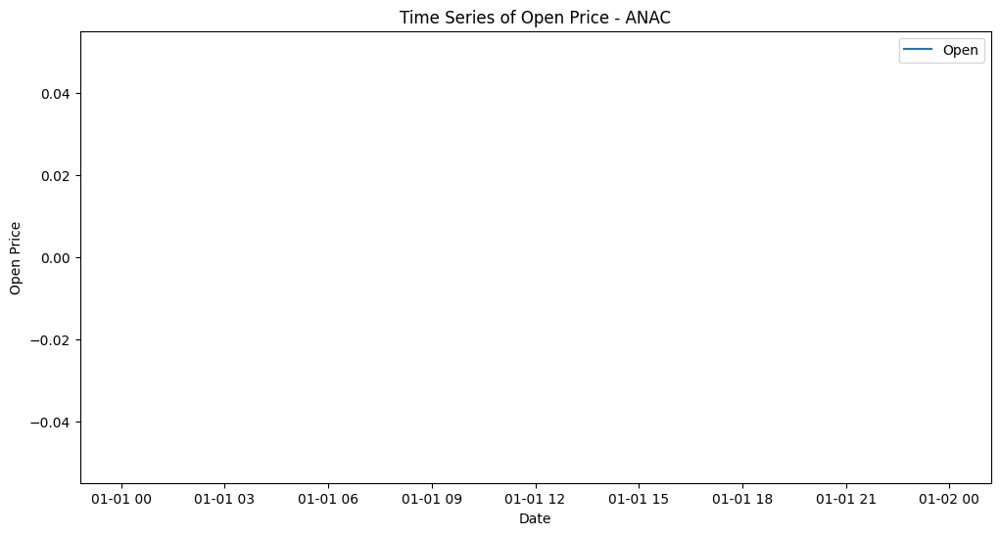

An error occurred for ANAC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


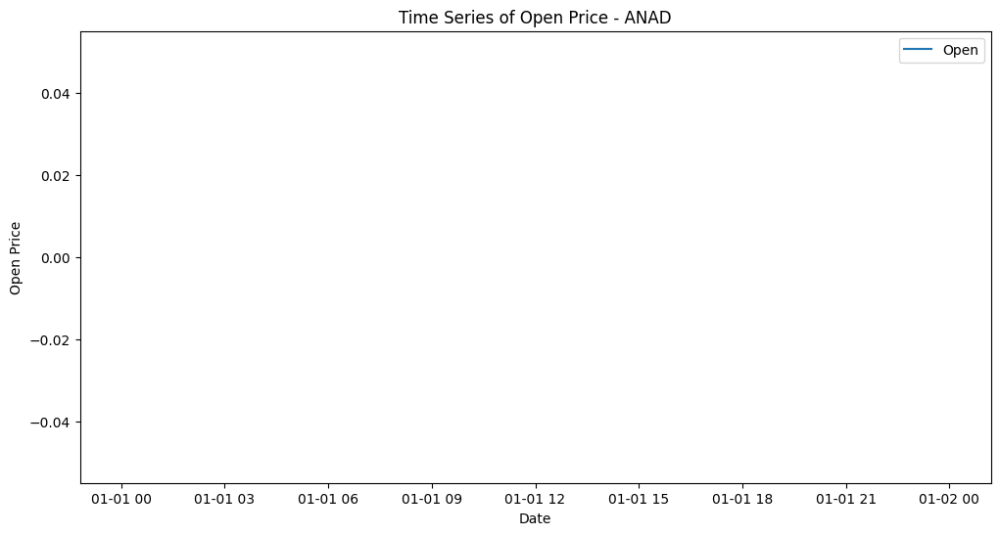

An error occurred for ANAD: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


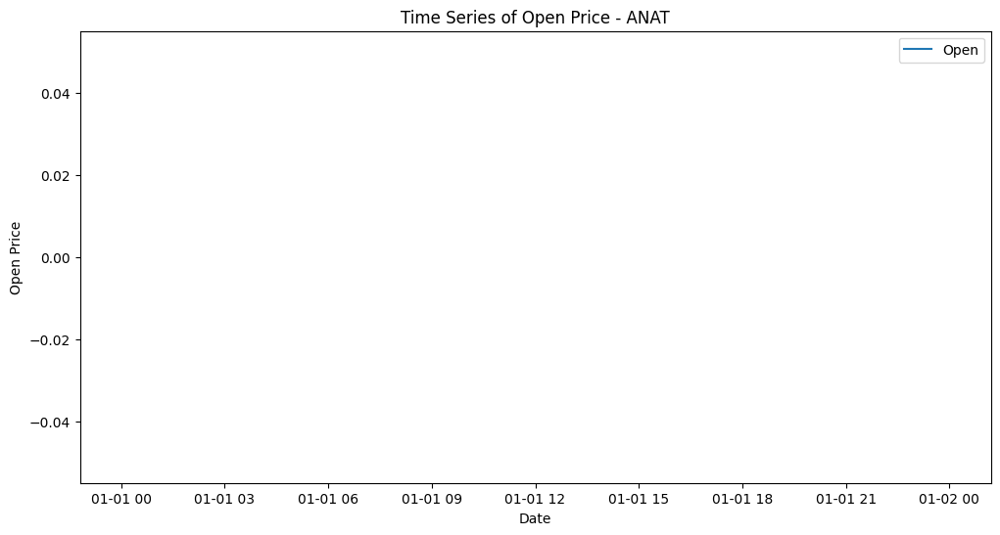

An error occurred for ANAT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


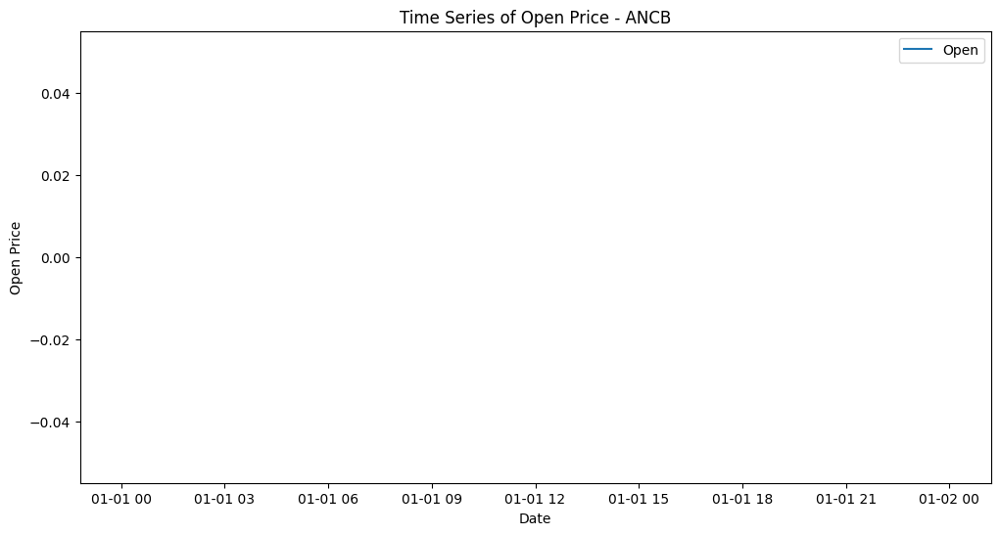

An error occurred for ANCB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


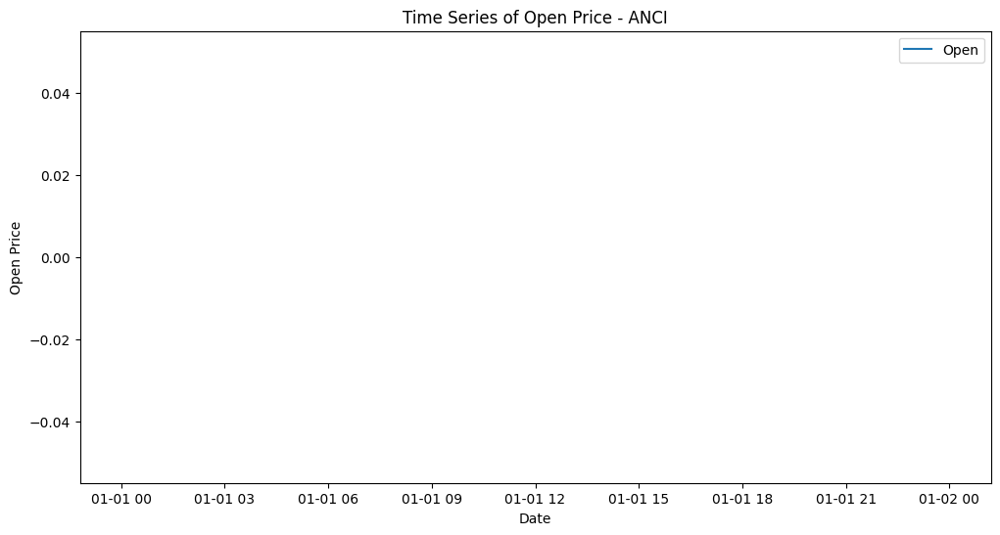

An error occurred for ANCI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


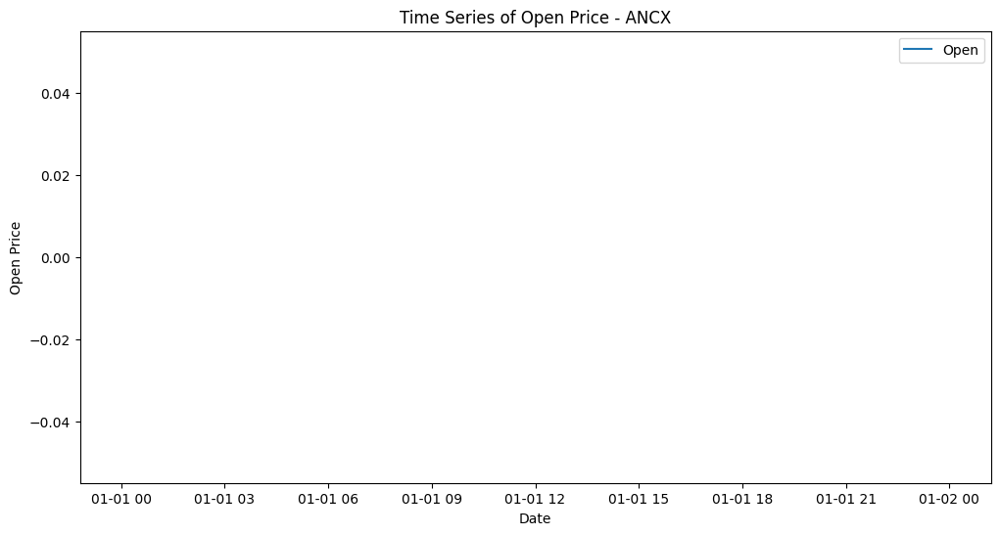

An error occurred for ANCX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


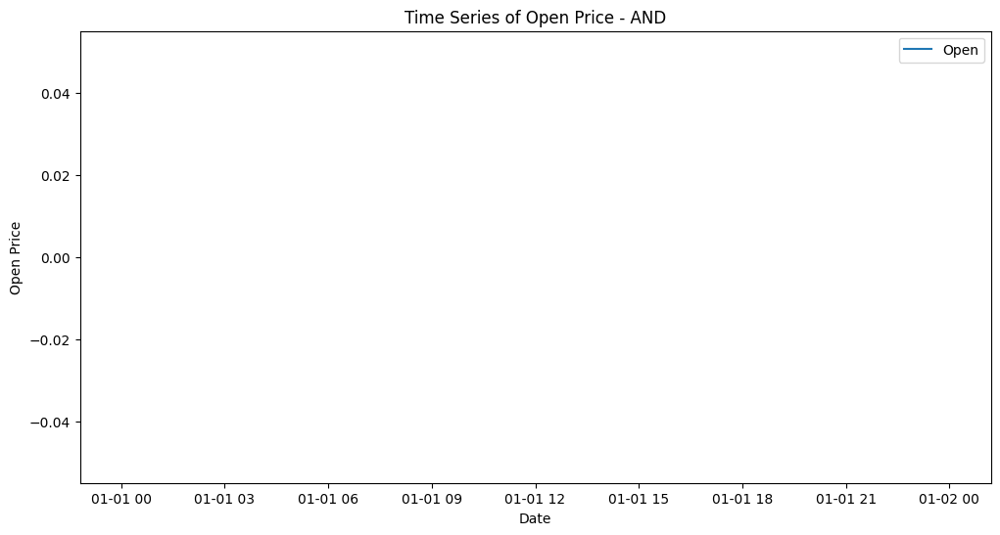

An error occurred for AND: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


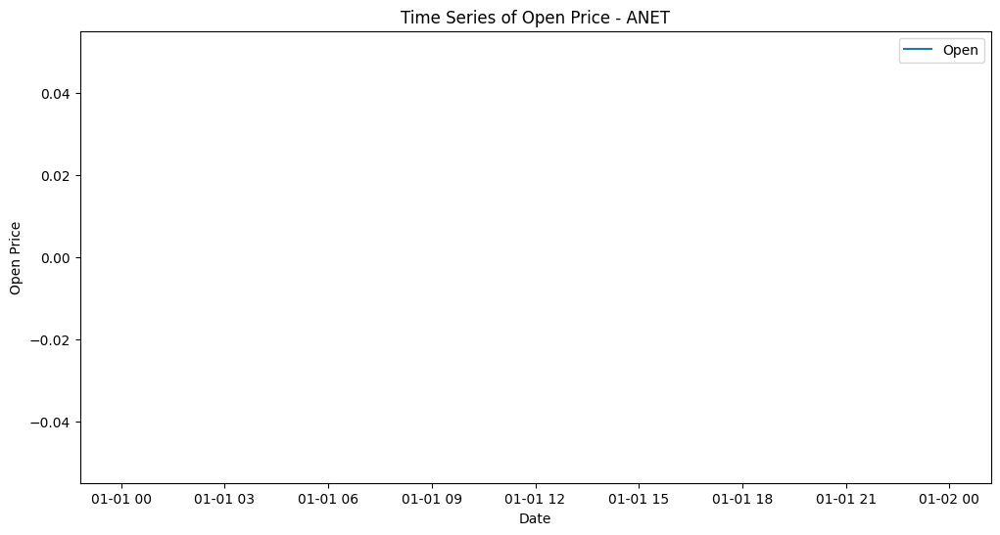

An error occurred for ANET: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


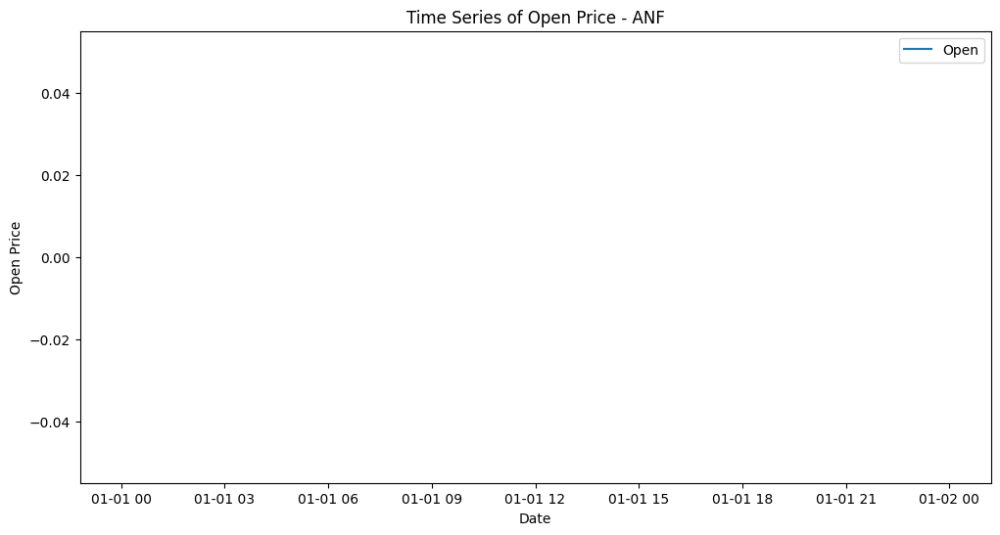

An error occurred for ANF: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


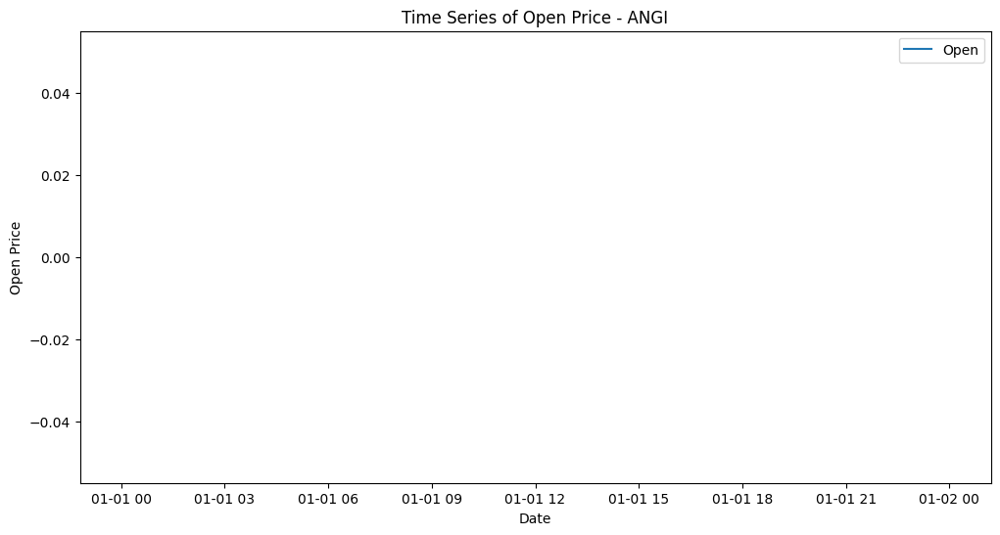

An error occurred for ANGI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


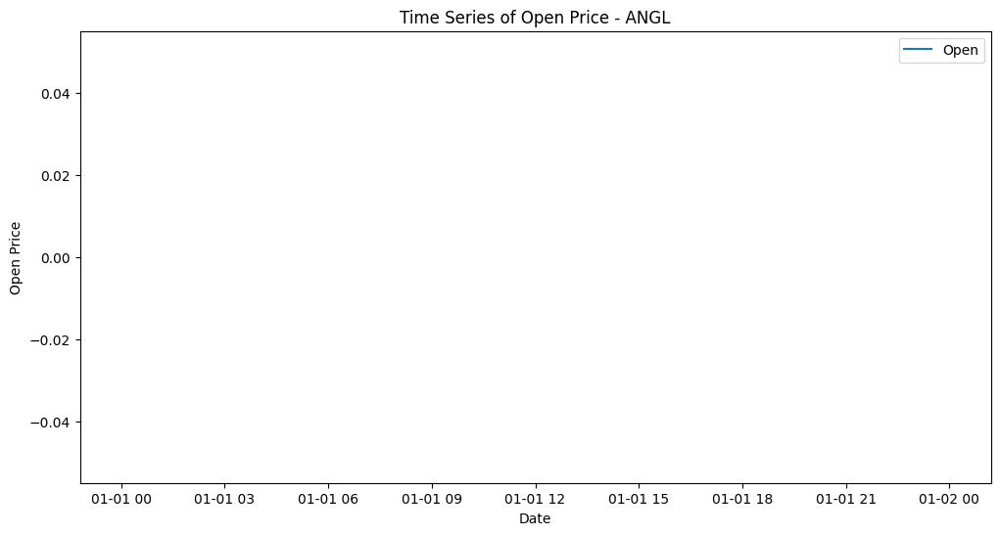

An error occurred for ANGL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


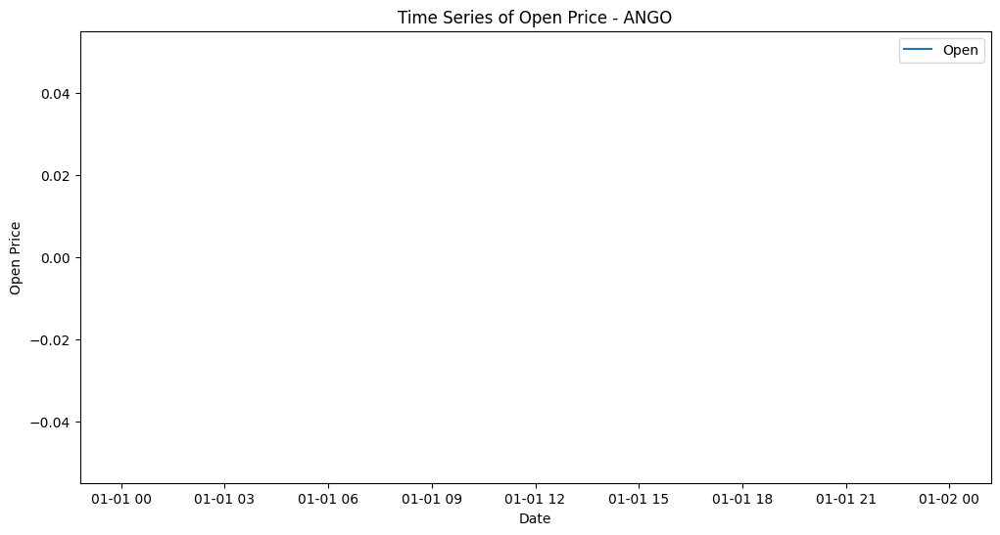

An error occurred for ANGO: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


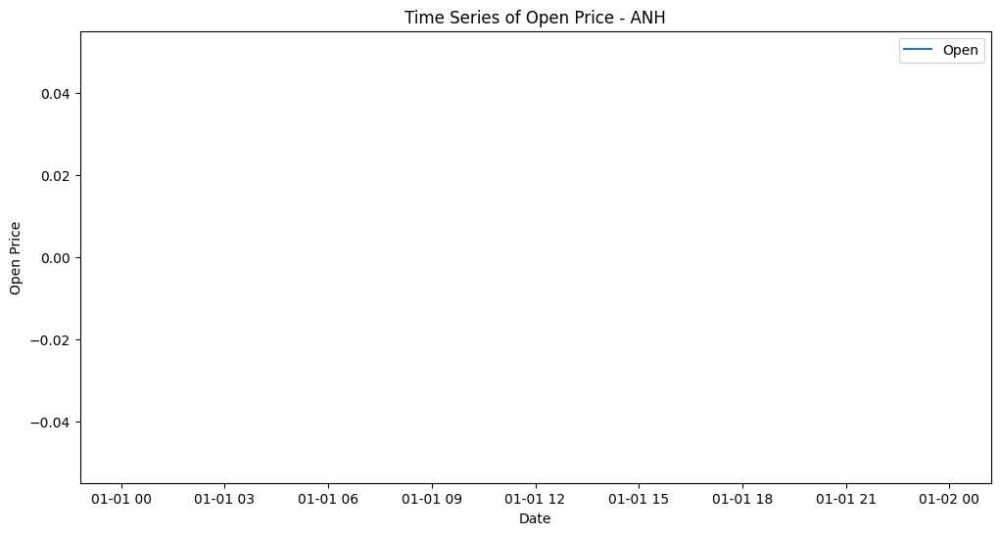

An error occurred for ANH: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


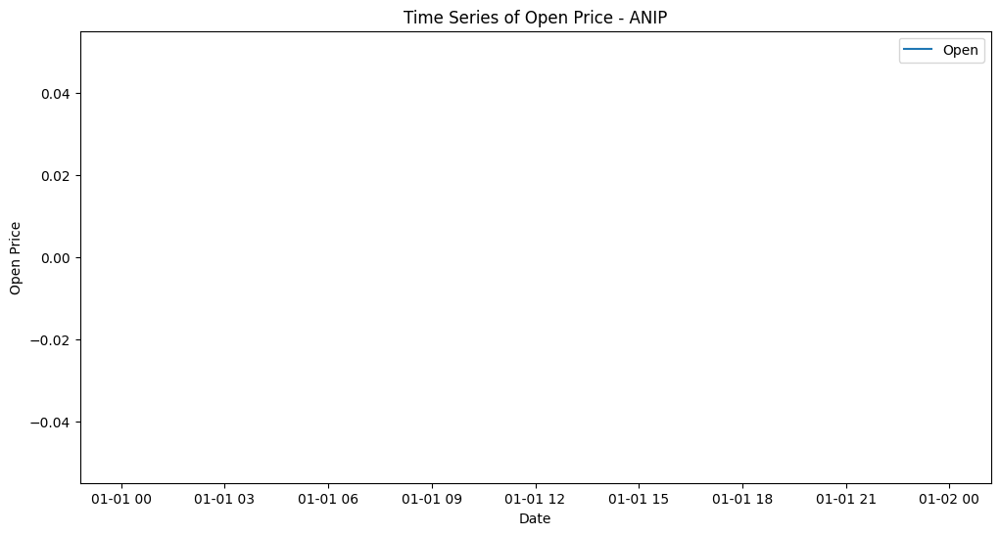

An error occurred for ANIP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


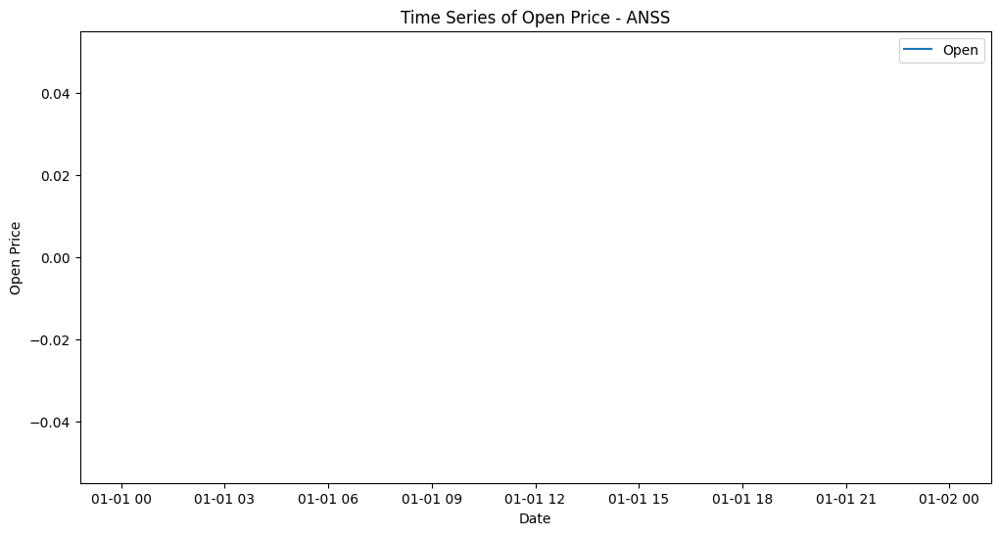

An error occurred for ANSS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


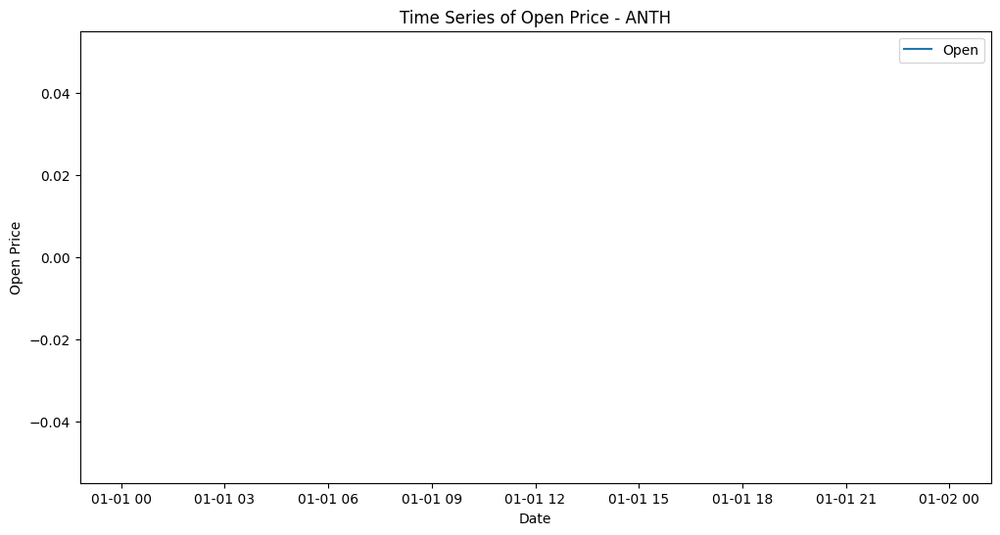

An error occurred for ANTH: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


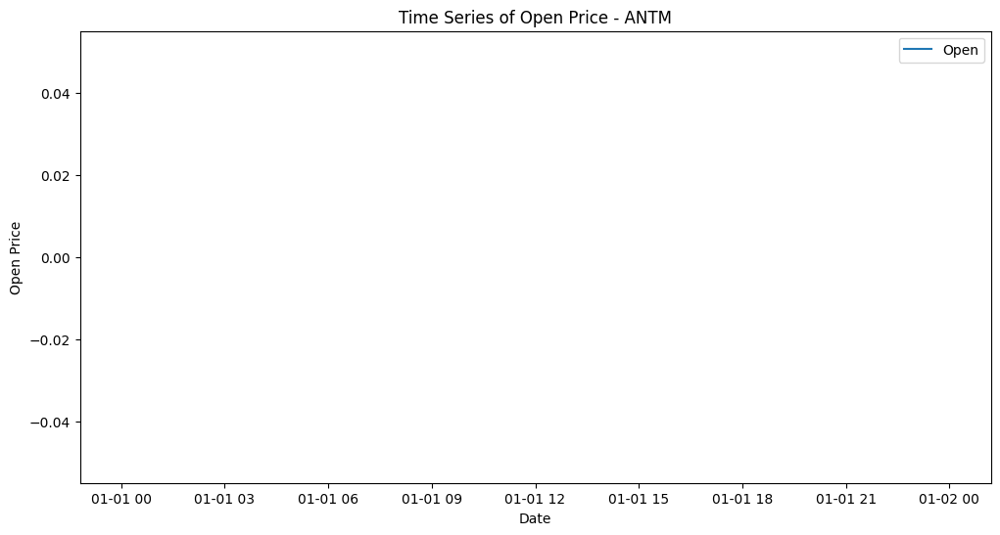

An error occurred for ANTM: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


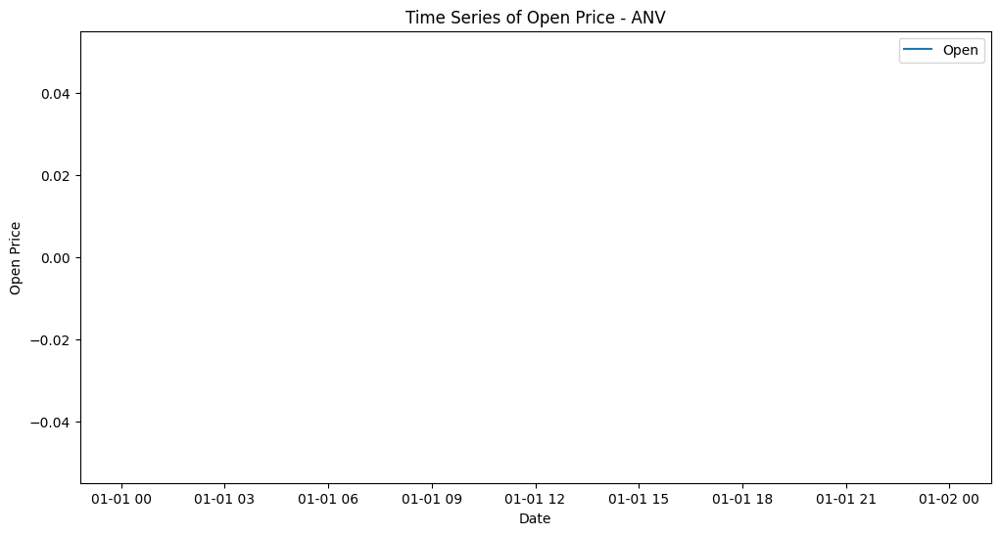

An error occurred for ANV: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


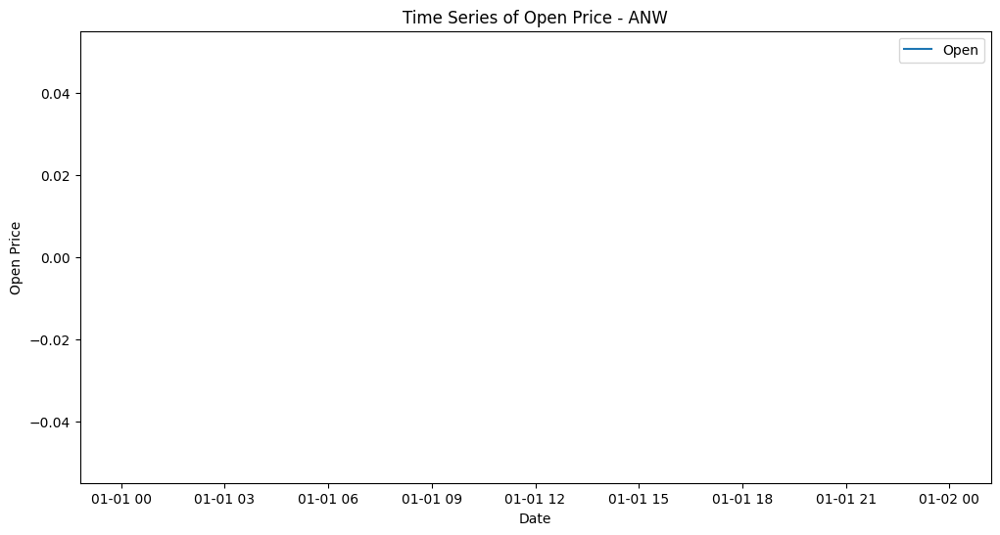

An error occurred for ANW: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


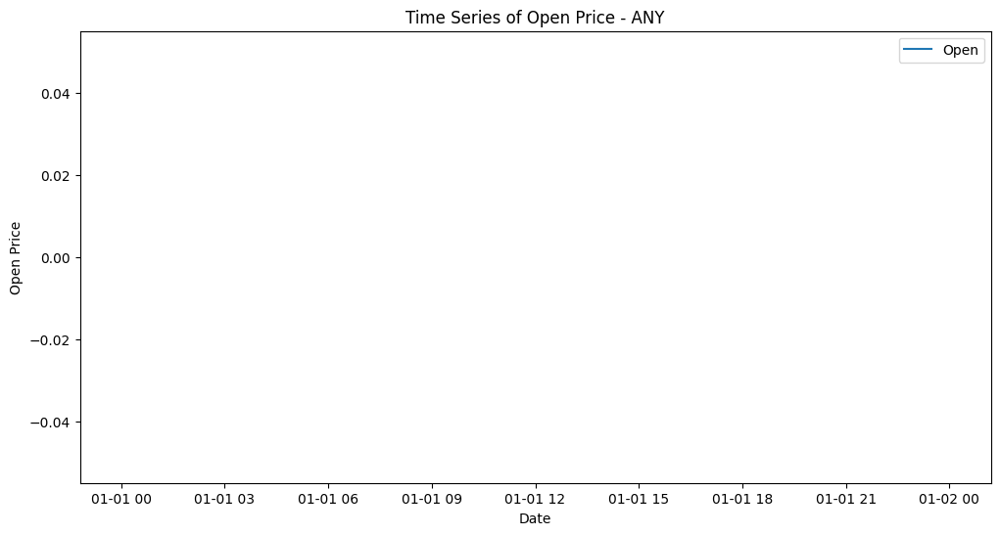

An error occurred for ANY: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


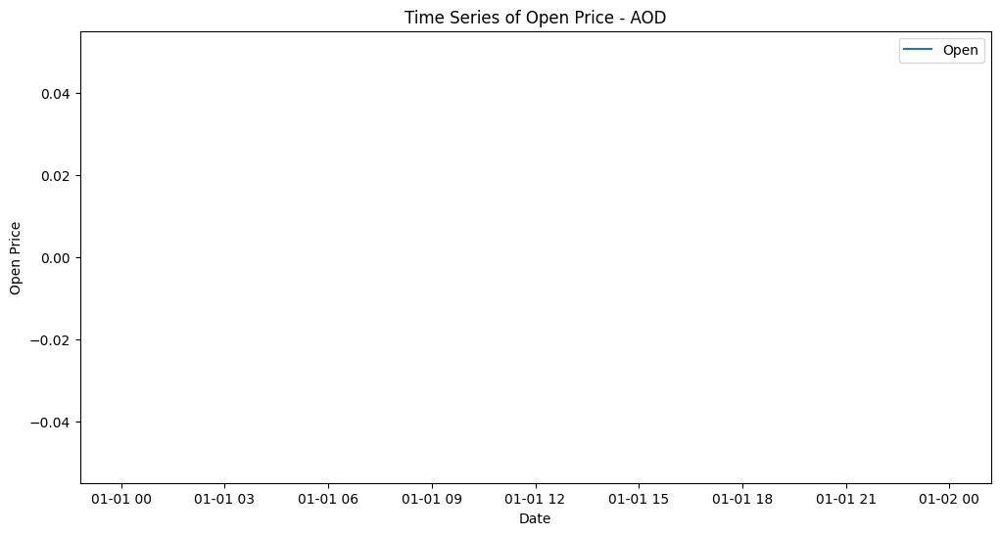

An error occurred for AOD: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


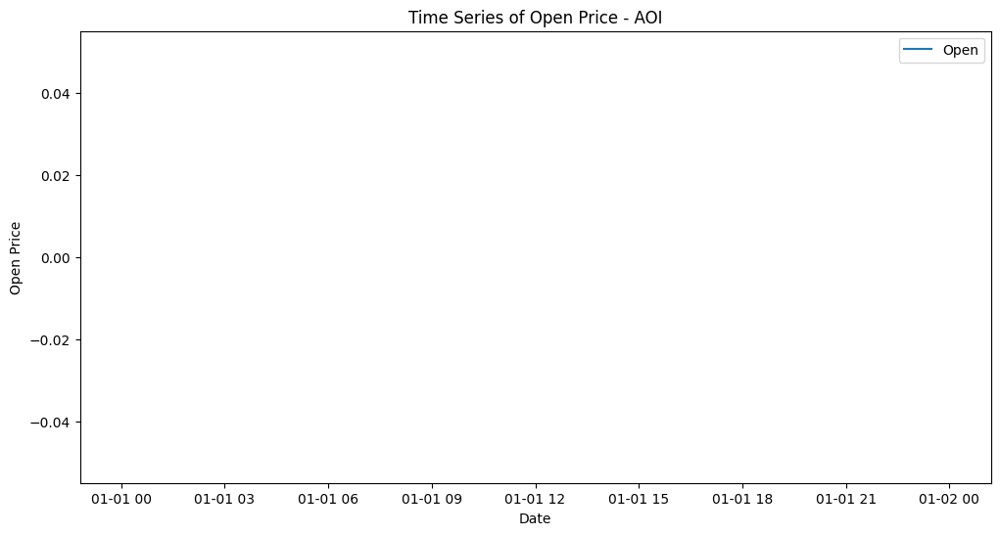

An error occurred for AOI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


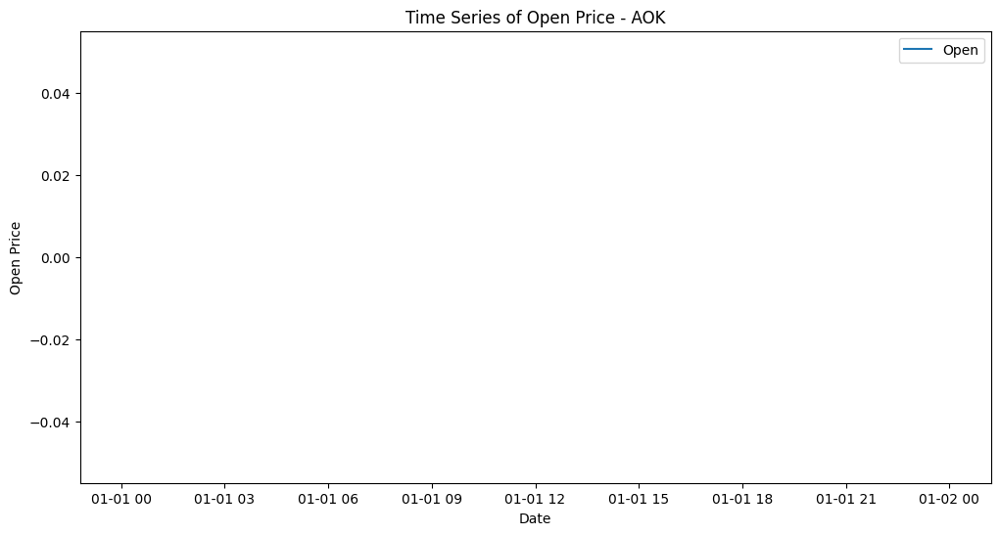

An error occurred for AOK: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


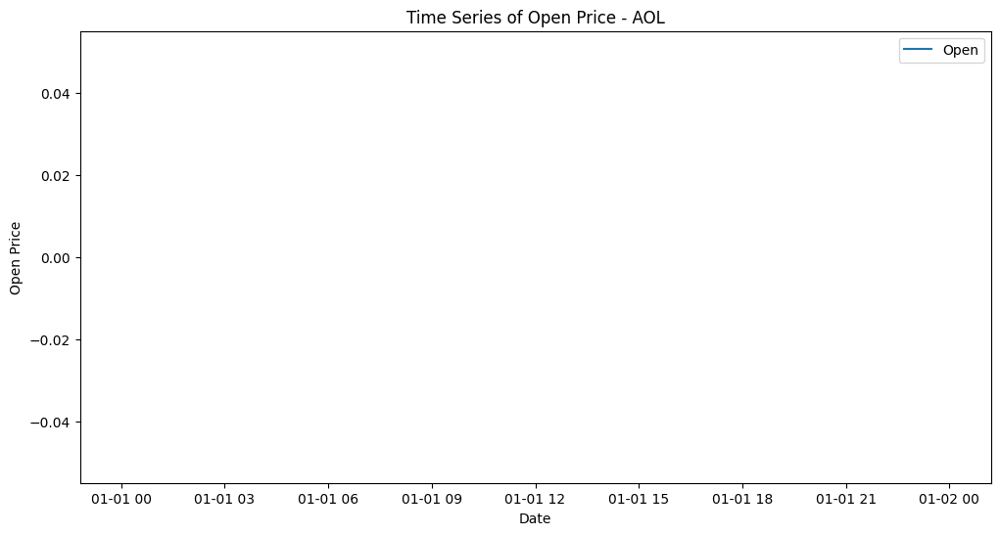

An error occurred for AOL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


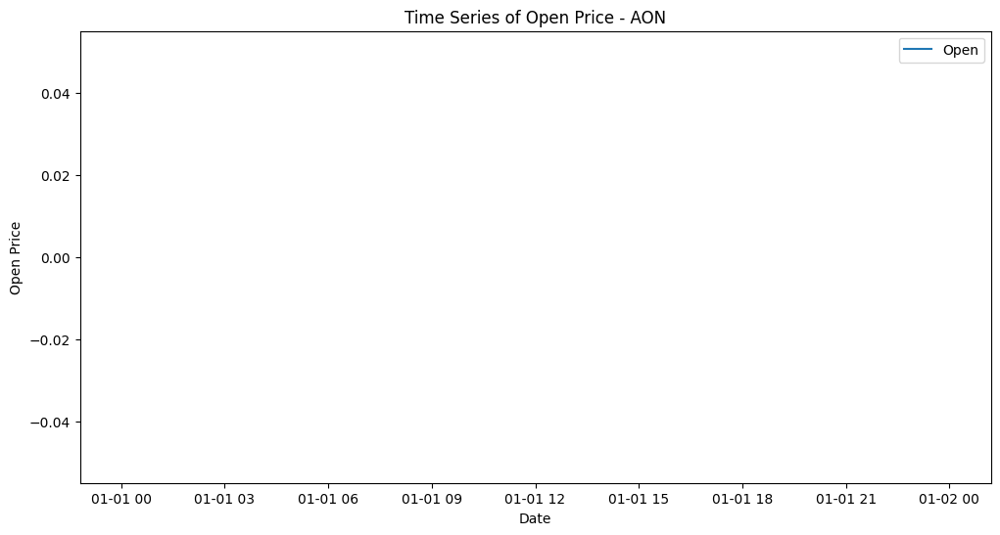

An error occurred for AON: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


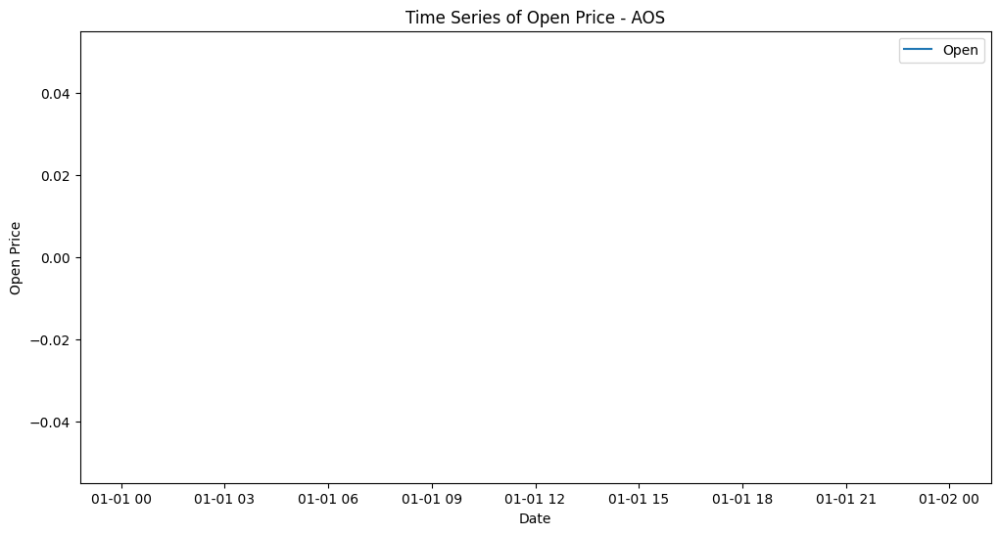

An error occurred for AOS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


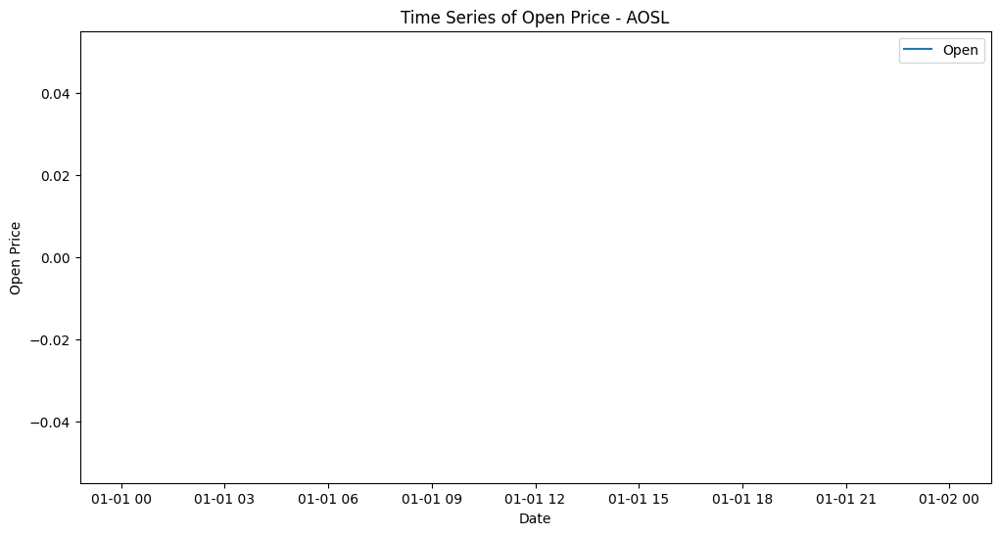

An error occurred for AOSL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


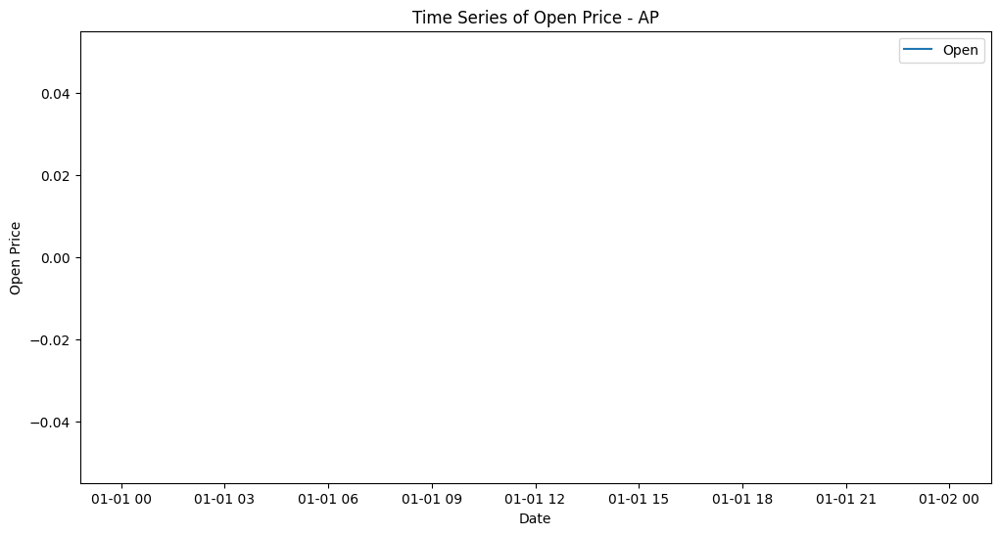

An error occurred for AP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


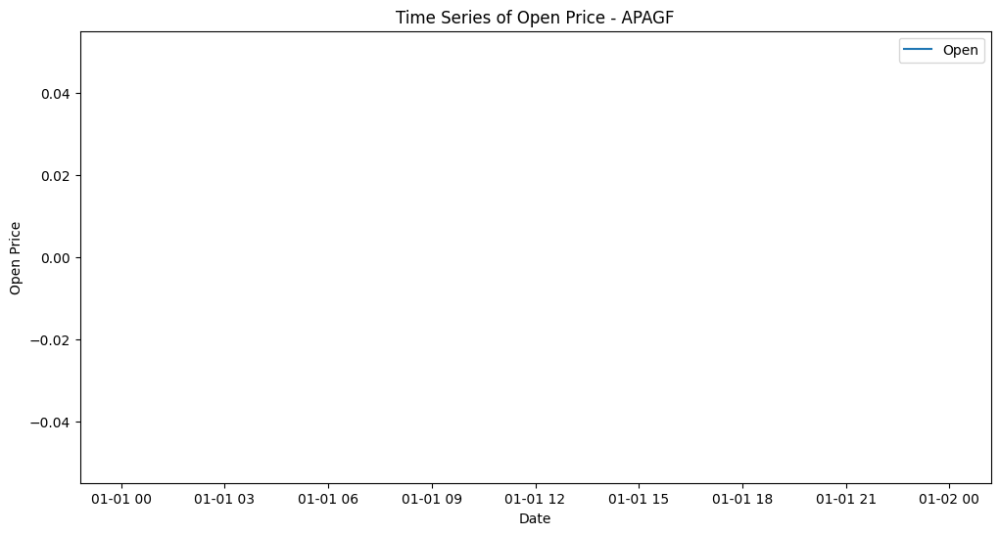

An error occurred for APAGF: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


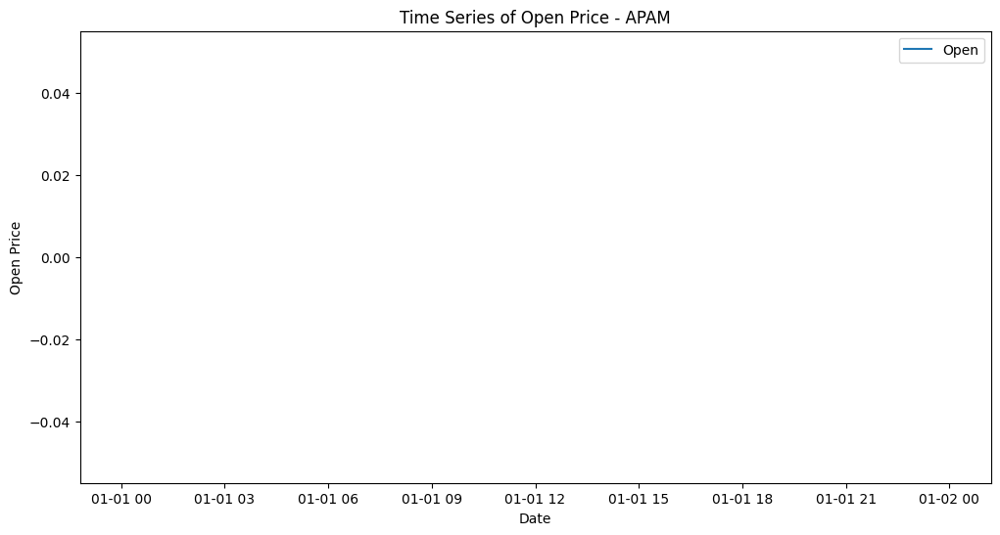

An error occurred for APAM: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


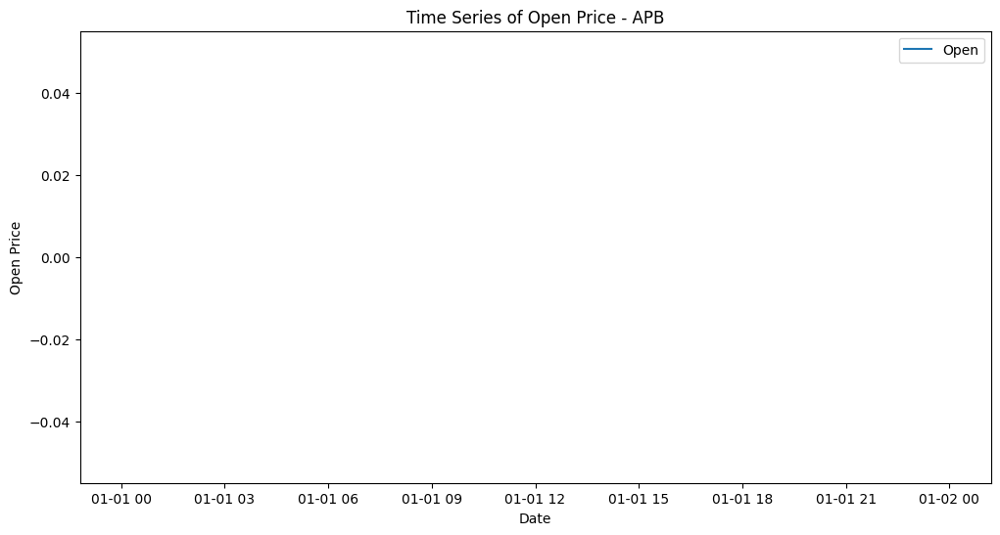

An error occurred for APB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


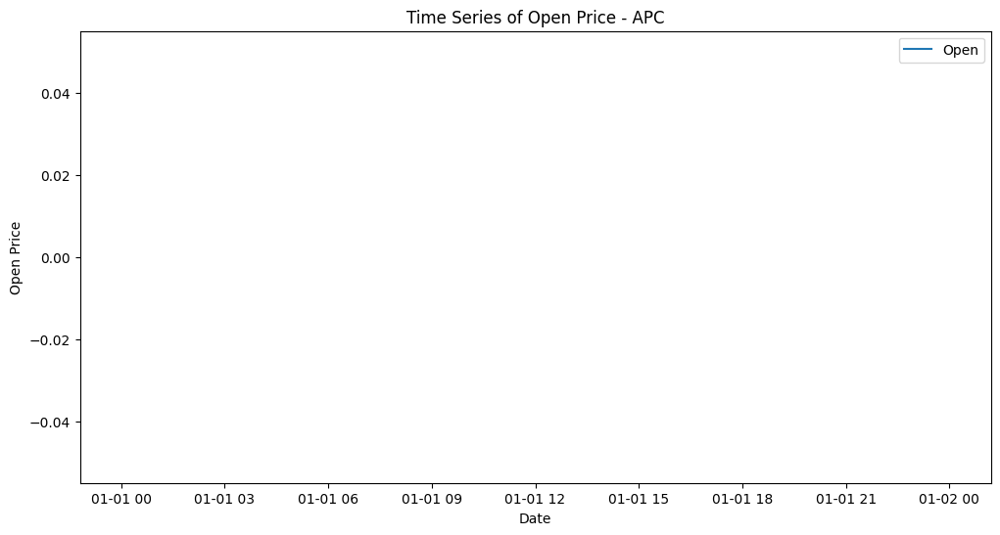

An error occurred for APC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


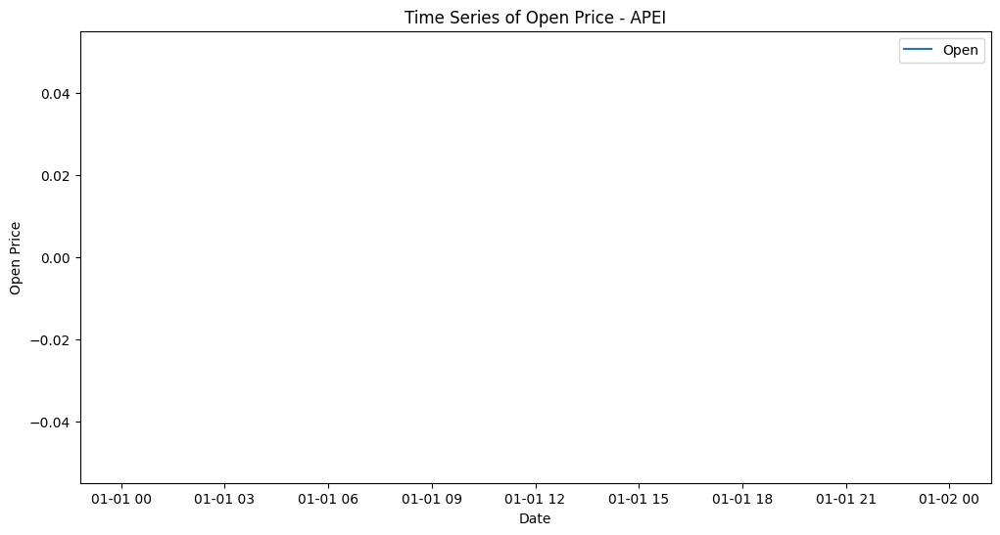

An error occurred for APEI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


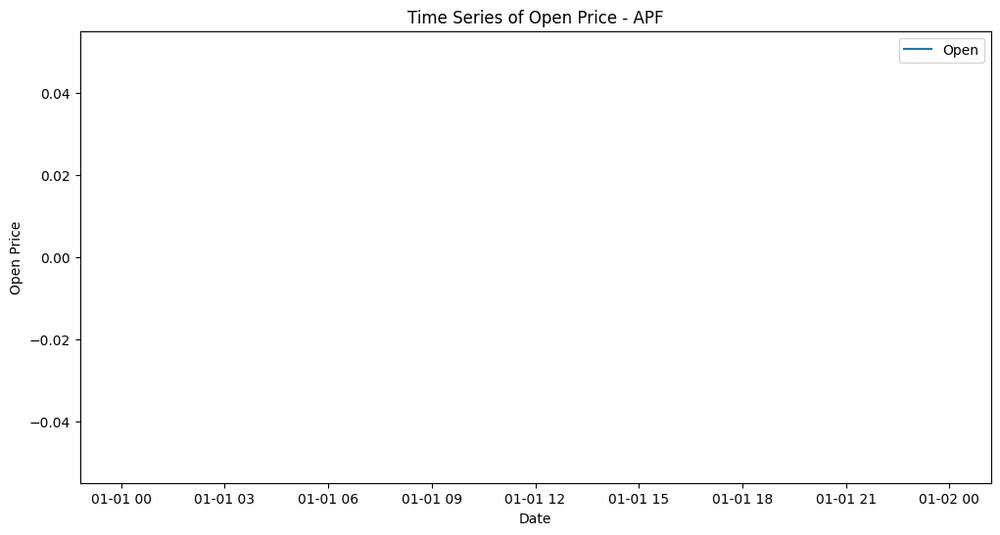

An error occurred for APF: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


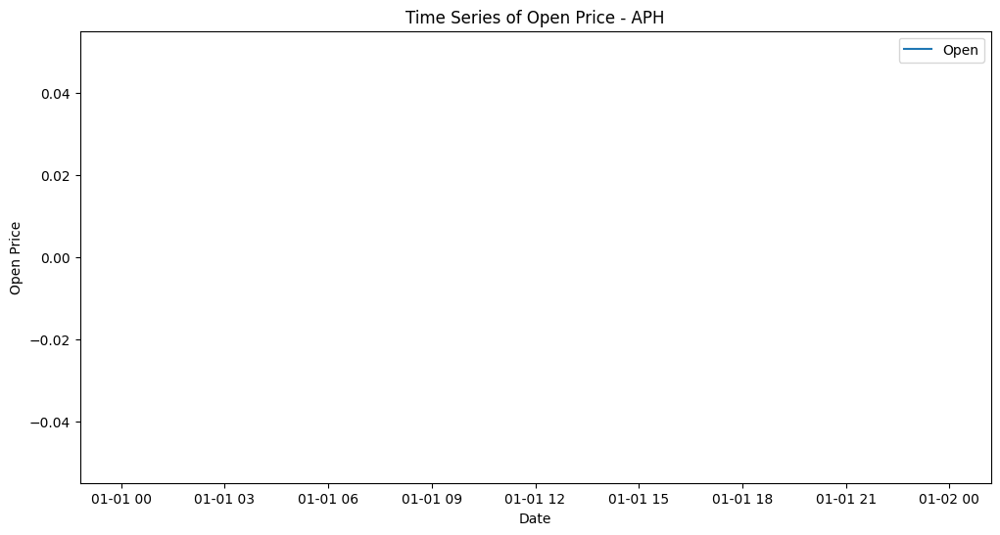

An error occurred for APH: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


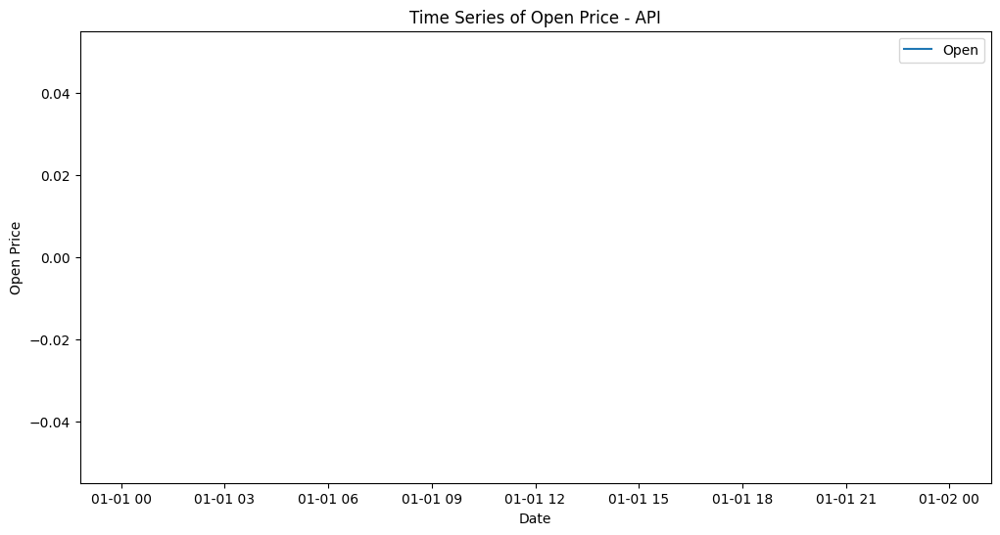

An error occurred for API: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


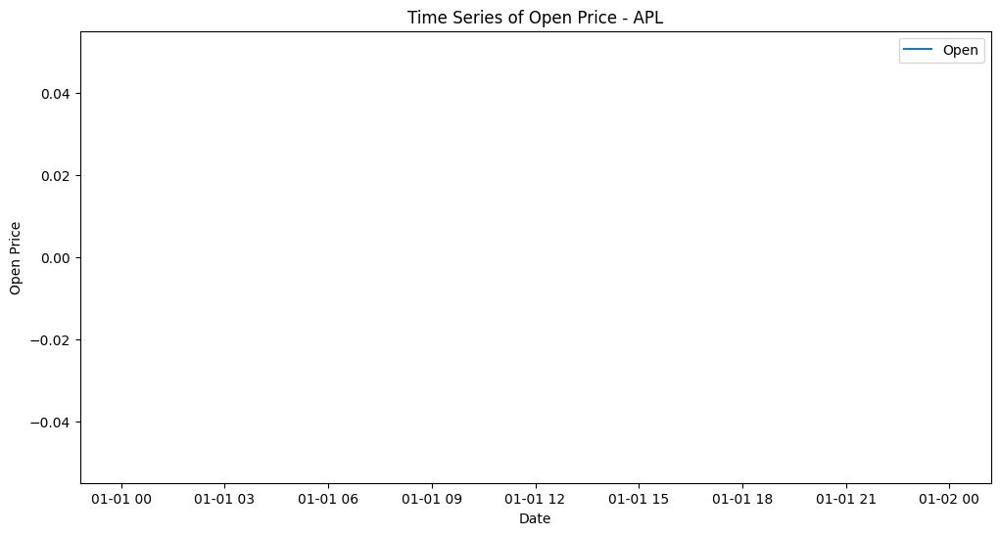

An error occurred for APL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


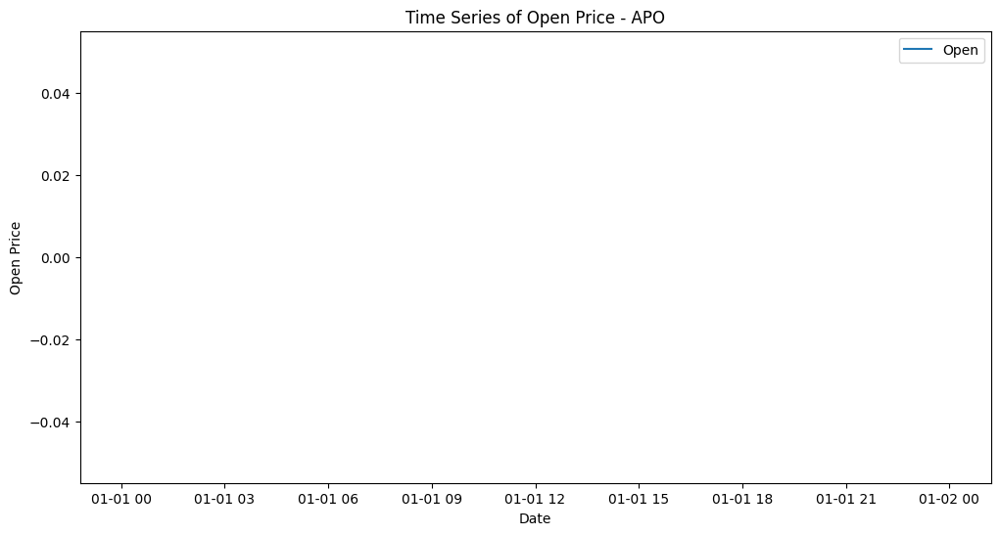

An error occurred for APO: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


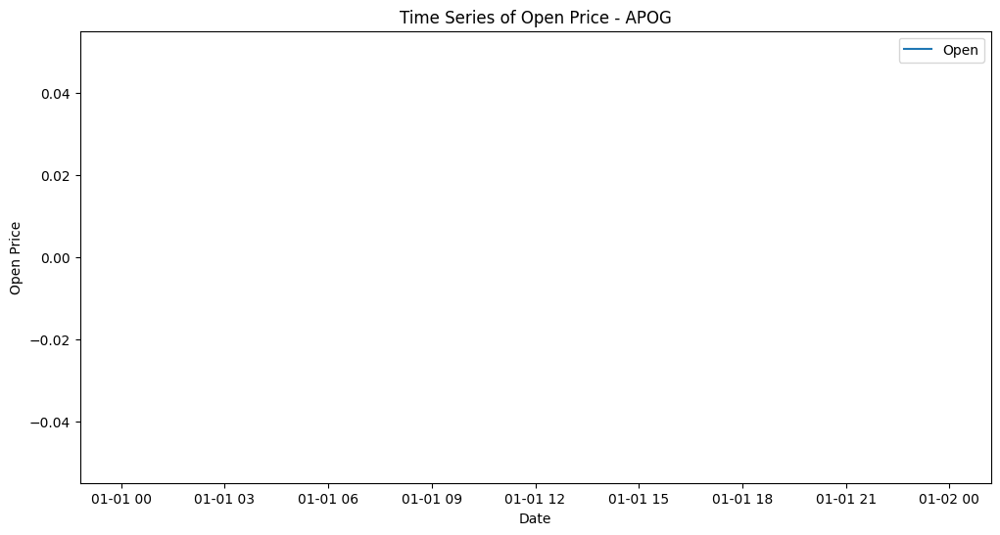

An error occurred for APOG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


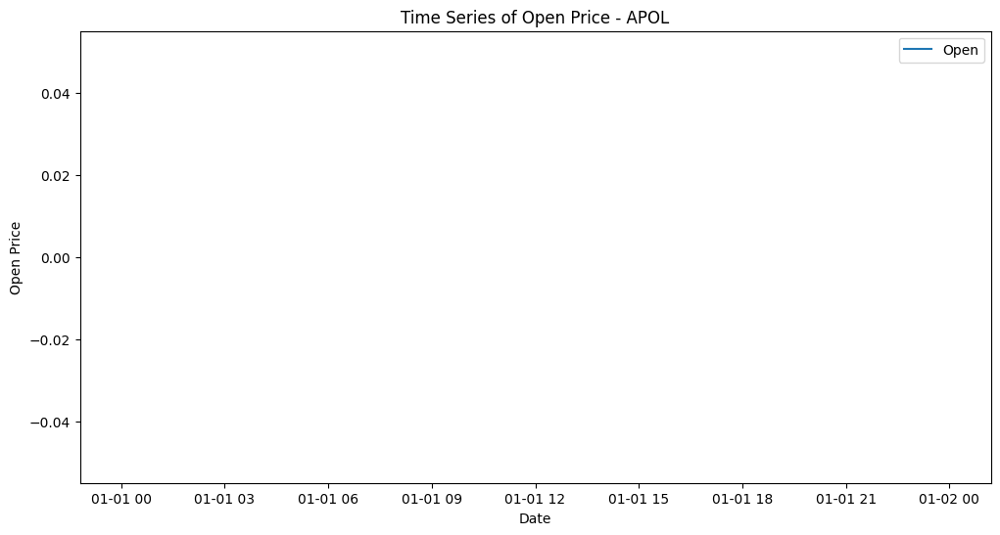

An error occurred for APOL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


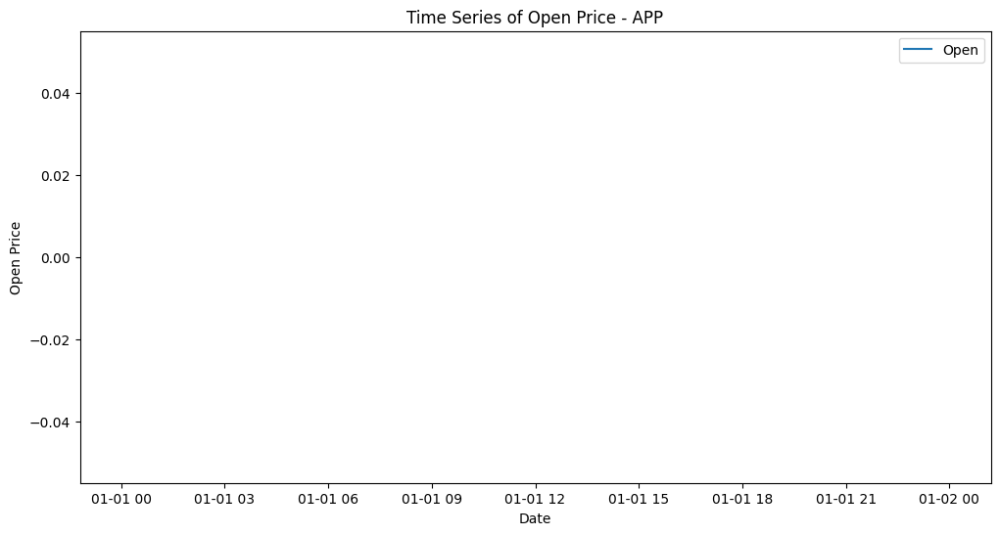

An error occurred for APP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


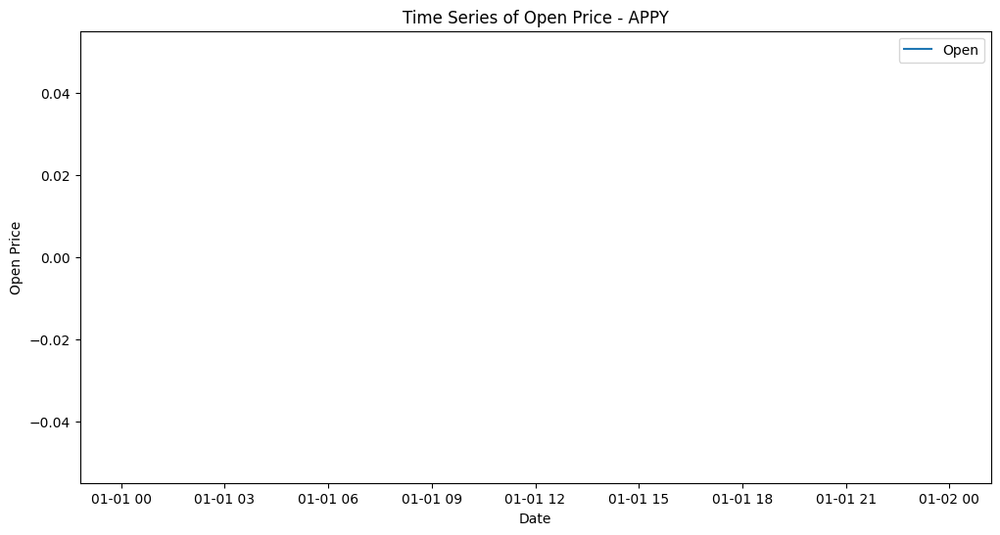

An error occurred for APPY: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


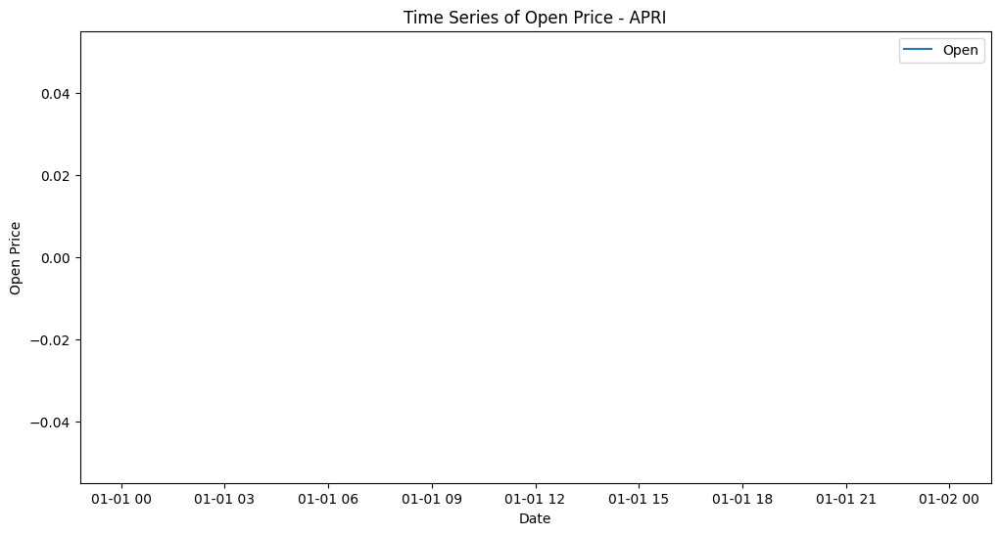

An error occurred for APRI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


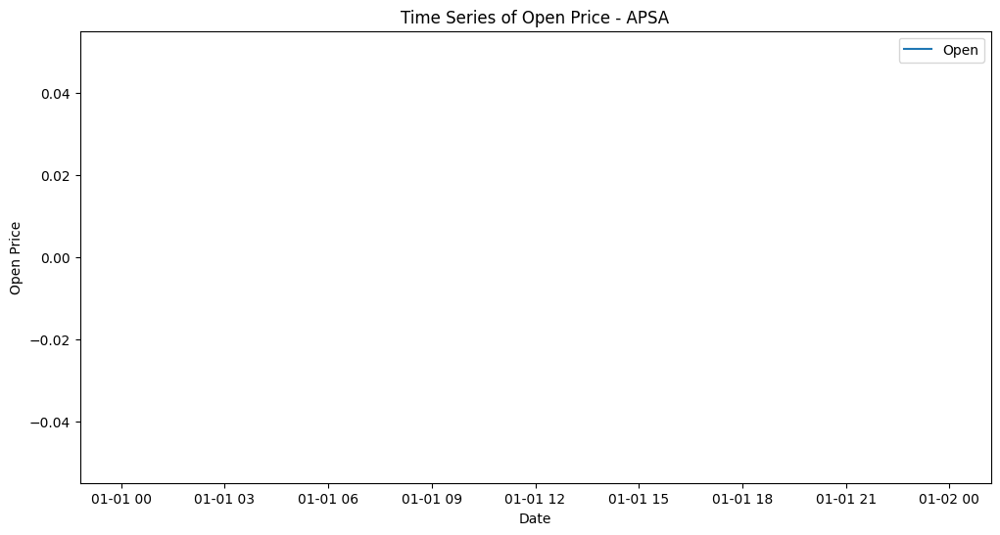

An error occurred for APSA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


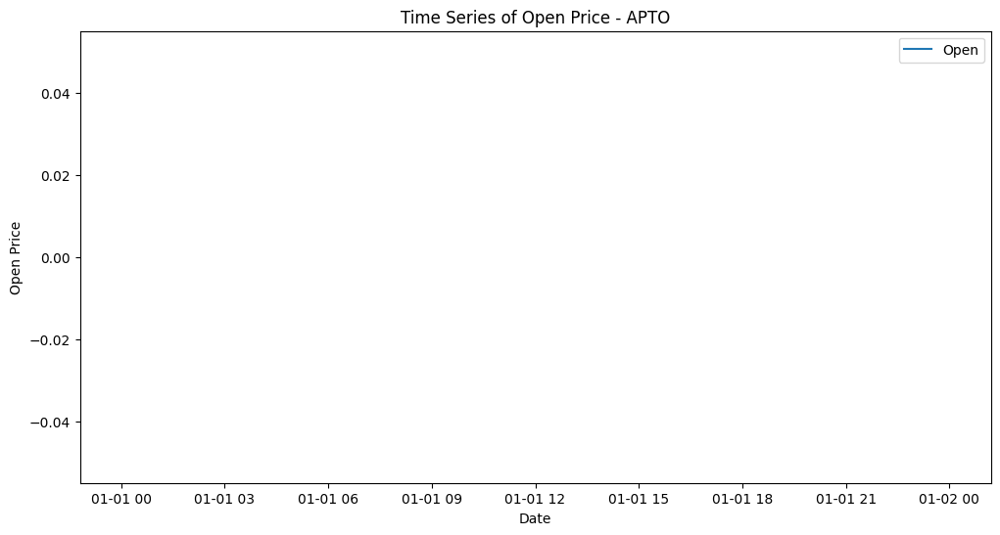

An error occurred for APTO: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


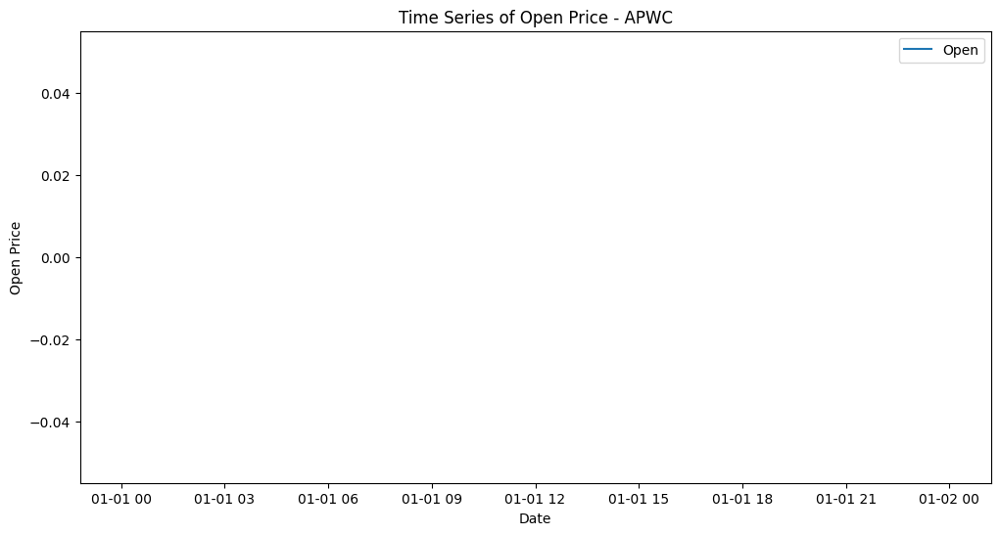

An error occurred for APWC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


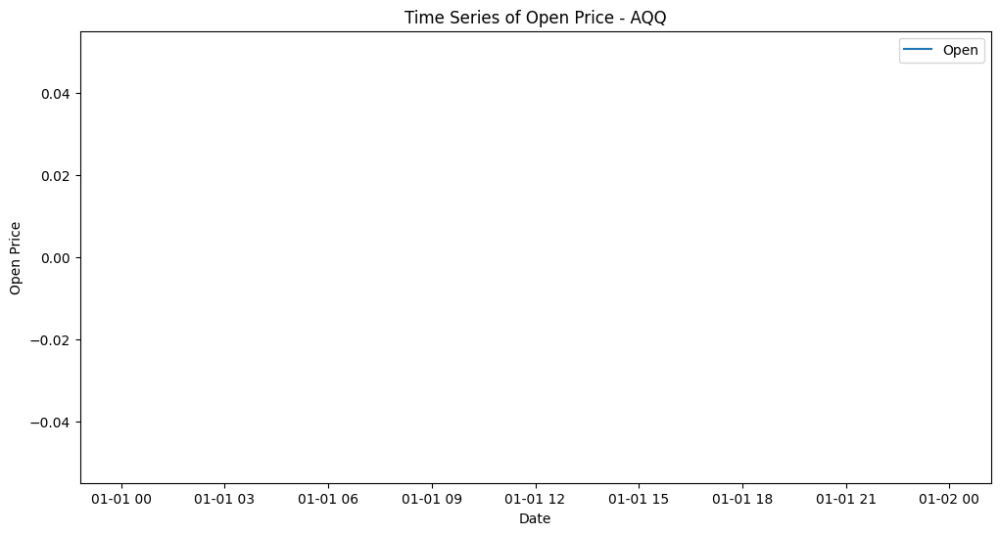

An error occurred for AQQ: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


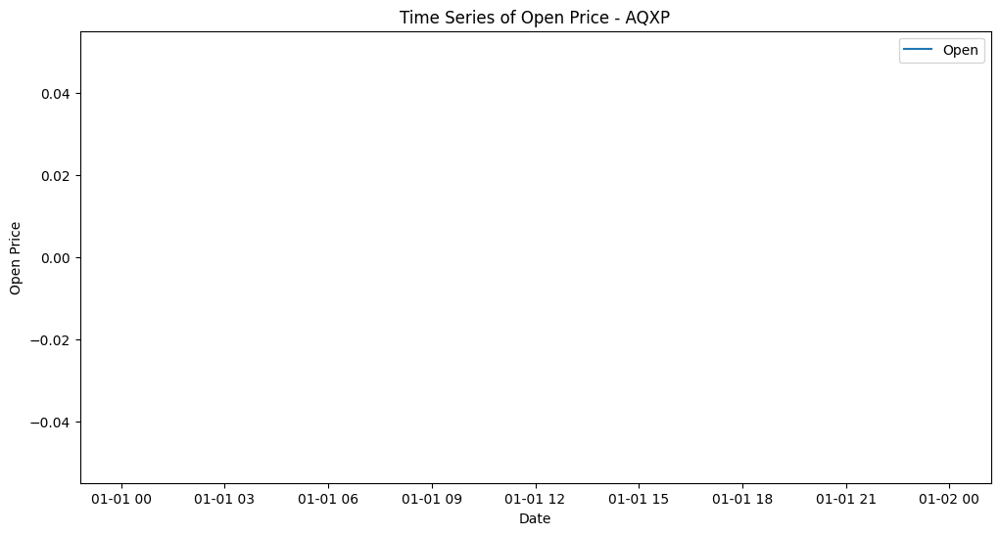

An error occurred for AQXP: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


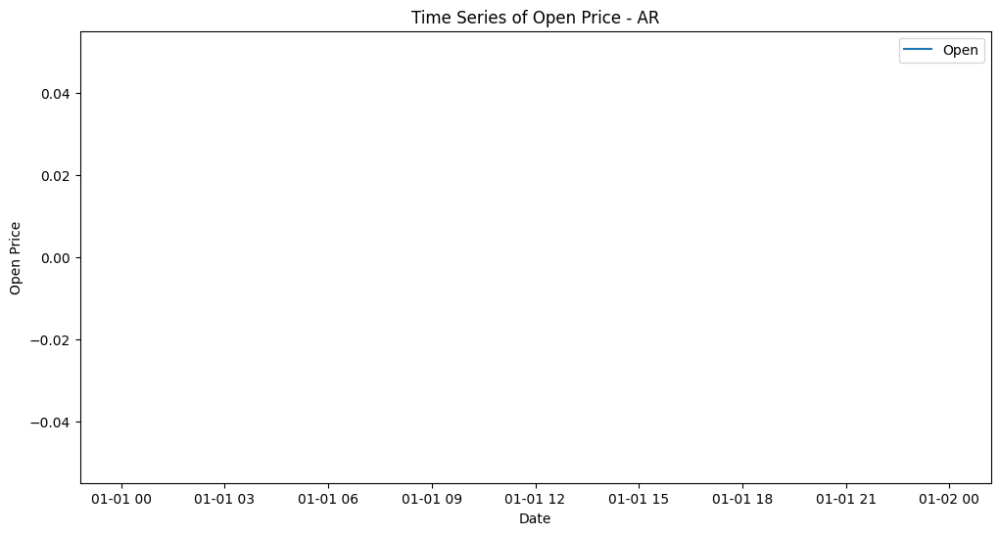

An error occurred for AR: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


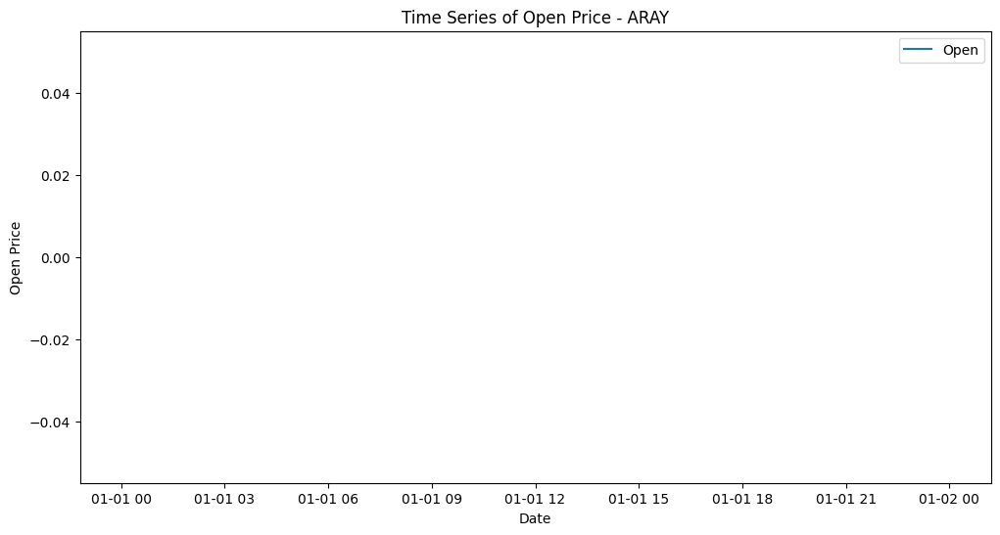

An error occurred for ARAY: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


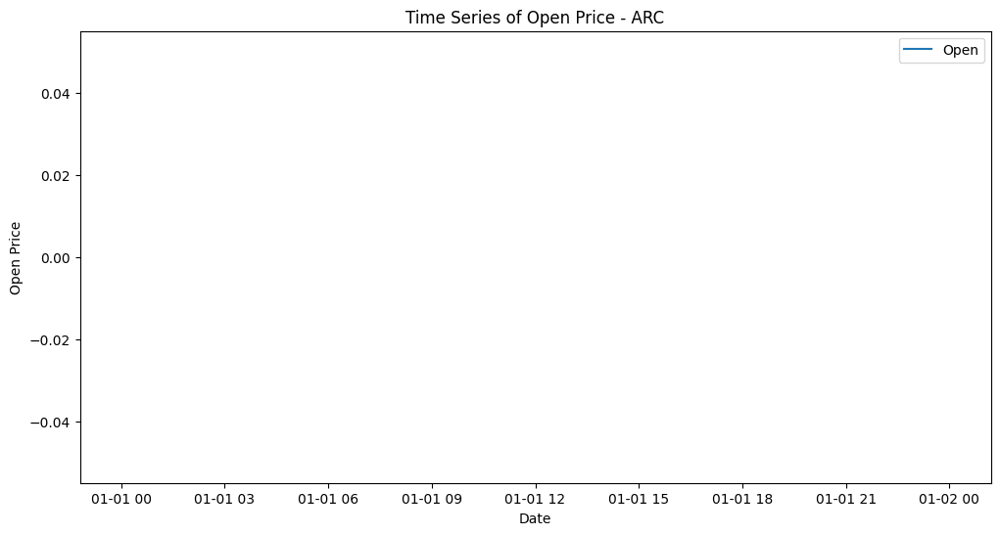

An error occurred for ARC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


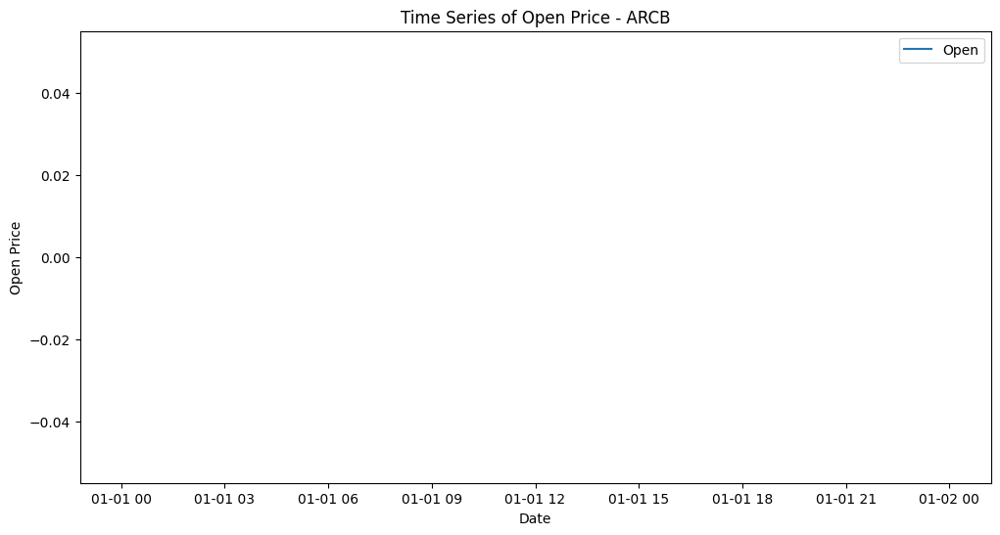

An error occurred for ARCB: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


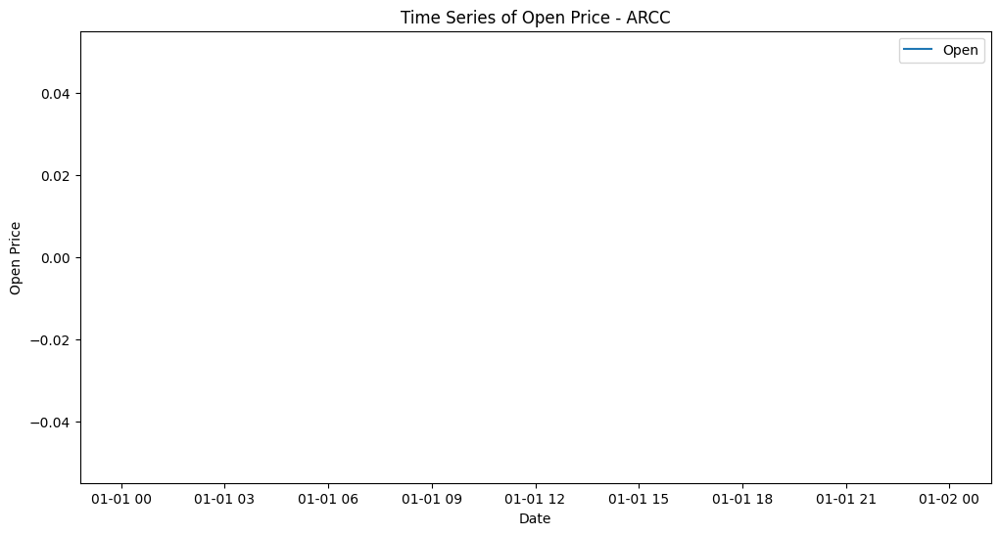

An error occurred for ARCC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


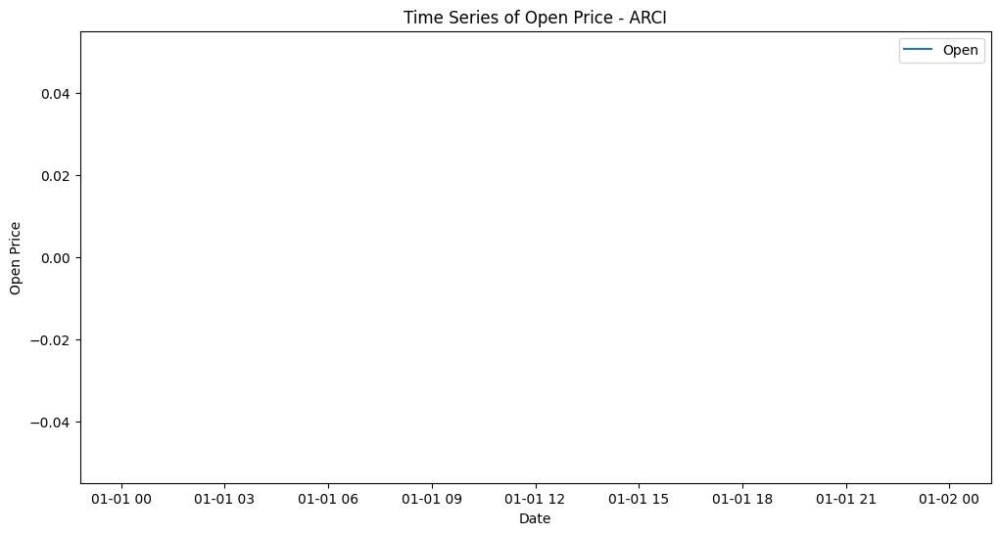

An error occurred for ARCI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


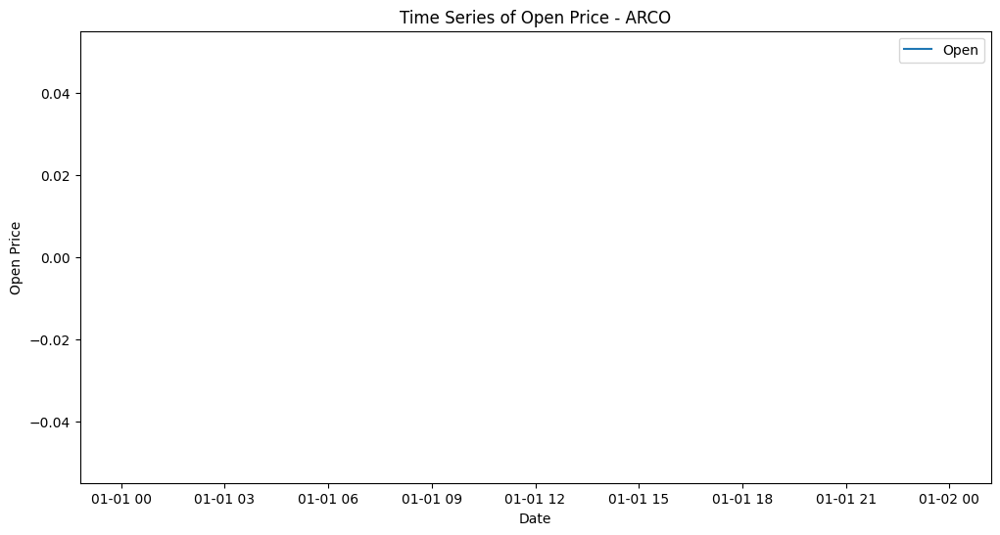

An error occurred for ARCO: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


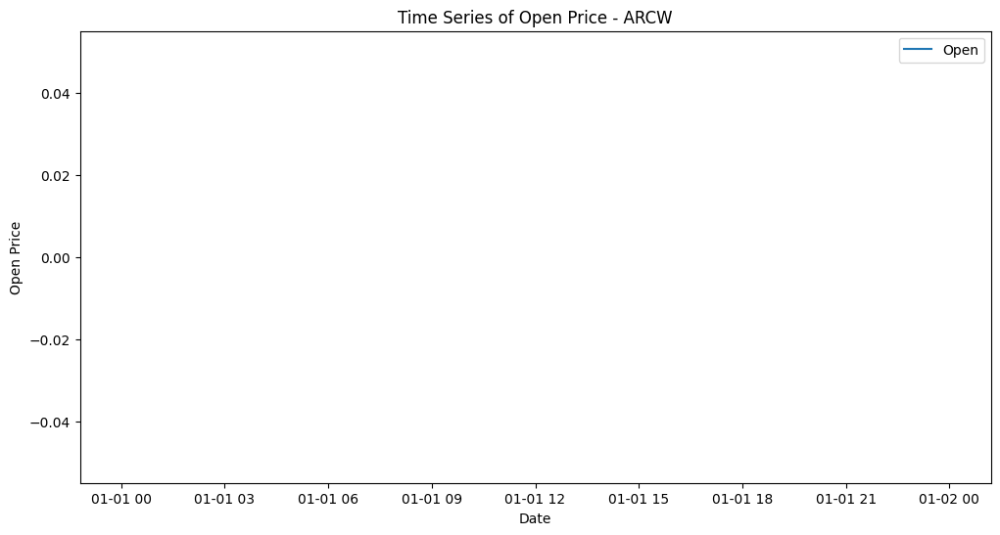

An error occurred for ARCW: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


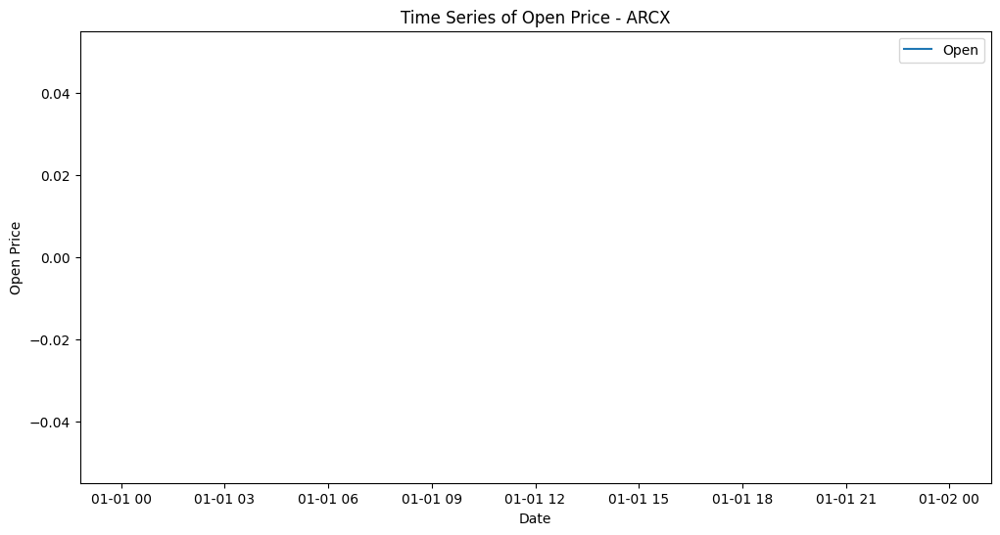

An error occurred for ARCX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


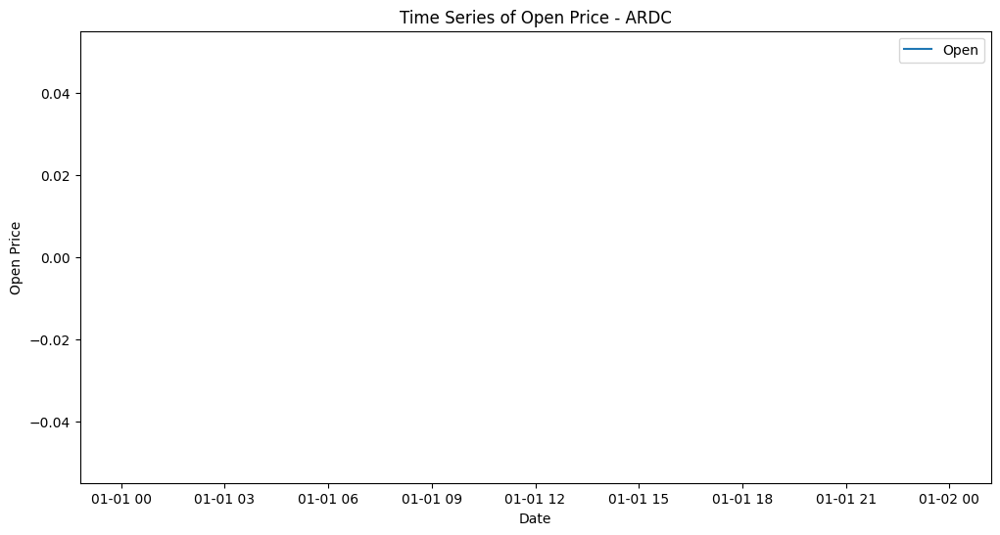

An error occurred for ARDC: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


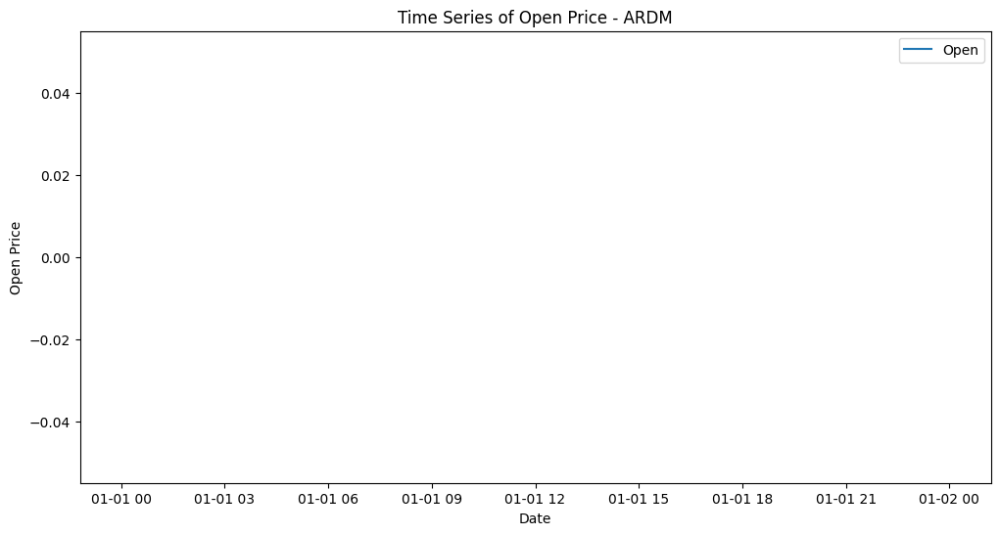

An error occurred for ARDM: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


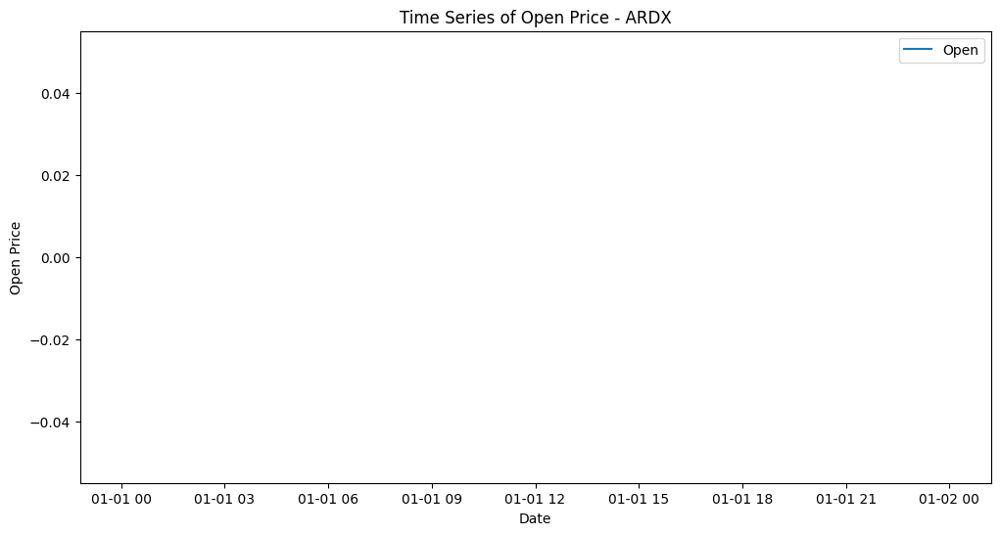

An error occurred for ARDX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


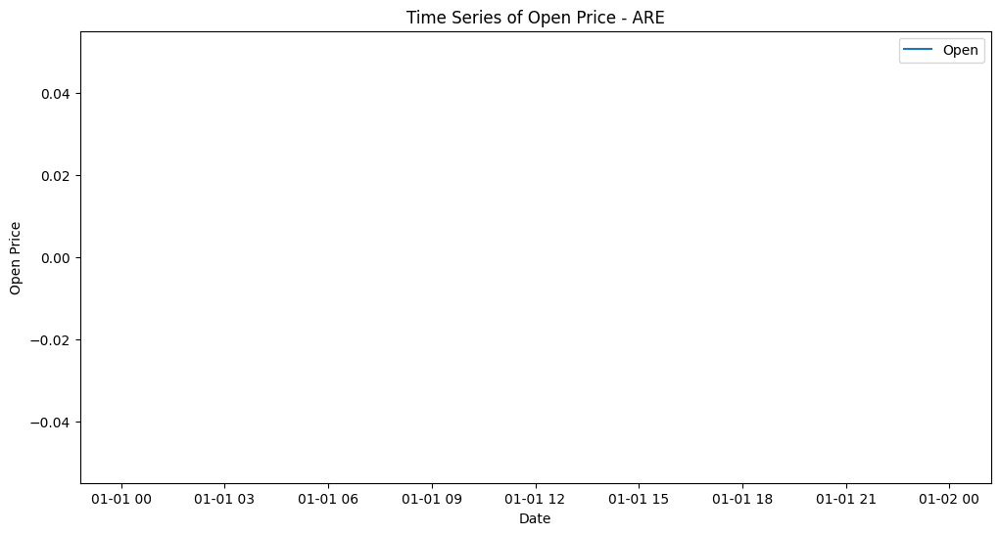

An error occurred for ARE: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


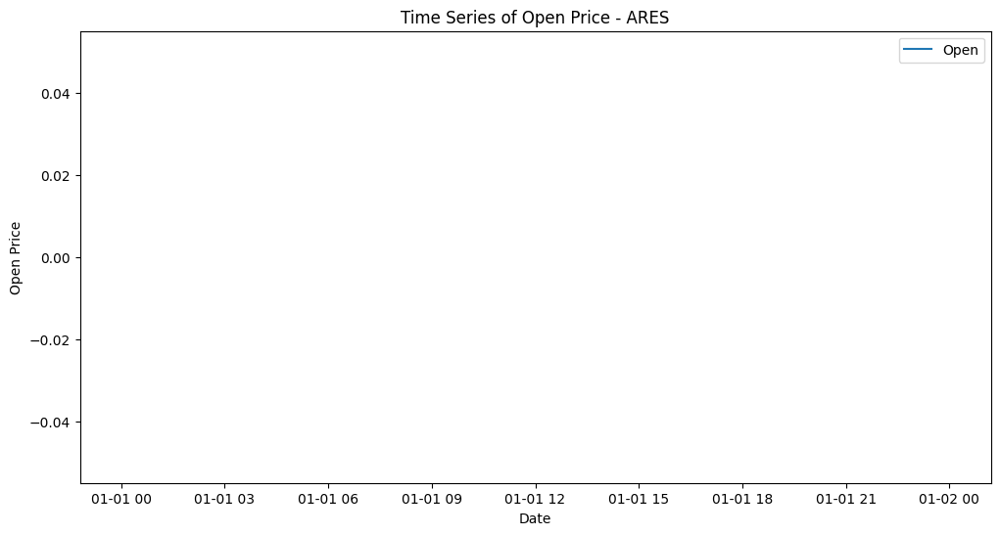

An error occurred for ARES: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


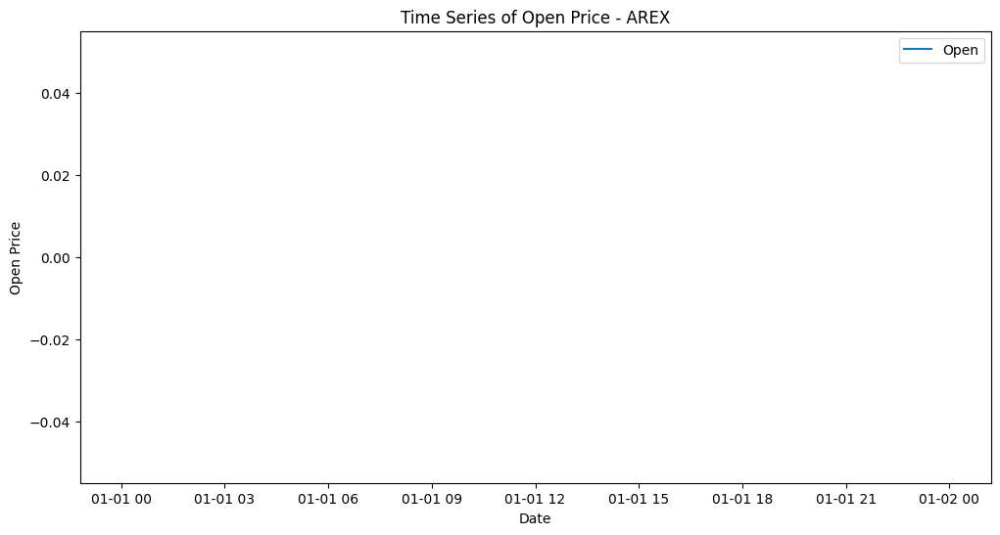

An error occurred for AREX: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


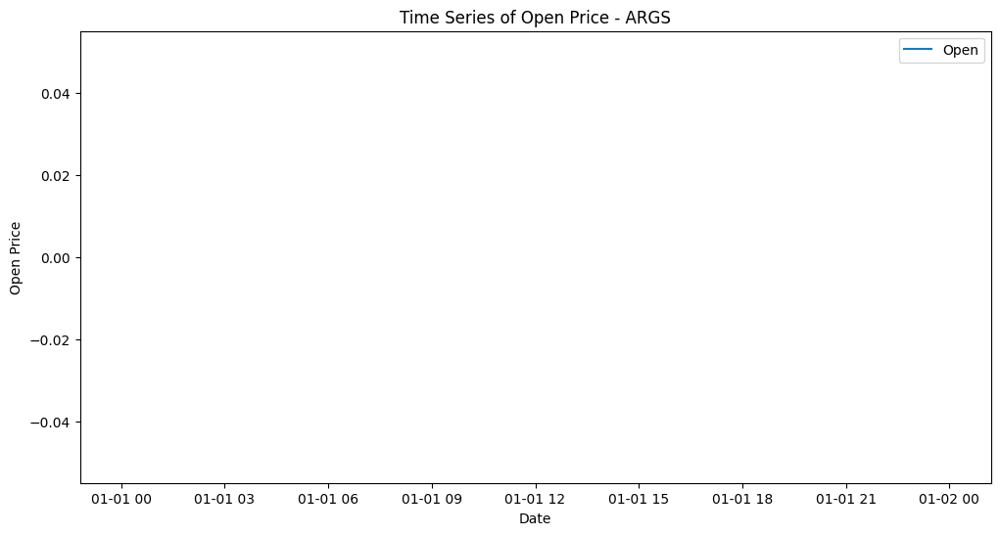

An error occurred for ARGS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


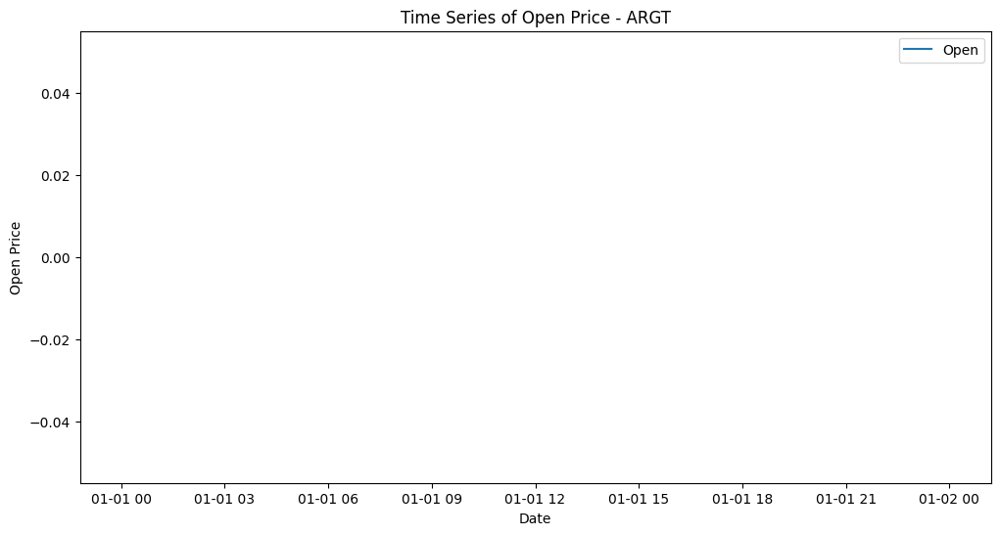

An error occurred for ARGT: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


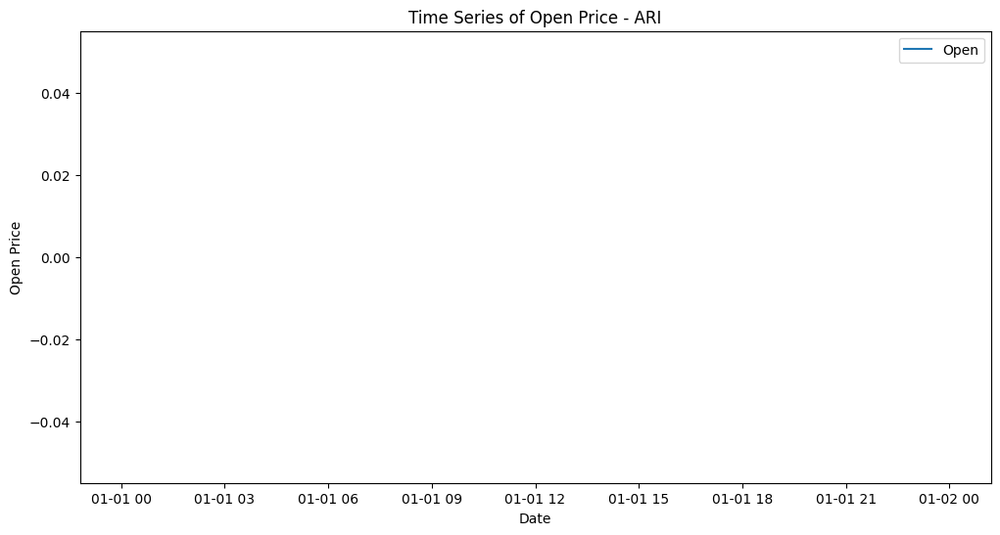

An error occurred for ARI: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


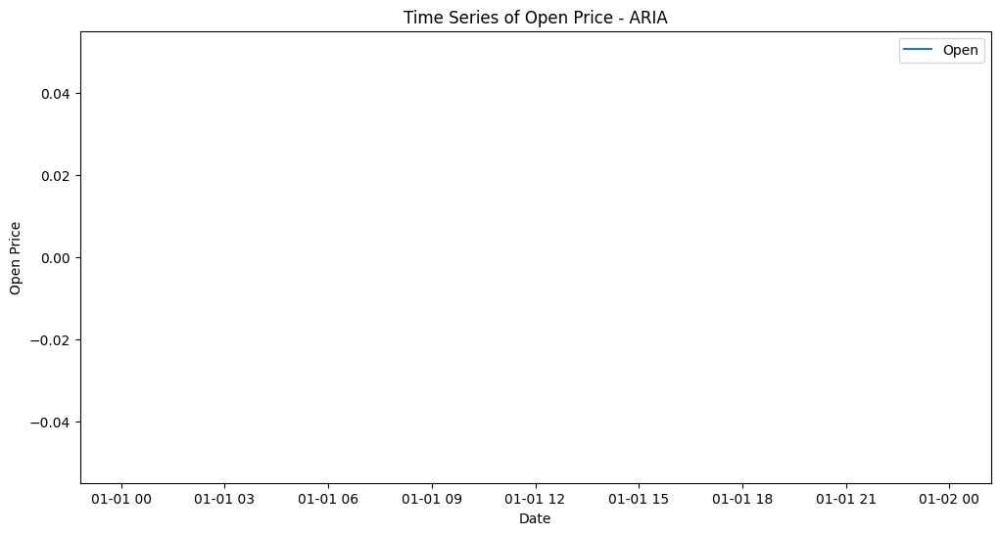

An error occurred for ARIA: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


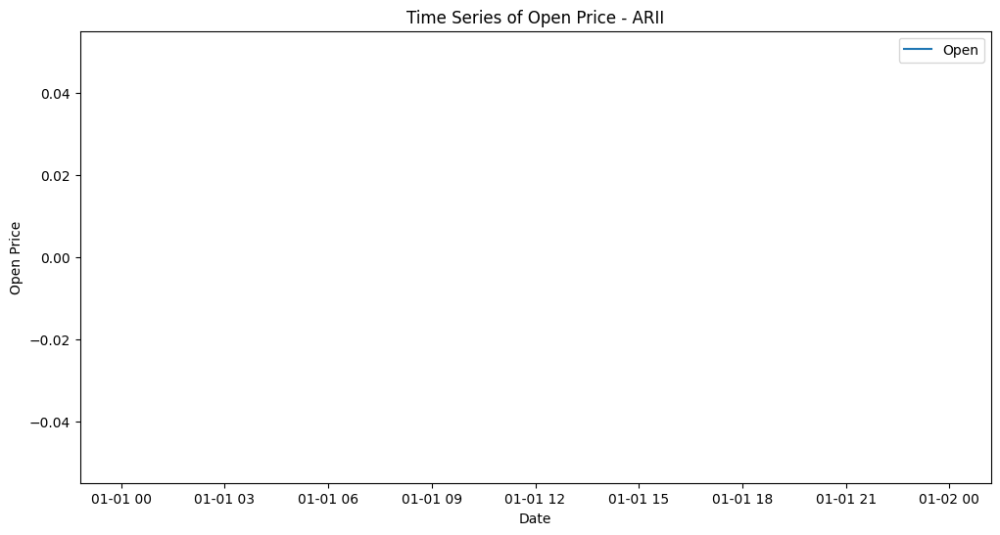

An error occurred for ARII: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


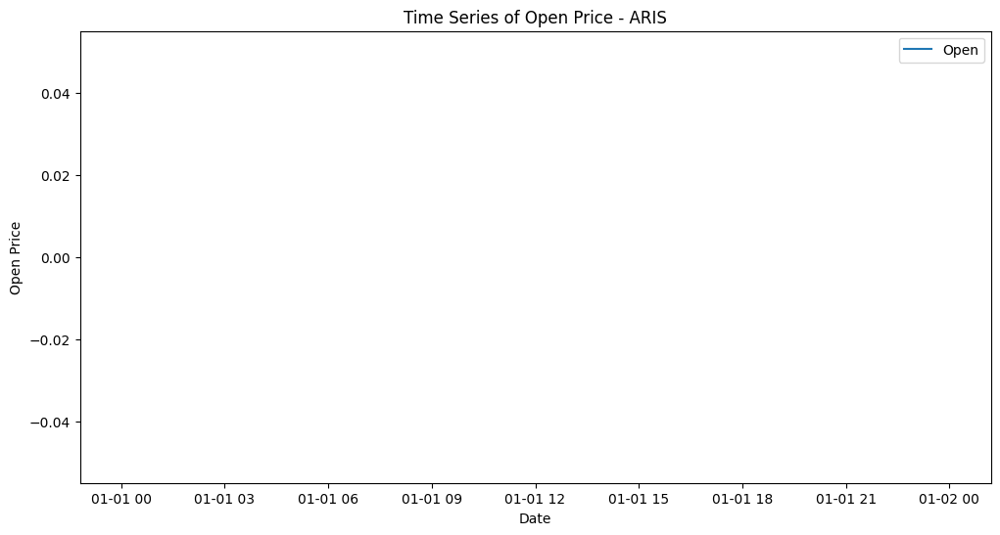

An error occurred for ARIS: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


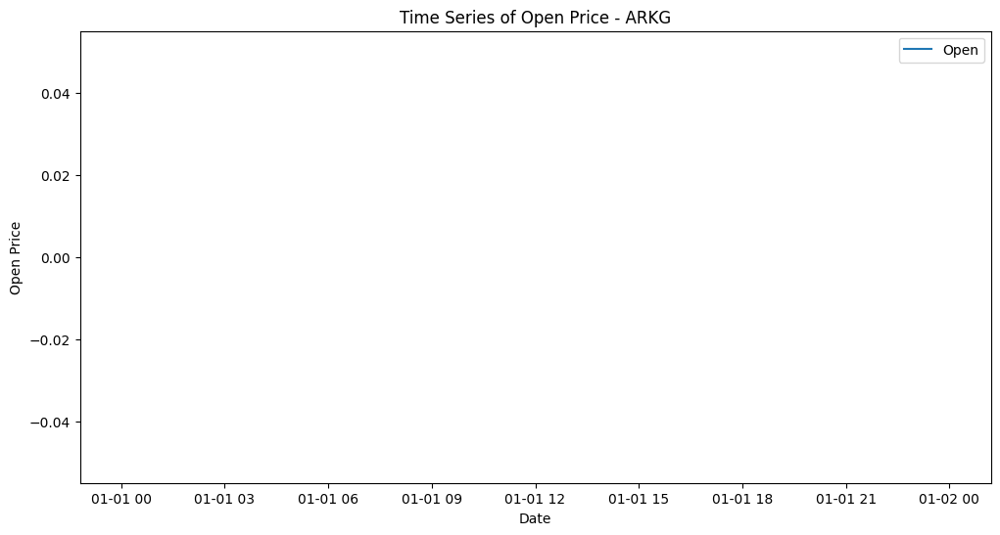

An error occurred for ARKG: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


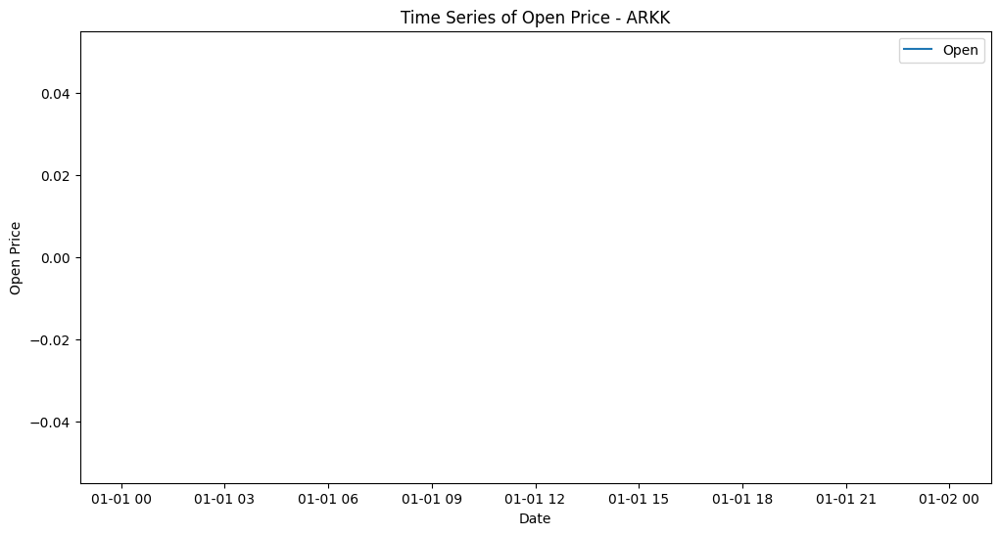

An error occurred for ARKK: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


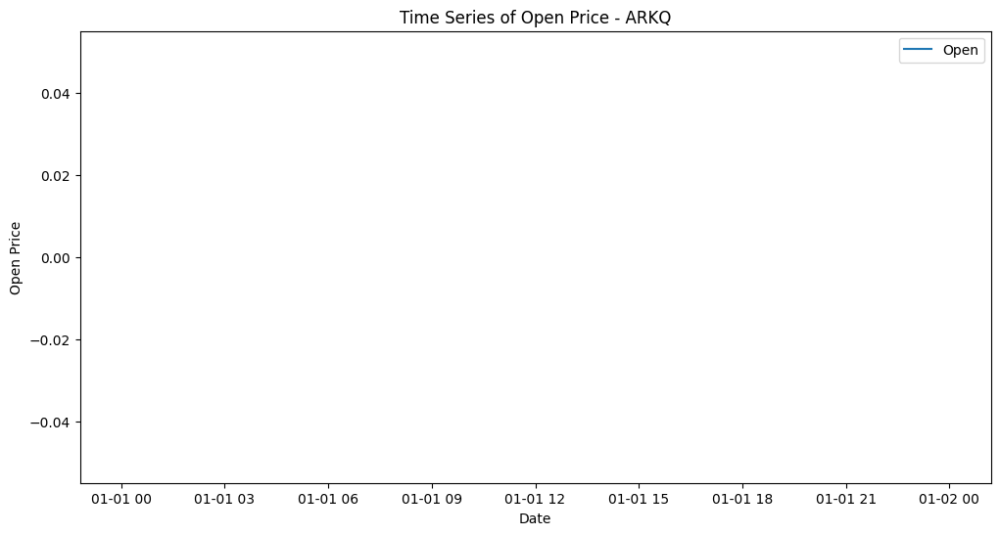

An error occurred for ARKQ: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


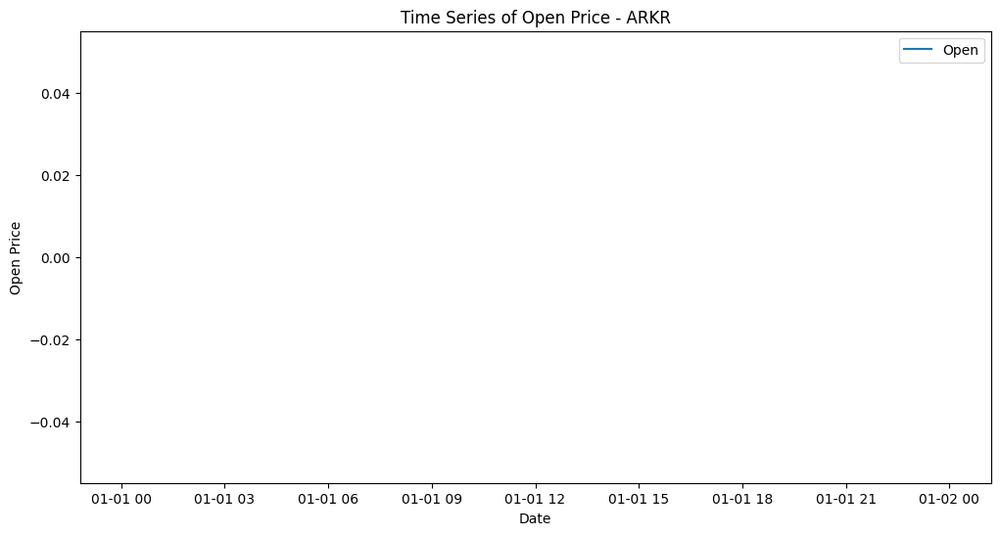

An error occurred for ARKR: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


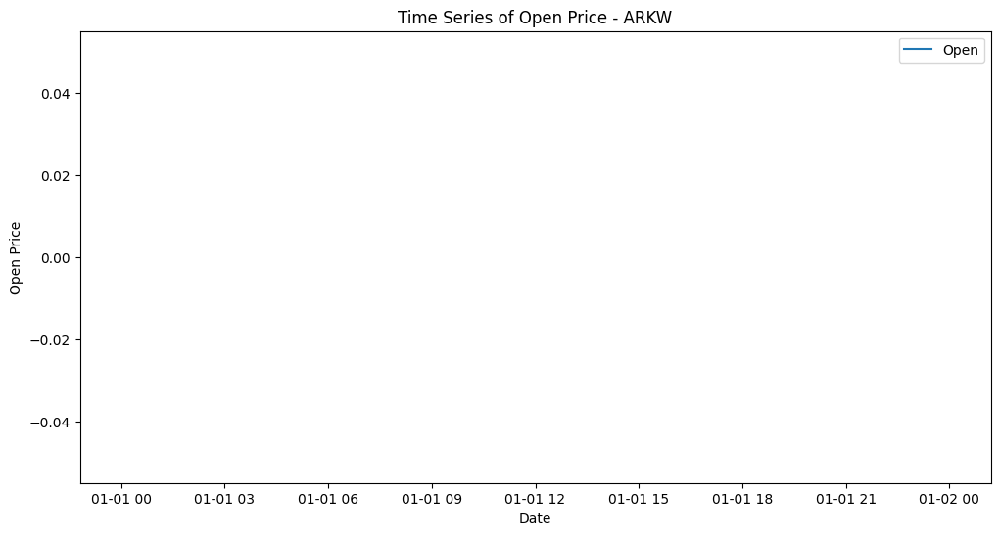

An error occurred for ARKW: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


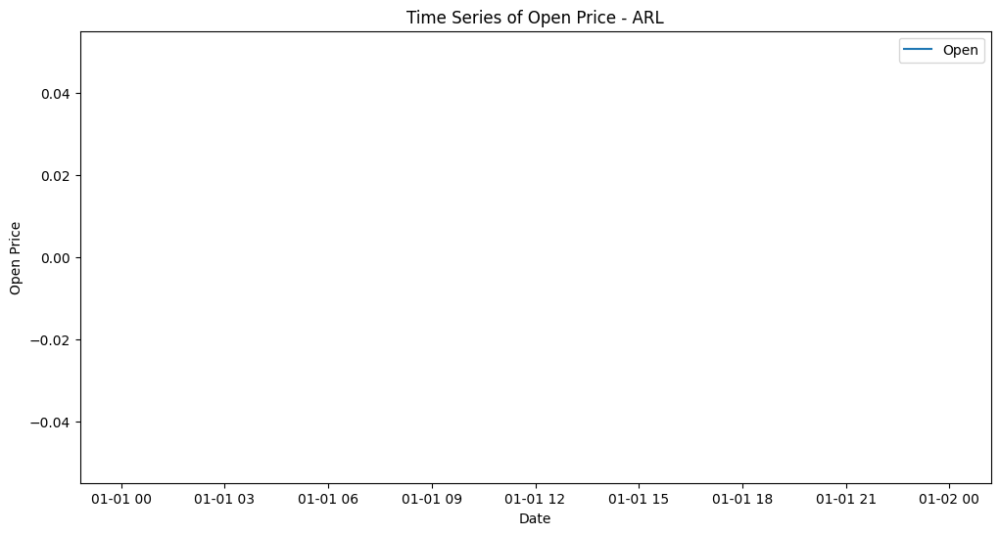

An error occurred for ARL: You must specify a period or x must be a pandas object with a PeriodIndex or a DatetimeIndex with a freq not set to None


: 

In [38]:
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm

# Assuming you have a DataFrame called 'combined_stock_data' with columns: 'stock', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume' and the date information is encoded in the index.

# Assuming you have a DataFrame called 'start_end_dates' with columns: 'stock', 'start_date', 'end_date'

# Iterate over each row in start_end_dates DataFrame
for index, row in start_end_dates.iterrows():
    stock = row['stock']
    start_date = pd.to_datetime(row['start_date'])
    end_date = pd.to_datetime(row['end_date'])
    
    # Filter the combined_stock_data DataFrame for the specific stock and date range
    stock_data = combined_stock_data.loc[(combined_stock_data['stock'] == stock) & (combined_stock_data.index >= start_date) & (combined_stock_data.index <= end_date)]
    
    # Assuming you want to perform time series analysis on the 'Open' column
    financial_data = stock_data[['Open']]
    
    # Check if there are any missing values in the financial_data
    if financial_data.isnull().values.any():
        print(f"Skipping {stock} due to missing values")
        continue
    
    try:
        # Interpolate missing values
        financial_data = financial_data.interpolate(method='linear')
        
        # Set the frequency of the index to 'D' for daily frequency
        financial_data = financial_data.asfreq('D')
        
        # Plot the time series of the 'Open' column
        plt.figure(figsize=(12, 6))
        plt.plot(financial_data['Open'], label='Open')
        plt.title(f'Time Series of Open Price - {stock}')
        plt.xlabel('Date')
        plt.ylabel('Open Price')
        plt.legend()
        plt.show()
        
        # Perform decomposition to analyze trend, seasonality, and residuals
        decomposition = sm.tsa.seasonal_decompose(financial_data['Open'], model='additive')
        trend = decomposition.trend
        seasonal = decomposition.seasonal
        residual = decomposition.resid
        
        # Plot the decomposition components
        plt.figure(figsize=(12, 8))
        plt.subplot(411)
        plt.plot(financial_data['Open'], label='Original')
        plt.legend(loc='best')
        plt.subplot(412)
        plt.plot(trend, label='Trend')
        plt.legend(loc='best')
        plt.subplot(413)
        plt.plot(seasonal, label='Seasonality')
        plt.legend(loc='best')
        plt.subplot(414)
        plt.plot(residual, label='Residuals')
        plt.legend(loc='best')
        plt.tight_layout()
        plt.show()
        
        # Perform autocorrelation analysis
        sm.graphics.tsa.plot_acf(financial_data['Open'], lags=20)
        plt.title(f'Autocorrelation - {stock}')
        plt.xlabel('Lag')
        plt.ylabel('Autocorrelation')
        plt.show()
        
        # Perform partial autocorrelation analysis
        sm.graphics.tsa.plot_pacf(financial_data['Open'], lags=20)
        plt.title(f'Partial Autocorrelation - {stock}')
        plt.xlabel('Lag')
        plt.ylabel('Partial Autocorrelation')
        plt.show()
        
        # Fit an ARIMA model
        model = sm.tsa.ARIMA(financial_data['Open'], order=(1, 0, 1))
        results = model.fit()
        
        # Print the model summary
        print(results.summary())
        
        # Generate forecasts
        forecast_start = financial_data.index[-1] + pd.DateOffset(days=1)
        forecast_end = financial_data.index[-1] + pd.DateOffset(days=30)
        forecast = results.predict(start=forecast_start, end=forecast_end)
        
        # Plot the original data and the forecasted values
        plt.figure(figsize=(12, 6))
        plt.plot(financial_data['Open'], label='Original')
        plt.plot(forecast, label='Forecast')
        plt.title(f'Original Data and Forecast - {stock}')
        plt.xlabel('Date')
        plt.ylabel('Open Price')
        plt.legend()
        plt.show()
        
    except Exception as e:
        print(f"An error occurred for {stock}: {str(e)}")
        continue